In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time
import pandas as pd
import pathlib
from scipy import stats, optimize
from scipy.optimize import nnls

from tyssue.generation import generate_ring
from tyssue.draw.plt_draw import quick_edge_draw
from tyssue.solvers.sheet_vertex_solver import Solver
from tyssue.config.draw import sheet_spec
from tyssue.draw.plt_draw import sheet_view
from tyssue.io.hdf5 import save_datasets

from tyssue.dynamics.planar_gradients import area_grad
from tyssue_taylor.adjusters.adjust_annular import (prepare_tensions, adjust_tensions,
                                                    adjust_areas, adjust_scale, adjust_parameters)
from tyssue_taylor.models.annular import AnnularGeometry as geom
from tyssue_taylor.models.annular import model, lumen_area_grad
from tyssue_taylor.adjusters.cost_functions import _distance
from tyssue_taylor.segmentation.segment2D import generate_ring_from_image, normalize_scale
from tyssue_taylor.adjusters.force_inference import infer_forces, _coef_matrix, _right_side
from tyssue_taylor.models.display import (create_organo, print_tensions, rendering_results,
                                          rendering_convergence_results,
                                          plot_force_inference)

Error: IPOPT shared library failed to import


Using TensorFlow backend.


In [2]:
def create_organo(nb_cells, r_in, r_out, seed=None, rot=None, geom=geom):
    organo = generate_ring(nb_cells, r_in, r_out)
    Nf = organo.Nf
    geom.update_all(organo)
    alpha = 1 + 1/(20*(organo.settings['R_out']-organo.settings['R_in']))
    specs = {
        'face': {
            'is_alive': 1,
            'prefered_area': organo.face_df.area,
            'area_elasticity': 1., },
        'edge': {
            'ux': 0.,
            'uy': 0.,
            'uz': 0.,
            'line_tension': 0.1,
            'is_active': 1
            },
        'vert': {
            'adhesion_strength': 0.01,
            'x_ecm': 0.,
            'y_ecm': 0.,
            'is_active': 1
            },
        'settings': {
            'lumen_elasticity': 0.1,
            'lumen_prefered_vol': organo.settings['lumen_volume'],
            'lumen_volume': organo.settings['lumen_volume']
            }
        }
    organo.update_specs(specs, reset=True)
    normalize_scale(organo, geom, refer='edges')
    geom.update_all(organo)
    if seed is not None:
        symetric_tensions = set_init_point(organo.settings['R_in'],
                                           organo.settings['R_out'],
                                           organo.Nf, alpha)
        sin_mul = 1+(np.sin(np.linspace(0, 2*np.pi, organo.Nf,
                                        endpoint=False)))**2
        organo.face_df.prefered_area *= np.random.normal(1.0, 0.05, organo.Nf)
        organo.edge_df.line_tension = prepare_tensions(organo,
                                                       symetric_tensions)
        organo.edge_df.loc[:Nf-1, 'line_tension'] *= sin_mul*np.random.normal(
            1.0, 0.05, organo.Nf)
        geom.update_all(organo)
    if rot is not None:
        organo.vert_df.loc[:, 'x'] = (organo.vert_df.x.copy() * np.cos(rot) -
                                      organo.vert_df.y.copy() * np.sin(rot))
        print('rotated x',
              organo.vert_df.x.copy() * np.cos(rot) -
              organo.vert_df.y.copy() * np.sin(rot))
        organo.vert_df.loc[:, 'y'] = (organo.vert_df.x.copy() * np.sin(rot) +
                                      organo.vert_df.y.copy() * np.cos(rot))
        print('rotated y',
              organo.vert_df.x.copy() * np.sin(rot) +
              organo.vert_df.y.copy() * np.cos(rot))
        geom.update_all(organo)
    organo.vert_df[['x_ecm', 'y_ecm']] = organo.vert_df[['x', 'y']]
    organo.vert_df.loc[organo.basal_verts, 'adhesion_strength'] = 0.01
    new_tensions = organo.edge_df.line_tension
    organo.edge_df.loc[:, 'line_tension'] = new_tensions
    return organo

In [3]:
def get_sim_mat(Nf, Ra, Rb, sum_lbda=0.1):

    sin_t = np.sin(np.pi/Nf)
    sin_2t = np.sin(2*np.pi/Nf)

    A = 0.5 * (Rb**2 - Ra**2) * sin_2t
    dAdRa = - sin_2t * Ra
    dAdRb = sin_2t * Rb
    dladRa = dlbdRb = 2*sin_t

    # variables are
    # (A - A_0), \Lambda_a, \Lambda_h
    problem_mat = np.array(
        [
            [dAdRa, dladRa, -1],
            [dAdRb, 0,       1],
            [0,     1,       1]
        ])

    b = np.array([0, 0, sum_lbda])
    return problem_mat, b

In [4]:
real_tensions_table = []
fi_tensions_table = []
mindist_tensions_table = []
real_areas_table = []
fi_areas_table = []
mindist_areas_table = []
cr_real_tensions_table = []
cr_fi_tensions_table = []
cr_mindist_tensions_table = []
cr_real_areas_table = []
cr_fi_areas_table = []
cr_mindist_areas_table = []

In [5]:
def centrer_et_reduire(series):
    mean = series.mean()
    std = series.std()
    return (series-mean)/std

In [6]:
def force_inference_procedure(eptm):
    params_in_sym_mesh = np.linalg.solve(*get_sim_mat(eptm.Nf,
                                                      eptm.settings['R_in'],
                                                      eptm.settings['R_out']))
    
    eptm.get_extra_indices()
    non_lateral_edges = np.concatenate((eptm.apical_edges,
                                        eptm.basal_edges))
    sym_height = (eptm.settings['R_out']-
                  eptm.settings['R_in'])*np.cos(np.pi/eptm.Nf)
    polar_coefs = np.ones(organo.Nf)
    for cell in range(eptm.Nf):
        api_vertex = eptm.edge_df.loc[eptm.apical_edges,
                                      ('srce', 'trgt')][eptm.edge_df.face == cell]
        coord_api_vertex = eptm.vert_df.loc[np.squeeze(api_vertex.values),
                                            ('x', 'y')].values
        coord_cell_center = np.squeeze(eptm.face_df.loc[[cell],
                                                        ('x', 'y')].values)
        pos_param = np.dot(coord_cell_center - coord_api_vertex[0],
                           coord_cell_center - coord_api_vertex[1])
        comp = np.array((coord_api_vertex[1, 0] - coord_api_vertex[0, 0],
                         coord_api_vertex[1, 1] - coord_api_vertex[0, 1]))
        proj = coord_api_vertex[0] + pos_param * comp
        polar_coefs[cell] = np.linalg.norm(proj - coord_cell_center)
    matrix = _coef_matrix(eptm, sup_param='areas')
    constant = _right_side(eptm, matrix)
    matrix = matrix[:-1]
    constant = constant[:-1]
    avg_cste = [4*((params_in_sym_mesh[1:].sum()+params_in_sym_mesh[-1])/3 /
                   (eptm.face_df.area.mean() + params_in_sym_mesh[0])**1.5)]*eptm.Nf
    for i in range(eptm.Nf):
        i_cell_line = np.zeros(4*eptm.Nf+1)
        index = np.squeeze(np.argwhere(eptm.edge_df.face.values == i))
        index_suiv = np.squeeze(np.argwhere(eptm.edge_df.face.values == (i+1)%eptm.Nf))
        index[-1] = index_suiv[-2]
        i_cell_line[index] = [polar_coefs[i], 1, 1, 1]
        matrix = np.vstack((matrix, i_cell_line))
    constant = np.concatenate((constant, avg_cste))
    mat_eq_cst, residuals = nnls(matrix, constant)
    organo_eq_cst = eptm.copy()
    organo_eq_cst.edge_df.loc[:, 'line_tension'] = prepare_tensions(organo_eq_cst,
                                                                     mat_eq_cst[:3*organo.Nf])
    fi_tensions_table = mat_eq_cst[:3*organo.Nf]
    fi_tensions_table = centrer_et_reduire(mat_eq_cst[:3*organo.Nf])
    organo_eq_cst.face_df.loc[:, 'prefered_area'] = organo_eq_cst.face_df.area + mat_eq_cst[3*organo.Nf:
                                                                                              4*organo.Nf]
    fi_areas_table = mat_eq_cst[3*organo.Nf:4*organo.Nf]
    cr_fi_areas_table = centrer_et_reduire(mat_eq_cst[3*organo.Nf:4*organo.Nf])
    organo_eq_cst.settings['lumen_prefered_vol'] = organo_eq_cst.settings['lumen_volume'] + mat_eq_cst[-1]
    Solver.find_energy_min(organo_eq_cst, geom, model)
    print_tensions(organo_eq_cst, organo)
    print('Apical tensions: ', mat_eq_cst[organo.apical_edges],
          '\nBasal tensions: ', mat_eq_cst[organo.basal_edges],
          '\nLateral tensions: ', mat_eq_cst[organo.lateral_edges[:organo.Nf]],
          '\nArea elasticity: ', mat_eq_cst[organo.Nf*3:-1],
          '\nLumen area elasticity: ', mat_eq_cst[-1],
          '\nDistance from th org to exp org: ', np.sum(np.linalg.norm(_distance(organo_eq_cst, organo), axis=1)),
          '\nNNLS residuals: ', residuals)
    rendering_results(eptm, eptm.edge_df.line_tension[:3*eptm.Nf],
                      mat_eq_cst[:3*eptm.Nf],
                      'Comparison of true tensions with tensions infered with force inference \n' +
                      'with only tensions wolved with NNLS',
                      'True tensions', 'Infered tensions', ('Force inference', 'Linear regression'))
    return mat_eq_cst, fi_tensions_table, fi_tensions_table, fi_areas_table, cr_fi_areas_table

In [7]:
lm_opt = {'method': 'lm','xtol':1e-5,'ftol': 1e-3, 'verbose': 1}
iprint_file = "../../assets/dist_at_each_f_ev/14_03_eq_t_per_cell_new_criteria.txt"
def min_dist_procedure(eptm,
                       mat_eq_cst,
                       lm_opt=lm_opt,
                       iprint_file=iprint_file):
    start_copy = time.time()
    to_opt_eptm = eptm.copy()
    init_point_area_and_tensions_opt = np.concatenate((prepare_tensions(to_opt_eptm, mat_eq_cst[:3*eptm.Nf]),
                                                       to_opt_eptm.face_df.area + mat_eq_cst[3*eptm.Nf:-1],
                                                       [to_opt_eptm.settings['lumen_volume'] + mat_eq_cst[-1]]))
    res_2_cst_areas_copy = adjust_parameters(to_opt_eptm,
                                             init_point_area_and_tensions_opt,
                                             {'dic':{'apical' : False, 'basal': False}, 'weight':0},  
                                             **lm_opt)
    end_copy = time.time()
    print('Execution time: ', start_copy - end_copy)
    opt_mat_2_cst_eptm = to_opt_eptm.copy()
    opt_mat_2_cst_eptm.edge_df.line_tension = prepare_tensions(opt_mat_2_cst_eptm, res_2_cst_areas_copy.x[:eptm.Nf*3])
    mindist_tensions_table = res_2_cst_areas_copy.x[:eptm.Nf*3]
    cr_mindist_tensions_table = centrer_et_reduire(res_2_cst_areas_copy.x[:eptm.Nf*3])
    opt_mat_2_cst_eptm.face_df.prefered_area = res_2_cst_areas_copy.x[4*eptm.Nf:5*eptm.Nf]
    mindist_areas_table = res_2_cst_areas_copy.x[4*eptm.Nf:5*eptm.Nf]
    mindist_areas_table = centrer_et_reduire(res_2_cst_areas_copy.x[4*eptm.Nf:5*eptm.Nf])
    opt_mat_2_cst_eptm.settings['prefered_lumen_vol'] = opt_mat_2_cst_eptm.settings['lumen_volume'] + res_2_cst_areas_copy.x[-1]
    Solver.find_energy_min(opt_mat_2_cst_eptm, geom, model)
    print_tensions(opt_mat_2_cst_eptm, eptm)
    print('Distance from th eptm to exp eptm : ' +
          str(np.sum(np.linalg.norm(_distance(eptm, opt_mat_2_cst_eptm), axis=1))))
    print('Distance from th tensions to exp tensions : ' +
          str(np.sum(np.linalg.norm(eptm.edge_df.line_tension[:3*eptm.Nf] -
                                    opt_mat_2_cst_eptm.edge_df.line_tension[:3*eptm.Nf]))))
    rendering_results(eptm, eptm.edge_df.line_tension[:3*eptm.Nf],
                  opt_mat_2_cst_eptm.edge_df.line_tension[:3*eptm.Nf],
                  'Comparison of true tensions with tensions infered with force inference \n' +
                  'with only tensions wolved with NNLS',
                  'True tensions', 'Infered tensions', ('Force inference', 'Linear regression'))
    return mindist_tensions_table, mindist_areas_table, cr_mindist_tensions_table, cr_mindist_areas_table

## Organo half polarized

Reseting datasets values with new specs


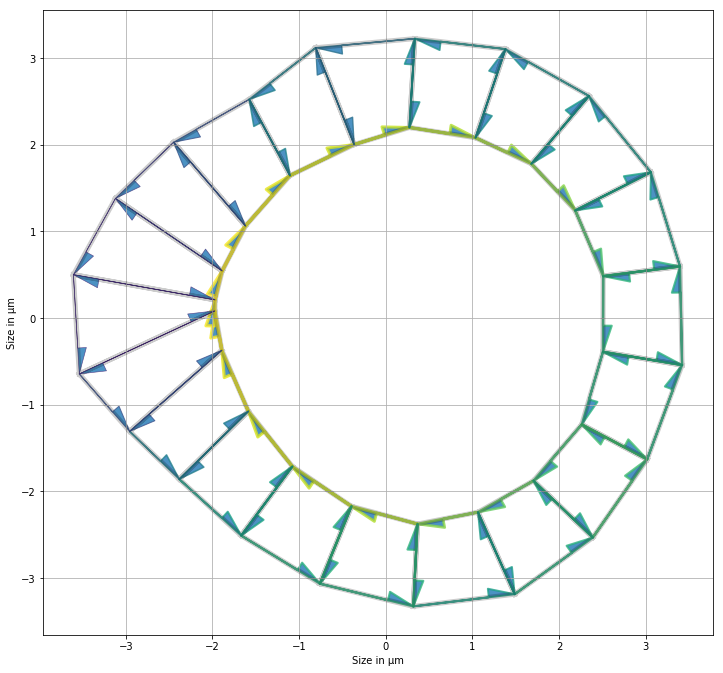

In [8]:
nf, r_in, r_out = (20, 1, 1.5)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = 3*np.array([
    0.050, 0.055, 0.060, 0.065, 0.070,
    0.072, 0.074, 0.076, 0.078, 0.078,
    0.079, 0.078, 0.076, 0.074, 0.072,
    0.070, 0.068, 0.065, 0.057, 0.052
])

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = 3*np.array([
    0.050, 0.055, 0.050, 0.045, 0.050,
    0.050, 0.045, 0.035, 0.020, 0.010,
    0.011, 0.015, 0.020, 0.035, 0.030,
    0.040, 0.040, 0.042, 0.045, 0.050
])

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = 3*np.array([
    0.050, 0.055, 0.050, 0.044, 0.051,
    0.051, 0.046, 0.034, 0.019, 0.009,
    0.010, 0.014, 0.021, 0.036, 0.029,
    0.041, 0.039, 0.043, 0.046, 0.051,
    0.055, 0.050, 0.044, 0.051,
    0.051, 0.046, 0.034, 0.019, 0.009,
    0.010, 0.014, 0.021, 0.036, 0.029,
    0.041, 0.039, 0.043, 0.046, 0.051, 0.050
])

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area
real_tensions_table = np.concatenate((real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
cr_real_tensions_table = np.concatenate((cr_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
real_areas_table = np.concatenate((real_areas_table,
                                   organo.face_df.prefered_area.values))
cr_real_areas_table = np.concatenate((cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))

geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.06658022 0.06577454 0.0778004  0.07939388 0.07637162 0.08047441
 0.08723207 0.10123968 0.11784793 0.13270992 0.12774184 0.11936185
 0.10173128 0.09521    0.09770146 0.08302304 0.08658848 0.07983469
 0.07178574 0.06790955] 
Basal tensions:  [0.05454743 0.05449248 0.05648277 0.05063569 0.04899562 0.0497822
 0.04912389 0.05078408 0.04699324 0.04492525 0.04181992 0.04181568
 0.03437582 0.04621254 0.04634668 0.04667976 0.0513014  0.05035492
 0.0512461  0.05469368] 
Lateral tensions:  [0.06448157 0.07089267 0.06797816 0.06498042 0.07199004 0.06722025
 0.06823693 0.06532665 0.0552269  0.03701928 0.04188381 0.05020765
 0.0556494  0.07358041 0.05184614 0.07429999 0.0604982  0.06858406
 0.06570798 0.07018317] 
Area elasticity:  [0.07678068 0.07520646 0.08416867 0.08029867 0.07631518 0.07811135
 0.07675424 0.07470954 0.06603488 0.06836589 0.06428767 0.0687201
 0.06404543 0.07359007 0.07885268 0.07098257 0.08026858 0.07749525
 0.07488704 0.07651987] 
Lumen area elasticity:  0.

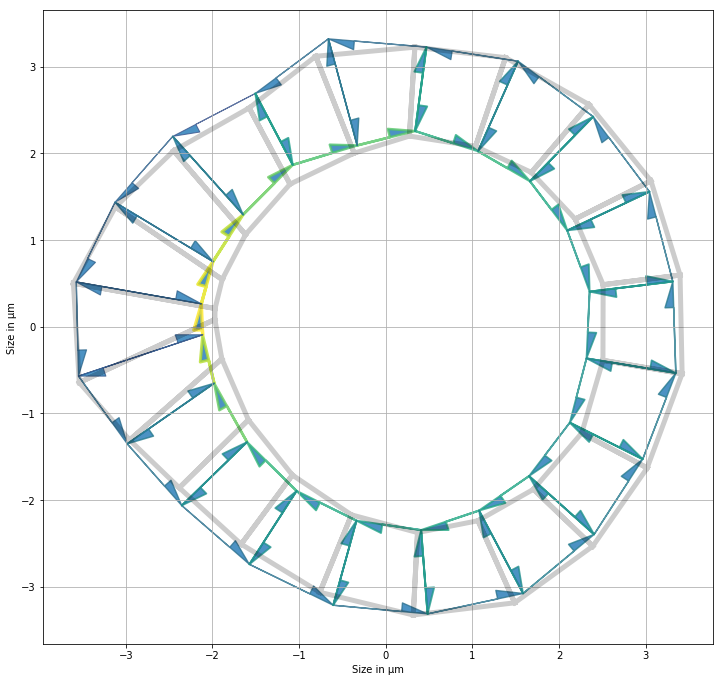

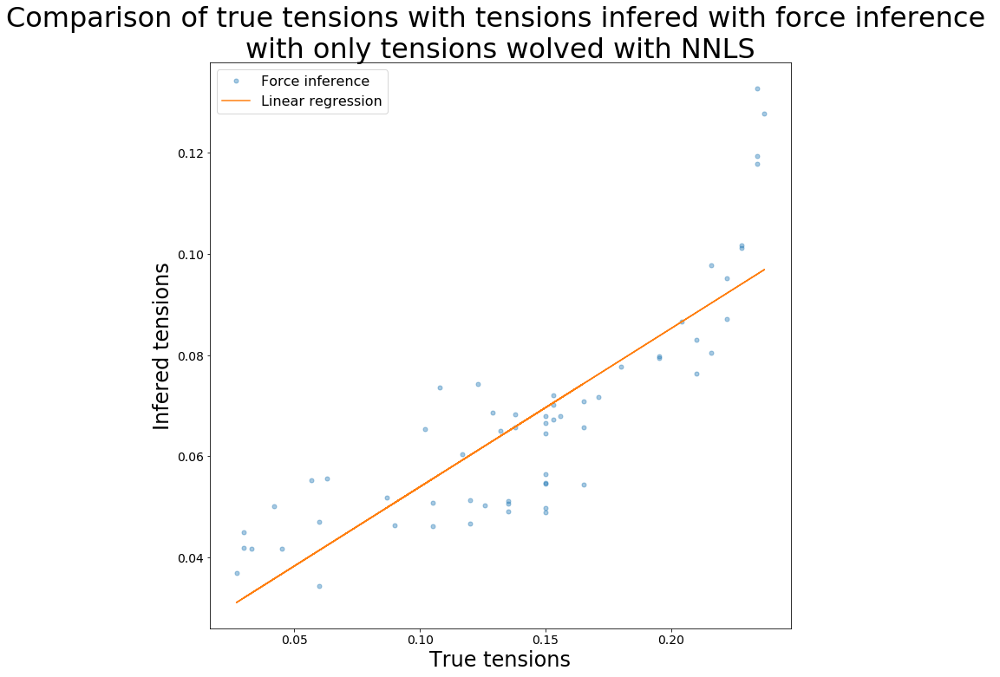

R value : 0.8365321021907084 
Standard error : 0.010441705952580337
6.256312588440395 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.16554871 0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.     

6.2563125920170615 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356999 0.16554871 0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

6.256312641868862 [0.19220618 0.18378447 0.15924564 0.11508525 0.04562356 0.09153808
 0.19913833 0.27089382 0.30852792 0.23356998 0.16554869 0.23941877
 0.24407773 0.23635373 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.1755728  0.07117519 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166953 0.26578643 0.22099983 0.05373047 0.08215959
 0.03966027 0.05324895 0.17608671 0.19401684 0.26072142 0.13659923
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

6.256312591699196 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562356 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.16554871 0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.11533909 0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.1517465  0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256312606844055 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562356 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.1655487  0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.11533909 0.13876273 0.14388578
 0.16340318 0.22166953 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256312484427579 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913832 0.2708938  0.30852791 0.23356999 0.16554872 0.23941877
 0.24407772 0.23635371 0.10507083 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.11533909 0.13876273 0.14388578
 0.16340318 0.22166952 0.26578641 0.22099981 0.05373047 0.08215959
 0.03966025 0.05324897 0.1760867  0.19401683 0.26072141 0.13659922
 0.15174649 0.1507212  0.12855231 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

6.25631261615934 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562356 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.1655487  0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117519 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166953 0.26578643 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072141 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

6.256312600410502 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.16554871 0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117519 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256312576580042 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913832 0.27089381 0.30852792 0.23356999 0.16554871 0.23941877
 0.24407773 0.23635371 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966025 0.05324896 0.17608671 0.19401683 0.26072141 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.25631267373509 [0.19220618 0.18378447 0.15924564 0.11508525 0.04562356 0.09153808
 0.19913833 0.27089381 0.30852792 0.23356998 0.1655487  0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.1755728  0.07117519 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166953 0.26578643 0.22099983 0.05373048 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

6.256312561037211 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.16554871 0.23941877
 0.24407773 0.23635371 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.11533909 0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966025 0.05324896 0.17608671 0.19401683 0.26072141 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256312588440395 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.16554871 0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256312588440395 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.16554871 0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256312588440395 [0.19220618 0.18378446 0.15924564 0.11508525 0.04562357 0.09153809
 0.19913833 0.27089381 0.30852792 0.23356998 0.16554871 0.23941877
 0.24407773 0.23635372 0.10507084 0.09089387 0.06006255 0.09942585
 0.1609143  0.17557279 0.07117518 0.1153391  0.13876273 0.14388578
 0.16340318 0.22166952 0.26578642 0.22099982 0.05373047 0.0821596
 0.03966026 0.05324896 0.17608671 0.19401684 0.26072142 0.13659922
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256312724989353 [0.19220618 0.18378447 0.15924564 0.11508524 0.04562356 0.09153808
 0.19913833 0.27089382 0.30852793 0.23356998 0.16554869 0.23941877
 0.24407774 0.23635373 0.10507085 0.09089387 0.06006255 0.09942585
 0.1609143  0.1755728  0.07117519 0.1153391  0.13876273 0.14388578
 0.16340317 0.22166953 0.26578644 0.22099983 0.05373048 0.0821596
 0.03966027 0.05324896 0.17608672 0.19401685 0.26072143 0.13659923
 0.15174649 0.1507212  0.12855232 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256316993821494 [0.19220636 0.18378466 0.15924573 0.11508517 0.04562336 0.09153805
 0.1991385  0.27089408 0.3085281  0.23356986 0.16554816 0.2394187
 0.24407793 0.23635409 0.10507107 0.09089389 0.06006251 0.09942579
 0.16091441 0.17557296 0.07117539 0.11533924 0.13876288 0.1438858
 0.16340313 0.22166975 0.26578686 0.22100021 0.05373061 0.08215976
 0.03966072 0.05324878 0.17608688 0.19401724 0.2607217  0.13659938
 0.15174646 0.15072131 0.12855246 0.11109505 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

6.256311119494002 [0.19220612 0.18378439 0.15924561 0.11508527 0.04562363 0.0915381
 0.19913827 0.27089372 0.30852786 0.23357003 0.16554889 0.23941879
 0.24407766 0.23635359 0.10507076 0.09089387 0.06006256 0.09942587
 0.16091426 0.17557274 0.07117511 0.11533905 0.13876268 0.14388578
 0.16340319 0.22166945 0.26578628 0.22099969 0.05373043 0.08215955
 0.0396601  0.05324902 0.17608665 0.1940167  0.26072133 0.13659917
 0.15174651 0.15072116 0.12855227 0.11109502 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

6.256313293787081 [0.19220621 0.18378449 0.15924565 0.11508523 0.04562353 0.09153808
 0.19913835 0.27089386 0.30852795 0.23356996 0.16554861 0.23941876
 0.24407776 0.23635378 0.10507088 0.09089387 0.06006254 0.09942584
 0.16091432 0.17557282 0.07117522 0.11533912 0.13876275 0.14388578
 0.16340317 0.22166956 0.2657865  0.22099989 0.0537305  0.08215963
 0.03966034 0.05324893 0.17608674 0.1940169  0.26072146 0.13659925
 0.15174649 0.15072121 0.12855234 0.11109503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

2.7366674929112995 [8.73379049e-03 2.16974900e-02 1.22080238e-01 7.51543476e-02
 1.12263421e-02 1.17201823e-01 7.51874558e-02 1.14078761e-01
 2.02223581e-01 1.18820034e-01 9.90756735e-02 8.22697651e-02
 3.57442819e-02 4.92111988e-02 4.26107749e-02 2.33956500e-02
 5.48152789e-02 1.17125821e-01 8.27207196e-02 2.43817322e-02
 2.72290014e-02 8.86933337e-02 2.17068433e-02 6.11205081e-02
 4.76381320e-02 4.68385964e-02 9.92942057e-02 5.65899522e-02
 8.79627855e-02 1.28997791e-01 1.02001470e-03 5.14556319e-02
 5.78091040e-02 3.67926067e-02 4.51858603e-02 5.19745556e-02
 6.53076968e-02 1.16306713e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.736667608310239 [8.73378985e-03 2.16974943e-02 1.22080249e-01 7.51543538e-02
 1.12263434e-02 1.17201829e-01 7.51874617e-02 1.14078759e-01
 2.02223587e-01 1.18820033e-01 9.90756751e-02 8.22697654e-02
 3.57442819e-02 4.92112021e-02 4.26107779e-02 2.33956519e-02
 5.48152817e-02 1.17125831e-01 8.27207235e-02 2.43817338e-02
 2.72290020e-02 8.86933387e-02 2.17068418e-02 6.11205126e-02
 4.76381398e-02 4.68386006e-02 9.92942090e-02 5.65899546e-02
 8.79627860e-02 1.28997789e-01 1.02001905e-03 5.14556334e-02
 5.78091043e-02 3.67926083e-02 4.51858618e-02 5.19745570e-02
 6.53077007e-02 1.16306719e-01 1.27999311e-01 3.89827051e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.7366688558013204 [8.73378454e-03 2.16975377e-02 1.22080341e-01 7.51544224e-02
 1.12263592e-02 1.17201895e-01 7.51874924e-02 1.14078804e-01
 2.02223658e-01 1.18820037e-01 9.90756892e-02 8.22697731e-02
 3.57442837e-02 4.92112394e-02 4.26108107e-02 2.33956728e-02
 5.48153140e-02 1.17125940e-01 8.27207668e-02 2.43817506e-02
 2.72290094e-02 8.86933724e-02 2.17068376e-02 6.11205554e-02
 4.76382088e-02 4.68386287e-02 9.92942565e-02 5.65899555e-02
 8.79628061e-02 1.28997765e-01 1.02006243e-03 5.14556491e-02
 5.78091091e-02 3.67926263e-02 4.51858788e-02 5.19745732e-02
 6.53077437e-02 1.16306792e-01 1.27999352e-01 3.89827119e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.7366675049380023 [8.73379025e-03 2.16974911e-02 1.22080242e-01 7.51543487e-02
 1.12263419e-02 1.17201824e-01 7.51874564e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756738e-02 8.22697651e-02
 3.57442818e-02 4.92111979e-02 4.26107729e-02 2.33956461e-02
 5.48152808e-02 1.17125822e-01 8.27207202e-02 2.43817325e-02
 2.72290015e-02 8.86933363e-02 2.17068421e-02 6.11205093e-02
 4.76381348e-02 4.68385965e-02 9.92942066e-02 5.65899522e-02
 8.79627858e-02 1.28997791e-01 1.02001548e-03 5.14556319e-02
 5.78091035e-02 3.67926047e-02 4.51858582e-02 5.19745568e-02
 6.53076957e-02 1.16306715e-01 1.27999308e-01 3.89827046e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.736667526733633 [8.73378992e-03 2.16974911e-02 1.22080242e-01 7.51543485e-02
 1.12263419e-02 1.17201824e-01 7.51874564e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756738e-02 8.22697653e-02
 3.57442819e-02 4.92111993e-02 4.26107753e-02 2.33956503e-02
 5.48152796e-02 1.17125822e-01 8.27207227e-02 2.43817346e-02
 2.72290037e-02 8.86933364e-02 2.17068421e-02 6.11205093e-02
 4.76381347e-02 4.68385965e-02 9.92942066e-02 5.65899522e-02
 8.79627858e-02 1.28997791e-01 1.02001538e-03 5.14556321e-02
 5.78091041e-02 3.67926070e-02 4.51858606e-02 5.19745558e-02
 6.53076972e-02 1.16306715e-01 1.27999309e-01 3.89827060e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667504671579 [8.73379043e-03 2.16974901e-02 1.22080241e-01 7.51543466e-02
 1.12263414e-02 1.17201824e-01 7.51874561e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756737e-02 8.22697652e-02
 3.57442819e-02 4.92111991e-02 4.26107751e-02 2.33956502e-02
 5.48152792e-02 1.17125822e-01 8.27207200e-02 2.43817325e-02
 2.72290016e-02 8.86933356e-02 2.17068414e-02 6.11205087e-02
 4.76381344e-02 4.68385965e-02 9.92942061e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001515e-03 5.14556320e-02
 5.78091040e-02 3.67926068e-02 4.51858605e-02 5.19745557e-02
 6.53076971e-02 1.16306714e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667558556687 [8.73379019e-03 2.16974925e-02 1.22080245e-01 7.51543507e-02
 1.12263425e-02 1.17201827e-01 7.51874561e-02 1.14078765e-01
 2.02223584e-01 1.18820034e-01 9.90756744e-02 8.22697654e-02
 3.57442819e-02 4.92112005e-02 4.26107764e-02 2.33956509e-02
 5.48152804e-02 1.17125826e-01 8.27207216e-02 2.43817332e-02
 2.72290018e-02 8.86933373e-02 2.17068419e-02 6.11205108e-02
 4.76381368e-02 4.68385974e-02 9.92942099e-02 5.65899523e-02
 8.79627858e-02 1.28997790e-01 1.02001699e-03 5.14556326e-02
 5.78091041e-02 3.67926075e-02 4.51858612e-02 5.19745563e-02
 6.53076987e-02 1.16306716e-01 1.27999310e-01 3.89827048e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.7366675265609 [8.73379022e-03 2.16974917e-02 1.22080243e-01 7.51543494e-02
 1.12263421e-02 1.17201825e-01 7.51874564e-02 1.14078761e-01
 2.02223583e-01 1.18820033e-01 9.90756742e-02 8.22697648e-02
 3.57442818e-02 4.92111997e-02 4.26107757e-02 2.33956505e-02
 5.48152796e-02 1.17125824e-01 8.27207205e-02 2.43817328e-02
 2.72290015e-02 8.86933364e-02 2.17068420e-02 6.11205097e-02
 4.76381356e-02 4.68385968e-02 9.92942068e-02 5.65899522e-02
 8.79627860e-02 1.28997790e-01 1.02001576e-03 5.14556333e-02
 5.78091040e-02 3.67926072e-02 4.51858606e-02 5.19745559e-02
 6.53076979e-02 1.16306715e-01 1.27999308e-01 3.89827046e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000

2.736667514040564 [8.73379036e-03 2.16974910e-02 1.22080241e-01 7.51543483e-02
 1.12263419e-02 1.17201824e-01 7.51874562e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756738e-02 8.22697652e-02
 3.57442817e-02 4.92111991e-02 4.26107752e-02 2.33956511e-02
 5.48152794e-02 1.17125822e-01 8.27207200e-02 2.43817326e-02
 2.72290016e-02 8.86933361e-02 2.17068421e-02 6.11205092e-02
 4.76381345e-02 4.68385965e-02 9.92942063e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001532e-03 5.14556320e-02
 5.78091038e-02 3.67926066e-02 4.51858618e-02 5.19745560e-02
 6.53076974e-02 1.16306714e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.7366675067325983 [8.73379012e-03 2.16974909e-02 1.22080241e-01 7.51543481e-02
 1.12263419e-02 1.17201824e-01 7.51874561e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756737e-02 8.22697652e-02
 3.57442819e-02 4.92111991e-02 4.26107751e-02 2.33956502e-02
 5.48152791e-02 1.17125822e-01 8.27207193e-02 2.43817328e-02
 2.72290016e-02 8.86933359e-02 2.17068420e-02 6.11205091e-02
 4.76381342e-02 4.68385964e-02 9.92942062e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001515e-03 5.14556319e-02
 5.78091040e-02 3.67926068e-02 4.51858605e-02 5.19745556e-02
 6.53076970e-02 1.16306713e-01 1.27999308e-01 3.89827037e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.7366674932303625 [8.73379029e-03 2.16974933e-02 1.22080242e-01 7.51543445e-02
 1.12263412e-02 1.17201823e-01 7.51874556e-02 1.14078760e-01
 2.02223581e-01 1.18820034e-01 9.90756737e-02 8.22697654e-02
 3.57442822e-02 4.92111986e-02 4.26107744e-02 2.33956497e-02
 5.48152790e-02 1.17125820e-01 8.27207193e-02 2.43817329e-02
 2.72290018e-02 8.86933403e-02 2.17068365e-02 6.11205077e-02
 4.76381338e-02 4.68385960e-02 9.92942055e-02 5.65899518e-02
 8.79627852e-02 1.28997791e-01 1.02001470e-03 5.14556316e-02
 5.78091038e-02 3.67926064e-02 4.51858605e-02 5.19745552e-02
 6.53076964e-02 1.16306713e-01 1.27999307e-01 3.89827042e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.7366674801187947 [8.73379079e-03 2.16974899e-02 1.22080239e-01 7.51543461e-02
 1.12263411e-02 1.17201820e-01 7.51874562e-02 1.14078762e-01
 2.02223581e-01 1.18820034e-01 9.90756735e-02 8.22697655e-02
 3.57442822e-02 4.92111981e-02 4.26107741e-02 2.33956495e-02
 5.48152786e-02 1.17125819e-01 8.27207188e-02 2.43817324e-02
 2.72290016e-02 8.86933351e-02 2.17068421e-02 6.11205078e-02
 4.76381327e-02 4.68385931e-02 9.92942030e-02 5.65899549e-02
 8.79627861e-02 1.28997791e-01 1.02001392e-03 5.14556315e-02
 5.78091039e-02 3.67926063e-02 4.51858603e-02 5.19745551e-02
 6.53076959e-02 1.16306712e-01 1.27999307e-01 3.89827043e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.7366676382668236 [8.73378995e-03 2.16974953e-02 1.22080250e-01 7.51543550e-02
 1.12263437e-02 1.17201831e-01 7.51874595e-02 1.14078765e-01
 2.02223589e-01 1.18820033e-01 9.90756749e-02 8.22697650e-02
 3.57442818e-02 4.92112028e-02 4.26107784e-02 2.33956522e-02
 5.48152826e-02 1.17125833e-01 8.27207244e-02 2.43817343e-02
 2.72290025e-02 8.86933394e-02 2.17068416e-02 6.11205136e-02
 4.76381412e-02 4.68385996e-02 9.92942109e-02 5.65899524e-02
 8.79627881e-02 1.28997790e-01 1.02002252e-03 5.14556341e-02
 5.78091041e-02 3.67926085e-02 4.51858624e-02 5.19745572e-02
 6.53077014e-02 1.16306721e-01 1.27999312e-01 3.89827052e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.736667509851713 [8.73379069e-03 2.16974904e-02 1.22080239e-01 7.51543468e-02
 1.12263419e-02 1.17201823e-01 7.51874555e-02 1.14078760e-01
 2.02223581e-01 1.18820034e-01 9.90756737e-02 8.22697655e-02
 3.57442824e-02 4.92112009e-02 4.26107774e-02 2.33956518e-02
 5.48152785e-02 1.17125820e-01 8.27207192e-02 2.43817325e-02
 2.72290016e-02 8.86933353e-02 2.17068420e-02 6.11205086e-02
 4.76381330e-02 4.68385961e-02 9.92942054e-02 5.65899519e-02
 8.79627852e-02 1.28997791e-01 1.02001448e-03 5.14556320e-02
 5.78091048e-02 3.67926098e-02 4.51858657e-02 5.19745578e-02
 6.53076966e-02 1.16306712e-01 1.27999307e-01 3.89827043e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667447328217 [8.73379057e-03 2.16974890e-02 1.22080237e-01 7.51543447e-02
 1.12263415e-02 1.17201821e-01 7.51874545e-02 1.14078759e-01
 2.02223579e-01 1.18820034e-01 9.90756732e-02 8.22697653e-02
 3.57442821e-02 4.92111974e-02 4.26107734e-02 2.33956489e-02
 5.48152774e-02 1.17125815e-01 8.27207194e-02 2.43817311e-02
 2.72290010e-02 8.86933343e-02 2.17068420e-02 6.11205074e-02
 4.76381309e-02 4.68385953e-02 9.92942040e-02 5.65899517e-02
 8.79627845e-02 1.28997792e-01 1.02001326e-03 5.14556311e-02
 5.78091037e-02 3.67926059e-02 4.51858600e-02 5.19745549e-02
 6.53076955e-02 1.16306709e-01 1.27999301e-01 3.89827082e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667507076298 [8.73379044e-03 2.16974908e-02 1.22080241e-01 7.51543480e-02
 1.12263419e-02 1.17201824e-01 7.51874560e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756737e-02 8.22697652e-02
 3.57442820e-02 4.92111990e-02 4.26107750e-02 2.33956501e-02
 5.48152792e-02 1.17125821e-01 8.27207199e-02 2.43817325e-02
 2.72290016e-02 8.86933359e-02 2.17068421e-02 6.11205091e-02
 4.76381341e-02 4.68385964e-02 9.92942061e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001512e-03 5.14556319e-02
 5.78091040e-02 3.67926068e-02 4.51858605e-02 5.19745556e-02
 6.53076970e-02 1.16306713e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667507076298 [8.73379044e-03 2.16974908e-02 1.22080241e-01 7.51543480e-02
 1.12263419e-02 1.17201824e-01 7.51874560e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756737e-02 8.22697652e-02
 3.57442820e-02 4.92111990e-02 4.26107750e-02 2.33956501e-02
 5.48152792e-02 1.17125821e-01 8.27207199e-02 2.43817325e-02
 2.72290016e-02 8.86933359e-02 2.17068421e-02 6.11205091e-02
 4.76381341e-02 4.68385964e-02 9.92942061e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001512e-03 5.14556319e-02
 5.78091040e-02 3.67926068e-02 4.51858605e-02 5.19745556e-02
 6.53076970e-02 1.16306713e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667507076298 [8.73379044e-03 2.16974908e-02 1.22080241e-01 7.51543480e-02
 1.12263419e-02 1.17201824e-01 7.51874560e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756737e-02 8.22697652e-02
 3.57442820e-02 4.92111990e-02 4.26107750e-02 2.33956501e-02
 5.48152792e-02 1.17125821e-01 8.27207199e-02 2.43817325e-02
 2.72290016e-02 8.86933359e-02 2.17068421e-02 6.11205091e-02
 4.76381341e-02 4.68385964e-02 9.92942061e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001512e-03 5.14556319e-02
 5.78091040e-02 3.67926068e-02 4.51858605e-02 5.19745556e-02
 6.53076970e-02 1.16306713e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667507076298 [8.73379044e-03 2.16974908e-02 1.22080241e-01 7.51543480e-02
 1.12263419e-02 1.17201824e-01 7.51874560e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756737e-02 8.22697652e-02
 3.57442820e-02 4.92111990e-02 4.26107750e-02 2.33956501e-02
 5.48152792e-02 1.17125821e-01 8.27207199e-02 2.43817325e-02
 2.72290016e-02 8.86933359e-02 2.17068421e-02 6.11205091e-02
 4.76381341e-02 4.68385964e-02 9.92942061e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001512e-03 5.14556319e-02
 5.78091040e-02 3.67926068e-02 4.51858605e-02 5.19745556e-02
 6.53076970e-02 1.16306713e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736667507076298 [8.73379044e-03 2.16974908e-02 1.22080241e-01 7.51543480e-02
 1.12263419e-02 1.17201824e-01 7.51874560e-02 1.14078761e-01
 2.02223582e-01 1.18820034e-01 9.90756737e-02 8.22697652e-02
 3.57442820e-02 4.92111990e-02 4.26107750e-02 2.33956501e-02
 5.48152792e-02 1.17125821e-01 8.27207199e-02 2.43817325e-02
 2.72290016e-02 8.86933359e-02 2.17068421e-02 6.11205091e-02
 4.76381341e-02 4.68385964e-02 9.92942061e-02 5.65899521e-02
 8.79627856e-02 1.28997791e-01 1.02001512e-03 5.14556319e-02
 5.78091040e-02 3.67926068e-02 4.51858605e-02 5.19745556e-02
 6.53076970e-02 1.16306713e-01 1.27999308e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.7366675426537723 [8.73379025e-03 2.16974916e-02 1.22080246e-01 7.51543460e-02
 1.12263408e-02 1.17201825e-01 7.51874570e-02 1.14078762e-01
 2.02223584e-01 1.18820034e-01 9.90756743e-02 8.22697658e-02
 3.57442821e-02 4.92111998e-02 4.26107756e-02 2.33956507e-02
 5.48152800e-02 1.17125824e-01 8.27207208e-02 2.43817331e-02
 2.72290014e-02 8.86933386e-02 2.17068478e-02 6.11205087e-02
 4.76381372e-02 4.68385962e-02 9.92942075e-02 5.65899524e-02
 8.79627860e-02 1.28997791e-01 1.02001603e-03 5.14556326e-02
 5.78091042e-02 3.67926072e-02 4.51858611e-02 5.19745560e-02
 6.53076980e-02 1.16306715e-01 1.27999309e-01 3.89827045e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.7366670630035648 [8.73379215e-03 2.16974748e-02 1.22080208e-01 7.51543234e-02
 1.12263357e-02 1.17201800e-01 7.51874403e-02 1.14078751e-01
 2.02223558e-01 1.18820034e-01 9.90756677e-02 8.22697635e-02
 3.57442816e-02 4.92111856e-02 4.26107634e-02 2.33956425e-02
 5.48152672e-02 1.17125782e-01 8.27207042e-02 2.43817261e-02
 2.72289990e-02 8.86933237e-02 2.17068437e-02 6.11204932e-02
 4.76381095e-02 4.68385850e-02 9.92941875e-02 5.65899577e-02
 8.79627791e-02 1.28997799e-01 1.01999856e-03 5.14556252e-02
 5.78091026e-02 3.67926003e-02 4.51858543e-02 5.19745497e-02
 6.53076814e-02 1.16306687e-01 1.27999293e-01 3.89827021e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.7366439066700794 [8.73390681e-03 2.16966388e-02 1.22078457e-01 7.51530057e-02
 1.12260359e-02 1.17200554e-01 7.51868335e-02 1.14078032e-01
 2.02222281e-01 1.18820072e-01 9.90753826e-02 8.22697243e-02
 3.57442904e-02 4.92104899e-02 4.26101385e-02 2.33952425e-02
 5.48146662e-02 1.17123697e-01 8.27198960e-02 2.43814127e-02
 2.72288773e-02 8.86927045e-02 2.17069360e-02 6.11196812e-02
 4.76367834e-02 4.68380198e-02 9.92933290e-02 5.65898941e-02
 8.79624093e-02 1.28998254e-01 1.01914948e-03 5.14552900e-02
 5.78090474e-02 3.67922671e-02 4.51855488e-02 5.19742475e-02
 6.53068613e-02 1.16305326e-01 1.27998549e-01 3.89825844e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.736667716541816 [8.73378922e-03 2.16974982e-02 1.22080256e-01 7.51543598e-02
 1.12263444e-02 1.17201835e-01 7.51874613e-02 1.14078767e-01
 2.02223593e-01 1.18820033e-01 9.90756760e-02 8.22697653e-02
 3.57442821e-02 4.92112060e-02 4.26107817e-02 2.33956570e-02
 5.48152835e-02 1.17125840e-01 8.27207271e-02 2.43817351e-02
 2.72290024e-02 8.86933414e-02 2.17068413e-02 6.11205162e-02
 4.76381461e-02 4.68386013e-02 9.92942137e-02 5.65899527e-02
 8.79627888e-02 1.28997787e-01 1.02002231e-03 5.14556354e-02
 5.78091054e-02 3.67926117e-02 4.51858577e-02 5.19745626e-02
 6.53077047e-02 1.16306725e-01 1.27999315e-01 3.89827056e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.736668122797687 [8.73378693e-03 2.16975128e-02 1.22080288e-01 7.51543836e-02
 1.12263494e-02 1.17201857e-01 7.51874721e-02 1.14078779e-01
 2.02223615e-01 1.18820032e-01 9.90756808e-02 8.22697654e-02
 3.57442814e-02 4.92112176e-02 4.26107919e-02 2.33956605e-02
 5.48152954e-02 1.17125878e-01 8.27207364e-02 2.43817400e-02
 2.72290035e-02 8.86933524e-02 2.17068397e-02 6.11205307e-02
 4.76381698e-02 4.68386113e-02 9.92942290e-02 5.65899536e-02
 8.79627955e-02 1.28997778e-01 1.02003747e-03 5.14556407e-02
 5.78091053e-02 3.67926158e-02 4.51858681e-02 5.19745641e-02
 6.53077198e-02 1.16306750e-01 1.27999330e-01 3.89827138e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004144196242 [6.86052573e-03 3.86283296e-02 3.54639627e-02 3.48927211e-02
 5.10667787e-02 7.94999344e-03 6.68847359e-02 4.98434494e-02
 5.64336915e-02 1.56693919e-01 8.12445362e-02 5.04770403e-02
 1.22760292e-02 2.59097196e-02 3.23265723e-02 9.35374286e-03
 1.31331455e-02 2.55863829e-02 1.77675846e-02 1.11622956e-01
 8.05467720e-02 3.04000644e-02 2.37830046e-02 8.02032680e-02
 2.08926452e-02 1.28054436e-01 1.07533845e-01 6.30853694e-02
 9.10940533e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377612e-02 5.53682355e-02 1.86785753e-02 2.92331726e-02
 4.71109155e-02 5.91489389e-02 1.09324151e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004132503431 [6.86052359e-03 3.86283282e-02 3.54639634e-02 3.48927195e-02
 5.10667754e-02 7.94999683e-03 6.68847367e-02 4.98434481e-02
 5.64336910e-02 1.56693918e-01 8.12445360e-02 5.04770402e-02
 1.22760293e-02 2.59097196e-02 3.23265723e-02 9.35374274e-03
 1.31331454e-02 2.55863832e-02 1.77675858e-02 1.11622954e-01
 8.05467710e-02 3.04000658e-02 2.37830025e-02 8.02032670e-02
 2.08926468e-02 1.28054435e-01 1.07533843e-01 6.30853702e-02
 9.10940533e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377609e-02 5.53682354e-02 1.86785753e-02 2.92331727e-02
 4.71109152e-02 5.91489397e-02 1.09324149e-01 4.09665887e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004159342857 [6.86052345e-03 3.86283280e-02 3.54639649e-02 3.48927226e-02
 5.10667787e-02 7.94999351e-03 6.68847354e-02 4.98434435e-02
 5.64336943e-02 1.56693931e-01 8.12445328e-02 5.04770368e-02
 1.22760303e-02 2.59097203e-02 3.23265722e-02 9.35374314e-03
 1.31331455e-02 2.55863833e-02 1.77675858e-02 1.11622954e-01
 8.05467710e-02 3.04000657e-02 2.37830024e-02 8.02032694e-02
 2.08926450e-02 1.28054435e-01 1.07533841e-01 6.30853622e-02
 9.10940670e-02 1.62097174e-01 1.15506978e-01 2.40020201e-01
 8.35377608e-02 5.53682352e-02 1.86785754e-02 2.92331726e-02
 4.71109159e-02 5.91489402e-02 1.09324150e-01 4.09665886e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004145903706 [6.86052350e-03 3.86283278e-02 3.54639647e-02 3.48927222e-02
 5.10667789e-02 7.94999346e-03 6.68847358e-02 4.98434493e-02
 5.64336909e-02 1.56693918e-01 8.12445347e-02 5.04770369e-02
 1.22760375e-02 2.59097183e-02 3.23265764e-02 9.35374102e-03
 1.31331449e-02 2.55863832e-02 1.77675857e-02 1.11622954e-01
 8.05467708e-02 3.04000658e-02 2.37830026e-02 8.02032693e-02
 2.08926450e-02 1.28054436e-01 1.07533845e-01 6.30853692e-02
 9.10940530e-02 1.62097163e-01 1.15506978e-01 2.40020202e-01
 8.35377593e-02 5.53682411e-02 1.86785711e-02 2.92331752e-02
 4.71109149e-02 5.91489399e-02 1.09324149e-01 4.09665888e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.4710041534325082 [6.86052361e-03 3.86283279e-02 3.54639646e-02 3.48927224e-02
 5.10667790e-02 7.94999354e-03 6.68847359e-02 4.98434495e-02
 5.64336917e-02 1.56693919e-01 8.12445363e-02 5.04770401e-02
 1.22760293e-02 2.59097200e-02 3.23265737e-02 9.35374292e-03
 1.31331447e-02 2.55863837e-02 1.77675858e-02 1.11622955e-01
 8.05467713e-02 3.04000656e-02 2.37830027e-02 8.02032693e-02
 2.08926452e-02 1.28054436e-01 1.07533845e-01 6.30853692e-02
 9.10940534e-02 1.62097163e-01 1.15506977e-01 2.40020205e-01
 8.35377617e-02 5.53682357e-02 1.86785745e-02 2.92331728e-02
 4.71109173e-02 5.91489401e-02 1.09324151e-01 4.09665907e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.471004136576949 [6.86052232e-03 3.86283266e-02 3.54639647e-02 3.48927223e-02
 5.10667792e-02 7.94999342e-03 6.68847357e-02 4.98434492e-02
 5.64336913e-02 1.56693918e-01 8.12445360e-02 5.04770401e-02
 1.22760292e-02 2.59097199e-02 3.23265724e-02 9.35374262e-03
 1.31331452e-02 2.55863830e-02 1.77675856e-02 1.11622954e-01
 8.05467690e-02 3.04000671e-02 2.37830031e-02 8.02032693e-02
 2.08926449e-02 1.28054436e-01 1.07533844e-01 6.30853693e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377612e-02 5.53682353e-02 1.86785752e-02 2.92331727e-02
 4.71109152e-02 5.91489395e-02 1.09324149e-01 4.09665883e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004138921031 [6.86052351e-03 3.86283275e-02 3.54639649e-02 3.48927221e-02
 5.10667802e-02 7.94999166e-03 6.68847358e-02 4.98434498e-02
 5.64336913e-02 1.56693918e-01 8.12445360e-02 5.04770401e-02
 1.22760292e-02 2.59097198e-02 3.23265724e-02 9.35374262e-03
 1.31331453e-02 2.55863830e-02 1.77675856e-02 1.11622954e-01
 8.05467706e-02 3.04000660e-02 2.37830022e-02 8.02032697e-02
 2.08926424e-02 1.28054437e-01 1.07533845e-01 6.30853696e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377611e-02 5.53682353e-02 1.86785752e-02 2.92331727e-02
 4.71109152e-02 5.91489396e-02 1.09324149e-01 4.09665887e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004128758395 [6.86052336e-03 3.86283278e-02 3.54639645e-02 3.48927219e-02
 5.10667789e-02 7.94999314e-03 6.68847354e-02 4.98434494e-02
 5.64336901e-02 1.56693916e-01 8.12445361e-02 5.04770404e-02
 1.22760291e-02 2.59097199e-02 3.23265726e-02 9.35374250e-03
 1.31331452e-02 2.55863829e-02 1.77675855e-02 1.11622954e-01
 8.05467709e-02 3.04000661e-02 2.37830027e-02 8.02032693e-02
 2.08926445e-02 1.28054435e-01 1.07533844e-01 6.30853695e-02
 9.10940516e-02 1.62097159e-01 1.15506976e-01 2.40020204e-01
 8.35377610e-02 5.53682352e-02 1.86785750e-02 2.92331728e-02
 4.71109151e-02 5.91489396e-02 1.09324149e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004138192772 [6.86052340e-03 3.86283277e-02 3.54639645e-02 3.48927220e-02
 5.10667789e-02 7.94999331e-03 6.68847356e-02 4.98434491e-02
 5.64336912e-02 1.56693918e-01 8.12445361e-02 5.04770401e-02
 1.22760279e-02 2.59097208e-02 3.23265724e-02 9.35374252e-03
 1.31331452e-02 2.55863829e-02 1.77675855e-02 1.11622954e-01
 8.05467708e-02 3.04000660e-02 2.37830027e-02 8.02032692e-02
 2.08926447e-02 1.28054435e-01 1.07533844e-01 6.30853692e-02
 9.10940531e-02 1.62097163e-01 1.15506977e-01 2.40020205e-01
 8.35377625e-02 5.53682341e-02 1.86785751e-02 2.92331729e-02
 4.71109150e-02 5.91489397e-02 1.09324149e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.4710041320559264 [6.86052304e-03 3.86283279e-02 3.54639645e-02 3.48927220e-02
 5.10667788e-02 7.94999324e-03 6.68847356e-02 4.98434492e-02
 5.64336912e-02 1.56693918e-01 8.12445360e-02 5.04770401e-02
 1.22760294e-02 2.59097198e-02 3.23265718e-02 9.35374280e-03
 1.31331439e-02 2.55863806e-02 1.77675856e-02 1.11622953e-01
 8.05467710e-02 3.04000663e-02 2.37830028e-02 8.02032693e-02
 2.08926445e-02 1.28054435e-01 1.07533844e-01 6.30853694e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377611e-02 5.53682354e-02 1.86785756e-02 2.92331719e-02
 4.71109151e-02 5.91489407e-02 1.09324148e-01 4.09665887e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710041219860313 [6.86052531e-03 3.86283246e-02 3.54639656e-02 3.48927217e-02
 5.10667788e-02 7.94999296e-03 6.68847350e-02 4.98434486e-02
 5.64336906e-02 1.56693918e-01 8.12445354e-02 5.04770397e-02
 1.22760292e-02 2.59097205e-02 3.23265730e-02 9.35374181e-03
 1.31331449e-02 2.55863832e-02 1.77675870e-02 1.11622952e-01
 8.05467677e-02 3.04000618e-02 2.37830010e-02 8.02032699e-02
 2.08926439e-02 1.28054435e-01 1.07533844e-01 6.30853692e-02
 9.10940530e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377610e-02 5.53682349e-02 1.86785746e-02 2.92331731e-02
 4.71109146e-02 5.91489409e-02 1.09324148e-01 4.09665900e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710041336156516 [6.86052290e-03 3.86283275e-02 3.54639651e-02 3.48927245e-02
 5.10667779e-02 7.94998992e-03 6.68847357e-02 4.98434488e-02
 5.64336911e-02 1.56693918e-01 8.12445357e-02 5.04770397e-02
 1.22760292e-02 2.59097206e-02 3.23265730e-02 9.35374202e-03
 1.31331447e-02 2.55863824e-02 1.77675850e-02 1.11622954e-01
 8.05467709e-02 3.04000664e-02 2.37830035e-02 8.02032715e-02
 2.08926421e-02 1.28054434e-01 1.07533844e-01 6.30853682e-02
 9.10940532e-02 1.62097163e-01 1.15506977e-01 2.40020205e-01
 8.35377615e-02 5.53682351e-02 1.86785747e-02 2.92331729e-02
 4.71109149e-02 5.91489394e-02 1.09324150e-01 4.09665894e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710041412887844 [6.86052324e-03 3.86283276e-02 3.54639642e-02 3.48927217e-02
 5.10667792e-02 7.94999347e-03 6.68847361e-02 4.98434523e-02
 5.64336919e-02 1.56693915e-01 8.12445372e-02 5.04770411e-02
 1.22760289e-02 2.59097200e-02 3.23265728e-02 9.35374217e-03
 1.31331448e-02 2.55863826e-02 1.77675853e-02 1.11622954e-01
 8.05467707e-02 3.04000664e-02 2.37830029e-02 8.02032691e-02
 2.08926449e-02 1.28054436e-01 1.07533847e-01 6.30853733e-02
 9.10940440e-02 1.62097163e-01 1.15506977e-01 2.40020205e-01
 8.35377615e-02 5.53682353e-02 1.86785749e-02 2.92331729e-02
 4.71109148e-02 5.91489394e-02 1.09324150e-01 4.09665890e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710041362920165 [6.86052322e-03 3.86283275e-02 3.54639642e-02 3.48927217e-02
 5.10667790e-02 7.94999321e-03 6.68847353e-02 4.98434488e-02
 5.64336914e-02 1.56693919e-01 8.12445366e-02 5.04770426e-02
 1.22760304e-02 2.59097203e-02 3.23265713e-02 9.35374276e-03
 1.31331448e-02 2.55863826e-02 1.77675852e-02 1.11622954e-01
 8.05467707e-02 3.04000664e-02 2.37830028e-02 8.02032690e-02
 2.08926445e-02 1.28054435e-01 1.07533844e-01 6.30853695e-02
 9.10940537e-02 1.62097161e-01 1.15506974e-01 2.40020204e-01
 8.35377573e-02 5.53682385e-02 1.86785774e-02 2.92331714e-02
 4.71109153e-02 5.91489393e-02 1.09324150e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710041256606012 [6.86052341e-03 3.86283273e-02 3.54639642e-02 3.48927215e-02
 5.10667789e-02 7.94999305e-03 6.68847352e-02 4.98434486e-02
 5.64336907e-02 1.56693918e-01 8.12445355e-02 5.04770400e-02
 1.22760290e-02 2.59097199e-02 3.23265722e-02 9.35374073e-03
 1.31331487e-02 2.55863827e-02 1.77675861e-02 1.11622954e-01
 8.05467701e-02 3.04000663e-02 2.37830027e-02 8.02032690e-02
 2.08926442e-02 1.28054435e-01 1.07533844e-01 6.30853694e-02
 9.10940530e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377605e-02 5.53682347e-02 1.86785754e-02 2.92331737e-02
 4.71109101e-02 5.91489392e-02 1.09324149e-01 4.09665878e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.471004137206157 [6.86052338e-03 3.86283277e-02 3.54639645e-02 3.48927219e-02
 5.10667789e-02 7.94999328e-03 6.68847356e-02 4.98434491e-02
 5.64336912e-02 1.56693918e-01 8.12445359e-02 5.04770400e-02
 1.22760292e-02 2.59097199e-02 3.23265725e-02 9.35374250e-03
 1.31331452e-02 2.55863829e-02 1.77675855e-02 1.11622954e-01
 8.05467708e-02 3.04000661e-02 2.37830027e-02 8.02032692e-02
 2.08926447e-02 1.28054435e-01 1.07533844e-01 6.30853693e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377612e-02 5.53682353e-02 1.86785751e-02 2.92331728e-02
 4.71109152e-02 5.91489396e-02 1.09324149e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004137206157 [6.86052338e-03 3.86283277e-02 3.54639645e-02 3.48927219e-02
 5.10667789e-02 7.94999328e-03 6.68847356e-02 4.98434491e-02
 5.64336912e-02 1.56693918e-01 8.12445359e-02 5.04770400e-02
 1.22760292e-02 2.59097199e-02 3.23265725e-02 9.35374250e-03
 1.31331452e-02 2.55863829e-02 1.77675855e-02 1.11622954e-01
 8.05467708e-02 3.04000661e-02 2.37830027e-02 8.02032692e-02
 2.08926447e-02 1.28054435e-01 1.07533844e-01 6.30853693e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377612e-02 5.53682353e-02 1.86785751e-02 2.92331728e-02
 4.71109152e-02 5.91489396e-02 1.09324149e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004137206157 [6.86052338e-03 3.86283277e-02 3.54639645e-02 3.48927219e-02
 5.10667789e-02 7.94999328e-03 6.68847356e-02 4.98434491e-02
 5.64336912e-02 1.56693918e-01 8.12445359e-02 5.04770400e-02
 1.22760292e-02 2.59097199e-02 3.23265725e-02 9.35374250e-03
 1.31331452e-02 2.55863829e-02 1.77675855e-02 1.11622954e-01
 8.05467708e-02 3.04000661e-02 2.37830027e-02 8.02032692e-02
 2.08926447e-02 1.28054435e-01 1.07533844e-01 6.30853693e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377612e-02 5.53682353e-02 1.86785751e-02 2.92331728e-02
 4.71109152e-02 5.91489396e-02 1.09324149e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004137206157 [6.86052338e-03 3.86283277e-02 3.54639645e-02 3.48927219e-02
 5.10667789e-02 7.94999328e-03 6.68847356e-02 4.98434491e-02
 5.64336912e-02 1.56693918e-01 8.12445359e-02 5.04770400e-02
 1.22760292e-02 2.59097199e-02 3.23265725e-02 9.35374250e-03
 1.31331452e-02 2.55863829e-02 1.77675855e-02 1.11622954e-01
 8.05467708e-02 3.04000661e-02 2.37830027e-02 8.02032692e-02
 2.08926447e-02 1.28054435e-01 1.07533844e-01 6.30853693e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377612e-02 5.53682353e-02 1.86785751e-02 2.92331728e-02
 4.71109152e-02 5.91489396e-02 1.09324149e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004137206157 [6.86052338e-03 3.86283277e-02 3.54639645e-02 3.48927219e-02
 5.10667789e-02 7.94999328e-03 6.68847356e-02 4.98434491e-02
 5.64336912e-02 1.56693918e-01 8.12445359e-02 5.04770400e-02
 1.22760292e-02 2.59097199e-02 3.23265725e-02 9.35374250e-03
 1.31331452e-02 2.55863829e-02 1.77675855e-02 1.11622954e-01
 8.05467708e-02 3.04000661e-02 2.37830027e-02 8.02032692e-02
 2.08926447e-02 1.28054435e-01 1.07533844e-01 6.30853693e-02
 9.10940532e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377612e-02 5.53682353e-02 1.86785751e-02 2.92331728e-02
 4.71109152e-02 5.91489396e-02 1.09324149e-01 4.09665889e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.471004114830454 [6.86051831e-03 3.86283226e-02 3.54639667e-02 3.48927216e-02
 5.10667783e-02 7.94999257e-03 6.68847349e-02 4.98434487e-02
 5.64336905e-02 1.56693918e-01 8.12445353e-02 5.04770402e-02
 1.22760291e-02 2.59097199e-02 3.23265727e-02 9.35374190e-03
 1.31331451e-02 2.55863832e-02 1.77675865e-02 1.11622951e-01
 8.05467768e-02 3.04000604e-02 2.37829999e-02 8.02032712e-02
 2.08926431e-02 1.28054434e-01 1.07533844e-01 6.30853695e-02
 9.10940529e-02 1.62097162e-01 1.15506976e-01 2.40020204e-01
 8.35377605e-02 5.53682352e-02 1.86785749e-02 2.92331731e-02
 4.71109145e-02 5.91489404e-02 1.09324147e-01 4.09665901e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

2.4710041488844907 [6.86052295e-03 3.86283280e-02 3.54639644e-02 3.48927239e-02
 5.10667840e-02 7.94998894e-03 6.68847357e-02 4.98434486e-02
 5.64336917e-02 1.56693919e-01 8.12445363e-02 5.04770398e-02
 1.22760293e-02 2.59097203e-02 3.23265727e-02 9.35374251e-03
 1.31331450e-02 2.55863827e-02 1.77675853e-02 1.11622955e-01
 8.05467712e-02 3.04000663e-02 2.37830038e-02 8.02032696e-02
 2.08926516e-02 1.28054433e-01 1.07533843e-01 6.30853679e-02
 9.10940533e-02 1.62097164e-01 1.15506977e-01 2.40020205e-01
 8.35377618e-02 5.53682353e-02 1.86785750e-02 2.92331728e-02
 4.71109154e-02 5.91489398e-02 1.09324150e-01 4.09665891e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710040886219695 [6.86052600e-03 3.86283238e-02 3.54639623e-02 3.48927211e-02
 5.10667774e-02 7.94999326e-03 6.68847334e-02 4.98434490e-02
 5.64336869e-02 1.56693914e-01 8.12445324e-02 5.04770379e-02
 1.22760273e-02 2.59097187e-02 3.23265705e-02 9.35374157e-03
 1.31331465e-02 2.55863841e-02 1.77675838e-02 1.11622947e-01
 8.05467651e-02 3.04000620e-02 2.37830020e-02 8.02032667e-02
 2.08926458e-02 1.28054431e-01 1.07533846e-01 6.30853705e-02
 9.10940604e-02 1.62097165e-01 1.15506976e-01 2.40020203e-01
 8.35377604e-02 5.53682362e-02 1.86785762e-02 2.92331701e-02
 4.71109151e-02 5.91489380e-02 1.09324143e-01 4.09665896e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710041448358857 [6.86052336e-03 3.86283295e-02 3.54639656e-02 3.48927208e-02
 5.10667784e-02 7.94999145e-03 6.68847359e-02 4.98434490e-02
 5.64336913e-02 1.56693918e-01 8.12445363e-02 5.04770439e-02
 1.22760251e-02 2.59097212e-02 3.23265717e-02 9.35374312e-03
 1.31331455e-02 2.55863837e-02 1.77675867e-02 1.11622955e-01
 8.05467737e-02 3.04000677e-02 2.37830028e-02 8.02032713e-02
 2.08926411e-02 1.28054436e-01 1.07533845e-01 6.30853711e-02
 9.10940537e-02 1.62097161e-01 1.15506973e-01 2.40020203e-01
 8.35377567e-02 5.53682417e-02 1.86785769e-02 2.92331725e-02
 4.71109145e-02 5.91489395e-02 1.09324150e-01 4.09665887e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.4710041271481855 [6.86052398e-03 3.86283274e-02 3.54639645e-02 3.48927214e-02
 5.10667785e-02 7.94999278e-03 6.68847352e-02 4.98434489e-02
 5.64336906e-02 1.56693918e-01 8.12445355e-02 5.04770405e-02
 1.22760289e-02 2.59097195e-02 3.23265724e-02 9.35374295e-03
 1.31331446e-02 2.55863815e-02 1.77675865e-02 1.11622953e-01
 8.05467700e-02 3.04000658e-02 2.37830023e-02 8.02032694e-02
 2.08926438e-02 1.28054435e-01 1.07533844e-01 6.30853696e-02
 9.10940530e-02 1.62097162e-01 1.15506975e-01 2.40020203e-01
 8.35377601e-02 5.53682350e-02 1.86785751e-02 2.92331741e-02
 4.71109180e-02 5.91489387e-02 1.09324149e-01 4.09665872e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

2.471003590898289 [6.86055203e-03 3.86283313e-02 3.54639718e-02 3.48927015e-02
 5.10667459e-02 7.94996212e-03 6.68847217e-02 4.98434570e-02
 5.64336701e-02 1.56693890e-01 8.12445130e-02 5.04770824e-02
 1.22760156e-02 2.59096761e-02 3.23265475e-02 9.35373758e-03
 1.31331750e-02 2.55864152e-02 1.77676018e-02 1.11622867e-01
 8.05467658e-02 3.04000435e-02 2.37829900e-02 8.02032841e-02
 2.08925906e-02 1.28054391e-01 1.07533861e-01 6.30853981e-02
 9.10940438e-02 1.62097118e-01 1.15506921e-01 2.40020173e-01
 8.35377073e-02 5.53682519e-02 1.86785893e-02 2.92331701e-02
 4.71108883e-02 5.91489198e-02 1.09324073e-01 4.09665869e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.313664566105246 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724838 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.3136645864205558 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.05717521 0.02324501 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729188 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494623 0.03854043 0.08152631
 0.07525876 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645775191205 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500494 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645729670744 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724838 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645724939855 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645745059379 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645777675815 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729188 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645679556063 [0.05538767 0.00073164 0.02251368 0.04092179 0.00838053 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729188 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645701598897 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729188 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525876 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645787722419 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500494 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645742581 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

1.3136645742581 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

1.3136645742581 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

1.3136645885203146 [0.05538767 0.00073163 0.02251367 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729189 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.3136645808377656 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838052 0.02279703
 0.00884659 0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729188 0.01941768 0.03724839 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146567 0.02786702 0.03494624 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.313664518245158 [0.05538767 0.00073164 0.02251368 0.04092179 0.00838052 0.02279703
 0.0088466  0.03607386 0.05717519 0.02324501 0.05732938 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500494 0.05466249
 0.05729188 0.01941769 0.03724839 0.00707792 0.00643032 0.01463752
 0.05557324 0.03146567 0.02786702 0.03494624 0.03854042 0.0815263
 0.07525876 0.02797114 0.06594745 0.01150119 0.01467864 0.03487117
 0.03935619 0.02606128 0.033972   0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

1.3136646027754018 [0.05538767 0.00073164 0.02251367 0.04092179 0.00838053 0.02279703
 0.0088466  0.03607386 0.0571752  0.02324502 0.05732939 0.01596148
 0.00725892 0.0212552  0.01674843 0.0293671  0.02500493 0.05466249
 0.05729188 0.01941768 0.03724838 0.00707791 0.00643032 0.01463752
 0.05557324 0.03146566 0.02786702 0.03494623 0.03854042 0.08152631
 0.07525877 0.02797114 0.06594745 0.01150118 0.01467864 0.03487117
 0.03935619 0.02606128 0.03397199 0.06836321 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0792091692074008 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009437
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091796256233 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823837 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379584 0.00406487 0.1021227  0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091663538153 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588149 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091645591655 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.079209168467468 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

1.0792091681708098 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091671440793 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091649062774 [0.02470109 0.03353729 0.01121025 0.01041997 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009437
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.079209168309766 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219735
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

1.0792091666044437 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588439 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091679000553 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091679000553 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091679000553 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091679000553 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792092051560167 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257618
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853189 0.03379584 0.00406487 0.1021227  0.04219736
 0.04713187 0.10940431 0.01798393 0.00728449 0.02680838 0.0115114
 0.04433243 0.02236258 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.079209040654985 [0.02470109 0.03353728 0.01121026 0.01041997 0.03228458 0.00353199
 0.00323846 0.01823835 0.05712869 0.00905919 0.02164433 0.01259828
 0.03123732 0.01258873 0.01588149 0.02588438 0.01908068 0.03257618
 0.01805609 0.03315097 0.0229041  0.01152065 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406489 0.10212265 0.04219735
 0.04713185 0.10940425 0.01798394 0.0072845  0.02680838 0.01151141
 0.04433241 0.02236257 0.01265933 0.03468922 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0792091728127788 [0.02470109 0.03353729 0.01121025 0.01041996 0.03228458 0.00353199
 0.00323845 0.01823836 0.05712869 0.00905919 0.02164434 0.01259829
 0.03123735 0.01258873 0.01588148 0.02588438 0.01908069 0.03257617
 0.01805608 0.03315096 0.02290411 0.01152066 0.0338817  0.02009438
 0.00987944 0.03853188 0.03379585 0.00406487 0.10212269 0.04219736
 0.04713187 0.1094043  0.01798393 0.00728449 0.02680838 0.01151141
 0.04433243 0.02236258 0.01265933 0.03468921 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920461264703 [0.02102358 0.02303375 0.0103917  0.01435643 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913048 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920324149313 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.0610031  0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920407727133 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.03831759 0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780367 0.0256572  0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920483806507 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526268 0.01942345 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920468773497 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920494344167 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.03831759 0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936787 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920508395314 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526268 0.01942345 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.032709   0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.045392051135524 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668164 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942345 0.00913048 0.02168136 0.02507912
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887189 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0453920454540242 [0.02102358 0.02303375 0.0103917  0.01435643 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887189 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.045392051176491 [0.02102358 0.02303375 0.0103917  0.01435643 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.0237269  0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.0256572  0.0229814
 0.032709   0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

1.0453920499068907 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920499068907 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920499068907 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920499068907 [0.02102358 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526267 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.02565719 0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0453920180829652 [0.02102359 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975248 0.02668163 0.0610031  0.02672483 0.0220387  0.02316331
 0.03831759 0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526268 0.01942345 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574244 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887188 0.00936788 0.00780368 0.0256572  0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.04539201471053 [0.02102359 0.02303375 0.0103917  0.01435644 0.01820396 0.01701984
 0.00975249 0.02668163 0.0610031  0.02672483 0.0220387  0.02316331
 0.03831759 0.01055299 0.01807575 0.02372689 0.022981   0.02877155
 0.02326281 0.01526268 0.01942345 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294456
 0.05336066 0.07887188 0.00936788 0.00780368 0.0256572  0.02298141
 0.03270899 0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

1.0453920611017908 [0.02102358 0.02303375 0.0103917  0.01435643 0.01820396 0.01701984
 0.00975249 0.02668163 0.06100311 0.02672484 0.0220387  0.02316331
 0.0383176  0.01055299 0.01807575 0.02372689 0.022981   0.02877154
 0.02326281 0.01526268 0.01942344 0.00913049 0.02168136 0.02507913
 0.01612006 0.03574243 0.03138561 0.02612803 0.07223487 0.05294457
 0.05336066 0.07887189 0.00936788 0.00780368 0.02565719 0.02298141
 0.032709   0.01363935 0.00668838 0.03009802 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224825017739 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224960677091 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958957 0.00886923
 0.03721933 0.02293364 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774735 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120866
 0.02094198 0.02095344 0.01621245 0.07779461 0.05861747 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224667465927 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002444 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408996 0.0322905
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.9532224792516968 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224825495398 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095344 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224804689616 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224826424909 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224771591408 [0.01918471 0.01440375 0.01569366 0.022753   0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095344 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224856084189 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025768
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224793735451 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002444 0.01774735 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.0322905
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.9532224813413663 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224813413663 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224813413663 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224813413663 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.953222482574405 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958957 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582853
 0.02735727 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408996 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.9532224938405571 [0.01918471 0.01440375 0.01569365 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293367 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969993 0.01521428 0.01002444 0.01774734 0.02959898 0.02582852
 0.02735727 0.02037851 0.01076689 0.00076234 0.01115859 0.02120865
 0.02094198 0.02095346 0.01621246 0.07779459 0.05861745 0.05025769
 0.0417588  0.04200168 0.02891794 0.02618258 0.01408996 0.03229051
 0.02586167 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.9532224843693649 [0.01918471 0.01440375 0.01569366 0.02275299 0.01958956 0.00886923
 0.03721933 0.02293365 0.06449921 0.00144197 0.01288591 0.01530888
 0.00969992 0.01521427 0.01002445 0.01774734 0.02959899 0.02582852
 0.02735728 0.02037852 0.01076688 0.00076234 0.01115858 0.02120865
 0.02094198 0.02095345 0.01621245 0.0777946  0.05861746 0.05025769
 0.0417588  0.04200167 0.02891793 0.02618257 0.01408995 0.03229051
 0.02586168 0.01305511 0.00762307 0.02213495 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799262920368 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799214052394 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.0307524  0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799215419781 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908184 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562956 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799221677524 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799241229355 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799242924397 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799255139048 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609333
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.00872841 0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799248537098 [0.02090488 0.01489388 0.01826651 0.022101   0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.0175587
 0.01478302 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8828799224024462 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799262169755 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908184 0.01635167 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920755 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.882879924462233 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.882879924462233 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.882879924462233 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.882879924462233 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8828799179684642 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.0307524  0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908184 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729903 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799495966857 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609334
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463078
 0.0420557  0.03502814 0.02523361 0.02516398 0.01562955 0.02213911
 0.01920755 0.01312116 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8828799289305467 [0.02090488 0.01489388 0.01826651 0.02210099 0.02027227 0.01391741
 0.02137206 0.03075241 0.04779219 0.02005677 0.01309843 0.00842052
 0.00832245 0.01077597 0.00908183 0.01635166 0.02522431 0.02609333
 0.02968952 0.02135074 0.01200536 0.00103674 0.0112339  0.01755871
 0.01478301 0.02729902 0.02913103 0.0414463  0.04818566 0.05463077
 0.0420557  0.03502814 0.0252336  0.02516398 0.01562955 0.02213911
 0.01920754 0.01312117 0.0087284  0.02052407 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.8284667034041079 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667102451997 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313442 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232679 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933501 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667086245883 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.828466703350957 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226754 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.8284667036411456 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667030267798 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667046478423 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667025783733 [0.02118939 0.01505972 0.01982837 0.02172009 0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667015717273 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933501 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667019372601 [0.02118939 0.01505972 0.01982837 0.02172009 0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124095 0.01655156 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.828466703009084 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.828466703009084 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.828466703009084 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.828466703009084 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.8284667124865743 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232679 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395055 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667177771579 [0.02118939 0.01505972 0.01982837 0.02172009 0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395055 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471909 0.03643991 0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.8284667086087485 [0.02118939 0.01505972 0.01982837 0.0217201  0.02035108 0.01397555
 0.01313441 0.02138512 0.046718   0.01459524 0.01208451 0.00985518
 0.00637081 0.00739797 0.01124094 0.01655157 0.02232678 0.02522905
 0.03287886 0.02506627 0.01185251 0.00206291 0.01132653 0.01557991
 0.01395054 0.02470724 0.02467163 0.03702536 0.03933502 0.04578255
 0.04471908 0.0364399  0.02536214 0.02150759 0.01657673 0.0194668
 0.01721909 0.01226755 0.00962379 0.0220309  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7975667842947176 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.79756678992757 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629182 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.     

0.797566788681072 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902338 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

0.7975667841804557 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667844818785 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667839037303 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667853789306 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667837889564 [0.02067322 0.01476803 0.01917775 0.02095813 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197856 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667834111344 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599787 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667829399549 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667839144052 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667839144052 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667839144052 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667839144052 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446138 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667928537341 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446139 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975668049117157 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107242 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446139 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7975667897716712 [0.02067322 0.01476803 0.01917775 0.02095814 0.01943468 0.01523074
 0.00725621 0.01886297 0.04347817 0.01305909 0.01211085 0.009478
 0.00464037 0.0071296  0.01193764 0.01607548 0.02107241 0.02411033
 0.03239777 0.02476544 0.01147709 0.00197855 0.0101134  0.01596889
 0.01446139 0.02277867 0.02629181 0.03242381 0.03599788 0.04698638
 0.04506671 0.03695769 0.0260068  0.01902337 0.01619374 0.01858085
 0.01769167 0.0119174  0.00962408 0.02140971 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7581272447384403 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.758127245539268 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183451 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.7581272481082354 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272449720797 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.02405149 0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272452536847 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272446898547 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272459061672 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272446725679 [0.01972057 0.01433911 0.01766851 0.02005171 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272455981706 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183451 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272441586091 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272447932405 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272447932405 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272447932405 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272447932405 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272524011486 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857066 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538717 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272783192492 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288207 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.0078858  0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506719 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7581272507714547 [0.01972057 0.01433911 0.01766851 0.02005172 0.01857067 0.01580823
 0.00369282 0.01517221 0.03994662 0.01288206 0.01297215 0.00946872
 0.00306897 0.00628423 0.01298104 0.0150964  0.01989237 0.0223972
 0.0315406  0.0240515  0.01084048 0.00163704 0.00788579 0.01662963
 0.01538716 0.02113881 0.025096   0.02853523 0.03183452 0.04762269
 0.04506718 0.03706062 0.02550417 0.01604609 0.01488327 0.01739836
 0.01784266 0.01139231 0.00998818 0.02073135 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7513535425831417 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535440840649 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.751353540372826 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.00327859 0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.01586989 0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7513535433977697 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535430724859 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535426635096 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535428447669 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535449246571 [0.0195919  0.01435981 0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.0015948  0.00751857 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535410747325 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485006 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.751353540842968 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.00327859 0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652715
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.01586989 0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7513535433231584 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382369 0.01055674 0.00159481 0.00751856 0.01652715
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987596 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535425831417 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535425831417 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535425831417 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535515244136 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861474 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535504192164 [0.0195919  0.01435981 0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286579 0.01299148 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652715
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462438 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758113 0.01125912 0.00987595 0.02041192 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7513535569494907 [0.0195919  0.0143598  0.01736129 0.02008792 0.01861475 0.01571059
 0.00409366 0.01485007 0.03987185 0.01286578 0.01299149 0.00954456
 0.0032786  0.00606884 0.0129898  0.01489427 0.01988042 0.02221187
 0.03129748 0.02382368 0.01055674 0.00159481 0.00751856 0.01652716
 0.01537992 0.02062883 0.0242799  0.02797166 0.03191833 0.04739212
 0.04462437 0.03645246 0.02527933 0.0158699  0.01450546 0.01733727
 0.01758114 0.01125912 0.00987595 0.02041193 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885657808433 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885673406632 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868873 0.01561142
 0.00470475 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885633731399 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885665978049 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.738888566227426 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7388885658005455 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885660014616 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885691547658 [0.01932823 0.01433913 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016293 0.00162839 0.00683695 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885644199581 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.0310259  0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885641120803 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579387 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885665676028 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885657808433 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885657808433 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7388885657808433 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.738888574925133 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536508 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.738888579284139 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.01268071 0.01323236 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.0310259  0.04673527
 0.04412117 0.0358376  0.02463418 0.01526102 0.01392755 0.01707178
 0.01722075 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.738888580651513 [0.01932824 0.01433912 0.01674652 0.02015205 0.01868872 0.01561142
 0.00470474 0.01447717 0.03949743 0.0126807  0.01323237 0.00962373
 0.00339505 0.00579386 0.01293159 0.01457109 0.01983569 0.02191805
 0.03088179 0.02338299 0.01016292 0.00162839 0.00683694 0.01646262
 0.01536507 0.01968372 0.02308367 0.0271869  0.03102589 0.04673527
 0.04412116 0.03583759 0.02463418 0.01526102 0.01392755 0.01707179
 0.01722076 0.01105273 0.00980018 0.01999787 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7168948746806383 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948763380611 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948721577484 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348727 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344326 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948755436109 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948750180717 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948746841872 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948748602222 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948794306642 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957807 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948736324925 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948732317646 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348727 0.00546196 0.012714   0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344326 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948754610143 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260972 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948746806383 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948746806383 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948746806383 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.7168948838192988 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.0163571
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.7168948856506304 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309796 0.03492894 0.02344326 0.01400721 0.01292206 0.01641382
 0.01669272 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.716894889287776 [0.01890445 0.01432528 0.0157694  0.02025696 0.0187278  0.01547993
 0.00562242 0.01385014 0.03879402 0.01247375 0.01373033 0.00987282
 0.00348728 0.00546196 0.01271401 0.01408398 0.01965165 0.02145765
 0.03016533 0.02260971 0.00957806 0.00200417 0.00575712 0.01635709
 0.01518894 0.01802986 0.02131829 0.02585845 0.02908473 0.04512217
 0.04309795 0.03492893 0.02344325 0.01400721 0.01292206 0.01641382
 0.01669273 0.0107111  0.00962896 0.01931113 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6797588375569571 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.67975883886339 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459095 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.     

0.6797588355283131 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374593 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588384010661 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588377155476 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588374630772 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588376840347 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588429599285 [0.01845697 0.01434897 0.01456827 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588365827294 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826298 0.02316909 0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588363342341 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374593 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.679758838386506 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872012 0.00287779 0.00431312 0.0160036
 0.01459095 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

0.6797588375569571 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588375569571 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588375569571 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588476194023 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6797588706866531 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374593 0.00503738 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.02316909 0.0263429  0.04221885
 0.04050687 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.67975885422891 [0.01845697 0.01434897 0.01456828 0.02042291 0.01862574 0.01530687
 0.00649374 0.01325396 0.03817602 0.01248474 0.01410174 0.01049205
 0.00374594 0.00503739 0.01224089 0.01336864 0.01931675 0.02079468
 0.02892669 0.02148515 0.00872013 0.00287779 0.00431312 0.0160036
 0.01459096 0.01561612 0.01826297 0.0231691  0.0263429  0.04221884
 0.04050686 0.03274359 0.02131198 0.01191499 0.01115789 0.0151929
 0.01578812 0.01017452 0.00912139 0.018083   0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.     

1.0499402366655441 [0.00828491 0.01852397 0.02343169 0.04840427 0.04954667 0.04030404
 0.03456095 0.02520064 0.03491225 0.01777754 0.03858377 0.02711191
 0.01806883 0.00540451 0.01072661 0.01694005 0.03072892 0.02993314
 0.02364003 0.00616167 0.0256749  0.0294992  0.00181447 0.04498332
 0.04606964 0.02973411 0.01554225 0.02022011 0.02424094 0.03459333
 0.06393255 0.05874285 0.01898673 0.01625565 0.00632177 0.01590506
 0.02972933 0.02350614 0.01076117 0.02518033 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615436319412 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245232 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.676661539307281 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245232 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.676661543147938 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245232 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920425 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6766615433576851 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615420600974 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615434872387 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.676661540169905 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6766615430643159 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323147 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615426603848 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088656 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615411947516 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615431584881 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615431584881 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615431584881 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766615549842969 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854654 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245232 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584235
 0.01435113 0.01527196 0.01794316 0.02323146 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.676661572530728 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837859 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245232 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794317 0.02323147 0.02568189 0.04124116
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920425 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6766615509000882 [0.01837077 0.01443923 0.01449885 0.02047892 0.01854653 0.01527161
 0.00661481 0.01247133 0.03837858 0.01294236 0.01475798 0.01074613
 0.00412476 0.00503762 0.01245231 0.01338671 0.01933959 0.02077765
 0.02899339 0.02158023 0.00875103 0.00297417 0.0044436  0.01584234
 0.01435113 0.01527196 0.01794316 0.02323147 0.02568188 0.04124115
 0.03976278 0.03207651 0.02088657 0.01178459 0.01101314 0.01512389
 0.0156001  0.01019077 0.00920424 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6766619467121718 [0.01837078 0.01443925 0.01449886 0.02047894 0.01854655 0.01527163
 0.00661482 0.01247132 0.03837857 0.01294237 0.01475799 0.01074615
 0.00412476 0.00503764 0.01245233 0.01338673 0.01933961 0.02077766
 0.0289934  0.02158024 0.00875103 0.00297416 0.00444361 0.01584235
 0.01435114 0.01527197 0.01794318 0.02323148 0.02568189 0.04124116
 0.03976278 0.03207652 0.02088658 0.0117846  0.01101315 0.0151239
 0.01560011 0.01019078 0.00920425 0.01807771 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.669019888171416 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.0068367  0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6690198839912119 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447827 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198876404962 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198878669045 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198866919248 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.669019888008544 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6690198847845964 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198875235829 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.0068367  0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198871464401 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511402 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198858667968 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198997788084 [0.01819687 0.01451168 0.01440745 0.02034419 0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690199108539521 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313791 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562444 0.04057271
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690198959640403 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447827 0.00511403 0.01247128 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690202746125589 [0.01819689 0.0145117  0.01440747 0.02034421 0.01839503 0.01521156
 0.00683671 0.01212619 0.03805592 0.01313793 0.01488946 0.0106982
 0.00447828 0.00511404 0.0124713  0.01322815 0.01916086 0.02054767
 0.02868329 0.02140493 0.00850932 0.00307896 0.00434725 0.01558787
 0.0140926  0.01489371 0.01754975 0.02270311 0.02562444 0.04057271
 0.03888878 0.03151578 0.02076746 0.01132589 0.01074026 0.01493983
 0.01533884 0.01002819 0.00891633 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690247054764138 [0.01819969 0.01451186 0.01441018 0.02034483 0.01839504 0.01521185
 0.00683693 0.01212595 0.03805523 0.01313773 0.01488933 0.01069815
 0.0044783  0.00511444 0.0124716  0.01322838 0.01916099 0.02054779
 0.02868343 0.02140468 0.00850583 0.0030798  0.00435102 0.01558362
 0.01409255 0.01489376 0.01754995 0.02270341 0.02562474 0.04057279
 0.03888883 0.03151581 0.02076761 0.01132604 0.01074039 0.01493999
 0.01533894 0.01002824 0.00891609 0.01769891 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690222381537682 [0.01819717 0.01451201 0.01440754 0.02034497 0.01839292 0.01520951
 0.00683973 0.01212618 0.03805577 0.01313813 0.01488971 0.01069847
 0.00447821 0.00511432 0.01247159 0.01322844 0.01916117 0.02054798
 0.02868358 0.02140521 0.00850939 0.00307884 0.00434736 0.01558402
 0.01409595 0.01489411 0.01754744 0.0227031  0.02562442 0.0405728
 0.03888887 0.03151591 0.02076759 0.01132602 0.01074043 0.01494002
 0.01533903 0.01002837 0.00891645 0.0176995  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690170904149169 [0.0181971  0.01451205 0.01440774 0.02034421 0.0183951  0.01521172
 0.00683533 0.01211935 0.0380569  0.01313863 0.01488896 0.01069795
 0.00447829 0.00511444 0.01247152 0.01322827 0.01916084 0.02054769
 0.02868328 0.02140507 0.00850918 0.00307864 0.00434754 0.01558791
 0.01409258 0.0148934  0.01754579 0.02270819 0.02562957 0.04057007
 0.03888779 0.0315154  0.02076754 0.01132609 0.01074047 0.01494005
 0.01533894 0.01002825 0.00891616 0.0176991  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690083992401132 [0.01819701 0.01451184 0.01440759 0.02034427 0.01839508 0.01521164
 0.00683674 0.01212566 0.03805585 0.01313548 0.01488794 0.01069143
 0.00447646 0.00511464 0.01247151 0.01322824 0.01916088 0.02054774
 0.02868339 0.02140506 0.00850932 0.00307882 0.00434743 0.01558793
 0.01409265 0.01489376 0.01754982 0.02270302 0.02562386 0.04057009
 0.03888965 0.03152125 0.02076398 0.01132524 0.01074029 0.01493994
 0.0153389  0.01002826 0.00891635 0.01769941 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690179212613285 [0.01819708 0.01451196 0.01440769 0.02034434 0.01839518 0.01521176
 0.00683686 0.01212604 0.03805546 0.01313779 0.01488945 0.01069853
 0.00448068 0.00510974 0.01247148 0.01322962 0.01916089 0.02054778
 0.02868335 0.02140506 0.00850925 0.00307881 0.00434738 0.01558795
 0.01409267 0.01489378 0.01754989 0.02270328 0.0256246  0.04057271
 0.03888863 0.0315153  0.02076493 0.01132447 0.01074502 0.01493618
 0.01533859 0.01002823 0.00891625 0.01769927 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690196196587946 [0.01819717 0.01451188 0.01440768 0.02034464 0.01839541 0.0152119
 0.00683686 0.01212608 0.03805605 0.01313825 0.01488985 0.0106986
 0.00447818 0.00511426 0.01247149 0.01322814 0.01916352 0.02054045
 0.02868234 0.02140503 0.00850952 0.00307893 0.00434741 0.01558814
 0.01409287 0.01489397 0.0175499  0.02270312 0.02562442 0.04057285
 0.03888891 0.03151596 0.02076755 0.01132598 0.0107403  0.01493605
 0.01534045 0.01002761 0.00891786 0.01770004 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.669020891992081 [0.0181898  0.01451172 0.01440735 0.02034444 0.01839524 0.01521183
 0.00683691 0.01212598 0.03805543 0.01313786 0.01488945 0.01069824
 0.00447829 0.00511439 0.01247158 0.01322838 0.01916107 0.02054759
 0.02868573 0.02140751 0.00850654 0.00308349 0.00434742 0.01558791
 0.0140927  0.01489381 0.01754993 0.02270335 0.02562466 0.04057279
 0.03888883 0.03151583 0.0207676  0.01132603 0.0107404  0.01493999
 0.01533892 0.01002795 0.00891236 0.0177016  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690216009634424 [0.01819717 0.0145144  0.01440679 0.02034039 0.01839613 0.01521185
 0.00683687 0.01212605 0.03805559 0.01313788 0.01488945 0.01069822
 0.00447828 0.00511427 0.01247148 0.0132283  0.01916097 0.02054778
 0.02868337 0.0214051  0.00850907 0.00307765 0.00435085 0.01558566
 0.01409263 0.01489373 0.01754986 0.02270327 0.02562459 0.04057276
 0.03888882 0.03151582 0.02076756 0.01132598 0.01074035 0.01493994
 0.01533892 0.01002824 0.00891628 0.01769929 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690111822920952 [0.01819702 0.01451188 0.01440762 0.02034438 0.0183971  0.01520823
 0.00682986 0.0121267  0.03805547 0.01313802 0.01488944 0.01069821
 0.00447826 0.00511422 0.01247144 0.01322826 0.01916093 0.02054774
 0.02868334 0.02140502 0.00850928 0.00307885 0.00434733 0.01558772
 0.01409131 0.01488675 0.0175564  0.02270279 0.02562406 0.04057254
 0.03888873 0.03151579 0.02076752 0.01132597 0.01074033 0.01493992
 0.0153389  0.01002823 0.00891628 0.01769933 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690111381998172 [0.01819687 0.01451177 0.01440751 0.02034415 0.01839504 0.01521162
 0.00683661 0.01212432 0.03806052 0.01312951 0.01488933 0.01069817
 0.00447822 0.00511407 0.01247133 0.01322816 0.01916083 0.0205476
 0.02868314 0.02140482 0.00850919 0.003079   0.00434707 0.01558774
 0.01409245 0.01489349 0.01754921 0.02270149 0.02563015 0.04056786
 0.03888912 0.03151576 0.02076736 0.01132578 0.01074006 0.01493968
 0.01533871 0.01002803 0.00891611 0.01769926 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690240635273031 [0.01819694 0.0145117  0.0144075  0.0203444  0.0183952  0.01521169
 0.00683676 0.01212624 0.03805588 0.01313785 0.01488991 0.01069307
 0.00448696 0.00511566 0.01247167 0.01322832 0.01916104 0.02054781
 0.0286834  0.02140498 0.00850938 0.00307907 0.00434717 0.01558795
 0.01409268 0.01489378 0.01754971 0.0227029  0.02562419 0.04057244
 0.03888838 0.03151832 0.02076424 0.01132428 0.01073981 0.01493973
 0.01533886 0.01002822 0.00891641 0.01769957 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690228814785544 [0.01819702 0.0145118  0.01440757 0.02034441 0.01839521 0.01521172
 0.00683678 0.01212612 0.03805596 0.01313806 0.01488964 0.01069843
 0.00447853 0.00511507 0.01246944 0.01322321 0.01916166 0.02054781
 0.02868345 0.02140507 0.00850938 0.00307894 0.00434733 0.01558799
 0.01409272 0.01489383 0.01754983 0.02270313 0.02562444 0.04057277
 0.03888881 0.0315158  0.02076739 0.01132649 0.01074414 0.01494107
 0.01533762 0.01002825 0.00891647 0.01769954 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.669025228518894 [0.01819696 0.01451189 0.01440764 0.02034433 0.01839516 0.01521172
 0.00683682 0.01212606 0.03805566 0.0131379  0.01488947 0.01069824
 0.00447828 0.00511425 0.01247147 0.01322831 0.01916299 0.0205421
 0.02868346 0.0214057  0.00850949 0.0030789  0.00434736 0.01558794
 0.01409266 0.01489378 0.01754986 0.02270324 0.02562456 0.04057276
 0.03888881 0.03151581 0.02076755 0.01132597 0.01074032 0.01493961
 0.01533874 0.01002038 0.00892772 0.01770132 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.6690069707990172 [0.01821418 0.01450877 0.01440819 0.02034353 0.01839449 0.01521096
 0.00683631 0.0121266  0.03805655 0.01313778 0.01488919 0.01069791
 0.00447829 0.0051134  0.01247072 0.01322761 0.01916038 0.02054697
 0.02868397 0.02139396 0.00850683 0.00306735 0.00434646 0.01558774
 0.01409225 0.01489337 0.01754935 0.0227027  0.0256241  0.04057251
 0.03888862 0.03151561 0.02076715 0.01132558 0.01073988 0.01493945
 0.01533849 0.01002814 0.00891666 0.01770499 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690198062938216 [0.01819601 0.01451178 0.01440656 0.02036492 0.01839188 0.01521133
 0.00683613 0.01212651 0.03805594 0.01313735 0.01488873 0.01069747
 0.00447844 0.00511349 0.01247066 0.01322746 0.01916008 0.02054689
 0.02868254 0.02140427 0.00850926 0.0030797  0.00435393 0.01556872
 0.01410056 0.01489298 0.01754943 0.02270294 0.02562434 0.04057239
 0.0388885  0.03151544 0.02076718 0.0113256  0.01073983 0.01493939
 0.01533835 0.01002772 0.00891591 0.01769918 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690187700041403 [0.01819633 0.01451105 0.01440689 0.02034364 0.01839479 0.01520571
 0.00685112 0.01212195 0.03805717 0.01313727 0.01488924 0.01069796
 0.00447834 0.00511339 0.01247073 0.01322763 0.01916041 0.02054722
 0.02868294 0.02140447 0.00850935 0.00307931 0.00434685 0.01558772
 0.01409286 0.0149069  0.01752958 0.02270921 0.02562613 0.04057332
 0.03888892 0.0315157  0.02076721 0.01132559 0.01073991 0.01493946
 0.01533851 0.01002794 0.00891633 0.01769969 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690428203448688 [0.01819649 0.01451143 0.01440717 0.02034365 0.01839454 0.01521108
 0.00683677 0.01213058 0.03805657 0.01315467 0.01489798 0.01070056
 0.00447915 0.00511357 0.01247091 0.01322774 0.01916036 0.02054716
 0.02868276 0.02140447 0.0085091  0.00307906 0.00434694 0.01558746
 0.01409218 0.0148934  0.01755027 0.02270687 0.02563134 0.04054498
 0.03889893 0.03151946 0.02076845 0.01132591 0.01073996 0.0149395
 0.01533847 0.01002783 0.00891596 0.01769917 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690148517743637 [0.01819632 0.0145109  0.0144068  0.02034393 0.01839465 0.01521103
 0.00683627 0.01212684 0.03805755 0.01313881 0.01488973 0.01069685
 0.00448383 0.0051068  0.01246964 0.01322738 0.01916059 0.02054739
 0.02868315 0.02140454 0.00850953 0.00307947 0.0043468  0.0155877
 0.01409243 0.01489354 0.01754936 0.0227026  0.02562416 0.04057361
 0.03889165 0.03152307 0.02074269 0.01134026 0.01074188 0.01493978
 0.01533864 0.01002804 0.0089166  0.01770004 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690218007750166 [0.01819628 0.01451111 0.01440691 0.0203435  0.01839435 0.01521087
 0.0068363  0.01212651 0.03805627 0.01313761 0.01488899 0.01069763
 0.0044781  0.00511321 0.01246943 0.01324692 0.01915993 0.02054741
 0.02868278 0.02140436 0.00850919 0.00307919 0.00434688 0.01558743
 0.01409216 0.01489329 0.01754939 0.02270286 0.02562424 0.04057244
 0.03888856 0.03151556 0.02076737 0.01132574 0.01074617 0.01491933
 0.01535034 0.01002788 0.00891596 0.01769938 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690115988487504 [0.01819701 0.01451106 0.01440694 0.0203434  0.01839429 0.01521084
 0.00683631 0.01212657 0.03805602 0.01313739 0.01488878 0.01069756
 0.00447838 0.00511347 0.01247067 0.01322748 0.01916023 0.02053932
 0.02869988 0.02140459 0.00850858 0.00307893 0.00434676 0.01558733
 0.01409205 0.01489318 0.01754932 0.02270285 0.02562427 0.04057244
 0.03888854 0.03151549 0.02076714 0.01132557 0.0107398  0.01493956
 0.01533883 0.01003949 0.00891131 0.01768996 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690198877022817 [0.01819687 0.01451168 0.01440745 0.0203442  0.01839501 0.01521154
 0.00683669 0.0121262  0.03805593 0.01313792 0.01488945 0.01069819
 0.00447828 0.00511403 0.01247129 0.01322813 0.01916084 0.02054765
 0.02868328 0.02140491 0.00850931 0.00307897 0.00434724 0.01558786
 0.01409259 0.0148937  0.01754974 0.0227031  0.02562443 0.0405727
 0.03888877 0.03151578 0.02076745 0.01132588 0.01074024 0.01493982
 0.01533882 0.01002818 0.00891632 0.01769945 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690248994544292 [0.01819683 0.01451195 0.01440743 0.02034319 0.01839535 0.01521159
 0.00683675 0.01212617 0.03805591 0.01313798 0.01488954 0.01069828
 0.00447826 0.0051141  0.01247137 0.01322822 0.01916094 0.02054775
 0.02868337 0.021405   0.00850949 0.0030792  0.00434836 0.01559001
 0.01409273 0.0148938  0.0175498  0.02270313 0.02562446 0.04057276
 0.03888882 0.03151583 0.02076748 0.01132592 0.0107403  0.01493988
 0.01533889 0.01002823 0.00891636 0.01769948 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690235968269738 [0.01819699 0.01451178 0.01440756 0.02034431 0.01839527 0.01521075
 0.00683454 0.01212605 0.03805594 0.01313797 0.01488957 0.01069832
 0.00447825 0.00511412 0.0124714  0.01322826 0.01916098 0.02054779
 0.02868341 0.02140502 0.00850935 0.00307894 0.00434731 0.01558806
 0.01409294 0.01489604 0.01755076 0.02270313 0.02562459 0.04057284
 0.03888885 0.03151586 0.0207675  0.01132593 0.01074031 0.01493989
 0.01533891 0.01002825 0.00891638 0.01769948 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690293199424289 [0.01819716 0.01451208 0.01440775 0.02034402 0.01839484 0.01521149
 0.00683683 0.01212603 0.03805604 0.01313622 0.0148891  0.01069786
 0.00447859 0.00511454 0.01247147 0.01322816 0.01916063 0.02054758
 0.0286833  0.02140521 0.00850919 0.00307828 0.00434807 0.01558807
 0.01409283 0.01489405 0.01755052 0.02270453 0.02562659 0.04057446
 0.03888923 0.03151577 0.02076798 0.0113265  0.01074097 0.01494047
 0.01533919 0.01002848 0.00891626 0.01769899 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690216075670588 [0.01819705 0.01451218 0.01440779 0.02034374 0.01839468 0.01521144
 0.0068368  0.01212555 0.03805473 0.01313746 0.01488872 0.01069592
 0.00448039 0.00511439 0.01247132 0.01322802 0.0191604  0.02054735
 0.02868297 0.02140498 0.00850894 0.00307829 0.00434778 0.0155877
 0.01409242 0.01489358 0.01755012 0.02270405 0.0256253  0.04057251
 0.03888881 0.03151693 0.02077009 0.01132673 0.01074083 0.01494019
 0.01533885 0.01002814 0.00891584 0.01769864 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6690232458382943 [0.01819698 0.0145118  0.01440756 0.0203443  0.01839512 0.01521165
 0.00683678 0.01212614 0.03805583 0.01313795 0.01488951 0.01069822
 0.00447814 0.00511418 0.01247069 0.01322656 0.01916109 0.02054776
 0.02868337 0.02140501 0.00850932 0.0030789  0.00434732 0.01558793
 0.01409266 0.01489377 0.01754982 0.02270318 0.0256245  0.04057276
 0.03888882 0.03151584 0.02076758 0.01132588 0.01074135 0.01494181
 0.01533918 0.01002825 0.00891632 0.01769942 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6690220970980723 [0.01819694 0.01451177 0.01440753 0.02034429 0.01839511 0.01521164
 0.00683676 0.01212616 0.03805588 0.01313798 0.01488953 0.01069826
 0.00447827 0.00511411 0.01247137 0.01322821 0.01916104 0.02054595
 0.02868371 0.02140533 0.0085092  0.00307892 0.00434731 0.01558793
 0.01409266 0.01489377 0.01754981 0.02270315 0.02562447 0.04057274
 0.03888881 0.03151582 0.02076749 0.01132593 0.01074031 0.01494001
 0.01533907 0.01003067 0.00891528 0.01769891 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6691772500866112 [0.01820347 0.01451869 0.01441402 0.02035076 0.01840148 0.01521849
 0.00684146 0.01212159 0.03804975 0.01314138 0.01489439 0.01070228
 0.00447865 0.00512132 0.01247802 0.01323453 0.01916658 0.02055367
 0.02868849 0.02141097 0.00851    0.00307445 0.00435328 0.01559264
 0.01409744 0.01489859 0.01755518 0.02270845 0.02562855 0.04057498
 0.03889079 0.0315181  0.02077153 0.0113301  0.01074575 0.01494501
 0.01534356 0.01003247 0.00891822 0.01769817 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

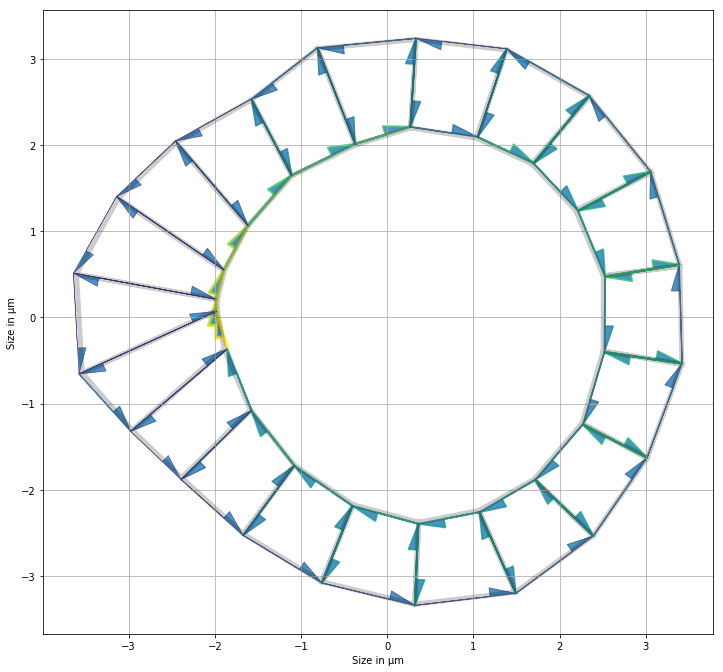

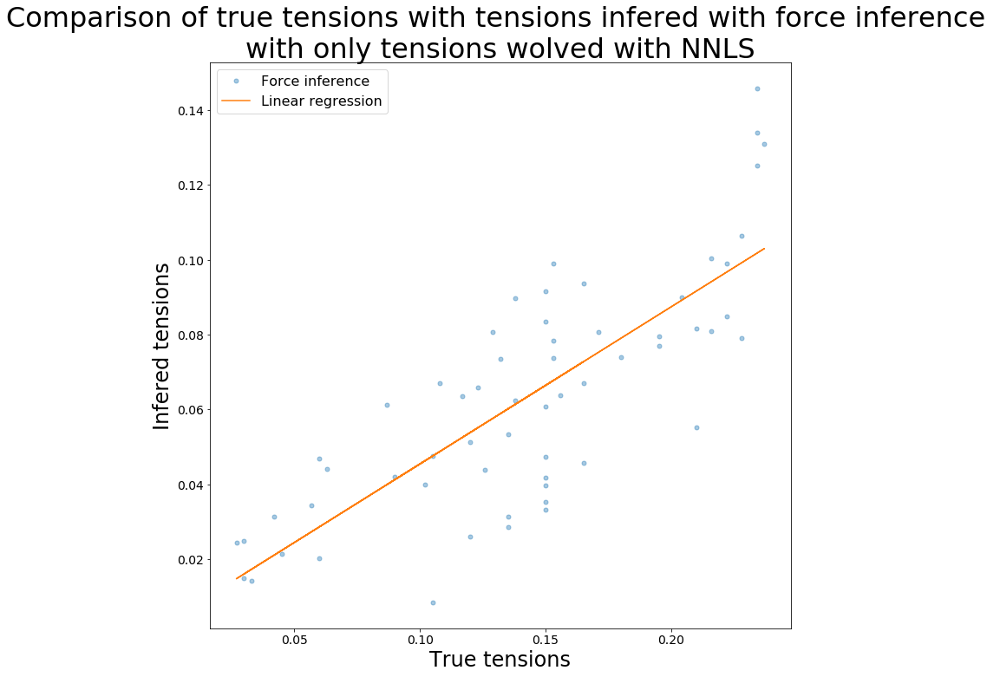

R value : 0.7923301747318165 
Standard error : 0.016466061205150224


In [9]:
(init,
 a_tmp_fi_tensions_table,
 a_tmp_cr_fi_tensions_table,
 a_tmp_fi_areas_table,
 a_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
fi_tensions_table = np.concatenate((a_tmp_fi_tensions_table, fi_tensions_table))
cr_fi_tensions_table = np.concatenate((a_tmp_cr_fi_tensions_table, cr_fi_tensions_table))
fi_areas_table = np.concatenate((a_tmp_fi_areas_table, fi_areas_table))
cr_fi_areas_table = np.concatenate((a_tmp_cr_fi_areas_table, cr_fi_areas_table))
(a_tmp_mindist_tensions_table,
 a_tmp_cr_mindist_tensions_table,
 a_tmp_mindist_areas_table,
 a_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
mindist_tensions_table = np.concatenate((mindist_tensions_table, mindist_tensions_table))
cr_mindist_tensions_table = np.concatenate((a_tmp_cr_mindist_tensions_table, cr_mindist_tensions_table))
mindist_areas_table = np.concatenate((a_tmp_mindist_areas_table, mindist_areas_table))
cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, cr_mindist_areas_table))

Un autre

Reseting datasets values with new specs


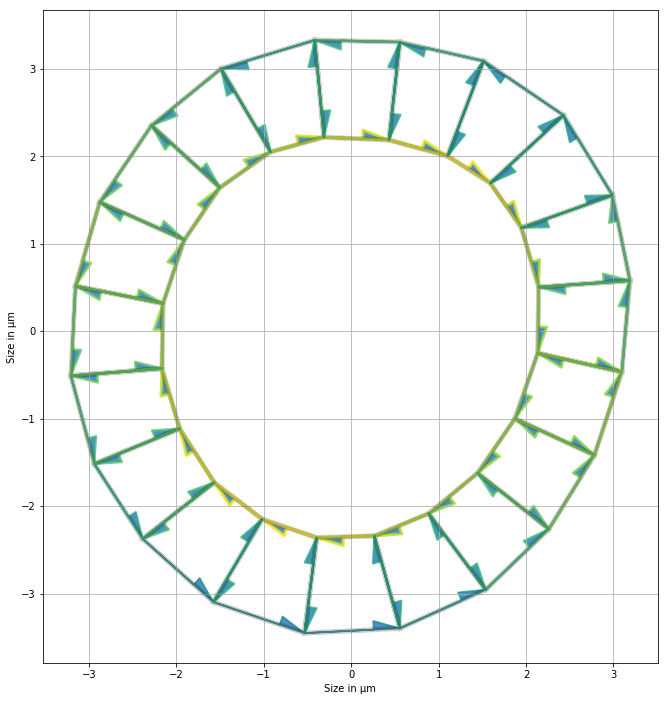

In [10]:
nf, r_in, r_out = (20, 1, 1.5)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = 3*np.array([
    0.050, 0.051, 0.052, 0.054, 0.057,
    0.060, 0.059, 0.057, 0.055, 0.052,
    0.050, 0.051, 0.052, 0.055, 0.056,
    0.058, 0.060, 0.056, 0.053, 0.051
])

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = 3*np.array([
    0.050, 0.048, 0.042, 0.032, 0.028,
    0.028, 0.030, 0.038, 0.042, 0.046,
    0.050, 0.046, 0.044, 0.036, 0.042,
    0.040, 0.034, 0.036, 0.044, 0.045
])

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = 3*np.array([
    0.050, 0.049, 0.045, 0.040, 0.038,
    0.038, 0.039, 0.043, 0.044, 0.046,
    0.048, 0.046, 0.045, 0.041, 0.040,
    0.039, 0.037, 0.038, 0.040, 0.045,
    0.049, 0.045, 0.040, 0.038,
    0.038, 0.039, 0.043, 0.044, 0.046,
    0.048, 0.046, 0.045, 0.041, 0.040,
    0.039, 0.037, 0.038, 0.040, 0.045, 0.050
])

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area
real_tensions_table = np.concatenate((real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
cr_real_tensions_table = np.concatenate((cr_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
real_areas_table = np.concatenate((real_areas_table,
                                   organo.face_df.prefered_area.values))
cr_real_areas_table = np.concatenate((cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

## Matrice et constante de l'inférence de forces

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.05007353 0.05413873 0.05925272 0.06643865 0.06955155 0.07167783
 0.06808846 0.06202495 0.06054525 0.05501661 0.05287849 0.05635299
 0.05792441 0.06681575 0.06320972 0.06761199 0.07171136 0.06656538
 0.05910693 0.05404899] 
Basal tensions:  [0.05084653 0.05177623 0.05042956 0.04594681 0.04234867 0.04175957
 0.04176928 0.04543747 0.0485197  0.04979521 0.05253119 0.05124125
 0.05046435 0.0476945  0.05004864 0.05050871 0.0466771  0.04774087
 0.0509474  0.04927343] 
Lateral tensions:  [0.0809692  0.07899395 0.07869713 0.07762856 0.07917132 0.07919658
 0.07794415 0.08054337 0.07756341 0.07853284 0.07941568 0.07720721
 0.07934165 0.07744815 0.07731416 0.07500979 0.07437952 0.07727969
 0.07603475 0.07789433] 
Area elasticity:  [0.09033954 0.09285008 0.0918245  0.0910083  0.08842739 0.08904683
 0.08838707 0.0887892  0.09203073 0.0904067  0.09069505 0.09192692
 0.08958688 0.092498   0.08756235 0.08981789 0.09148444 0.09088883
 0.09119363 0.09083361] 
Lumen area elasticity:  

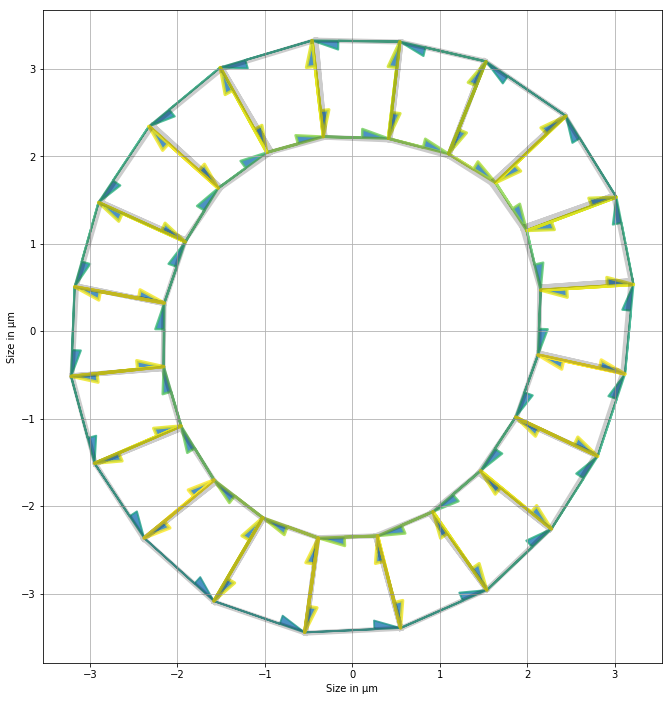

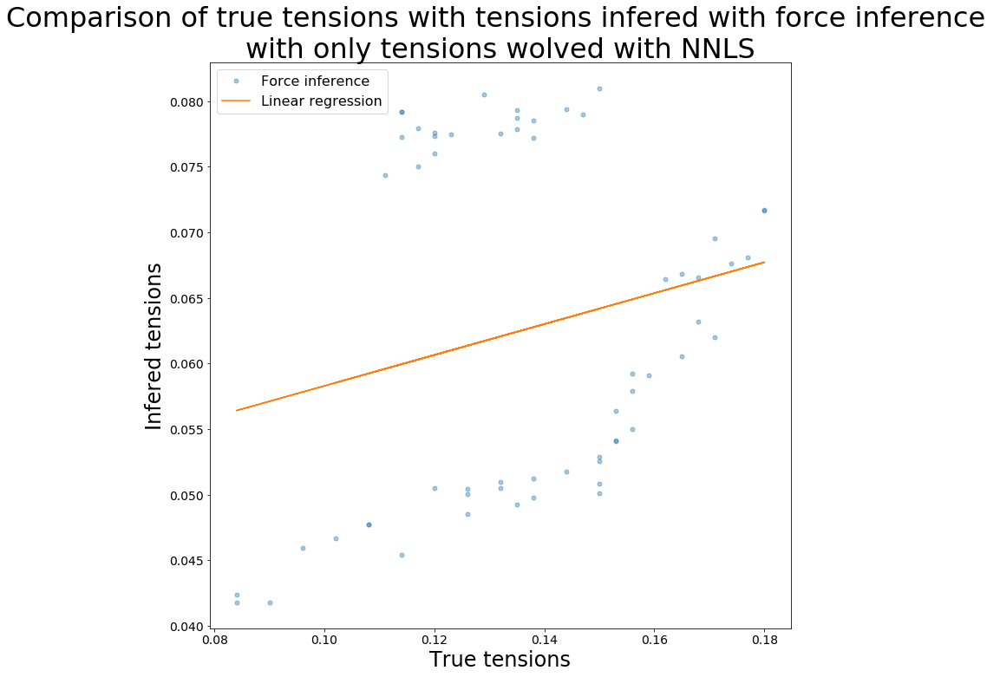

R value : 0.2186917445396706 
Standard error : 0.010898525403651896
1.0543349116182568 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.   

1.0543349130234105 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423623 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349164547475 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423623 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349070885686 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014635 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687895 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349127721047 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014635 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349153192934 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423623 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349104411321 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349101962736 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014635 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349163821207 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557059 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346504 0.01273208 0.01083506 0.00721965 0.01214788 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349004800604 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014635 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846112 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349201368015 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199492 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349116182568 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349116182568 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.0543349116182568 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.054334917388771 [0.02399249 0.01560677 0.03293226 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423623 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.0543349369674477 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255573 0.03014636 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735313 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346504 0.01273208 0.01083505 0.00721964 0.01214788 0.01473118
 0.02603148 0.02846113 0.04423623 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199492 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

1.054334859657705 [0.02399249 0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014635 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195586 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735312 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346504 0.01273208 0.01083505 0.00721965 0.01214788 0.01473118
 0.02603148 0.02846113 0.04423623 0.02813431 0.04325795 0.01399737
 0.01687895 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.054334891001377 [0.0239925  0.01560677 0.03293227 0.04141843 0.02545007 0.00914106
 0.01557058 0.03255574 0.03014635 0.02331462 0.00695313 0.02209945
 0.0333789  0.05460838 0.02195587 0.02738424 0.02881762 0.05194481
 0.0608792  0.03735312 0.03428294 0.03089374 0.01827975 0.00721356
 0.00346505 0.01273208 0.01083505 0.00721965 0.01214787 0.01473118
 0.02603148 0.02846113 0.04423622 0.0281343  0.04325796 0.01399737
 0.01687894 0.01639221 0.03764639 0.05199491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6091470339952534 [0.00969826 0.01436193 0.01946408 0.02563021 0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829249
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470351362138 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470377903836 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470327173578 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470358238874 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400758 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470326538775 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470346439168 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470353569666 [0.00969826 0.01436193 0.01946408 0.02563021 0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470332898083 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263064 0.0185893  0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.609147039880511 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.6091470347726002 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470347726002 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470347726002 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318047 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470411749331 [0.00969825 0.01436192 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149344 0.01205674 0.01829249
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318048 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470419255871 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476785 0.01400757 0.01628568 0.01301155
 0.01318048 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470413803002 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380619 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318048 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.6091470510897725 [0.00969826 0.01436193 0.01946408 0.0256302  0.02014043 0.01666405
 0.00996189 0.02178782 0.01263065 0.01858931 0.01175988 0.00813478
 0.01377374 0.01838887 0.00250692 0.01289412 0.01442675 0.02263143
 0.02380618 0.01583741 0.02127967 0.01149343 0.01205674 0.01829248
 0.01797967 0.01279811 0.01476784 0.01400757 0.01628568 0.01301155
 0.01318048 0.01676348 0.01080589 0.02140728 0.01859342 0.00585921
 0.01487103 0.01692105 0.00993559 0.01574819 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715982939698 [0.01474778 0.00759    0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731893 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715974597695 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360716008118724 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375668 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715996144836 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269474 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715989676219 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715971417291 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360716011458504 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269474 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.536071594428384 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.5360715961390736 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176469 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715931480273 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375668 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715985025827 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715985025827 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715985025827 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360715985025827 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360716092852431 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305636 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360716134840353 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645912
 0.01269473 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544442
 0.01434454 0.00981448 0.01777771 0.01673644 0.01375667 0.00420887
 0.01496503 0.01883676 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.5360716104962508 [0.01474778 0.00759001 0.01170885 0.01421938 0.01813317 0.01291651
 0.01393533 0.01250618 0.01492209 0.01257191 0.00916729 0.01122795
 0.01362353 0.01514106 0.0083513  0.01181865 0.00602465 0.01645911
 0.01269474 0.01402562 0.01185053 0.01108859 0.01731892 0.01942537
 0.01496429 0.01305635 0.00850218 0.01538376 0.01176468 0.01544441
 0.01434454 0.00981448 0.0177777  0.01673644 0.01375667 0.00420886
 0.01496503 0.01883677 0.01760504 0.01744185 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.49092046226641955 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.4909204613595327 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291276 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.49092045738922896 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689755 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.4909204622883103 [0.0095786  0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146046 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4909204628761494 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.490920460871059 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.01218879 0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.49092045953641067 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146046 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.49092046500926056 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715281 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.49092046095467823 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715281 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.01218879 0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097926 0.01116666
 0.00938067 0.00731467 0.01356232 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.4909204562742376 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715281 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356232 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4909204617036242 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4909204617036242 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4909204617036242 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4909204617036242 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146045 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.49092047275297257 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291276 0.00823538 0.01293356 0.00802946 0.00629017
 0.0121888  0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146046 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436155 0.01210871 0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356232 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.49092047440980374 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.01218879 0.01689756 0.00800493 0.00891693 0.01510391 0.02386235
 0.01146046 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356232 0.0171657  0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.49092046615531604 [0.00957861 0.00625135 0.0135748  0.0180465  0.01715282 0.01274683
 0.00990144 0.01291275 0.00823538 0.01293356 0.00802946 0.00629017
 0.01218879 0.01689756 0.00800494 0.00891693 0.01510391 0.02386235
 0.01146046 0.00738645 0.00986893 0.00689086 0.01129967 0.01280198
 0.01439289 0.01436154 0.0121087  0.00948844 0.01097925 0.01116666
 0.00938067 0.00731467 0.01356231 0.01716569 0.01857338 0.00528311
 0.02040815 0.02072837 0.01558798 0.01008216 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.44096390824580045 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.44096390605059455 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929366 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.44096390881673425 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415876
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.4409639082620998 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.44096390798133855 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415876
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.440963906644921 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415876
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.01223409 0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.44096390841244415 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415876
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631816 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.4409639057294335 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.01355111 0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.44096390589852336 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929366 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093876
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.44096390047948664 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.00899269 0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.4409639070407021 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4409639070407021 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4409639070407021 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4409639070407021 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703036 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.4409639140457736 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703037 0.00742896 0.0089927  0.01843357
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233186 0.01054264 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.44096389840522776 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929366 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703037 0.00742896 0.0089927  0.01843357
 0.01245368 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804143 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631816 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.44096390551391806 [0.00952128 0.00577125 0.01086815 0.01320976 0.01622337 0.01256907
 0.01213123 0.01133851 0.00929367 0.0121981  0.00859439 0.00642816
 0.01219755 0.01470457 0.00703037 0.00742896 0.0089927  0.01843356
 0.01245369 0.00952738 0.00973438 0.00582049 0.01107073 0.01415875
 0.0135511  0.01233185 0.01054263 0.01046069 0.00828338 0.01093877
 0.00932361 0.00804142 0.0122341  0.01459759 0.01239472 0.00276466
 0.01602235 0.01631817 0.01389969 0.00955911 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.3806968175595325 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.38069681692386254 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938158 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.38069681606177597 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.38069681716593395 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.3806968168563659 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.38069681615375295 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.3806968171673668 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3806968161440838 [0.00894576 0.00698175 0.00823211 0.01002    0.01195954 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3806968156127579 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845185 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.38069681194578775 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.38069681672015887 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.38069681672015887 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.38069681672015887 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.38069681672015887 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.38069683512278796 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938158 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083747 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.3806968289336256 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007493 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132933 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3806968296968578 [0.00894576 0.00698175 0.00823211 0.01002    0.01195955 0.01085061
 0.00993614 0.00938157 0.00725002 0.01036701 0.00845186 0.00684686
 0.01020343 0.01162881 0.00713749 0.00422935 0.00771449 0.01362659
 0.00921044 0.00801359 0.00892568 0.00638422 0.00896211 0.01092226
 0.01156892 0.0110323  0.01083746 0.00889946 0.0084829  0.00947154
 0.00795566 0.00790418 0.01007492 0.01268092 0.01119464 0.00682886
 0.01318625 0.01422067 0.01132934 0.0088471  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3766239845257276 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.00871669 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239832315318 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239835623173 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008441 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239842643126 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239842361637 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.01155321 0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239831145222 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.37662398401407715 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.37662398289923527 [0.00901389 0.00702085 0.00819061 0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.00871669 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.37662398347734877 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.0072958  0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.00871669 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3766239833295717 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.00871669 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239839845915 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239839845915 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239839845915 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239839845915 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3766239975113632 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.01155321 0.010996   0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.37662399512949074 [0.00901389 0.00702085 0.0081906  0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.0115532  0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.0077089  0.0099956  0.01271368 0.01105739 0.00637405
 0.01316172 0.01440515 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.37662400791794476 [0.00901389 0.00702085 0.00819061 0.00986649 0.011718   0.01067546
 0.00984665 0.00925375 0.00729579 0.01031944 0.00846353 0.0069334
 0.01008442 0.01150607 0.00713016 0.00406917 0.00740948 0.01322204
 0.00903192 0.0080157  0.00880638 0.00630816 0.00877431 0.0107876
 0.01155321 0.01099599 0.01071974 0.0087829  0.0083663  0.00940524
 0.0078442  0.00770889 0.0099956  0.01271368 0.01105739 0.00637404
 0.01316172 0.01440516 0.01107998 0.0087167  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693588479479476 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3693588467175466 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967713 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3693588470953919 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3693588476376114 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.36935884767160543 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967713 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693588465800853 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.369358847437916 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

0.36935884642807265 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693588469324144 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3693588467467084 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714509 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562606
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693588605967827 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038043
 0.00967713 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148854 0.01090458 0.01050563 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3693588591971799 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967713 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814996 0.00924588
 0.0076083  0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3693588688686574 [0.00912726 0.00709968 0.00811132 0.00960562 0.0113282  0.01038044
 0.00967713 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303654 0.01462939 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693591276302319 [0.00912739 0.00709994 0.00810565 0.00960891 0.0113292  0.0103806
 0.00967727 0.00903659 0.00735311 0.0102536  0.00849394 0.00705211
 0.00990931 0.0113422  0.0071452  0.00388516 0.00700086 0.01263844
 0.0087261  0.00801453 0.00856911 0.006116   0.00842977 0.01053809
 0.01148628 0.01090447 0.01050567 0.00854336 0.00815002 0.00924597
 0.00760837 0.00735916 0.00982009 0.01271608 0.01076744 0.00562606
 0.01303661 0.01462948 0.01067093 0.00845606 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935266213676143 [0.00912741 0.0070999  0.00811136 0.00960551 0.01132788 0.01037721
 0.00967332 0.00903612 0.00735309 0.01025351 0.00849398 0.0070522
 0.00990923 0.01134201 0.00714524 0.0038851  0.00700076 0.01263811
 0.00872598 0.00801451 0.00856924 0.00611795 0.00843017 0.01053508
 0.01148704 0.01090593 0.01050669 0.00854203 0.00814999 0.0092459
 0.00760836 0.00735922 0.00982001 0.01271596 0.01076744 0.00562637
 0.01303657 0.0146293  0.01067088 0.00845611 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935918406895896 [0.0091274  0.00709984 0.0081114  0.00960568 0.01132826 0.01038053
 0.00967725 0.00903773 0.00735397 0.01024873 0.00849423 0.00705217
 0.00990929 0.01134212 0.00714522 0.00388514 0.00700081 0.01263829
 0.00872604 0.00801451 0.00856926 0.0061179  0.00843021 0.0105352
 0.01148858 0.01090461 0.01050553 0.00854098 0.00815264 0.00924676
 0.00760707 0.00735904 0.00982003 0.01271604 0.01076746 0.00562622
 0.01303661 0.01462942 0.01067092 0.00845611 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.36936073162870925 [0.00912741 0.0070998  0.00811145 0.00960577 0.01132838 0.01038061
 0.00967729 0.00903662 0.00735315 0.01025368 0.00849484 0.00704906
 0.00990892 0.01134307 0.00714518 0.00388519 0.00700088 0.01263847
 0.00872612 0.00801453 0.00856927 0.00611785 0.00843023 0.01053526
 0.01148865 0.01090467 0.01050572 0.00854337 0.00814999 0.0092458
 0.00760608 0.00736037 0.00982235 0.01271419 0.01076729 0.00562603
 0.01303662 0.01462951 0.01067095 0.00845611 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.36936599135620646 [0.00912738 0.00709982 0.00811138 0.00960565 0.01132823 0.01038051
 0.00967721 0.00903655 0.0073531  0.01025354 0.00849394 0.00705215
 0.00990922 0.01134196 0.00714479 0.0038917  0.00700142 0.01263827
 0.00872602 0.00801449 0.00856924 0.0061179  0.0084302  0.01053517
 0.01148855 0.01090461 0.01050567 0.00854334 0.00815003 0.00924594
 0.00760836 0.00735916 0.00981993 0.01271396 0.01076906 0.00562707
 0.01303443 0.01462913 0.01067086 0.00845609 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.36935281816508314 [0.00912738 0.00709986 0.00811141 0.00960568 0.01132827 0.01038053
 0.00967723 0.00903657 0.00735312 0.01025357 0.00849396 0.00705216
 0.00990928 0.01134212 0.00714525 0.00388493 0.00700063 0.01263693
 0.00872034 0.00801446 0.0085691  0.00611784 0.00843019 0.01053518
 0.01148856 0.01090462 0.01050568 0.00854334 0.00815002 0.00924594
 0.00760836 0.00735917 0.00982005 0.01271601 0.01076738 0.0056259
 0.01303519 0.01463083 0.01067133 0.00845445 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3693554823209542 [0.00912504 0.00709708 0.0081128  0.0096058  0.01132825 0.01038048
 0.00967718 0.00903652 0.00735306 0.01025352 0.00849389 0.00705208
 0.00990922 0.01134208 0.00714516 0.00388514 0.00700077 0.01263828
 0.00872615 0.00801576 0.00856875 0.00611753 0.00842917 0.01053495
 0.0114885  0.01090459 0.01050565 0.00854331 0.00814999 0.00924591
 0.00760832 0.00735914 0.00982002 0.01271599 0.01076739 0.00562612
 0.01303655 0.01462934 0.01067068 0.00845533 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.369360827429279 [0.00912735 0.00709974 0.00811159 0.00960681 0.01132532 0.01038141
 0.00967723 0.00903655 0.00735306 0.01025356 0.00849388 0.00705206
 0.00990927 0.01134217 0.00714515 0.00388517 0.00700082 0.01263841
 0.00872607 0.00801447 0.0085692  0.00611769 0.00843031 0.01053874
 0.01148574 0.01090419 0.01050556 0.00854332 0.00814999 0.00924594
 0.00760834 0.00735913 0.00982007 0.01271606 0.01076742 0.00562602
 0.01303659 0.01462947 0.01067091 0.00845606 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693614339734693 [0.00912734 0.00709972 0.00811141 0.00960574 0.01132834 0.01038113
 0.00967445 0.00903705 0.00735362 0.01025356 0.00849389 0.00705205
 0.00990928 0.01134219 0.00714514 0.00388517 0.00700083 0.01263845
 0.00872608 0.00801447 0.00856922 0.00611779 0.00843019 0.01053523
 0.01148854 0.01090424 0.0105042  0.00854626 0.00814994 0.00924583
 0.00760833 0.00735912 0.00982008 0.01271608 0.01076742 0.00562598
 0.01303659 0.01462949 0.01067092 0.00845606 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.36935841831457206 [0.00912733 0.00709974 0.00811138 0.00960568 0.01132827 0.01038051
 0.00967721 0.00903666 0.00735421 0.01025038 0.00849287 0.00705325
 0.00990932 0.01134213 0.00714515 0.00388515 0.00700079 0.01263833
 0.00872603 0.00801445 0.0085692  0.00611781 0.00843017 0.01053518
 0.01148856 0.01090459 0.01050562 0.00854313 0.00814915 0.00924453
 0.00761087 0.00735856 0.00981986 0.01271599 0.01076739 0.00562606
 0.01303656 0.01462941 0.01067088 0.00845605 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.3693601499539575 [0.00912733 0.00709974 0.00811138 0.00960569 0.01132828 0.01038052
 0.0096772  0.00903654 0.00735306 0.01025356 0.00849396 0.00705284
 0.00990838 0.01133927 0.0071457  0.00388531 0.00700082 0.01263835
 0.00872604 0.00801446 0.00856921 0.00611782 0.00843018 0.01053519
 0.01148857 0.01090461 0.01050566 0.00854332 0.00814999 0.0092459
 0.00760817 0.00735875 0.00982224 0.01271616 0.01076712 0.00562595
 0.01303653 0.01462942 0.01067089 0.00845606 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693591179200248 [0.00912734 0.00709972 0.00811141 0.00960575 0.01132835 0.01038056
 0.00967724 0.00903656 0.00735306 0.01025358 0.00849388 0.00705205
 0.00990929 0.0113422  0.00714631 0.00388938 0.00699806 0.01263906
 0.00872604 0.00801447 0.00856921 0.00611777 0.00843018 0.01053523
 0.01148862 0.01090463 0.01050567 0.00854333 0.00814997 0.00924593
 0.00760833 0.0073591  0.00982005 0.01271589 0.01076673 0.00562496
 0.0130333  0.01462908 0.0106708  0.00845603 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.36935579683659225 [0.00912818 0.00709984 0.00811139 0.00960566 0.01132823 0.01038049
 0.00967718 0.00903653 0.00735306 0.01025352 0.00849389 0.00705208
 0.00990923 0.01134209 0.00714516 0.00388511 0.00700079 0.01263905
 0.00872233 0.00801406 0.00856881 0.00611773 0.00843014 0.01053516
 0.01148855 0.01090459 0.01050565 0.00854331 0.00814999 0.00924591
 0.00760833 0.00735914 0.00982003 0.012716   0.01076739 0.00562608
 0.01303646 0.01462889 0.01066854 0.00845723 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.3693521579397216 [0.00912205 0.00711353 0.00810517 0.00960516 0.01132789 0.01038013
 0.00967681 0.00903618 0.00735261 0.01025317 0.0084934  0.00705156
 0.00990883 0.01134178 0.0071447  0.00388523 0.00700043 0.01263807
 0.00872567 0.00801407 0.00857427 0.00610519 0.00843636 0.01053563
 0.01148849 0.01090437 0.01050539 0.00854306 0.0081497  0.00924564
 0.00760805 0.0073588  0.00981981 0.0127158  0.01076712 0.00562565
 0.01303632 0.01462925 0.01067075 0.00845606 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.36935786663809844 [0.00912685 0.00709924 0.00811131 0.00960627 0.01134198 0.0103768
 0.00967689 0.00903618 0.00735262 0.01025315 0.00849341 0.00705158
 0.00990881 0.01134174 0.0071447  0.00388523 0.0070004  0.012638
 0.00872572 0.00801402 0.00856895 0.00611762 0.00843009 0.01053742
 0.01147679 0.01090994 0.01050587 0.00854314 0.00814976 0.00924568
 0.00760809 0.00735886 0.00981983 0.01271583 0.01076717 0.00562578
 0.01303637 0.01462926 0.01067069 0.00845581 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.36935483288807247 [0.00912685 0.00709923 0.00811106 0.00960542 0.01132795 0.01038019
 0.00967268 0.00904919 0.00735121 0.01025335 0.00849337 0.00705155
 0.00990883 0.01134177 0.00714469 0.00388523 0.00700042 0.01263806
 0.00872574 0.00801402 0.00856892 0.00611748 0.00842994 0.010535
 0.01148843 0.01090484 0.01051134 0.00853191 0.00815275 0.00924598
 0.00760811 0.00735882 0.00981982 0.01271582 0.01076714 0.00562568
 0.01303634 0.01462926 0.01067066 0.00845578 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935344085685606 [0.00912684 0.00709922 0.00811106 0.00960542 0.01132796 0.01038013
 0.0096768  0.00903609 0.00735251 0.01024773 0.00850815 0.00704695
 0.00990877 0.01134171 0.00714468 0.00388523 0.00700043 0.01263807
 0.00872574 0.00801402 0.0085689  0.00611745 0.00842992 0.01053498
 0.01148836 0.01090435 0.01050539 0.00854318 0.00815027 0.00925142
 0.00759673 0.00736403 0.00982035 0.01271589 0.01076712 0.00562564
 0.01303631 0.01462925 0.01067064 0.00845575 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.3693566272201646 [0.00912686 0.00709929 0.00811104 0.00960537 0.01132788 0.01038009
 0.00967678 0.00903616 0.00735262 0.01025313 0.00849335 0.00705167
 0.00990677 0.01135671 0.00714321 0.00388471 0.00700029 0.01263794
 0.0087257  0.00801403 0.00856894 0.00611754 0.00842995 0.01053498
 0.01148836 0.01090439 0.01050544 0.0085431  0.00814976 0.00924568
 0.00760821 0.00735931 0.00982342 0.01270332 0.01077201 0.00562631
 0.01303653 0.01462925 0.01067068 0.00845581 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3693677474427627 [0.00912687 0.00709927 0.00811106 0.00960542 0.01132794 0.01038013
 0.00967681 0.00903619 0.00735263 0.01025317 0.00849342 0.00705159
 0.00990883 0.01134176 0.00714428 0.00389007 0.00701507 0.01263638
 0.00872597 0.00801403 0.00856896 0.00611752 0.00842997 0.01053502
 0.01148841 0.01090442 0.01050545 0.00854311 0.00814976 0.00924569
 0.0076081  0.00735886 0.00981986 0.01271599 0.01076797 0.00563137
 0.01302471 0.01463461 0.01067119 0.00845591 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3693534894673927 [0.00912371 0.00709932 0.00811095 0.00960538 0.01132791 0.0103801
 0.00967678 0.00903616 0.00735261 0.01025314 0.0084934  0.00705157
 0.00990881 0.01134173 0.0071447  0.00388524 0.00700039 0.01263788
 0.0087205  0.00802826 0.0085739  0.00611776 0.00843004 0.01053498
 0.01148835 0.01090436 0.0105054  0.00854307 0.00814972 0.00924564
 0.00760806 0.00735883 0.0098198  0.01271579 0.01076713 0.00562575
 0.0130364  0.01462986 0.01067659 0.00844355 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36935884742418373 [0.00912726 0.00709968 0.00811132 0.00960562 0.01132819 0.01038044
 0.00967712 0.00903647 0.00735299 0.01025347 0.00849381 0.007052
 0.00990917 0.01134204 0.00714508 0.00388516 0.00700072 0.01263825
 0.00872597 0.00801439 0.00856917 0.00611778 0.00843014 0.01053515
 0.01148853 0.01090457 0.01050562 0.00854329 0.00814995 0.00924588
 0.00760829 0.0073591  0.00982001 0.01271598 0.01076737 0.00562605
 0.01303653 0.01462938 0.01067086 0.00845602 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.36936264875569347 [0.00912572 0.00709801 0.00811134 0.00960549 0.01132811 0.01038044
 0.00967716 0.00903653 0.00735313 0.01025351 0.00849399 0.00705222
 0.00990922 0.01134199 0.00714524 0.0038851  0.00700074 0.01263806
 0.00872589 0.0080146  0.00857119 0.00611984 0.00843055 0.01053528
 0.01148855 0.01090464 0.01050571 0.00854338 0.00815008 0.00924596
 0.0076084  0.00735927 0.00982004 0.01271599 0.01076748 0.00562645
 0.01303662 0.01462934 0.01067103 0.00845638 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.36936438569595736 [0.00912737 0.00709978 0.00811164 0.00960593 0.01132647 0.01038061
 0.00967723 0.00903657 0.0073531  0.01025357 0.00849393 0.00705211
 0.00990928 0.01134215 0.00714519 0.00388514 0.00700083 0.01263836
 0.00872606 0.00801449 0.00856926 0.00611793 0.00843023 0.01053602
 0.01149097 0.0109049  0.01050575 0.00854336 0.00815001 0.00924595
 0.00760836 0.00735916 0.00982007 0.01271604 0.01076743 0.0056261
 0.01303659 0.01462944 0.01067091 0.00845609 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3693642731207753 [0.00912738 0.0070998  0.0081114  0.0096057  0.01132829 0.01038067
 0.00967551 0.00903648 0.00735327 0.01025357 0.00849393 0.00705212
 0.00990927 0.01134214 0.00714519 0.00388514 0.00700082 0.01263834
 0.00872605 0.0080145  0.00856925 0.00611787 0.00843021 0.01053521
 0.01148863 0.01090487 0.01050782 0.00854446 0.00815007 0.00924602
 0.00760837 0.00735918 0.00982007 0.01271605 0.01076744 0.00562614
 0.01303659 0.01462944 0.01067092 0.0084561  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.36936231654466445 [0.0091274  0.00709992 0.00811134 0.00960552 0.01132807 0.0103804
 0.00967713 0.00903645 0.00735317 0.01025145 0.00849302 0.00705232
 0.00990914 0.01134193 0.00714525 0.00388509 0.00700071 0.01263799
 0.00872593 0.0080145  0.00856927 0.00611802 0.00843021 0.01053513
 0.01148851 0.01090463 0.01050573 0.00854349 0.00815044 0.00924803
 0.00760952 0.00735952 0.00982014 0.01271598 0.01076748 0.00562651
 0.01303662 0.01462929 0.01067091 0.00845615 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.3693636540955677 [0.00912738 0.00709982 0.00811139 0.00960567 0.01132825 0.01038051
 0.00967721 0.00903655 0.0073531  0.01025354 0.00849389 0.0070523
 0.00990846 0.01134036 0.00714534 0.00388507 0.00700079 0.01263828
 0.00872603 0.00801449 0.00856926 0.0061179  0.00843022 0.01053521
 0.01148859 0.01090465 0.01050571 0.00854337 0.00815005 0.00924598
 0.00760849 0.00735943 0.00982136 0.01271789 0.01076769 0.00562627
 0.01303664 0.01462944 0.01067093 0.00845612 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.3693652547313425 [0.00912737 0.00709991 0.0081113  0.00960549 0.01132803 0.01038038
 0.00967711 0.00903649 0.00735311 0.01025344 0.00849396 0.00705221
 0.00990915 0.01134191 0.00714517 0.00388692 0.00699908 0.012638
 0.00872593 0.00801447 0.00856925 0.00611802 0.00843018 0.01053507
 0.01148844 0.01090456 0.01050566 0.00854333 0.00815007 0.00924592
 0.00760837 0.00735927 0.00981999 0.01271599 0.01076778 0.00562851
 0.01303886 0.01462952 0.0106709  0.00845613 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.3693641002668639 [0.00912754 0.00709976 0.00811138 0.00960567 0.01132826 0.01038052
 0.00967721 0.00903656 0.00735311 0.01025356 0.00849394 0.00705214
 0.00990926 0.01134211 0.00714519 0.00388514 0.00700081 0.01263836
 0.00872393 0.00801394 0.00856945 0.00611798 0.00843023 0.01053521
 0.01148859 0.01090465 0.0105057  0.00854337 0.00815004 0.00924596
 0.00760838 0.0073592  0.00982007 0.01271604 0.01076746 0.00562623
 0.01303665 0.01462974 0.01067315 0.00845762 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

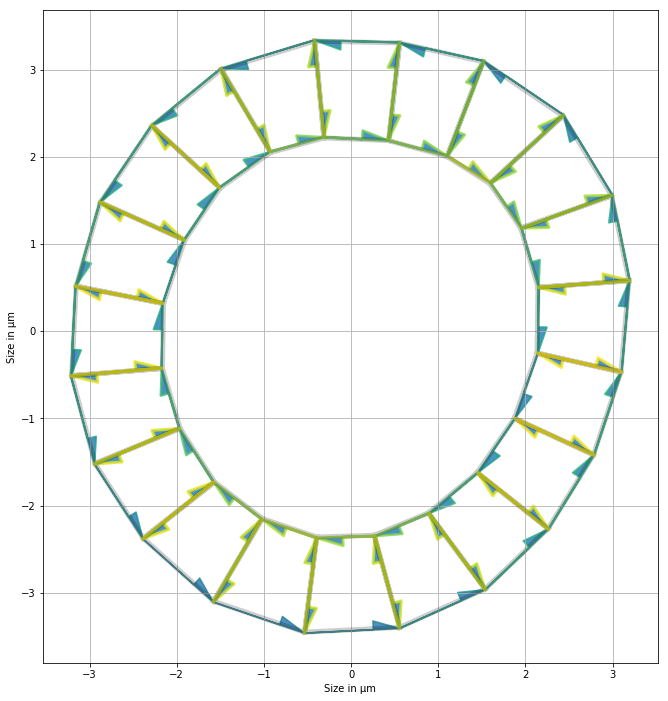

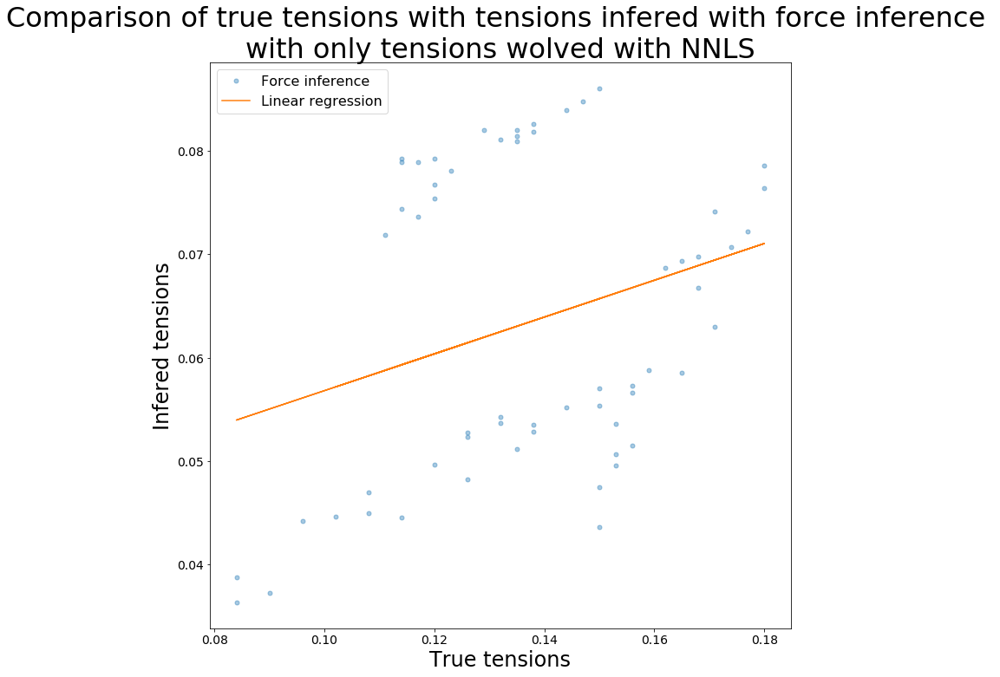

R value : 0.2920206422769778 
Standard error : 0.012063075036763652


In [11]:
(init,
 b_tmp_fi_tensions_table,
 b_tmp_cr_fi_tensions_table,
 b_tmp_fi_areas_table,
 b_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
fi_tensions_table = np.concatenate((b_tmp_fi_tensions_table, fi_tensions_table))
cr_fi_tensions_table = np.concatenate((b_tmp_cr_fi_tensions_table, cr_fi_tensions_table))
fi_areas_table = np.concatenate((b_tmp_fi_areas_table, fi_areas_table))
cr_fi_areas_table = np.concatenate((b_tmp_cr_fi_areas_table, cr_fi_areas_table))
(b_tmp_mindist_tensions_table,
 b_tmp_cr_mindist_tensions_table,
 b_tmp_mindist_areas_table,
 b_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
mindist_tensions_table = np.concatenate((mindist_tensions_table, mindist_tensions_table))
cr_mindist_tensions_table = np.concatenate((b_tmp_cr_mindist_tensions_table, cr_mindist_tensions_table))
mindist_areas_table = np.concatenate((b_tmp_mindist_areas_table, mindist_areas_table))
cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, cr_mindist_areas_table))

## Un autre...

In [ ]:
nf, r_in, r_out = (20, 1, 1.5)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = 3*np.array([
    0.050, 0.051, 0.052, 0.054, 0.057,
    0.060, 0.059, 0.057, 0.055, 0.052,
    0.050, 0.051, 0.052, 0.051, 0.050,
    0.051, 0.050, 0.051, 0.052, 0.051
])

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = 3*np.array([
    0.050, 0.048, 0.042, 0.032, 0.028,
    0.028, 0.030, 0.038, 0.042, 0.046,
    0.050, 0.046, 0.048, 0.046, 0.048,
    0.050, 0.044, 0.046, 0.044, 0.045
])

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = 3*np.array([
    0.050, 0.049, 0.045, 0.040, 0.038,
    0.038, 0.039, 0.043, 0.044, 0.046,
    0.048, 0.046, 0.045, 0.046, 0.045,
    0.047, 0.047, 0.048, 0.050, 0.045,
    0.049, 0.045, 0.040, 0.038,
    0.038, 0.039, 0.043, 0.044, 0.046,
    0.048, 0.046, 0.045, 0.046, 0.045,
    0.047, 0.047, 0.048, 0.050, 0.045, 0.050
])

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area

real_tensions_table = np.concatenate((real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
cr_real_tensions_table = np.concatenate((cr_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
real_areas_table = np.concatenate((real_areas_table,
                                   organo.face_df.prefered_area.values))
cr_real_areas_table = np.concatenate((cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

In [ ]:
(init,
 c_tmp_fi_tensions_table,
 c_tmp_cr_fi_tensions_table,
 c_tmp_fi_areas_table,
 c_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
fi_tensions_table = np.concatenate((c_tmp_fi_tensions_table, fi_tensions_table))
cr_fi_tensions_table = np.concatenate((c_tmp_cr_fi_tensions_table, cr_fi_tensions_table))
fi_areas_table = np.concatenate((c_tmp_fi_areas_table, fi_areas_table))
cr_fi_areas_table = np.concatenate((c_tmp_cr_fi_areas_table, cr_fi_areas_table))
(c_tmp_mindist_tensions_table,
 c_tmp_cr_mindist_tensions_table,
 c_tmp_mindist_areas_table,
 c_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
mindist_tensions_table = np.concatenate((mindist_tensions_table, mindist_tensions_table))
cr_mindist_tensions_table = np.concatenate((c_tmp_cr_mindist_tensions_table, cr_mindist_tensions_table))
mindist_areas_table = np.concatenate((c_tmp_mindist_areas_table, mindist_areas_table))
cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, cr_mindist_areas_table))

## Un autre

In [12]:
def create_organo(nb_cells, r_in, r_out, seed=None, rot=None, geom=geom):
    organo = generate_ring(nb_cells, r_in, r_out)
    Nf = organo.Nf
    geom.update_all(organo)
    alpha = 1 + 1/(20*(organo.settings['R_out']-organo.settings['R_in']))
    specs = {
        'face': {
            'is_alive': 1,
            'prefered_area': organo.face_df.area,
            'area_elasticity': 1., },
        'edge': {
            'ux': 0.,
            'uy': 0.,
            'uz': 0.,
            'line_tension': 1.0,
            'is_active': 1
            },
        'vert': {
            'adhesion_strength': 0.01,
            'x_ecm': 0.,
            'y_ecm': 0.,
            'is_active': 1
            },
        'settings': {
            'lumen_elasticity': 0.1,
            'lumen_prefered_vol': organo.settings['lumen_volume'],
            'lumen_volume': organo.settings['lumen_volume']
            }
        }
    organo.update_specs(specs, reset=True)
    normalize_scale(organo, geom, refer='edges')
    geom.update_all(organo)
    if seed is not None:
        symetric_tensions = set_init_point(organo.settings['R_in'],
                                           organo.settings['R_out'],
                                           organo.Nf, alpha)
        sin_mul = 1+(np.sin(np.linspace(0, 2*np.pi, organo.Nf,
                                        endpoint=False)))**2
        organo.face_df.prefered_area *= np.random.normal(1.0, 0.05, organo.Nf)
        organo.edge_df.line_tension = prepare_tensions(organo,
                                                       symetric_tensions)
        organo.edge_df.loc[:Nf-1, 'line_tension'] *= sin_mul*np.random.normal(
            1.0, 0.05, organo.Nf)
        geom.update_all(organo)
    if rot is not None:
        organo.vert_df.loc[:, 'x'] = (organo.vert_df.x.copy() * np.cos(rot) -
                                      organo.vert_df.y.copy() * np.sin(rot))
        print('rotated x',
              organo.vert_df.x.copy() * np.cos(rot) -
              organo.vert_df.y.copy() * np.sin(rot))
        organo.vert_df.loc[:, 'y'] = (organo.vert_df.x.copy() * np.sin(rot) +
                                      organo.vert_df.y.copy() * np.cos(rot))
        print('rotated y',
              organo.vert_df.x.copy() * np.sin(rot) +
              organo.vert_df.y.copy() * np.cos(rot))
        geom.update_all(organo)
    organo.vert_df[['x_ecm', 'y_ecm']] = organo.vert_df[['x', 'y']]
    organo.vert_df.loc[organo.basal_verts, 'adhesion_strength'] = 0.01
    new_tensions = organo.edge_df.line_tension
    organo.edge_df.loc[:, 'line_tension'] = new_tensions
    return organo

In [13]:
def get_sim_mat(Nf, Ra, Rb, sum_lbda=0.01):

    sin_t = np.sin(np.pi/Nf)
    sin_2t = np.sin(2*np.pi/Nf)

    A = 0.5 * (Rb**2 - Ra**2) * sin_2t
    dAdRa = - sin_2t * Ra
    dAdRb = sin_2t * Rb
    dladRa = dlbdRb = 2*sin_t

    # variables are
    # (A - A_0), \Lambda_a, \Lambda_h
    problem_mat = np.array(
        [
            [dAdRa, dladRa, -1],
            [dAdRb, 0,       1],
            [0,     1,       1]
        ])

    b = np.array([0, 0, sum_lbda])
    return problem_mat, b

Reseting datasets values with new specs


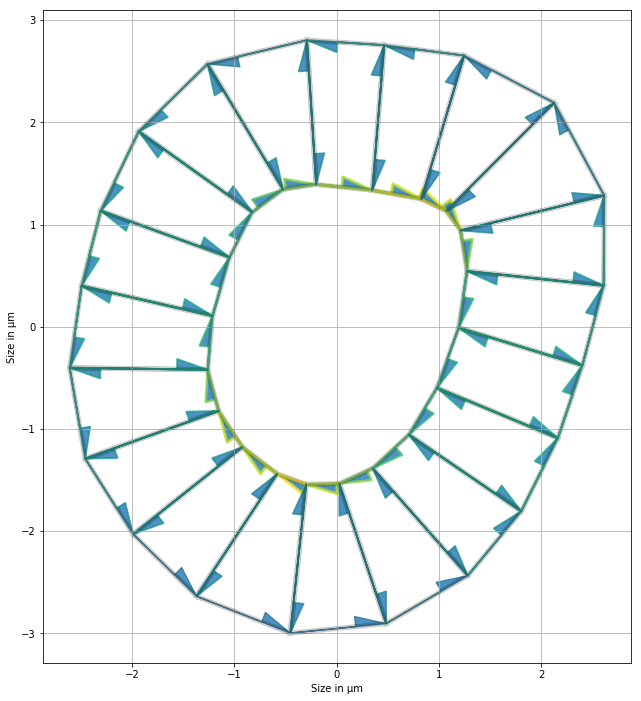

In [14]:
nf, r_in, r_out = (20, 1, 2.0)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = np.array([
    0.050, 0.054, 0.058, 0.066, 0.073,
    0.081, 0.074, 0.073, 0.065, 0.054,
    0.050, 0.051, 0.059, 0.066, 0.070,
    0.075, 0.078, 0.074, 0.065, 0.054
])

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = np.array([
    0.050, 0.048, 0.042, 0.032, 0.028,
    0.028, 0.030, 0.038, 0.042, 0.046,
    0.050, 0.046, 0.044, 0.036, 0.042,
    0.040, 0.034, 0.036, 0.044, 0.045
])

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = np.array([
    0.050, 0.049, 0.045, 0.040, 0.038,
    0.038, 0.039, 0.043, 0.044, 0.046,
    0.048, 0.046, 0.045, 0.041, 0.040,
    0.039, 0.037, 0.038, 0.040, 0.045,
    0.049, 0.045, 0.040, 0.038,
    0.038, 0.039, 0.043, 0.044, 0.046,
    0.048, 0.046, 0.045, 0.041, 0.040,
    0.039, 0.037, 0.038, 0.040, 0.045, 0.050
])

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area

real_tensions_table = np.concatenate((real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
cr_real_tensions_table = np.concatenate((cr_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
real_areas_table = np.concatenate((real_areas_table,
                                   organo.face_df.prefered_area.values))
cr_real_areas_table = np.concatenate((cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.00656647 0.00691721 0.00727106 0.00791657 0.0083039  0.00876766
 0.00822331 0.00785887 0.00747679 0.00682519 0.00667338 0.00664525
 0.00688902 0.00787978 0.00821278 0.00857221 0.00850888 0.0079873
 0.0072689  0.0068065 ] 
Basal tensions:  [0.00439964 0.00446792 0.00447478 0.00419842 0.00400608 0.00391111
 0.00392838 0.00407112 0.00426924 0.00441559 0.00469259 0.00451161
 0.00426644 0.0040463  0.00432481 0.00427311 0.00395815 0.00398965
 0.00428527 0.00428384] 
Lateral tensions:  [0.00675953 0.00655664 0.00644039 0.00613835 0.00612153 0.00593708
 0.00594586 0.00637975 0.00614346 0.00648142 0.00651149 0.00630137
 0.00667049 0.00633846 0.00610934 0.0057272  0.00579718 0.00608647
 0.00623056 0.0064332 ] 
Area elasticity:  [0.00914707 0.00923634 0.00897199 0.00875369 0.00842113 0.00856852
 0.0084218  0.00872463 0.00901999 0.0089884  0.00916783 0.00904261
 0.00882819 0.00879076 0.00859029 0.00857578 0.00851616 0.0087101
 0.00887433 0.00905904] 
Lumen area elasticity:  0.

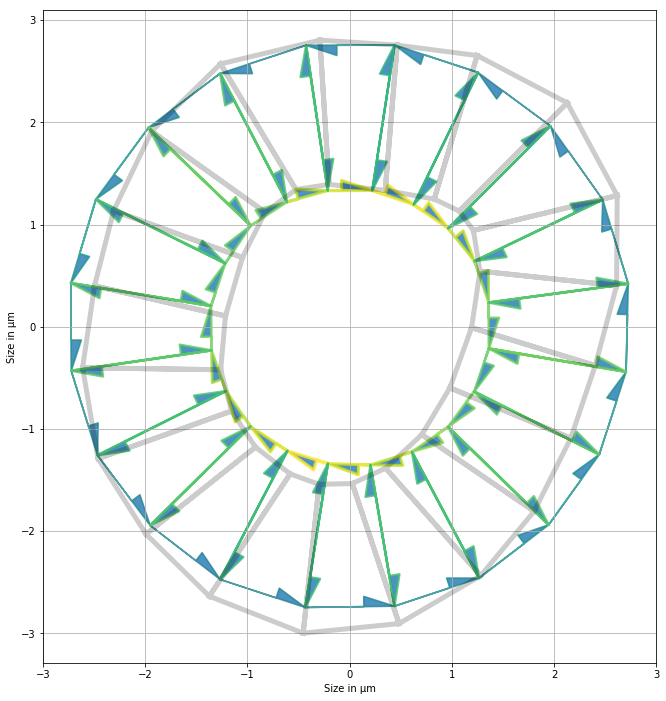

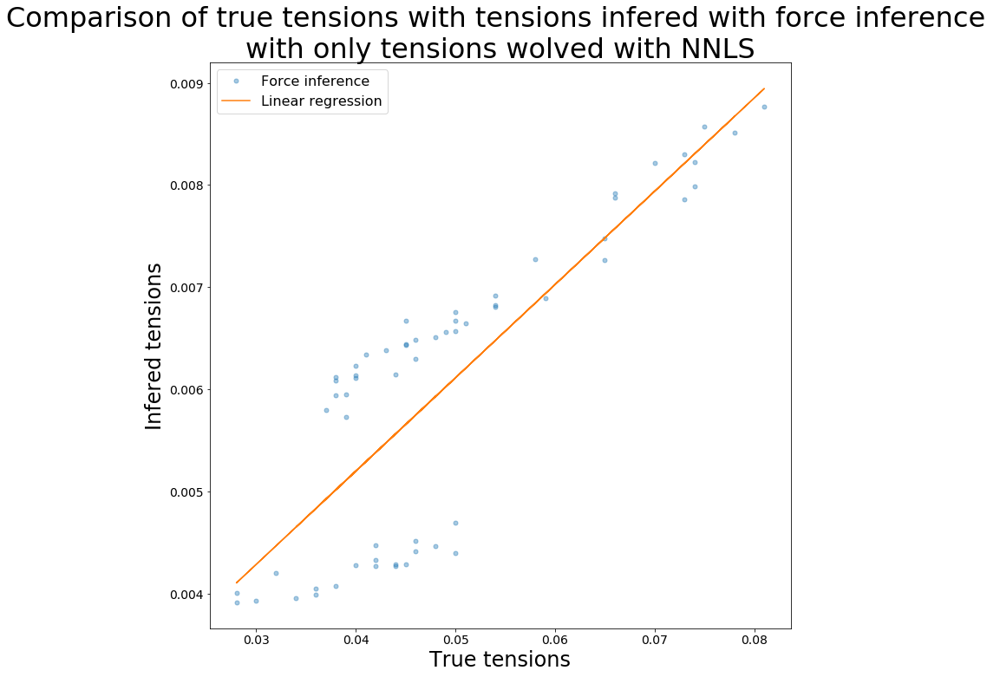

R value : 0.831404098171225 
Standard error : 0.0006963449721562008
7.431789858375023 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.    

7.431789850027276 [0.26386494 0.23861563 0.26480664 0.30123324 0.25324627 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968542 0.19255813 0.02871193
 0.17513221 0.24999857 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516681 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789862500924 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196489 0.20535839 0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789859840942 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716985 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968542 0.19255813 0.02871193
 0.17513221 0.24999857 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463039
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789856290347 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789858261516 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999857 0.19378357 0.09392483 0.03284632 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.43178986097829 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999857 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

7.431789857704672 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516681 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789855111249 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999857 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.4317898555868265 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196489 0.20535839 0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

7.431789857734682 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528066 0.27709732 0.14516681 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789858375023 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789858375023 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789858375023 [0.26386494 0.23861563 0.26480664 0.30123325 0.25324626 0.21792832
 0.22447995 0.20581898 0.20169928 0.20797914 0.17104334 0.17693201
 0.19200303 0.1502745  0.06120044 0.12716986 0.20593204 0.19939323
 0.29790543 0.31661067 0.30614889 0.31968543 0.19255813 0.02871193
 0.17513221 0.24999856 0.19378357 0.09392483 0.03284633 0.11458551
 0.23196488 0.2053584  0.04731    0.09201977 0.14305882 0.02463038
 0.16528067 0.27709732 0.14516682 0.11439048 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.43179021566913 [0.26386495 0.23861563 0.26480662 0.30123327 0.25324628 0.21792834
 0.22447997 0.205819   0.20169926 0.20797914 0.17104334 0.17693201
 0.19200305 0.15027451 0.06120044 0.12716986 0.20593207 0.19939325
 0.29790544 0.31661071 0.3061489  0.31968543 0.19255812 0.02871191
 0.17513223 0.2499986  0.19378361 0.09392485 0.03284633 0.1145855
 0.23196489 0.2053584  0.04730998 0.0920198  0.14305883 0.0246304
 0.16528067 0.27709734 0.14516683 0.11439047 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.     

7.431789730497242 [0.26386492 0.23861562 0.26480662 0.30123324 0.25324627 0.21792832
 0.22447995 0.20581898 0.20169925 0.20797911 0.17104335 0.17693202
 0.19200304 0.15027449 0.06120044 0.12716985 0.20593204 0.19939324
 0.29790543 0.31661069 0.30614888 0.31968542 0.19255813 0.02871191
 0.17513221 0.24999857 0.19378357 0.09392484 0.03284633 0.11458548
 0.23196488 0.20535839 0.04730998 0.09201977 0.14305882 0.0246304
 0.16528066 0.27709732 0.14516682 0.11439047 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

7.431789191401673 [0.2638649  0.2386156  0.26480664 0.3012332  0.25324622 0.21792832
 0.22447993 0.20581895 0.2016993  0.20797907 0.17104339 0.17693208
 0.19200303 0.15027444 0.06120042 0.12716985 0.20593199 0.19939321
 0.29790539 0.31661063 0.30614891 0.31968545 0.19255816 0.02871195
 0.17513213 0.24999849 0.19378349 0.09392473 0.03284636 0.11458552
 0.2319649  0.20535842 0.04731002 0.0920197  0.14305883 0.02463034
 0.16528064 0.27709729 0.14516682 0.11439049 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

7.431789376559753 [0.26386493 0.23861562 0.26480663 0.3012332  0.25324624 0.21792832
 0.22447995 0.20581895 0.20169927 0.20797911 0.17104334 0.17693202
 0.19200301 0.15027448 0.06120043 0.12716984 0.20593202 0.19939322
 0.29790539 0.31661063 0.30614889 0.31968542 0.19255813 0.02871193
 0.17513218 0.24999855 0.19378356 0.0939248  0.03284634 0.1145855
 0.23196488 0.2053584  0.04731    0.09201976 0.14305882 0.02463038
 0.16528066 0.2770973  0.14516679 0.11439046 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

7.515331464871777 [2.05078280e-01 1.85428429e-01 2.49836502e-01 3.31773992e-01
 2.21979711e-01 1.40774770e-01 1.79468545e-01 2.37498679e-01
 2.22740237e-01 2.24248042e-01 1.73575373e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200814e-01 2.12733759e-01
 2.51275434e-01 2.88606389e-01 2.92854982e-01 1.36844836e-01
 1.24848292e-01 2.14142371e-01 1.74330396e-01 1.06116389e-01
 1.12729673e-01 1.51148451e-01 2.55148454e-01 2.26441352e-01
 7.23485770e-02 1.72218395e-01 1.95762965e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.5153314539406715 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774770e-01 1.79468545e-01 2.37498678e-01
 2.22740235e-01 2.24248042e-01 1.73575373e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656748e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606391e-01 2.92854979e-01 1.36844837e-01
 1.24848290e-01 2.14142372e-01 1.74330394e-01 1.06116387e-01
 1.12729675e-01 1.51148450e-01 2.55148454e-01 2.26441352e-01
 7.23485768e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

7.51533145348368 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979709e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740235e-01 2.24248042e-01 1.73575374e-01 2.14094497e-01
 1.47264490e-01 1.44039819e-01 1.54544100e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200813e-01 2.12733759e-01
 2.51275434e-01 2.88606390e-01 2.92854978e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116388e-01
 1.12729674e-01 1.51148449e-01 2.55148455e-01 2.26441354e-01
 7.23485759e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377806e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.5153314780307126 [2.05078281e-01 1.85428431e-01 2.49836504e-01 3.31773988e-01
 2.21979710e-01 1.40774771e-01 1.79468545e-01 2.37498681e-01
 2.22740236e-01 2.24248042e-01 1.73575373e-01 2.14094495e-01
 1.47264490e-01 1.44039819e-01 1.54544100e-01 1.92359414e-01
 1.19143560e-01 1.08656749e-01 2.93200813e-01 2.12733759e-01
 2.51275436e-01 2.88606392e-01 2.92854981e-01 1.36844838e-01
 1.24848289e-01 2.14142371e-01 1.74330397e-01 1.06116389e-01
 1.12729674e-01 1.51148452e-01 2.55148454e-01 2.26441353e-01
 7.23485768e-02 1.72218396e-01 1.95762965e-01 1.06131613e-01
 1.39854977e-01 2.15487048e-01 1.40893342e-01 1.79377808e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

7.515331454967317 [2.05078279e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575373e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656748e-01 2.93200814e-01 2.12733757e-01
 2.51275434e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148451e-01 2.55148453e-01 2.26441352e-01
 7.23485767e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487048e-01 1.40893341e-01 1.79377809e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.515331447258864 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773988e-01
 2.21979709e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575372e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544100e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200812e-01 2.12733759e-01
 2.51275435e-01 2.88606391e-01 2.92854978e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485766e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.5153314514191365 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979709e-01 1.40774769e-01 1.79468545e-01 2.37498680e-01
 2.22740236e-01 2.24248041e-01 1.73575372e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485767e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

7.515331450585801 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774770e-01 1.79468545e-01 2.37498680e-01
 2.22740236e-01 2.24248041e-01 1.73575371e-01 2.14094493e-01
 1.47264488e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656748e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148451e-01 2.55148453e-01 2.26441351e-01
 7.23485772e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.51533147514717 [2.05078281e-01 1.85428431e-01 2.49836504e-01 3.31773988e-01
 2.21979710e-01 1.40774770e-01 1.79468545e-01 2.37498680e-01
 2.22740236e-01 2.24248042e-01 1.73575373e-01 2.14094494e-01
 1.47264489e-01 1.44039820e-01 1.54544102e-01 1.92359416e-01
 1.19143558e-01 1.08656748e-01 2.93200813e-01 2.12733759e-01
 2.51275436e-01 2.88606391e-01 2.92854980e-01 1.36844838e-01
 1.24848289e-01 2.14142371e-01 1.74330397e-01 1.06116389e-01
 1.12729674e-01 1.51148451e-01 2.55148454e-01 2.26441353e-01
 7.23485773e-02 1.72218396e-01 1.95762965e-01 1.06131617e-01
 1.39854976e-01 2.15487047e-01 1.40893342e-01 1.79377808e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.5153314522117345 [2.05078281e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575373e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200812e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485767e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377806e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

7.515331467499448 [2.05078280e-01 1.85428430e-01 2.49836506e-01 3.31773987e-01
 2.21979710e-01 1.40774771e-01 1.79468546e-01 2.37498681e-01
 2.22740236e-01 2.24248041e-01 1.73575373e-01 2.14094495e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359415e-01
 1.19143559e-01 1.08656749e-01 2.93200813e-01 2.12733758e-01
 2.51275436e-01 2.88606392e-01 2.92854975e-01 1.36844834e-01
 1.24848290e-01 2.14142371e-01 1.74330397e-01 1.06116389e-01
 1.12729674e-01 1.51148451e-01 2.55148454e-01 2.26441352e-01
 7.23485770e-02 1.72218396e-01 1.95762965e-01 1.06131615e-01
 1.39854977e-01 2.15487047e-01 1.40893341e-01 1.79377808e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.515331449444747 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773988e-01
 2.21979708e-01 1.40774769e-01 1.79468543e-01 2.37498681e-01
 2.22740236e-01 2.24248041e-01 1.73575373e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544100e-01 1.92359415e-01
 1.19143560e-01 1.08656748e-01 2.93200812e-01 2.12733758e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848287e-01 2.14142365e-01 1.74330404e-01 1.06116384e-01
 1.12729674e-01 1.51148451e-01 2.55148454e-01 2.26441352e-01
 7.23485768e-02 1.72218396e-01 1.95762965e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.515331467824336 [2.05078281e-01 1.85428430e-01 2.49836504e-01 3.31773988e-01
 2.21979710e-01 1.40774771e-01 1.79468546e-01 2.37498681e-01
 2.22740236e-01 2.24248040e-01 1.73575376e-01 2.14094493e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359415e-01
 1.19143560e-01 1.08656749e-01 2.93200813e-01 2.12733759e-01
 2.51275436e-01 2.88606391e-01 2.92854980e-01 1.36844837e-01
 1.24848289e-01 2.14142371e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148453e-01 2.55148449e-01 2.26441354e-01
 7.23485765e-02 1.72218395e-01 1.95762965e-01 1.06131615e-01
 1.39854977e-01 2.15487047e-01 1.40893341e-01 1.79377808e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.515331439898256 [2.05078280e-01 1.85428429e-01 2.49836502e-01 3.31773990e-01
 2.21979709e-01 1.40774768e-01 1.79468546e-01 2.37498679e-01
 2.22740237e-01 2.24248041e-01 1.73575371e-01 2.14094493e-01
 1.47264490e-01 1.44039820e-01 1.54544103e-01 1.92359415e-01
 1.19143560e-01 1.08656745e-01 2.93200813e-01 2.12733758e-01
 2.51275433e-01 2.88606389e-01 2.92854977e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330396e-01 1.06116389e-01
 1.12729672e-01 1.51148449e-01 2.55148453e-01 2.26441350e-01
 7.23485778e-02 1.72218397e-01 1.95762968e-01 1.06131612e-01
 1.39854976e-01 2.15487046e-01 1.40893340e-01 1.79377805e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.515331431581451 [2.05078280e-01 1.85428429e-01 2.49836502e-01 3.31773990e-01
 2.21979709e-01 1.40774768e-01 1.79468546e-01 2.37498679e-01
 2.22740237e-01 2.24248041e-01 1.73575371e-01 2.14094493e-01
 1.47264490e-01 1.44039818e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656744e-01 2.93200813e-01 2.12733759e-01
 2.51275434e-01 2.88606389e-01 2.92854977e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330396e-01 1.06116389e-01
 1.12729672e-01 1.51148449e-01 2.55148452e-01 2.26441350e-01
 7.23485762e-02 1.72218394e-01 1.95762963e-01 1.06131615e-01
 1.39854976e-01 2.15487043e-01 1.40893345e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.51533145082901 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575372e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485766e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.51533145082901 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575372e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485766e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.51533145082901 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575372e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485766e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.51533145082901 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575372e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485766e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.51533145082901 [2.05078280e-01 1.85428430e-01 2.49836503e-01 3.31773989e-01
 2.21979710e-01 1.40774769e-01 1.79468545e-01 2.37498679e-01
 2.22740236e-01 2.24248041e-01 1.73575372e-01 2.14094494e-01
 1.47264489e-01 1.44039819e-01 1.54544101e-01 1.92359414e-01
 1.19143560e-01 1.08656747e-01 2.93200813e-01 2.12733759e-01
 2.51275435e-01 2.88606390e-01 2.92854979e-01 1.36844837e-01
 1.24848289e-01 2.14142370e-01 1.74330397e-01 1.06116389e-01
 1.12729673e-01 1.51148450e-01 2.55148453e-01 2.26441352e-01
 7.23485766e-02 1.72218395e-01 1.95762964e-01 1.06131615e-01
 1.39854976e-01 2.15487047e-01 1.40893341e-01 1.79377807e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.515330949410495 [2.05078255e-01 1.85428437e-01 2.49836473e-01 3.31773935e-01
 2.21979693e-01 1.40774781e-01 1.79468540e-01 2.37498665e-01
 2.22740197e-01 2.24248002e-01 1.73575374e-01 2.14094473e-01
 1.47264443e-01 1.44039808e-01 1.54544065e-01 1.92359398e-01
 1.19143545e-01 1.08656785e-01 2.93200752e-01 2.12733725e-01
 2.51275434e-01 2.88606376e-01 2.92854971e-01 1.36844796e-01
 1.24848275e-01 2.14142348e-01 1.74330398e-01 1.06116369e-01
 1.12729668e-01 1.51148460e-01 2.55148434e-01 2.26441352e-01
 7.23485815e-02 1.72218415e-01 1.95762953e-01 1.06131632e-01
 1.39854969e-01 2.15487042e-01 1.40893328e-01 1.79377837e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.51533009375519 [2.05078253e-01 1.85428405e-01 2.49836441e-01 3.31774027e-01
 2.21979678e-01 1.40774700e-01 1.79468544e-01 2.37498624e-01
 2.22740246e-01 2.24248036e-01 1.73575340e-01 2.14094458e-01
 1.47264491e-01 1.44039789e-01 1.54544090e-01 1.92359377e-01
 1.19143591e-01 1.08656669e-01 2.93200802e-01 2.12733746e-01
 2.51275366e-01 2.88606330e-01 2.92854875e-01 1.36844805e-01
 1.24848288e-01 2.14142341e-01 1.74330356e-01 1.06116384e-01
 1.12729623e-01 1.51148387e-01 2.55148415e-01 2.26441289e-01
 7.23485428e-02 1.72218317e-01 1.95762897e-01 1.06131607e-01
 1.39854961e-01 2.15487011e-01 1.40893311e-01 1.79377716e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

7.515330394240951 [2.05078260e-01 1.85428405e-01 2.49836452e-01 3.31774029e-01
 2.21979683e-01 1.40774704e-01 1.79468543e-01 2.37498633e-01
 2.22740249e-01 2.24248039e-01 1.73575336e-01 2.14094461e-01
 1.47264493e-01 1.44039798e-01 1.54544099e-01 1.92359385e-01
 1.19143586e-01 1.08656672e-01 2.93200815e-01 2.12733751e-01
 2.51275382e-01 2.88606343e-01 2.92854898e-01 1.36844821e-01
 1.24848288e-01 2.14142349e-01 1.74330369e-01 1.06116390e-01
 1.12729633e-01 1.51148399e-01 2.55148425e-01 2.26441305e-01
 7.23485523e-02 1.72218331e-01 1.95762915e-01 1.06131605e-01
 1.39854963e-01 2.15487017e-01 1.40893318e-01 1.79377733e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.515324851286434 [2.05078123e-01 1.85428311e-01 2.49836176e-01 3.31774104e-01
 2.21979537e-01 1.40774480e-01 1.79468522e-01 2.37498401e-01
 2.22740223e-01 2.24247959e-01 1.73575219e-01 2.14094313e-01
 1.47264434e-01 1.44039680e-01 1.54544012e-01 1.92359232e-01
 1.19143665e-01 1.08656444e-01 2.93200683e-01 2.12733654e-01
 2.51275141e-01 2.88606111e-01 2.92854526e-01 1.36844662e-01
 1.24848264e-01 2.14142217e-01 1.74330249e-01 1.06116357e-01
 1.12729456e-01 1.51148188e-01 2.55148251e-01 2.26441082e-01
 7.23484416e-02 1.72218092e-01 1.95762661e-01 1.06131589e-01
 1.39854890e-01 2.15486876e-01 1.40893194e-01 1.79377466e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

7.515328729428895 [2.05078229e-01 1.85428367e-01 2.49836369e-01 3.31774085e-01
 2.21979640e-01 1.40774614e-01 1.79468539e-01 2.37498560e-01
 2.22740263e-01 2.24248033e-01 1.73575296e-01 2.14094423e-01
 1.47264501e-01 1.44039764e-01 1.54544089e-01 1.92359341e-01
 1.19143621e-01 1.08656564e-01 2.93200800e-01 2.12733737e-01
 2.51275301e-01 2.88606269e-01 2.92854773e-01 1.36844789e-01
 1.24848286e-01 2.14142314e-01 1.74330328e-01 1.06116389e-01
 1.12729577e-01 1.51148318e-01 2.55148370e-01 2.26441225e-01
 7.23485109e-02 1.72218238e-01 1.95762836e-01 1.06131593e-01
 1.39854942e-01 2.15486967e-01 1.40893279e-01 1.79377626e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993991725869 [1.85733716e-01 1.64672433e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663984e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414920e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876034e-02 2.30844401e-01 2.26488847e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818186e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995192e-02 1.53842187e-01 2.35249855e-01 1.60381501e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280104e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.5979940554708705 [1.85733716e-01 1.64672438e-01 2.69235323e-01 1.82077695e-01
 1.54069315e-01 1.06155405e-01 1.13400654e-01 1.92163882e-01
 1.56663987e-01 1.39181447e-01 1.19569810e-01 1.41239236e-01
 2.30557057e-01 1.65414922e-01 1.59819873e-01 1.72028463e-01
 1.66893959e-02 7.69876066e-02 2.30844404e-01 2.26488850e-01
 1.83486530e-01 2.72159062e-01 2.51571149e-01 2.70972025e-01
 7.16227640e-02 2.00413789e-01 1.82088968e-01 1.31818188e-01
 1.40765260e-01 1.14812970e-01 2.00940410e-01 2.36595616e-01
 8.95995198e-02 1.53842186e-01 2.35249856e-01 1.60381511e-02
 1.30168406e-01 2.07463195e-01 1.09030073e-01 1.93280106e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.597993967026838 [1.85733715e-01 1.64672432e-01 2.69235316e-01 1.82077694e-01
 1.54069318e-01 1.06155406e-01 1.13400648e-01 1.92163878e-01
 1.56663986e-01 1.39181440e-01 1.19569804e-01 1.41239232e-01
 2.30557053e-01 1.65414920e-01 1.59819873e-01 1.72028462e-01
 1.66893949e-02 7.69876024e-02 2.30844400e-01 2.26488847e-01
 1.83486529e-01 2.72159058e-01 2.51571146e-01 2.70972020e-01
 7.16227687e-02 2.00413791e-01 1.82088965e-01 1.31818188e-01
 1.40765255e-01 1.14812972e-01 2.00940405e-01 2.36595612e-01
 8.95995192e-02 1.53842187e-01 2.35249854e-01 1.60381498e-02
 1.30168404e-01 2.07463192e-01 1.09030072e-01 1.93280104e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993981473482 [1.85733716e-01 1.64672433e-01 2.69235317e-01 1.82077695e-01
 1.54069318e-01 1.06155406e-01 1.13400648e-01 1.92163877e-01
 1.56663984e-01 1.39181444e-01 1.19569806e-01 1.41239232e-01
 2.30557053e-01 1.65414921e-01 1.59819872e-01 1.72028463e-01
 1.66893951e-02 7.69876030e-02 2.30844401e-01 2.26488847e-01
 1.83486529e-01 2.72159058e-01 2.51571147e-01 2.70972020e-01
 7.16227684e-02 2.00413792e-01 1.82088965e-01 1.31818186e-01
 1.40765258e-01 1.14812969e-01 2.00940406e-01 2.36595612e-01
 8.95995200e-02 1.53842186e-01 2.35249855e-01 1.60381504e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280104e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993993196404 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155406e-01 1.13400649e-01 1.92163878e-01
 1.56663984e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414921e-01 1.59819872e-01 1.72028464e-01
 1.66893941e-02 7.69876039e-02 2.30844400e-01 2.26488848e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818186e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995190e-02 1.53842186e-01 2.35249855e-01 1.60381504e-02
 1.30168403e-01 2.07463194e-01 1.09030074e-01 1.93280104e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597994015336441 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077696e-01
 1.54069319e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663985e-01 1.39181445e-01 1.19569807e-01 1.41239234e-01
 2.30557055e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893955e-02 7.69876039e-02 2.30844402e-01 2.26488850e-01
 1.83486529e-01 2.72159060e-01 2.51571149e-01 2.70972020e-01
 7.16227680e-02 2.00413793e-01 1.82088965e-01 1.31818187e-01
 1.40765259e-01 1.14812970e-01 2.00940408e-01 2.36595614e-01
 8.95995195e-02 1.53842187e-01 2.35249855e-01 1.60381503e-02
 1.30168405e-01 2.07463194e-01 1.09030072e-01 1.93280106e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993995477445 [1.85733716e-01 1.64672434e-01 2.69235317e-01 1.82077695e-01
 1.54069319e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663984e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414920e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876034e-02 2.30844401e-01 2.26488847e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227689e-02 2.00413792e-01 1.82088965e-01 1.31818186e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995193e-02 1.53842187e-01 2.35249855e-01 1.60381501e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993990579352 [1.85733716e-01 1.64672433e-01 2.69235317e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400648e-01 1.92163877e-01
 1.56663983e-01 1.39181446e-01 1.19569807e-01 1.41239234e-01
 2.30557054e-01 1.65414920e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876034e-02 2.30844401e-01 2.26488847e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818186e-01
 1.40765259e-01 1.14812968e-01 2.00940408e-01 2.36595613e-01
 8.95995191e-02 1.53842187e-01 2.35249855e-01 1.60381502e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.5979939793739355 [1.85733716e-01 1.64672433e-01 2.69235317e-01 1.82077695e-01
 1.54069318e-01 1.06155406e-01 1.13400648e-01 1.92163877e-01
 1.56663984e-01 1.39181444e-01 1.19569807e-01 1.41239234e-01
 2.30557055e-01 1.65414918e-01 1.59819873e-01 1.72028462e-01
 1.66893953e-02 7.69876030e-02 2.30844401e-01 2.26488847e-01
 1.83486529e-01 2.72159058e-01 2.51571146e-01 2.70972020e-01
 7.16227684e-02 2.00413792e-01 1.82088965e-01 1.31818186e-01
 1.40765258e-01 1.14812969e-01 2.00940407e-01 2.36595613e-01
 8.95995173e-02 1.53842188e-01 2.35249853e-01 1.60381495e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280104e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.597994003055354 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663985e-01 1.39181445e-01 1.19569807e-01 1.41239234e-01
 2.30557054e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893957e-02 7.69876039e-02 2.30844402e-01 2.26488848e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972021e-01
 7.16227682e-02 2.00413793e-01 1.82088965e-01 1.31818187e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595614e-01
 8.95995193e-02 1.53842187e-01 2.35249855e-01 1.60381502e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.5979940141286715 [1.85733712e-01 1.64672434e-01 2.69235319e-01 1.82077696e-01
 1.54069319e-01 1.06155409e-01 1.13400649e-01 1.92163879e-01
 1.56663985e-01 1.39181445e-01 1.19569808e-01 1.41239234e-01
 2.30557055e-01 1.65414921e-01 1.59819873e-01 1.72028464e-01
 1.66893952e-02 7.69876054e-02 2.30844402e-01 2.26488847e-01
 1.83486527e-01 2.72159060e-01 2.51571148e-01 2.70972020e-01
 7.16227686e-02 2.00413793e-01 1.82088966e-01 1.31818188e-01
 1.40765260e-01 1.14812970e-01 2.00940408e-01 2.36595614e-01
 8.95995198e-02 1.53842187e-01 2.35249856e-01 1.60381507e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280104e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.597994020951067 [1.85733717e-01 1.64672435e-01 2.69235319e-01 1.82077698e-01
 1.54069317e-01 1.06155409e-01 1.13400649e-01 1.92163879e-01
 1.56663986e-01 1.39181446e-01 1.19569808e-01 1.41239235e-01
 2.30557055e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876058e-02 2.30844402e-01 2.26488849e-01
 1.83486529e-01 2.72159060e-01 2.51571149e-01 2.70972017e-01
 7.16227674e-02 2.00413789e-01 1.82088967e-01 1.31818188e-01
 1.40765260e-01 1.14812970e-01 2.00940408e-01 2.36595614e-01
 8.95995196e-02 1.53842186e-01 2.35249855e-01 1.60381507e-02
 1.30168406e-01 2.07463194e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993964955913 [1.85733716e-01 1.64672431e-01 2.69235316e-01 1.82077694e-01
 1.54069318e-01 1.06155406e-01 1.13400647e-01 1.92163876e-01
 1.56663982e-01 1.39181446e-01 1.19569806e-01 1.41239232e-01
 2.30557053e-01 1.65414920e-01 1.59819873e-01 1.72028463e-01
 1.66893952e-02 7.69876024e-02 2.30844400e-01 2.26488846e-01
 1.83486528e-01 2.72159057e-01 2.51571145e-01 2.70972020e-01
 7.16227681e-02 2.00413791e-01 1.82088964e-01 1.31818180e-01
 1.40765266e-01 1.14812972e-01 2.00940406e-01 2.36595612e-01
 8.95995186e-02 1.53842186e-01 2.35249854e-01 1.60381498e-02
 1.30168405e-01 2.07463192e-01 1.09030072e-01 1.93280104e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.59799416557274 [1.85733719e-01 1.64672443e-01 2.69235326e-01 1.82077699e-01
 1.54069323e-01 1.06155410e-01 1.13400655e-01 1.92163884e-01
 1.56663990e-01 1.39181449e-01 1.19569812e-01 1.41239239e-01
 2.30557063e-01 1.65414923e-01 1.59819873e-01 1.72028465e-01
 1.66893970e-02 7.69876095e-02 2.30844407e-01 2.26488854e-01
 1.83486532e-01 2.72159067e-01 2.51571153e-01 2.70972023e-01
 7.16227669e-02 2.00413799e-01 1.82088967e-01 1.31818192e-01
 1.40765262e-01 1.14812971e-01 2.00940413e-01 2.36595622e-01
 8.95995202e-02 1.53842186e-01 2.35249859e-01 1.60381514e-02
 1.30168408e-01 2.07463199e-01 1.09030074e-01 1.93280109e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

6.5979938055949745 [1.85733714e-01 1.64672422e-01 2.69235308e-01 1.82077691e-01
 1.54069313e-01 1.06155405e-01 1.13400642e-01 1.92163872e-01
 1.56663978e-01 1.39181439e-01 1.19569799e-01 1.41239226e-01
 2.30557048e-01 1.65414917e-01 1.59819874e-01 1.72028461e-01
 1.66893904e-02 7.69875951e-02 2.30844394e-01 2.26488839e-01
 1.83486526e-01 2.72159050e-01 2.51571140e-01 2.70972017e-01
 7.16227699e-02 2.00413785e-01 1.82088962e-01 1.31818180e-01
 1.40765254e-01 1.14812968e-01 2.00940400e-01 2.36595606e-01
 8.95995172e-02 1.53842187e-01 2.35249850e-01 1.60381483e-02
 1.30168409e-01 2.07463187e-01 1.09030068e-01 1.93280101e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.597993996485391 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663985e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876035e-02 2.30844401e-01 2.26488848e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818187e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995193e-02 1.53842187e-01 2.35249855e-01 1.60381502e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993996485391 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663985e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876035e-02 2.30844401e-01 2.26488848e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818187e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995193e-02 1.53842187e-01 2.35249855e-01 1.60381502e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993996485391 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663985e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876035e-02 2.30844401e-01 2.26488848e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818187e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995193e-02 1.53842187e-01 2.35249855e-01 1.60381502e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993996485391 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663985e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876035e-02 2.30844401e-01 2.26488848e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818187e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995193e-02 1.53842187e-01 2.35249855e-01 1.60381502e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597993996485391 [1.85733716e-01 1.64672434e-01 2.69235318e-01 1.82077695e-01
 1.54069318e-01 1.06155407e-01 1.13400649e-01 1.92163878e-01
 1.56663985e-01 1.39181444e-01 1.19569807e-01 1.41239233e-01
 2.30557054e-01 1.65414921e-01 1.59819873e-01 1.72028463e-01
 1.66893953e-02 7.69876035e-02 2.30844401e-01 2.26488848e-01
 1.83486529e-01 2.72159059e-01 2.51571147e-01 2.70972020e-01
 7.16227683e-02 2.00413792e-01 1.82088965e-01 1.31818187e-01
 1.40765259e-01 1.14812970e-01 2.00940407e-01 2.36595613e-01
 8.95995193e-02 1.53842187e-01 2.35249855e-01 1.60381502e-02
 1.30168405e-01 2.07463193e-01 1.09030072e-01 1.93280105e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597991134271622 [1.85733677e-01 1.64672266e-01 2.69235167e-01 1.82077635e-01
 1.54069248e-01 1.06155360e-01 1.13400549e-01 1.92163785e-01
 1.56663896e-01 1.39181356e-01 1.19569695e-01 1.41239130e-01
 2.30556971e-01 1.65414866e-01 1.59819880e-01 1.72028433e-01
 1.66893695e-02 7.69875000e-02 2.30844308e-01 2.26488737e-01
 1.83486487e-01 2.72158929e-01 2.51571039e-01 2.70971973e-01
 7.16227935e-02 2.00413686e-01 1.82088927e-01 1.31818084e-01
 1.40765191e-01 1.14812944e-01 2.00940301e-01 2.36595498e-01
 8.95994798e-02 1.53842173e-01 2.35249796e-01 1.60381153e-02
 1.30168352e-01 2.07463108e-01 1.09030036e-01 1.93280041e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597989916758204 [1.85733664e-01 1.64672191e-01 2.69235097e-01 1.82077602e-01
 1.54069228e-01 1.06155336e-01 1.13400502e-01 1.92163747e-01
 1.56663857e-01 1.39181310e-01 1.19569644e-01 1.41239084e-01
 2.30556927e-01 1.65414836e-01 1.59819883e-01 1.72028420e-01
 1.66893584e-02 7.69874452e-02 2.30844266e-01 2.26488687e-01
 1.83486470e-01 2.72158872e-01 2.51570983e-01 2.70971969e-01
 7.16228051e-02 2.00413636e-01 1.82088921e-01 1.31818038e-01
 1.40765164e-01 1.14812938e-01 2.00940253e-01 2.36595448e-01
 8.95994686e-02 1.53842177e-01 2.35249777e-01 1.60380982e-02
 1.30168334e-01 2.07463077e-01 1.09030029e-01 1.93280021e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.597994351190893 [1.85733728e-01 1.64672438e-01 2.69235326e-01 1.82077702e-01
 1.54069329e-01 1.06155423e-01 1.13400638e-01 1.92163887e-01
 1.56663987e-01 1.39181446e-01 1.19569812e-01 1.41239240e-01
 2.30557060e-01 1.65414925e-01 1.59819885e-01 1.72028470e-01
 1.66893919e-02 7.69876017e-02 2.30844411e-01 2.26488860e-01
 1.83486543e-01 2.72159076e-01 2.51571158e-01 2.70972041e-01
 7.16227754e-02 2.00413803e-01 1.82088982e-01 1.31818188e-01
 1.40765262e-01 1.14812984e-01 2.00940418e-01 2.36595628e-01
 8.95995312e-02 1.53842205e-01 2.35249871e-01 1.60381474e-02
 1.30168413e-01 2.07463209e-01 1.09030081e-01 1.93280124e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.59799575809758 [1.85733747e-01 1.64672523e-01 2.69235400e-01 1.82077731e-01
 1.54069361e-01 1.06155450e-01 1.13400686e-01 1.92163935e-01
 1.56664034e-01 1.39181486e-01 1.19569868e-01 1.41239296e-01
 2.30557099e-01 1.65414944e-01 1.59819883e-01 1.72028481e-01
 1.66894023e-02 7.69876582e-02 2.30844456e-01 2.26488915e-01
 1.83486563e-01 2.72159140e-01 2.51571212e-01 2.70972062e-01
 7.16227634e-02 2.00413855e-01 1.82089001e-01 1.31818241e-01
 1.40765301e-01 1.14812992e-01 2.00940471e-01 2.36595687e-01
 8.95995551e-02 1.53842209e-01 2.35249896e-01 1.60381628e-02
 1.30168439e-01 2.07463249e-01 1.09030097e-01 1.93280155e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

6.597992443884176 [1.85733700e-01 1.64672335e-01 2.69235230e-01 1.82077661e-01
 1.54069278e-01 1.06155396e-01 1.13400575e-01 1.92163829e-01
 1.56663931e-01 1.39181385e-01 1.19569741e-01 1.41239178e-01
 2.30557000e-01 1.65414885e-01 1.59819886e-01 1.72028441e-01
 1.66893730e-02 7.69875502e-02 2.30844349e-01 2.26488785e-01
 1.83486509e-01 2.72158987e-01 2.51571088e-01 2.70972007e-01
 7.16227909e-02 2.00413735e-01 1.82088953e-01 1.31818126e-01
 1.40765226e-01 1.14812959e-01 2.00940345e-01 2.36595550e-01
 8.95995064e-02 1.53842189e-01 2.35249829e-01 1.60381274e-02
 1.30168374e-01 2.07463148e-01 1.09030055e-01 1.93280078e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.5980051459320705 [1.85733846e-01 1.64673089e-01 2.69235924e-01 1.82077969e-01
 1.54069550e-01 1.06155666e-01 1.13400987e-01 1.92164228e-01
 1.56664321e-01 1.39181799e-01 1.19570243e-01 1.41239652e-01
 2.30557402e-01 1.65415150e-01 1.59819883e-01 1.72028559e-01
 1.66894553e-02 7.69880542e-02 2.30844770e-01 2.26489295e-01
 1.83486714e-01 2.72159571e-01 2.51571616e-01 2.70972170e-01
 7.16226726e-02 2.00414180e-01 1.82089101e-01 1.31818572e-01
 1.40765518e-01 1.14813071e-01 2.00940833e-01 2.36596073e-01
 8.95996702e-02 1.53842224e-01 2.35250070e-01 1.60382761e-02
 1.30168590e-01 2.07463506e-01 1.09030190e-01 1.93280335e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.517700594912396 [1.36682797e-01 2.73043902e-01 3.01692229e-01 1.50547790e-01
 1.25212958e-01 1.16677086e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561656e-01 1.67394850e-01 4.16137269e-02 8.66280470e-02
 3.68024397e-02 1.62721655e-01 2.19375710e-01 2.17037072e-01
 1.21694706e-01 2.75592561e-01 2.34881794e-01 1.52793598e-01
 1.05736665e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035616e-01 2.50187794e-01
 9.30714057e-02 1.70181853e-01 1.68721704e-01 5.70875205e-02
 1.59017172e-01 2.15191923e-01 1.06365690e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700617283863 [1.36682797e-01 2.73043904e-01 3.01692232e-01 1.50547788e-01
 1.25212958e-01 1.16677088e-01 1.26979722e-01 1.75008866e-01
 1.66409736e-01 1.54467604e-01 1.93918151e-01 2.11173301e-01
 2.21561657e-01 1.67394850e-01 4.16137266e-02 8.66280474e-02
 3.68024403e-02 1.62721656e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592564e-01 2.34881794e-01 1.52793600e-01
 1.05736664e-01 1.98603196e-01 1.61778310e-01 1.89467012e-01
 1.27420235e-01 1.00482803e-01 2.17035617e-01 2.50187795e-01
 9.30714053e-02 1.70181853e-01 1.68721704e-01 5.70875210e-02
 1.59017172e-01 2.15191923e-01 1.06365690e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700614329967 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677086e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467603e-01 1.93918152e-01 2.11173302e-01
 2.21561658e-01 1.67394850e-01 4.16137270e-02 8.66280470e-02
 3.68024398e-02 1.62721656e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420234e-01 1.00482803e-01 2.17035618e-01 2.50187796e-01
 9.30714053e-02 1.70181855e-01 1.68721704e-01 5.70875206e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.5177006135226 [1.36682797e-01 2.73043904e-01 3.01692232e-01 1.50547787e-01
 1.25212957e-01 1.16677086e-01 1.26979723e-01 1.75008868e-01
 1.66409736e-01 1.54467603e-01 1.93918150e-01 2.11173301e-01
 2.21561657e-01 1.67394849e-01 4.16137256e-02 8.66280459e-02
 3.68024410e-02 1.62721656e-01 2.19375711e-01 2.17037073e-01
 1.21694706e-01 2.75592564e-01 2.34881793e-01 1.52793601e-01
 1.05736664e-01 1.98603193e-01 1.61778313e-01 1.89467013e-01
 1.27420233e-01 1.00482804e-01 2.17035617e-01 2.50187795e-01
 9.30714056e-02 1.70181854e-01 1.68721704e-01 5.70875187e-02
 1.59017173e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000

6.517700598199889 [1.36682797e-01 2.73043902e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561656e-01 1.67394850e-01 4.16137273e-02 8.66280467e-02
 3.68024401e-02 1.62721656e-01 2.19375712e-01 2.17037071e-01
 1.21694706e-01 2.75592562e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603192e-01 1.61778312e-01 1.89467011e-01
 1.27420233e-01 1.00482805e-01 2.17035616e-01 2.50187795e-01
 9.30714063e-02 1.70181854e-01 1.68721704e-01 5.70875202e-02
 1.59017173e-01 2.15191923e-01 1.06365691e-01 1.24989011e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700596392657 [1.36682797e-01 2.73043903e-01 3.01692232e-01 1.50547784e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137273e-02 8.66280468e-02
 3.68024397e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694707e-01 2.75592563e-01 2.34881791e-01 1.52793602e-01
 1.05736662e-01 1.98603193e-01 1.61778312e-01 1.89467011e-01
 1.27420233e-01 1.00482805e-01 2.17035616e-01 2.50187795e-01
 9.30714064e-02 1.70181854e-01 1.68721704e-01 5.70875203e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700606018112 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979724e-01 1.75008868e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137272e-02 8.66280468e-02
 3.68024397e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603192e-01 1.61778314e-01 1.89467012e-01
 1.27420233e-01 1.00482805e-01 2.17035616e-01 2.50187795e-01
 9.30714064e-02 1.70181854e-01 1.68721704e-01 5.70875205e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700584744279 [1.36682797e-01 2.73043902e-01 3.01692230e-01 1.50547786e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467601e-01 1.93918147e-01 2.11173298e-01
 2.21561656e-01 1.67394850e-01 4.16137272e-02 8.66280469e-02
 3.68024396e-02 1.62721655e-01 2.19375710e-01 2.17037072e-01
 1.21694706e-01 2.75592562e-01 2.34881792e-01 1.52793601e-01
 1.05736663e-01 1.98603192e-01 1.61778312e-01 1.89467011e-01
 1.27420233e-01 1.00482805e-01 2.17035615e-01 2.50187793e-01
 9.30714068e-02 1.70181853e-01 1.68721704e-01 5.70875204e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700605085843 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918150e-01 2.11173300e-01
 2.21561656e-01 1.67394851e-01 4.16137273e-02 8.66280480e-02
 3.68024393e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482805e-01 2.17035616e-01 2.50187795e-01
 9.30714064e-02 1.70181853e-01 1.68721704e-01 5.70875223e-02
 1.59017171e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.5177006030829965 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677086e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918150e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137270e-02 8.66280471e-02
 3.68024397e-02 1.62721655e-01 2.19375710e-01 2.17037072e-01
 1.21694707e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035617e-01 2.50187795e-01
 9.30714060e-02 1.70181854e-01 1.68721704e-01 5.70875206e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989009e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.517700628750537 [1.36682798e-01 2.73043905e-01 3.01692233e-01 1.50547787e-01
 1.25212957e-01 1.16677087e-01 1.26979723e-01 1.75008868e-01
 1.66409737e-01 1.54467604e-01 1.93918151e-01 2.11173301e-01
 2.21561657e-01 1.67394850e-01 4.16137266e-02 8.66280476e-02
 3.68024405e-02 1.62721656e-01 2.19375712e-01 2.17037073e-01
 1.21694707e-01 2.75592566e-01 2.34881791e-01 1.52793599e-01
 1.05736664e-01 1.98603193e-01 1.61778313e-01 1.89467014e-01
 1.27420233e-01 1.00482804e-01 2.17035618e-01 2.50187796e-01
 9.30714057e-02 1.70181854e-01 1.68721705e-01 5.70875213e-02
 1.59017172e-01 2.15191924e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700485032805 [1.36682795e-01 2.73043895e-01 3.01692225e-01 1.50547782e-01
 1.25212953e-01 1.16677079e-01 1.26979720e-01 1.75008865e-01
 1.66409731e-01 1.54467598e-01 1.93918144e-01 2.11173295e-01
 2.21561654e-01 1.67394850e-01 4.16137284e-02 8.66280464e-02
 3.68024381e-02 1.62721653e-01 2.19375708e-01 2.17037069e-01
 1.21694706e-01 2.75592557e-01 2.34881790e-01 1.52793603e-01
 1.05736661e-01 1.98603181e-01 1.61778310e-01 1.89467001e-01
 1.27420233e-01 1.00482805e-01 2.17035611e-01 2.50187791e-01
 9.30714071e-02 1.70181854e-01 1.68721703e-01 5.70875185e-02
 1.59017171e-01 2.15191921e-01 1.06365691e-01 1.24989008e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700617217672 [1.36682798e-01 2.73043903e-01 3.01692232e-01 1.50547787e-01
 1.25212958e-01 1.16677086e-01 1.26979723e-01 1.75008868e-01
 1.66409736e-01 1.54467601e-01 1.93918153e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137271e-02 8.66280473e-02
 3.68024402e-02 1.62721656e-01 2.19375712e-01 2.17037073e-01
 1.21694706e-01 2.75592564e-01 2.34881793e-01 1.52793601e-01
 1.05736664e-01 1.98603193e-01 1.61778313e-01 1.89467012e-01
 1.27420233e-01 1.00482805e-01 2.17035613e-01 2.50187797e-01
 9.30714060e-02 1.70181853e-01 1.68721704e-01 5.70875208e-02
 1.59017173e-01 2.15191924e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700607464303 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677086e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467603e-01 1.93918149e-01 2.11173299e-01
 2.21561657e-01 1.67394850e-01 4.16137298e-02 8.66280481e-02
 3.68024397e-02 1.62721656e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793600e-01
 1.05736664e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035617e-01 2.50187795e-01
 9.30714064e-02 1.70181854e-01 1.68721708e-01 5.70875176e-02
 1.59017172e-01 2.15191924e-01 1.06365689e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517700586018131 [1.36682796e-01 2.73043901e-01 3.01692230e-01 1.50547786e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409735e-01 1.54467602e-01 1.93918148e-01 2.11173299e-01
 2.21561656e-01 1.67394850e-01 4.16137272e-02 8.66280472e-02
 3.68024391e-02 1.62721654e-01 2.19375709e-01 2.17037072e-01
 1.21694706e-01 2.75592562e-01 2.34881792e-01 1.52793601e-01
 1.05736663e-01 1.98603192e-01 1.61778312e-01 1.89467011e-01
 1.27420233e-01 1.00482804e-01 2.17035615e-01 2.50187794e-01
 9.30714062e-02 1.70181854e-01 1.68721704e-01 5.70875208e-02
 1.59017171e-01 2.15191921e-01 1.06365693e-01 1.24989012e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.5177006022117245 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137271e-02 8.66280470e-02
 3.68024398e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035616e-01 2.50187795e-01
 9.30714061e-02 1.70181854e-01 1.68721704e-01 5.70875205e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.5177006022117245 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137271e-02 8.66280470e-02
 3.68024398e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035616e-01 2.50187795e-01
 9.30714061e-02 1.70181854e-01 1.68721704e-01 5.70875205e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.5177006022117245 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137271e-02 8.66280470e-02
 3.68024398e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035616e-01 2.50187795e-01
 9.30714061e-02 1.70181854e-01 1.68721704e-01 5.70875205e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.5177006022117245 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137271e-02 8.66280470e-02
 3.68024398e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035616e-01 2.50187795e-01
 9.30714061e-02 1.70181854e-01 1.68721704e-01 5.70875205e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.5177006022117245 [1.36682797e-01 2.73043903e-01 3.01692231e-01 1.50547787e-01
 1.25212957e-01 1.16677085e-01 1.26979723e-01 1.75008867e-01
 1.66409736e-01 1.54467602e-01 1.93918149e-01 2.11173300e-01
 2.21561657e-01 1.67394850e-01 4.16137271e-02 8.66280470e-02
 3.68024398e-02 1.62721655e-01 2.19375711e-01 2.17037072e-01
 1.21694706e-01 2.75592563e-01 2.34881793e-01 1.52793601e-01
 1.05736663e-01 1.98603193e-01 1.61778312e-01 1.89467012e-01
 1.27420233e-01 1.00482804e-01 2.17035616e-01 2.50187795e-01
 9.30714061e-02 1.70181854e-01 1.68721704e-01 5.70875205e-02
 1.59017172e-01 2.15191923e-01 1.06365691e-01 1.24989010e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.5177003381253975 [1.36682790e-01 2.73043870e-01 3.01692212e-01 1.50547754e-01
 1.25212958e-01 1.16677054e-01 1.26979718e-01 1.75008862e-01
 1.66409715e-01 1.54467563e-01 1.93918115e-01 2.11173286e-01
 2.21561645e-01 1.67394858e-01 4.16137478e-02 8.66280324e-02
 3.68024241e-02 1.62721637e-01 2.19375709e-01 2.17037069e-01
 1.21694715e-01 2.75592544e-01 2.34881784e-01 1.52793628e-01
 1.05736650e-01 1.98603175e-01 1.61778325e-01 1.89466977e-01
 1.27420242e-01 1.00482823e-01 2.17035587e-01 2.50187786e-01
 9.30714365e-02 1.70181876e-01 1.68721705e-01 5.70875049e-02
 1.59017184e-01 2.15191931e-01 1.06365701e-01 1.24989008e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.5177000157498135 [1.36682784e-01 2.73043856e-01 3.01692196e-01 1.50547755e-01
 1.25212951e-01 1.16677050e-01 1.26979721e-01 1.75008853e-01
 1.66409709e-01 1.54467564e-01 1.93918108e-01 2.11173274e-01
 2.21561639e-01 1.67394851e-01 4.16137414e-02 8.66280358e-02
 3.68024222e-02 1.62721636e-01 2.19375694e-01 2.17037055e-01
 1.21694706e-01 2.75592529e-01 2.34881771e-01 1.52793621e-01
 1.05736646e-01 1.98603170e-01 1.61778307e-01 1.89466970e-01
 1.27420234e-01 1.00482814e-01 2.17035578e-01 2.50187771e-01
 9.30714227e-02 1.70181861e-01 1.68721697e-01 5.70875045e-02
 1.59017173e-01 2.15191916e-01 1.06365694e-01 1.24989000e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

6.517701961111834 [1.36682822e-01 2.73043981e-01 3.01692299e-01 1.50547830e-01
 1.25212983e-01 1.16677128e-01 1.26979731e-01 1.75008904e-01
 1.66409778e-01 1.54467639e-01 1.93918202e-01 2.11173350e-01
 2.21561690e-01 1.67394868e-01 4.16137270e-02 8.66280547e-02
 3.68024573e-02 1.62721685e-01 2.19375759e-01 2.17037120e-01
 1.21694727e-01 2.75592630e-01 2.34881841e-01 1.52793614e-01
 1.05736687e-01 1.98603239e-01 1.61778344e-01 1.89467064e-01
 1.27420250e-01 1.00482821e-01 2.17035680e-01 2.50187856e-01
 9.30714180e-02 1.70181876e-01 1.68721729e-01 5.70875373e-02
 1.59017197e-01 2.15191964e-01 1.06365704e-01 1.24989040e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517698607387828 [1.36682760e-01 2.73043752e-01 3.01692116e-01 1.50547686e-01
 1.25212930e-01 1.16676983e-01 1.26979705e-01 1.75008817e-01
 1.66409648e-01 1.54467490e-01 1.93918021e-01 2.11173210e-01
 2.21561600e-01 1.67394851e-01 4.16137684e-02 8.66280197e-02
 3.68023910e-02 1.62721588e-01 2.19375654e-01 2.17037011e-01
 1.21694699e-01 2.75592451e-01 2.34881723e-01 1.52793650e-01
 1.05736613e-01 1.98603108e-01 1.61778297e-01 1.89466889e-01
 1.27420227e-01 1.00482822e-01 2.17035496e-01 2.50187713e-01
 9.30714498e-02 1.70181866e-01 1.68721675e-01 5.70874674e-02
 1.59017167e-01 2.15191894e-01 1.06365696e-01 1.24988972e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.517702313639262 [1.36682829e-01 2.73044005e-01 3.01692318e-01 1.50547846e-01
 1.25212986e-01 1.16677148e-01 1.26979733e-01 1.75008913e-01
 1.66409792e-01 1.54467660e-01 1.93918228e-01 2.11173370e-01
 2.21561704e-01 1.67394871e-01 4.16137218e-02 8.66280618e-02
 3.68024641e-02 1.62721694e-01 2.19375764e-01 2.17037128e-01
 1.21694732e-01 2.75592649e-01 2.34881855e-01 1.52793608e-01
 1.05736695e-01 1.98603251e-01 1.61778348e-01 1.89467084e-01
 1.27420255e-01 1.00482817e-01 2.17035697e-01 2.50187867e-01
 9.30714123e-02 1.70181879e-01 1.68721734e-01 5.70875451e-02
 1.59017197e-01 2.15191967e-01 1.06365702e-01 1.24989049e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249307470096 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191870e-02 2.35304090e-01 2.30724157e-01 1.08881875e-01
 1.43096777e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431902e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249274002648 [1.26160251e-01 2.76150766e-01 2.44922232e-01 1.38472128e-01
 1.31250807e-01 1.12548671e-01 1.29180069e-01 1.65886888e-01
 1.56692397e-01 1.48113745e-01 1.66327800e-01 2.09129361e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734479e-02 1.56745478e-01 1.62561463e-01 1.66395301e-01
 9.59191867e-02 2.35304089e-01 2.30724156e-01 1.08881876e-01
 1.43096774e-01 1.49572764e-01 1.59068380e-01 1.59266883e-01
 1.07088300e-01 9.07451584e-02 2.28144579e-01 2.23408493e-01
 7.12184778e-02 1.42638641e-01 1.40214985e-01 9.69314691e-02
 1.68517244e-01 1.80547391e-01 1.16053497e-01 8.34431901e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249300237381 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472130e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886889e-01
 1.56692401e-01 1.48113742e-01 1.66327799e-01 2.09129361e-01
 2.10815332e-01 1.57057513e-01 5.03193782e-02 1.09915301e-01
 7.56734493e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304089e-01 2.30724157e-01 1.08881874e-01
 1.43096777e-01 1.49572771e-01 1.59068375e-01 1.59266887e-01
 1.07088297e-01 9.07451614e-02 2.28144578e-01 2.23408493e-01
 7.12184778e-02 1.42638642e-01 1.40214985e-01 9.69314696e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431902e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249303800763 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113745e-01 1.66327801e-01 2.09129361e-01
 2.10815331e-01 1.57057514e-01 5.03193781e-02 1.09915301e-01
 7.56734493e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096777e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184786e-02 1.42638641e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547391e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.02724930190127 [1.26160252e-01 2.76150767e-01 2.44922232e-01 1.38472130e-01
 1.31250812e-01 1.12548673e-01 1.29180067e-01 1.65886887e-01
 1.56692398e-01 1.48113745e-01 1.66327801e-01 2.09129361e-01
 2.10815332e-01 1.57057513e-01 5.03193784e-02 1.09915302e-01
 7.56734502e-02 1.56745476e-01 1.62561463e-01 1.66395301e-01
 9.59191869e-02 2.35304089e-01 2.30724157e-01 1.08881875e-01
 1.43096777e-01 1.49572771e-01 1.59068375e-01 1.59266884e-01
 1.07088300e-01 9.07451584e-02 2.28144580e-01 2.23408494e-01
 7.12184777e-02 1.42638641e-01 1.40214986e-01 9.69314719e-02
 1.68517241e-01 1.80547395e-01 1.16053499e-01 8.34431894e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

6.027249301377571 [1.26160250e-01 2.76150766e-01 2.44922232e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113745e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734492e-02 1.56745477e-01 1.62561464e-01 1.66395302e-01
 9.59191859e-02 2.35304089e-01 2.30724158e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068374e-01 1.59266884e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214985e-01 9.69314697e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431912e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249307342373 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249309321762 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692397e-01 1.48113748e-01 1.66327802e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734493e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266884e-01
 1.07088302e-01 9.07451564e-02 2.28144581e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249314733272 [1.26160252e-01 2.76150768e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327802e-01 2.09129363e-01
 2.10815335e-01 1.57057511e-01 5.03193782e-02 1.09915301e-01
 7.56734495e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191869e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088301e-01 9.07451581e-02 2.28144581e-01 2.23408495e-01
 7.12184750e-02 1.42638644e-01 1.40214985e-01 9.69314695e-02
 1.68517245e-01 1.80547392e-01 1.16053498e-01 8.34431904e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.02724930711639 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314697e-02
 1.68517244e-01 1.80547391e-01 1.16053497e-01 8.34431904e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

6.027249280573857 [1.26160250e-01 2.76150763e-01 2.44922231e-01 1.38472130e-01
 1.31250812e-01 1.12548673e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113745e-01 1.66327800e-01 2.09129361e-01
 2.10815332e-01 1.57057513e-01 5.03193779e-02 1.09915302e-01
 7.56734486e-02 1.56745478e-01 1.62561463e-01 1.66395298e-01
 9.59191840e-02 2.35304089e-01 2.30724157e-01 1.08881874e-01
 1.43096777e-01 1.49572771e-01 1.59068375e-01 1.59266884e-01
 1.07088300e-01 9.07451581e-02 2.28144579e-01 2.23408493e-01
 7.12184776e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547391e-01 1.16053498e-01 8.34431887e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249317032417 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472134e-01
 1.31250810e-01 1.12548673e-01 1.29180067e-01 1.65886888e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193780e-02 1.09915302e-01
 7.56734494e-02 1.56745478e-01 1.62561464e-01 1.66395301e-01
 9.59191865e-02 2.35304090e-01 2.30724158e-01 1.08881873e-01
 1.43096789e-01 1.49572764e-01 1.59068376e-01 1.59266885e-01
 1.07088301e-01 9.07451584e-02 2.28144580e-01 2.23408494e-01
 7.12184776e-02 1.42638642e-01 1.40214986e-01 9.69314702e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431904e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249309031101 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180067e-01 1.65886886e-01
 1.56692397e-01 1.48113748e-01 1.66327801e-01 2.09129361e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915302e-01
 7.56734493e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191865e-02 2.35304090e-01 2.30724157e-01 1.08881875e-01
 1.43096777e-01 1.49572770e-01 1.59068375e-01 1.59266880e-01
 1.07088307e-01 9.07451602e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638641e-01 1.40214986e-01 9.69314700e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431904e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249290513186 [1.26160252e-01 2.76150766e-01 2.44922232e-01 1.38472130e-01
 1.31250812e-01 1.12548673e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113745e-01 1.66327799e-01 2.09129360e-01
 2.10815333e-01 1.57057512e-01 5.03193778e-02 1.09915302e-01
 7.56734490e-02 1.56745478e-01 1.62561464e-01 1.66395301e-01
 9.59191863e-02 2.35304089e-01 2.30724157e-01 1.08881875e-01
 1.43096777e-01 1.49572771e-01 1.59068374e-01 1.59266884e-01
 1.07088300e-01 9.07451584e-02 2.28144579e-01 2.23408494e-01
 7.12184760e-02 1.42638638e-01 1.40214986e-01 9.69314696e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249301468737 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129361e-01
 2.10815332e-01 1.57057513e-01 5.03193786e-02 1.09915302e-01
 7.56734465e-02 1.56745475e-01 1.62561463e-01 1.66395300e-01
 9.59191865e-02 2.35304089e-01 2.30724157e-01 1.08881874e-01
 1.43096777e-01 1.49572771e-01 1.59068375e-01 1.59266884e-01
 1.07088300e-01 9.07451580e-02 2.28144580e-01 2.23408494e-01
 7.12184778e-02 1.42638642e-01 1.40214985e-01 9.69314672e-02
 1.68517251e-01 1.80547392e-01 1.16053495e-01 8.34431910e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249307320121 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249307320121 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249307320121 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249307320121 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249307320121 [1.26160252e-01 2.76150767e-01 2.44922233e-01 1.38472131e-01
 1.31250812e-01 1.12548674e-01 1.29180068e-01 1.65886887e-01
 1.56692398e-01 1.48113746e-01 1.66327801e-01 2.09129362e-01
 2.10815332e-01 1.57057513e-01 5.03193781e-02 1.09915301e-01
 7.56734494e-02 1.56745477e-01 1.62561464e-01 1.66395301e-01
 9.59191868e-02 2.35304090e-01 2.30724157e-01 1.08881874e-01
 1.43096778e-01 1.49572771e-01 1.59068375e-01 1.59266885e-01
 1.07088300e-01 9.07451583e-02 2.28144580e-01 2.23408494e-01
 7.12184775e-02 1.42638642e-01 1.40214986e-01 9.69314699e-02
 1.68517244e-01 1.80547392e-01 1.16053497e-01 8.34431903e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027250105661409 [1.26160266e-01 2.76150827e-01 2.44922278e-01 1.38472162e-01
 1.31250840e-01 1.12548714e-01 1.29180074e-01 1.65886917e-01
 1.56692423e-01 1.48113769e-01 1.66327856e-01 2.09129406e-01
 2.10815337e-01 1.57057498e-01 5.03193847e-02 1.09915306e-01
 7.56735086e-02 1.56745428e-01 1.62561509e-01 1.66395317e-01
 9.59191923e-02 2.35304133e-01 2.30724184e-01 1.08881862e-01
 1.43096801e-01 1.49572796e-01 1.59068393e-01 1.59266908e-01
 1.07088320e-01 9.07451568e-02 2.28144616e-01 2.23408526e-01
 7.12184749e-02 1.42638657e-01 1.40214992e-01 9.69314939e-02
 1.68517262e-01 1.80547394e-01 1.16053511e-01 8.34431980e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027251001057326 [1.26160293e-01 2.76150893e-01 2.44922328e-01 1.38472195e-01
 1.31250873e-01 1.12548755e-01 1.29180081e-01 1.65886950e-01
 1.56692449e-01 1.48113796e-01 1.66327913e-01 2.09129455e-01
 2.10815353e-01 1.57057488e-01 5.03193928e-02 1.09915313e-01
 7.56735665e-02 1.56745389e-01 1.62561554e-01 1.66395329e-01
 9.59191995e-02 2.35304175e-01 2.30724217e-01 1.08881862e-01
 1.43096823e-01 1.49572811e-01 1.59068413e-01 1.59266931e-01
 1.07088343e-01 9.07451575e-02 2.28144657e-01 2.23408563e-01
 7.12184714e-02 1.42638675e-01 1.40214999e-01 9.69315157e-02
 1.68517278e-01 1.80547399e-01 1.16053527e-01 8.34432042e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249739186434 [1.26160261e-01 2.76150801e-01 2.44922257e-01 1.38472147e-01
 1.31250828e-01 1.12548694e-01 1.29180071e-01 1.65886901e-01
 1.56692408e-01 1.48113763e-01 1.66327834e-01 2.09129386e-01
 2.10815335e-01 1.57057505e-01 5.03193817e-02 1.09915304e-01
 7.56734796e-02 1.56745453e-01 1.62561487e-01 1.66395309e-01
 9.59191899e-02 2.35304112e-01 2.30724169e-01 1.08881869e-01
 1.43096790e-01 1.49572785e-01 1.59068382e-01 1.59266896e-01
 1.07088306e-01 9.07451613e-02 2.28144601e-01 2.23408514e-01
 7.12184759e-02 1.42638649e-01 1.40214989e-01 9.69314828e-02
 1.68517254e-01 1.80547394e-01 1.16053504e-01 8.34431947e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249694136266 [1.26160262e-01 2.76150797e-01 2.44922254e-01 1.38472146e-01
 1.31250825e-01 1.12548693e-01 1.29180069e-01 1.65886902e-01
 1.56692409e-01 1.48113758e-01 1.66327830e-01 2.09129387e-01
 2.10815344e-01 1.57057501e-01 5.03193823e-02 1.09915303e-01
 7.56734796e-02 1.56745454e-01 1.62561484e-01 1.66395306e-01
 9.59191917e-02 2.35304109e-01 2.30724173e-01 1.08881871e-01
 1.43096790e-01 1.49572782e-01 1.59068380e-01 1.59266894e-01
 1.07088310e-01 9.07451575e-02 2.28144601e-01 2.23408513e-01
 7.12184768e-02 1.42638645e-01 1.40214984e-01 9.69314784e-02
 1.68517250e-01 1.80547392e-01 1.16053504e-01 8.34431935e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027249764664374 [1.26160261e-01 2.76150803e-01 2.44922259e-01 1.38472149e-01
 1.31250830e-01 1.12548699e-01 1.29180071e-01 1.65886905e-01
 1.56692413e-01 1.48113759e-01 1.66327834e-01 2.09129388e-01
 2.10815332e-01 1.57057503e-01 5.03193824e-02 1.09915303e-01
 7.56734859e-02 1.56745448e-01 1.62561494e-01 1.66395310e-01
 9.59191874e-02 2.35304112e-01 2.30724168e-01 1.08881868e-01
 1.43096791e-01 1.49572786e-01 1.59068386e-01 1.59266899e-01
 1.07088313e-01 9.07451564e-02 2.28144599e-01 2.23408511e-01
 7.12184754e-02 1.42638652e-01 1.40214990e-01 9.69314845e-02
 1.68517251e-01 1.80547396e-01 1.16053503e-01 8.34431951e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

6.027253003734048 [1.26160333e-01 2.76151061e-01 2.44922445e-01 1.38472276e-01
 1.31250938e-01 1.12548849e-01 1.29180084e-01 1.65887014e-01
 1.56692511e-01 1.48113853e-01 1.66328065e-01 2.09129577e-01
 2.10815371e-01 1.57057452e-01 5.03194127e-02 1.09915310e-01
 7.56737141e-02 1.56745250e-01 1.62561667e-01 1.66395373e-01
 9.59192259e-02 2.35304285e-01 2.30724284e-01 1.08881830e-01
 1.43096885e-01 1.49572882e-01 1.59068448e-01 1.59266984e-01
 1.07088388e-01 9.07451572e-02 2.28144758e-01 2.23408654e-01
 7.12184617e-02 1.42638711e-01 1.40215010e-01 9.69315647e-02
 1.68517314e-01 1.80547406e-01 1.16053562e-01 8.34432236e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519051610606 [1.00947664e-01 2.20862293e-01 2.06180888e-01 1.09404800e-01
 1.27093316e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988074e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989492e-02 2.14084284e-01 1.89962489e-01 1.12337715e-01
 9.34269885e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135298e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246247e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488605e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519054395217 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404798e-01
 1.27093316e-01 1.12277483e-01 1.31682673e-01 1.62018701e-01
 1.42162601e-01 1.14385853e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988074e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962488e-01 1.12337717e-01
 9.34269860e-02 1.41990972e-01 2.07228763e-01 1.31724271e-01
 8.55135314e-02 9.68635932e-02 1.91380906e-01 1.91964488e-01
 9.36246247e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519064318364 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385853e-01 1.24522897e-01 1.63369790e-01
 1.75055980e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988075e-02 1.29404878e-01 1.44599686e-01 1.55249225e-01
 8.98989498e-02 2.14084285e-01 1.89962488e-01 1.12337717e-01
 9.34269861e-02 1.41990968e-01 2.07228767e-01 1.31724271e-01
 8.55135306e-02 9.68635932e-02 1.91380908e-01 1.91964489e-01
 9.36246241e-02 1.18042377e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488605e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.4935190512557055 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369788e-01
 1.75055980e-01 1.61825107e-01 6.08881463e-02 1.16843585e-01
 8.14988075e-02 1.29404879e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269861e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635941e-02 1.91380906e-01 1.91964488e-01
 9.36246242e-02 1.18042377e-01 1.40422932e-01 1.16817889e-01
 1.66576243e-01 1.74939375e-01 1.18598716e-01 7.57488605e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

5.493519052772057 [1.00947664e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988076e-02 1.29404879e-01 1.44599687e-01 1.55249223e-01
 8.98989488e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135298e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246246e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576242e-01 1.74939375e-01 1.18598715e-01 7.57488616e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519056575976 [1.00947665e-01 2.20862295e-01 2.06180891e-01 1.09404795e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369788e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988075e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989501e-02 2.14084286e-01 1.89962486e-01 1.12337719e-01
 9.34269851e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635941e-02 1.91380906e-01 1.91964488e-01
 9.36246247e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488603e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519053369521 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018705e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988074e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269861e-02 1.41990967e-01 2.07228768e-01 1.31724270e-01
 8.55135291e-02 9.68635942e-02 1.91380906e-01 1.91964488e-01
 9.36246247e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519041692466 [1.00947665e-01 2.20862293e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522892e-01 1.63369785e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988073e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989496e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269859e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135295e-02 9.68635949e-02 1.91380905e-01 1.91964486e-01
 9.36246254e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488603e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.4935190548377335 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825109e-01 6.08881488e-02 1.16843586e-01
 8.14988072e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962488e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635941e-02 1.91380906e-01 1.91964488e-01
 9.36246249e-02 1.18042376e-01 1.40422933e-01 1.16817892e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488603e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

5.49351905336384 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988074e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989501e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269861e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246246e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488596e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

5.493519048117482 [1.00947665e-01 2.20862293e-01 2.06180891e-01 1.09404796e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988077e-02 1.29404879e-01 1.44599686e-01 1.55249224e-01
 8.98989498e-02 2.14084287e-01 1.89962484e-01 1.12337716e-01
 9.34269856e-02 1.41990968e-01 2.07228767e-01 1.31724271e-01
 8.55135299e-02 9.68635939e-02 1.91380906e-01 1.91964488e-01
 9.36246245e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939375e-01 1.18598716e-01 7.57488602e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519062779006 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093313e-01 1.12277482e-01 1.31682672e-01 1.62018705e-01
 1.42162601e-01 1.14385853e-01 1.24522896e-01 1.63369788e-01
 1.75055979e-01 1.61825108e-01 6.08881481e-02 1.16843586e-01
 8.14988079e-02 1.29404879e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084286e-01 1.89962487e-01 1.12337717e-01
 9.34269861e-02 1.41990959e-01 2.07228782e-01 1.31724267e-01
 8.55135311e-02 9.68635944e-02 1.91380907e-01 1.91964488e-01
 9.36246245e-02 1.18042376e-01 1.40422933e-01 1.16817891e-01
 1.66576242e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.4935190553825395 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093316e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522898e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881481e-02 1.16843586e-01
 8.14988079e-02 1.29404879e-01 1.44599686e-01 1.55249224e-01
 8.98989496e-02 2.14084285e-01 1.89962488e-01 1.12337717e-01
 9.34269861e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135289e-02 9.68635942e-02 1.91380903e-01 1.91964489e-01
 9.36246242e-02 1.18042375e-01 1.40422932e-01 1.16817891e-01
 1.66576242e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

5.493519052935853 [1.00947665e-01 2.20862293e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522894e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881487e-02 1.16843586e-01
 8.14988077e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989492e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135297e-02 9.68635938e-02 1.91380906e-01 1.91964488e-01
 9.36246259e-02 1.18042377e-01 1.40422937e-01 1.16817889e-01
 1.66576241e-01 1.74939377e-01 1.18598715e-01 7.57488605e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519054159678 [1.00947665e-01 2.20862293e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881481e-02 1.16843586e-01
 8.14988069e-02 1.29404878e-01 1.44599685e-01 1.55249225e-01
 8.98989499e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135300e-02 9.68635939e-02 1.91380906e-01 1.91964487e-01
 9.36246248e-02 1.18042377e-01 1.40422932e-01 1.16817891e-01
 1.66576240e-01 1.74939375e-01 1.18598720e-01 7.57488631e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.4935190534191 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988075e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246246e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000

5.4935190534191 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988075e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246246e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000

5.4935190534191 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988075e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246246e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000

5.4935190534191 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988075e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246246e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000

5.4935190534191 [1.00947665e-01 2.20862294e-01 2.06180890e-01 1.09404797e-01
 1.27093315e-01 1.12277482e-01 1.31682673e-01 1.62018703e-01
 1.42162602e-01 1.14385852e-01 1.24522895e-01 1.63369787e-01
 1.75055979e-01 1.61825108e-01 6.08881480e-02 1.16843586e-01
 8.14988075e-02 1.29404878e-01 1.44599686e-01 1.55249224e-01
 8.98989497e-02 2.14084285e-01 1.89962487e-01 1.12337717e-01
 9.34269860e-02 1.41990968e-01 2.07228767e-01 1.31724270e-01
 8.55135299e-02 9.68635940e-02 1.91380906e-01 1.91964488e-01
 9.36246246e-02 1.18042376e-01 1.40422932e-01 1.16817891e-01
 1.66576241e-01 1.74939376e-01 1.18598716e-01 7.57488604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000

5.49351897871946 [1.00947664e-01 2.20862293e-01 2.06180890e-01 1.09404793e-01
 1.27093313e-01 1.12277480e-01 1.31682672e-01 1.62018701e-01
 1.42162601e-01 1.14385853e-01 1.24522894e-01 1.63369785e-01
 1.75055978e-01 1.61825106e-01 6.08881464e-02 1.16843585e-01
 8.14988063e-02 1.29404878e-01 1.44599683e-01 1.55249223e-01
 8.98989498e-02 2.14084284e-01 1.89962488e-01 1.12337709e-01
 9.34269841e-02 1.41990966e-01 2.07228765e-01 1.31724269e-01
 8.55135279e-02 9.68635921e-02 1.91380905e-01 1.91964485e-01
 9.36246219e-02 1.18042373e-01 1.40422930e-01 1.16817890e-01
 1.66576238e-01 1.74939372e-01 1.18598713e-01 7.57488592e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

5.493518955966862 [1.00947664e-01 2.20862291e-01 2.06180886e-01 1.09404797e-01
 1.27093314e-01 1.12277481e-01 1.31682672e-01 1.62018703e-01
 1.42162601e-01 1.14385851e-01 1.24522895e-01 1.63369785e-01
 1.75055976e-01 1.61825103e-01 6.08881470e-02 1.16843585e-01
 8.14988043e-02 1.29404880e-01 1.44599683e-01 1.55249220e-01
 8.98989475e-02 2.14084281e-01 1.89962483e-01 1.12337715e-01
 9.34269849e-02 1.41990969e-01 2.07228755e-01 1.31724268e-01
 8.55135302e-02 9.68635909e-02 1.91380903e-01 1.91964483e-01
 9.36246202e-02 1.18042373e-01 1.40422930e-01 1.16817891e-01
 1.66576238e-01 1.74939369e-01 1.18598713e-01 7.57488571e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493518988135003 [1.00947664e-01 2.20862292e-01 2.06180888e-01 1.09404796e-01
 1.27093315e-01 1.12277481e-01 1.31682671e-01 1.62018701e-01
 1.42162601e-01 1.14385848e-01 1.24522888e-01 1.63369779e-01
 1.75055975e-01 1.61825105e-01 6.08881489e-02 1.16843585e-01
 8.14988048e-02 1.29404879e-01 1.44599686e-01 1.55249222e-01
 8.98989481e-02 2.14084283e-01 1.89962485e-01 1.12337717e-01
 9.34269863e-02 1.41990968e-01 2.07228766e-01 1.31724268e-01
 8.55135278e-02 9.68635938e-02 1.91380907e-01 1.91964488e-01
 9.36246244e-02 1.18042373e-01 1.40422931e-01 1.16817891e-01
 1.66576240e-01 1.74939373e-01 1.18598715e-01 7.57488588e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519228696294 [1.00947669e-01 2.20862303e-01 2.06180897e-01 1.09404802e-01
 1.27093319e-01 1.12277487e-01 1.31682678e-01 1.62018709e-01
 1.42162606e-01 1.14385857e-01 1.24522901e-01 1.63369794e-01
 1.75055985e-01 1.61825115e-01 6.08881536e-02 1.16843593e-01
 8.14988114e-02 1.29404881e-01 1.44599690e-01 1.55249228e-01
 8.98989531e-02 2.14084292e-01 1.89962494e-01 1.12337719e-01
 9.34269893e-02 1.41990972e-01 2.07228773e-01 1.31724273e-01
 8.55135323e-02 9.68635959e-02 1.91380913e-01 1.91964494e-01
 9.36246273e-02 1.18042379e-01 1.40422933e-01 1.16817891e-01
 1.66576244e-01 1.74939381e-01 1.18598719e-01 7.57488621e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.493519085019443 [1.00947668e-01 2.20862296e-01 2.06180891e-01 1.09404798e-01
 1.27093316e-01 1.12277483e-01 1.31682673e-01 1.62018704e-01
 1.42162603e-01 1.14385853e-01 1.24522896e-01 1.63369788e-01
 1.75055980e-01 1.61825108e-01 6.08881487e-02 1.16843586e-01
 8.14988081e-02 1.29404877e-01 1.44599683e-01 1.55249225e-01
 8.98989525e-02 2.14084288e-01 1.89962489e-01 1.12337717e-01
 9.34269863e-02 1.41990969e-01 2.07228768e-01 1.31724271e-01
 8.55135304e-02 9.68635949e-02 1.91380908e-01 1.91964489e-01
 9.36246257e-02 1.18042377e-01 1.40422933e-01 1.16817892e-01
 1.66576241e-01 1.74939376e-01 1.18598714e-01 7.57488642e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109829012745 [9.08161769e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291793e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870457e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109812770331 [9.08161769e-02 1.47233902e-01 1.67233191e-01 1.03911997e-01
 1.36828739e-01 1.00587507e-01 1.27846095e-01 1.51050132e-01
 1.55839240e-01 8.26291791e-02 7.13160292e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632399e-02 1.19719696e-01
 8.87664780e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941364e-02 1.92244068e-01 1.63191661e-01 1.07616602e-01
 5.67204078e-02 1.91430689e-01 1.36072173e-01 1.74061138e-01
 5.12316520e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505860e-01 1.02201432e-01 1.38757811e-01 1.37174113e-01
 1.47403777e-01 1.66730291e-01 1.18881218e-01 8.62870456e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109831977447 [9.08161769e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050133e-01
 1.55839244e-01 8.26291763e-02 7.13160276e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632403e-02 1.19719696e-01
 8.87664782e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941366e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061143e-01
 5.12316493e-02 1.16107367e-01 1.52143875e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870459e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109829379418 [9.08161768e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291793e-02 7.13160291e-02 1.08629241e-01
 1.59456143e-01 1.64890716e-01 7.15632403e-02 1.19719696e-01
 8.87664783e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616601e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505862e-01 1.02201431e-01 1.38757813e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109824817791 [9.08161767e-02 1.47233902e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587506e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291787e-02 7.13160289e-02 1.08629241e-01
 1.59456143e-01 1.64890714e-01 7.15632404e-02 1.19719696e-01
 8.87664792e-02 1.12855257e-01 1.36062979e-01 1.52593394e-01
 9.10941361e-02 1.92244068e-01 1.63191662e-01 1.07616602e-01
 5.67204110e-02 1.91430694e-01 1.36072168e-01 1.74061139e-01
 5.12316526e-02 1.16107364e-01 1.52143876e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174115e-01
 1.47403775e-01 1.66730294e-01 1.18881221e-01 8.62870450e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.0561098255766455 [9.08161740e-02 1.47233902e-01 1.67233191e-01 1.03912000e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160292e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632401e-02 1.19719696e-01
 8.87664783e-02 1.12855256e-01 1.36062981e-01 1.52593395e-01
 9.10941366e-02 1.92244068e-01 1.63191663e-01 1.07616601e-01
 5.67204113e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316522e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870467e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

5.056109828923503 [9.08161768e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204112e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.05610982655886 [9.08161767e-02 1.47233902e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839239e-01 8.26291804e-02 7.13160301e-02 1.08629242e-01
 1.59456143e-01 1.64890715e-01 7.15632401e-02 1.19719696e-01
 8.87664783e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941364e-02 1.92244068e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061138e-01
 5.12316539e-02 1.16107363e-01 1.52143878e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870457e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

5.056109827974861 [9.08161767e-02 1.47233902e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291793e-02 7.13160298e-02 1.08629242e-01
 1.59456144e-01 1.64890712e-01 7.15632399e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941364e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316524e-02 1.16107364e-01 1.52143877e-01 1.63229986e-01
 1.11505859e-01 1.02201434e-01 1.38757811e-01 1.37174113e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109829202021 [9.08161768e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291793e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632401e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730290e-01 1.18881219e-01 8.62870459e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109831644533 [9.08161846e-02 1.47233899e-01 1.67233190e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846095e-01 1.51050132e-01
 1.55839241e-01 8.26291792e-02 7.13160290e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632404e-02 1.19719697e-01
 8.87664787e-02 1.12855256e-01 1.36062980e-01 1.52593391e-01
 9.10941339e-02 1.92244069e-01 1.63191662e-01 1.07616601e-01
 5.67204110e-02 1.91430695e-01 1.36072168e-01 1.74061140e-01
 5.12316524e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730290e-01 1.18881219e-01 8.62870468e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109830909475 [9.08161763e-02 1.47233902e-01 1.67233191e-01 1.03912002e-01
 1.36828742e-01 1.00587505e-01 1.27846093e-01 1.51050132e-01
 1.55839240e-01 8.26291793e-02 7.13160290e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632400e-02 1.19719696e-01
 8.87664784e-02 1.12855257e-01 1.36062980e-01 1.52593394e-01
 9.10941362e-02 1.92244069e-01 1.63191663e-01 1.07616601e-01
 5.67204213e-02 1.91430689e-01 1.36072169e-01 1.74061140e-01
 5.12316525e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505860e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730290e-01 1.18881219e-01 8.62870457e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109826270489 [9.08161764e-02 1.47233902e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050130e-01
 1.55839240e-01 8.26291814e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664786e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941362e-02 1.92244068e-01 1.63191662e-01 1.07616602e-01
 5.67204110e-02 1.91430694e-01 1.36072168e-01 1.74061134e-01
 5.12316540e-02 1.16107366e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870456e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109828133054 [9.08161765e-02 1.47233902e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846095e-01 1.51050132e-01
 1.55839240e-01 8.26291790e-02 7.13160282e-02 1.08629240e-01
 1.59456147e-01 1.64890714e-01 7.15632402e-02 1.19719697e-01
 8.87664788e-02 1.12855257e-01 1.36062980e-01 1.52593394e-01
 9.10941364e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204112e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316517e-02 1.16107364e-01 1.52143877e-01 1.63229986e-01
 1.11505859e-01 1.02201429e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109821433004 [9.08161763e-02 1.47233902e-01 1.67233191e-01 1.03911999e-01
 1.36828743e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160290e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632404e-02 1.19719697e-01
 8.87664765e-02 1.12855254e-01 1.36062979e-01 1.52593393e-01
 9.10941363e-02 1.92244068e-01 1.63191662e-01 1.07616601e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316520e-02 1.16107364e-01 1.52143876e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757811e-01 1.37174111e-01
 1.47403784e-01 1.66730292e-01 1.18881216e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109828693832 [9.08161767e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109828693832 [9.08161767e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109828693832 [9.08161767e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109828693832 [9.08161767e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109828693832 [9.08161767e-02 1.47233903e-01 1.67233191e-01 1.03911999e-01
 1.36828744e-01 1.00587507e-01 1.27846094e-01 1.51050131e-01
 1.55839240e-01 8.26291792e-02 7.13160293e-02 1.08629241e-01
 1.59456143e-01 1.64890715e-01 7.15632402e-02 1.19719696e-01
 8.87664784e-02 1.12855256e-01 1.36062980e-01 1.52593394e-01
 9.10941365e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204111e-02 1.91430695e-01 1.36072168e-01 1.74061139e-01
 5.12316523e-02 1.16107364e-01 1.52143877e-01 1.63229985e-01
 1.11505861e-01 1.02201432e-01 1.38757812e-01 1.37174114e-01
 1.47403777e-01 1.66730291e-01 1.18881219e-01 8.62870458e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109446004778 [9.08161603e-02 1.47233889e-01 1.67233177e-01 1.03911990e-01
 1.36828734e-01 1.00587495e-01 1.27846084e-01 1.51050118e-01
 1.55839228e-01 8.26291704e-02 7.13160237e-02 1.08629234e-01
 1.59456128e-01 1.64890702e-01 7.15632350e-02 1.19719685e-01
 8.87664663e-02 1.12855251e-01 1.36062969e-01 1.52593385e-01
 9.10941291e-02 1.92244057e-01 1.63191650e-01 1.07616595e-01
 5.67204069e-02 1.91430681e-01 1.36072161e-01 1.74061126e-01
 5.12316508e-02 1.16107357e-01 1.52143866e-01 1.63229974e-01
 1.11505856e-01 1.02201428e-01 1.38757803e-01 1.37174103e-01
 1.47403768e-01 1.66730281e-01 1.18881210e-01 8.62870429e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109459332979 [9.08161675e-02 1.47233889e-01 1.67233179e-01 1.03911988e-01
 1.36828736e-01 1.00587496e-01 1.27846082e-01 1.51050119e-01
 1.55839228e-01 8.26291698e-02 7.13160237e-02 1.08629234e-01
 1.59456128e-01 1.64890701e-01 7.15632362e-02 1.19719684e-01
 8.87664672e-02 1.12855249e-01 1.36062970e-01 1.52593384e-01
 9.10941285e-02 1.92244056e-01 1.63191649e-01 1.07616600e-01
 5.67204020e-02 1.91430673e-01 1.36072165e-01 1.74061125e-01
 5.12316518e-02 1.16107359e-01 1.52143867e-01 1.63229975e-01
 1.11505858e-01 1.02201430e-01 1.38757803e-01 1.37174102e-01
 1.47403769e-01 1.66730284e-01 1.18881211e-01 8.62870424e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056109915257246 [9.08161782e-02 1.47233905e-01 1.67233194e-01 1.03912001e-01
 1.36828746e-01 1.00587509e-01 1.27846096e-01 1.51050133e-01
 1.55839239e-01 8.26291836e-02 7.13160328e-02 1.08629243e-01
 1.59456146e-01 1.64890718e-01 7.15632412e-02 1.19719698e-01
 8.87664807e-02 1.12855257e-01 1.36062983e-01 1.52593397e-01
 9.10941382e-02 1.92244072e-01 1.63191665e-01 1.07616604e-01
 5.67204115e-02 1.91430698e-01 1.36072168e-01 1.74061141e-01
 5.12316499e-02 1.16107370e-01 1.52143881e-01 1.63229989e-01
 1.11505862e-01 1.02201433e-01 1.38757814e-01 1.37174116e-01
 1.47403779e-01 1.66730294e-01 1.18881221e-01 8.62870474e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.0561098076206665 [9.08161757e-02 1.47233901e-01 1.67233190e-01 1.03911998e-01
 1.36828743e-01 1.00587506e-01 1.27846093e-01 1.51050130e-01
 1.55839239e-01 8.26291777e-02 7.13160297e-02 1.08629244e-01
 1.59456143e-01 1.64890708e-01 7.15632400e-02 1.19719694e-01
 8.87664779e-02 1.12855254e-01 1.36062979e-01 1.52593394e-01
 9.10941363e-02 1.92244069e-01 1.63191662e-01 1.07616602e-01
 5.67204103e-02 1.91430694e-01 1.36072168e-01 1.74061138e-01
 5.12316521e-02 1.16107365e-01 1.52143879e-01 1.63229988e-01
 1.11505865e-01 1.02201431e-01 1.38757808e-01 1.37174112e-01
 1.47403776e-01 1.66730292e-01 1.18881218e-01 8.62870469e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

5.056109604857815 [9.08161712e-02 1.47233895e-01 1.67233183e-01 1.03911993e-01
 1.36828738e-01 1.00587501e-01 1.27846088e-01 1.51050124e-01
 1.55839233e-01 8.26291739e-02 7.13160257e-02 1.08629236e-01
 1.59456134e-01 1.64890707e-01 7.15632379e-02 1.19719689e-01
 8.87664704e-02 1.12855254e-01 1.36062975e-01 1.52593388e-01
 9.10941312e-02 1.92244060e-01 1.63191654e-01 1.07616599e-01
 5.67204091e-02 1.91430687e-01 1.36072164e-01 1.74061132e-01
 5.12316517e-02 1.16107360e-01 1.52143870e-01 1.63229978e-01
 1.11505858e-01 1.02201430e-01 1.38757806e-01 1.37174106e-01
 1.47403767e-01 1.66730289e-01 1.18881212e-01 8.62870437e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

5.056110656238981 [9.08162028e-02 1.47233933e-01 1.67233221e-01 1.03912016e-01
 1.36828761e-01 1.00587521e-01 1.27846100e-01 1.51050146e-01
 1.55839261e-01 8.26291911e-02 7.13160479e-02 1.08629267e-01
 1.59456173e-01 1.64890740e-01 7.15632530e-02 1.19719696e-01
 8.87664924e-02 1.12855252e-01 1.36063008e-01 1.52593424e-01
 9.10941592e-02 1.92244110e-01 1.63191697e-01 1.07616623e-01
 5.67204165e-02 1.91430718e-01 1.36072187e-01 1.74061160e-01
 5.12316624e-02 1.16107390e-01 1.52143912e-01 1.63230022e-01
 1.11505886e-01 1.02201454e-01 1.38757827e-01 1.37174121e-01
 1.47403795e-01 1.66730326e-01 1.18881240e-01 8.62870657e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819163528476 [9.09982713e-02 1.10845146e-01 1.42024031e-01 9.59766916e-02
 1.11295571e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273621e-02 6.88267412e-02 9.80970759e-02
 1.44305775e-01 1.44043653e-01 6.66979404e-02 1.11860970e-01
 8.06923802e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034121e-01 1.39085836e-01 1.01012030e-01
 6.36165485e-02 9.56976136e-02 2.92935441e-01 1.08505182e-01
 7.69030785e-02 9.46290408e-02 1.38942331e-01 1.50148754e-01
 1.02629398e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947439e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819158586265 [9.09982716e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295571e-01 1.19141377e-01 1.19978198e-01 1.49234753e-01
 1.07573806e-01 7.74273625e-02 6.88267411e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979403e-02 1.11860969e-01
 8.06923802e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906166e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165460e-02 9.56976166e-02 2.92935438e-01 1.08505184e-01
 7.69030792e-02 9.46290400e-02 1.38942331e-01 1.50148753e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947437e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819167513955 [9.09982716e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273625e-02 6.88267427e-02 9.80970773e-02
 1.44305775e-01 1.44043653e-01 6.66979403e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906168e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030790e-02 9.46290402e-02 1.38942332e-01 1.50148754e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518477e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.7048191593832005 [9.09982715e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273621e-02 6.88267411e-02 9.80970760e-02
 1.44305775e-01 1.44043653e-01 6.66979388e-02 1.11860969e-01
 8.06923800e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906168e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030786e-02 9.46290408e-02 1.38942331e-01 1.50148754e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358942e-01
 1.57518478e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.704819163615754 [9.09982708e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267412e-02 9.80970759e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827214e-01 1.32532250e-01
 8.63906160e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030786e-02 9.46290408e-02 1.38942331e-01 1.50148754e-01
 1.02629398e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518477e-01 1.59735284e-01 1.06668834e-01 9.36947449e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819163847605 [9.09982719e-02 1.10845147e-01 1.42024034e-01 9.59766867e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267412e-02 9.80970759e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906169e-02 1.73034123e-01 1.39085833e-01 1.01012034e-01
 6.36165456e-02 9.56976137e-02 2.92935442e-01 1.08505182e-01
 7.69030785e-02 9.46290407e-02 1.38942331e-01 1.50148754e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518477e-01 1.59735284e-01 1.06668835e-01 9.36947437e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819159549716 [9.09982716e-02 1.10845147e-01 1.42024033e-01 9.59766885e-02
 1.11295570e-01 1.19141377e-01 1.19978198e-01 1.49234757e-01
 1.07573807e-01 7.74273616e-02 6.88267409e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860969e-01
 8.06923802e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906166e-02 1.73034122e-01 1.39085834e-01 1.01012033e-01
 6.36165464e-02 9.56976130e-02 2.92935442e-01 1.08505180e-01
 7.69030780e-02 9.46290411e-02 1.38942331e-01 1.50148753e-01
 1.02629398e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819155131942 [9.09982716e-02 1.10845147e-01 1.42024033e-01 9.59766886e-02
 1.11295570e-01 1.19141377e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273618e-02 6.88267384e-02 9.80970731e-02
 1.44305775e-01 1.44043654e-01 6.66979405e-02 1.11860969e-01
 8.06923801e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976135e-02 2.92935441e-01 1.08505182e-01
 7.69030782e-02 9.46290417e-02 1.38942329e-01 1.50148753e-01
 1.02629399e-01 1.02435647e-01 1.22470987e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947437e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.70481916404453 [9.09982716e-02 1.10845147e-01 1.42024033e-01 9.59766887e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273621e-02 6.88267411e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979409e-02 1.11860970e-01
 8.06923801e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935441e-01 1.08505182e-01
 7.69030786e-02 9.46290409e-02 1.38942331e-01 1.50148753e-01
 1.02629398e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.704819162174301 [9.09982721e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267412e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979403e-02 1.11860970e-01
 8.06923803e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906170e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030785e-02 9.46290407e-02 1.38942331e-01 1.50148753e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947432e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819156790904 [9.09982712e-02 1.10845146e-01 1.42024033e-01 9.59766877e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273620e-02 6.88267409e-02 9.80970756e-02
 1.44305774e-01 1.44043653e-01 6.66979405e-02 1.11860970e-01
 8.06923804e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906166e-02 1.73034123e-01 1.39085831e-01 1.01012031e-01
 6.36165456e-02 9.56976133e-02 2.92935441e-01 1.08505182e-01
 7.69030787e-02 9.46290409e-02 1.38942331e-01 1.50148753e-01
 1.02629398e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518477e-01 1.59735284e-01 1.06668835e-01 9.36947440e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819215561526 [9.09982717e-02 1.10845149e-01 1.42024034e-01 9.59766905e-02
 1.11295569e-01 1.19141383e-01 1.19978200e-01 1.49234760e-01
 1.07573807e-01 7.74273640e-02 6.88267432e-02 9.80970765e-02
 1.44305775e-01 1.44043654e-01 6.66979409e-02 1.11860972e-01
 8.06923814e-02 1.08789275e-01 1.22827213e-01 1.32532253e-01
 8.63906182e-02 1.73034123e-01 1.39085834e-01 1.01012031e-01
 6.36165472e-02 9.56976051e-02 2.92935462e-01 1.08505183e-01
 7.69030801e-02 9.46290410e-02 1.38942332e-01 1.50148755e-01
 1.02629397e-01 1.02435646e-01 1.22470987e-01 1.33358947e-01
 1.57518478e-01 1.59735284e-01 1.06668836e-01 9.36947450e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819165323013 [9.09982713e-02 1.10845147e-01 1.42024033e-01 9.59766886e-02
 1.11295571e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573806e-01 7.74273615e-02 6.88267440e-02 9.80970753e-02
 1.44305774e-01 1.44043654e-01 6.66979406e-02 1.11860970e-01
 8.06923807e-02 1.08789273e-01 1.22827213e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012033e-01
 6.36165465e-02 9.56976138e-02 2.92935442e-01 1.08505182e-01
 7.69030777e-02 9.46290407e-02 1.38942328e-01 1.50148754e-01
 1.02629398e-01 1.02435646e-01 1.22470986e-01 1.33358944e-01
 1.57518477e-01 1.59735285e-01 1.06668836e-01 9.36947440e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.7048191658606235 [9.09982710e-02 1.10845147e-01 1.42024032e-01 9.59766890e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234756e-01
 1.07573807e-01 7.74273623e-02 6.88267410e-02 9.80970752e-02
 1.44305775e-01 1.44043654e-01 6.66979414e-02 1.11860971e-01
 8.06923806e-02 1.08789273e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034121e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976135e-02 2.92935442e-01 1.08505181e-01
 7.69030783e-02 9.46290401e-02 1.38942330e-01 1.50148754e-01
 1.02629398e-01 1.02435648e-01 1.22470990e-01 1.33358943e-01
 1.57518476e-01 1.59735285e-01 1.06668835e-01 9.36947437e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.704819165485433 [9.09982717e-02 1.10845146e-01 1.42024032e-01 9.59766886e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273621e-02 6.88267409e-02 9.80970756e-02
 1.44305774e-01 1.44043653e-01 6.66979404e-02 1.11860970e-01
 8.06923800e-02 1.08789273e-01 1.22827211e-01 1.32532252e-01
 8.63906174e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165462e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030786e-02 9.46290406e-02 1.38942331e-01 1.50148753e-01
 1.02629398e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668840e-01 9.36947462e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819162685601 [9.09982715e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267411e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030785e-02 9.46290407e-02 1.38942331e-01 1.50148753e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819162685601 [9.09982715e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267411e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030785e-02 9.46290407e-02 1.38942331e-01 1.50148753e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819162685601 [9.09982715e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267411e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030785e-02 9.46290407e-02 1.38942331e-01 1.50148753e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819162685601 [9.09982715e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267411e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030785e-02 9.46290407e-02 1.38942331e-01 1.50148753e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819162685601 [9.09982715e-02 1.10845147e-01 1.42024033e-01 9.59766888e-02
 1.11295570e-01 1.19141378e-01 1.19978198e-01 1.49234755e-01
 1.07573807e-01 7.74273622e-02 6.88267411e-02 9.80970758e-02
 1.44305775e-01 1.44043654e-01 6.66979404e-02 1.11860970e-01
 8.06923803e-02 1.08789274e-01 1.22827212e-01 1.32532251e-01
 8.63906167e-02 1.73034122e-01 1.39085834e-01 1.01012032e-01
 6.36165463e-02 9.56976136e-02 2.92935442e-01 1.08505182e-01
 7.69030785e-02 9.46290407e-02 1.38942331e-01 1.50148753e-01
 1.02629397e-01 1.02435647e-01 1.22470986e-01 1.33358944e-01
 1.57518476e-01 1.59735284e-01 1.06668835e-01 9.36947438e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819148050735 [9.09982714e-02 1.10845153e-01 1.42024035e-01 9.59766924e-02
 1.11295568e-01 1.19141385e-01 1.19978205e-01 1.49234763e-01
 1.07573807e-01 7.74273692e-02 6.88267476e-02 9.80970761e-02
 1.44305773e-01 1.44043653e-01 6.66979372e-02 1.11860978e-01
 8.06923812e-02 1.08789279e-01 1.22827207e-01 1.32532254e-01
 8.63906201e-02 1.73034119e-01 1.39085834e-01 1.01012015e-01
 6.36165444e-02 9.56976102e-02 2.92935454e-01 1.08505173e-01
 7.69030759e-02 9.46290330e-02 1.38942329e-01 1.50148751e-01
 1.02629387e-01 1.02435637e-01 1.22470984e-01 1.33358950e-01
 1.57518474e-01 1.59735273e-01 1.06668832e-01 9.36947431e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819131764399 [9.09982716e-02 1.10845165e-01 1.42024030e-01 9.59767210e-02
 1.11295568e-01 1.19141408e-01 1.19978223e-01 1.49234787e-01
 1.07573808e-01 7.74273882e-02 6.88267629e-02 9.80970762e-02
 1.44305773e-01 1.44043655e-01 6.66979267e-02 1.11861000e-01
 8.06923848e-02 1.08789297e-01 1.22827194e-01 1.32532260e-01
 8.63906252e-02 1.73034104e-01 1.39085820e-01 1.01011988e-01
 6.36165446e-02 9.56976064e-02 2.92935480e-01 1.08505153e-01
 7.69030724e-02 9.46290110e-02 1.38942320e-01 1.50148739e-01
 1.02629357e-01 1.02435613e-01 1.22470980e-01 1.33358968e-01
 1.57518469e-01 1.59735243e-01 1.06668827e-01 9.36947367e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819098660806 [9.09982706e-02 1.10845161e-01 1.42024030e-01 9.59767142e-02
 1.11295567e-01 1.19141403e-01 1.19978220e-01 1.49234778e-01
 1.07573807e-01 7.74273800e-02 6.88267528e-02 9.80970690e-02
 1.44305770e-01 1.44043653e-01 6.66979297e-02 1.11860995e-01
 8.06923826e-02 1.08789293e-01 1.22827197e-01 1.32532258e-01
 8.63906228e-02 1.73034106e-01 1.39085821e-01 1.01011995e-01
 6.36165456e-02 9.56976064e-02 2.92935481e-01 1.08505154e-01
 7.69030704e-02 9.46290155e-02 1.38942323e-01 1.50148743e-01
 1.02629365e-01 1.02435617e-01 1.22470980e-01 1.33358965e-01
 1.57518471e-01 1.59735249e-01 1.06668829e-01 9.36947376e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819282593604 [9.09982733e-02 1.10845165e-01 1.42024037e-01 9.59767112e-02
 1.11295571e-01 1.19141402e-01 1.19978219e-01 1.49234776e-01
 1.07573810e-01 7.74273807e-02 6.88267598e-02 9.80970793e-02
 1.44305773e-01 1.44043656e-01 6.66979405e-02 1.11860993e-01
 8.06923882e-02 1.08789279e-01 1.22827205e-01 1.32532262e-01
 8.63906290e-02 1.73034119e-01 1.39085830e-01 1.01011999e-01
 6.36165463e-02 9.56976103e-02 2.92935481e-01 1.08505165e-01
 7.69030730e-02 9.46290269e-02 1.38942333e-01 1.50148753e-01
 1.02629381e-01 1.02435629e-01 1.22470979e-01 1.33358959e-01
 1.57518473e-01 1.59735264e-01 1.06668829e-01 9.36947479e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.704819177350175 [9.09982749e-02 1.10845155e-01 1.42024033e-01 9.59767010e-02
 1.11295570e-01 1.19141391e-01 1.19978209e-01 1.49234766e-01
 1.07573808e-01 7.74273722e-02 6.88267508e-02 9.80970767e-02
 1.44305772e-01 1.44043653e-01 6.66979370e-02 1.11860982e-01
 8.06923828e-02 1.08789278e-01 1.22827202e-01 1.32532256e-01
 8.63906237e-02 1.73034118e-01 1.39085830e-01 1.01012013e-01
 6.36165457e-02 9.56976107e-02 2.92935462e-01 1.08505171e-01
 7.69030756e-02 9.46290307e-02 1.38942329e-01 1.50148750e-01
 1.02629385e-01 1.02435635e-01 1.22470983e-01 1.33358954e-01
 1.57518474e-01 1.59735268e-01 1.06668828e-01 9.36947470e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834444406142 [8.64505910e-02 1.00024449e-01 1.32274277e-01 8.79423955e-02
 1.19661461e-01 8.93292257e-02 1.05266791e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502837e-02 9.03645529e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888822e-01
 7.96128289e-02 1.64700245e-01 1.34678362e-01 1.06017906e-01
 5.25982580e-02 1.51771228e-01 1.56628560e-01 1.31399406e-01
 6.22178067e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655156e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834441683439 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292251e-02 1.05266791e-01 1.19971402e-01
 1.20116031e-01 6.69391212e-02 5.48502838e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933425e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982606e-02 1.51771225e-01 1.56628562e-01 1.31399403e-01
 6.22178081e-02 9.88717144e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563930e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443440123 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391217e-02 5.48502836e-02 9.03645526e-02
 1.40350711e-01 1.40169556e-01 6.50269942e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709304e-01 1.41102116e-01
 1.03051586e-01 1.02954364e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834448023854 [8.64505911e-02 1.00024450e-01 1.32274279e-01 8.79423982e-02
 1.19661459e-01 8.93292250e-02 1.05266790e-01 1.19971402e-01
 1.20116033e-01 6.69391221e-02 5.48502838e-02 9.03645530e-02
 1.40350711e-01 1.40169556e-01 6.50269933e-02 1.02480491e-01
 8.16933411e-02 1.03989845e-01 1.12846719e-01 1.22888822e-01
 7.96128290e-02 1.64700245e-01 1.34678364e-01 1.06017905e-01
 5.25982608e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717155e-02 1.29709305e-01 1.41102116e-01
 1.03051587e-01 1.02954363e-01 1.17414161e-01 1.27149426e-01
 1.56563929e-01 1.66912966e-01 1.05721841e-01 8.28655158e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443777816 [8.64505907e-02 1.00024449e-01 1.32274278e-01 8.79423977e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888822e-01
 7.96128290e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563930e-01 1.66912967e-01 1.05721840e-01 8.28655156e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443226569 [8.64505908e-02 1.00024449e-01 1.32274279e-01 8.79423984e-02
 1.19661458e-01 8.93292244e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678364e-01 1.06017904e-01
 5.25982615e-02 1.51771225e-01 1.56628560e-01 1.31399406e-01
 6.22178067e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443382858 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423977e-02
 1.19661459e-01 8.93292245e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391220e-02 5.48502835e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399407e-01
 6.22178062e-02 9.88717155e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834441471874 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423977e-02
 1.19661458e-01 8.93292245e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391220e-02 5.48502839e-02 9.03645536e-02
 1.40350709e-01 1.40169556e-01 6.50269947e-02 1.02480492e-01
 8.16933425e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128286e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982606e-02 1.51771225e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717153e-02 1.29709305e-01 1.41102114e-01
 1.03051588e-01 1.02954364e-01 1.17414159e-01 1.27149428e-01
 1.56563930e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41683444272685 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423977e-02
 1.19661459e-01 8.93292245e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391217e-02 5.48502835e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269945e-02 1.02480492e-01
 8.16933430e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128286e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982606e-02 1.51771225e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414159e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.416834442083909 [8.64505904e-02 1.00024450e-01 1.32274279e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888820e-01
 7.96128278e-02 1.64700246e-01 1.34678364e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655153e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834447235525 [8.64505903e-02 1.00024449e-01 1.32274280e-01 8.79423996e-02
 1.19661457e-01 8.93292244e-02 1.05266790e-01 1.19971402e-01
 1.20116033e-01 6.69391218e-02 5.48502833e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933429e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128286e-02 1.64700246e-01 1.34678365e-01 1.06017905e-01
 5.25982561e-02 1.51771225e-01 1.56628561e-01 1.31399406e-01
 6.22178070e-02 9.88717156e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954364e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655156e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41683445147345 [8.64505907e-02 1.00024449e-01 1.32274278e-01 8.79423980e-02
 1.19661459e-01 8.93292238e-02 1.05266789e-01 1.19971400e-01
 1.20116035e-01 6.69391217e-02 5.48502835e-02 9.03645527e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480493e-01
 8.16933430e-02 1.03989844e-01 1.12846718e-01 1.22888822e-01
 7.96128288e-02 1.64700245e-01 1.34678364e-01 1.06017905e-01
 5.25982606e-02 1.51771227e-01 1.56628553e-01 1.31399412e-01
 6.22178069e-02 9.88717171e-02 1.29709305e-01 1.41102116e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655156e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.416834455933861 [8.64505908e-02 1.00024450e-01 1.32274279e-01 8.79423983e-02
 1.19661459e-01 8.93292255e-02 1.05266791e-01 1.19971402e-01
 1.20116033e-01 6.69391216e-02 5.48502833e-02 9.03645553e-02
 1.40350710e-01 1.40169556e-01 6.50269945e-02 1.02480493e-01
 8.16933434e-02 1.03989844e-01 1.12846719e-01 1.22888822e-01
 7.96128291e-02 1.64700245e-01 1.34678364e-01 1.06017905e-01
 5.25982609e-02 1.51771226e-01 1.56628561e-01 1.31399406e-01
 6.22178060e-02 9.88717154e-02 1.29709306e-01 1.41102113e-01
 1.03051586e-01 1.02954363e-01 1.17414159e-01 1.27149429e-01
 1.56563931e-01 1.66912967e-01 1.05721841e-01 8.28655158e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834444191509 [8.64505904e-02 1.00024449e-01 1.32274278e-01 8.79423975e-02
 1.19661459e-01 8.93292247e-02 1.05266790e-01 1.19971402e-01
 1.20116033e-01 6.69391216e-02 5.48502832e-02 9.03645526e-02
 1.40350710e-01 1.40169556e-01 6.50269958e-02 1.02480489e-01
 8.16933437e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128286e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178067e-02 9.88717153e-02 1.29709305e-01 1.41102115e-01
 1.03051588e-01 1.02954364e-01 1.17414158e-01 1.27149433e-01
 1.56563928e-01 1.66912968e-01 1.05721840e-01 8.28655156e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834452147954 [8.64505881e-02 1.00024451e-01 1.32274278e-01 8.79423979e-02
 1.19661459e-01 8.93292251e-02 1.05266790e-01 1.19971402e-01
 1.20116033e-01 6.69391220e-02 5.48502836e-02 9.03645529e-02
 1.40350711e-01 1.40169556e-01 6.50269945e-02 1.02480493e-01
 8.16933431e-02 1.03989844e-01 1.12846718e-01 1.22888826e-01
 7.96128306e-02 1.64700245e-01 1.34678364e-01 1.06017904e-01
 5.25982607e-02 1.51771226e-01 1.56628561e-01 1.31399406e-01
 6.22178069e-02 9.88717156e-02 1.29709305e-01 1.41102116e-01
 1.03051587e-01 1.02954364e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912966e-01 1.05721838e-01 8.28655122e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834086028878 [8.64505830e-02 1.00024438e-01 1.32274269e-01 8.79423893e-02
 1.19661446e-01 8.93292115e-02 1.05266778e-01 1.19971389e-01
 1.20116022e-01 6.69391137e-02 5.48502765e-02 9.03645459e-02
 1.40350700e-01 1.40169544e-01 6.50269902e-02 1.02480479e-01
 8.16933319e-02 1.03989843e-01 1.12846708e-01 1.22888811e-01
 7.96128205e-02 1.64700234e-01 1.34678355e-01 1.06017905e-01
 5.25982501e-02 1.51771209e-01 1.56628546e-01 1.31399397e-01
 6.22178046e-02 9.88717102e-02 1.29709294e-01 1.41102104e-01
 1.03051583e-01 1.02954359e-01 1.17414152e-01 1.27149415e-01
 1.56563919e-01 1.66912960e-01 1.05721832e-01 8.28655100e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834260395797 [8.64505868e-02 1.00024443e-01 1.32274272e-01 8.79423909e-02
 1.19661453e-01 8.93292187e-02 1.05266783e-01 1.19971395e-01
 1.20116030e-01 6.69391176e-02 5.48502797e-02 9.03645490e-02
 1.40350705e-01 1.40169549e-01 6.50269925e-02 1.02480485e-01
 8.16933370e-02 1.03989842e-01 1.12846714e-01 1.22888816e-01
 7.96128240e-02 1.64700239e-01 1.34678358e-01 1.06017906e-01
 5.25982583e-02 1.51771217e-01 1.56628553e-01 1.31399395e-01
 6.22178080e-02 9.88717149e-02 1.29709299e-01 1.41102109e-01
 1.03051586e-01 1.02954362e-01 1.17414156e-01 1.27149421e-01
 1.56563925e-01 1.66912964e-01 1.05721837e-01 8.28655123e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834699451943 [8.64505968e-02 1.00024458e-01 1.32274287e-01 8.79424073e-02
 1.19661466e-01 8.93292332e-02 1.05266799e-01 1.19971410e-01
 1.20116040e-01 6.69391286e-02 5.48502889e-02 9.03645599e-02
 1.40350713e-01 1.40169566e-01 6.50269979e-02 1.02480502e-01
 8.16933506e-02 1.03989846e-01 1.12846724e-01 1.22888830e-01
 7.96128357e-02 1.64700254e-01 1.34678371e-01 1.06017904e-01
 5.25982637e-02 1.51771236e-01 1.56628569e-01 1.31399411e-01
 6.22178066e-02 9.88717189e-02 1.29709315e-01 1.41102127e-01
 1.03051589e-01 1.02954363e-01 1.17414163e-01 1.27149437e-01
 1.56563938e-01 1.66912971e-01 1.05721845e-01 8.28655201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.4168342887238765 [8.64505870e-02 1.00024443e-01 1.32274273e-01 8.79423912e-02
 1.19661454e-01 8.93292197e-02 1.05266784e-01 1.19971396e-01
 1.20116028e-01 6.69391167e-02 5.48502799e-02 9.03645498e-02
 1.40350705e-01 1.40169550e-01 6.50269950e-02 1.02480489e-01
 8.16933422e-02 1.03989840e-01 1.12846715e-01 1.22888816e-01
 7.96128242e-02 1.64700239e-01 1.34678359e-01 1.06017906e-01
 5.25982586e-02 1.51771219e-01 1.56628554e-01 1.31399403e-01
 6.22178066e-02 9.88717134e-02 1.29709299e-01 1.41102110e-01
 1.03051587e-01 1.02954364e-01 1.17414156e-01 1.27149419e-01
 1.56563922e-01 1.66912968e-01 1.05721837e-01 8.28655131e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.416834025195765 [8.64505794e-02 1.00024440e-01 1.32274265e-01 8.79423844e-02
 1.19661447e-01 8.93292104e-02 1.05266776e-01 1.19971387e-01
 1.20116020e-01 6.69391116e-02 5.48502747e-02 9.03645448e-02
 1.40350698e-01 1.40169543e-01 6.50269894e-02 1.02480477e-01
 8.16933298e-02 1.03989842e-01 1.12846706e-01 1.22888803e-01
 7.96128208e-02 1.64700231e-01 1.34678353e-01 1.06017904e-01
 5.25982552e-02 1.51771208e-01 1.56628543e-01 1.31399396e-01
 6.22178046e-02 9.88717090e-02 1.29709291e-01 1.41102102e-01
 1.03051582e-01 1.02954360e-01 1.17414151e-01 1.27149413e-01
 1.56563917e-01 1.66912958e-01 1.05721830e-01 8.28655105e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416790763536308 [8.64212369e-02 1.00080992e-01 1.32347230e-01 8.79481849e-02
 1.19647953e-01 8.93184357e-02 1.05255903e-01 1.19960338e-01
 1.20107632e-01 6.69323352e-02 5.48451801e-02 9.03614576e-02
 1.40345780e-01 1.40163766e-01 6.50243582e-02 1.02467475e-01
 8.16834490e-02 1.03990412e-01 1.12840155e-01 1.22876658e-01
 7.95792054e-02 1.64748115e-01 1.34720394e-01 1.06021105e-01
 5.26060880e-02 1.51759252e-01 1.56616908e-01 1.31392757e-01
 6.22166403e-02 9.88684684e-02 1.29701973e-01 1.41094977e-01
 1.03049212e-01 1.02952794e-01 1.17408843e-01 1.27137818e-01
 1.56556066e-01 1.66910758e-01 1.05717207e-01 8.28573944e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.4168635649191135 [8.64582982e-02 1.00011382e-01 1.32244686e-01 8.78747249e-02
 1.19729760e-01 8.93621618e-02 1.05286035e-01 1.19969832e-01
 1.20116366e-01 6.69393378e-02 5.48532097e-02 9.03677309e-02
 1.40353235e-01 1.40171194e-01 6.50292523e-02 1.02477013e-01
 8.16932883e-02 1.03983054e-01 1.12849558e-01 1.22892200e-01
 7.96178778e-02 1.64686427e-01 1.34632759e-01 1.06070468e-01
 5.25175652e-02 1.51856464e-01 1.56615135e-01 1.31397440e-01
 6.22171678e-02 9.88732538e-02 1.29712680e-01 1.41105522e-01
 1.03053893e-01 1.02955993e-01 1.17413423e-01 1.27148020e-01
 1.56564163e-01 1.66916203e-01 1.05723530e-01 8.28674032e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.416645047826231 [8.64518148e-02 1.00023327e-01 1.32276520e-01 8.79496945e-02
 1.19637614e-01 8.92754850e-02 1.05222879e-01 1.19978591e-01
 1.20130893e-01 6.69377877e-02 5.48492171e-02 9.03647457e-02
 1.40349633e-01 1.40167574e-01 6.50262765e-02 1.02472672e-01
 8.16876661e-02 1.03988713e-01 1.12843786e-01 1.22886727e-01
 7.96111779e-02 1.64698158e-01 1.34680237e-01 1.06003551e-01
 5.26720586e-02 1.51707552e-01 1.56562516e-01 1.31446441e-01
 6.21992474e-02 9.88688846e-02 1.29706470e-01 1.41099251e-01
 1.03050470e-01 1.02953841e-01 1.17411154e-01 1.27143004e-01
 1.56559242e-01 1.66911180e-01 1.05719378e-01 8.28637626e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41675890735226 [8.64527439e-02 1.00025924e-01 1.32274131e-01 8.79432936e-02
 1.19662029e-01 8.93486660e-02 1.05294562e-01 1.19985662e-01
 1.20029981e-01 6.69131657e-02 5.48596382e-02 9.03653812e-02
 1.40351149e-01 1.40169276e-01 6.50270714e-02 1.02477290e-01
 8.16908731e-02 1.03988769e-01 1.12845160e-01 1.22889588e-01
 7.96137489e-02 1.64700174e-01 1.34678435e-01 1.06014819e-01
 5.25973280e-02 1.51756952e-01 1.56716549e-01 1.31292544e-01
 6.22753565e-02 9.88290744e-02 1.29703677e-01 1.41104970e-01
 1.03051468e-01 1.02954433e-01 1.17412729e-01 1.27146744e-01
 1.56561684e-01 1.66911722e-01 1.05720243e-01 8.28660464e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.416867310572793 [8.64519175e-02 1.00024577e-01 1.32273630e-01 8.79415375e-02
 1.19659872e-01 8.93262052e-02 1.05262985e-01 1.19971902e-01
 1.20141927e-01 6.70246184e-02 5.48064543e-02 9.03598886e-02
 1.40338814e-01 1.40167445e-01 6.50272241e-02 1.02476379e-01
 8.16900928e-02 1.03989031e-01 1.12845194e-01 1.22888680e-01
 7.96129117e-02 1.64700081e-01 1.34678186e-01 1.06017091e-01
 5.25973956e-02 1.51769009e-01 1.56626635e-01 1.31411310e-01
 6.22224262e-02 9.88635366e-02 1.29742291e-01 1.41063140e-01
 1.03060851e-01 1.02958082e-01 1.17413334e-01 1.27146165e-01
 1.56561984e-01 1.66912447e-01 1.05720431e-01 8.28657714e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416835710102228 [8.64524676e-02 1.00024911e-01 1.32274161e-01 8.79423813e-02
 1.19660411e-01 8.93272798e-02 1.05264789e-01 1.19969872e-01
 1.20114318e-01 6.69316558e-02 5.48512988e-02 9.03390807e-02
 1.40408697e-01 1.40151763e-01 6.50090224e-02 1.02473723e-01
 8.16919226e-02 1.03988590e-01 1.12846433e-01 1.22889136e-01
 7.96128974e-02 1.64700441e-01 1.34678717e-01 1.06018182e-01
 5.25980690e-02 1.51770160e-01 1.56628234e-01 1.31401009e-01
 6.22234962e-02 9.88733914e-02 1.29682182e-01 1.41166220e-01
 1.03016517e-01 1.02972232e-01 1.17421946e-01 1.27142641e-01
 1.56561803e-01 1.66912823e-01 1.05721787e-01 8.28651918e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41718743860393 [8.64615681e-02 1.00038241e-01 1.32286387e-01 8.79544023e-02
 1.19669591e-01 8.93382193e-02 1.05274970e-01 1.19979551e-01
 1.20125917e-01 6.69483084e-02 5.48608864e-02 9.03805860e-02
 1.40331503e-01 1.40123676e-01 6.50941833e-02 1.02521839e-01
 8.17135478e-02 1.03991591e-01 1.12855643e-01 1.22901306e-01
 7.96226941e-02 1.64714262e-01 1.34690019e-01 1.06016543e-01
 5.26010435e-02 1.51783557e-01 1.56640204e-01 1.31406398e-01
 6.22203243e-02 9.88784109e-02 1.29722785e-01 1.41102591e-01
 1.03018327e-01 1.03003980e-01 1.17356545e-01 1.27201318e-01
 1.56586314e-01 1.66912210e-01 1.05729800e-01 8.28723391e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.417012091620636 [8.64609523e-02 1.00038568e-01 1.32286251e-01 8.79580396e-02
 1.19671751e-01 8.93422407e-02 1.05281316e-01 1.19986106e-01
 1.20127799e-01 6.69512332e-02 5.48588274e-02 9.03725048e-02
 1.40370269e-01 1.40189361e-01 6.49859591e-02 1.02433065e-01
 8.16354944e-02 1.04026123e-01 1.12876792e-01 1.22908185e-01
 7.96247541e-02 1.64713062e-01 1.34689879e-01 1.06015750e-01
 5.26032216e-02 1.51786776e-01 1.56642729e-01 1.31407223e-01
 6.22190762e-02 9.88753508e-02 1.29720745e-01 1.41113775e-01
 1.03050819e-01 1.02937992e-01 1.17466060e-01 1.27092763e-01
 1.56521190e-01 1.66898296e-01 1.05741259e-01 8.28746801e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416638138464723 [8.64601817e-02 1.00030796e-01 1.32275855e-01 8.79437666e-02
 1.19659130e-01 8.93308567e-02 1.05263758e-01 1.19968120e-01
 1.20115788e-01 6.69400058e-02 5.48550275e-02 9.03653178e-02
 1.40347988e-01 1.40165063e-01 6.50297287e-02 1.02493542e-01
 8.17254994e-02 1.03952057e-01 1.12763106e-01 1.22853995e-01
 7.96037737e-02 1.64704728e-01 1.34678894e-01 1.06012094e-01
 5.25960950e-02 1.51770014e-01 1.56626768e-01 1.31396512e-01
 6.22158733e-02 9.88723935e-02 1.29711558e-01 1.41103501e-01
 1.03050721e-01 1.02950307e-01 1.17408842e-01 1.27159980e-01
 1.56618525e-01 1.66873103e-01 1.05678938e-01 8.28100773e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416909530062464 [8.64330579e-02 9.99824028e-02 1.32262830e-01 8.79411331e-02
 1.19659263e-01 8.93255499e-02 1.05262399e-01 1.19967034e-01
 1.20113319e-01 6.69375964e-02 5.48499895e-02 9.03646586e-02
 1.40350236e-01 1.40168586e-01 6.50265544e-02 1.02475515e-01
 8.16888595e-02 1.04004105e-01 1.12872534e-01 1.22956160e-01
 7.96754688e-02 1.64666390e-01 1.34666460e-01 1.06023859e-01
 5.25987691e-02 1.51768260e-01 1.56624732e-01 1.31396629e-01
 6.22170510e-02 9.88707318e-02 1.29707944e-01 1.41100520e-01
 1.03050064e-01 1.02953334e-01 1.17411554e-01 1.27143895e-01
 1.56558810e-01 1.66921479e-01 1.05765193e-01 8.28907477e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416832206663054 [8.65134349e-02 9.99195435e-02 1.32183345e-01 8.79424662e-02
 1.19675407e-01 8.93359713e-02 1.05271384e-01 1.19975542e-01
 1.20120328e-01 6.69427408e-02 5.48546598e-02 9.03681818e-02
 1.40355011e-01 1.40173675e-01 6.50295183e-02 1.02484852e-01
 8.16982212e-02 1.03988021e-01 1.12854132e-01 1.22903512e-01
 7.96594802e-02 1.64646850e-01 1.34640899e-01 1.06033274e-01
 5.25969709e-02 1.51782775e-01 1.56635033e-01 1.31402518e-01
 6.22182615e-02 9.88745527e-02 1.29715327e-01 1.41108101e-01
 1.03054036e-01 1.02956043e-01 1.17416603e-01 1.27154641e-01
 1.56568922e-01 1.66917830e-01 1.05731113e-01 8.28731756e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.4168186440324595 [8.64503541e-02 1.00046352e-01 1.32305559e-01 8.79917652e-02
 1.19599810e-01 8.93067491e-02 1.05251080e-01 1.19970307e-01
 1.20114950e-01 6.69391126e-02 5.48508779e-02 9.03644680e-02
 1.40349904e-01 1.40168937e-01 6.50267510e-02 1.02480391e-01
 8.16922615e-02 1.03992320e-01 1.12845699e-01 1.22890128e-01
 7.96105578e-02 1.64711019e-01 1.34715969e-01 1.05949720e-01
 5.26649266e-02 1.51713448e-01 1.56638889e-01 1.31397996e-01
 6.22156493e-02 9.88696934e-02 1.29708824e-01 1.41101589e-01
 1.03050586e-01 1.02953222e-01 1.17413407e-01 1.27149398e-01
 1.56563440e-01 1.66911347e-01 1.05721556e-01 8.28642619e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.4168266119367345 [8.64502922e-02 1.00022140e-01 1.32266853e-01 8.79307966e-02
 1.19677939e-01 8.93972675e-02 1.05325834e-01 1.19951434e-01
 1.20097767e-01 6.69327290e-02 5.48475991e-02 9.03642848e-02
 1.40348647e-01 1.40166923e-01 6.50268187e-02 1.02475119e-01
 8.16894337e-02 1.03989095e-01 1.12845657e-01 1.22886709e-01
 7.96103841e-02 1.64695189e-01 1.34671796e-01 1.06021506e-01
 5.25461050e-02 1.51829164e-01 1.56624799e-01 1.31361355e-01
 6.22222239e-02 9.88656708e-02 1.29705747e-01 1.41099551e-01
 1.03052775e-01 1.02955631e-01 1.17412717e-01 1.27145161e-01
 1.56561864e-01 1.66913300e-01 1.05720870e-01 8.28641165e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.416828618447669 [8.64511350e-02 1.00023752e-01 1.32272082e-01 8.79398295e-02
 1.19655980e-01 8.93134477e-02 1.05243459e-01 1.19962254e-01
 1.20187046e-01 6.69672293e-02 5.48439990e-02 9.03668551e-02
 1.40350451e-01 1.40168153e-01 6.50268635e-02 1.02475940e-01
 8.16901671e-02 1.03987873e-01 1.12845024e-01 1.22887510e-01
 7.96118139e-02 1.64698088e-01 1.34676432e-01 1.06015727e-01
 5.26006629e-02 1.51774149e-01 1.56600159e-01 1.31472096e-01
 6.21484227e-02 9.88821585e-02 1.29713384e-01 1.41096945e-01
 1.03052078e-01 1.02955510e-01 1.17412729e-01 1.27145685e-01
 1.56561256e-01 1.66911761e-01 1.05720137e-01 8.28647084e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41676093249934 [8.64509827e-02 1.00023972e-01 1.32271861e-01 8.79412068e-02
 1.19657845e-01 8.93255900e-02 1.05264541e-01 1.19965895e-01
 1.20095161e-01 6.68488316e-02 5.48740110e-02 9.03768194e-02
 1.40365002e-01 1.40167771e-01 6.50256358e-02 1.02475762e-01
 8.16897006e-02 1.03986878e-01 1.12843486e-01 1.22887232e-01
 7.96120729e-02 1.64697487e-01 1.34676327e-01 1.06014745e-01
 5.25970727e-02 1.51768380e-01 1.56629922e-01 1.31396728e-01
 6.22322150e-02 9.89022121e-02 1.29685259e-01 1.41138590e-01
 1.03044899e-01 1.02959007e-01 1.17413984e-01 1.27145251e-01
 1.56559814e-01 1.66909407e-01 1.05719003e-01 8.28645176e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.416729761054852 [8.64488940e-02 1.00021103e-01 1.32269624e-01 8.79381930e-02
 1.19656244e-01 8.93229394e-02 1.05260142e-01 1.19964952e-01
 1.20113936e-01 6.69515170e-02 5.48682029e-02 9.04047791e-02
 1.40243886e-01 1.40183005e-01 6.50452696e-02 1.02476310e-01
 8.16854519e-02 1.03987794e-01 1.12841670e-01 1.22884735e-01
 7.96098395e-02 1.64694814e-01 1.34674006e-01 1.06015500e-01
 5.25955048e-02 1.51764205e-01 1.56622345e-01 1.31397086e-01
 6.22212832e-02 9.88675149e-02 1.29738078e-01 1.41039463e-01
 1.03095735e-01 1.02971789e-01 1.17401121e-01 1.27148369e-01
 1.56560433e-01 1.66906667e-01 1.05718401e-01 8.28630997e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416915743437615 [8.64553407e-02 1.00031631e-01 1.32281517e-01 8.79502628e-02
 1.19667850e-01 8.93370471e-02 1.05275262e-01 1.19979923e-01
 1.20123440e-01 6.69462926e-02 5.48565928e-02 9.03584318e-02
 1.40405382e-01 1.40187783e-01 6.49455586e-02 1.02449171e-01
 8.16815660e-02 1.03994833e-01 1.12852245e-01 1.22895815e-01
 7.96179328e-02 1.64707964e-01 1.34684589e-01 1.06017607e-01
 5.26015153e-02 1.51780994e-01 1.56637917e-01 1.31405411e-01
 6.22202632e-02 9.88748278e-02 1.29711494e-01 1.41123428e-01
 1.03055848e-01 1.02885781e-01 1.17471622e-01 1.27112155e-01
 1.56564892e-01 1.66912801e-01 1.05728678e-01 8.28682215e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416720537746491 [8.64469723e-02 1.00015032e-01 1.32266816e-01 8.79305792e-02
 1.19653849e-01 8.93135626e-02 1.05251983e-01 1.19956013e-01
 1.20106815e-01 6.69295613e-02 5.48461015e-02 9.03603978e-02
 1.40335684e-01 1.40147246e-01 6.50571858e-02 1.02542311e-01
 8.17622812e-02 1.03970340e-01 1.12826646e-01 1.22876210e-01
 7.96032844e-02 1.64693442e-01 1.34671754e-01 1.06022355e-01
 5.25936444e-02 1.51757792e-01 1.56616375e-01 1.31393652e-01
 6.22181603e-02 9.88714329e-02 1.29701942e-01 1.41093480e-01
 1.03044733e-01 1.02961152e-01 1.17371023e-01 1.27195537e-01
 1.56580227e-01 1.66903809e-01 1.05719334e-01 8.28559665e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41680874901892 [8.64355924e-02 1.00011760e-01 1.32269389e-01 8.79349104e-02
 1.19657807e-01 8.93192992e-02 1.05259600e-01 1.19964061e-01
 1.20109850e-01 6.69326631e-02 5.48439379e-02 9.03611846e-02
 1.40345517e-01 1.40164235e-01 6.50229869e-02 1.02456682e-01
 8.16577472e-02 1.04045574e-01 1.12936471e-01 1.22917739e-01
 7.96128007e-02 1.64689372e-01 1.34670846e-01 1.06025217e-01
 5.25973745e-02 1.51763238e-01 1.56621328e-01 1.31396540e-01
 6.22184437e-02 9.88699459e-02 1.29702922e-01 1.41096335e-01
 1.03051649e-01 1.02955389e-01 1.17412368e-01 1.27132222e-01
 1.56507479e-01 1.66969851e-01 1.05719973e-01 8.28925910e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.416747557208092 [8.64266958e-02 1.00083463e-01 1.32298997e-01 8.79484548e-02
 1.19662696e-01 8.93293796e-02 1.05266270e-01 1.19970442e-01
 1.20116749e-01 6.69409697e-02 5.48533877e-02 9.03663597e-02
 1.40352602e-01 1.40170866e-01 6.50269821e-02 1.02478763e-01
 8.16950943e-02 1.03975917e-01 1.12826187e-01 1.22802807e-01
 7.95552044e-02 1.64739691e-01 1.34688523e-01 1.06021365e-01
 5.26006789e-02 1.51772848e-01 1.56628591e-01 1.31398506e-01
 6.22169251e-02 9.88719358e-02 1.29711457e-01 1.41103868e-01
 1.03050527e-01 1.02952696e-01 1.17413563e-01 1.27151540e-01
 1.56569727e-01 1.66911193e-01 1.05685930e-01 8.28538467e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.417580301989872 [8.63568846e-02 1.00192810e-01 1.32294235e-01 8.79644290e-02
 1.19683665e-01 8.93608932e-02 1.05303701e-01 1.20009904e-01
 1.20144729e-01 6.69615898e-02 5.48643545e-02 9.03775582e-02
 1.40375632e-01 1.40197702e-01 6.50353336e-02 1.02523628e-01
 8.17250408e-02 1.03995793e-01 1.12861029e-01 1.22902603e-01
 7.95996497e-02 1.64648522e-01 1.34745765e-01 1.05982612e-01
 5.25961546e-02 1.51803688e-01 1.56666645e-01 1.31424059e-01
 6.22239706e-02 9.88839319e-02 1.29734273e-01 1.41127295e-01
 1.03059285e-01 1.02962778e-01 1.17436300e-01 1.27186521e-01
 1.56591014e-01 1.66921834e-01 1.05720492e-01 8.28781437e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416937027289026 [8.64385824e-02 1.00021162e-01 1.32323045e-01 8.79927630e-02
 1.19608821e-01 8.93219042e-02 1.05267353e-01 1.19981358e-01
 1.20120669e-01 6.69389436e-02 5.48439202e-02 9.03639152e-02
 1.40355416e-01 1.40175840e-01 6.50267229e-02 1.02491560e-01
 8.17024146e-02 1.03995827e-01 1.12850933e-01 1.22883153e-01
 7.96095365e-02 1.64734491e-01 1.34718911e-01 1.06021829e-01
 5.24759957e-02 1.51764819e-01 1.56643349e-01 1.31410621e-01
 6.22247579e-02 9.88767791e-02 1.29709718e-01 1.41104001e-01
 1.03055427e-01 1.02960805e-01 1.17423504e-01 1.27157653e-01
 1.56571685e-01 1.66920316e-01 1.05724910e-01 8.28677604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416620241957518 [8.64338056e-02 1.00005746e-01 1.32258150e-01 8.79217597e-02
 1.19760055e-01 8.92641890e-02 1.05267529e-01 1.19905105e-01
 1.20110374e-01 6.69325776e-02 5.48394895e-02 9.03538313e-02
 1.40338287e-01 1.40158398e-01 6.50221333e-02 1.02480127e-01
 8.16953166e-02 1.03983378e-01 1.12842354e-01 1.22874131e-01
 7.96022481e-02 1.64692695e-01 1.34668668e-01 1.06068115e-01
 5.24212812e-02 1.52168228e-01 1.56351190e-01 1.31449823e-01
 6.22284985e-02 9.88728094e-02 1.29697912e-01 1.41090666e-01
 1.03048764e-01 1.02951965e-01 1.17411953e-01 1.27146921e-01
 1.56558897e-01 1.66909259e-01 1.05719034e-01 8.28587232e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.417143043070048 [8.64474383e-02 1.00027663e-01 1.32284281e-01 8.79510171e-02
 1.19677285e-01 8.92989463e-02 1.05233846e-01 1.19921140e-01
 1.20218516e-01 6.69354773e-02 5.48487146e-02 9.03616910e-02
 1.40354777e-01 1.40177749e-01 6.50289014e-02 1.02503657e-01
 8.17104169e-02 1.03997316e-01 1.12857495e-01 1.22894553e-01
 7.96168987e-02 1.64710569e-01 1.34686829e-01 1.06029243e-01
 5.25967871e-02 1.51838312e-01 1.56348788e-01 1.31636409e-01
 6.22234614e-02 9.89351716e-02 1.29719151e-01 1.41112215e-01
 1.03053445e-01 1.02955013e-01 1.17424139e-01 1.27169290e-01
 1.56579632e-01 1.66920451e-01 1.05731509e-01 8.28689923e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.4172335493791515 [8.64555425e-02 1.00036356e-01 1.32291921e-01 8.79581276e-02
 1.19681644e-01 8.93529052e-02 1.05290946e-01 1.19992665e-01
 1.20101367e-01 6.69715423e-02 5.48610633e-02 9.03549389e-02
 1.40363477e-01 1.40189942e-01 6.50324284e-02 1.02510834e-01
 8.17172962e-02 1.04001632e-01 1.12865344e-01 1.22903173e-01
 7.96227909e-02 1.64719598e-01 1.34694440e-01 1.06028256e-01
 5.26066974e-02 1.51795106e-01 1.56641116e-01 1.31380418e-01
 6.21708748e-02 9.87897477e-02 1.29740873e-01 1.41124662e-01
 1.03051503e-01 1.02948445e-01 1.17426670e-01 1.27176381e-01
 1.56587616e-01 1.66928704e-01 1.05738012e-01 8.28726377e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.417234789753283 [8.64517067e-02 1.00037054e-01 1.32290808e-01 8.79588125e-02
 1.19681205e-01 8.93571602e-02 1.05294654e-01 1.19996551e-01
 1.20129185e-01 6.69337775e-02 5.48413494e-02 9.04453123e-02
 1.40327246e-01 1.40179442e-01 6.50324373e-02 1.02513851e-01
 8.17198502e-02 1.03994268e-01 1.12861960e-01 1.22903693e-01
 7.96241715e-02 1.64716663e-01 1.34689710e-01 1.06016834e-01
 5.26063644e-02 1.51797694e-01 1.56649871e-01 1.31402055e-01
 6.21934033e-02 9.88709814e-02 1.29757387e-01 1.41043039e-01
 1.03027031e-01 1.02934353e-01 1.17403092e-01 1.27178027e-01
 1.56583012e-01 1.66925654e-01 1.05733496e-01 8.28757719e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416517233409247 [8.64347459e-02 1.00005306e-01 1.32258593e-01 8.79263027e-02
 1.19652031e-01 8.93186970e-02 1.05257911e-01 1.19962420e-01
 1.20102349e-01 6.69233209e-02 5.48333212e-02 9.03704133e-02
 1.40322002e-01 1.40263368e-01 6.50009378e-02 1.02464443e-01
 8.16890142e-02 1.03989041e-01 1.12836299e-01 1.22872088e-01
 7.95998216e-02 1.64682851e-01 1.34664146e-01 1.06022570e-01
 5.25951785e-02 1.51755760e-01 1.56613751e-01 1.31389313e-01
 6.22098389e-02 9.88626855e-02 1.29707032e-01 1.41094219e-01
 1.03115530e-01 1.02951177e-01 1.17338460e-01 1.27146519e-01
 1.56543363e-01 1.66917889e-01 1.05711448e-01 8.28572193e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416856947904245 [8.64383341e-02 1.00014916e-01 1.32267942e-01 8.79343700e-02
 1.19661180e-01 8.93307740e-02 1.05269637e-01 1.19973691e-01
 1.20113104e-01 6.69329303e-02 5.48403667e-02 9.03590517e-02
 1.40341118e-01 1.40179007e-01 6.50710731e-02 1.02400614e-01
 8.17269075e-02 1.03973015e-01 1.12842434e-01 1.22880742e-01
 7.96088626e-02 1.64693375e-01 1.34671778e-01 1.06020621e-01
 5.25995468e-02 1.51770613e-01 1.56628868e-01 1.31399868e-01
 6.22167166e-02 9.88692832e-02 1.29705701e-01 1.41101671e-01
 1.03076129e-01 1.02987377e-01 1.17371700e-01 1.27307358e-01
 1.56490282e-01 1.66954298e-01 1.05708108e-01 8.28677270e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41845798206535 [8.64823752e-02 1.00086249e-01 1.32331405e-01 8.80061573e-02
 1.19719037e-01 8.93959572e-02 1.05342955e-01 1.20049128e-01
 1.20176133e-01 6.69893009e-02 5.48828642e-02 9.04007959e-02
 1.40420502e-01 1.40247130e-01 6.50425146e-02 1.02540679e-01
 8.16961574e-02 1.03924883e-01 1.12934703e-01 1.22949713e-01
 7.96672539e-02 1.64767317e-01 1.34738322e-01 1.06025193e-01
 5.26272819e-02 1.51854905e-01 1.56709019e-01 1.31450353e-01
 6.22310832e-02 9.88976767e-02 1.29767314e-01 1.41161194e-01
 1.03068874e-01 1.02978101e-01 1.17468976e-01 1.27206860e-01
 1.56507457e-01 1.66844404e-01 1.05683589e-01 8.29283110e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.41710026600758 [8.63704868e-02 1.00070313e-01 1.32281051e-01 8.79476949e-02
 1.19671088e-01 8.93441607e-02 1.05283068e-01 1.19988738e-01
 1.20127486e-01 6.69454705e-02 5.48522065e-02 9.03684071e-02
 1.40359220e-01 1.40180523e-01 6.50319259e-02 1.02500094e-01
 8.17074903e-02 1.03982130e-01 1.12837238e-01 1.23012084e-01
 7.96713041e-02 1.64711153e-01 1.34706725e-01 1.06008230e-01
 5.25998104e-02 1.51785778e-01 1.56645645e-01 1.31411842e-01
 6.22220143e-02 9.88780836e-02 1.29718341e-01 1.41112312e-01
 1.03059251e-01 1.02962467e-01 1.17425376e-01 1.27163811e-01
 1.56570394e-01 1.66898727e-01 1.05667825e-01 8.27644440e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416834443431737 [8.64505908e-02 1.00024449e-01 1.32274278e-01 8.79423978e-02
 1.19661459e-01 8.93292246e-02 1.05266790e-01 1.19971401e-01
 1.20116033e-01 6.69391218e-02 5.48502836e-02 9.03645528e-02
 1.40350711e-01 1.40169556e-01 6.50269944e-02 1.02480492e-01
 8.16933426e-02 1.03989844e-01 1.12846718e-01 1.22888821e-01
 7.96128287e-02 1.64700245e-01 1.34678363e-01 1.06017905e-01
 5.25982607e-02 1.51771226e-01 1.56628560e-01 1.31399406e-01
 6.22178068e-02 9.88717154e-02 1.29709305e-01 1.41102115e-01
 1.03051587e-01 1.02954363e-01 1.17414160e-01 1.27149428e-01
 1.56563931e-01 1.66912967e-01 1.05721840e-01 8.28655155e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416579370517093 [8.64461753e-02 1.00013573e-01 1.32263614e-01 8.79343135e-02
 1.19654544e-01 8.93208894e-02 1.05258543e-01 1.19963041e-01
 1.20108744e-01 6.69334297e-02 5.48452608e-02 9.03596286e-02
 1.40343277e-01 1.40161548e-01 6.50238867e-02 1.02471654e-01
 8.16859006e-02 1.03988613e-01 1.12840000e-01 1.22881320e-01
 7.96074934e-02 1.64692406e-01 1.34672013e-01 1.06016138e-01
 5.25943053e-02 1.51760839e-01 1.56618756e-01 1.31393283e-01
 6.22162643e-02 9.88676271e-02 1.29701316e-01 1.41093982e-01
 1.03048667e-01 1.02951524e-01 1.17408817e-01 1.27140558e-01
 1.56555874e-01 1.66907539e-01 1.05716574e-01 8.28615809e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416673665096891 [8.64470940e-02 1.00019598e-01 1.32269977e-01 8.79385945e-02
 1.19655638e-01 8.93233123e-02 1.05261435e-01 1.19965987e-01
 1.20111383e-01 6.69354834e-02 5.48470926e-02 9.03614260e-02
 1.40345906e-01 1.40164427e-01 6.50251016e-02 1.02474765e-01
 8.16885389e-02 1.03989289e-01 1.12842303e-01 1.22883976e-01
 7.96091319e-02 1.64695158e-01 1.34674452e-01 1.06018065e-01
 5.25934913e-02 1.51763947e-01 1.56622316e-01 1.31395578e-01
 6.22168463e-02 9.88693713e-02 1.29704418e-01 1.41097134e-01
 1.03049908e-01 1.02952558e-01 1.17410695e-01 1.27143654e-01
 1.56558713e-01 1.66909740e-01 1.05718289e-01 8.28630187e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.417307318867517 [8.64606958e-02 1.00040437e-01 1.32289693e-01 8.79589861e-02
 1.19674796e-01 8.93460055e-02 1.05284319e-01 1.19987440e-01
 1.20130805e-01 6.69517536e-02 5.48611396e-02 9.03736352e-02
 1.40365021e-01 1.40184733e-01 6.50325396e-02 1.02498590e-01
 8.17076147e-02 1.03992792e-01 1.12857523e-01 1.22904160e-01
 7.96254924e-02 1.64717679e-01 1.34692408e-01 1.06016270e-01
 5.26032956e-02 1.51789199e-01 1.56643888e-01 1.31410871e-01
 6.22198191e-02 9.88791995e-02 1.29725518e-01 1.41118003e-01
 1.03055824e-01 1.02957762e-01 1.17423183e-01 1.27166367e-01
 1.56577796e-01 1.66921205e-01 1.05730232e-01 8.28747691e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416750872695928 [8.64487784e-02 1.00021532e-01 1.32271580e-01 8.79392770e-02
 1.19659110e-01 8.93265220e-02 1.05263426e-01 1.19968282e-01
 1.20114952e-01 6.69372354e-02 5.48485348e-02 9.03628368e-02
 1.40347918e-01 1.40166565e-01 6.50261429e-02 1.02477088e-01
 8.16907828e-02 1.03989084e-01 1.12844976e-01 1.22886115e-01
 7.96106604e-02 1.64697356e-01 1.34675991e-01 1.06018513e-01
 5.25971840e-02 1.51767222e-01 1.56625455e-01 1.31394592e-01
 6.22183762e-02 9.88715108e-02 1.29706707e-01 1.41099423e-01
 1.03051054e-01 1.02953834e-01 1.17412400e-01 1.27146349e-01
 1.56561474e-01 1.66911721e-01 1.05720406e-01 8.28640492e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416580321062108 [8.64453111e-02 1.00015654e-01 1.32266090e-01 8.79332099e-02
 1.19654390e-01 8.93205826e-02 1.05257344e-01 1.19962277e-01
 1.20107715e-01 6.69297491e-02 5.48446668e-02 9.03593903e-02
 1.40343221e-01 1.40161528e-01 6.50242034e-02 1.02470286e-01
 8.16856303e-02 1.03988281e-01 1.12841451e-01 1.22880510e-01
 7.96060167e-02 1.64691307e-01 1.34671225e-01 1.06019952e-01
 5.25954076e-02 1.51760646e-01 1.56618563e-01 1.31393316e-01
 6.22160803e-02 9.88686355e-02 1.29701686e-01 1.41094441e-01
 1.03049574e-01 1.02952643e-01 1.17409347e-01 1.27140069e-01
 1.56556650e-01 1.66909221e-01 1.05717604e-01 8.28605886e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.41694747639402 [8.64532347e-02 1.00028429e-01 1.32277944e-01 8.79465916e-02
 1.19664594e-01 8.93329913e-02 1.05270778e-01 1.19975351e-01
 1.20119446e-01 6.69421435e-02 5.48526397e-02 9.03676807e-02
 1.40351806e-01 1.40173875e-01 6.50285383e-02 1.02484916e-01
 8.16968765e-02 1.03990808e-01 1.12849353e-01 1.22892481e-01
 7.96159293e-02 1.64704426e-01 1.34681876e-01 1.06017546e-01
 5.25995832e-02 1.51775899e-01 1.56632728e-01 1.31401740e-01
 6.22177571e-02 9.88732666e-02 1.29713928e-01 1.41107176e-01
 1.03052410e-01 1.02954132e-01 1.17415745e-01 1.27153639e-01
 1.56567123e-01 1.66914874e-01 1.05723817e-01 8.28675489e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.416454398014994 [8.64424949e-02 1.00011651e-01 1.32262017e-01 8.79293386e-02
 1.19650990e-01 8.93165462e-02 1.05253312e-01 1.19958372e-01
 1.20104519e-01 6.69291158e-02 5.48415817e-02 9.03569897e-02
 1.40340362e-01 1.40158448e-01 6.50202995e-02 1.02465225e-01
 8.16818406e-02 1.03987411e-01 1.12837847e-01 1.22876620e-01
 7.96029786e-02 1.64686605e-01 1.34667317e-01 1.06019297e-01
 5.25937435e-02 1.51755607e-01 1.56613806e-01 1.31390898e-01
 6.22161913e-02 9.88660382e-02 1.29696576e-01 1.41090177e-01
 1.03049594e-01 1.02952071e-01 1.17405074e-01 1.27135223e-01
 1.56552186e-01 1.66906946e-01 1.05714779e-01 8.28584522e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416766247298853 [8.64489107e-02 1.00021820e-01 1.32272018e-01 8.79394953e-02
 1.19659552e-01 8.93270493e-02 1.05263955e-01 1.19968882e-01
 1.20113865e-01 6.69369104e-02 5.48486919e-02 9.03632146e-02
 1.40348174e-01 1.40166939e-01 6.50272890e-02 1.02479239e-01
 8.16931907e-02 1.03987880e-01 1.12845459e-01 1.22886488e-01
 7.96108452e-02 1.64697747e-01 1.34676214e-01 1.06018621e-01
 5.25973412e-02 1.51768317e-01 1.56625789e-01 1.31398091e-01
 6.22177336e-02 9.88708428e-02 1.29706932e-01 1.41099792e-01
 1.03051913e-01 1.02954734e-01 1.17412595e-01 1.27145508e-01
 1.56560029e-01 1.66913415e-01 1.05720463e-01 8.28644423e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.416652110677312 [8.64463769e-02 1.00018084e-01 1.32268241e-01 8.79357116e-02
 1.19656356e-01 8.93229371e-02 1.05260015e-01 1.19964968e-01
 1.20110369e-01 6.69339931e-02 5.48459688e-02 9.03610433e-02
 1.40345080e-01 1.40163514e-01 6.50250967e-02 1.02473115e-01
 8.16874536e-02 1.03989769e-01 1.12844348e-01 1.22883488e-01
 7.96082019e-02 1.64693557e-01 1.34673060e-01 1.06018941e-01
 5.25960105e-02 1.51763576e-01 1.56621321e-01 1.31395437e-01
 6.22172050e-02 9.88691359e-02 1.29703136e-01 1.41096125e-01
 1.03050398e-01 1.02953441e-01 1.17410756e-01 1.27142345e-01
 1.56558215e-01 1.66909966e-01 1.05716615e-01 8.28628823e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.4166452594803705 [8.64454310e-02 1.00020079e-01 1.32268469e-01 8.79363623e-02
 1.19656315e-01 8.93227538e-02 1.05260269e-01 1.19964937e-01
 1.20110431e-01 6.69344953e-02 5.48462537e-02 9.03609520e-02
 1.40345180e-01 1.40163616e-01 6.50247409e-02 1.02473465e-01
 8.16875292e-02 1.03988816e-01 1.12841309e-01 1.22880414e-01
 7.96092606e-02 1.64694149e-01 1.34673609e-01 1.06017531e-01
 5.25957777e-02 1.51763373e-01 1.56621066e-01 1.31394962e-01
 6.22168574e-02 9.88688199e-02 1.29703240e-01 1.41096053e-01
 1.03049678e-01 1.02952671e-01 1.17410349e-01 1.27142557e-01
 1.56557972e-01 1.66909004e-01 1.05717405e-01 8.28632500e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

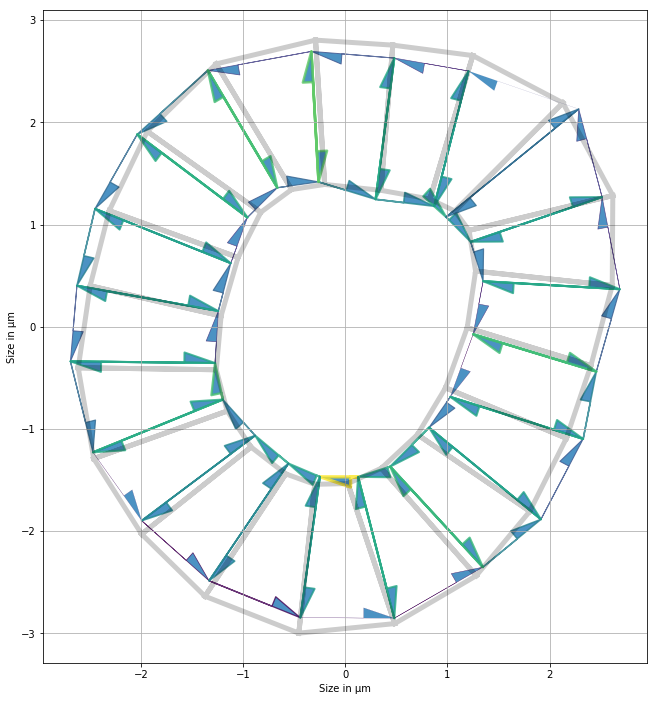

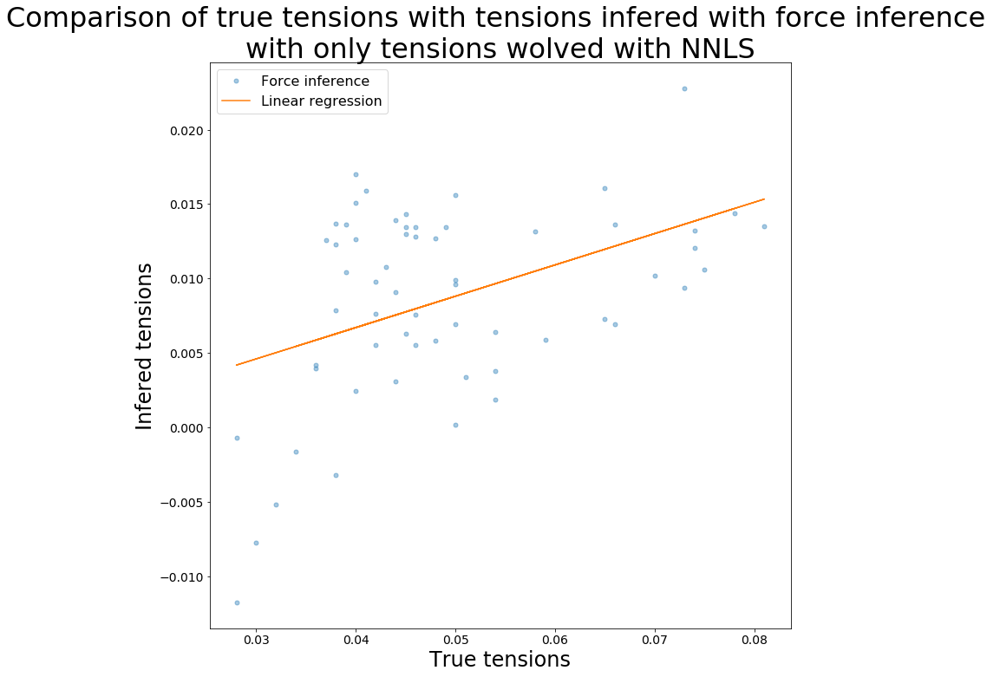

R value : 0.43423282107609484 
Standard error : 0.0049754842748765855


In [15]:
(init,
 d_tmp_fi_tensions_table,
 d_tmp_cr_fi_tensions_table,
 d_tmp_fi_areas_table,
 d_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
fi_tensions_table = np.concatenate((d_tmp_fi_tensions_table, fi_tensions_table))
cr_fi_tensions_table = np.concatenate((d_tmp_cr_fi_tensions_table, cr_fi_tensions_table))
fi_areas_table = np.concatenate((d_tmp_fi_areas_table, fi_areas_table))
cr_fi_areas_table = np.concatenate((d_tmp_cr_fi_areas_table, cr_fi_areas_table))
(d_tmp_mindist_tensions_table,
 d_tmp_cr_mindist_tensions_table,
 d_tmp_mindist_areas_table,
 d_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
mindist_tensions_table = np.concatenate((mindist_tensions_table, mindist_tensions_table))
cr_mindist_tensions_table = np.concatenate((d_tmp_cr_mindist_tensions_table, cr_mindist_tensions_table))
mindist_areas_table = np.concatenate((d_tmp_mindist_areas_table, mindist_areas_table))
cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, cr_mindist_areas_table))

# Organo polarisés

In [16]:
pol_real_tensions_table = []
pol_fi_tensions_table = []
pol_mindist_tensions_table = []
pol_real_areas_table = []
pol_fi_areas_table = []
pol_mindist_areas_table = []
pol_cr_real_tensions_table = []
pol_cr_fi_tensions_table = []
pol_cr_mindist_tensions_table = []
pol_cr_real_areas_table = []
pol_cr_fi_areas_table = []
pol_cr_mindist_areas_table = []

Reseting datasets values with new specs


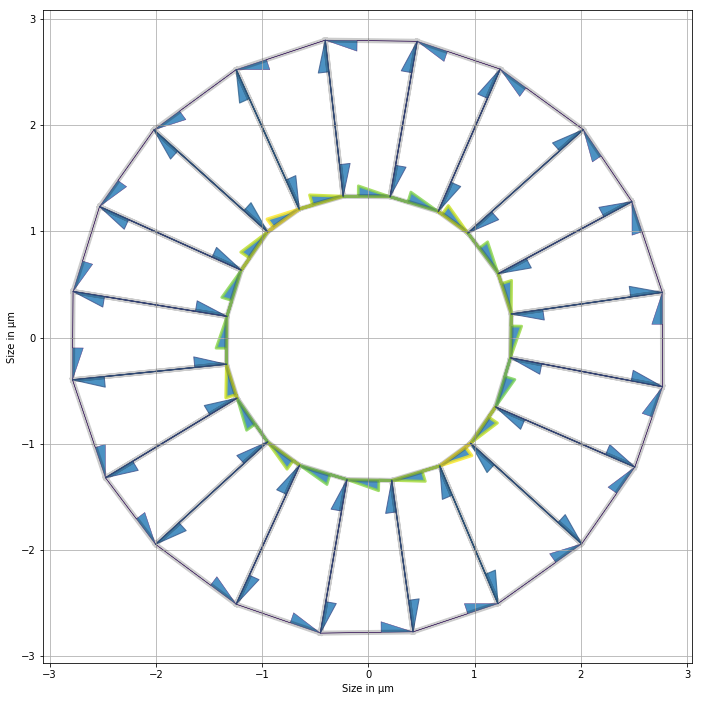

In [17]:
nf, r_in, r_out = (20, 1, 2)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = 0.5*np.array([
    0.101, 0.115, 0.126, 0.110, 0.105,
    0.102, 0.112, 0.102, 0.118, 0.105,
    0.104, 0.115, 0.127, 0.116, 0.106,
    0.103, 0.117, 0.105, 0.111, 0.107
])

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = 0.5*np.array([
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01,
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01
])

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = 0.5*np.array([
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03
])

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area

pol_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
pol_cr_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
pol_real_areas_table = np.concatenate((pol_real_areas_table,
                                   organo.face_df.prefered_area.values))
pol_cr_real_areas_table = np.concatenate((pol_cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

Reseting datasets values with new specs


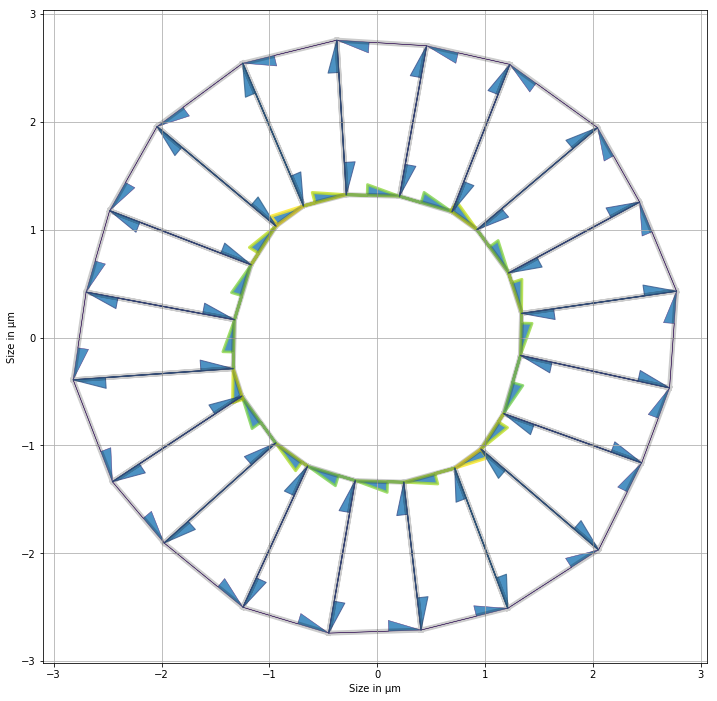

In [18]:
nf, r_in, r_out = (20, 1, 2)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = np.array([
    0.101, 0.115, 0.126, 0.110, 0.105,
    0.102, 0.112, 0.102, 0.118, 0.105,
    0.104, 0.115, 0.127, 0.116, 0.106,
    0.103, 0.117, 0.105, 0.111, 0.107
])

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = np.array([
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01,
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01
])

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = np.array([
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03
])

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area

pol_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
pol_cr_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
pol_real_areas_table = np.concatenate((pol_real_areas_table,
                                   organo.face_df.prefered_area.values))
pol_cr_real_areas_table = np.concatenate((pol_cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.01067788 0.01095493 0.01113543 0.0106468  0.01086431 0.01060598
 0.01085385 0.010379   0.01116105 0.01069078 0.01077845 0.01090724
 0.01107012 0.01092383 0.01089718 0.01057786 0.0111127  0.0105844
 0.01080247 0.01090246] 
Basal tensions:  [0.0019965  0.00143616 0.00115007 0.00154333 0.00190763 0.00199532
 0.00164948 0.00192709 0.00162582 0.00193419 0.00194641 0.00150421
 0.00113188 0.00147447 0.00188746 0.0019251  0.00158894 0.00182765
 0.00164379 0.00184114] 
Lateral tensions:  [0.00580635 0.00616597 0.00625793 0.00634849 0.006143   0.00575969
 0.0060606  0.00615385 0.00598564 0.00587351 0.00591406 0.00599015
 0.00624813 0.0062626  0.00590413 0.00585513 0.0060035  0.00588762
 0.00615842 0.00604036] 
Area elasticity:  [0.00786697 0.00764572 0.00755645 0.00752704 0.00788804 0.00762423
 0.00779226 0.00749217 0.0077414  0.00754086 0.00780445 0.00749035
 0.0072926  0.00737188 0.00771055 0.00745455 0.00765796 0.00750321
 0.00767072 0.00780365] 
Lumen area elasticity:  0

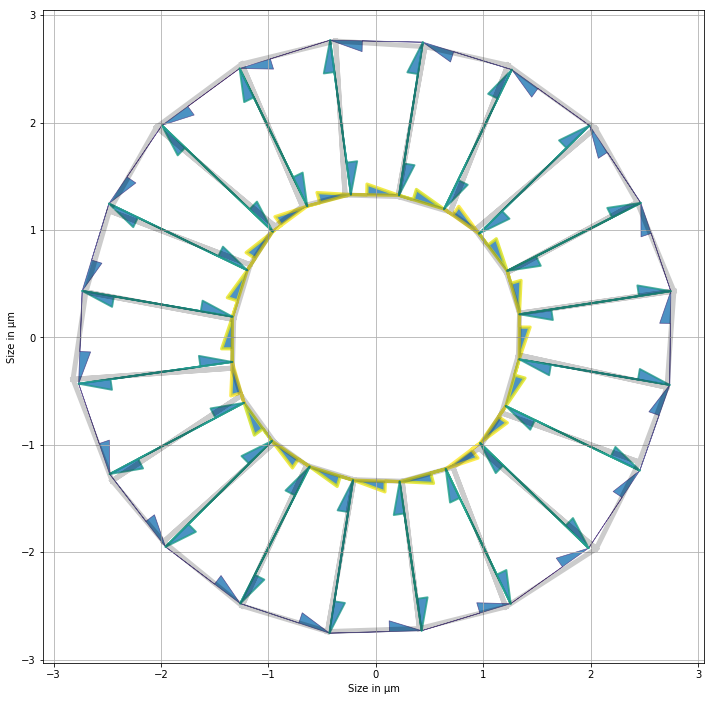

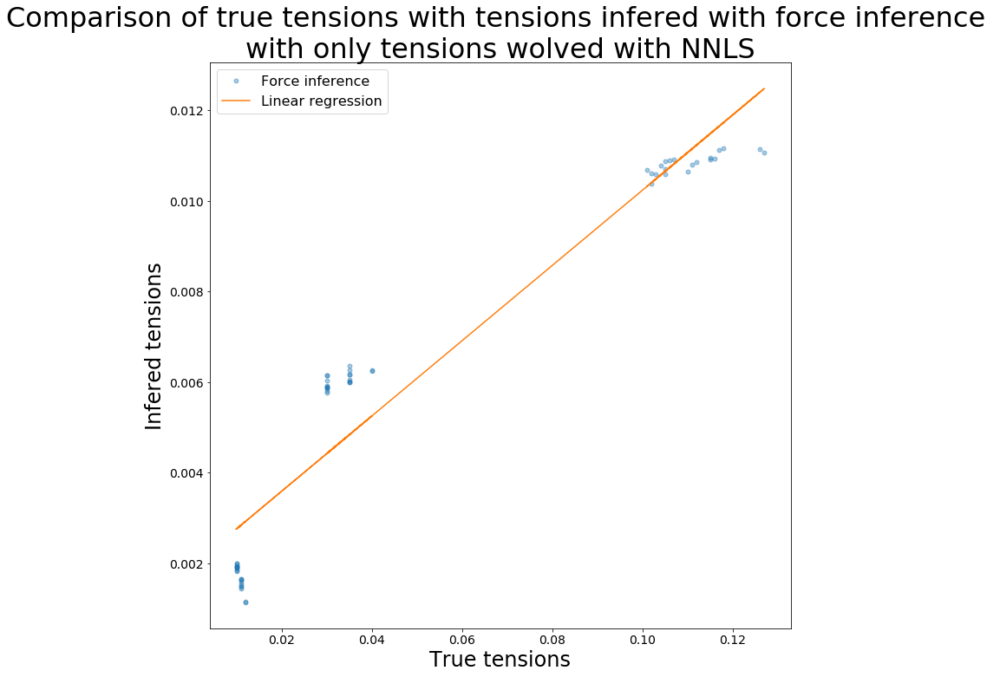

R value : 0.956597511846469 
Standard error : 0.0009425144935711636
0.07571729880462802 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.  

0.07571729896690874 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729918779091 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729851620218 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729885771344 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729889262518 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729879524336 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729863529716 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.0757172988249695 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.07571729886103858 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729857106474 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729880462802 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729880462802 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729880462802 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571728789901525 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186257
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571726935674591 [0.00188133 0.00272471 0.00232193 0.00274254 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186257
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207533 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571729241138916 [0.00188133 0.00272471 0.00232193 0.00274255 0.00150525 0.00166372
 0.00227756 0.00194191 0.00309213 0.00298428 0.00161725 0.00218983
 0.00249806 0.00237387 0.00225953 0.00141826 0.00304673 0.00258807
 0.00194706 0.00220317 0.00129292 0.00269807 0.00168583 0.00186258
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207534 0.00169148
 0.00113819 0.00229357 0.00160767 0.00133524 0.00181048 0.00133184
 0.00167537 0.00169444 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.07571737455301718 [0.00188134 0.00272471 0.00232193 0.00274255 0.00150526 0.00166373
 0.00227756 0.00194192 0.00309213 0.00298428 0.00161726 0.00218983
 0.00249806 0.00237387 0.00225954 0.00141827 0.00304673 0.00258808
 0.00194707 0.00220318 0.00129292 0.00269807 0.00168583 0.00186257
 0.00123452 0.00088206 0.00094388 0.00167699 0.00207533 0.00169148
 0.00113819 0.00229356 0.00160767 0.00133524 0.00181047 0.00133184
 0.00167537 0.00169443 0.00120462 0.00030503 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.04854756834086796 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.04854756833402299 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.04854756820376814 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200276 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.048547568328691074 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.048547568337901845 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.048547568314895054 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.048547568386881866 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.04854756830329776 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.04854756837300723 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.04854756825743117 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.048547568318006266 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.048547568318006266 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.048547568318006266 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.048547551747637654 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.00062579 0.00052984
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036547
 0.00037317 0.00036336 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.048547555109616385 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200277 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030261 0.00023372 0.00036884 0.00048235 0.00044689
 0.00015176 0.00091252 0.00066503 0.00055187 0.000785   0.00036547
 0.00037317 0.00036336 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.04854756432601952 [0.00220343 0.00266331 0.00146369 0.00192386 0.00202852 0.0018277
 0.00176361 0.00185199 0.00202066 0.00176331 0.00222125 0.00258111
 0.00167151 0.00159223 0.00232515 0.00197061 0.00200276 0.00180293
 0.00189676 0.00166765 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036884 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036336 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.04854777736179673 [0.00220344 0.00266332 0.0014637  0.00192387 0.00202853 0.00182771
 0.00176362 0.001852   0.00202067 0.00176331 0.00222126 0.00258112
 0.00167151 0.00159224 0.00232516 0.00197062 0.00200277 0.00180294
 0.00189677 0.00166766 0.00010217 0.00090716 0.0006258  0.00052985
 0.00054775 0.00030262 0.00023372 0.00036885 0.00048235 0.0004469
 0.00015176 0.00091252 0.00066503 0.00055188 0.000785   0.00036548
 0.00037317 0.00036337 0.00036527 0.00022491 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.03858223613590196 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.03858223613780105 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.03858223611017171 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

 0.         0.        ]
0.03858223609289234 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.

0.03858223609313015 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.03858223608182142 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.03858223607254063 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.0385822360802484 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.03858223609177516 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.038582236083533894 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.038582236092601696 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.038582236092601696 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.038582236092601696 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.038582233490027484 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.03858223527025362 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.001224   0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075521 0.00039352
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.03858223655995682 [0.00163185 0.00170814 0.00108926 0.00147412 0.00164044 0.001624
 0.00141948 0.00159827 0.00139262 0.00126832 0.00181335 0.00162414
 0.00128577 0.00122399 0.00147945 0.00183655 0.00143334 0.00129954
 0.00174786 0.00127749 0.00042846 0.00074363 0.0002292  0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022563 0.0001646  0.00075522 0.00039353
 0.00027206 0.00026225 0.00050943 0.00037142 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.03858247698724576 [0.00163186 0.00170816 0.00108927 0.00147413 0.00164045 0.00162402
 0.00141949 0.00159828 0.00139263 0.00126833 0.00181336 0.00162415
 0.00128578 0.001224   0.00147946 0.00183657 0.00143335 0.00129955
 0.00174787 0.0012775  0.00042846 0.00074363 0.00022921 0.00023561
 0.00071308 0.00043427 0.00052184 0.00055566 0.00035947 0.00020589
 0.0004529  0.00088009 0.00022564 0.0001646  0.00075522 0.00039353
 0.00027206 0.00026225 0.00050943 0.00037143 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.03461330336535543 [9.23175822e-04 9.62146044e-04 6.73146524e-04 1.09328367e-03
 1.16215827e-03 1.36185660e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310584e-04
 6.56168151e-04 6.15468549e-04 6.89426397e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330336345247 [9.23175823e-04 9.62146044e-04 6.73146524e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287748e-03 1.04973115e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310583e-04
 6.56168143e-04 6.15468540e-04 6.89426394e-04 7.65107065e-04
 8.08510645e-04 7.60124360e-04 7.59445107e-04 6.31410868e-04
 5.82865315e-04 6.05875934e-04 5.87294530e-04 6.98963563e-04
 7.44790719e-04 6.11703660e-04 6.23835343e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0346133033394015 [9.23175822e-04 9.62146044e-04 6.73146524e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627022e-04 9.87566910e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410870e-04
 5.82865322e-04 6.05875942e-04 5.87294532e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.03461330336231883 [9.23175823e-04 9.62146044e-04 6.73146524e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658207e-03 1.03153404e-03 1.23084956e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310583e-04
 6.56168143e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124351e-04 7.59445104e-04 6.31410868e-04
 5.82865315e-04 6.05875934e-04 5.87294530e-04 6.98963566e-04
 7.44790728e-04 6.11703670e-04 6.23835346e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330338395679 [9.23175823e-04 9.62146044e-04 6.73146524e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624914e-04
 3.09660568e-04 4.47321527e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034613303384142036 [9.23175822e-04 9.62146044e-04 6.73146524e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310583e-04
 6.56168134e-04 6.15468532e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875934e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03461330339207837 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510633e-04 7.60124349e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339282166 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865314e-04 6.05875932e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339115743 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790716e-04 6.11703658e-04 6.23835343e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339099999 [9.23175860e-04 9.62146043e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627062e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624911e-04
 3.09660535e-04 4.47321537e-04 4.99252617e-04 7.98310583e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875934e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850144e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330341366515 [9.23175822e-04 9.62146043e-04 6.73146523e-04 1.09328366e-03
 1.16215833e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310581e-04
 6.56168129e-04 6.15468543e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875934e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330340584184 [9.23175822e-04 9.62146043e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881572e-03
 1.14287754e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627062e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310583e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107060e-04
 8.08510627e-04 7.60124352e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330336438611 [9.23175822e-04 9.62146043e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881572e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627077e-04 9.87566953e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410867e-04
 5.82865283e-04 6.05875936e-04 5.87294529e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330341742599 [9.23175822e-04 9.62146043e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658213e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310583e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875934e-04 5.87294530e-04 6.98963561e-04
 7.44790715e-04 6.11703663e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339357725 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339357725 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339357725 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339357725 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330339357725 [9.23175822e-04 9.62146044e-04 6.73146523e-04 1.09328367e-03
 1.16215830e-03 1.36185663e-03 1.25657090e-03 1.33881573e-03
 1.14287752e-03 1.04973119e-03 1.46311090e-03 1.13192648e-03
 9.98627063e-04 9.87566951e-04 1.06932254e-03 1.43957645e-03
 1.15658211e-03 1.03153408e-03 1.23084955e-03 6.92624913e-04
 3.09660573e-04 4.47321534e-04 4.99252617e-04 7.98310582e-04
 6.56168142e-04 6.15468540e-04 6.89426394e-04 7.65107062e-04
 8.08510635e-04 7.60124350e-04 7.59445103e-04 6.31410868e-04
 5.82865315e-04 6.05875933e-04 5.87294530e-04 6.98963563e-04
 7.44790718e-04 6.11703660e-04 6.23835342e-04 2.51850143e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330914003862 [9.23175518e-04 9.62145328e-04 6.73145970e-04 1.09328369e-03
 1.16215833e-03 1.36185665e-03 1.25657093e-03 1.33881575e-03
 1.14287755e-03 1.04973122e-03 1.46311092e-03 1.13192651e-03
 9.98627081e-04 9.87566970e-04 1.06932257e-03 1.43957648e-03
 1.15658214e-03 1.03153411e-03 1.23084958e-03 6.92624576e-04
 3.09663695e-04 4.47325378e-04 4.99252633e-04 7.98310584e-04
 6.56168154e-04 6.15468555e-04 6.89426410e-04 7.65107077e-04
 8.08510650e-04 7.60124366e-04 7.59445116e-04 6.31410876e-04
 5.82865316e-04 6.05875938e-04 5.87294541e-04 6.98963577e-04
 7.44790734e-04 6.11703675e-04 6.23835348e-04 2.51850215e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461331033267217 [9.23175789e-04 9.62146008e-04 6.73146499e-04 1.09328306e-03
 1.16215930e-03 1.36185854e-03 1.25657025e-03 1.33881567e-03
 1.14287748e-03 1.04973116e-03 1.46311083e-03 1.13192644e-03
 9.98627019e-04 9.87566909e-04 1.06932250e-03 1.43957639e-03
 1.15658206e-03 1.03153405e-03 1.23084950e-03 6.92624893e-04
 3.09660545e-04 4.47321498e-04 4.99252586e-04 7.98310218e-04
 6.56171853e-04 6.15472113e-04 6.89425897e-04 7.65107031e-04
 8.08510601e-04 7.60124320e-04 7.59445070e-04 6.31410837e-04
 5.82865281e-04 6.05875901e-04 5.87294505e-04 6.98963534e-04
 7.44790689e-04 6.11703638e-04 6.23835310e-04 2.51850129e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330921480738 [9.23175744e-04 9.62145961e-04 6.73146479e-04 1.09328358e-03
 1.16215821e-03 1.36185652e-03 1.25657081e-03 1.33881507e-03
 1.14287960e-03 1.04973344e-03 1.46311021e-03 1.13192639e-03
 9.98626992e-04 9.87566883e-04 1.06932246e-03 1.43957634e-03
 1.15658203e-03 1.03153401e-03 1.23084945e-03 6.92624860e-04
 3.09660534e-04 4.47321482e-04 4.99252573e-04 7.98310517e-04
 6.56168102e-04 6.15468509e-04 6.89426358e-04 7.65106556e-04
 8.08513850e-04 7.60126893e-04 7.59444637e-04 6.31410824e-04
 5.82865266e-04 6.05875888e-04 5.87294495e-04 6.98963522e-04
 7.44790677e-04 6.11703629e-04 6.23835297e-04 2.51850122e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461331555801375 [9.23175823e-04 9.62146044e-04 6.73146522e-04 1.09328366e-03
 1.16215829e-03 1.36185662e-03 1.25657089e-03 1.33881572e-03
 1.14287752e-03 1.04973119e-03 1.46311089e-03 1.13192599e-03
 9.98629989e-04 9.87569884e-04 1.06932205e-03 1.43957644e-03
 1.15658210e-03 1.03153408e-03 1.23084955e-03 6.92624916e-04
 3.09660564e-04 4.47321522e-04 4.99252608e-04 7.98310570e-04
 6.56168137e-04 6.15468538e-04 6.89426391e-04 7.65107057e-04
 8.08510629e-04 7.60124346e-04 7.59445097e-04 6.31410604e-04
 5.82869313e-04 6.05879984e-04 5.87294190e-04 6.98963558e-04
 7.44790714e-04 6.11703658e-04 6.23835335e-04 2.51850139e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03461330972581369 [9.23175754e-04 9.62145972e-04 6.73146483e-04 1.09328359e-03
 1.16215822e-03 1.36185653e-03 1.25657082e-03 1.33881563e-03
 1.14287745e-03 1.04973113e-03 1.46311079e-03 1.13192640e-03
 9.98626998e-04 9.87566888e-04 1.06932247e-03 1.43957576e-03
 1.15658400e-03 1.03153625e-03 1.23084896e-03 6.92624867e-04
 3.09660537e-04 4.47321487e-04 4.99252577e-04 7.98310522e-04
 6.56168104e-04 6.15468510e-04 6.89426360e-04 7.65107021e-04
 8.08510589e-04 7.60124310e-04 7.59445059e-04 6.31410827e-04
 5.82865270e-04 6.05875891e-04 5.87294497e-04 6.98963111e-04
 7.44793620e-04 6.11707053e-04 6.23834841e-04 2.51850124e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034613428093512734 [9.23183951e-04 9.62154462e-04 6.73149354e-04 1.09328773e-03
 1.16216521e-03 1.36186217e-03 1.25657599e-03 1.33882192e-03
 1.14288199e-03 1.04973518e-03 1.46311763e-03 1.13193359e-03
 9.98629823e-04 9.87569692e-04 1.06932925e-03 1.43958327e-03
 1.15658703e-03 1.03153841e-03 1.23085654e-03 6.92631351e-04
 3.09661484e-04 4.47322572e-04 4.99253396e-04 7.98311416e-04
 6.56168821e-04 6.15469105e-04 6.89426869e-04 7.65107639e-04
 8.08511176e-04 7.60124768e-04 7.59445924e-04 6.31411733e-04
 5.82866156e-04 6.05876691e-04 5.87295238e-04 6.98964272e-04
 7.44791127e-04 6.11704056e-04 6.23835949e-04 2.51850736e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.031899828814308376 [8.79141788e-04 9.19975012e-04 6.27671739e-04 9.95833667e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847349e-04 4.73808533e-04 4.12435819e-04 7.11830639e-04
 6.34174186e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.0318998288282434 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661267e-03 1.11388866e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174182e-04 5.85324047e-04 6.48928699e-04 7.20947187e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.031899828820014624 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833669e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263791e-03 9.26465386e-04 1.32929014e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371217e-04
 3.46847351e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174186e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777779e-04 6.95768180e-04 7.10782897e-04 6.29516224e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367229e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.031899828823389896 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044556e-04 9.12945372e-04 9.73000642e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847351e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174186e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903019e-04 5.26907856e-04 5.87922432e-04 6.68789937e-04
 6.97981423e-04 5.68263846e-04 6.00367229e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03189982881852894 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732910e-04 1.10354864e-03 6.43371217e-04
 3.46847352e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174186e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981419e-04 5.68263837e-04 6.00367221e-04 2.78633340e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0318998288108641 [8.79141788e-04 9.19975013e-04 6.27671708e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847351e-04 4.73808539e-04 4.12435824e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.031899828817152656 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174186e-04 5.85324065e-04 6.48928719e-04 7.20947190e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03189982881991139 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465355e-04 1.32929011e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777782e-04 6.95768201e-04 7.10782915e-04 6.29516227e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.031899828811788544 [8.79141788e-04 9.19975014e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945338e-04 9.73000624e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907865e-04 5.87922444e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03189982881966828 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732881e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263855e-04 6.00367239e-04 2.78633343e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982881091314 [8.79141788e-04 9.19975057e-04 6.27671706e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371217e-04
 3.46847354e-04 4.73808501e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982880948228 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661267e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371217e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174189e-04 5.85324038e-04 6.48928706e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982882640093 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465379e-04 1.32929011e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777785e-04 6.95768186e-04 7.10782904e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982879288574 [8.79141788e-04 9.19975013e-04 6.27671708e-04 9.95833669e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044562e-04 9.12945357e-04 9.73000622e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371217e-04
 3.46847352e-04 4.73808537e-04 4.12435822e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903026e-04 5.26907835e-04 5.87922438e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982881532183 [8.79141788e-04 9.19975013e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305371e-03 9.26732906e-04 1.10354862e-03 6.43371217e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981425e-04 5.68263832e-04 6.00367228e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982881002887 [8.79141788e-04 9.19975014e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982881002887 [8.79141788e-04 9.19975014e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982881002887 [8.79141788e-04 9.19975014e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982881002887 [8.79141788e-04 9.19975014e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982881002887 [8.79141788e-04 9.19975014e-04 6.27671709e-04 9.95833670e-04
 1.03917337e-03 1.23661265e-03 1.11388863e-03 1.18810692e-03
 1.03263792e-03 9.26465358e-04 1.32929012e-03 1.04323330e-03
 9.28044560e-04 9.12945339e-04 9.73000625e-04 1.30882278e-03
 1.02305370e-03 9.26732883e-04 1.10354862e-03 6.43371218e-04
 3.46847352e-04 4.73808537e-04 4.12435823e-04 7.11830643e-04
 6.34174187e-04 5.85324055e-04 6.48928708e-04 7.20947191e-04
 7.51777783e-04 6.95768190e-04 7.10782905e-04 6.29516228e-04
 4.96903023e-04 5.26907862e-04 5.87922440e-04 6.68789941e-04
 6.97981423e-04 5.68263846e-04 6.00367230e-04 2.78633344e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982824144153 [8.79141880e-04 9.19973075e-04 6.27668208e-04 9.95834112e-04
 1.03917347e-03 1.23661275e-03 1.11388873e-03 1.18810702e-03
 1.03263800e-03 9.26465434e-04 1.32929023e-03 1.04323340e-03
 9.28044633e-04 9.12945411e-04 9.73000717e-04 1.30882290e-03
 1.02305379e-03 9.26732961e-04 1.10354872e-03 6.43371288e-04
 3.46847768e-04 4.73809148e-04 4.12436446e-04 7.11831225e-04
 6.34174229e-04 5.85324093e-04 6.48928751e-04 7.20947239e-04
 7.51777832e-04 6.95768235e-04 7.10782952e-04 6.29516270e-04
 4.96903056e-04 5.26907897e-04 5.87922479e-04 6.68789986e-04
 6.97981469e-04 5.68263883e-04 6.00367270e-04 2.78633363e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982335377156 [8.79141922e-04 9.19975153e-04 6.27671786e-04 9.95833789e-04
 1.03917373e-03 1.23660919e-03 1.11388518e-03 1.18810738e-03
 1.03263804e-03 9.26465463e-04 1.32929028e-03 1.04323344e-03
 9.28044665e-04 9.12945442e-04 9.73000755e-04 1.30882295e-03
 1.02305383e-03 9.26732993e-04 1.10354877e-03 6.43371317e-04
 3.46847392e-04 4.73808590e-04 4.12435864e-04 7.11830715e-04
 6.34174896e-04 5.85322532e-04 6.48926605e-04 7.20947872e-04
 7.51777853e-04 6.95768254e-04 7.10782973e-04 6.29516290e-04
 4.96903072e-04 5.26907913e-04 5.87922496e-04 6.68790005e-04
 6.97981488e-04 5.68263898e-04 6.00367290e-04 2.78633373e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982293211956 [8.79141925e-04 9.19975156e-04 6.27671786e-04 9.95833789e-04
 1.03917351e-03 1.23661280e-03 1.11388877e-03 1.18810707e-03
 1.03263846e-03 9.26461855e-04 1.32928685e-03 1.04323365e-03
 9.28044665e-04 9.12945441e-04 9.73000756e-04 1.30882295e-03
 1.02305382e-03 9.26732992e-04 1.10354877e-03 6.43371318e-04
 3.46847394e-04 4.73808593e-04 4.12435864e-04 7.11830715e-04
 6.34174247e-04 5.85324108e-04 6.48928766e-04 7.20947257e-04
 7.51778456e-04 6.95765469e-04 7.10781361e-04 6.29516937e-04
 4.96903072e-04 5.26907912e-04 5.87922495e-04 6.68790004e-04
 6.97981486e-04 5.68263896e-04 6.00367290e-04 2.78633373e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982598898144 [8.79141934e-04 9.19975166e-04 6.27671789e-04 9.95833796e-04
 1.03917352e-03 1.23661281e-03 1.11388877e-03 1.18810708e-03
 1.03263804e-03 9.26465463e-04 1.32929029e-03 1.04323345e-03
 9.28045144e-04 9.12941730e-04 9.72997503e-04 1.30882325e-03
 1.02305383e-03 9.26732996e-04 1.10354878e-03 6.43371324e-04
 3.46847400e-04 4.73808600e-04 4.12435867e-04 7.11830720e-04
 6.34174249e-04 5.85324109e-04 6.48928767e-04 7.20947259e-04
 7.51777853e-04 6.95768252e-04 7.10782975e-04 6.29516293e-04
 4.96903667e-04 5.26907483e-04 5.87921199e-04 6.68790658e-04
 6.97981487e-04 5.68263896e-04 6.00367294e-04 2.78633376e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03189982284073308 [8.79141894e-04 9.19975124e-04 6.27671770e-04 9.95833762e-04
 1.03917348e-03 1.23661276e-03 1.11388874e-03 1.18810704e-03
 1.03263801e-03 9.26465441e-04 1.32929024e-03 1.04323341e-03
 9.28044641e-04 9.12945419e-04 9.73000728e-04 1.30882291e-03
 1.02305419e-03 9.26729357e-04 1.10354562e-03 6.43371369e-04
 3.46847380e-04 4.73808575e-04 4.12435853e-04 7.11830696e-04
 6.34174232e-04 5.85324096e-04 6.48928754e-04 7.20947242e-04
 7.51777836e-04 6.95768238e-04 7.10782956e-04 6.29516274e-04
 4.96903059e-04 5.26907900e-04 5.87922482e-04 6.68789989e-04
 6.97982048e-04 5.68261979e-04 6.00365531e-04 2.78633890e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092713032 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403076e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162068e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964745e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092044593 [8.15710491e-04 8.57771521e-04 5.38375622e-04 8.17117679e-04
 8.38403088e-04 1.01663769e-03 8.68396614e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535133e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356740e-04 5.60236936e-04
 6.05370505e-04 5.37735604e-04 5.82115958e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105152e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904179e-04 4.89774646e-04 5.87480140e-04 3.09311928e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092477305 [8.15710490e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396612e-04 9.40394135e-04
 8.41687297e-04 7.14162064e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535133e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115954e-04 6.57964737e-04
 6.47813423e-04 5.88612147e-04 6.45765971e-04 6.21105152e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904179e-04 4.89774646e-04 5.87480140e-04 3.09311928e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092270095 [8.15710491e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396614e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213267e-04
 7.96799730e-04 7.75535130e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115958e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765967e-04 6.21105146e-04
 3.74655252e-04 4.10287212e-04 5.84066612e-04 6.34091402e-04
 6.26904179e-04 4.89774646e-04 5.87480140e-04 3.09311928e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.027399640926827316 [8.15710491e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396614e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535133e-04 8.10060304e-04 1.08783621e-03
 7.99340310e-04 7.44811025e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115958e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105152e-04
 3.74655258e-04 4.10287217e-04 5.84066608e-04 6.34091396e-04
 6.26904171e-04 4.89774641e-04 5.87480140e-04 3.09311928e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.027399640916419093 [8.15710495e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811027e-04 9.01372173e-04 5.65884368e-04
 4.09679255e-04 5.26988311e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105152e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480136e-04 3.09311927e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02739964093120319 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117653e-04
 8.38403074e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356744e-04 5.60236951e-04
 6.05370517e-04 5.37735608e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.027399640931714944 [8.15710491e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396614e-04 9.40394112e-04
 8.41687267e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115958e-04 6.57964755e-04
 6.47813443e-04 5.88612150e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480140e-04 3.09311928e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02739964092725236 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213254e-04
 7.96799701e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105156e-04
 3.74655262e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311928e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092982379 [8.15710491e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396614e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340284e-04 7.44811027e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988314e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066611e-04 6.34091411e-04
 6.26904191e-04 4.89774645e-04 5.87480140e-04 3.09311928e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.027399640922493553 [8.15710490e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884364e-04
 4.09679255e-04 5.26988314e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480140e-04 3.09311930e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.027399640929900826 [8.15710491e-04 8.57771521e-04 5.38375626e-04 8.17117689e-04
 8.38403073e-04 1.01663770e-03 8.68396614e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356747e-04 5.60236921e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02739964092225541 [8.15710491e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396616e-04 9.40394147e-04
 8.41687267e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115962e-04 6.57964717e-04
 6.47813430e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066612e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.027399640927922356 [8.15710491e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396614e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954044e-03 8.92213292e-04
 7.96799699e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765974e-04 6.21105123e-04
 3.74655257e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02739964091587822 [8.15710491e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396614e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783622e-03
 7.99340283e-04 7.44811027e-04 9.01372174e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735608e-04 5.82115959e-04 6.57964744e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066615e-04 6.34091372e-04
 6.26904178e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.027399640928312333 [8.15710489e-04 8.57771521e-04 5.38375624e-04 8.17117655e-04
 8.38403075e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162067e-04 1.09954043e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340286e-04 7.44811027e-04 9.01372175e-04 5.65884404e-04
 4.09679256e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370512e-04 5.37735609e-04 5.82115959e-04 6.57964745e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480143e-04 3.09311892e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02739964092713032 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403076e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162068e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964745e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092713032 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403076e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162068e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964745e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092713032 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403076e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162068e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964745e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092713032 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403076e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162068e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964745e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964092713032 [8.15710491e-04 8.57771522e-04 5.38375624e-04 8.17117655e-04
 8.38403076e-04 1.01663770e-03 8.68396615e-04 9.40394115e-04
 8.41687270e-04 7.14162068e-04 1.09954044e-03 8.92213255e-04
 7.96799702e-04 7.75535134e-04 8.10060305e-04 1.08783619e-03
 7.99340287e-04 7.44811028e-04 9.01372175e-04 5.65884365e-04
 4.09679254e-04 5.26988315e-04 2.77356744e-04 5.60236944e-04
 6.05370511e-04 5.37735609e-04 5.82115959e-04 6.57964745e-04
 6.47813432e-04 5.88612151e-04 6.45765971e-04 6.21105153e-04
 3.74655258e-04 4.10287217e-04 5.84066613e-04 6.34091402e-04
 6.26904180e-04 4.89774646e-04 5.87480141e-04 3.09311929e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.027399639470557496 [8.15710667e-04 8.57771706e-04 5.38376073e-04 8.17114212e-04
 8.38400023e-04 1.01663823e-03 8.68396785e-04 9.40394303e-04
 8.41687433e-04 7.14162206e-04 1.09954065e-03 8.92213442e-04
 7.96799856e-04 7.75535283e-04 8.10060475e-04 1.08783641e-03
 7.99340445e-04 7.44811174e-04 9.01372359e-04 5.65884493e-04
 4.09679321e-04 5.26988401e-04 2.77357355e-04 5.60235669e-04
 6.05370341e-04 5.37736324e-04 5.82116056e-04 6.57964854e-04
 6.47813541e-04 5.88612250e-04 6.45766079e-04 6.21105256e-04
 3.74655321e-04 4.10287286e-04 5.84066710e-04 6.34091508e-04
 6.26904285e-04 4.89774728e-04 5.87480238e-04 3.09311980e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.027399639996700625 [8.15710734e-04 8.57771778e-04 5.38375767e-04 8.17117866e-04
 8.38403307e-04 1.01663796e-03 8.68397193e-04 9.40390822e-04
 8.41683748e-04 7.14162713e-04 1.09954072e-03 8.92213503e-04
 7.96799900e-04 7.75535325e-04 8.10060526e-04 1.08783648e-03
 7.99340480e-04 7.44811209e-04 9.01372422e-04 5.65884536e-04
 4.09679363e-04 5.26988452e-04 2.77356804e-04 5.60237070e-04
 6.05370649e-04 5.37735725e-04 5.82116722e-04 6.57964019e-04
 6.47811901e-04 5.88612893e-04 6.45766118e-04 6.21105295e-04
 3.74655335e-04 4.10287300e-04 5.84066742e-04 6.34091546e-04
 6.26904310e-04 4.89774746e-04 5.87480281e-04 3.09312003e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.027399641631104144 [8.15710710e-04 8.57771752e-04 5.38375752e-04 8.17117843e-04
 8.38403282e-04 1.01663793e-03 8.68396806e-04 9.40394329e-04
 8.41687448e-04 7.14162210e-04 1.09954095e-03 8.92210298e-04
 7.96796134e-04 7.75535721e-04 8.10060503e-04 1.08783645e-03
 7.99340458e-04 7.44811189e-04 9.01372396e-04 5.65884519e-04
 4.09679351e-04 5.26988436e-04 2.77356797e-04 5.60237055e-04
 6.05370632e-04 5.37735711e-04 5.82116065e-04 6.57964870e-04
 6.47813549e-04 5.88612254e-04 6.45766753e-04 6.21105097e-04
 3.74655158e-04 4.10287940e-04 5.84066726e-04 6.34091529e-04
 6.26904294e-04 4.89774733e-04 5.87480264e-04 3.09311994e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02739964075083055 [8.15710747e-04 8.57771792e-04 5.38375773e-04 8.17117875e-04
 8.38403317e-04 1.01663797e-03 8.68396837e-04 9.40394365e-04
 8.41687477e-04 7.14162232e-04 1.09954073e-03 8.92213514e-04
 7.96799907e-04 7.75535331e-04 8.10060728e-04 1.08783289e-03
 7.99336732e-04 7.44811665e-04 9.01372434e-04 5.65884545e-04
 4.09679369e-04 5.26988459e-04 2.77356806e-04 5.60237074e-04
 6.05370653e-04 5.37735728e-04 5.82116083e-04 6.57964891e-04
 6.47813568e-04 5.88612270e-04 6.45766123e-04 6.21105300e-04
 3.74655337e-04 4.10287301e-04 5.84067475e-04 6.34091371e-04
 6.26902574e-04 4.89775468e-04 5.87480286e-04 3.09312006e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02739964498747023 [8.15708173e-04 8.57771542e-04 5.38375706e-04 8.17117772e-04
 8.38403208e-04 1.01663784e-03 8.68396733e-04 9.40394249e-04
 8.41687379e-04 7.14162154e-04 1.09954060e-03 8.92213398e-04
 7.96799811e-04 7.75535238e-04 8.10060432e-04 1.08783635e-03
 7.99340392e-04 7.44811127e-04 9.01372484e-04 5.65882135e-04
 4.09681595e-04 5.26988936e-04 2.77356774e-04 5.60237008e-04
 6.05370581e-04 5.37735667e-04 5.82116019e-04 6.57964816e-04
 6.47813498e-04 5.88612209e-04 6.45766046e-04 6.21105225e-04
 3.74655296e-04 4.10287258e-04 5.84066678e-04 6.34091475e-04
 6.26904244e-04 4.89774695e-04 5.87480874e-04 3.09313633e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599798174784 [4.79610513e-04 5.01883590e-04 2.75778990e-04 4.15092756e-04
 4.70167931e-04 5.81620053e-04 5.10578725e-04 5.70277237e-04
 5.64259906e-04 4.98409766e-04 6.30214072e-04 5.18923992e-04
 4.57119783e-04 4.54742669e-04 4.92770065e-04 6.41532635e-04
 5.20188256e-04 4.59721002e-04 5.18339035e-04 3.18720932e-04
 2.27633203e-04 2.98169225e-04 1.34007640e-04 2.66735367e-04
 3.30289327e-04 3.30861791e-04 3.85064469e-04 3.96042771e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882446e-04
 2.95584424e-04 3.22279939e-04 3.83178268e-04 3.76687108e-04
 4.28263986e-04 3.11193681e-04 3.17563346e-04 2.05844244e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599796222041 [4.79610512e-04 5.01883593e-04 2.75778966e-04 4.15092755e-04
 4.70167930e-04 5.81620068e-04 5.10578742e-04 5.70277236e-04
 5.64259904e-04 4.98409765e-04 6.30214070e-04 5.18923991e-04
 4.57119782e-04 4.54742668e-04 4.92770064e-04 6.41532633e-04
 5.20188255e-04 4.59721001e-04 5.18339034e-04 3.18720931e-04
 2.27633203e-04 2.98169225e-04 1.34007640e-04 2.66735367e-04
 3.30289326e-04 3.30861790e-04 3.85064468e-04 3.96042770e-04
 4.32914289e-04 4.16513074e-04 3.55166427e-04 3.81882445e-04
 2.95584423e-04 3.22279938e-04 3.83178267e-04 3.76687108e-04
 4.28263985e-04 3.11193680e-04 3.17563345e-04 2.05844244e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016475997960928544 [4.79610512e-04 5.01883593e-04 2.75778966e-04 4.15092755e-04
 4.70167929e-04 5.81620051e-04 5.10578724e-04 5.70277236e-04
 5.64259904e-04 4.98409792e-04 6.30214084e-04 5.18923991e-04
 4.57119782e-04 4.54742668e-04 4.92770064e-04 6.41532633e-04
 5.20188255e-04 4.59721001e-04 5.18339034e-04 3.18720931e-04
 2.27633202e-04 2.98169225e-04 1.34007640e-04 2.66735367e-04
 3.30289326e-04 3.30861790e-04 3.85064468e-04 3.96042770e-04
 4.32914288e-04 4.16513073e-04 3.55166427e-04 3.81882445e-04
 2.95584423e-04 3.22279938e-04 3.83178267e-04 3.76687107e-04
 4.28263985e-04 3.11193680e-04 3.17563345e-04 2.05844244e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01647599795441883 [4.79610512e-04 5.01883593e-04 2.75778966e-04 4.15092755e-04
 4.70167929e-04 5.81620051e-04 5.10578724e-04 5.70277236e-04
 5.64259904e-04 4.98409765e-04 6.30214070e-04 5.18923991e-04
 4.57119781e-04 4.54742692e-04 4.92770079e-04 6.41532633e-04
 5.20188255e-04 4.59721001e-04 5.18339034e-04 3.18720931e-04
 2.27633202e-04 2.98169224e-04 1.34007640e-04 2.66735366e-04
 3.30289326e-04 3.30861790e-04 3.85064468e-04 3.96042770e-04
 4.32914288e-04 4.16513073e-04 3.55166427e-04 3.81882445e-04
 2.95584423e-04 3.22279938e-04 3.83178267e-04 3.76687107e-04
 4.28263985e-04 3.11193680e-04 3.17563345e-04 2.05844244e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016475997966890615 [4.79610512e-04 5.01883594e-04 2.75778966e-04 4.15092756e-04
 4.70167930e-04 5.81620052e-04 5.10578724e-04 5.70277236e-04
 5.64259905e-04 4.98409766e-04 6.30214071e-04 5.18923991e-04
 4.57119782e-04 4.54742669e-04 4.92770064e-04 6.41532634e-04
 5.20188255e-04 4.59721025e-04 5.18339042e-04 3.18720931e-04
 2.27633203e-04 2.98169225e-04 1.34007640e-04 2.66735367e-04
 3.30289326e-04 3.30861790e-04 3.85064468e-04 3.96042771e-04
 4.32914289e-04 4.16513074e-04 3.55166427e-04 3.81882446e-04
 2.95584424e-04 3.22279938e-04 3.83178268e-04 3.76687108e-04
 4.28263985e-04 3.11193681e-04 3.17563345e-04 2.05844244e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01647599799686437 [4.79610514e-04 5.01883595e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277238e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720932e-04
 2.27633203e-04 2.98169227e-04 1.34007643e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599799818412 [4.79610513e-04 5.01883595e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620053e-04 5.10578726e-04 5.70277238e-04
 5.64259906e-04 4.98409767e-04 6.30214072e-04 5.18923993e-04
 4.57119783e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721002e-04 5.18339036e-04 3.18720932e-04
 2.27633203e-04 2.98169226e-04 1.34007640e-04 2.66735367e-04
 3.30289327e-04 3.30861800e-04 3.85064479e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584424e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263986e-04 3.11193681e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599799419838 [4.79610513e-04 5.01883595e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620053e-04 5.10578725e-04 5.70277238e-04
 5.64259906e-04 4.98409767e-04 6.30214072e-04 5.18923992e-04
 4.57119783e-04 4.54742670e-04 4.92770066e-04 6.41532635e-04
 5.20188257e-04 4.59721002e-04 5.18339036e-04 3.18720932e-04
 2.27633203e-04 2.98169226e-04 1.34007640e-04 2.66735367e-04
 3.30289327e-04 3.30861791e-04 3.85064469e-04 3.96042772e-04
 4.32914290e-04 4.16513084e-04 3.55166435e-04 3.81882447e-04
 2.95584424e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263986e-04 3.11193681e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016475997997443533 [4.79610514e-04 5.01883595e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277238e-04
 5.64259906e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119783e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720932e-04
 2.27633203e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861791e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279943e-04 3.83178272e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016475997995404664 [4.79610514e-04 5.01883595e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620053e-04 5.10578726e-04 5.70277238e-04
 5.64259906e-04 4.98409767e-04 6.30214072e-04 5.18923993e-04
 4.57119783e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721002e-04 5.18339036e-04 3.18720932e-04
 2.27633203e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861791e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584424e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263986e-04 3.11193688e-04 3.17563352e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016475997988024484 [4.79610514e-04 5.01883624e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620053e-04 5.10578726e-04 5.70277238e-04
 5.64259906e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119783e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720932e-04
 2.27633203e-04 2.98169198e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861791e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584424e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263986e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016475998000912043 [4.79610514e-04 5.01883595e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620074e-04 5.10578726e-04 5.70277238e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720932e-04
 2.27633203e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861780e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01647599800793675 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167932e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409780e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513072e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016475998014730448 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167932e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409768e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742689e-04 4.92770066e-04 6.41532636e-04
 5.20188258e-04 4.59721003e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279935e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563347e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016475997999968166 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721019e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193669e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01647599799593337 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599799593337 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599799593337 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599799593337 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599799593337 [4.79610514e-04 5.01883596e-04 2.75778967e-04 4.15092757e-04
 4.70167931e-04 5.81620054e-04 5.10578726e-04 5.70277239e-04
 5.64259907e-04 4.98409767e-04 6.30214073e-04 5.18923993e-04
 4.57119784e-04 4.54742670e-04 4.92770066e-04 6.41532636e-04
 5.20188257e-04 4.59721003e-04 5.18339036e-04 3.18720933e-04
 2.27633204e-04 2.98169226e-04 1.34007640e-04 2.66735368e-04
 3.30289327e-04 3.30861792e-04 3.85064470e-04 3.96042772e-04
 4.32914290e-04 4.16513075e-04 3.55166428e-04 3.81882447e-04
 2.95584425e-04 3.22279939e-04 3.83178269e-04 3.76687109e-04
 4.28263987e-04 3.11193682e-04 3.17563346e-04 2.05844245e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01647599898666653 [4.79610704e-04 5.01882352e-04 2.75775463e-04 4.15092922e-04
 4.70168118e-04 5.81620284e-04 5.10578928e-04 5.70277465e-04
 5.64260130e-04 4.98409965e-04 6.30214323e-04 5.18924199e-04
 4.57119965e-04 4.54742851e-04 4.92770262e-04 6.41532890e-04
 5.20188464e-04 4.59721185e-04 5.18339242e-04 3.18721059e-04
 2.27633294e-04 2.98170609e-04 1.34005945e-04 2.66735473e-04
 3.30289458e-04 3.30861923e-04 3.85064622e-04 3.96042929e-04
 4.32914462e-04 4.16513240e-04 3.55166569e-04 3.81882598e-04
 2.95584542e-04 3.22280067e-04 3.83178421e-04 3.76687258e-04
 4.28264156e-04 3.11193805e-04 3.17563472e-04 2.05844326e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016476000276247776 [4.79610937e-04 5.01884038e-04 2.75779210e-04 4.15093123e-04
 4.70168346e-04 5.81617019e-04 5.10575490e-04 5.70277742e-04
 5.64260404e-04 4.98410207e-04 6.30214629e-04 5.18924451e-04
 4.57120187e-04 4.54743071e-04 4.92770501e-04 6.41533202e-04
 5.20188716e-04 4.59721408e-04 5.18339493e-04 3.18721214e-04
 2.27633404e-04 2.98169489e-04 1.34007759e-04 2.66735603e-04
 3.30289619e-04 3.30859833e-04 3.85062040e-04 3.96043121e-04
 4.32914672e-04 4.16513443e-04 3.55166742e-04 3.81882784e-04
 2.95584685e-04 3.22280224e-04 3.83178607e-04 3.76687441e-04
 4.28264364e-04 3.11193956e-04 3.17563627e-04 2.05844426e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016476003032885055 [4.79611009e-04 5.01884113e-04 2.75779252e-04 4.15093185e-04
 4.70168416e-04 5.81620654e-04 5.10579253e-04 5.70277827e-04
 5.64260489e-04 4.98406031e-04 6.30211444e-04 5.18924528e-04
 4.57120255e-04 4.54743139e-04 4.92770574e-04 6.41533298e-04
 5.20188794e-04 4.59721477e-04 5.18339571e-04 3.18721261e-04
 2.27633438e-04 2.98169533e-04 1.34007779e-04 2.66735643e-04
 3.30289668e-04 3.30862133e-04 3.85064867e-04 3.96043180e-04
 4.32914737e-04 4.16510260e-04 3.55165615e-04 3.81882841e-04
 2.95584729e-04 3.22280272e-04 3.83178664e-04 3.76687498e-04
 4.28264428e-04 3.11194003e-04 3.17563674e-04 2.05844457e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01647600017998462 [4.79610937e-04 5.01884038e-04 2.75779210e-04 4.15093123e-04
 4.70168346e-04 5.81620567e-04 5.10579176e-04 5.70277742e-04
 5.64260404e-04 4.98410207e-04 6.30214629e-04 5.18924451e-04
 4.57120187e-04 4.54739135e-04 4.92767145e-04 6.41533202e-04
 5.20188716e-04 4.59721408e-04 5.18339493e-04 3.18721214e-04
 2.27633404e-04 2.98169489e-04 1.34007759e-04 2.66735603e-04
 3.30289619e-04 3.30862083e-04 3.85064809e-04 3.96043121e-04
 4.32914672e-04 4.16513443e-04 3.55166742e-04 3.81882784e-04
 2.95584685e-04 3.22276988e-04 3.83176786e-04 3.76687441e-04
 4.28264364e-04 3.11193956e-04 3.17563627e-04 2.05844426e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016476001933484936 [4.79610907e-04 5.01884007e-04 2.75779193e-04 4.15093097e-04
 4.70168317e-04 5.81620530e-04 5.10579144e-04 5.70277706e-04
 5.64260369e-04 4.98410176e-04 6.30214589e-04 5.18924418e-04
 4.57120158e-04 4.54743043e-04 4.92770470e-04 6.41533161e-04
 5.20188683e-04 4.59717364e-04 5.18336799e-04 3.18721194e-04
 2.27633390e-04 2.98169470e-04 1.34007750e-04 2.66735586e-04
 3.30289598e-04 3.30862063e-04 3.85064785e-04 3.96043096e-04
 4.32914645e-04 4.16513416e-04 3.55166719e-04 3.81882760e-04
 2.95584667e-04 3.22280203e-04 3.83178583e-04 3.76687418e-04
 4.28264337e-04 3.11191859e-04 3.17562807e-04 2.05844413e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.7337162455910067 [0.02023172 0.02344954 0.01693143 0.01898695 0.01383682 0.02504349
 0.02207341 0.01668354 0.01143902 0.02998027 0.02825125 0.02743475
 0.03348728 0.03388718 0.02042584 0.02253843 0.01865214 0.01535442
 0.02228688 0.00339709 0.00552544 0.00859663 0.01343247 0.00460069
 0.02357441 0.02047439 0.0212788  0.01817459 0.01445965 0.01113134
 0.01845687 0.01553221 0.02877985 0.02393017 0.01320306 0.02091063
 0.00833112 0.01748732 0.00717096 0.01429418 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.015323652294327755 [4.16802515e-04 4.37929546e-04 2.38731675e-04 3.48168427e-04
 4.24689399e-04 5.11950832e-04 4.52291306e-04 5.34800240e-04
 5.26576185e-04 4.64607031e-04 5.84151731e-04 4.74019891e-04
 4.09049692e-04 4.07298464e-04 4.62968447e-04 5.97733068e-04
 4.74828517e-04 4.35742976e-04 4.71633317e-04 2.83510654e-04
 2.09940496e-04 2.64142095e-04 1.17442248e-04 2.38870620e-04
 3.12295097e-04 3.24136089e-04 3.76161946e-04 3.90361254e-04
 4.12651358e-04 4.00929512e-04 3.59643502e-04 3.76894193e-04
 2.91048450e-04 3.09921951e-04 3.78725251e-04 3.85539625e-04
 4.12200283e-04 3.02446613e-04 3.04710770e-04 1.97987348e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652297521617 [4.16802515e-04 4.37929547e-04 2.38731676e-04 3.48168428e-04
 4.24689418e-04 5.11950856e-04 4.52291307e-04 5.34800241e-04
 5.26576152e-04 4.64606997e-04 5.84151732e-04 4.74019892e-04
 4.09049693e-04 4.07298465e-04 4.62968448e-04 5.97733069e-04
 4.74828518e-04 4.35742977e-04 4.71633318e-04 2.83510654e-04
 2.09940496e-04 2.64142095e-04 1.17442248e-04 2.38870620e-04
 3.12295097e-04 3.24136089e-04 3.76161947e-04 3.90361254e-04
 4.12651358e-04 4.00929512e-04 3.59643502e-04 3.76894194e-04
 2.91048450e-04 3.09921952e-04 3.78725252e-04 3.85539626e-04
 4.12200284e-04 3.02446613e-04 3.04710771e-04 1.97987348e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652278699126 [4.16802515e-04 4.37929546e-04 2.38731676e-04 3.48168427e-04
 4.24689417e-04 5.11950856e-04 4.52291306e-04 5.34800241e-04
 5.26576185e-04 4.64607031e-04 5.84151731e-04 4.74019891e-04
 4.09049658e-04 4.07298430e-04 4.62968447e-04 5.97733068e-04
 4.74828517e-04 4.35742976e-04 4.71633318e-04 2.83510654e-04
 2.09940496e-04 2.64142095e-04 1.17442248e-04 2.38870620e-04
 3.12295097e-04 3.24136089e-04 3.76161946e-04 3.90361254e-04
 4.12651358e-04 4.00929512e-04 3.59643502e-04 3.76894194e-04
 2.91048450e-04 3.09921951e-04 3.78725252e-04 3.85539625e-04
 4.12200284e-04 3.02446613e-04 3.04710771e-04 1.97987348e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652291881061 [4.16802515e-04 4.37929546e-04 2.38731676e-04 3.48168427e-04
 4.24689417e-04 5.11950856e-04 4.52291306e-04 5.34800241e-04
 5.26576185e-04 4.64607031e-04 5.84151732e-04 4.74019892e-04
 4.09049692e-04 4.07298464e-04 4.62968447e-04 5.97733069e-04
 4.74828486e-04 4.35742944e-04 4.71633318e-04 2.83510654e-04
 2.09940496e-04 2.64142095e-04 1.17442248e-04 2.38870620e-04
 3.12295097e-04 3.24136089e-04 3.76161946e-04 3.90361254e-04
 4.12651358e-04 4.00929512e-04 3.59643502e-04 3.76894194e-04
 2.91048450e-04 3.09921952e-04 3.78725252e-04 3.85539625e-04
 4.12200284e-04 3.02446613e-04 3.04710771e-04 1.97987348e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652299322416 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800240e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940489e-04 2.64142090e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200283e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652299818795 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800240e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633317e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295090e-04 3.24136081e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200283e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652304527438 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800240e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651354e-04 4.00929508e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200283e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652305534737 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048448e-04 3.09921950e-04 3.78725251e-04 3.85539624e-04
 4.12200283e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652303770504 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800240e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200280e-04 3.02446609e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652304909476 [4.16802535e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950854e-04 4.52291305e-04 5.34800239e-04
 5.26576183e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940476e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01532365231044508 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689439e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295078e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.015323652309801193 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576196e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651348e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652310135704 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950854e-04 4.52291305e-04 5.34800239e-04
 5.26576183e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049704e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048441e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323652311724242 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950854e-04 4.52291305e-04 5.34800239e-04
 5.26576183e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828529e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200276e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01532365230671601 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01532365230671601 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01532365230671601 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01532365230671601 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01532365230671601 [4.16802514e-04 4.37929545e-04 2.38731675e-04 3.48168426e-04
 4.24689416e-04 5.11950855e-04 4.52291305e-04 5.34800239e-04
 5.26576184e-04 4.64607030e-04 5.84151730e-04 4.74019890e-04
 4.09049691e-04 4.07298463e-04 4.62968446e-04 5.97733067e-04
 4.74828516e-04 4.35742975e-04 4.71633316e-04 2.83510653e-04
 2.09940495e-04 2.64142094e-04 1.17442248e-04 2.38870619e-04
 3.12295096e-04 3.24136088e-04 3.76161945e-04 3.90361253e-04
 4.12651357e-04 4.00929511e-04 3.59643501e-04 3.76894193e-04
 2.91048449e-04 3.09921951e-04 3.78725251e-04 3.85539624e-04
 4.12200282e-04 3.02446612e-04 3.04710770e-04 1.97987347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.015323656385622103 [4.16802656e-04 4.37928833e-04 2.38731649e-04 3.48168388e-04
 4.24689369e-04 5.11950798e-04 4.52291255e-04 5.34800180e-04
 5.26576126e-04 4.64606979e-04 5.84151665e-04 4.74019838e-04
 4.09049646e-04 4.07298418e-04 4.62968395e-04 5.97733001e-04
 4.74828463e-04 4.35742927e-04 4.71633264e-04 2.83510622e-04
 2.09943648e-04 2.64145132e-04 1.17442235e-04 2.38870593e-04
 3.12295062e-04 3.24136052e-04 3.76161904e-04 3.90361210e-04
 4.12651311e-04 4.00929467e-04 3.59643461e-04 3.76894151e-04
 2.91048417e-04 3.09921916e-04 3.78725209e-04 3.85539582e-04
 4.12200237e-04 3.02446579e-04 3.04710736e-04 1.97987325e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323656533347153 [4.16802353e-04 4.37929375e-04 2.38731583e-04 3.48168292e-04
 4.24689984e-04 5.11952514e-04 4.52291130e-04 5.34800032e-04
 5.26575980e-04 4.64606850e-04 5.84151504e-04 4.74019707e-04
 4.09049533e-04 4.07298306e-04 4.62968267e-04 5.97732835e-04
 4.74828332e-04 4.35742806e-04 4.71633134e-04 2.83510544e-04
 2.09940414e-04 2.64141992e-04 1.17442203e-04 2.38870527e-04
 3.12298775e-04 3.24139731e-04 3.76161800e-04 3.90361102e-04
 4.12651197e-04 4.00929356e-04 3.59643362e-04 3.76894047e-04
 2.91048336e-04 3.09921831e-04 3.78725104e-04 3.85539475e-04
 4.12200123e-04 3.02446495e-04 3.04710652e-04 1.97987271e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323655338068488 [4.16802239e-04 4.37929256e-04 2.38731518e-04 3.48168197e-04
 4.24689136e-04 5.11950517e-04 4.52291007e-04 5.34799887e-04
 5.26578622e-04 4.64609996e-04 5.84151345e-04 4.74019578e-04
 4.09049422e-04 4.07298195e-04 4.62968141e-04 5.97732673e-04
 4.74828203e-04 4.35742688e-04 4.71633006e-04 2.83510467e-04
 2.09940357e-04 2.64141920e-04 1.17442171e-04 2.38870462e-04
 3.12294890e-04 3.24135875e-04 3.76161697e-04 3.90360996e-04
 4.12654804e-04 4.00932595e-04 3.59643264e-04 3.76893944e-04
 2.91048257e-04 3.09921746e-04 3.78725001e-04 3.85539370e-04
 4.12200011e-04 3.02446413e-04 3.04710569e-04 1.97987217e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323658164761715 [4.16802324e-04 4.37929345e-04 2.38731566e-04 3.48168267e-04
 4.24689222e-04 5.11950621e-04 4.52291099e-04 5.34799995e-04
 5.26575943e-04 4.64606818e-04 5.84151463e-04 4.74019674e-04
 4.09052325e-04 4.07301174e-04 4.62968235e-04 5.97732794e-04
 4.74828299e-04 4.35742776e-04 4.71633101e-04 2.83510524e-04
 2.09940400e-04 2.64141973e-04 1.17442194e-04 2.38870510e-04
 3.12294953e-04 3.24135940e-04 3.76161774e-04 3.90361075e-04
 4.12651168e-04 4.00929328e-04 3.59643337e-04 3.76894021e-04
 2.91051944e-04 3.09925316e-04 3.78725078e-04 3.85539448e-04
 4.12200094e-04 3.02446474e-04 3.04710631e-04 1.97987257e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323656442323558 [4.16802274e-04 4.37929292e-04 2.38731537e-04 3.48168226e-04
 4.24689171e-04 5.11950560e-04 4.52291044e-04 5.34799931e-04
 5.26575880e-04 4.64606762e-04 5.84151393e-04 4.74019617e-04
 4.09049455e-04 4.07298228e-04 4.62968179e-04 5.97732722e-04
 4.74830931e-04 4.35745521e-04 4.71633045e-04 2.83510490e-04
 2.09940374e-04 2.64141942e-04 1.17442180e-04 2.38870482e-04
 3.12294916e-04 3.24135901e-04 3.76161728e-04 3.90361028e-04
 4.12651119e-04 4.00929280e-04 3.59643294e-04 3.76893975e-04
 2.91048281e-04 3.09921772e-04 3.78725032e-04 3.85539402e-04
 4.12203694e-04 3.02450269e-04 3.04710594e-04 1.97987233e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.015323799045743554 [4.16809935e-04 4.37937416e-04 2.38735301e-04 3.48173796e-04
 4.24696539e-04 5.11957216e-04 4.52296626e-04 5.34806713e-04
 5.26581111e-04 4.64610881e-04 5.84159099e-04 4.74027074e-04
 4.09053887e-04 4.07302528e-04 4.62974748e-04 5.97740460e-04
 4.74833525e-04 4.35747557e-04 4.71640364e-04 2.83515850e-04
 2.09941486e-04 2.64143341e-04 1.17442802e-04 2.38871747e-04
 3.12296570e-04 3.24137618e-04 3.76163721e-04 3.90363095e-04
 4.12653304e-04 4.00931403e-04 3.59645198e-04 3.76895972e-04
 2.91049823e-04 3.09923413e-04 3.78727038e-04 3.85541444e-04
 4.12202228e-04 3.02448040e-04 3.04712208e-04 1.97988282e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342301429329 [3.73720486e-04 4.07005388e-04 1.75499079e-04 2.65471114e-04
 3.63523631e-04 4.25957172e-04 3.67588885e-04 4.53267111e-04
 4.29043546e-04 3.71944916e-04 5.15962567e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199870e-04 5.28438020e-04
 3.84404810e-04 3.59851664e-04 4.17152319e-04 2.26243318e-04
 2.26902177e-04 2.90511906e-04 8.00384664e-05 1.93697783e-04
 2.93596050e-04 2.78214274e-04 3.06809532e-04 3.45207843e-04
 3.39606658e-04 3.25776884e-04 3.49174449e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825343e-04 3.75348791e-04
 3.47819285e-04 2.48709645e-04 3.07988727e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342363467651 [3.73720487e-04 4.07005390e-04 1.75499120e-04 2.65471148e-04
 3.63523632e-04 4.25957174e-04 3.67588855e-04 4.53267084e-04
 4.29043547e-04 3.71944917e-04 5.15962569e-04 4.19681667e-04
 3.36994276e-04 3.32666344e-04 4.04199871e-04 5.28438022e-04
 3.84404812e-04 3.59851665e-04 4.17152320e-04 2.26243319e-04
 2.26902178e-04 2.90511907e-04 8.00384667e-05 1.93697783e-04
 2.93596052e-04 2.78214276e-04 3.06809533e-04 3.45207844e-04
 3.39606660e-04 3.25776885e-04 3.49174450e-04 3.55965197e-04
 2.27505708e-04 2.44800536e-04 3.41825344e-04 3.75348792e-04
 3.47819286e-04 2.48709646e-04 3.07988728e-04 1.68179045e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342364574821 [3.73720487e-04 4.07005389e-04 1.75499120e-04 2.65471148e-04
 3.63523632e-04 4.25957174e-04 3.67588886e-04 4.53267112e-04
 4.29043547e-04 3.71944917e-04 5.15962545e-04 4.19681646e-04
 3.36994276e-04 3.32666343e-04 4.04199871e-04 5.28438022e-04
 3.84404811e-04 3.59851665e-04 4.17152320e-04 2.26243319e-04
 2.26902178e-04 2.90511906e-04 8.00384666e-05 1.93697783e-04
 2.93596051e-04 2.78214275e-04 3.06809533e-04 3.45207844e-04
 3.39606659e-04 3.25776885e-04 3.49174450e-04 3.55965196e-04
 2.27505708e-04 2.44800536e-04 3.41825344e-04 3.75348792e-04
 3.47819286e-04 2.48709646e-04 3.07988728e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342366155815 [3.73720487e-04 4.07005390e-04 1.75499120e-04 2.65471148e-04
 3.63523632e-04 4.25957174e-04 3.67588886e-04 4.53267112e-04
 4.29043547e-04 3.71944917e-04 5.15962568e-04 4.19681667e-04
 3.36994276e-04 3.32666343e-04 4.04199846e-04 5.28437997e-04
 3.84404811e-04 3.59851665e-04 4.17152320e-04 2.26243319e-04
 2.26902178e-04 2.90511906e-04 8.00384666e-05 1.93697783e-04
 2.93596051e-04 2.78214275e-04 3.06809533e-04 3.45207844e-04
 3.39606660e-04 3.25776885e-04 3.49174450e-04 3.55965196e-04
 2.27505708e-04 2.44800536e-04 3.41825344e-04 3.75348792e-04
 3.47819286e-04 2.48709646e-04 3.07988728e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342344234581 [3.73720486e-04 4.07005389e-04 1.75499120e-04 2.65471147e-04
 3.63523631e-04 4.25957173e-04 3.67588885e-04 4.53267112e-04
 4.29043546e-04 3.71944916e-04 5.15962567e-04 4.19681666e-04
 3.36994276e-04 3.32666343e-04 4.04199870e-04 5.28438021e-04
 3.84404811e-04 3.59851665e-04 4.17152298e-04 2.26243292e-04
 2.26902177e-04 2.90511906e-04 8.00384665e-05 1.93697783e-04
 2.93596051e-04 2.78214275e-04 3.06809532e-04 3.45207843e-04
 3.39606659e-04 3.25776885e-04 3.49174449e-04 3.55965196e-04
 2.27505707e-04 2.44800535e-04 3.41825343e-04 3.75348791e-04
 3.47819286e-04 2.48709645e-04 3.07988727e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342350169657 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404810e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384654e-05 1.93697781e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342349179443 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471147e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267111e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438020e-04
 3.84404810e-04 3.59851664e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384663e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809525e-04 3.45207837e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819285e-04 2.48709645e-04 3.07988727e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342353570044 [3.73720486e-04 4.07005388e-04 1.75499120e-04 2.65471147e-04
 3.63523631e-04 4.25957172e-04 3.67588884e-04 4.53267111e-04
 4.29043545e-04 3.71944916e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438020e-04
 3.84404810e-04 3.59851664e-04 4.17152319e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384664e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809532e-04 3.45207843e-04
 3.39606658e-04 3.25776884e-04 3.49174441e-04 3.55965187e-04
 2.27505707e-04 2.44800535e-04 3.41825343e-04 3.75348791e-04
 3.47819285e-04 2.48709645e-04 3.07988727e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342353798275 [3.73720486e-04 4.07005388e-04 1.75499120e-04 2.65471147e-04
 3.63523631e-04 4.25957172e-04 3.67588884e-04 4.53267111e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438020e-04
 3.84404810e-04 3.59851664e-04 4.17152319e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384664e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809532e-04 3.45207843e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825335e-04 3.75348784e-04
 3.47819285e-04 2.48709645e-04 3.07988727e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342346455034 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471147e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404810e-04 3.59851664e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384663e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207843e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819285e-04 2.48709645e-04 3.07988722e-04 1.68179038e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342356496169 [3.73720485e-04 4.07005388e-04 1.75499132e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404809e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384616e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776883e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342350849033 [3.73720485e-04 4.07005387e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588901e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994274e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404809e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384662e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809518e-04 3.45207842e-04
 3.39606658e-04 3.25776883e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800534e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342337020557 [3.73720485e-04 4.07005387e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957171e-04 3.67588884e-04 4.53267110e-04
 4.29043544e-04 3.71944915e-04 5.15962585e-04 4.19681664e-04
 3.36994274e-04 3.32666342e-04 4.04199868e-04 5.28438019e-04
 3.84404809e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384662e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776883e-04 3.49174427e-04 3.55965194e-04
 2.27505706e-04 2.44800534e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179043e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342346715784 [3.73720485e-04 4.07005387e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957171e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962565e-04 4.19681664e-04
 3.36994274e-04 3.32666342e-04 4.04199888e-04 5.28438019e-04
 3.84404809e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384662e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776883e-04 3.49174448e-04 3.55965194e-04
 2.27505707e-04 2.44800534e-04 3.41825326e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179043e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342340140427 [3.73720485e-04 4.07005387e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957171e-04 3.67588884e-04 4.53267110e-04
 4.29043544e-04 3.71944915e-04 5.15962565e-04 4.19681664e-04
 3.36994274e-04 3.32666342e-04 4.04199868e-04 5.28438019e-04
 3.84404809e-04 3.59851663e-04 4.17152342e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384662e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776883e-04 3.49174448e-04 3.55965194e-04
 2.27505706e-04 2.44800534e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988704e-04 1.68179043e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342351323307 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404810e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384663e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342351323307 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404810e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384663e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342351323307 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404810e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384663e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342351323307 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404810e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384663e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342351323307 [3.73720485e-04 4.07005388e-04 1.75499119e-04 2.65471146e-04
 3.63523630e-04 4.25957172e-04 3.67588884e-04 4.53267110e-04
 4.29043545e-04 3.71944915e-04 5.15962566e-04 4.19681665e-04
 3.36994275e-04 3.32666342e-04 4.04199869e-04 5.28438019e-04
 3.84404810e-04 3.59851663e-04 4.17152318e-04 2.26243318e-04
 2.26902177e-04 2.90511905e-04 8.00384663e-05 1.93697782e-04
 2.93596050e-04 2.78214274e-04 3.06809531e-04 3.45207842e-04
 3.39606658e-04 3.25776884e-04 3.49174448e-04 3.55965195e-04
 2.27505707e-04 2.44800535e-04 3.41825342e-04 3.75348790e-04
 3.47819284e-04 2.48709644e-04 3.07988726e-04 1.68179044e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206351903337878 [3.73720393e-04 4.07005287e-04 1.75502366e-04 2.65472818e-04
 3.63523540e-04 4.25957066e-04 3.67588793e-04 4.53266998e-04
 4.29043439e-04 3.71944823e-04 5.15962438e-04 4.19681561e-04
 3.36994191e-04 3.32666260e-04 4.04199769e-04 5.28437889e-04
 3.84404714e-04 3.59851574e-04 4.17152215e-04 2.26243262e-04
 2.26902121e-04 2.90511833e-04 8.00420141e-05 1.93701960e-04
 2.93595977e-04 2.78214205e-04 3.06809455e-04 3.45207757e-04
 3.39606574e-04 3.25776803e-04 3.49174362e-04 3.55965107e-04
 2.27505650e-04 2.44800474e-04 3.41825258e-04 3.75348697e-04
 3.47819198e-04 2.48709583e-04 3.07988650e-04 1.68179002e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206342924392916 [3.73720139e-04 4.07005011e-04 1.75498957e-04 2.65470901e-04
 3.63523294e-04 4.25956777e-04 3.67590927e-04 4.53268570e-04
 4.29043148e-04 3.71944571e-04 5.15962088e-04 4.19681276e-04
 3.36993963e-04 3.32666034e-04 4.04199495e-04 5.28437530e-04
 3.84404454e-04 3.59851330e-04 4.17151932e-04 2.26243108e-04
 2.26901967e-04 2.90511636e-04 8.00383922e-05 1.93697603e-04
 2.93595778e-04 2.78214017e-04 3.06813455e-04 3.45211848e-04
 3.39606344e-04 3.25776582e-04 3.49174125e-04 3.55964865e-04
 2.27505496e-04 2.44800308e-04 3.41825026e-04 3.75348443e-04
 3.47818963e-04 2.48709414e-04 3.07988441e-04 1.68178888e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.013206341399258581 [3.73720153e-04 4.07005025e-04 1.75498963e-04 2.65470910e-04
 3.63523307e-04 4.25956793e-04 3.67588557e-04 4.53266707e-04
 4.29043163e-04 3.71944584e-04 5.15963540e-04 4.19682329e-04
 3.36993975e-04 3.32666046e-04 4.04199509e-04 5.28437549e-04
 3.84404467e-04 3.59851343e-04 4.17151947e-04 2.26243116e-04
 2.26901975e-04 2.90511647e-04 8.00383950e-05 1.93697610e-04
 2.93595789e-04 2.78214026e-04 3.06809258e-04 3.45207535e-04
 3.39606356e-04 3.25776594e-04 3.49178191e-04 3.55969154e-04
 2.27505504e-04 2.44800317e-04 3.41825038e-04 3.75348456e-04
 3.47818975e-04 2.48709423e-04 3.07988452e-04 1.68178894e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01320634069975984 [3.73720090e-04 4.07004957e-04 1.75498934e-04 2.65470865e-04
 3.63523245e-04 4.25956721e-04 3.67588495e-04 4.53266631e-04
 4.29043091e-04 3.71944521e-04 5.15962020e-04 4.19681220e-04
 3.36993918e-04 3.32665990e-04 4.04201322e-04 5.28439099e-04
 3.84404403e-04 3.59851283e-04 4.17151877e-04 2.26243078e-04
 2.26901937e-04 2.90511598e-04 8.00383815e-05 1.93697577e-04
 2.93595739e-04 2.78213980e-04 3.06809207e-04 3.45207477e-04
 3.39606298e-04 3.25776539e-04 3.49174078e-04 3.55964818e-04
 2.27505466e-04 2.44800275e-04 3.41829534e-04 3.75352645e-04
 3.47818916e-04 2.48709381e-04 3.07988400e-04 1.68178866e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.013206346845464303 [3.73720306e-04 4.07005193e-04 1.75499035e-04 2.65471019e-04
 3.63523456e-04 4.25956968e-04 3.67588708e-04 4.53266893e-04
 4.29043340e-04 3.71944737e-04 5.15962319e-04 4.19681464e-04
 3.36994113e-04 3.32666183e-04 4.04199675e-04 5.28437766e-04
 3.84404626e-04 3.59851491e-04 4.17152978e-04 2.26244906e-04
 2.26902068e-04 2.90511766e-04 8.00384280e-05 1.93697690e-04
 2.93595909e-04 2.78214141e-04 3.06809385e-04 3.45207677e-04
 3.39606495e-04 3.25776728e-04 3.49174281e-04 3.55965024e-04
 2.27505598e-04 2.44800417e-04 3.41825179e-04 3.75348611e-04
 3.47819118e-04 2.48709525e-04 3.07992668e-04 1.68183131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01238631032624142 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01238631033780571 [3.13625319e-04 3.17728611e-04 1.53282420e-04 2.41678095e-04
 3.27501894e-04 3.94028827e-04 3.50235601e-04 4.27272470e-04
 4.07671219e-04 3.62883259e-04 4.81652927e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762340e-04 5.03967834e-04
 3.77379800e-04 3.51214530e-04 3.82441399e-04 2.24638665e-04
 1.87319177e-04 2.16248605e-04 1.07002491e-04 1.79015269e-04
 2.48917766e-04 2.63771185e-04 2.95994723e-04 3.16684791e-04
 3.22689552e-04 3.24180972e-04 3.28419298e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029123e-04
 3.42234279e-04 2.49766040e-04 2.74254246e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.012386310337366901 [3.13625318e-04 3.17728611e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028826e-04 3.50235601e-04 4.27272487e-04
 4.07671241e-04 3.62883259e-04 4.81652927e-04 3.99072763e-04
 3.22441523e-04 3.15545434e-04 3.90762340e-04 5.03967834e-04
 3.77379800e-04 3.51214529e-04 3.82441399e-04 2.24638665e-04
 1.87319177e-04 2.16248605e-04 1.07002491e-04 1.79015269e-04
 2.48917766e-04 2.63771185e-04 2.95994722e-04 3.16684791e-04
 3.22689552e-04 3.24180972e-04 3.28419298e-04 3.35637504e-04
 2.33485429e-04 2.47394541e-04 3.30689234e-04 3.58029123e-04
 3.42234279e-04 2.49766040e-04 2.74254246e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310337276761 [3.13625318e-04 3.17728611e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028826e-04 3.50235600e-04 4.27272469e-04
 4.07671218e-04 3.62883259e-04 4.81652926e-04 3.99072781e-04
 3.22441548e-04 3.15545434e-04 3.90762340e-04 5.03967834e-04
 3.77379800e-04 3.51214529e-04 3.82441399e-04 2.24638665e-04
 1.87319177e-04 2.16248605e-04 1.07002491e-04 1.79015269e-04
 2.48917766e-04 2.63771185e-04 2.95994722e-04 3.16684791e-04
 3.22689552e-04 3.24180971e-04 3.28419298e-04 3.35637504e-04
 2.33485429e-04 2.47394541e-04 3.30689234e-04 3.58029123e-04
 3.42234278e-04 2.49766040e-04 2.74254246e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310332018952 [3.13625318e-04 3.17728611e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028826e-04 3.50235600e-04 4.27272469e-04
 4.07671218e-04 3.62883259e-04 4.81652926e-04 3.99072763e-04
 3.22441522e-04 3.15545434e-04 3.90762340e-04 5.03967852e-04
 3.77379821e-04 3.51214529e-04 3.82441399e-04 2.24638665e-04
 1.87319177e-04 2.16248605e-04 1.07002491e-04 1.79015269e-04
 2.48917766e-04 2.63771185e-04 2.95994722e-04 3.16684791e-04
 3.22689552e-04 3.24180971e-04 3.28419298e-04 3.35637504e-04
 2.33485429e-04 2.47394541e-04 3.30689234e-04 3.58029123e-04
 3.42234278e-04 2.49766040e-04 2.74254246e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310339169537 [3.13625331e-04 3.17728611e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028827e-04 3.50235601e-04 4.27272470e-04
 4.07671219e-04 3.62883259e-04 4.81652927e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762340e-04 5.03967835e-04
 3.77379800e-04 3.51214530e-04 3.82441399e-04 2.24638685e-04
 1.87319177e-04 2.16248605e-04 1.07002491e-04 1.79015269e-04
 2.48917766e-04 2.63771185e-04 2.95994723e-04 3.16684792e-04
 3.22689552e-04 3.24180972e-04 3.28419298e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029123e-04
 3.42234279e-04 2.49766040e-04 2.74254246e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310333236741 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883259e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319177e-04 2.16248606e-04 1.07002492e-04 1.79015275e-04
 2.48917770e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766040e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310334440348 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028827e-04 3.50235601e-04 4.27272470e-04
 4.07671219e-04 3.62883259e-04 4.81652927e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319177e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917766e-04 2.63771185e-04 2.95994723e-04 3.16684800e-04
 3.22689561e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029123e-04
 3.42234279e-04 2.49766040e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310330906721 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028827e-04 3.50235601e-04 4.27272470e-04
 4.07671219e-04 3.62883259e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319177e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917766e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637509e-04
 2.33485434e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766040e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01238631033388674 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028827e-04 3.50235601e-04 4.27272470e-04
 4.07671219e-04 3.62883259e-04 4.81652927e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319177e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917766e-04 2.63771185e-04 2.95994723e-04 3.16684792e-04
 3.22689552e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029131e-04
 3.42234288e-04 2.49766040e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.012386310333691301 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501880e-04 3.94028827e-04 3.50235601e-04 4.27272470e-04
 4.07671219e-04 3.62883259e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319182e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917766e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766040e-04 2.74254247e-04 1.79516138e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310343201411 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678093e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015268e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310335137811 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678078e-04
 3.27501881e-04 3.94028827e-04 3.50235602e-04 4.27272484e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684784e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310334830912 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678078e-04
 3.27501881e-04 3.94028827e-04 3.50235602e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072778e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637497e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310332475885 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967848e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029115e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386310335790815 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638676e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516128e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01238631032624142 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01238631032624142 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01238631032624142 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01238631032624142 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01238631032624142 [3.13625319e-04 3.17728612e-04 1.53282420e-04 2.41678077e-04
 3.27501881e-04 3.94028827e-04 3.50235601e-04 4.27272471e-04
 4.07671219e-04 3.62883260e-04 4.81652928e-04 3.99072764e-04
 3.22441523e-04 3.15545434e-04 3.90762341e-04 5.03967835e-04
 3.77379801e-04 3.51214530e-04 3.82441400e-04 2.24638665e-04
 1.87319178e-04 2.16248606e-04 1.07002492e-04 1.79015269e-04
 2.48917767e-04 2.63771186e-04 2.95994723e-04 3.16684792e-04
 3.22689553e-04 3.24180972e-04 3.28419299e-04 3.35637505e-04
 2.33485430e-04 2.47394541e-04 3.30689235e-04 3.58029124e-04
 3.42234279e-04 2.49766041e-04 2.74254247e-04 1.79516131e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01238630369784352 [3.13625398e-04 3.17728691e-04 1.53282458e-04 2.41675167e-04
 3.27499143e-04 3.94028926e-04 3.50235689e-04 4.27272578e-04
 4.07671321e-04 3.62883350e-04 4.81653048e-04 3.99072864e-04
 3.22441604e-04 3.15545513e-04 3.90762439e-04 5.03967962e-04
 3.77379896e-04 3.51214618e-04 3.82441496e-04 2.24638722e-04
 1.87319224e-04 2.16248660e-04 1.07002518e-04 1.79012621e-04
 2.48916580e-04 2.63771252e-04 2.95994797e-04 3.16684871e-04
 3.22689633e-04 3.24181053e-04 3.28419381e-04 3.35637589e-04
 2.33485488e-04 2.47394603e-04 3.30689318e-04 3.58029213e-04
 3.42234365e-04 2.49766103e-04 2.74254315e-04 1.79516176e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.012386304990347683 [3.13625465e-04 3.17728760e-04 1.53282491e-04 2.41678190e-04
 3.27502033e-04 3.94029011e-04 3.50235764e-04 4.27269575e-04
 4.07668106e-04 3.62883428e-04 4.81653152e-04 3.99072950e-04
 3.22441673e-04 3.15545581e-04 3.90762523e-04 5.03968070e-04
 3.77379977e-04 3.51214694e-04 3.82441578e-04 2.24638770e-04
 1.87319265e-04 2.16248707e-04 1.07002541e-04 1.79015353e-04
 2.48917882e-04 2.63771308e-04 2.95994861e-04 3.16682849e-04
 3.22687088e-04 3.24181123e-04 3.28419452e-04 3.35637661e-04
 2.33485539e-04 2.47394657e-04 3.30689389e-04 3.58029290e-04
 3.42234439e-04 2.49766157e-04 2.74254374e-04 1.79516215e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012386304592834234 [3.13625455e-04 3.17728750e-04 1.53282486e-04 2.41678182e-04
 3.27502023e-04 3.94028998e-04 3.50235753e-04 4.27272656e-04
 4.07671396e-04 3.62883417e-04 4.81653137e-04 3.99069852e-04
 3.22438266e-04 3.15545571e-04 3.90762511e-04 5.03968054e-04
 3.77379965e-04 3.51214682e-04 3.82441566e-04 2.24638763e-04
 1.87319259e-04 2.16248700e-04 1.07002538e-04 1.79015347e-04
 2.48917875e-04 2.63771300e-04 2.95994852e-04 3.16684929e-04
 3.22689693e-04 3.24181113e-04 3.28419441e-04 3.35635865e-04
 2.33482693e-04 2.47394649e-04 3.30689379e-04 3.58029279e-04
 3.42234428e-04 2.49766149e-04 2.74254366e-04 1.79516209e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.0123863059089108 [3.13625497e-04 3.17728792e-04 1.53282507e-04 2.41678215e-04
 3.27502067e-04 3.94029051e-04 3.50235800e-04 4.27272713e-04
 4.07671451e-04 3.62883466e-04 4.81653201e-04 3.99072991e-04
 3.22441707e-04 3.15545614e-04 3.90762563e-04 5.03964897e-04
 3.77376537e-04 3.51214730e-04 3.82441617e-04 2.24638793e-04
 1.87319284e-04 2.16248729e-04 1.07002552e-04 1.79015371e-04
 2.48917908e-04 2.63771335e-04 2.95994891e-04 3.16684972e-04
 3.22689736e-04 3.24181156e-04 3.28419485e-04 3.35637696e-04
 2.33485563e-04 2.47394682e-04 3.30689423e-04 3.58027430e-04
 3.42231621e-04 2.49766182e-04 2.74254402e-04 1.79516233e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.012386304989920454 [3.13622807e-04 3.17728709e-04 1.53282467e-04 2.41678151e-04
 3.27501980e-04 3.94028947e-04 3.50235708e-04 4.27272601e-04
 4.07671343e-04 3.62883370e-04 4.81653074e-04 3.99072886e-04
 3.22441621e-04 3.15545530e-04 3.90762460e-04 5.03967989e-04
 3.77379916e-04 3.51214637e-04 3.82441516e-04 2.24635540e-04
 1.87318287e-04 2.16248672e-04 1.07002524e-04 1.79015324e-04
 2.48917842e-04 2.63771266e-04 2.95994813e-04 3.16684888e-04
 3.22689651e-04 3.24181071e-04 3.28419399e-04 3.35637607e-04
 2.33485501e-04 2.47394617e-04 3.30689336e-04 3.58029233e-04
 3.42234383e-04 2.49766117e-04 2.74254330e-04 1.79513829e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.4374117737148992e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.258997745909051e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.2619252194946276e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

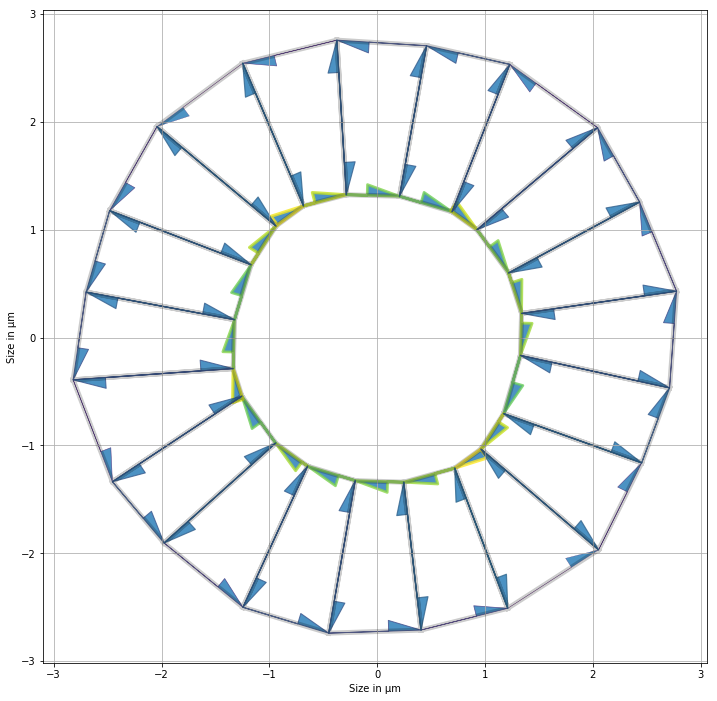

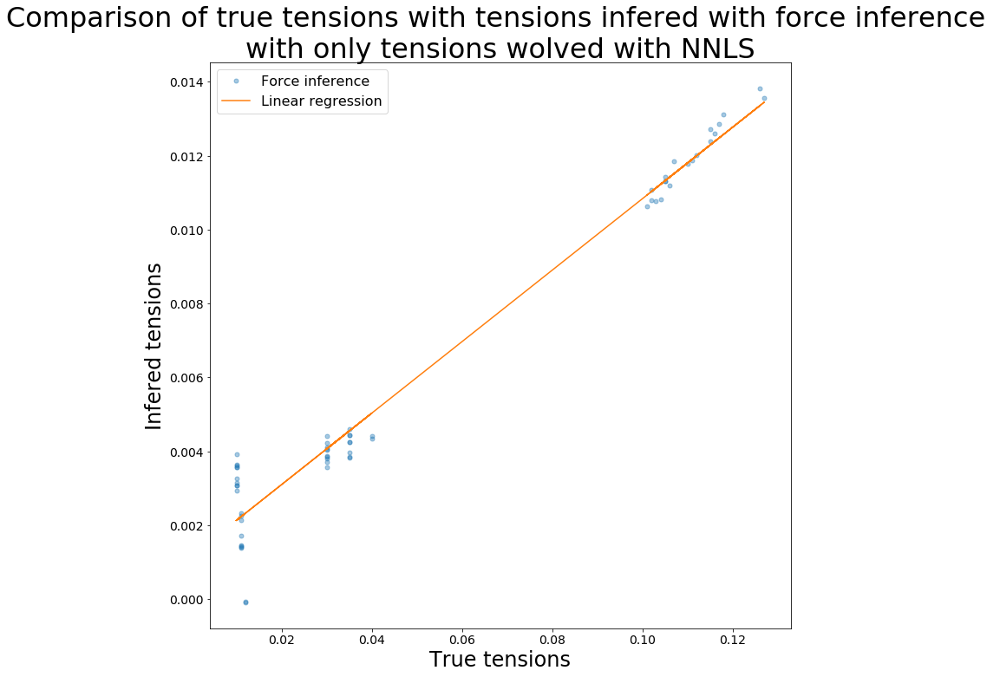

R value : 0.9832664631283969 
Standard error : 0.0006674920099333408


In [19]:
(init,
 e_tmp_fi_tensions_table,
 e_tmp_cr_fi_tensions_table,
 e_tmp_fi_areas_table,
 e_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
pol_fi_tensions_table = np.concatenate((e_tmp_fi_tensions_table, pol_fi_tensions_table))
pol_cr_fi_tensions_table = np.concatenate((e_tmp_cr_fi_tensions_table, pol_cr_fi_tensions_table))
pol_fi_areas_table = np.concatenate((e_tmp_fi_areas_table, pol_fi_areas_table))
pol_cr_fi_areas_table = np.concatenate((e_tmp_cr_fi_areas_table, pol_cr_fi_areas_table))
(e_tmp_mindist_tensions_table,
 e_tmp_cr_mindist_tensions_table,
 e_tmp_mindist_areas_table,
 e_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
pol_mindist_tensions_table = np.concatenate((mindist_tensions_table, pol_mindist_tensions_table))
pol_cr_mindist_tensions_table = np.concatenate((e_tmp_cr_mindist_tensions_table, pol_cr_mindist_tensions_table))
pol_mindist_areas_table = np.concatenate((e_tmp_mindist_areas_table, pol_mindist_areas_table))
pol_cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, pol_cr_mindist_areas_table))

## Un autre


In [20]:
def create_organo(nb_cells, r_in, r_out, seed=None, rot=None, geom=geom):
    organo = generate_ring(nb_cells, r_in, r_out)
    Nf = organo.Nf
    geom.update_all(organo)
    alpha = 1 + 1/(20*(organo.settings['R_out']-organo.settings['R_in']))
    specs = {
        'face': {
            'is_alive': 1,
            'prefered_area': organo.face_df.area,
            'area_elasticity': 1., },
        'edge': {
            'ux': 0.,
            'uy': 0.,
            'uz': 0.,
            'line_tension': 0.1,
            'is_active': 1
            },
        'vert': {
            'adhesion_strength': 0.,
            'x_ecm': 0.,
            'y_ecm': 0.,
            'is_active': 1
            },
        'settings': {
            'lumen_elasticity': 0.1,
            'lumen_prefered_vol': organo.settings['lumen_volume'],
            'lumen_volume': organo.settings['lumen_volume']
            }
        }
    organo.update_specs(specs, reset=True)
    normalize_scale(organo, geom, refer='edges')
    geom.update_all(organo)
    if seed is not None:
        symetric_tensions = set_init_point(organo.settings['R_in'],
                                           organo.settings['R_out'],
                                           organo.Nf, alpha)
        sin_mul = 1+(np.sin(np.linspace(0, 2*np.pi, organo.Nf,
                                        endpoint=False)))**2
        organo.face_df.prefered_area *= np.random.normal(1.0, 0.05, organo.Nf)
        organo.edge_df.line_tension = prepare_tensions(organo,
                                                       symetric_tensions)
        organo.edge_df.loc[:Nf-1, 'line_tension'] *= sin_mul*np.random.normal(
            1.0, 0.05, organo.Nf)
        geom.update_all(organo)
    if rot is not None:
        organo.vert_df.loc[:, 'x'] = (organo.vert_df.x.copy() * np.cos(rot) -
                                      organo.vert_df.y.copy() * np.sin(rot))
        print('rotated x',
              organo.vert_df.x.copy() * np.cos(rot) -
              organo.vert_df.y.copy() * np.sin(rot))
        organo.vert_df.loc[:, 'y'] = (organo.vert_df.x.copy() * np.sin(rot) +
                                      organo.vert_df.y.copy() * np.cos(rot))
        print('rotated y',
              organo.vert_df.x.copy() * np.sin(rot) +
              organo.vert_df.y.copy() * np.cos(rot))
        geom.update_all(organo)
    organo.vert_df[['x_ecm', 'y_ecm']] = organo.vert_df[['x', 'y']]
    organo.vert_df.loc[organo.basal_verts, 'adhesion_strength'] = 0.01
    new_tensions = organo.edge_df.line_tension
    organo.edge_df.loc[:, 'line_tension'] = new_tensions
    return organo

Reseting datasets values with new specs


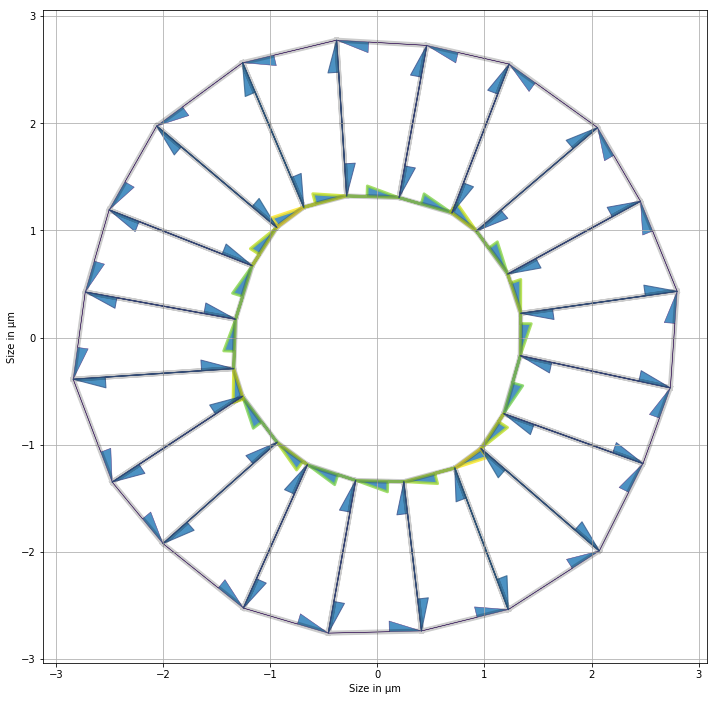

In [21]:
nf, r_in, r_out = (20, 1, 2)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = 0.5*np.array([
    0.101, 0.115, 0.126, 0.110, 0.105,
    0.102, 0.112, 0.102, 0.118, 0.105,
    0.104, 0.115, 0.127, 0.116, 0.106,
    0.103, 0.117, 0.105, 0.111, 0.107
])

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = 0.5*np.array([
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01,
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01
])

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = 0.5*np.array([
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03
])

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area

pol_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
pol_cr_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
pol_real_areas_table = np.concatenate((pol_real_areas_table,
                                   organo.face_df.prefered_area.values))
pol_cr_real_areas_table = np.concatenate((pol_cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.01006693 0.0104145  0.01055015 0.01007666 0.01029248 0.01002326
 0.01050874 0.00993352 0.01058143 0.01016886 0.01035043 0.01045024
 0.0105335  0.01031975 0.01035606 0.00999063 0.01057576 0.01016615
 0.01037516 0.01036179] 
Basal tensions:  [0.00195746 0.00149828 0.00122392 0.00158339 0.00185771 0.00193091
 0.00165518 0.00187318 0.00149806 0.00186975 0.00189866 0.00150863
 0.0011619  0.0014695  0.0018911  0.00191065 0.0015554  0.0018424
 0.00165292 0.0018325 ] 
Lateral tensions:  [0.00566429 0.00598693 0.00594234 0.00617641 0.00587246 0.00569539
 0.00581743 0.00579469 0.00588538 0.0057464  0.00568666 0.00574137
 0.00596893 0.00605088 0.00573727 0.00560006 0.00588396 0.00562242
 0.00588828 0.00577646] 
Area elasticity:  [0.00747853 0.00735387 0.00725309 0.00723345 0.00756661 0.00725968
 0.00753881 0.00717392 0.00738462 0.00722594 0.00749078 0.00718551
 0.00700222 0.00705834 0.00743957 0.00713953 0.00733231 0.00720462
 0.00735282 0.00745849] 
Lumen area elasticity:  0

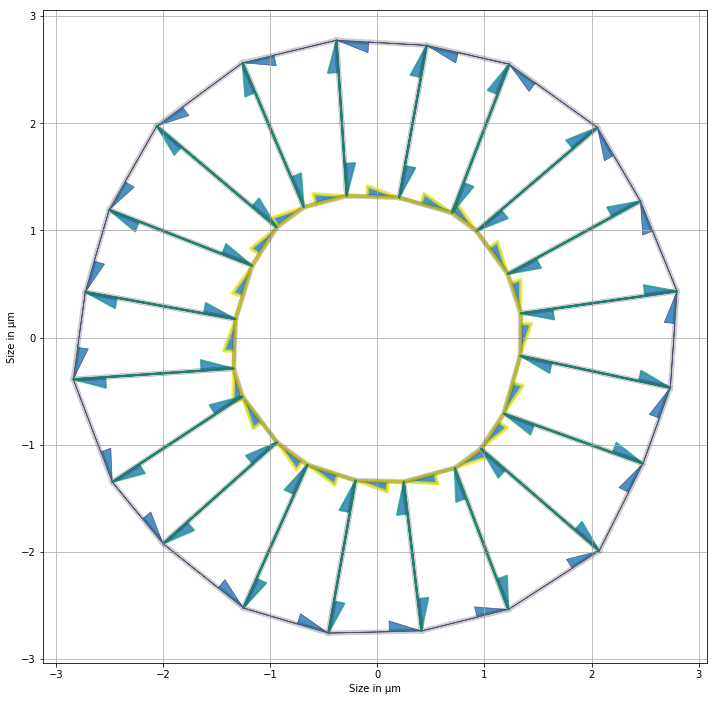

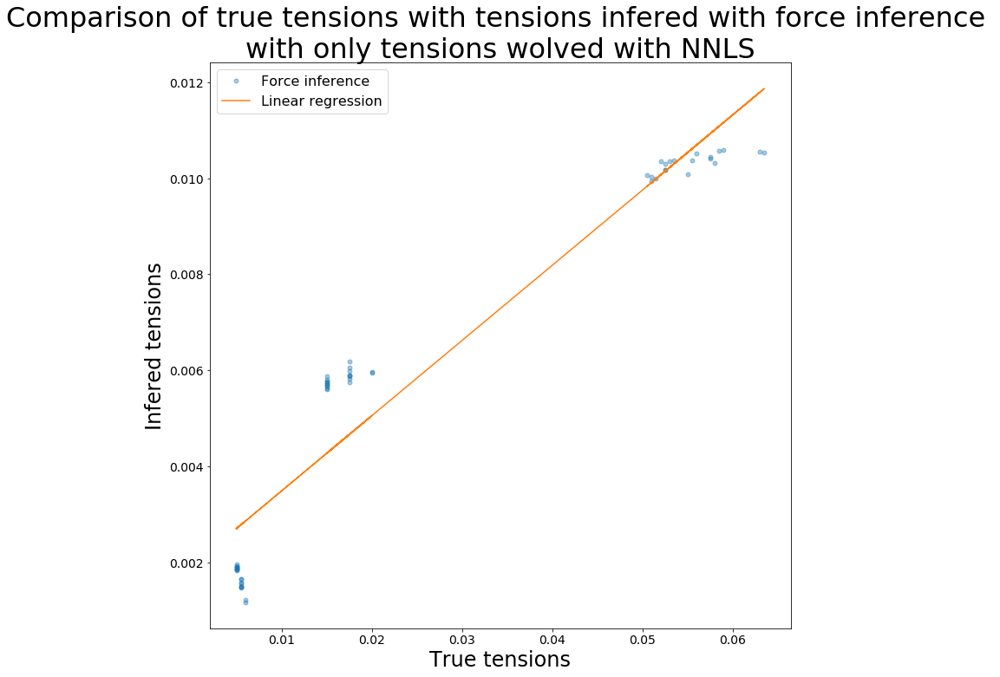

R value : 0.9551386453893741 
Standard error : 0.000904345913539697
0.052703815630168384 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0. 

0.05270381560381886 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.05270381565132596 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.05270381544895236 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.0527038156489257 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.05270381565123272 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.05270381562841717 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.052703815660909814 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.052703815710191025 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.05270381571078982 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.052703815588488336 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204184 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.052703815630168384 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.052703815630168384 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.052703815630168384 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204183 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.05270380719588143 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204184 0.0020269  0.00026825 0.0010131  0.00082024 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.05270381358286082 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.00170159 0.00181631
 0.00226939 0.00229795 0.00186337 0.00164369 0.00207936 0.00211016
 0.00204184 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065494 0.00086625 0.00090226
 0.00022439 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.05270381614614693 [0.00170374 0.0019334  0.0023407  0.00225179 0.0018549  0.00174352
 0.00201833 0.00203565 0.00216495 0.00215265 0.0017016  0.00181631
 0.00226939 0.00229795 0.00186336 0.00164368 0.00207936 0.00211016
 0.00204184 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.05270398447163953 [0.00170375 0.00193341 0.00234071 0.0022518  0.00185491 0.00174353
 0.00201834 0.00203566 0.00216496 0.00215266 0.00170161 0.00181632
 0.0022694  0.00229796 0.00186337 0.0016437  0.00207937 0.00211017
 0.00204184 0.0020269  0.00026825 0.0010131  0.00082025 0.00078194
 0.0003772  0.00039266 0.00051898 0.00065493 0.00086625 0.00090227
 0.00022438 0.0008703  0.00078808 0.00077625 0.00071346 0.00043746
 0.00088376 0.00071166 0.00027107 0.00038139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.04284669857349344 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.04284669857950766 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.042846698707799794 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.04284669858651464 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.042846698576744294 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.042846698572204245 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.042846698543325665 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.0428466985297722 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.04284669850732083 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.042846698498776675 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.0428466985831792 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.0428466985831792 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.0428466985831792 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.042846710311535724 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081146 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.04284669579579529 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150853 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.00117609 0.00087773
 0.00071508 0.00050586 0.0006717  0.00094383 0.00033111 0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081145 0.0005166
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.04284670613991573 [0.00165396 0.00180893 0.00108864 0.00134137 0.00174097 0.00141997
 0.00136815 0.00161762 0.00150854 0.00120795 0.00170639 0.00164748
 0.00115794 0.00125227 0.00144472 0.0016783  0.00135854 0.00136916
 0.00165179 0.00133964 0.00047121 0.00079936 0.00117609 0.00087773
 0.00071508 0.00050586 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076583 0.00111226 0.00081924 0.00081146 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.042846929286348985 [0.00165397 0.00180894 0.00108865 0.00134138 0.00174098 0.00141998
 0.00136816 0.00161763 0.00150855 0.00120796 0.0017064  0.00164749
 0.00115795 0.00125228 0.00144473 0.00167831 0.00135855 0.00136917
 0.0016518  0.00133965 0.00047121 0.00079936 0.0011761  0.00087773
 0.00071508 0.00050587 0.00067171 0.00094383 0.0003311  0.00029102
 0.00053297 0.00076584 0.00111226 0.00081924 0.00081146 0.00051661
 0.00023458 0.00045026 0.0008561  0.00060209 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.027457594024956074 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457594033200895 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457594003350676 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457594033863216 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457594031268087 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.02745759402582626 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.027457594022380682 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457594045657643 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.02745759403055758 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.0274575940230804 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

0.027457594033742164 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457594033742164 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457594033742164 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457595538255428 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052537 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.00050871 0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.02745759773207683 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038816 0.00044119 0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.027457601202730036 [0.00073123 0.00102603 0.00061242 0.0005958  0.0007729  0.00074281
 0.00128581 0.00145675 0.00127696 0.00104363 0.00086426 0.00075086
 0.0006357  0.00059904 0.00065548 0.00104689 0.00115771 0.001013
 0.00102312 0.00064255 0.00022279 0.00034872 0.00052536 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038817 0.0004412  0.00050484
 0.00062336 0.00042982 0.0005087  0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.027457759392924906 [0.00073124 0.00102604 0.00061243 0.00059581 0.00077291 0.00074282
 0.00128581 0.00145676 0.00127696 0.00104364 0.00086427 0.00075087
 0.00063571 0.00059905 0.00065549 0.00104689 0.00115771 0.00101301
 0.00102313 0.00064256 0.00022279 0.00034872 0.00052537 0.00038502
 0.00044697 0.00047679 0.00074361 0.00069981 0.00047144 0.0006135
 0.00047011 0.00041741 0.00051004 0.00038817 0.0004412  0.00050484
 0.00062336 0.00042982 0.00050871 0.00029701 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.023252524670793216 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.0232525246173575 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.023252524695847775 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.02325252462591408 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.023252524631905927 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.02325252462597068 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.023252524607708786 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252524592167277 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252524620160992 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252524619936276 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252524619353003 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252524619353003 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252524619353003 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.02325252467196899 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037149
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.023252518893642247 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055296 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252520417276733 [0.00070238 0.00091968 0.00072344 0.00066844 0.00063262 0.00072742
 0.0005305  0.00080178 0.00058922 0.00059369 0.00057122 0.00063739
 0.00074661 0.00054753 0.00052158 0.00065406 0.00055295 0.00060751
 0.00098382 0.00040727 0.00030945 0.00048123 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045482 0.00039975 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.023252758377278887 [0.00070239 0.0009197  0.00072345 0.00066845 0.00063263 0.00072744
 0.00053051 0.00080179 0.00058922 0.00059369 0.00057123 0.00063741
 0.00074662 0.00054754 0.0005216  0.00065407 0.00055295 0.00060752
 0.00098383 0.00040728 0.00030945 0.00048124 0.00025699 0.00037148
 0.00061723 0.00016761 0.00062793 0.00064106 0.00084453 0.00088248
 0.00063108 0.00056628 0.00031859 0.00040539 0.00048161 0.00048656
 0.00089649 0.00045483 0.00039976 0.00029283 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.01460805442697355 [3.72251235e-04 4.69670650e-04 3.60527347e-04 3.63420027e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108381e-04 3.47057065e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913693e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005879e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562692e-04
 5.74930169e-04 5.41134436e-04 2.29088674e-04 2.48300787e-04
 1.97331774e-04 2.33186172e-04 2.45347873e-04 2.57986751e-04
 5.26270378e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.014608054484352645 [3.72251236e-04 4.69670652e-04 3.60527372e-04 3.63420050e-04
 3.77777562e-04 4.33579071e-04 4.86723132e-04 6.05719429e-04
 6.54791449e-04 5.69745225e-04 4.10804450e-04 4.01851629e-04
 4.31108384e-04 3.47057067e-04 3.26044329e-04 4.57078855e-04
 5.37512047e-04 4.85393988e-04 4.79913696e-04 2.50301394e-04
 1.07067669e-04 1.83649078e-04 7.92384030e-05 1.74005880e-04
 2.81948453e-04 2.22092226e-04 4.50507147e-04 4.61562695e-04
 5.74930172e-04 5.41134438e-04 2.29088676e-04 2.48300789e-04
 1.97331775e-04 2.33186174e-04 2.45347874e-04 2.57986752e-04
 5.26270381e-04 3.95960602e-04 2.35141492e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054469208927 [3.72251235e-04 4.69670651e-04 3.60527371e-04 3.63420049e-04
 3.77777561e-04 4.33579070e-04 4.86723161e-04 6.05719454e-04
 6.54791448e-04 5.69745224e-04 4.10804429e-04 4.01851610e-04
 4.31108383e-04 3.47057066e-04 3.26044328e-04 4.57078854e-04
 5.37512045e-04 4.85393987e-04 4.79913695e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384028e-05 1.74005880e-04
 2.81948452e-04 2.22092226e-04 4.50507146e-04 4.61562694e-04
 5.74930170e-04 5.41134437e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347874e-04 2.57986751e-04
 5.26270380e-04 3.95960602e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054481998842 [3.72251236e-04 4.69670651e-04 3.60527371e-04 3.63420050e-04
 3.77777561e-04 4.33579070e-04 4.86723161e-04 6.05719455e-04
 6.54791448e-04 5.69745224e-04 4.10804449e-04 4.01851628e-04
 4.31108383e-04 3.47057066e-04 3.26044312e-04 4.57078833e-04
 5.37512046e-04 4.85393987e-04 4.79913695e-04 2.50301394e-04
 1.07067669e-04 1.83649078e-04 7.92384029e-05 1.74005880e-04
 2.81948452e-04 2.22092226e-04 4.50507146e-04 4.61562694e-04
 5.74930171e-04 5.41134438e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347874e-04 2.57986751e-04
 5.26270380e-04 3.95960602e-04 2.35141492e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054487580676 [3.72251236e-04 4.69670651e-04 3.60527371e-04 3.63420049e-04
 3.77777561e-04 4.33579070e-04 4.86723161e-04 6.05719454e-04
 6.54791448e-04 5.69745224e-04 4.10804449e-04 4.01851628e-04
 4.31108383e-04 3.47057066e-04 3.26044328e-04 4.57078854e-04
 5.37512046e-04 4.85393987e-04 4.79913685e-04 2.50301377e-04
 1.07067669e-04 1.83649078e-04 7.92384028e-05 1.74005880e-04
 2.81948452e-04 2.22092226e-04 4.50507146e-04 4.61562694e-04
 5.74930171e-04 5.41134437e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347874e-04 2.57986751e-04
 5.26270380e-04 3.95960602e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01460805447995367 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791447e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384022e-05 1.74005878e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.014608054477923732 [3.72251235e-04 4.69670650e-04 3.60527371e-04 3.63420049e-04
 3.77777561e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791447e-04 5.69745223e-04 4.10804449e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512045e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384027e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507140e-04 4.61562688e-04
 5.74930170e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054481901764 [3.72251235e-04 4.69670650e-04 3.60527371e-04 3.63420049e-04
 3.77777561e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791447e-04 5.69745223e-04 4.10804449e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044328e-04 4.57078853e-04
 5.37512045e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384027e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930170e-04 5.41134437e-04 2.29088670e-04 2.48300782e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01460805447602739 [3.72251235e-04 4.69670650e-04 3.60527371e-04 3.63420049e-04
 3.77777561e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791447e-04 5.69745223e-04 4.10804449e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512045e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384027e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930170e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347868e-04 2.57986745e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.014608054471910601 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791447e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384027e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141486e-04 1.42032789e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054487211603 [3.72251235e-04 4.69670650e-04 3.60527391e-04 3.63420049e-04
 3.77777561e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791447e-04 5.69745223e-04 4.10804449e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044328e-04 4.57078853e-04
 5.37512045e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92383792e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930170e-04 5.41134437e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054477089924 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723171e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057065e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005879e-04
 2.81948452e-04 2.22092225e-04 4.50507135e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300787e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270378e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054465429867 [3.72251234e-04 4.69670650e-04 3.60527370e-04 3.63420048e-04
 3.77777560e-04 4.33579068e-04 4.86723159e-04 6.05719452e-04
 6.54791446e-04 5.69745222e-04 4.10804466e-04 4.01851627e-04
 4.31108381e-04 3.47057065e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393985e-04 4.79913693e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005879e-04
 2.81948451e-04 2.22092225e-04 4.50507144e-04 4.61562692e-04
 5.74930169e-04 5.41134436e-04 2.29088655e-04 2.48300787e-04
 1.97331774e-04 2.33186172e-04 2.45347873e-04 2.57986750e-04
 5.26270378e-04 3.95960600e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054479759363 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057065e-04 3.26044347e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005879e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300787e-04
 1.97331775e-04 2.33186173e-04 2.45347857e-04 2.57986751e-04
 5.26270378e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01460805449823004 [3.72251235e-04 4.69670650e-04 3.60527371e-04 3.63420049e-04
 3.77777561e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791447e-04 5.69745223e-04 4.10804449e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512045e-04 4.85393986e-04 4.79913718e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384027e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930170e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141478e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.014608054479995303 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054479995303 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054479995303 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054479995303 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608054479995303 [3.72251235e-04 4.69670650e-04 3.60527370e-04 3.63420049e-04
 3.77777560e-04 4.33579069e-04 4.86723160e-04 6.05719453e-04
 6.54791446e-04 5.69745223e-04 4.10804448e-04 4.01851627e-04
 4.31108382e-04 3.47057066e-04 3.26044327e-04 4.57078853e-04
 5.37512044e-04 4.85393986e-04 4.79913694e-04 2.50301393e-04
 1.07067669e-04 1.83649077e-04 7.92384026e-05 1.74005880e-04
 2.81948452e-04 2.22092225e-04 4.50507145e-04 4.61562693e-04
 5.74930169e-04 5.41134436e-04 2.29088675e-04 2.48300788e-04
 1.97331775e-04 2.33186173e-04 2.45347873e-04 2.57986751e-04
 5.26270379e-04 3.95960601e-04 2.35141491e-04 1.42032794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608060320902165 [3.72251170e-04 4.69670568e-04 3.60528707e-04 3.63420957e-04
 3.77777495e-04 4.33578993e-04 4.86723075e-04 6.05719348e-04
 6.54791332e-04 5.69745124e-04 4.10804377e-04 4.01851557e-04
 4.31108307e-04 3.47057005e-04 3.26044271e-04 4.57078774e-04
 5.37511951e-04 4.85393901e-04 4.79913610e-04 2.50301349e-04
 1.07067650e-04 1.83649045e-04 7.92407105e-05 1.74009541e-04
 2.81948403e-04 2.22092187e-04 4.50507066e-04 4.61562612e-04
 5.74930069e-04 5.41134342e-04 2.29088635e-04 2.48300744e-04
 1.97331740e-04 2.33186132e-04 2.45347831e-04 2.57986706e-04
 5.26270287e-04 3.95960532e-04 2.35141450e-04 1.42032769e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608055632427789 [3.72250926e-04 4.69670260e-04 3.60527071e-04 3.63419747e-04
 3.77777247e-04 4.33578709e-04 4.86725713e-04 6.05721199e-04
 6.54790902e-04 5.69744749e-04 4.10804107e-04 4.01851293e-04
 4.31108024e-04 3.47056777e-04 3.26044056e-04 4.57078473e-04
 5.37511598e-04 4.85393583e-04 4.79913295e-04 2.50301185e-04
 1.07067580e-04 1.83648924e-04 7.92383368e-05 1.74005735e-04
 2.81948217e-04 2.22092041e-04 4.50510731e-04 4.61566431e-04
 5.74929692e-04 5.41133987e-04 2.29088484e-04 2.48300581e-04
 1.97331611e-04 2.33185979e-04 2.45347669e-04 2.57986536e-04
 5.26269941e-04 3.95960272e-04 2.35141296e-04 1.42032676e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608056738436084 [3.72251051e-04 4.69670418e-04 3.60527193e-04 3.63419869e-04
 3.77777374e-04 4.33578855e-04 4.86722920e-04 6.05719154e-04
 6.54791124e-04 5.69744942e-04 4.10805356e-04 4.01852425e-04
 4.31108169e-04 3.47056894e-04 3.26044166e-04 4.57078628e-04
 5.37511779e-04 4.85393747e-04 4.79913457e-04 2.50301269e-04
 1.07067616e-04 1.83648986e-04 7.92383636e-05 1.74005794e-04
 2.81948313e-04 2.22092116e-04 4.50506923e-04 4.61562465e-04
 5.74929886e-04 5.41134169e-04 2.29092132e-04 2.48304451e-04
 1.97331677e-04 2.33186058e-04 2.45347752e-04 2.57986623e-04
 5.26270119e-04 3.95960406e-04 2.35141375e-04 1.42032724e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608056572857197 [3.72251023e-04 4.69670383e-04 3.60527166e-04 3.63419842e-04
 3.77777346e-04 4.33578822e-04 4.86722883e-04 6.05719109e-04
 6.54791074e-04 5.69744899e-04 4.10804215e-04 4.01851399e-04
 4.31108137e-04 3.47056868e-04 3.26044827e-04 4.57079888e-04
 5.37511739e-04 4.85393710e-04 4.79913421e-04 2.50301251e-04
 1.07067608e-04 1.83648973e-04 7.92383576e-05 1.74005781e-04
 2.81948292e-04 2.22092099e-04 4.50506889e-04 4.61562430e-04
 5.74929843e-04 5.41134129e-04 2.29088544e-04 2.48300646e-04
 1.97331662e-04 2.33186040e-04 2.45351890e-04 2.57990861e-04
 5.26270080e-04 3.95960376e-04 2.35141357e-04 1.42032713e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.014608057227866254 [3.72251100e-04 4.69670480e-04 3.60527240e-04 3.63419917e-04
 3.77777424e-04 4.33578912e-04 4.86722984e-04 6.05719234e-04
 6.54791210e-04 5.69745017e-04 4.10804300e-04 4.01851482e-04
 4.31108226e-04 3.47056940e-04 3.26044210e-04 4.57078688e-04
 5.37511850e-04 4.85393811e-04 4.79913045e-04 2.50301785e-04
 1.07067630e-04 1.83649011e-04 7.92383740e-05 1.74005817e-04
 2.81948350e-04 2.22092145e-04 4.50506982e-04 4.61562526e-04
 5.74929962e-04 5.41134241e-04 2.29088592e-04 2.48300698e-04
 1.97331703e-04 2.33186088e-04 2.45347785e-04 2.57986657e-04
 5.26270188e-04 3.95960458e-04 2.35145519e-04 1.42036648e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012963419337182942 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419363733516 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419374112242 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419377073678 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419374783484 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419377082397 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419370950226 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419378011917 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419377375902 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.0129634193855582 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

0.012963419378360753 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419378360753 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963419378360753 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963424644440297 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033972
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963422230790198 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033971
 0.00042775 0.00055084 0.00058425 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963426940620889 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033971
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018853 0.00020106 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.012963424427731797 [0.00029132 0.00037748 0.00025543 0.00029356 0.00035017 0.00033971
 0.00042775 0.00055084 0.00058426 0.00051484 0.0004293  0.00037099
 0.00033851 0.00030064 0.00031573 0.00042965 0.00048452 0.00041675
 0.00038855 0.00022325 0.00012541 0.00020197 0.00011118 0.00017474
 0.00026521 0.00023121 0.00036762 0.0004246  0.00043731 0.000407
 0.00024914 0.00025292 0.00018852 0.00020105 0.00024767 0.00026888
 0.00038572 0.00031821 0.00027302 0.00014878 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.011542804089433974 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804126466445 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.01154280412180048 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.011542804114377277 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804115721542 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804116476825 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804111117282 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804115654339 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804109998665 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804116761639 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.01154280411759722 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.01154280411759722 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.01154280411759722 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.011542808781264045 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012577 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.011542804304348012 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.00030751 0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.01154280941268616 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017134 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.011542808667348171 [0.00026866 0.00034897 0.00020746 0.00026567 0.00033673 0.00030777
 0.00036366 0.00046453 0.0004589  0.00039959 0.00039312 0.00035257
 0.00028823 0.00026299 0.00031182 0.00039096 0.00036745 0.0003565
 0.00036416 0.00020643 0.00012576 0.0002222  0.00010948 0.00016493
 0.0002548  0.00019265 0.0003075  0.00036556 0.00036485 0.00034091
 0.00025092 0.00027599 0.00017133 0.00017631 0.00025774 0.00026008
 0.00031001 0.00025581 0.0002784  0.00014139 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.009873978330488104 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.009873978340822336 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.009873978343496258 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.009873978359172315 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.009873978364490606 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.00987397836931096 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.009873978363215966 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.009873978374784403 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.00987397838291514 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.009873978386825558 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.00987397837112755 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.00987397837112755 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.00987397837112755 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.009873985060286718 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.00012471 0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.00987398497768021 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.009873985325638553 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024625 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017448 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.0001424  0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.009873985644928862 [0.00020055 0.00024652 0.00015252 0.000216   0.00027301 0.0002662
 0.00029969 0.00038642 0.00037172 0.00032716 0.00034682 0.00030573
 0.00024624 0.00022964 0.00028598 0.00034128 0.00029419 0.00030062
 0.00032149 0.00019258 0.0001247  0.00017801 0.00010397 0.00015364
 0.00020295 0.00018173 0.00024501 0.00030657 0.00030151 0.00029255
 0.00024301 0.00025485 0.00017447 0.00017302 0.00023313 0.00023841
 0.00026535 0.0002191  0.00023521 0.00014241 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
0.0 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 

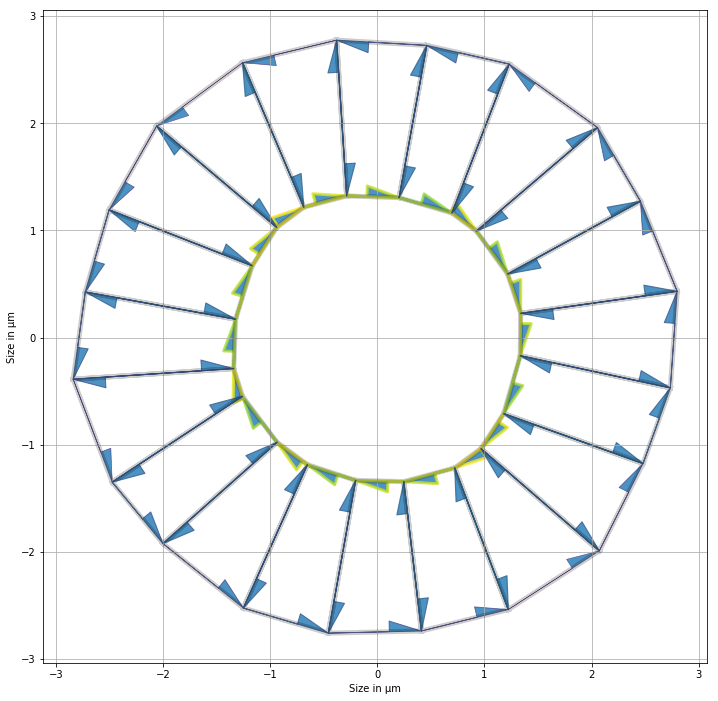

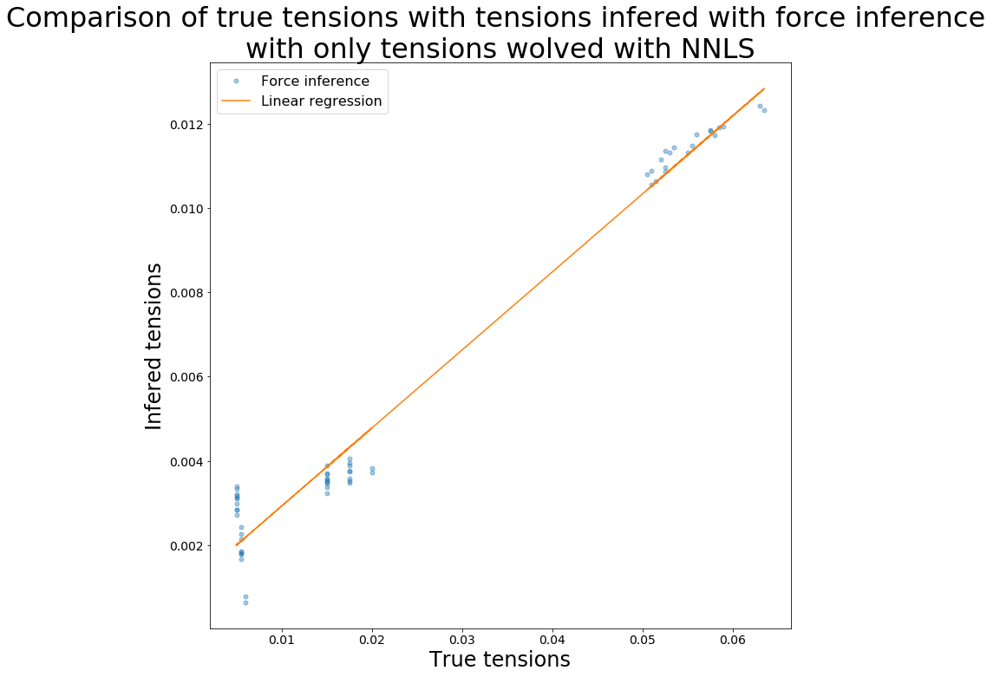

R value : 0.9871998351772924 
Standard error : 0.0005569100874867131


In [22]:
(init,
 f_tmp_fi_tensions_table,
 f_tmp_cr_fi_tensions_table,
 f_tmp_fi_areas_table,
 f_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
pol_fi_tensions_table = np.concatenate((f_tmp_fi_tensions_table, pol_fi_tensions_table))
pol_cr_fi_tensions_table = np.concatenate((f_tmp_cr_fi_tensions_table, pol_cr_fi_tensions_table))
pol_fi_areas_table = np.concatenate((f_tmp_fi_areas_table, pol_fi_areas_table))
pol_cr_fi_areas_table = np.concatenate((f_tmp_cr_fi_areas_table, pol_cr_fi_areas_table))
(f_tmp_mindist_tensions_table,
 f_tmp_cr_mindist_tensions_table,
 f_tmp_mindist_areas_table,
 f_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
pol_mindist_tensions_table = np.concatenate((mindist_tensions_table, pol_mindist_tensions_table))
pol_cr_mindist_tensions_table = np.concatenate((f_tmp_cr_mindist_tensions_table, pol_cr_mindist_tensions_table))
pol_mindist_areas_table = np.concatenate((f_tmp_mindist_areas_table, pol_mindist_areas_table))
pol_cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, pol_cr_mindist_areas_table))

## Un autre

Reseting datasets values with new specs


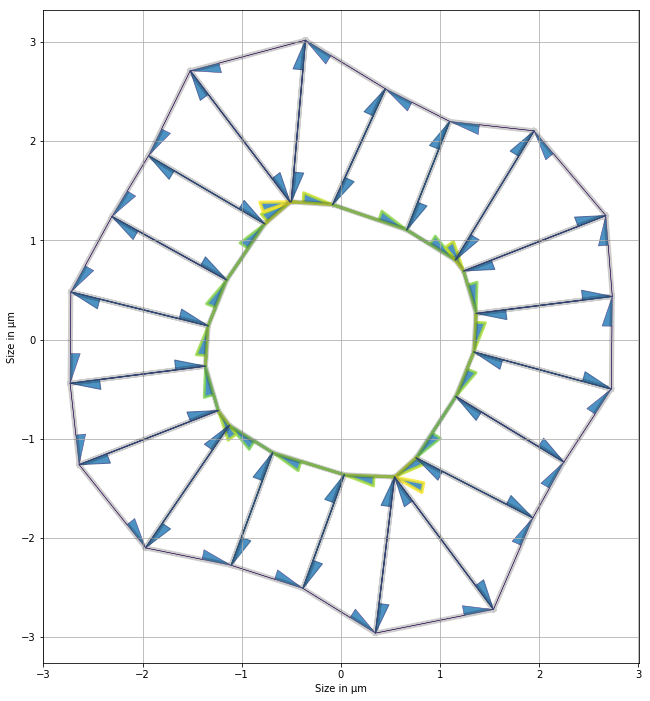

In [23]:
nf, r_in, r_out = (20, 1, 2)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = np.roll(0.85*np.array([
    0.101, 0.115, 0.126, 0.110, 0.105,
    0.102, 0.112, 0.102, 0.108, 0.105,
    0.104, 0.115, 0.127, 0.116, 0.106,
    0.103, 0.117, 0.105, 0.111, 0.107
]), 1)

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = np.roll(0.85*np.array([
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01,
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01
]), 2)

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = np.roll(0.85*np.array([
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03
]), 3)

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area


pol_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
pol_cr_real_tensions_table = np.concatenate((pol_cr_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
pol_real_areas_table = np.concatenate((pol_real_areas_table,
                                   organo.face_df.prefered_area.values))
pol_cr_real_areas_table = np.concatenate((pol_cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.006707   0.00589403 0.00607594 0.00810485 0.0081182  0.00609091
 0.00710765 0.00821345 0.00730251 0.00765062 0.00772431 0.00743294
 0.0084468  0.00936999 0.0078862  0.00653566 0.00692494 0.00823293
 0.0070209  0.00713736] 
Basal tensions:  [0.00348393 0.0034091  0.00301235 0.00394252 0.00484725 0.00295337
 0.00394536 0.00416009 0.00394275 0.0035596  0.00358871 0.00322837
 0.003395   0.00357093 0.00317224 0.00260622 0.00341863 0.00388157
 0.00384342 0.00352629] 
Lateral tensions:  [0.00605886 0.00705521 0.00680137 0.00686356 0.00340445 0.00733318
 0.00685213 0.00555784 0.00554335 0.00642686 0.00588422 0.00639525
 0.00652577 0.00494617 0.00541679 0.00686339 0.00732069 0.00572048
 0.00556459 0.00661755] 
Area elasticity:  [0.00918815 0.0092007  0.00837867 0.00848269 0.00893332 0.00744866
 0.00832546 0.00896717 0.00805351 0.00835673 0.00845827 0.00795384
 0.00776514 0.00844329 0.00784855 0.00808714 0.00833886 0.00924707
 0.00832372 0.00891845] 
Lumen area elasticity:  

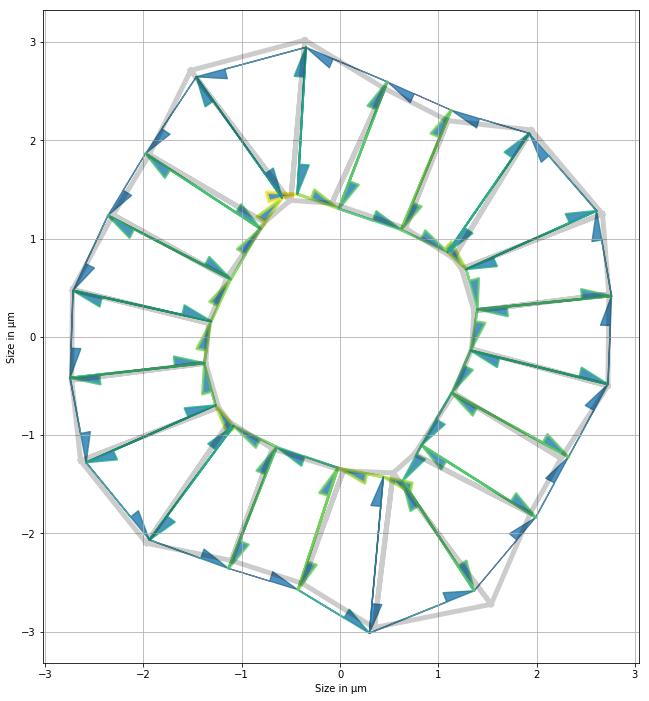

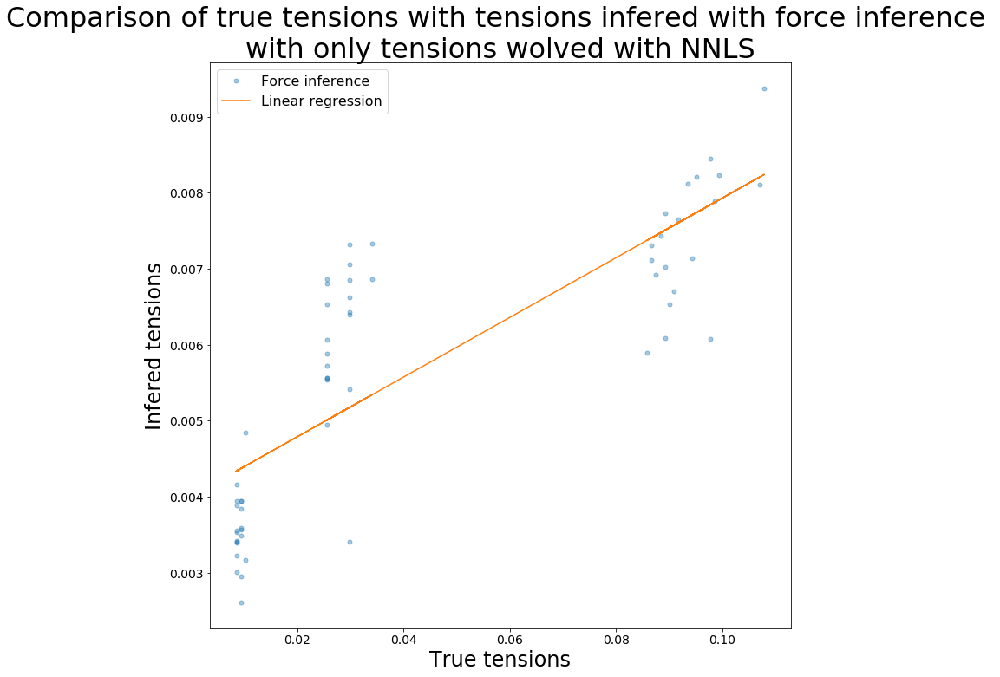

R value : 0.8035806443757092 
Standard error : 0.0009146924831876337
4.599391594164248 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.   

4.59939143128652 [0.00602697 0.0845225  0.2371711  0.06979909 0.25684627 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152242 0.17276706 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.1424726  0.3082843
 0.05810832 0.17055321 0.15464715 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596887 0.15558324 0.14612535
 0.20183714 0.08258029 0.12863275 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

4.599391498503022 [0.00602697 0.0845225  0.23717111 0.0697991  0.25684628 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.1424726  0.30828431
 0.05810833 0.17055321 0.15464715 0.09237906 0.10884636 0.02315233
 0.03257285 0.10698062 0.07485942 0.17596888 0.15558324 0.14612535
 0.20183714 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.599391626365197 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226619 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.599391623392387 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226619 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.599391540976569 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684628 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.1424726  0.30828431
 0.05810833 0.17055322 0.15464715 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558324 0.14612535
 0.20183714 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.5993916029889625 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

4.599391604674688 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.599391635831594 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709665
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412045 0.16152243 0.17276707 0.08573473 0.14718388
 0.06226619 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055321 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.59939159177658 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226619 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

4.5993917235801 [0.00602697 0.08452251 0.23717112 0.0697991  0.25684629 0.14709665
 0.07157545 0.12886814 0.09561111 0.02642752 0.06334499 0.02572566
 0.15497596 0.14412045 0.16152243 0.17276707 0.08573473 0.14718388
 0.06226619 0.04329319 0.04168241 0.16424355 0.14247261 0.30828432
 0.05810833 0.17055322 0.15464716 0.09237907 0.10884637 0.02315233
 0.03257286 0.10698063 0.07485942 0.17596888 0.15558325 0.14612536
 0.20183715 0.0825803  0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.    

4.599391594164248 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.599391594164248 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.599391594164248 [0.00602697 0.08452251 0.23717111 0.0697991  0.25684629 0.14709664
 0.07157545 0.12886813 0.09561111 0.02642752 0.06334498 0.02572566
 0.15497596 0.14412044 0.16152243 0.17276707 0.08573473 0.14718387
 0.06226618 0.04329319 0.04168241 0.16424354 0.14247261 0.30828431
 0.05810833 0.17055322 0.15464716 0.09237906 0.10884636 0.02315233
 0.03257286 0.10698062 0.07485942 0.17596888 0.15558325 0.14612535
 0.20183715 0.08258029 0.12863276 0.04500233 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.59937682763863 [0.00602707 0.08452194 0.23717048 0.06979882 0.25684534 0.14709608
 0.0715751  0.12886767 0.09561082 0.02642742 0.0633449  0.02572561
 0.15497552 0.14411973 0.16152188 0.1727665  0.08573428 0.14718336
 0.06226604 0.04329315 0.04168228 0.16424304 0.14247206 0.30828355
 0.05810789 0.1705528  0.15464669 0.09237877 0.10884615 0.02315234
 0.03257279 0.10698031 0.07485909 0.17596839 0.15558271 0.14612478
 0.20183656 0.0825801  0.12863261 0.04500221 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

4.599431440058012 [0.00602663 0.08452405 0.23717269 0.06979987 0.25684881 0.14709819
 0.07157645 0.12886937 0.09561185 0.02642779 0.06334515 0.02572579
 0.1549772  0.14412252 0.16152388 0.17276869 0.08573601 0.14718525
 0.06226653 0.04329324 0.04168275 0.16424487 0.142474   0.30828642
 0.05810954 0.17055422 0.15464836 0.0923799  0.10884693 0.02315229
 0.03257305 0.10698145 0.07486032 0.17597031 0.1555848  0.14612693
 0.20183869 0.08258087 0.12863315 0.04500264 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.599378657123664 [0.00602718 0.0845219  0.23717071 0.06979885 0.25684547 0.1470961
 0.07157507 0.12886775 0.0956109  0.02642739 0.06334501 0.02572566
 0.15497553 0.14411952 0.16152209 0.17276646 0.08573423 0.14718346
 0.06226613 0.04329324 0.04168228 0.16424312 0.14247218 0.30828361
 0.05810785 0.17055298 0.1546468  0.09237878 0.10884624 0.02315239
 0.0325728  0.10698037 0.07485908 0.17596834 0.15558266 0.14612479
 0.20183668 0.0825801  0.12863272 0.04500225 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

4.599382713713309 [0.00602703 0.08452218 0.23717072 0.06979893 0.25684573 0.14709631
 0.07157526 0.12886785 0.09561091 0.02642745 0.06334492 0.02572564
 0.1549757  0.14412003 0.16152207 0.17276674 0.08573446 0.14718358
 0.06226608 0.04329315 0.04168234 0.16424325 0.14247229 0.30828387
 0.05810806 0.17055296 0.15464688 0.09237889 0.10884622 0.02315234
 0.03257282 0.10698043 0.07485924 0.17596858 0.15558292 0.14612503
 0.20183681 0.08258017 0.12863264 0.04500226 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.130096286703417 [1.31426989e-01 3.61992603e-02 1.92040729e-01 8.81145191e-02
 1.86738270e-01 1.73510206e-01 7.39093178e-02 2.83913835e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248513e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212692e-02 2.35017003e-01
 1.52751669e-01 7.40104428e-02 7.67835951e-02 5.84515102e-02
 7.77076986e-02 1.25650249e-02 7.53340773e-02 1.45791354e-01
 2.65233821e-02 9.74507040e-02 1.30690516e-01 6.63333607e-02
 1.40055104e-01 1.08822964e-01 5.13032708e-02 1.49105199e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096288431598 [1.31426990e-01 3.61992603e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093170e-02 2.83913855e-02
 8.11852794e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248514e-02 1.08539120e-01
 1.42384657e-01 1.28355764e-01 1.71274633e-01 4.60256774e-02
 4.09285482e-02 1.32847275e-01 8.74212688e-02 2.35017002e-01
 1.52751669e-01 7.40104417e-02 7.67835954e-02 5.84515115e-02
 7.77076996e-02 1.25650246e-02 7.53340774e-02 1.45791354e-01
 2.65233821e-02 9.74507040e-02 1.30690516e-01 6.63333607e-02
 1.40055104e-01 1.08822964e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096301813356 [1.31426990e-01 3.61992603e-02 1.92040730e-01 8.81145176e-02
 1.86738270e-01 1.73510207e-01 7.39093178e-02 2.83913834e-02
 8.11852801e-02 1.25061799e-01 1.69329952e-01 8.11556874e-02
 7.19193316e-02 1.08085761e-01 4.65248515e-02 1.08539120e-01
 1.42384657e-01 1.28355765e-01 1.71274633e-01 4.60256774e-02
 4.09285482e-02 1.32847275e-01 8.74212689e-02 2.35017002e-01
 1.52751669e-01 7.40104429e-02 7.67835953e-02 5.84515105e-02
 7.77076989e-02 1.25650255e-02 7.53340797e-02 1.45791357e-01
 2.65233824e-02 9.74507040e-02 1.30690516e-01 6.63333607e-02
 1.40055104e-01 1.08822964e-01 5.13032710e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.1300962910832775 [1.31426990e-01 3.61992603e-02 1.92040730e-01 8.81145177e-02
 1.86738269e-01 1.73510207e-01 7.39093178e-02 2.83913835e-02
 8.11852802e-02 1.25061799e-01 1.69329950e-01 8.11556870e-02
 7.19193311e-02 1.08085761e-01 4.65248532e-02 1.08539117e-01
 1.42384658e-01 1.28355765e-01 1.71274633e-01 4.60256775e-02
 4.09285483e-02 1.32847275e-01 8.74212689e-02 2.35017003e-01
 1.52751670e-01 7.40104428e-02 7.67835952e-02 5.84515103e-02
 7.77076987e-02 1.25650250e-02 7.53340774e-02 1.45791354e-01
 2.65233818e-02 9.74507051e-02 1.30690514e-01 6.63333615e-02
 1.40055103e-01 1.08822965e-01 5.13032710e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.130096293411962 [1.31426990e-01 3.61992604e-02 1.92040730e-01 8.81145177e-02
 1.86738269e-01 1.73510207e-01 7.39093179e-02 2.83913835e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556866e-02
 7.19193305e-02 1.08085761e-01 4.65248517e-02 1.08539120e-01
 1.42384657e-01 1.28355764e-01 1.71274632e-01 4.60256778e-02
 4.09285494e-02 1.32847275e-01 8.74212690e-02 2.35017002e-01
 1.52751669e-01 7.40104431e-02 7.67835954e-02 5.84515104e-02
 7.77076986e-02 1.25650250e-02 7.53340773e-02 1.45791354e-01
 2.65233820e-02 9.74507042e-02 1.30690516e-01 6.63333608e-02
 1.40055104e-01 1.08822965e-01 5.13032737e-02 1.49105198e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096281576253 [1.31426989e-01 3.61992605e-02 1.92040729e-01 8.81145164e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248514e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256772e-02
 4.09285482e-02 1.32847275e-01 8.74212686e-02 2.35017002e-01
 1.52751670e-01 7.40104426e-02 7.67835950e-02 5.84515102e-02
 7.77076985e-02 1.25650249e-02 7.53340772e-02 1.45791354e-01
 2.65233821e-02 9.74507039e-02 1.30690516e-01 6.63333605e-02
 1.40055104e-01 1.08822964e-01 5.13032708e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096280902201 [1.31426989e-01 3.61992602e-02 1.92040730e-01 8.81145174e-02
 1.86738269e-01 1.73510208e-01 7.39093171e-02 2.83913816e-02
 8.11852806e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248513e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285481e-02 1.32847275e-01 8.74212686e-02 2.35017002e-01
 1.52751669e-01 7.40104431e-02 7.67835957e-02 5.84515087e-02
 7.77076980e-02 1.25650250e-02 7.53340772e-02 1.45791354e-01
 2.65233820e-02 9.74507039e-02 1.30690516e-01 6.63333605e-02
 1.40055104e-01 1.08822964e-01 5.13032708e-02 1.49105199e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096280724478 [1.31426989e-01 3.61992601e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852801e-02 1.25061798e-01 1.69329948e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248513e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212686e-02 2.35017002e-01
 1.52751669e-01 7.40104426e-02 7.67835950e-02 5.84515102e-02
 7.77076985e-02 1.25650250e-02 7.53340760e-02 1.45791353e-01
 2.65233821e-02 9.74507039e-02 1.30690516e-01 6.63333605e-02
 1.40055104e-01 1.08822964e-01 5.13032708e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096285940653 [1.31426989e-01 3.61992601e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193304e-02 1.08085761e-01 4.65248510e-02 1.08539121e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212687e-02 2.35017002e-01
 1.52751669e-01 7.40104427e-02 7.67835950e-02 5.84515102e-02
 7.77076985e-02 1.25650249e-02 7.53340772e-02 1.45791354e-01
 2.65233821e-02 9.74507039e-02 1.30690517e-01 6.63333608e-02
 1.40055104e-01 1.08822964e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096276999411 [1.31426990e-01 3.61992598e-02 1.92040729e-01 8.81145174e-02
 1.86738269e-01 1.73510206e-01 7.39093174e-02 2.83913833e-02
 8.11852801e-02 1.25061798e-01 1.69329949e-01 8.11556873e-02
 7.19193306e-02 1.08085761e-01 4.65248509e-02 1.08539120e-01
 1.42384656e-01 1.28355765e-01 1.71274635e-01 4.60256745e-02
 4.09285472e-02 1.32847275e-01 8.74212683e-02 2.35017002e-01
 1.52751670e-01 7.40104423e-02 7.67835948e-02 5.84515100e-02
 7.77076985e-02 1.25650249e-02 7.53340773e-02 1.45791354e-01
 2.65233821e-02 9.74507038e-02 1.30690516e-01 6.63333604e-02
 1.40055104e-01 1.08822964e-01 5.13032664e-02 1.49105202e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096299623174 [1.31426991e-01 3.61992573e-02 1.92040737e-01 8.81145171e-02
 1.86738269e-01 1.73510207e-01 7.39093173e-02 2.83913833e-02
 8.11852802e-02 1.25061799e-01 1.69329950e-01 8.11556873e-02
 7.19193308e-02 1.08085761e-01 4.65248517e-02 1.08539120e-01
 1.42384657e-01 1.28355765e-01 1.71274634e-01 4.60256776e-02
 4.09285483e-02 1.32847277e-01 8.74212658e-02 2.35017003e-01
 1.52751670e-01 7.40104425e-02 7.67835952e-02 5.84515105e-02
 7.77076988e-02 1.25650250e-02 7.53340773e-02 1.45791354e-01
 2.65233822e-02 9.74507043e-02 1.30690517e-01 6.63333606e-02
 1.40055104e-01 1.08822965e-01 5.13032715e-02 1.49105201e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096290265189 [1.31426990e-01 3.61992595e-02 1.92040729e-01 8.81145182e-02
 1.86738268e-01 1.73510202e-01 7.39093249e-02 2.83913815e-02
 8.11852809e-02 1.25061799e-01 1.69329950e-01 8.11556875e-02
 7.19193307e-02 1.08085761e-01 4.65248517e-02 1.08539120e-01
 1.42384657e-01 1.28355765e-01 1.71274634e-01 4.60256769e-02
 4.09285484e-02 1.32847275e-01 8.74212685e-02 2.35017001e-01
 1.52751670e-01 7.40104456e-02 7.67835913e-02 5.84515116e-02
 7.77076975e-02 1.25650259e-02 7.53340769e-02 1.45791354e-01
 2.65233821e-02 9.74507041e-02 1.30690517e-01 6.63333603e-02
 1.40055103e-01 1.08822965e-01 5.13032708e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096281957148 [1.31426990e-01 3.61992600e-02 1.92040730e-01 8.81145179e-02
 1.86738270e-01 1.73510206e-01 7.39093174e-02 2.83913838e-02
 8.11852795e-02 1.25061797e-01 1.69329948e-01 8.11556854e-02
 7.19193301e-02 1.08085761e-01 4.65248516e-02 1.08539120e-01
 1.42384657e-01 1.28355765e-01 1.71274634e-01 4.60256772e-02
 4.09285484e-02 1.32847275e-01 8.74212686e-02 2.35017003e-01
 1.52751670e-01 7.40104427e-02 7.67835950e-02 5.84515095e-02
 7.77076981e-02 1.25650232e-02 7.53340746e-02 1.45791357e-01
 2.65233814e-02 9.74507042e-02 1.30690516e-01 6.63333606e-02
 1.40055104e-01 1.08822965e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096290197158 [1.31426990e-01 3.61992600e-02 1.92040730e-01 8.81145178e-02
 1.86738269e-01 1.73510206e-01 7.39093174e-02 2.83913835e-02
 8.11852801e-02 1.25061798e-01 1.69329949e-01 8.11556876e-02
 7.19193299e-02 1.08085761e-01 4.65248492e-02 1.08539121e-01
 1.42384656e-01 1.28355764e-01 1.71274634e-01 4.60256771e-02
 4.09285483e-02 1.32847275e-01 8.74212686e-02 2.35017003e-01
 1.52751670e-01 7.40104425e-02 7.67835949e-02 5.84515102e-02
 7.77076988e-02 1.25650249e-02 7.53340775e-02 1.45791354e-01
 2.65233830e-02 9.74507023e-02 1.30690519e-01 6.63333616e-02
 1.40055104e-01 1.08822964e-01 5.13032708e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.13009627109255 [1.31426989e-01 3.61992600e-02 1.92040729e-01 8.81145173e-02
 1.86738269e-01 1.73510206e-01 7.39093174e-02 2.83913834e-02
 8.11852798e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248513e-02 1.08539120e-01
 1.42384656e-01 1.28355763e-01 1.71274631e-01 4.60256769e-02
 4.09285477e-02 1.32847275e-01 8.74212685e-02 2.35017002e-01
 1.52751669e-01 7.40104424e-02 7.67835948e-02 5.84515101e-02
 7.77076985e-02 1.25650249e-02 7.53340771e-02 1.45791354e-01
 2.65233820e-02 9.74507038e-02 1.30690516e-01 6.63333604e-02
 1.40055103e-01 1.08822964e-01 5.13032705e-02 1.49105199e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.13009628395471 [1.31426989e-01 3.61992601e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248514e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212687e-02 2.35017002e-01
 1.52751669e-01 7.40104427e-02 7.67835950e-02 5.84515102e-02
 7.77076986e-02 1.25650249e-02 7.53340772e-02 1.45791354e-01
 2.65233821e-02 9.74507040e-02 1.30690516e-01 6.63333606e-02
 1.40055104e-01 1.08822964e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.13009628395471 [1.31426989e-01 3.61992601e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248514e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212687e-02 2.35017002e-01
 1.52751669e-01 7.40104427e-02 7.67835950e-02 5.84515102e-02
 7.77076986e-02 1.25650249e-02 7.53340772e-02 1.45791354e-01
 2.65233821e-02 9.74507040e-02 1.30690516e-01 6.63333606e-02
 1.40055104e-01 1.08822964e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.13009628395471 [1.31426989e-01 3.61992601e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248514e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212687e-02 2.35017002e-01
 1.52751669e-01 7.40104427e-02 7.67835950e-02 5.84515102e-02
 7.77076986e-02 1.25650249e-02 7.53340772e-02 1.45791354e-01
 2.65233821e-02 9.74507040e-02 1.30690516e-01 6.63333606e-02
 1.40055104e-01 1.08822964e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.13009628395471 [1.31426989e-01 3.61992601e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248514e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212687e-02 2.35017002e-01
 1.52751669e-01 7.40104427e-02 7.67835950e-02 5.84515102e-02
 7.77076986e-02 1.25650249e-02 7.53340772e-02 1.45791354e-01
 2.65233821e-02 9.74507040e-02 1.30690516e-01 6.63333606e-02
 1.40055104e-01 1.08822964e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.13009628395471 [1.31426989e-01 3.61992601e-02 1.92040730e-01 8.81145175e-02
 1.86738269e-01 1.73510206e-01 7.39093176e-02 2.83913834e-02
 8.11852800e-02 1.25061798e-01 1.69329949e-01 8.11556869e-02
 7.19193305e-02 1.08085761e-01 4.65248514e-02 1.08539120e-01
 1.42384656e-01 1.28355764e-01 1.71274633e-01 4.60256773e-02
 4.09285482e-02 1.32847275e-01 8.74212687e-02 2.35017002e-01
 1.52751669e-01 7.40104427e-02 7.67835950e-02 5.84515102e-02
 7.77076986e-02 1.25650249e-02 7.53340772e-02 1.45791354e-01
 2.65233821e-02 9.74507040e-02 1.30690516e-01 6.63333606e-02
 1.40055104e-01 1.08822964e-01 5.13032709e-02 1.49105200e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.130095197721019 [1.31426954e-01 3.61992521e-02 1.92040680e-01 8.81144639e-02
 1.86738270e-01 1.73510172e-01 7.39092919e-02 2.83913717e-02
 8.11852617e-02 1.25061765e-01 1.69329907e-01 8.11556786e-02
 7.19193133e-02 1.08085731e-01 4.65248268e-02 1.08539090e-01
 1.42384618e-01 1.28355729e-01 1.71274567e-01 4.60256646e-02
 4.09285364e-02 1.32847239e-01 8.74212504e-02 2.35016943e-01
 1.52751659e-01 7.40104253e-02 7.67835713e-02 5.84514867e-02
 7.77076760e-02 1.25650213e-02 7.53340632e-02 1.45791309e-01
 2.65233756e-02 9.74506720e-02 1.30690477e-01 6.63333368e-02
 1.40055066e-01 1.08822936e-01 5.13032530e-02 1.49105160e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.130096098866155 [1.31426983e-01 3.61992594e-02 1.92040723e-01 8.81145113e-02
 1.86738270e-01 1.73510202e-01 7.39093095e-02 2.83913742e-02
 8.11852794e-02 1.25061793e-01 1.69329944e-01 8.11556879e-02
 7.19193295e-02 1.08085755e-01 4.65248442e-02 1.08539116e-01
 1.42384649e-01 1.28355756e-01 1.71274621e-01 4.60256749e-02
 4.09285461e-02 1.32847269e-01 8.74212663e-02 2.35016994e-01
 1.52751671e-01 7.40104404e-02 7.67835906e-02 5.84515049e-02
 7.77076921e-02 1.25650249e-02 7.53340758e-02 1.45791346e-01
 2.65233801e-02 9.74506980e-02 1.30690509e-01 6.63333557e-02
 1.40055098e-01 1.08822961e-01 5.13032672e-02 1.49105192e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

4.1300944095703604 [1.31426934e-01 3.61992443e-02 1.92040660e-01 8.81144588e-02
 1.86738193e-01 1.73510136e-01 7.39092935e-02 2.83913718e-02
 8.11852400e-02 1.25061737e-01 1.69329862e-01 8.11556409e-02
 7.19192895e-02 1.08085711e-01 4.65248410e-02 1.08539070e-01
 1.42384594e-01 1.28355731e-01 1.71274542e-01 4.60256534e-02
 4.09285270e-02 1.32847216e-01 8.74212378e-02 2.35016868e-01
 1.52751574e-01 7.40104141e-02 7.67835661e-02 5.84514912e-02
 7.77076575e-02 1.25650203e-02 7.53340367e-02 1.45791299e-01
 2.65233710e-02 9.74506614e-02 1.30690456e-01 6.63333400e-02
 1.40055039e-01 1.08822907e-01 5.13032550e-02 1.49105133e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

4.13009469987203 [1.31426941e-01 3.61992497e-02 1.92040673e-01 8.81144692e-02
 1.86738207e-01 1.73510149e-01 7.39092990e-02 2.83913747e-02
 8.11852444e-02 1.25061747e-01 1.69329878e-01 8.11556425e-02
 7.19192991e-02 1.08085716e-01 4.65248452e-02 1.08539081e-01
 1.42384598e-01 1.28355718e-01 1.71274574e-01 4.60256599e-02
 4.09285276e-02 1.32847225e-01 8.74212439e-02 2.35016888e-01
 1.52751582e-01 7.40104208e-02 7.67835748e-02 5.84514963e-02
 7.77076650e-02 1.25650211e-02 7.53340399e-02 1.45791306e-01
 2.65233752e-02 9.74506639e-02 1.30690462e-01 6.63333450e-02
 1.40055050e-01 1.08822914e-01 5.13032585e-02 1.49105140e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

4.130095768277175 [1.31426970e-01 3.61992570e-02 1.92040708e-01 8.81145026e-02
 1.86738256e-01 1.73510187e-01 7.39093089e-02 2.83913794e-02
 8.11852700e-02 1.25061782e-01 1.69329928e-01 8.11556783e-02
 7.19193224e-02 1.08085746e-01 4.65248425e-02 1.08539105e-01
 1.42384640e-01 1.28355751e-01 1.71274612e-01 4.60256659e-02
 4.09285402e-02 1.32847257e-01 8.74212603e-02 2.35016972e-01
 1.52751652e-01 7.40104330e-02 7.67835857e-02 5.84515025e-02
 7.77076880e-02 1.25650232e-02 7.53340686e-02 1.45791335e-01
 2.65233795e-02 9.74506907e-02 1.30690498e-01 6.63333528e-02
 1.40055087e-01 1.08822949e-01 5.13032675e-02 1.49105180e-01
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

3.01265054560602 [8.05330411e-02 2.36195911e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907379e-01 7.01870665e-02 3.03594969e-02 7.16880541e-02
 9.11056307e-02 7.81218752e-02 1.03036435e-01 3.04219425e-02
 3.27832012e-02 8.79172087e-02 5.90296294e-02 1.94108030e-01
 1.38522656e-01 5.63286466e-02 4.94312240e-02 3.23318285e-02
 4.98127610e-02 2.99936166e-02 6.01951812e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736265e-02 9.84415446e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

3.012650539233276 [8.05330414e-02 2.36195915e-02 1.12702278e-01 9.18871614e-02
 1.43596912e-01 1.13487313e-01 3.83656057e-02 3.28593647e-02
 6.33108272e-02 8.11375085e-02 1.27074050e-01 5.57721815e-02
 1.07907379e-01 7.01870662e-02 3.03594965e-02 7.16880539e-02
 9.11056304e-02 7.81218749e-02 1.03036434e-01 3.04219428e-02
 3.27832008e-02 8.79172088e-02 5.90296291e-02 1.94108030e-01
 1.38522659e-01 5.63286470e-02 4.94312221e-02 3.23318283e-02
 4.98127610e-02 2.99936166e-02 6.01951812e-02 1.31344139e-01
 6.32187941e-02 6.17407836e-02 8.67737624e-02 3.56360081e-02
 9.32259974e-02 7.73595548e-02 2.72736266e-02 9.84415445e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

3.012650544392379 [8.05330417e-02 2.36195915e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656060e-02 3.28593630e-02
 6.33108287e-02 8.11375055e-02 1.27074049e-01 5.57721818e-02
 1.07907379e-01 7.01870665e-02 3.03594967e-02 7.16880541e-02
 9.11056307e-02 7.81218751e-02 1.03036435e-01 3.04219429e-02
 3.27832009e-02 8.79172092e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318297e-02
 4.98127598e-02 2.99936185e-02 6.01951815e-02 1.31344139e-01
 6.32187941e-02 6.17407838e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595550e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

3.0126505464977074 [8.05330415e-02 2.36195913e-02 1.12702278e-01 9.18871625e-02
 1.43596910e-01 1.13487315e-01 3.83656059e-02 3.28593647e-02
 6.33108274e-02 8.11375088e-02 1.27074050e-01 5.57721815e-02
 1.07907377e-01 7.01870679e-02 3.03594983e-02 7.16880543e-02
 9.11056306e-02 7.81218750e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172091e-02 5.90296295e-02 1.94108030e-01
 1.38522656e-01 5.63286462e-02 4.94312239e-02 3.23318284e-02
 4.98127611e-02 2.99936167e-02 6.01951811e-02 1.31344139e-01
 6.32187959e-02 6.17407838e-02 8.67737635e-02 3.56360080e-02
 9.32259975e-02 7.73595550e-02 2.72736265e-02 9.84415447e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505333431863 [8.05330414e-02 2.36195913e-02 1.12702278e-01 9.18871624e-02
 1.43596909e-01 1.13487314e-01 3.83656059e-02 3.28593646e-02
 6.33108272e-02 8.11375085e-02 1.27074050e-01 5.57721815e-02
 1.07907379e-01 7.01870661e-02 3.03594966e-02 7.16880542e-02
 9.11056290e-02 7.81218750e-02 1.03036435e-01 3.04219425e-02
 3.27832009e-02 8.79172088e-02 5.90296294e-02 1.94108029e-01
 1.38522656e-01 5.63286462e-02 4.94312239e-02 3.23318283e-02
 4.98127609e-02 2.99936167e-02 6.01951812e-02 1.31344139e-01
 6.32187939e-02 6.17407837e-02 8.67737626e-02 3.56360071e-02
 9.32259971e-02 7.73595532e-02 2.72736260e-02 9.84415446e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505490462243 [8.05330425e-02 2.36195913e-02 1.12702279e-01 9.18871629e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721817e-02
 1.07907379e-01 7.01870665e-02 3.03594968e-02 7.16880541e-02
 9.11056307e-02 7.81218751e-02 1.03036435e-01 3.04219432e-02
 3.27832001e-02 8.79172100e-02 5.90296300e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127610e-02 2.99936166e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737627e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415447e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505480155967 [8.05330417e-02 2.36195913e-02 1.12702278e-01 9.18871634e-02
 1.43596909e-01 1.13487315e-01 3.83656071e-02 3.28593648e-02
 6.33108272e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907380e-01 7.01870665e-02 3.03594968e-02 7.16880541e-02
 9.11056308e-02 7.81218752e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172093e-02 5.90296299e-02 1.94108030e-01
 1.38522654e-01 5.63286473e-02 4.94312247e-02 3.23318286e-02
 4.98127612e-02 2.99936165e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407839e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505516693776 [8.05330418e-02 2.36195914e-02 1.12702279e-01 9.18871628e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593655e-02
 6.33108251e-02 8.11375116e-02 1.27074051e-01 5.57721819e-02
 1.07907380e-01 7.01870666e-02 3.03594969e-02 7.16880541e-02
 9.11056308e-02 7.81218753e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172093e-02 5.90296298e-02 1.94108030e-01
 1.38522656e-01 5.63286466e-02 4.94312241e-02 3.23318283e-02
 4.98127619e-02 2.99936151e-02 6.01951814e-02 1.31344140e-01
 6.32187941e-02 6.17407839e-02 8.67737629e-02 3.56360082e-02
 9.32259977e-02 7.73595551e-02 2.72736267e-02 9.84415449e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.012650547712048 [8.05330417e-02 2.36195914e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721817e-02
 1.07907380e-01 7.01870664e-02 3.03594969e-02 7.16880541e-02
 9.11056307e-02 7.81218752e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172092e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127611e-02 2.99936166e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407839e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

3.0126505736896885 [8.05330422e-02 2.36195916e-02 1.12702279e-01 9.18871631e-02
 1.43596911e-01 1.13487316e-01 3.83656064e-02 3.28593649e-02
 6.33108275e-02 8.11375092e-02 1.27074051e-01 5.57721821e-02
 1.07907380e-01 7.01870669e-02 3.03594971e-02 7.16880549e-02
 9.11056336e-02 7.81218763e-02 1.03036435e-01 3.04219431e-02
 3.27832011e-02 8.79172099e-02 5.90296300e-02 1.94108031e-01
 1.38522657e-01 5.63286470e-02 4.94312243e-02 3.23318288e-02
 4.98127613e-02 2.99936165e-02 6.01951814e-02 1.31344140e-01
 6.32187943e-02 6.17407843e-02 8.67737635e-02 3.56360090e-02
 9.32259994e-02 7.73595579e-02 2.72736275e-02 9.84415453e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505488154103 [8.05330411e-02 2.36195898e-02 1.12702278e-01 9.18871623e-02
 1.43596910e-01 1.13487315e-01 3.83656058e-02 3.28593645e-02
 6.33108272e-02 8.11375089e-02 1.27074050e-01 5.57721819e-02
 1.07907380e-01 7.01870666e-02 3.03594970e-02 7.16880540e-02
 9.11056310e-02 7.81218751e-02 1.03036435e-01 3.04219438e-02
 3.27832022e-02 8.79172073e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286464e-02 4.94312239e-02 3.23318286e-02
 4.98127612e-02 2.99936165e-02 6.01951813e-02 1.31344140e-01
 6.32187940e-02 6.17407839e-02 8.67737629e-02 3.56360080e-02
 9.32259974e-02 7.73595551e-02 2.72736277e-02 9.84415469e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505421362264 [8.05330416e-02 2.36195911e-02 1.12702278e-01 9.18871627e-02
 1.43596909e-01 1.13487315e-01 3.83656056e-02 3.28593646e-02
 6.33108274e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907380e-01 7.01870664e-02 3.03594966e-02 7.16880540e-02
 9.11056307e-02 7.81218753e-02 1.03036435e-01 3.04219427e-02
 3.27832009e-02 8.79172092e-02 5.90296298e-02 1.94108029e-01
 1.38522655e-01 5.63286465e-02 4.94312241e-02 3.23318284e-02
 4.98127610e-02 2.99936168e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737627e-02 3.56360079e-02
 9.32259975e-02 7.73595551e-02 2.72736265e-02 9.84415447e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505395784444 [8.05330411e-02 2.36195908e-02 1.12702277e-01 9.18871622e-02
 1.43596909e-01 1.13487314e-01 3.83656058e-02 3.28593671e-02
 6.33108295e-02 8.11375094e-02 1.27074051e-01 5.57721813e-02
 1.07907380e-01 7.01870660e-02 3.03594962e-02 7.16880538e-02
 9.11056304e-02 7.81218748e-02 1.03036435e-01 3.04219425e-02
 3.27832010e-02 8.79172088e-02 5.90296290e-02 1.94108029e-01
 1.38522656e-01 5.63286458e-02 4.94312237e-02 3.23318263e-02
 4.98127635e-02 2.99936183e-02 6.01951803e-02 1.31344139e-01
 6.32187940e-02 6.17407835e-02 8.67737624e-02 3.56360074e-02
 9.32259972e-02 7.73595551e-02 2.72736262e-02 9.84415442e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505436278124 [8.05330418e-02 2.36195912e-02 1.12702278e-01 9.18871629e-02
 1.43596910e-01 1.13487315e-01 3.83656060e-02 3.28593646e-02
 6.33108272e-02 8.11375087e-02 1.27074050e-01 5.57721832e-02
 1.07907377e-01 7.01870660e-02 3.03594961e-02 7.16880542e-02
 9.11056310e-02 7.81218756e-02 1.03036435e-01 3.04219427e-02
 3.27832010e-02 8.79172095e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127611e-02 2.99936167e-02 6.01951818e-02 1.31344139e-01
 6.32187903e-02 6.17407830e-02 8.67737629e-02 3.56360081e-02
 9.32259977e-02 7.73595553e-02 2.72736266e-02 9.84415450e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505289884316 [8.05330413e-02 2.36195907e-02 1.12702278e-01 9.18871624e-02
 1.43596910e-01 1.13487314e-01 3.83656055e-02 3.28593645e-02
 6.33108271e-02 8.11375088e-02 1.27074050e-01 5.57721822e-02
 1.07907380e-01 7.01870667e-02 3.03594968e-02 7.16880517e-02
 9.11056267e-02 7.81218755e-02 1.03036434e-01 3.04219422e-02
 3.27832005e-02 8.79172091e-02 5.90296293e-02 1.94108030e-01
 1.38522656e-01 5.63286459e-02 4.94312235e-02 3.23318285e-02
 4.98127612e-02 2.99936165e-02 6.01951814e-02 1.31344139e-01
 6.32187943e-02 6.17407827e-02 8.67737618e-02 3.56360103e-02
 9.32259938e-02 7.73595533e-02 2.72736263e-02 9.84415442e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505473537297 [8.05330417e-02 2.36195913e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907380e-01 7.01870665e-02 3.03594968e-02 7.16880541e-02
 9.11056307e-02 7.81218752e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172092e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127610e-02 2.99936166e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505473537297 [8.05330417e-02 2.36195913e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907380e-01 7.01870665e-02 3.03594968e-02 7.16880541e-02
 9.11056307e-02 7.81218752e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172092e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127610e-02 2.99936166e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505473537297 [8.05330417e-02 2.36195913e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907380e-01 7.01870665e-02 3.03594968e-02 7.16880541e-02
 9.11056307e-02 7.81218752e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172092e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127610e-02 2.99936166e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505473537297 [8.05330417e-02 2.36195913e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907380e-01 7.01870665e-02 3.03594968e-02 7.16880541e-02
 9.11056307e-02 7.81218752e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172092e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127610e-02 2.99936166e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126505473537297 [8.05330417e-02 2.36195913e-02 1.12702278e-01 9.18871627e-02
 1.43596910e-01 1.13487315e-01 3.83656061e-02 3.28593647e-02
 6.33108273e-02 8.11375088e-02 1.27074050e-01 5.57721818e-02
 1.07907380e-01 7.01870665e-02 3.03594968e-02 7.16880541e-02
 9.11056307e-02 7.81218752e-02 1.03036435e-01 3.04219428e-02
 3.27832009e-02 8.79172092e-02 5.90296297e-02 1.94108030e-01
 1.38522656e-01 5.63286465e-02 4.94312240e-02 3.23318285e-02
 4.98127610e-02 2.99936166e-02 6.01951813e-02 1.31344140e-01
 6.32187941e-02 6.17407838e-02 8.67737628e-02 3.56360081e-02
 9.32259976e-02 7.73595551e-02 2.72736266e-02 9.84415448e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126510342129285 [8.05330584e-02 2.36195940e-02 1.12702295e-01 9.18871834e-02
 1.43596932e-01 1.13487333e-01 3.83656150e-02 3.28593663e-02
 6.33108371e-02 8.11375213e-02 1.27074071e-01 5.57721897e-02
 1.07907397e-01 7.01870789e-02 3.03595024e-02 7.16880641e-02
 9.11056438e-02 7.81218759e-02 1.03036460e-01 3.04219515e-02
 3.27832049e-02 8.79172221e-02 5.90296394e-02 1.94108065e-01
 1.38522676e-01 5.63286547e-02 4.94312340e-02 3.23318335e-02
 4.98127724e-02 2.99936216e-02 6.01951905e-02 1.31344158e-01
 6.32188025e-02 6.17407930e-02 8.67737762e-02 3.56360136e-02
 9.32260120e-02 7.73595693e-02 2.72736322e-02 9.84415604e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.0126518152460253 [8.05330765e-02 2.36196072e-02 1.12702349e-01 9.18871952e-02
 1.43597006e-01 1.13487382e-01 3.83656398e-02 3.28593608e-02
 6.33108342e-02 8.11375410e-02 1.27074093e-01 5.57722035e-02
 1.07907410e-01 7.01871016e-02 3.03595457e-02 7.16880799e-02
 9.11056657e-02 7.81218988e-02 1.03036514e-01 3.04219531e-02
 3.27832082e-02 8.79172536e-02 5.90296575e-02 1.94108091e-01
 1.38522681e-01 5.63286969e-02 4.94312468e-02 3.23318552e-02
 4.98127835e-02 2.99936013e-02 6.01951833e-02 1.31344189e-01
 6.32188051e-02 6.17408087e-02 8.67738037e-02 3.56360330e-02
 9.32260226e-02 7.73595890e-02 2.72736361e-02 9.84415803e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

3.012651127186297 [8.05330575e-02 2.36195974e-02 1.12702307e-01 9.18871870e-02
 1.43596937e-01 1.13487341e-01 3.83656196e-02 3.28593668e-02
 6.33108261e-02 8.11375314e-02 1.27074074e-01 5.57721907e-02
 1.07907395e-01 7.01870815e-02 3.03595151e-02 7.16880665e-02
 9.11056479e-02 7.81218880e-02 1.03036464e-01 3.04219471e-02
 3.27832047e-02 8.79172288e-02 5.90296442e-02 1.94108065e-01
 1.38522671e-01 5.63286655e-02 4.94312352e-02 3.23318363e-02
 4.98127686e-02 2.99936140e-02 6.01951839e-02 1.31344165e-01
 6.32188013e-02 6.17407953e-02 8.67737812e-02 3.56360191e-02
 9.32260112e-02 7.73595702e-02 2.72736327e-02 9.84415614e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

3.012649641137792 [8.05330155e-02 2.36195824e-02 1.12702229e-01 9.18871367e-02
 1.43596859e-01 1.13487272e-01 3.83655867e-02 3.28593628e-02
 6.33108192e-02 8.11374845e-02 1.27074018e-01 5.57721674e-02
 1.07907364e-01 7.01870395e-02 3.03594543e-02 7.16880351e-02
 9.11056039e-02 7.81218423e-02 1.03036396e-01 3.04219371e-02
 3.27831940e-02 8.79171781e-02 5.90296087e-02 1.94107978e-01
 1.38522636e-01 5.63286166e-02 4.94312105e-02 3.23318100e-02
 4.98127466e-02 2.99936264e-02 6.01951773e-02 1.31344102e-01
 6.32187870e-02 6.17407621e-02 8.67737310e-02 3.56359924e-02
 9.32259787e-02 7.73595312e-02 2.72736197e-02 9.84415177e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

3.012649779860734 [8.05330177e-02 2.36195844e-02 1.12702230e-01 9.18871392e-02
 1.43596864e-01 1.13487274e-01 3.83655855e-02 3.28593670e-02
 6.33108274e-02 8.11374890e-02 1.27074028e-01 5.57721676e-02
 1.07907364e-01 7.01870445e-02 3.03594595e-02 7.16880345e-02
 9.11056142e-02 7.81218454e-02 1.03036396e-01 3.04219398e-02
 3.27831972e-02 8.79171804e-02 5.90296078e-02 1.94107990e-01
 1.38522647e-01 5.63286115e-02 4.94312120e-02 3.23318085e-02
 4.98127511e-02 2.99936344e-02 6.01951855e-02 1.31344108e-01
 6.32187894e-02 6.17407671e-02 8.67737346e-02 3.56359907e-02
 9.32259846e-02 7.73595354e-02 2.72736195e-02 9.84415215e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

3.0126544791369048 [8.05331518e-02 2.36196338e-02 1.12702448e-01 9.18873397e-02
 1.43597038e-01 1.13487468e-01 3.83656840e-02 3.28593918e-02
 6.33108833e-02 8.11376136e-02 1.27074207e-01 5.57722515e-02
 1.07907484e-01 7.01871646e-02 3.03596078e-02 7.16881431e-02
 9.11057489e-02 7.81219821e-02 1.03036587e-01 3.04219785e-02
 3.27832294e-02 8.79173321e-02 5.90297214e-02 1.94108281e-01
 1.38522783e-01 5.63287555e-02 4.94313016e-02 3.23318899e-02
 4.98128217e-02 2.99936060e-02 6.01952239e-02 1.31344311e-01
 6.32188557e-02 6.17408666e-02 8.67738841e-02 3.56360830e-02
 9.32261051e-02 7.73596483e-02 2.72736731e-02 9.84416678e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494601481924 [3.31428549e-02 1.97344756e-02 2.64107397e-02 5.37849302e-02
 6.07629609e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934513e-02
 9.11105605e-02 6.84872101e-02 3.02623456e-02 4.16869342e-02
 4.41939804e-02 2.50072658e-02 3.98985223e-02 2.93166532e-02
 2.87127492e-02 4.39840268e-02 2.35203151e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406602e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519309e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369499e-03
 7.07519137e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.909749462539538 [3.31428550e-02 1.97344757e-02 2.64107404e-02 5.37849299e-02
 6.07629612e-02 4.63582024e-02 1.57991211e-02 3.21086409e-02
 7.97196464e-02 5.23588750e-02 9.83769558e-02 5.59934513e-02
 9.11105604e-02 6.84872101e-02 3.02623456e-02 4.16869342e-02
 4.41939804e-02 2.50072658e-02 3.98985223e-02 2.93166532e-02
 2.87127493e-02 4.39840261e-02 2.35203157e-02 1.28918242e-01
 1.19100443e-01 2.09241929e-02 2.63352696e-02 4.61406631e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394929e-02 4.83696661e-02 3.28369499e-03
 7.07519137e-02 4.43427059e-02 1.18085444e-02 5.63078481e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.9097494607036192 [3.31428551e-02 1.97344757e-02 2.64107403e-02 5.37849300e-02
 6.07629609e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196466e-02 5.23588767e-02 9.83769543e-02 5.59934513e-02
 9.11105605e-02 6.84872101e-02 3.02623456e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127494e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406613e-03
 4.59782526e-02 5.90748119e-02 7.05280907e-02 7.48519305e-02
 4.70820611e-02 3.67394930e-02 4.83696662e-02 3.28369498e-03
 7.07519137e-02 4.43427059e-02 1.18085444e-02 5.63078481e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.909749457476945 [3.31428551e-02 1.97344757e-02 2.64107404e-02 5.37849299e-02
 6.07629609e-02 4.63582030e-02 1.57991201e-02 3.21086408e-02
 7.97196465e-02 5.23588752e-02 9.83769560e-02 5.59934512e-02
 9.11105603e-02 6.84872083e-02 3.02623448e-02 4.16869338e-02
 4.41939806e-02 2.50072659e-02 3.98985224e-02 2.93166532e-02
 2.87127494e-02 4.39840262e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748116e-02 7.05280920e-02 7.48519311e-02
 4.70820606e-02 3.67394919e-02 4.83696664e-02 3.28369433e-03
 7.07519136e-02 4.43427060e-02 1.18085444e-02 5.63078481e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.9097494630309115 [3.31428551e-02 1.97344757e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934513e-02
 9.11105605e-02 6.84872100e-02 3.02623456e-02 4.16869343e-02
 4.41939801e-02 2.50072658e-02 3.98985236e-02 2.93166533e-02
 2.87127494e-02 4.39840262e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241924e-02 2.63352691e-02 4.61406602e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519135e-02 4.43427060e-02 1.18085454e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494582815187 [3.31428548e-02 1.97344749e-02 2.64107404e-02 5.37849302e-02
 6.07629608e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196463e-02 5.23588750e-02 9.83769557e-02 5.59934513e-02
 9.11105604e-02 6.84872100e-02 3.02623456e-02 4.16869341e-02
 4.41939804e-02 2.50072658e-02 3.98985222e-02 2.93166531e-02
 2.87127492e-02 4.39840245e-02 2.35203173e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406602e-03
 4.59782522e-02 5.90748115e-02 7.05280918e-02 7.48519308e-02
 4.70820611e-02 3.67394929e-02 4.83696661e-02 3.28369498e-03
 7.07519136e-02 4.43427058e-02 1.18085444e-02 5.63078479e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494594795552 [3.31428550e-02 1.97344757e-02 2.64107403e-02 5.37849299e-02
 6.07629611e-02 4.63582029e-02 1.57991193e-02 3.21086410e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105605e-02 6.84872101e-02 3.02623456e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203157e-02 1.28918242e-01
 1.19100443e-01 2.09241916e-02 2.63352689e-02 4.61406619e-03
 4.59782524e-02 5.90748115e-02 7.05280919e-02 7.48519309e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519137e-02 4.43427059e-02 1.18085444e-02 5.63078481e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494608789485 [3.31428550e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588746e-02 9.83769562e-02 5.59934513e-02
 9.11105605e-02 6.84872100e-02 3.02623456e-02 4.16869342e-02
 4.41939804e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241924e-02 2.63352691e-02 4.61406605e-03
 4.59782523e-02 5.90748116e-02 7.05280925e-02 7.48519308e-02
 4.70820611e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519136e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494607935181 [3.31428550e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105605e-02 6.84872104e-02 3.02623454e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241924e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394932e-02 4.83696659e-02 3.28369500e-03
 7.07519136e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494608648813 [3.31428551e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105606e-02 6.84872101e-02 3.02623456e-02 4.16869342e-02
 4.41939804e-02 2.50072665e-02 3.98985219e-02 2.93166532e-02
 2.87127494e-02 4.39840262e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519309e-02
 4.70820612e-02 3.67394930e-02 4.83696662e-02 3.28369498e-03
 7.07519137e-02 4.43427054e-02 1.18085438e-02 5.63078481e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494726321391 [3.31428569e-02 1.97344807e-02 2.64107394e-02 5.37849295e-02
 6.07629614e-02 4.63582025e-02 1.57991200e-02 3.21086406e-02
 7.97196463e-02 5.23588752e-02 9.83769558e-02 5.59934517e-02
 9.11105608e-02 6.84872100e-02 3.02623455e-02 4.16869343e-02
 4.41939807e-02 2.50072661e-02 3.98985227e-02 2.93166528e-02
 2.87127504e-02 4.39840290e-02 2.35203153e-02 1.28918243e-01
 1.19100443e-01 2.09241924e-02 2.63352690e-02 4.61406614e-03
 4.59782524e-02 5.90748114e-02 7.05280920e-02 7.48519309e-02
 4.70820611e-02 3.67394930e-02 4.83696663e-02 3.28369491e-03
 7.07519136e-02 4.43427060e-02 1.18085445e-02 5.63078489e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.909749464849813 [3.31428549e-02 1.97344752e-02 2.64107397e-02 5.37849308e-02
 6.07629592e-02 4.63582085e-02 1.57991169e-02 3.21086400e-02
 7.97196460e-02 5.23588751e-02 9.83769555e-02 5.59934515e-02
 9.11105605e-02 6.84872098e-02 3.02623454e-02 4.16869342e-02
 4.41939805e-02 2.50072659e-02 3.98985223e-02 2.93166528e-02
 2.87127493e-02 4.39840261e-02 2.35203162e-02 1.28918241e-01
 1.19100445e-01 2.09241963e-02 2.63352717e-02 4.61406540e-03
 4.59782519e-02 5.90748113e-02 7.05280917e-02 7.48519306e-02
 4.70820609e-02 3.67394929e-02 4.83696661e-02 3.28369491e-03
 7.07519133e-02 4.43427059e-02 1.18085443e-02 5.63078478e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.90974945592069 [3.31428551e-02 1.97344755e-02 2.64107402e-02 5.37849299e-02
 6.07629610e-02 4.63582028e-02 1.57991201e-02 3.21086408e-02
 7.97196454e-02 5.23588736e-02 9.83769570e-02 5.59934519e-02
 9.11105610e-02 6.84872101e-02 3.02623455e-02 4.16869344e-02
 4.41939807e-02 2.50072660e-02 3.98985225e-02 2.93166530e-02
 2.87127494e-02 4.39840263e-02 2.35203157e-02 1.28918242e-01
 1.19100443e-01 2.09241926e-02 2.63352692e-02 4.61406557e-03
 4.59782510e-02 5.90748080e-02 7.05280903e-02 7.48519314e-02
 4.70820613e-02 3.67394930e-02 4.83696663e-02 3.28369495e-03
 7.07519137e-02 4.43427061e-02 1.18085444e-02 5.63078481e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

1.9097494637463908 [3.31428550e-02 1.97344756e-02 2.64107402e-02 5.37849300e-02
 6.07629610e-02 4.63582027e-02 1.57991201e-02 3.21086407e-02
 7.97196462e-02 5.23588750e-02 9.83769555e-02 5.59934516e-02
 9.11105609e-02 6.84872114e-02 3.02623466e-02 4.16869343e-02
 4.41939804e-02 2.50072658e-02 3.98985223e-02 2.93166530e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241924e-02 2.63352690e-02 4.61406603e-03
 4.59782522e-02 5.90748114e-02 7.05280918e-02 7.48519305e-02
 4.70820620e-02 3.67394949e-02 4.83696655e-02 3.28369527e-03
 7.07519136e-02 4.43427058e-02 1.18085444e-02 5.63078479e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494579520986 [3.31428548e-02 1.97344755e-02 2.64107402e-02 5.37849299e-02
 6.07629609e-02 4.63582027e-02 1.57991201e-02 3.21086407e-02
 7.97196462e-02 5.23588750e-02 9.83769556e-02 5.59934513e-02
 9.11105604e-02 6.84872099e-02 3.02623455e-02 4.16869339e-02
 4.41939815e-02 2.50072631e-02 3.98985217e-02 2.93166528e-02
 2.87127492e-02 4.39840260e-02 2.35203157e-02 1.28918242e-01
 1.19100443e-01 2.09241924e-02 2.63352690e-02 4.61406605e-03
 4.59782522e-02 5.90748114e-02 7.05280918e-02 7.48519307e-02
 4.70820611e-02 3.67394928e-02 4.83696660e-02 3.28369497e-03
 7.07519139e-02 4.43427081e-02 1.18085458e-02 5.63078479e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494606915593 [3.31428550e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105605e-02 6.84872100e-02 3.02623456e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519136e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494606915593 [3.31428550e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105605e-02 6.84872100e-02 3.02623456e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519136e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494606915593 [3.31428550e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105605e-02 6.84872100e-02 3.02623456e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519136e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494606915593 [3.31428550e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105605e-02 6.84872100e-02 3.02623456e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519136e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097494606915593 [3.31428550e-02 1.97344756e-02 2.64107403e-02 5.37849300e-02
 6.07629610e-02 4.63582029e-02 1.57991201e-02 3.21086408e-02
 7.97196464e-02 5.23588751e-02 9.83769558e-02 5.59934514e-02
 9.11105605e-02 6.84872100e-02 3.02623456e-02 4.16869342e-02
 4.41939805e-02 2.50072658e-02 3.98985223e-02 2.93166531e-02
 2.87127493e-02 4.39840261e-02 2.35203158e-02 1.28918242e-01
 1.19100443e-01 2.09241925e-02 2.63352691e-02 4.61406603e-03
 4.59782523e-02 5.90748115e-02 7.05280919e-02 7.48519308e-02
 4.70820612e-02 3.67394929e-02 4.83696662e-02 3.28369498e-03
 7.07519136e-02 4.43427059e-02 1.18085444e-02 5.63078480e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.90974947034015 [3.31428569e-02 1.97344705e-02 2.64107385e-02 5.37849285e-02
 6.07629567e-02 4.63582041e-02 1.57991206e-02 3.21086416e-02
 7.97196471e-02 5.23588756e-02 9.83769566e-02 5.59934514e-02
 9.11105612e-02 6.84872109e-02 3.02623457e-02 4.16869346e-02
 4.41939808e-02 2.50072659e-02 3.98985228e-02 2.93166540e-02
 2.87127505e-02 4.39840270e-02 2.35203159e-02 1.28918244e-01
 1.19100445e-01 2.09241921e-02 2.63352695e-02 4.61406587e-03
 4.59782524e-02 5.90748120e-02 7.05280922e-02 7.48519317e-02
 4.70820618e-02 3.67394929e-02 4.83696664e-02 3.28369513e-03
 7.07519147e-02 4.43427061e-02 1.18085448e-02 5.63078496e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

1.9097494845542362 [3.31428556e-02 1.97344750e-02 2.64107403e-02 5.37849368e-02
 6.07629635e-02 4.63581996e-02 1.57991142e-02 3.21086414e-02
 7.97196476e-02 5.23588757e-02 9.83769565e-02 5.59934510e-02
 9.11105609e-02 6.84872107e-02 3.02623454e-02 4.16869344e-02
 4.41939806e-02 2.50072658e-02 3.98985226e-02 2.93166536e-02
 2.87127497e-02 4.39840268e-02 2.35203184e-02 1.28918248e-01
 1.19100448e-01 2.09241907e-02 2.63352726e-02 4.61406511e-03
 4.59782516e-02 5.90748123e-02 7.05280922e-02 7.48519319e-02
 4.70820617e-02 3.67394927e-02 4.83696662e-02 3.28369511e-03
 7.07519147e-02 4.43427060e-02 1.18085446e-02 5.63078489e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.909749468340011 [3.31428553e-02 1.97344762e-02 2.64107412e-02 5.37849275e-02
 6.07629587e-02 4.63582039e-02 1.57991210e-02 3.21086423e-02
 7.97196475e-02 5.23588726e-02 9.83769598e-02 5.59934515e-02
 9.11105610e-02 6.84872104e-02 3.02623460e-02 4.16869344e-02
 4.41939805e-02 2.50072657e-02 3.98985225e-02 2.93166536e-02
 2.87127496e-02 4.39840264e-02 2.35203151e-02 1.28918240e-01
 1.19100443e-01 2.09241932e-02 2.63352693e-02 4.61406539e-03
 4.59782516e-02 5.90748147e-02 7.05280886e-02 7.48519323e-02
 4.70820625e-02 3.67394927e-02 4.83696661e-02 3.28369521e-03
 7.07519145e-02 4.43427059e-02 1.18085447e-02 5.63078485e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.9097494532528565 [3.31428551e-02 1.97344757e-02 2.64107406e-02 5.37849290e-02
 6.07629604e-02 4.63582030e-02 1.57991204e-02 3.21086413e-02
 7.97196463e-02 5.23588751e-02 9.83769553e-02 5.59934518e-02
 9.11105608e-02 6.84872106e-02 3.02623454e-02 4.16869346e-02
 4.41939799e-02 2.50072656e-02 3.98985223e-02 2.93166531e-02
 2.87127495e-02 4.39840262e-02 2.35203156e-02 1.28918241e-01
 1.19100443e-01 2.09241925e-02 2.63352689e-02 4.61406607e-03
 4.59782522e-02 5.90748114e-02 7.05280915e-02 7.48519304e-02
 4.70820624e-02 3.67394879e-02 4.83696635e-02 3.28369659e-03
 7.07519141e-02 4.43427056e-02 1.18085446e-02 5.63078479e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.9097495023497781 [3.31428553e-02 1.97344757e-02 2.64107408e-02 5.37849330e-02
 6.07629636e-02 4.63582034e-02 1.57991204e-02 3.21086413e-02
 7.97196477e-02 5.23588760e-02 9.83769573e-02 5.59934520e-02
 9.11105619e-02 6.84872114e-02 3.02623459e-02 4.16869341e-02
 4.41939817e-02 2.50072703e-02 3.98985229e-02 2.93166541e-02
 2.87127494e-02 4.39840267e-02 2.35203168e-02 1.28918246e-01
 1.19100446e-01 2.09241918e-02 2.63352700e-02 4.61406577e-03
 4.59782527e-02 5.90748126e-02 7.05280930e-02 7.48519323e-02
 4.70820622e-02 3.67394930e-02 4.83696665e-02 3.28369508e-03
 7.07519152e-02 4.43427047e-02 1.18085486e-02 5.63078486e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.279161652560971 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075178e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.2791616486435158 [1.45230714e-02 7.41209981e-03 1.83425287e-02 2.69674779e-02
 2.85920549e-02 3.41595976e-02 1.51620533e-02 1.53244041e-02
 5.33403800e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375197e-02 7.89941686e-02
 7.44065109e-02 1.90038252e-02 1.54648469e-02 8.17997121e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784956e-02 2.62652127e-02 2.94779469e-02 4.97480938e-03
 4.70055404e-02 3.23495501e-02 7.25075174e-03 4.27266898e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616484051644 [1.45230714e-02 7.41209976e-03 1.83425286e-02 2.69674791e-02
 2.85920560e-02 3.41595975e-02 1.51620532e-02 1.53244027e-02
 5.33403787e-02 4.14889350e-02 7.15158054e-02 4.19309286e-02
 6.35019431e-02 4.76616896e-02 2.01868318e-02 2.19066921e-02
 3.11681938e-02 1.98193303e-02 2.18268126e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941696e-02
 7.44065110e-02 1.90038248e-02 1.54648468e-02 8.17998304e-04
 3.25031601e-02 4.54474573e-02 5.69475290e-02 4.49733863e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480939e-03
 4.70055405e-02 3.23495500e-02 7.25075179e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.279161652143181 [1.45230714e-02 7.41209973e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403800e-02 4.14889354e-02 7.15158056e-02 4.19309289e-02
 6.35019437e-02 4.76616897e-02 2.01868317e-02 2.19066921e-02
 3.11681938e-02 1.98193304e-02 2.18268126e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997177e-04
 3.25031608e-02 4.54474575e-02 5.69475287e-02 4.49733855e-02
 2.19784962e-02 2.62652127e-02 2.94779469e-02 4.97480937e-03
 4.70055404e-02 3.23495500e-02 7.25075177e-03 4.27266898e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.2791616565279091 [1.45230715e-02 7.41209976e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595975e-02 1.51620533e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158056e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066932e-02
 3.11681950e-02 1.98193305e-02 2.18268127e-02 2.81485247e-02
 2.81654970e-02 2.91885824e-02 1.82375202e-02 7.89941698e-02
 7.44065111e-02 1.90038248e-02 1.54648471e-02 8.17997202e-04
 3.25031608e-02 4.54474577e-02 5.69475289e-02 4.49733864e-02
 2.19784957e-02 2.62652128e-02 2.94779472e-02 4.97480861e-03
 4.70055411e-02 3.23495504e-02 7.25075172e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616545364126 [1.45230727e-02 7.41209976e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595975e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158056e-02 4.19309287e-02
 6.35019432e-02 4.76616897e-02 2.01868318e-02 2.19066922e-02
 3.11681938e-02 1.98193303e-02 2.18268124e-02 2.81485239e-02
 2.81654959e-02 2.91885828e-02 1.82375202e-02 7.89941698e-02
 7.44065111e-02 1.90038248e-02 1.54648471e-02 8.17997202e-04
 3.25031608e-02 4.54474577e-02 5.69475289e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480941e-03
 4.70055405e-02 3.23495501e-02 7.25075189e-03 4.27266908e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616572496098 [1.45230715e-02 7.41209972e-03 1.83425286e-02 2.69674799e-02
 2.85920569e-02 3.41595975e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158056e-02 4.19309287e-02
 6.35019433e-02 4.76616897e-02 2.01868318e-02 2.19066922e-02
 3.11681939e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654970e-02 2.91885824e-02 1.82375202e-02 7.89941708e-02
 7.44065116e-02 1.90038249e-02 1.54648471e-02 8.17997194e-04
 3.25031608e-02 4.54474577e-02 5.69475289e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075180e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616533826065 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244043e-02
 5.33403804e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868318e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654970e-02 2.91885824e-02 1.82375201e-02 7.89941698e-02
 7.44065111e-02 1.90038248e-02 1.54648471e-02 8.17996533e-04
 3.25031610e-02 4.54474577e-02 5.69475289e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075179e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616528397036 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733865e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480939e-03
 4.70055405e-02 3.23495501e-02 7.25075178e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616520575264 [1.45230714e-02 7.41209973e-03 1.83425286e-02 2.69674791e-02
 2.85920560e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889353e-02 7.15158055e-02 4.19309286e-02
 6.35019431e-02 4.76616895e-02 2.01868318e-02 2.19066917e-02
 3.11681930e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997191e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733863e-02
 2.19784957e-02 2.62652128e-02 2.94779471e-02 4.97481045e-03
 4.70055403e-02 3.23495503e-02 7.25075170e-03 4.27266898e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616506527472 [1.45230704e-02 7.41209975e-03 1.83425286e-02 2.69674791e-02
 2.85920560e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403800e-02 4.14889353e-02 7.15158054e-02 4.19309286e-02
 6.35019431e-02 4.76616895e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193303e-02 2.18268125e-02 2.81485245e-02
 2.81654983e-02 2.91885824e-02 1.82375201e-02 7.89941696e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997187e-04
 3.25031607e-02 4.54474576e-02 5.69475288e-02 4.49733863e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480939e-03
 4.70055404e-02 3.23495500e-02 7.25075183e-03 4.27266891e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.279161655145419 [1.45230715e-02 7.41209939e-03 1.83425280e-02 2.69674801e-02
 2.85920562e-02 3.41595973e-02 1.51620531e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654970e-02 2.91885824e-02 1.82375212e-02 7.89941708e-02
 7.44065116e-02 1.90038245e-02 1.54648471e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055404e-02 3.23495501e-02 7.25075177e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.2791616576037548 [1.45230715e-02 7.41209964e-03 1.83425285e-02 2.69674793e-02
 2.85920561e-02 3.41595971e-02 1.51620532e-02 1.53244082e-02
 5.33403806e-02 4.14889359e-02 7.15158058e-02 4.19309290e-02
 6.35019435e-02 4.76616897e-02 2.01868318e-02 2.19066923e-02
 3.11681939e-02 1.98193305e-02 2.18268128e-02 2.81485246e-02
 2.81654970e-02 2.91885825e-02 1.82375202e-02 7.89941699e-02
 7.44065114e-02 1.90038250e-02 1.54648478e-02 8.17994251e-04
 3.25031593e-02 4.54474582e-02 5.69475288e-02 4.49733866e-02
 2.19784957e-02 2.62652128e-02 2.94779470e-02 4.97480941e-03
 4.70055405e-02 3.23495502e-02 7.25075179e-03 4.27266900e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.279161649298477 [1.45230714e-02 7.41209961e-03 1.83425285e-02 2.69674791e-02
 2.85920560e-02 3.41595973e-02 1.51620531e-02 1.53244040e-02
 5.33403799e-02 4.14889351e-02 7.15158041e-02 4.19309252e-02
 6.35019437e-02 4.76616892e-02 2.01868316e-02 2.19066924e-02
 3.11681938e-02 1.98193305e-02 2.18268127e-02 2.81485245e-02
 2.81654970e-02 2.91885825e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038249e-02 1.54648470e-02 8.17997200e-04
 3.25031607e-02 4.54474581e-02 5.69475293e-02 4.49733863e-02
 2.19784973e-02 2.62652127e-02 2.94779469e-02 4.97480946e-03
 4.70055404e-02 3.23495501e-02 7.25075177e-03 4.27266898e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.279161643855547 [1.45230714e-02 7.41209956e-03 1.83425284e-02 2.69674791e-02
 2.85920560e-02 3.41595972e-02 1.51620531e-02 1.53244040e-02
 5.33403799e-02 4.14889353e-02 7.15158053e-02 4.19309289e-02
 6.35019434e-02 4.76616899e-02 2.01868316e-02 2.19066897e-02
 3.11681923e-02 1.98193303e-02 2.18268126e-02 2.81485244e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941696e-02
 7.44065109e-02 1.90038248e-02 1.54648469e-02 8.17997118e-04
 3.25031608e-02 4.54474575e-02 5.69475288e-02 4.49733863e-02
 2.19784957e-02 2.62652120e-02 2.94779448e-02 4.97480826e-03
 4.70055424e-02 3.23495494e-02 7.25075196e-03 4.27266898e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.2791616510999657 [1.45230702e-02 7.41209957e-03 1.83425284e-02 2.69674791e-02
 2.85920561e-02 3.41595972e-02 1.51620531e-02 1.53244040e-02
 5.33403800e-02 4.14889354e-02 7.15158054e-02 4.19309289e-02
 6.35019433e-02 4.76616896e-02 2.01868317e-02 2.19066923e-02
 3.11681940e-02 1.98193309e-02 2.18268140e-02 2.81485293e-02
 2.81654954e-02 2.91885818e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997135e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784956e-02 2.62652127e-02 2.94779469e-02 4.97480936e-03
 4.70055405e-02 3.23495497e-02 7.25075123e-03 4.27266869e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.279161652560971 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075178e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.279161652560971 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075178e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.279161652560971 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075178e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.279161652560971 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075178e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.279161652560971 [1.45230714e-02 7.41209972e-03 1.83425286e-02 2.69674792e-02
 2.85920561e-02 3.41595974e-02 1.51620532e-02 1.53244041e-02
 5.33403801e-02 4.14889354e-02 7.15158055e-02 4.19309287e-02
 6.35019432e-02 4.76616896e-02 2.01868317e-02 2.19066922e-02
 3.11681938e-02 1.98193304e-02 2.18268127e-02 2.81485246e-02
 2.81654969e-02 2.91885824e-02 1.82375201e-02 7.89941697e-02
 7.44065110e-02 1.90038248e-02 1.54648470e-02 8.17997186e-04
 3.25031608e-02 4.54474576e-02 5.69475288e-02 4.49733864e-02
 2.19784957e-02 2.62652127e-02 2.94779469e-02 4.97480940e-03
 4.70055405e-02 3.23495501e-02 7.25075178e-03 4.27266899e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.2791618820904769 [1.45230745e-02 7.41210001e-03 1.83425349e-02 2.69674805e-02
 2.85920627e-02 3.41596055e-02 1.51620568e-02 1.53244070e-02
 5.33403878e-02 4.14889447e-02 7.15158183e-02 4.19309379e-02
 6.35019570e-02 4.76616990e-02 2.01868332e-02 2.19066975e-02
 3.11682005e-02 1.98193350e-02 2.18268187e-02 2.81485288e-02
 2.81655029e-02 2.91885912e-02 1.82375201e-02 7.89941743e-02
 7.44065245e-02 1.90038291e-02 1.54648469e-02 8.17994093e-04
 3.25031694e-02 4.54474637e-02 5.69475404e-02 4.49733964e-02
 2.19784975e-02 2.62652183e-02 2.94779559e-02 4.97480922e-03
 4.70055468e-02 3.23495593e-02 7.25075047e-03 4.27266960e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616301776543 [1.45230711e-02 7.41209998e-03 1.83425286e-02 2.69674777e-02
 2.85920543e-02 3.41595970e-02 1.51620540e-02 1.53244036e-02
 5.33403789e-02 4.14889350e-02 7.15158048e-02 4.19309275e-02
 6.35019416e-02 4.76616887e-02 2.01868317e-02 2.19066916e-02
 3.11681931e-02 1.98193299e-02 2.18268119e-02 2.81485243e-02
 2.81654963e-02 2.91885814e-02 1.82375198e-02 7.89941672e-02
 7.44065104e-02 1.90038252e-02 1.54648473e-02 8.18001680e-04
 3.25031561e-02 4.54474581e-02 5.69475269e-02 4.49733855e-02
 2.19784958e-02 2.62652122e-02 2.94779457e-02 4.97480951e-03
 4.70055401e-02 3.23495488e-02 7.25075213e-03 4.27266895e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791615277845638 [1.45230697e-02 7.41210056e-03 1.83425273e-02 2.69674757e-02
 2.85920525e-02 3.41595944e-02 1.51620518e-02 1.53244034e-02
 5.33403762e-02 4.14889294e-02 7.15157973e-02 4.19309267e-02
 6.35019365e-02 4.76616832e-02 2.01868326e-02 2.19066886e-02
 3.11681897e-02 1.98193273e-02 2.18268088e-02 2.81485229e-02
 2.81654936e-02 2.91885768e-02 1.82375198e-02 7.89941606e-02
 7.44065049e-02 1.90038230e-02 1.54648477e-02 8.17999895e-04
 3.25031547e-02 4.54474554e-02 5.69475226e-02 4.49733782e-02
 2.19784987e-02 2.62652100e-02 2.94779408e-02 4.97480975e-03
 4.70055377e-02 3.23495439e-02 7.25075306e-03 4.27266869e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616057599402 [1.45230708e-02 7.41210024e-03 1.83425283e-02 2.69674790e-02
 2.85920558e-02 3.41595966e-02 1.51620528e-02 1.53244040e-02
 5.33403790e-02 4.14889334e-02 7.15158033e-02 4.19309260e-02
 6.35019400e-02 4.76616889e-02 2.01868317e-02 2.19066897e-02
 3.11681880e-02 1.98193279e-02 2.18268106e-02 2.81485243e-02
 2.81654957e-02 2.91885804e-02 1.82375205e-02 7.89941679e-02
 7.44065093e-02 1.90038240e-02 1.54648477e-02 8.17998239e-04
 3.25031586e-02 4.54474568e-02 5.69475263e-02 4.49733843e-02
 2.19784957e-02 2.62652109e-02 2.94779438e-02 4.97480794e-03
 4.70055425e-02 3.23495472e-02 7.25075319e-03 4.27266892e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2791616271687654 [1.45230669e-02 7.41210074e-03 1.83425288e-02 2.69674783e-02
 2.85920555e-02 3.41595973e-02 1.51620531e-02 1.53244042e-02
 5.33403796e-02 4.14889345e-02 7.15158046e-02 4.19309275e-02
 6.35019420e-02 4.76616890e-02 2.01868315e-02 2.19066916e-02
 3.11681934e-02 1.98193297e-02 2.18268127e-02 2.81485218e-02
 2.81654935e-02 2.91885806e-02 1.82375199e-02 7.89941688e-02
 7.44065103e-02 1.90038245e-02 1.54648472e-02 8.17997547e-04
 3.25031599e-02 4.54474571e-02 5.69475277e-02 4.49733857e-02
 2.19784956e-02 2.62652123e-02 2.94779461e-02 4.97480925e-03
 4.70055402e-02 3.23495491e-02 7.25075133e-03 4.27266928e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614047124569 [2.17084943e-02 1.44493336e-02 4.51148753e-03 7.09964506e-03
 1.79003460e-02 1.36030644e-02 7.15423432e-03 1.30377390e-02
 7.23131132e-03 4.15941989e-02 1.51895683e-02 1.29948097e-02
 1.81625659e-02 7.00058535e-03 1.22015991e-02 2.12146266e-02
 3.27014679e-02 1.79162801e-02 1.47159047e-02 2.14633360e-02
 1.40463778e-02 1.36911555e-02 1.59477952e-02 2.50537696e-02
 7.31275395e-03 1.47914225e-02 1.05271913e-02 4.77869060e-03
 2.62554069e-02 2.36116505e-02 2.35744783e-02 2.39502617e-02
 4.05554583e-02 3.94232377e-02 6.40459911e-03 5.34194174e-03
 5.97073593e-03 6.77809330e-03 2.18897806e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614027366766 [2.17084943e-02 1.44493328e-02 4.51148633e-03 7.09964482e-03
 1.79003462e-02 1.36030655e-02 7.15423332e-03 1.30377392e-02
 7.23131135e-03 4.15941989e-02 1.51895683e-02 1.29948096e-02
 1.81625659e-02 7.00058536e-03 1.22015991e-02 2.12146266e-02
 3.27014679e-02 1.79162801e-02 1.47159047e-02 2.14633360e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537696e-02
 7.31275366e-03 1.47914232e-02 1.05271907e-02 4.77869044e-03
 2.62554070e-02 2.36116505e-02 2.35744783e-02 2.39502617e-02
 4.05554583e-02 3.94232377e-02 6.40459910e-03 5.34194174e-03
 5.97073595e-03 6.77809329e-03 2.18897805e-02 2.95053170e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614019739484 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964494e-03
 1.79003461e-02 1.36030644e-02 7.15423437e-03 1.30377389e-02
 7.23131140e-03 4.15941991e-02 1.51895669e-02 1.29948093e-02
 1.81625660e-02 7.00058539e-03 1.22015991e-02 2.12146266e-02
 3.27014680e-02 1.79162801e-02 1.47159047e-02 2.14633360e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537695e-02
 7.31275399e-03 1.47914225e-02 1.05271913e-02 4.77869045e-03
 2.62554067e-02 2.36116518e-02 2.35744774e-02 2.39502622e-02
 4.05554583e-02 3.94232377e-02 6.40459910e-03 5.34194174e-03
 5.97073595e-03 6.77809330e-03 2.18897806e-02 2.95053170e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614069627764 [2.17084945e-02 1.44493329e-02 4.51148639e-03 7.09964498e-03
 1.79003461e-02 1.36030644e-02 7.15423430e-03 1.30377391e-02
 7.23131134e-03 4.15941991e-02 1.51895685e-02 1.29948098e-02
 1.81625656e-02 7.00058406e-03 1.22016005e-02 2.12146269e-02
 3.27014681e-02 1.79162802e-02 1.47159048e-02 2.14633361e-02
 1.40463779e-02 1.36911550e-02 1.59477957e-02 2.50537696e-02
 7.31275400e-03 1.47914226e-02 1.05271914e-02 4.77869061e-03
 2.62554070e-02 2.36116506e-02 2.35744783e-02 2.39502620e-02
 4.05554591e-02 3.94232373e-02 6.40460070e-03 5.34194157e-03
 5.97073581e-03 6.77809339e-03 2.18897807e-02 2.95053171e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812613989756396 [2.17084941e-02 1.44493327e-02 4.51148637e-03 7.09964487e-03
 1.79003459e-02 1.36030643e-02 7.15423428e-03 1.30377389e-02
 7.23131127e-03 4.15941986e-02 1.51895682e-02 1.29948096e-02
 1.81625658e-02 7.00058529e-03 1.22015990e-02 2.12146263e-02
 3.27014678e-02 1.79162809e-02 1.47159041e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477955e-02 2.50537693e-02
 7.31275393e-03 1.47914224e-02 1.05271912e-02 4.77869055e-03
 2.62554067e-02 2.36116503e-02 2.35744781e-02 2.39502615e-02
 4.05554580e-02 3.94232374e-02 6.40459908e-03 5.34194183e-03
 5.97073561e-03 6.77809388e-03 2.18897809e-02 2.95053164e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812613988158978 [2.17084941e-02 1.44493327e-02 4.51148501e-03 7.09964512e-03
 1.79003458e-02 1.36030643e-02 7.15423430e-03 1.30377390e-02
 7.23131130e-03 4.15941988e-02 1.51895683e-02 1.29948096e-02
 1.81625658e-02 7.00058533e-03 1.22015990e-02 2.12146266e-02
 3.27014678e-02 1.79162800e-02 1.47159047e-02 2.14633360e-02
 1.40463777e-02 1.36911534e-02 1.59477969e-02 2.50537694e-02
 7.31275390e-03 1.47914225e-02 1.05271913e-02 4.77869058e-03
 2.62554068e-02 2.36116504e-02 2.35744782e-02 2.39502616e-02
 4.05554582e-02 3.94232376e-02 6.40459908e-03 5.34194173e-03
 5.97073591e-03 6.77809328e-03 2.18897805e-02 2.95053168e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614013594432 [2.17084943e-02 1.44493328e-02 4.51148634e-03 7.09964480e-03
 1.79003462e-02 1.36030635e-02 7.15423448e-03 1.30377391e-02
 7.23131132e-03 4.15941988e-02 1.51895683e-02 1.29948096e-02
 1.81625659e-02 7.00058533e-03 1.22015990e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477955e-02 2.50537695e-02
 7.31275370e-03 1.47914223e-02 1.05271923e-02 4.77869050e-03
 2.62554069e-02 2.36116504e-02 2.35744782e-02 2.39502617e-02
 4.05554582e-02 3.94232376e-02 6.40459909e-03 5.34194174e-03
 5.97073591e-03 6.77809329e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614009959485 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964491e-03
 1.79003460e-02 1.36030643e-02 7.15423428e-03 1.30377390e-02
 7.23131132e-03 4.15941986e-02 1.51895686e-02 1.29948096e-02
 1.81625659e-02 7.00058532e-03 1.22015990e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537694e-02
 7.31275395e-03 1.47914225e-02 1.05271913e-02 4.77869055e-03
 2.62554068e-02 2.36116500e-02 2.35744786e-02 2.39502617e-02
 4.05554582e-02 3.94232376e-02 6.40459909e-03 5.34194174e-03
 5.97073590e-03 6.77809329e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614003211334 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964491e-03
 1.79003460e-02 1.36030643e-02 7.15423427e-03 1.30377390e-02
 7.23131128e-03 4.15941988e-02 1.51895683e-02 1.29948096e-02
 1.81625659e-02 7.00058537e-03 1.22015986e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537694e-02
 7.31275395e-03 1.47914225e-02 1.05271913e-02 4.77869057e-03
 2.62554069e-02 2.36116504e-02 2.35744782e-02 2.39502617e-02
 4.05554581e-02 3.94232379e-02 6.40459855e-03 5.34194174e-03
 5.97073590e-03 6.77809329e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614023946971 [2.17084944e-02 1.44493329e-02 4.51148638e-03 7.09964495e-03
 1.79003461e-02 1.36030644e-02 7.15423429e-03 1.30377391e-02
 7.23131132e-03 4.15941990e-02 1.51895684e-02 1.29948097e-02
 1.81625660e-02 7.00058535e-03 1.22015991e-02 2.12146267e-02
 3.27014680e-02 1.79162801e-02 1.47159045e-02 2.14633360e-02
 1.40463778e-02 1.36911550e-02 1.59477956e-02 2.50537696e-02
 7.31275398e-03 1.47914226e-02 1.05271913e-02 4.77869060e-03
 2.62554070e-02 2.36116505e-02 2.35744783e-02 2.39502618e-02
 4.05554584e-02 3.94232378e-02 6.40459912e-03 5.34194177e-03
 5.97073595e-03 6.77809256e-03 2.18897799e-02 2.95053170e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812613963434384 [2.17084950e-02 1.44493287e-02 4.51148499e-03 7.09964435e-03
 1.79003462e-02 1.36030643e-02 7.15423405e-03 1.30377390e-02
 7.23131112e-03 4.15941985e-02 1.51895682e-02 1.29948097e-02
 1.81625660e-02 7.00058522e-03 1.22015990e-02 2.12146266e-02
 3.27014675e-02 1.79162801e-02 1.47159045e-02 2.14633354e-02
 1.40463780e-02 1.36911577e-02 1.59477957e-02 2.50537693e-02
 7.31275396e-03 1.47914224e-02 1.05271912e-02 4.77869050e-03
 2.62554068e-02 2.36116503e-02 2.35744781e-02 2.39502617e-02
 4.05554581e-02 3.94232374e-02 6.40459909e-03 5.34194179e-03
 5.97073579e-03 6.77809334e-03 2.18897802e-02 2.95053172e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.681261399336282 [2.17084945e-02 1.44493331e-02 4.51148669e-03 7.09964584e-03
 1.79003443e-02 1.36030671e-02 7.15423347e-03 1.30377386e-02
 7.23131107e-03 4.15941986e-02 1.51895683e-02 1.29948098e-02
 1.81625660e-02 7.00058522e-03 1.22015990e-02 2.12146267e-02
 3.27014675e-02 1.79162802e-02 1.47159045e-02 2.14633357e-02
 1.40463778e-02 1.36911550e-02 1.59477960e-02 2.50537688e-02
 7.31275653e-03 1.47914179e-02 1.05271909e-02 4.77869086e-03
 2.62554066e-02 2.36116503e-02 2.35744781e-02 2.39502618e-02
 4.05554582e-02 3.94232375e-02 6.40459911e-03 5.34194183e-03
 5.97073576e-03 6.77809338e-03 2.18897806e-02 2.95053168e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.6812614045295535 [2.17084943e-02 1.44493329e-02 4.51148641e-03 7.09964491e-03
 1.79003460e-02 1.36030642e-02 7.15423388e-03 1.30377396e-02
 7.23131046e-03 4.15942031e-02 1.51895696e-02 1.29948103e-02
 1.81625658e-02 7.00058518e-03 1.22015989e-02 2.12146266e-02
 3.27014675e-02 1.79162801e-02 1.47159045e-02 2.14633357e-02
 1.40463777e-02 1.36911549e-02 1.59477955e-02 2.50537694e-02
 7.31275388e-03 1.47914224e-02 1.05271914e-02 4.77869129e-03
 2.62554080e-02 2.36116494e-02 2.35744778e-02 2.39502610e-02
 4.05554581e-02 3.94232374e-02 6.40459910e-03 5.34194179e-03
 5.97073576e-03 6.77809333e-03 2.18897805e-02 2.95053167e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614002931778 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964488e-03
 1.79003460e-02 1.36030643e-02 7.15423425e-03 1.30377390e-02
 7.23131126e-03 4.15941987e-02 1.51895682e-02 1.29948096e-02
 1.81625665e-02 7.00058659e-03 1.22015991e-02 2.12146265e-02
 3.27014677e-02 1.79162801e-02 1.47159046e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537694e-02
 7.31275393e-03 1.47914225e-02 1.05271913e-02 4.77869057e-03
 2.62554068e-02 2.36116504e-02 2.35744783e-02 2.39502615e-02
 4.05554573e-02 3.94232362e-02 6.40459963e-03 5.34194183e-03
 5.97073593e-03 6.77809327e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614099377087 [2.17084948e-02 1.44493332e-02 4.51148640e-03 7.09964505e-03
 1.79003463e-02 1.36030645e-02 7.15423426e-03 1.30377393e-02
 7.23131134e-03 4.15941994e-02 1.51895686e-02 1.29948099e-02
 1.81625663e-02 7.00058543e-03 1.22015993e-02 2.12146274e-02
 3.27014676e-02 1.79162769e-02 1.47159049e-02 2.14633361e-02
 1.40463778e-02 1.36911551e-02 1.59477958e-02 2.50537698e-02
 7.31275403e-03 1.47914227e-02 1.05271915e-02 4.77869065e-03
 2.62554072e-02 2.36116508e-02 2.35744786e-02 2.39502621e-02
 4.05554588e-02 3.94232382e-02 6.40459914e-03 5.34194148e-03
 5.97073678e-03 6.77809501e-03 2.18897805e-02 2.95053178e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.681261401699068 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964492e-03
 1.79003460e-02 1.36030644e-02 7.15423427e-03 1.30377390e-02
 7.23131129e-03 4.15941988e-02 1.51895683e-02 1.29948097e-02
 1.81625659e-02 7.00058533e-03 1.22015991e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537695e-02
 7.31275396e-03 1.47914225e-02 1.05271913e-02 4.77869058e-03
 2.62554069e-02 2.36116504e-02 2.35744782e-02 2.39502617e-02
 4.05554582e-02 3.94232376e-02 6.40459910e-03 5.34194175e-03
 5.97073591e-03 6.77809330e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.681261401699068 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964492e-03
 1.79003460e-02 1.36030644e-02 7.15423427e-03 1.30377390e-02
 7.23131129e-03 4.15941988e-02 1.51895683e-02 1.29948097e-02
 1.81625659e-02 7.00058533e-03 1.22015991e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537695e-02
 7.31275396e-03 1.47914225e-02 1.05271913e-02 4.77869058e-03
 2.62554069e-02 2.36116504e-02 2.35744782e-02 2.39502617e-02
 4.05554582e-02 3.94232376e-02 6.40459910e-03 5.34194175e-03
 5.97073591e-03 6.77809330e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.681261401699068 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964492e-03
 1.79003460e-02 1.36030644e-02 7.15423427e-03 1.30377390e-02
 7.23131129e-03 4.15941988e-02 1.51895683e-02 1.29948097e-02
 1.81625659e-02 7.00058533e-03 1.22015991e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537695e-02
 7.31275396e-03 1.47914225e-02 1.05271913e-02 4.77869058e-03
 2.62554069e-02 2.36116504e-02 2.35744782e-02 2.39502617e-02
 4.05554582e-02 3.94232376e-02 6.40459910e-03 5.34194175e-03
 5.97073591e-03 6.77809330e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.681261401699068 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964492e-03
 1.79003460e-02 1.36030644e-02 7.15423427e-03 1.30377390e-02
 7.23131129e-03 4.15941988e-02 1.51895683e-02 1.29948097e-02
 1.81625659e-02 7.00058533e-03 1.22015991e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537695e-02
 7.31275396e-03 1.47914225e-02 1.05271913e-02 4.77869058e-03
 2.62554069e-02 2.36116504e-02 2.35744782e-02 2.39502617e-02
 4.05554582e-02 3.94232376e-02 6.40459910e-03 5.34194175e-03
 5.97073591e-03 6.77809330e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.681261401699068 [2.17084943e-02 1.44493328e-02 4.51148637e-03 7.09964492e-03
 1.79003460e-02 1.36030644e-02 7.15423427e-03 1.30377390e-02
 7.23131129e-03 4.15941988e-02 1.51895683e-02 1.29948097e-02
 1.81625659e-02 7.00058533e-03 1.22015991e-02 2.12146266e-02
 3.27014678e-02 1.79162801e-02 1.47159047e-02 2.14633359e-02
 1.40463778e-02 1.36911549e-02 1.59477956e-02 2.50537695e-02
 7.31275396e-03 1.47914225e-02 1.05271913e-02 4.77869058e-03
 2.62554069e-02 2.36116504e-02 2.35744782e-02 2.39502617e-02
 4.05554582e-02 3.94232376e-02 6.40459910e-03 5.34194175e-03
 5.97073591e-03 6.77809330e-03 2.18897805e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.6812614259226922 [2.17084930e-02 1.44493349e-02 4.51148338e-03 7.09965039e-03
 1.79003532e-02 1.36030652e-02 7.15423473e-03 1.30377387e-02
 7.23131207e-03 4.15941990e-02 1.51895685e-02 1.29948092e-02
 1.81625656e-02 7.00058560e-03 1.22015994e-02 2.12146261e-02
 3.27014681e-02 1.79162800e-02 1.47159057e-02 2.14633364e-02
 1.40463780e-02 1.36911541e-02 1.59477994e-02 2.50537739e-02
 7.31275681e-03 1.47914243e-02 1.05271915e-02 4.77869141e-03
 2.62554063e-02 2.36116504e-02 2.35744785e-02 2.39502607e-02
 4.05554576e-02 3.94232378e-02 6.40459839e-03 5.34194130e-03
 5.97073690e-03 6.77809261e-03 2.18897796e-02 2.95053181e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614163134592 [2.17084934e-02 1.44493320e-02 4.51148776e-03 7.09965210e-03
 1.79003511e-02 1.36030590e-02 7.15423353e-03 1.30377371e-02
 7.23131237e-03 4.15941989e-02 1.51895685e-02 1.29948091e-02
 1.81625654e-02 7.00058561e-03 1.22015992e-02 2.12146258e-02
 3.27014679e-02 1.79162799e-02 1.47159056e-02 2.14633363e-02
 1.40463775e-02 1.36911542e-02 1.59477988e-02 2.50537728e-02
 7.31275815e-03 1.47914274e-02 1.05271909e-02 4.77869143e-03
 2.62554054e-02 2.36116499e-02 2.35744782e-02 2.39502605e-02
 4.05554574e-02 3.94232375e-02 6.40459839e-03 5.34194127e-03
 5.97073682e-03 6.77809260e-03 2.18897799e-02 2.95053174e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812613992630461 [2.17084935e-02 1.44493321e-02 4.51148647e-03 7.09964566e-03
 1.79003466e-02 1.36030643e-02 7.15423443e-03 1.30377389e-02
 7.23131206e-03 4.15941935e-02 1.51895722e-02 1.29948101e-02
 1.81625649e-02 7.00058524e-03 1.22015989e-02 2.12146259e-02
 3.27014676e-02 1.79162796e-02 1.47159049e-02 2.14633359e-02
 1.40463774e-02 1.36911543e-02 1.59477961e-02 2.50537694e-02
 7.31275456e-03 1.47914229e-02 1.05271916e-02 4.77869181e-03
 2.62554078e-02 2.36116526e-02 2.35744780e-02 2.39502598e-02
 4.05554576e-02 3.94232376e-02 6.40459887e-03 5.34194136e-03
 5.97073634e-03 6.77809282e-03 2.18897799e-02 2.95053168e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812613996552065 [2.17084941e-02 1.44493327e-02 4.51148654e-03 7.09964618e-03
 1.79003473e-02 1.36030646e-02 7.15423429e-03 1.30377388e-02
 7.23131137e-03 4.15941985e-02 1.51895679e-02 1.29948091e-02
 1.81625663e-02 7.00058405e-03 1.22015948e-02 2.12146256e-02
 3.27014673e-02 1.79162800e-02 1.47159047e-02 2.14633359e-02
 1.40463777e-02 1.36911547e-02 1.59477961e-02 2.50537703e-02
 7.31275451e-03 1.47914227e-02 1.05271913e-02 4.77869065e-03
 2.62554067e-02 2.36116504e-02 2.35744785e-02 2.39502611e-02
 4.05554560e-02 3.94232397e-02 6.40460072e-03 5.34194285e-03
 5.97073646e-03 6.77809283e-03 2.18897803e-02 2.95053169e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6812614081902817 [2.17084943e-02 1.44493328e-02 4.51148643e-03 7.09964584e-03
 1.79003470e-02 1.36030646e-02 7.15423440e-03 1.30377390e-02
 7.23131162e-03 4.15941991e-02 1.51895684e-02 1.29948096e-02
 1.81625660e-02 7.00058562e-03 1.22015995e-02 2.12146273e-02
 3.27014685e-02 1.79162816e-02 1.47159015e-02 2.14633371e-02
 1.40463769e-02 1.36911544e-02 1.59477962e-02 2.50537701e-02
 7.31275455e-03 1.47914230e-02 1.05271915e-02 4.77869087e-03
 2.62554069e-02 2.36116505e-02 2.35744785e-02 2.39502614e-02
 4.05554583e-02 3.94232380e-02 6.40459870e-03 5.34194089e-03
 5.97073699e-03 6.77809229e-03 2.18897792e-02 2.95053193e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.9223082601626171 [0.02338999 0.05530741 0.01241282 0.04113418 0.04099587 0.00696258
 0.01327673 0.01115587 0.00889631 0.02428168 0.01597643 0.02583449
 0.00566179 0.01436359 0.0055033  0.01116964 0.02330335 0.01183464
 0.00564648 0.04949839 0.01328135 0.03260761 0.02284966 0.01199101
 0.02206187 0.00562669 0.01015328 0.01323732 0.01135033 0.02524168
 0.02654766 0.01143183 0.01494241 0.06508559 0.07701842 0.03637268
 0.02154745 0.013406   0.0118812  0.06906866 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.08780692199811208 [2.38317993e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988667e-03 4.25622031e-03 4.52223359e-03 2.05020350e-03
 3.25967652e-03 2.49807542e-03 1.21741601e-03 9.58437329e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903017e-03 1.31993946e-03 2.57333767e-03 3.45980535e-03
 1.83307127e-03 1.06697170e-03 5.18224108e-03 4.48161843e-03
 4.63888257e-04 1.44069596e-03 1.17484587e-03 1.01878746e-03
 2.72525118e-03 2.57777007e-03 2.12115814e-03 1.44808788e-03
 9.26044687e-04 2.42780876e-03 1.31126682e-03 1.07679166e-03
 6.49906522e-05 8.62680325e-04 1.78136442e-03 1.05690512e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692220986316 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223360e-03 2.05020345e-03
 3.25967658e-03 2.49807542e-03 1.21741601e-03 9.58437324e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484587e-03 1.01878747e-03
 2.72525115e-03 2.57777006e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906557e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692221612421 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437319e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044703e-04 2.42780877e-03 1.31126683e-03 1.07679166e-03
 6.49906557e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692217672803 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437324e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903017e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888264e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044689e-04 2.42780878e-03 1.31126682e-03 1.07679164e-03
 6.49906757e-05 8.62680326e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692224895728 [2.38317996e-03 1.95301260e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437324e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980534e-03
 1.83307125e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115816e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906559e-05 8.62680327e-04 1.78136443e-03 1.05690516e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0878069222342065 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356409e-03
 3.87988672e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161847e-03
 4.63888274e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115816e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906558e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08780692220155933 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020351e-03
 3.25967651e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878744e-03
 2.72525122e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906555e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692220328914 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906556e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692219941855 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115816e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126682e-03 1.07679169e-03
 6.49906258e-05 8.62680327e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0878069221874593 [2.38317992e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307132e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906555e-05 8.62680326e-04 1.78136443e-03 1.05690508e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08780692225004445 [2.38317994e-03 1.95301258e-03 2.72841035e-03 2.99356411e-03
 3.87988674e-03 4.25622031e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437321e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697171e-03 5.18224112e-03 4.48161841e-03
 4.63888271e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115816e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906559e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692227882508 [2.38317993e-03 1.95301258e-03 2.72841034e-03 2.99356410e-03
 3.87988670e-03 4.25622031e-03 4.52223357e-03 2.05020365e-03
 3.25967650e-03 2.49807543e-03 1.21741600e-03 9.58437320e-04
 1.65851384e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903017e-03 1.31993945e-03 2.57333767e-03 3.45980535e-03
 1.83307128e-03 1.06697170e-03 5.18224109e-03 4.48161845e-03
 4.63888263e-04 1.44069597e-03 1.17484585e-03 1.01878756e-03
 2.72525118e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044688e-04 2.42780877e-03 1.31126683e-03 1.07679166e-03
 6.49906540e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692207706146 [2.38317993e-03 1.95301258e-03 2.72841034e-03 2.99356410e-03
 3.87988670e-03 4.25622030e-03 4.52223358e-03 2.05020350e-03
 3.25967652e-03 2.49807542e-03 1.21741599e-03 9.58437475e-04
 1.65851382e-03 2.21822714e-03 1.36114703e-03 3.08436502e-03
 4.38903017e-03 1.31993945e-03 2.57333767e-03 3.45980535e-03
 1.83307128e-03 1.06697170e-03 5.18224109e-03 4.48161844e-03
 4.63888262e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115818e-03 1.44808774e-03
 9.26044720e-04 2.42780878e-03 1.31126682e-03 1.07679166e-03
 6.49906534e-05 8.62680324e-04 1.78136442e-03 1.05690512e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692246579516 [2.38317993e-03 1.95301258e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622031e-03 4.52223358e-03 2.05020350e-03
 3.25967653e-03 2.49807542e-03 1.21741600e-03 9.58437313e-04
 1.65851384e-03 2.21822714e-03 1.36114705e-03 3.08436523e-03
 4.38903014e-03 1.31993945e-03 2.57333767e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115816e-03 1.44808789e-03
 9.26044690e-04 2.42780877e-03 1.31126687e-03 1.07679175e-03
 6.49907009e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692216167049 [2.38317991e-03 1.95301258e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622031e-03 4.52223358e-03 2.05020350e-03
 3.25967653e-03 2.49807542e-03 1.21741600e-03 9.58437317e-04
 1.65851384e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903017e-03 1.31993945e-03 2.57333768e-03 3.45980554e-03
 1.83307126e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888264e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044689e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906545e-05 8.62680319e-04 1.78136439e-03 1.05690509e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692220390697 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906556e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692220390697 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906556e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692220390697 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906556e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692220390697 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906556e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692220390697 [2.38317994e-03 1.95301259e-03 2.72841034e-03 2.99356410e-03
 3.87988671e-03 4.25622032e-03 4.52223359e-03 2.05020350e-03
 3.25967653e-03 2.49807543e-03 1.21741601e-03 9.58437323e-04
 1.65851385e-03 2.21822714e-03 1.36114703e-03 3.08436503e-03
 4.38903018e-03 1.31993946e-03 2.57333768e-03 3.45980536e-03
 1.83307128e-03 1.06697170e-03 5.18224110e-03 4.48161845e-03
 4.63888265e-04 1.44069597e-03 1.17484586e-03 1.01878745e-03
 2.72525119e-03 2.57777008e-03 2.12115815e-03 1.44808789e-03
 9.26044690e-04 2.42780878e-03 1.31126683e-03 1.07679166e-03
 6.49906556e-05 8.62680324e-04 1.78136442e-03 1.05690513e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0878069229283141 [2.38317985e-03 1.95301218e-03 2.72841112e-03 2.99356248e-03
 3.87988627e-03 4.25621948e-03 4.52223291e-03 2.05020309e-03
 3.25967662e-03 2.49807563e-03 1.21741588e-03 9.58437063e-04
 1.65851371e-03 2.21822738e-03 1.36114737e-03 3.08436468e-03
 4.38902986e-03 1.31993917e-03 2.57333762e-03 3.45980523e-03
 1.83307152e-03 1.06697195e-03 5.18224263e-03 4.48161837e-03
 4.63891144e-04 1.44069677e-03 1.17484514e-03 1.01878704e-03
 2.72525133e-03 2.57777012e-03 2.12115835e-03 1.44808792e-03
 9.26044505e-04 2.42780920e-03 1.31126721e-03 1.07679177e-03
 6.49906540e-05 8.62680100e-04 1.78136425e-03 1.05690512e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08780691810420962 [2.38318006e-03 1.95301276e-03 2.72841021e-03 2.99356423e-03
 3.87988671e-03 4.25622031e-03 4.52223285e-03 2.05020323e-03
 3.25967287e-03 2.49807590e-03 1.21741587e-03 9.58437385e-04
 1.65851398e-03 2.21822717e-03 1.36114702e-03 3.08436524e-03
 4.38903046e-03 1.31993953e-03 2.57333786e-03 3.45980560e-03
 1.83307136e-03 1.06697187e-03 5.18224117e-03 4.48161851e-03
 4.63888408e-04 1.44069575e-03 1.17484480e-03 1.01878561e-03
 2.72524998e-03 2.57777184e-03 2.12115839e-03 1.44808804e-03
 9.26044796e-04 2.42780883e-03 1.31126689e-03 1.07679160e-03
 6.49907554e-05 8.62680315e-04 1.78136449e-03 1.05690523e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780693684192245 [2.38318028e-03 1.95301297e-03 2.72841022e-03 2.99356420e-03
 3.87988716e-03 4.25622089e-03 4.52223421e-03 2.05020376e-03
 3.25967675e-03 2.49807537e-03 1.21741578e-03 9.58433868e-04
 1.65851094e-03 2.21822825e-03 1.36114679e-03 3.08436551e-03
 4.38903086e-03 1.31993964e-03 2.57333812e-03 3.45980595e-03
 1.83307153e-03 1.06697203e-03 5.18224139e-03 4.48161870e-03
 4.63888525e-04 1.44069608e-03 1.17484571e-03 1.01878736e-03
 2.72525133e-03 2.57777049e-03 2.12116027e-03 1.44809151e-03
 9.26050040e-04 2.42781035e-03 1.31126709e-03 1.07679164e-03
 6.49908415e-05 8.62680287e-04 1.78136455e-03 1.05690535e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692597233752 [2.38318032e-03 1.95301313e-03 2.72841034e-03 2.99356416e-03
 3.87988707e-03 4.25622097e-03 4.52223431e-03 2.05020386e-03
 3.25967671e-03 2.49807574e-03 1.21741640e-03 9.58437790e-04
 1.65851431e-03 2.21822700e-03 1.36114803e-03 3.08436225e-03
 4.38902737e-03 1.31993989e-03 2.57333786e-03 3.45980590e-03
 1.83307140e-03 1.06697191e-03 5.18224127e-03 4.48161859e-03
 4.63888402e-04 1.44069602e-03 1.17484580e-03 1.01878742e-03
 2.72525125e-03 2.57777023e-03 2.12115837e-03 1.44808806e-03
 9.26044842e-04 2.42780860e-03 1.31126860e-03 1.07678667e-03
 6.49955960e-05 8.62679790e-04 1.78136430e-03 1.05690521e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08780692004392512 [2.38317616e-03 1.95301153e-03 2.72840991e-03 2.99356428e-03
 3.87988689e-03 4.25622071e-03 4.52223402e-03 2.05020370e-03
 3.25967662e-03 2.49807558e-03 1.21741617e-03 9.58437497e-04
 1.65851408e-03 2.21822723e-03 1.36114707e-03 3.08436537e-03
 4.38903060e-03 1.31993931e-03 2.57333806e-03 3.45980374e-03
 1.83306890e-03 1.06697254e-03 5.18224125e-03 4.48161865e-03
 4.63888401e-04 1.44069606e-03 1.17484582e-03 1.01878744e-03
 2.72525122e-03 2.57777021e-03 2.12115836e-03 1.44808804e-03
 9.26044819e-04 2.42780888e-03 1.31126692e-03 1.07679162e-03
 6.49907327e-05 8.62679813e-04 1.78136282e-03 1.05690877e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107135343309 [2.37990629e-03 1.97462054e-03 2.77683531e-03 2.97502204e-03
 3.73640351e-03 4.21530641e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611393e-03
 1.79164477e-03 9.92422207e-04 4.99022165e-03 4.40964960e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333416e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107141291591 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502205e-03
 3.73640354e-03 4.21530635e-03 4.44184239e-03 2.05249438e-03
 3.20304178e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537697e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422207e-04 4.99022165e-03 4.40964960e-03
 4.76324114e-04 1.37607412e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333444e-04 2.36507056e-03 1.20349158e-03 1.03993640e-03
 6.47333419e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107128382967 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304171e-03 2.48495131e-03 1.30438173e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964960e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979529e-03 2.50902069e-03 1.99830657e-03 1.31851049e-03
 9.12333444e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333413e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107130604865 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809252e-03
 1.63131239e-03 2.19353637e-03 1.38537697e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964960e-03
 4.76324097e-04 1.37607408e-03 1.14362645e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851049e-03
 9.12333436e-04 2.36507058e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107135046604 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530641e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650265e-03
 4.29869517e-03 1.35650310e-03 2.42725994e-03 3.38611393e-03
 1.79164476e-03 9.92422209e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993641e-03
 6.47333340e-05 9.20492658e-04 1.65236946e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107133112495 [2.37990632e-03 1.97462053e-03 2.77683531e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164474e-03 9.92422221e-04 4.99022165e-03 4.40964960e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333444e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333413e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.086201071247 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640349e-03 4.21530641e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964960e-03
 4.76324057e-04 1.37607403e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902066e-03 1.99830657e-03 1.31851050e-03
 9.12333444e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333412e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000000

0.0862010713352497 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530641e-03 4.44184239e-03 2.05249438e-03
 3.20304180e-03 2.48495139e-03 1.30438173e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422209e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979520e-03 2.50902066e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333417e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08620107134901923 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333447e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107140605508 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650265e-03
 4.29869518e-03 1.35650313e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993641e-03
 6.47333817e-05 9.20492648e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134195648 [2.37990642e-03 1.97462051e-03 2.77683530e-03 2.97502204e-03
 3.73640350e-03 4.21530640e-03 4.44184238e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650263e-03
 4.29869517e-03 1.35650312e-03 2.42725993e-03 3.38611391e-03
 1.79164475e-03 9.92422214e-04 4.99022165e-03 4.40964960e-03
 4.76324096e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902066e-03 1.99830657e-03 1.31851049e-03
 9.12333443e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333401e-05 9.20492650e-04 1.65236945e-03 1.00968492e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107135472171 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502207e-03
 3.73640357e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304178e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537697e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422209e-04 4.99022166e-03 4.40964960e-03
 4.76324003e-04 1.37607410e-03 1.14362645e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507056e-03 1.20349158e-03 1.03993640e-03
 6.47333424e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107135949266 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184238e-03 2.05249438e-03
 3.20304184e-03 2.48495138e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362645e-03 1.03916425e-03
 2.69979521e-03 2.50902069e-03 1.99830657e-03 1.31851050e-03
 9.12333444e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333412e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134722985 [2.37990631e-03 1.97462053e-03 2.77683530e-03 2.97502204e-03
 3.73640350e-03 4.21530640e-03 4.44184238e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809248e-03
 1.63131257e-03 2.19353642e-03 1.38537696e-03 2.99650263e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830658e-03 1.31851051e-03
 9.12333330e-04 2.36507058e-03 1.20349158e-03 1.03993640e-03
 6.47333411e-05 9.20492651e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107110548814 [2.37990630e-03 1.97462053e-03 2.77683530e-03 2.97502204e-03
 3.73640350e-03 4.21530639e-03 4.44184237e-03 2.05249437e-03
 3.20304177e-03 2.48495136e-03 1.30438171e-03 1.06809250e-03
 1.63131241e-03 2.19353640e-03 1.38537697e-03 2.99650260e-03
 4.29869539e-03 1.35650312e-03 2.42725992e-03 3.38611391e-03
 1.79164476e-03 9.92422206e-04 4.99022165e-03 4.40964960e-03
 4.76324096e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902066e-03 1.99830657e-03 1.31851049e-03
 9.12333443e-04 2.36507055e-03 1.20349159e-03 1.03993635e-03
 6.47331490e-05 9.20492637e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620108454772221 [2.37990751e-03 1.97461701e-03 2.77683397e-03 2.97502228e-03
 3.73640431e-03 4.21530704e-03 4.44184308e-03 2.05249470e-03
 3.20304205e-03 2.48495171e-03 1.30438202e-03 1.06809282e-03
 1.63131279e-03 2.19353664e-03 1.38537714e-03 2.99650318e-03
 4.29869590e-03 1.35650335e-03 2.42726040e-03 3.38611395e-03
 1.79164804e-03 9.92424661e-04 4.99022214e-03 4.40965033e-03
 4.76324276e-04 1.37607419e-03 1.14362642e-03 1.03916426e-03
 2.69979543e-03 2.50902092e-03 1.99830688e-03 1.31851071e-03
 9.12333612e-04 2.36507081e-03 1.20349176e-03 1.03993641e-03
 6.47334834e-05 9.20492639e-04 1.65236922e-03 1.00968643e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620108222659943 [2.37990669e-03 1.97462122e-03 2.77683571e-03 2.97501990e-03
 3.73640130e-03 4.21530564e-03 4.44184267e-03 2.05249477e-03
 3.20304182e-03 2.48495148e-03 1.30438208e-03 1.06809301e-03
 1.63131287e-03 2.19353637e-03 1.38537684e-03 2.99650336e-03
 4.29869601e-03 1.35650355e-03 2.42726030e-03 3.38611449e-03
 1.79164474e-03 9.92422550e-04 4.99022256e-03 4.40964999e-03
 4.76329076e-04 1.37607745e-03 1.14362558e-03 1.03916422e-03
 2.69979518e-03 2.50902078e-03 1.99830665e-03 1.31851063e-03
 9.12333712e-04 2.36507039e-03 1.20349142e-03 1.03993626e-03
 6.47334027e-05 9.20492798e-04 1.65236965e-03 1.00968503e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620108757111553 [2.37990650e-03 1.97462077e-03 2.77683546e-03 2.97502208e-03
 3.73640382e-03 4.21530667e-03 4.44184247e-03 2.05249453e-03
 3.20304438e-03 2.48495221e-03 1.30438106e-03 1.06809263e-03
 1.63131262e-03 2.19353654e-03 1.38537710e-03 2.99650292e-03
 4.29869553e-03 1.35650327e-03 2.42726010e-03 3.38611417e-03
 1.79164484e-03 9.92422249e-04 4.99022185e-03 4.40964979e-03
 4.76324127e-04 1.37607408e-03 1.14362619e-03 1.03916373e-03
 2.69979937e-03 2.50902567e-03 1.99830716e-03 1.31851089e-03
 9.12333514e-04 2.36507067e-03 1.20349167e-03 1.03993643e-03
 6.47333740e-05 9.20492654e-04 1.65236947e-03 1.00968493e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620108218809697 [2.37990654e-03 1.97462088e-03 2.77683547e-03 2.97502197e-03
 3.73640396e-03 4.21530683e-03 4.44184285e-03 2.05249463e-03
 3.20304194e-03 2.48495154e-03 1.30438189e-03 1.06809168e-03
 1.63131096e-03 2.19353836e-03 1.38537613e-03 2.99650284e-03
 4.29869561e-03 1.35650335e-03 2.42726013e-03 3.38611422e-03
 1.79164480e-03 9.92422272e-04 4.99022186e-03 4.40964980e-03
 4.76324111e-04 1.37607414e-03 1.14362652e-03 1.03916432e-03
 2.69979534e-03 2.50902077e-03 1.99830703e-03 1.31851149e-03
 9.12335176e-04 2.36507366e-03 1.20349183e-03 1.03993666e-03
 6.47333910e-05 9.20492696e-04 1.65236951e-03 1.00968493e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620106938826635 [2.37990654e-03 1.97462095e-03 2.77683539e-03 2.97502211e-03
 3.73640374e-03 4.21530687e-03 4.44184291e-03 2.05249466e-03
 3.20304191e-03 2.48495160e-03 1.30438203e-03 1.06809290e-03
 1.63131277e-03 2.19353649e-03 1.38537727e-03 2.99650223e-03
 4.29869256e-03 1.35650313e-03 2.42725931e-03 3.38611413e-03
 1.79164477e-03 9.92422308e-04 4.99022178e-03 4.40964972e-03
 4.76324152e-04 1.37607411e-03 1.14362644e-03 1.03916426e-03
 2.69979530e-03 2.50902075e-03 1.99830666e-03 1.31851058e-03
 9.12333530e-04 2.36507057e-03 1.20349194e-03 1.03993497e-03
 6.47348130e-05 9.20490213e-04 1.65236837e-03 1.00968459e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620123769581506 [2.37991342e-03 1.97463068e-03 2.77683616e-03 2.97502594e-03
 3.73640545e-03 4.21531670e-03 4.44185402e-03 2.05250044e-03
 3.20304501e-03 2.48495794e-03 1.30439019e-03 1.06810270e-03
 1.63132170e-03 2.19354006e-03 1.38538091e-03 2.99651341e-03
 4.29870778e-03 1.35650982e-03 2.42726616e-03 3.38612312e-03
 1.79164638e-03 9.92426139e-04 4.99022365e-03 4.40965180e-03
 4.76327401e-04 1.37607302e-03 1.14362184e-03 1.03916109e-03
 2.69979637e-03 2.50902338e-03 1.99831053e-03 1.31851435e-03
 9.12336835e-04 2.36507256e-03 1.20349471e-03 1.03993357e-03
 6.47377203e-05 9.20490709e-04 1.65236778e-03 1.00968617e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0862015900124305 [2.37742068e-03 1.97536802e-03 2.77734173e-03 2.97496559e-03
 3.73640158e-03 4.21537394e-03 4.44191633e-03 2.05253119e-03
 3.20304937e-03 2.48497475e-03 1.30441420e-03 1.06813026e-03
 1.63135494e-03 2.19354570e-03 1.38538115e-03 2.99656238e-03
 4.29877096e-03 1.35653887e-03 2.42728141e-03 3.38635689e-03
 1.79323868e-03 9.92202064e-04 4.99022483e-03 4.40956607e-03
 4.76341223e-04 1.37608907e-03 1.14362004e-03 1.03916162e-03
 2.69979305e-03 2.50903542e-03 1.99833322e-03 1.31853113e-03
 9.12355138e-04 2.36507897e-03 1.20349962e-03 1.03992471e-03
 6.47538791e-05 9.20504188e-04 1.65248353e-03 1.00917354e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08619693387687018 [2.37988032e-03 1.97467098e-03 2.77357926e-03 2.97315925e-03
 3.73533194e-03 4.21530825e-03 4.44182026e-03 2.05246792e-03
 3.20307866e-03 2.48500603e-03 1.30439649e-03 1.06809634e-03
 1.63132581e-03 2.19358528e-03 1.38543734e-03 2.99649657e-03
 4.29870189e-03 1.35648987e-03 2.42727142e-03 3.38612858e-03
 1.79160060e-03 9.91917378e-04 4.99168065e-03 4.41101086e-03
 4.75974005e-04 1.37590678e-03 1.14357391e-03 1.03911705e-03
 2.69982896e-03 2.50903715e-03 1.99833839e-03 1.31852010e-03
 9.12312710e-04 2.36513650e-03 1.20354736e-03 1.03995669e-03
 6.47485071e-05 9.20467326e-04 1.65234854e-03 1.00967787e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620396660931184 [2.37991661e-03 1.97457650e-03 2.77675869e-03 2.97549881e-03
 3.73793265e-03 4.21302555e-03 4.44202059e-03 2.05249105e-03
 3.20310601e-03 2.48502473e-03 1.30438852e-03 1.06807865e-03
 1.63131518e-03 2.19361183e-03 1.38546675e-03 2.99647398e-03
 4.29868351e-03 1.35647340e-03 2.42726830e-03 3.38611883e-03
 1.79169616e-03 9.92386844e-04 4.99005987e-03 4.40964092e-03
 4.77117753e-04 1.37764979e-03 1.14397134e-03 1.03917565e-03
 2.69985612e-03 2.50904810e-03 1.99835398e-03 1.31852417e-03
 9.12299726e-04 2.36517409e-03 1.20357564e-03 1.03997226e-03
 6.47507662e-05 9.20458707e-04 1.65234131e-03 1.00968319e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620246946729505 [2.37995625e-03 1.97467804e-03 2.77682397e-03 2.97506542e-03
 3.73653749e-03 4.21584003e-03 4.44143577e-03 2.05267100e-03
 3.20358756e-03 2.48494223e-03 1.30441743e-03 1.06811999e-03
 1.63135860e-03 2.19356138e-03 1.38538920e-03 2.99657436e-03
 4.29879670e-03 1.35653197e-03 2.42732277e-03 3.38620199e-03
 1.79168028e-03 9.92475483e-04 4.99027450e-03 4.40970415e-03
 4.76283964e-04 1.37660419e-03 1.14341551e-03 1.03800333e-03
 2.70006220e-03 2.50894702e-03 1.99836297e-03 1.31854956e-03
 9.12367263e-04 2.36510565e-03 1.20351766e-03 1.03992834e-03
 6.47667110e-05 9.20494777e-04 1.65239312e-03 1.00972054e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619816658346949 [2.37991170e-03 1.97464879e-03 2.77683534e-03 2.97501341e-03
 3.73635596e-03 4.21531894e-03 4.44191237e-03 2.05246754e-03
 3.20016126e-03 2.48227324e-03 1.30467938e-03 1.06816739e-03
 1.63134432e-03 2.19352856e-03 1.38538100e-03 2.99652420e-03
 4.29870671e-03 1.35652334e-03 2.42725275e-03 3.38610812e-03
 1.79162222e-03 9.92401467e-04 4.99017141e-03 4.40960007e-03
 4.76311217e-04 1.37605764e-03 1.14367949e-03 1.03930331e-03
 2.70143389e-03 2.50993121e-03 1.99813506e-03 1.31841202e-03
 9.12313894e-04 2.36504528e-03 1.20347755e-03 1.03992866e-03
 6.47257292e-05 9.20486159e-04 1.65234967e-03 1.00966626e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620156137781701 [2.37995599e-03 1.97467774e-03 2.77680829e-03 2.97507115e-03
 3.73644784e-03 4.21539853e-03 4.44194168e-03 2.05253689e-03
 3.20296726e-03 2.48547462e-03 1.30299410e-03 1.06699843e-03
 1.63168163e-03 2.19347991e-03 1.38539175e-03 2.99657402e-03
 4.29879912e-03 1.35652940e-03 2.42732773e-03 3.38620829e-03
 1.79168393e-03 9.92487842e-04 4.99027417e-03 4.40970271e-03
 4.76369426e-04 1.37610575e-03 1.14361143e-03 1.03915847e-03
 2.69968872e-03 2.50876546e-03 1.99953359e-03 1.31926821e-03
 9.11799798e-04 2.36501019e-03 1.20352057e-03 1.03992320e-03
 6.47744109e-05 9.20494193e-04 1.65239682e-03 1.00972806e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619844608170271 [2.37991830e-03 1.97463982e-03 2.77682458e-03 2.97503685e-03
 3.73637578e-03 4.21532172e-03 4.44185844e-03 2.05250128e-03
 3.20304107e-03 2.48497264e-03 1.30441842e-03 1.06846659e-03
 1.62957867e-03 2.19140947e-03 1.38549713e-03 2.99656581e-03
 4.29872322e-03 1.35651298e-03 2.42727137e-03 3.38613098e-03
 1.79164741e-03 9.92426405e-04 4.99020359e-03 4.40963238e-03
 4.76331609e-04 1.37606463e-03 1.14360903e-03 1.03915062e-03
 2.69978980e-03 2.50901632e-03 1.99821619e-03 1.31823010e-03
 9.11788401e-04 2.36667056e-03 1.20346718e-03 1.03986840e-03
 6.47351031e-05 9.20484536e-04 1.65236195e-03 1.00968669e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620145551048326 [2.37994165e-03 1.97466284e-03 2.77681446e-03 2.97504643e-03
 3.73643305e-03 4.21537064e-03 4.44191125e-03 2.05252494e-03
 3.20305222e-03 2.48497516e-03 1.30440341e-03 1.06811828e-03
 1.63137079e-03 2.19368321e-03 1.38327715e-03 2.99499478e-03
 4.29909721e-03 1.35651236e-03 2.42731024e-03 3.38617906e-03
 1.79167040e-03 9.92465000e-04 4.99024871e-03 4.40967624e-03
 4.76354845e-04 1.37609070e-03 1.14361338e-03 1.03915735e-03
 2.69979898e-03 2.50904558e-03 1.99835005e-03 1.31853617e-03
 9.12350540e-04 2.36542737e-03 1.20489685e-03 1.04126087e-03
 6.42233924e-05 9.20508877e-04 1.65238823e-03 1.00971280e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620114719816677 [2.37995478e-03 1.97467384e-03 2.77683460e-03 2.97503891e-03
 3.73643838e-03 4.21537545e-03 4.44191756e-03 2.05253143e-03
 3.20305823e-03 2.48498153e-03 1.30441686e-03 1.06813303e-03
 1.63135672e-03 2.19355855e-03 1.38532671e-03 2.99687631e-03
 4.29793574e-03 1.35485048e-03 2.42759060e-03 3.38621526e-03
 1.79166881e-03 9.92449347e-04 4.99024543e-03 4.40967294e-03
 4.76341917e-04 1.37608574e-03 1.14362135e-03 1.03916271e-03
 2.69980094e-03 2.50903848e-03 1.99833283e-03 1.31853004e-03
 9.12351918e-04 2.36509083e-03 1.20341059e-03 1.04048193e-03
 6.42774036e-05 9.20972626e-04 1.65274670e-03 1.00979956e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619612243661307 [2.38034265e-03 1.97469665e-03 2.77688340e-03 2.97498959e-03
 3.73628572e-03 4.21523917e-03 4.44177158e-03 2.05247038e-03
 3.20302594e-03 2.48495311e-03 1.30441645e-03 1.06816061e-03
 1.63132726e-03 2.19351915e-03 1.38539487e-03 2.99648393e-03
 4.29868614e-03 1.35682095e-03 2.42534248e-03 3.38504934e-03
 1.79195313e-03 9.92302825e-04 4.99010843e-03 4.40953746e-03
 4.76263849e-04 1.37600673e-03 1.14361966e-03 1.03915082e-03
 2.69977134e-03 2.50895236e-03 1.99820850e-03 1.31844572e-03
 9.12273602e-04 2.36501440e-03 1.20345814e-03 1.03994926e-03
 6.46797414e-05 9.21101454e-04 1.65151063e-03 1.00795492e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0861982563344548 [2.38070643e-03 1.97362798e-03 2.77733195e-03 2.97493264e-03
 3.73627344e-03 4.21523755e-03 4.44176958e-03 2.05246618e-03
 3.20301236e-03 2.48492987e-03 1.30438558e-03 1.06811530e-03
 1.63130191e-03 2.19350933e-03 1.38537292e-03 2.99646368e-03
 4.29862304e-03 1.35650074e-03 2.42719297e-03 3.38612860e-03
 1.78821410e-03 9.94325931e-04 4.99013149e-03 4.40946928e-03
 4.76279976e-04 1.37603386e-03 1.14362537e-03 1.03915737e-03
 2.69976630e-03 2.50896667e-03 1.99823501e-03 1.31846359e-03
 9.12293944e-04 2.36502037e-03 1.20346027e-03 1.03993484e-03
 6.47019255e-05 9.20487783e-04 1.65238200e-03 1.00942411e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08619807551323737 [2.37984186e-03 1.97471684e-03 2.77846408e-03 2.97608127e-03
 3.73663020e-03 4.21528534e-03 4.44182486e-03 2.05250158e-03
 3.20299187e-03 2.48490450e-03 1.30438892e-03 1.06812625e-03
 1.63131182e-03 2.19348207e-03 1.38533367e-03 2.99649612e-03
 4.29865663e-03 1.35651847e-03 2.42721739e-03 3.38606268e-03
 1.79150808e-03 9.91943729e-04 4.98923452e-03 4.40609045e-03
 4.76284623e-04 1.37606820e-03 1.14366262e-03 1.03918727e-03
 2.69974397e-03 2.50896628e-03 1.99823184e-03 1.31847047e-03
 9.12321199e-04 2.36498359e-03 1.20342928e-03 1.03991518e-03
 6.47047153e-05 9.20498683e-04 1.65235013e-03 1.00964420e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619450583357371 [2.37988196e-03 1.97462094e-03 2.77682403e-03 2.97495242e-03
 3.73527303e-03 4.21559227e-03 4.44207010e-03 2.05253594e-03
 3.20301251e-03 2.48492222e-03 1.30438610e-03 1.06811473e-03
 1.63130921e-03 2.19350047e-03 1.38535366e-03 2.99648725e-03
 4.29865481e-03 1.35650724e-03 2.42722276e-03 3.38606628e-03
 1.79160082e-03 9.92385872e-04 4.99014318e-03 4.40962666e-03
 4.73790705e-04 1.37298296e-03 1.14405668e-03 1.03925003e-03
 2.69976323e-03 2.50897751e-03 1.99825025e-03 1.31847742e-03
 9.12316098e-04 2.36501320e-03 1.20345325e-03 1.03992425e-03
 6.47125624e-05 9.20489942e-04 1.65234671e-03 1.00965652e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620171799861587 [2.37989351e-03 1.97460915e-03 2.77684118e-03 2.97503088e-03
 3.73643081e-03 4.21570216e-03 4.44132819e-03 2.05169603e-03
 3.20316696e-03 2.48493088e-03 1.30438461e-03 1.06809817e-03
 1.63130793e-03 2.19353115e-03 1.38538085e-03 2.99648574e-03
 4.29866768e-03 1.35649798e-03 2.42723988e-03 3.38608672e-03
 1.79163101e-03 9.92398335e-04 4.99019168e-03 4.40962318e-03
 4.76239668e-04 1.37650967e-03 1.14200484e-03 1.04218610e-03
 2.69984986e-03 2.50896054e-03 1.99828448e-03 1.31849487e-03
 9.12317307e-04 2.36505959e-03 1.20348620e-03 1.03993800e-03
 6.47238557e-05 9.20486079e-04 1.65235316e-03 1.00966903e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620016235528241 [2.37991839e-03 1.97463463e-03 2.77681083e-03 2.97502976e-03
 3.73641747e-03 4.21533806e-03 4.44190404e-03 2.05251632e-03
 3.20441791e-03 2.48594200e-03 1.30461051e-03 1.06810951e-03
 1.63132251e-03 2.19353634e-03 1.38536895e-03 2.99652047e-03
 4.29872420e-03 1.35650733e-03 2.42728230e-03 3.38614443e-03
 1.79165820e-03 9.92452458e-04 4.99023478e-03 4.40966199e-03
 4.76343774e-04 1.37609197e-03 1.14365479e-03 1.03922245e-03
 2.69644505e-03 2.50846930e-03 1.99822912e-03 1.31846029e-03
 9.12345734e-04 2.36507830e-03 1.20349701e-03 1.03992818e-03
 6.47500936e-05 9.20495239e-04 1.65238336e-03 1.00970425e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0861970856242901 [2.37987533e-03 1.97459945e-03 2.77683872e-03 2.97503197e-03
 3.73628957e-03 4.21524527e-03 4.44177750e-03 2.05246662e-03
 3.20296370e-03 2.48517882e-03 1.30431116e-03 1.06812187e-03
 1.63159073e-03 2.19344675e-03 1.38538199e-03 2.99646675e-03
 4.29863300e-03 1.35649455e-03 2.42721327e-03 3.38605121e-03
 1.79160710e-03 9.92373399e-04 4.99014775e-03 4.40958005e-03
 4.76294284e-04 1.37603983e-03 1.14361979e-03 1.03915477e-03
 2.69970480e-03 2.50883717e-03 1.99588963e-03 1.31850017e-03
 9.11827662e-04 2.36494889e-03 1.20347086e-03 1.03993423e-03
 6.47110883e-05 9.20481123e-04 1.65233523e-03 1.00964946e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08620041081661559 [2.37988108e-03 1.97459624e-03 2.77683284e-03 2.97501805e-03
 3.73632638e-03 4.21525381e-03 4.44178519e-03 2.05246770e-03
 3.20302344e-03 2.48494584e-03 1.30439465e-03 1.06844464e-03
 1.63137524e-03 2.19454679e-03 1.38542491e-03 2.99648023e-03
 4.29864454e-03 1.35649048e-03 2.42722511e-03 3.38606601e-03
 1.79162212e-03 9.92387124e-04 4.99016473e-03 4.40959457e-03
 4.76305411e-04 1.37604499e-03 1.14361494e-03 1.03915177e-03
 2.69977966e-03 2.50898881e-03 1.99817826e-03 1.31822543e-03
 9.14785103e-04 2.36175651e-03 1.20346403e-03 1.03992129e-03
 6.47170375e-05 9.20481535e-04 1.65234341e-03 1.00966085e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619392383702115 [2.37987335e-03 1.97459729e-03 2.77684316e-03 2.97500910e-03
 3.73630301e-03 4.21524058e-03 4.44177205e-03 2.05246534e-03
 3.20301708e-03 2.48493381e-03 1.30438304e-03 1.06811158e-03
 1.63130865e-03 2.19357387e-03 1.38639825e-03 2.99631018e-03
 4.29895110e-03 1.35648445e-03 2.42721194e-03 3.38604462e-03
 1.79160389e-03 9.92365683e-04 4.99014119e-03 4.40957184e-03
 4.76289398e-04 1.37603391e-03 1.14362129e-03 1.03915490e-03
 2.69977169e-03 2.50897397e-03 1.99824565e-03 1.31846804e-03
 9.12293208e-04 2.36505605e-03 1.20009595e-03 1.03670579e-03
 6.42223507e-05 9.20497038e-04 1.65233494e-03 1.00964453e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620516457628843 [2.37991941e-03 1.97462789e-03 2.77682688e-03 2.97502547e-03
 3.73642343e-03 4.21532410e-03 4.44186092e-03 2.05250144e-03
 3.20304546e-03 2.48495645e-03 1.30438231e-03 1.06808899e-03
 1.63131720e-03 2.19354838e-03 1.38531312e-03 2.99686635e-03
 4.29846213e-03 1.35677161e-03 2.42733819e-03 3.38614783e-03
 1.79165983e-03 9.92438987e-04 4.99023634e-03 4.40966368e-03
 4.76336003e-04 1.37608257e-03 1.14362333e-03 1.03916311e-03
 2.69979850e-03 2.50903192e-03 1.99832481e-03 1.31852235e-03
 9.12343493e-04 2.36508814e-03 1.20340239e-03 1.04050870e-03
 6.76547278e-05 9.20355456e-04 1.65245508e-03 1.00972752e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620966338908931 [2.38035702e-03 1.97472722e-03 2.77679866e-03 2.97506068e-03
 3.73655754e-03 4.21542456e-03 4.44196712e-03 2.05254182e-03
 3.20307552e-03 2.48498110e-03 1.30437383e-03 1.06805161e-03
 1.63133217e-03 2.19357396e-03 1.38537626e-03 2.99657229e-03
 4.29884568e-03 1.35662115e-03 2.42773060e-03 3.38593612e-03
 1.79202684e-03 9.92520719e-04 4.99035575e-03 4.40977856e-03
 4.76403247e-04 1.37614569e-03 1.14361794e-03 1.03916772e-03
 2.69982902e-03 2.50910768e-03 1.99843487e-03 1.31859472e-03
 9.12406291e-04 2.36515124e-03 1.20354486e-03 1.03993317e-03
 6.47944118e-05 9.20703248e-04 1.65429640e-03 1.01294604e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620066838446384 [2.38610015e-03 1.97305632e-03 2.77658510e-03 2.97500137e-03
 3.73614331e-03 4.21491648e-03 4.44141789e-03 2.05228300e-03
 3.20291788e-03 2.48475385e-03 1.30416023e-03 1.06783215e-03
 1.63104681e-03 2.19342730e-03 1.38528880e-03 2.99614703e-03
 4.29825040e-03 1.35630759e-03 2.42707578e-03 3.38531886e-03
 1.79107703e-03 9.92754418e-04 4.99006178e-03 4.40953572e-03
 4.76244398e-04 1.37603070e-03 1.14365440e-03 1.03917356e-03
 2.69973868e-03 2.50891995e-03 1.99817691e-03 1.31841208e-03
 9.12246295e-04 2.36498318e-03 1.20342425e-03 1.03995862e-03
 6.46554440e-05 9.20466832e-04 1.65211746e-03 1.01100632e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619638770889934 [2.37974217e-03 1.97411004e-03 2.78067777e-03 2.97612915e-03
 3.73646111e-03 4.21488813e-03 4.44139612e-03 2.05228413e-03
 3.20287568e-03 2.48469587e-03 1.30413626e-03 1.06781806e-03
 1.63101853e-03 2.19337797e-03 1.38523633e-03 2.99612208e-03
 4.29820366e-03 1.35631564e-03 2.42700116e-03 3.38573776e-03
 1.79170625e-03 9.93721167e-04 4.98367381e-03 4.41105711e-03
 4.76347093e-04 1.37607670e-03 1.14369953e-03 1.03920800e-03
 2.69970322e-03 2.50889021e-03 1.99813045e-03 1.31838919e-03
 9.12248627e-04 2.36491757e-03 1.20337163e-03 1.03994401e-03
 6.46331255e-05 9.20501254e-04 1.65232705e-03 1.00961403e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620147515977394 [2.37987645e-03 1.97443311e-03 2.77682069e-03 2.97711935e-03
 3.74090907e-03 4.21493611e-03 4.44163887e-03 2.05237128e-03
 3.20311465e-03 2.48498525e-03 1.30424274e-03 1.06784727e-03
 1.63118207e-03 2.19363160e-03 1.38544269e-03 2.99635601e-03
 4.29861000e-03 1.35636179e-03 2.42729377e-03 3.38613540e-03
 1.79179758e-03 9.92490269e-04 4.99041179e-03 4.40937516e-03
 4.69393449e-04 1.37733058e-03 1.14340681e-03 1.03909172e-03
 2.69990828e-03 2.50914211e-03 1.99848719e-03 1.31859561e-03
 9.12346550e-04 2.36528515e-03 1.20364495e-03 1.03999978e-03
 6.47984982e-05 9.20470451e-04 1.65241770e-03 1.00977329e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620243334117621 [2.37959401e-03 1.97417040e-03 2.77675610e-03 2.97492550e-03
 3.73591583e-03 4.21335912e-03 4.44916778e-03 2.05122096e-03
 3.20264217e-03 2.48469232e-03 1.30405332e-03 1.06769044e-03
 1.63092812e-03 2.19340115e-03 1.38526330e-03 2.99599500e-03
 4.29807980e-03 1.35622544e-03 2.42696559e-03 3.38567938e-03
 1.79156550e-03 9.92279921e-04 4.99005704e-03 4.40948788e-03
 4.76431970e-04 1.37443842e-03 1.15116380e-03 1.03752923e-03
 2.69959965e-03 2.50892155e-03 1.99817028e-03 1.31839741e-03
 9.12223680e-04 2.36498950e-03 1.20342828e-03 1.03997212e-03
 6.46470248e-05 9.20476987e-04 1.65231646e-03 1.00961084e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620165522502349 [2.37978220e-03 1.97441676e-03 2.77677626e-03 2.97500033e-03
 3.73635521e-03 4.21509859e-03 4.44150719e-03 2.05251960e-03
 3.20661559e-03 2.48531912e-03 1.30409955e-03 1.06785901e-03
 1.63112425e-03 2.19348519e-03 1.38530955e-03 2.99628615e-03
 4.29845587e-03 1.35637126e-03 2.42716814e-03 3.38597041e-03
 1.79164876e-03 9.92421101e-04 4.99022879e-03 4.40965656e-03
 4.76321729e-04 1.37608715e-03 1.14354257e-03 1.03889701e-03
 2.69790644e-03 2.51044804e-03 1.99833346e-03 1.31851230e-03
 9.12324783e-04 2.36506746e-03 1.20347978e-03 1.03995076e-03
 6.47199290e-05 9.20502429e-04 1.65239022e-03 1.00969565e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619700971055629 [2.37965762e-03 1.97429882e-03 2.77681282e-03 2.97500445e-03
 3.73606217e-03 4.21487607e-03 4.44137663e-03 2.05227148e-03
 3.20309160e-03 2.48341492e-03 1.31267672e-03 1.06735519e-03
 1.63091596e-03 2.19342291e-03 1.38528330e-03 2.99612329e-03
 4.29820495e-03 1.35631671e-03 2.42699748e-03 3.38573610e-03
 1.79153183e-03 9.92260342e-04 4.99004690e-03 4.40948555e-03
 4.76213500e-04 1.37601226e-03 1.14366619e-03 1.03917874e-03
 2.69995923e-03 2.50958815e-03 1.99170507e-03 1.31970158e-03
 9.12437696e-04 2.36496359e-03 1.20339945e-03 1.03996113e-03
 6.46287618e-05 9.20484665e-04 1.65230251e-03 1.00958329e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620096651258649 [2.37971569e-03 1.97431625e-03 2.77674626e-03 2.97502963e-03
 3.73628108e-03 4.21500049e-03 4.44150625e-03 2.05231317e-03
 3.20294059e-03 2.48474092e-03 1.30407742e-03 1.06664417e-03
 1.63951949e-03 2.19441518e-03 1.38507781e-03 2.99616975e-03
 4.29833037e-03 1.35630611e-03 2.42711645e-03 3.38589144e-03
 1.79164245e-03 9.92416981e-04 4.99022539e-03 4.40965713e-03
 4.76316734e-04 1.37611123e-03 1.14366381e-03 1.03919083e-03
 2.69977063e-03 2.50900892e-03 1.99852379e-03 1.31931711e-03
 9.05970240e-04 2.36629231e-03 1.20344289e-03 1.03996623e-03
 6.47105005e-05 9.20506672e-04 1.65239701e-03 1.00969706e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619450782891099 [2.37973376e-03 1.97443277e-03 2.77686547e-03 2.97496484e-03
 3.73610411e-03 4.21499029e-03 4.44150229e-03 2.05234093e-03
 3.20294621e-03 2.48482867e-03 1.30428920e-03 1.06801059e-03
 1.63113281e-03 2.19408028e-03 1.38913519e-03 2.99565430e-03
 4.29824293e-03 1.35640876e-03 2.42704032e-03 3.38580799e-03
 1.79151372e-03 9.92229925e-04 4.99000549e-03 4.40944195e-03
 4.76197691e-04 1.37597113e-03 1.14364540e-03 1.03916163e-03
 2.69973057e-03 2.50887449e-03 1.99810162e-03 1.31837400e-03
 9.12219324e-04 2.36407236e-03 1.19868462e-03 1.04067285e-03
 6.48030024e-05 9.20470630e-04 1.65226988e-03 1.00955572e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619268510521827 [2.37962344e-03 1.97417741e-03 2.77674824e-03 2.97495367e-03
 3.73622668e-03 4.21482364e-03 4.44131022e-03 2.05221111e-03
 3.20291018e-03 2.48469760e-03 1.30403564e-03 1.06764948e-03
 1.63092408e-03 2.19341285e-03 1.38542549e-03 2.99497870e-03
 4.30607668e-03 1.35635583e-03 2.42688442e-03 3.38574253e-03
 1.79161676e-03 9.92343667e-04 4.99015839e-03 4.40958827e-03
 4.76277034e-04 1.37606877e-03 1.14365653e-03 1.03917837e-03
 2.69976611e-03 2.50896479e-03 1.99824302e-03 1.31844478e-03
 9.12264003e-04 2.36502809e-03 1.20369993e-03 1.03816937e-03
 5.81333462e-05 9.20028949e-04 1.65224476e-03 1.00964218e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0862109541003768 [2.37962259e-03 1.97443275e-03 2.77675828e-03 2.97500280e-03
 3.73647450e-03 4.21517932e-03 4.44169697e-03 2.05239989e-03
 3.20301261e-03 2.48486108e-03 1.30421242e-03 1.06784790e-03
 1.63114644e-03 2.19352147e-03 1.38532696e-03 2.99632720e-03
 4.29843937e-03 1.35562580e-03 2.43532264e-03 3.38553192e-03
 1.79153281e-03 9.92488713e-04 4.99030625e-03 4.40973036e-03
 4.76371036e-04 1.37612950e-03 1.14362949e-03 1.03917086e-03
 2.69981437e-03 2.50907158e-03 1.99838977e-03 1.31855358e-03
 9.12362987e-04 2.36513151e-03 1.20352571e-03 1.03993947e-03
 6.47740454e-05 9.18957419e-04 1.65966370e-03 1.00866795e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620107134977703 [2.37990631e-03 1.97462054e-03 2.77683530e-03 2.97502204e-03
 3.73640351e-03 4.21530640e-03 4.44184239e-03 2.05249438e-03
 3.20304177e-03 2.48495137e-03 1.30438172e-03 1.06809251e-03
 1.63131242e-03 2.19353640e-03 1.38537696e-03 2.99650264e-03
 4.29869518e-03 1.35650312e-03 2.42725993e-03 3.38611392e-03
 1.79164476e-03 9.92422208e-04 4.99022165e-03 4.40964961e-03
 4.76324097e-04 1.37607408e-03 1.14362646e-03 1.03916426e-03
 2.69979525e-03 2.50902067e-03 1.99830657e-03 1.31851050e-03
 9.12333445e-04 2.36507055e-03 1.20349158e-03 1.03993640e-03
 6.47333415e-05 9.20492650e-04 1.65236945e-03 1.00968490e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620693950523978 [2.38044181e-03 1.97305096e-03 2.77624164e-03 2.97512740e-03
 3.73675836e-03 4.21558993e-03 4.44214736e-03 2.05263743e-03
 3.20316564e-03 2.48510454e-03 1.30451236e-03 1.06822802e-03
 1.63147736e-03 2.19364323e-03 1.38545314e-03 2.99674127e-03
 4.29901563e-03 1.35660422e-03 2.42746748e-03 3.38612452e-03
 1.79310195e-03 9.93513962e-04 4.99043952e-03 4.40996995e-03
 4.76403495e-04 1.37612209e-03 1.14361095e-03 1.03916429e-03
 2.69987772e-03 2.50913499e-03 1.99844354e-03 1.31860558e-03
 9.12407783e-04 2.36518407e-03 1.20356958e-03 1.03994029e-03
 6.47964080e-05 9.20487767e-04 1.65226727e-03 1.01036591e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0862137183147124 [2.38011016e-03 1.97467458e-03 2.77778804e-03 2.97596364e-03
 3.73738827e-03 4.21554276e-03 4.44213186e-03 2.05264167e-03
 3.20311192e-03 2.48503419e-03 1.30447026e-03 1.06818370e-03
 1.63143815e-03 2.19358615e-03 1.38538386e-03 2.99671571e-03
 4.29897957e-03 1.35660328e-03 2.42742187e-03 3.38634101e-03
 1.79185117e-03 9.93211472e-04 4.99269236e-03 4.41180596e-03
 4.76891768e-04 1.37637484e-03 1.14364143e-03 1.03920017e-03
 2.69983579e-03 2.50911974e-03 1.99842678e-03 1.31860219e-03
 9.12431395e-04 2.36512626e-03 1.20352257e-03 1.03991735e-03
 6.47934279e-05 9.20525746e-04 1.65245225e-03 1.00978492e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08620585344618087 [2.38007122e-03 1.97492112e-03 2.77701563e-03 2.97407915e-03
 3.73543453e-03 4.21497211e-03 4.44196744e-03 2.05266408e-03
 3.20305942e-03 2.48500064e-03 1.30454092e-03 1.06831102e-03
 1.63151041e-03 2.19352142e-03 1.38532020e-03 2.99682105e-03
 4.29905933e-03 1.35669297e-03 2.42742319e-03 3.38636141e-03
 1.79163673e-03 9.92572245e-04 4.99061971e-03 4.40981986e-03
 4.78512675e-04 1.37755619e-03 1.14324016e-03 1.03914636e-03
 2.69976585e-03 2.50906890e-03 1.99833989e-03 1.31856925e-03
 9.12450905e-04 2.36499597e-03 1.20342167e-03 1.03987552e-03
 6.47600463e-05 9.20557871e-04 1.65245583e-03 1.00974045e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619668362192975 [2.38004096e-03 1.97481334e-03 2.77687451e-03 2.97501053e-03
 3.73647974e-03 4.21506799e-03 4.44066569e-03 2.05137225e-03
 3.20250126e-03 2.48512847e-03 1.30450605e-03 1.06825533e-03
 1.63146930e-03 2.19359171e-03 1.38541491e-03 2.99672203e-03
 4.29896168e-03 1.35662476e-03 2.42738793e-03 3.38630242e-03
 1.79167896e-03 9.92490915e-04 4.99031539e-03 4.40973309e-03
 4.76466523e-04 1.37559612e-03 1.14214646e-03 1.03699834e-03
 2.69955759e-03 2.50925571e-03 1.99836621e-03 1.31856181e-03
 9.12388844e-04 2.36510084e-03 1.20350985e-03 1.03992345e-03
 6.47638130e-05 9.20511979e-04 1.65240666e-03 1.00972016e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620812127918756 [2.37998923e-03 1.97471975e-03 2.77690372e-03 2.97503955e-03
 3.73653939e-03 4.21542323e-03 4.44187515e-03 2.05255790e-03
 3.20417282e-03 2.48531741e-03 1.30409441e-03 1.06814319e-03
 1.63139947e-03 2.19359766e-03 1.38543466e-03 2.99662347e-03
 4.29884704e-03 1.35656714e-03 2.42733325e-03 3.38622083e-03
 1.79167839e-03 9.92439845e-04 4.99030515e-03 4.40973149e-03
 4.76337190e-04 1.37607423e-03 1.14351312e-03 1.03893667e-03
 2.70158488e-03 2.51119631e-03 1.99856232e-03 1.31868027e-03
 9.12363380e-04 2.36512210e-03 1.20352882e-03 1.03994794e-03
 6.47474558e-05 9.20494103e-04 1.65237993e-03 1.00969835e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620880751249357 [2.38006535e-03 1.97481524e-03 2.77689206e-03 2.97495654e-03
 3.73673603e-03 4.21558099e-03 4.44213900e-03 2.05264159e-03
 3.20329952e-03 2.48450386e-03 1.30380682e-03 1.06728984e-03
 1.63105806e-03 2.19375362e-03 1.38542958e-03 2.99673895e-03
 4.29900078e-03 1.35662243e-03 2.42742028e-03 3.38634457e-03
 1.79171857e-03 9.92508015e-04 4.99036891e-03 4.40978284e-03
 4.76377412e-04 1.37611604e-03 1.14362616e-03 1.03917275e-03
 2.70004836e-03 2.50950111e-03 2.00061054e-03 1.32052523e-03
 9.13108172e-04 2.36531073e-03 1.20354581e-03 1.03993936e-03
 6.47795916e-05 9.20510462e-04 1.65242111e-03 1.00974114e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620577093329904 [2.38000786e-03 1.97476684e-03 2.77690725e-03 2.97498988e-03
 3.73660032e-03 4.21548882e-03 4.44204382e-03 2.05260258e-03
 3.20311523e-03 2.48502523e-03 1.30445543e-03 1.06773392e-03
 1.63068096e-03 2.19438541e-03 1.38501698e-03 2.99658879e-03
 4.29888257e-03 1.35660038e-03 2.42734643e-03 3.38624362e-03
 1.79166227e-03 9.92449693e-04 4.99031068e-03 4.40973287e-03
 4.76330322e-04 1.37610088e-03 1.14365326e-03 1.03918998e-03
 2.69983483e-03 2.50906660e-03 1.99850619e-03 1.31894164e-03
 9.13085906e-04 2.36641636e-03 1.20359800e-03 1.04004928e-03
 6.47547811e-05 9.20512466e-04 1.65239496e-03 1.00969756e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620588301892138 [2.38002179e-03 1.97478513e-03 2.77690740e-03 2.97501409e-03
 3.73657947e-03 4.21550626e-03 4.44206275e-03 2.05261110e-03
 3.20312250e-03 2.48505699e-03 1.30450765e-03 1.06823584e-03
 1.63140779e-03 2.19320557e-03 1.38622148e-03 2.99563804e-03
 4.29851905e-03 1.35662711e-03 2.42735198e-03 3.38626152e-03
 1.79166706e-03 9.92453556e-04 4.99030777e-03 4.40973070e-03
 4.76335700e-04 1.37609535e-03 1.14364018e-03 1.03918029e-03
 2.69983726e-03 2.50906489e-03 1.99833894e-03 1.31854976e-03
 9.12383875e-04 2.36472728e-03 1.20555141e-03 1.04045393e-03
 6.53578210e-05 9.20479456e-04 1.65238522e-03 1.00969898e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08620026035444289 [2.38000591e-03 1.97479768e-03 2.77687419e-03 2.97505234e-03
 3.73650380e-03 4.21551023e-03 4.44206737e-03 2.05261316e-03
 3.20310241e-03 2.48505301e-03 1.30451496e-03 1.06826005e-03
 1.63146415e-03 2.19357326e-03 1.38550994e-03 2.99632520e-03
 4.29755587e-03 1.35650703e-03 2.42699079e-03 3.38620317e-03
 1.79164819e-03 9.92465771e-04 4.99027432e-03 4.40970070e-03
 4.76348075e-04 1.37608834e-03 1.14362147e-03 1.03916564e-03
 2.69981599e-03 2.50905572e-03 1.99834384e-03 1.31854574e-03
 9.12370451e-04 2.36507928e-03 1.20364553e-03 1.03931278e-03
 6.54102333e-05 9.19435582e-04 1.65190012e-03 1.00954798e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08619593142124046 [2.37934800e-03 1.97459233e-03 2.77684652e-03 2.97505620e-03
 3.73643163e-03 4.21542606e-03 4.44197704e-03 2.05257099e-03
 3.20306595e-03 2.48499667e-03 1.30446169e-03 1.06820061e-03
 1.63140152e-03 2.19354882e-03 1.38538760e-03 2.99661232e-03
 4.29872806e-03 1.35614506e-03 2.42729416e-03 3.38528877e-03
 1.79116691e-03 9.92483483e-04 4.99024199e-03 4.40967423e-03
 4.76327052e-04 1.37608722e-03 1.14364146e-03 1.03917845e-03
 2.69979530e-03 2.50902849e-03 1.99830697e-03 1.31852032e-03
 9.12353908e-04 2.36505574e-03 1.20348063e-03 1.03990718e-03
 6.47528969e-05 9.19668361e-04 1.65027077e-03 1.00861000e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08626869556195113 [2.38279536e-03 1.97874063e-03 2.77718476e-03 2.97660612e-03
 3.73719361e-03 4.21949186e-03 4.44656671e-03 2.05495746e-03
 3.20435916e-03 2.48762103e-03 1.30782107e-03 1.07223399e-03
 1.63508308e-03 2.19502362e-03 1.38698238e-03 3.00087904e-03
 4.30381479e-03 1.35922318e-03 2.42979389e-03 3.38985164e-03
 1.79230449e-03 9.94020454e-04 4.99103540e-03 4.41054351e-03
 4.77667833e-04 1.37564252e-03 1.14175119e-03 1.03787683e-03
 2.70025226e-03 2.51012350e-03 1.99991570e-03 1.32007911e-03
 9.13711848e-04 2.36588656e-03 1.20476319e-03 1.03878513e-03
 6.65163039e-05 9.19704062e-04 1.65168897e-03 1.01020325e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

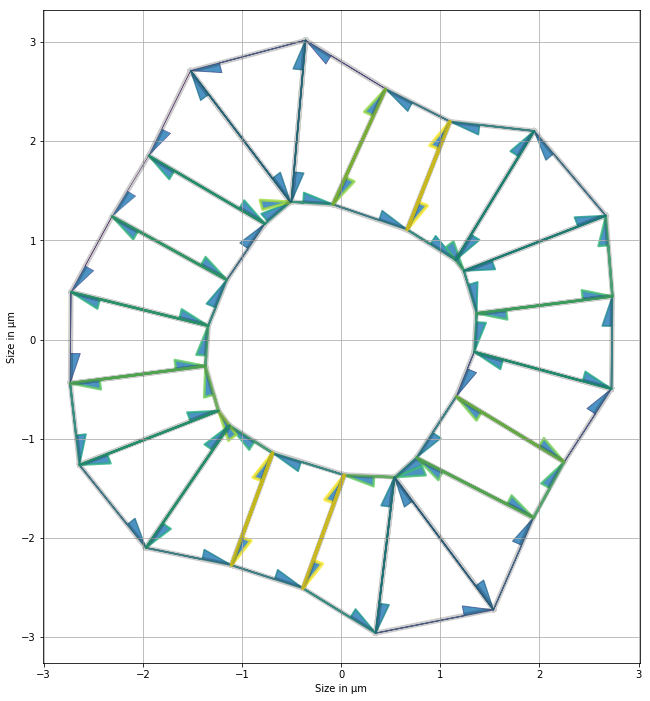

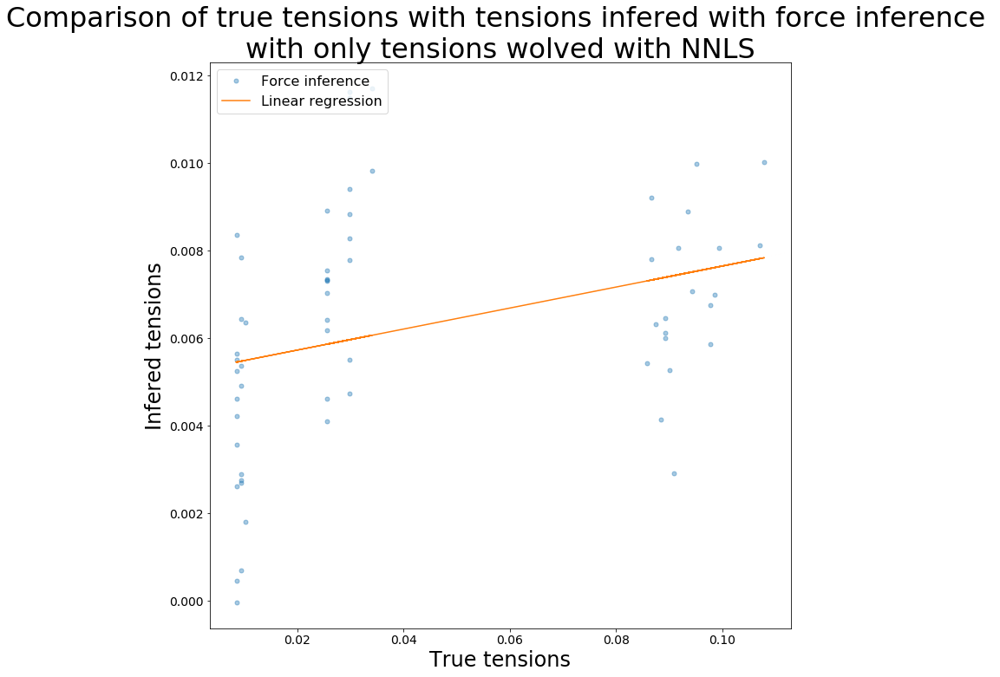

R value : 0.32981691860362305 
Standard error : 0.002159369662179149


In [24]:
(init,
 g_tmp_fi_tensions_table,
 g_tmp_cr_fi_tensions_table,
 g_tmp_fi_areas_table,
 g_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
pol_fi_tensions_table = np.concatenate((g_tmp_fi_tensions_table, pol_fi_tensions_table))
pol_cr_fi_tensions_table = np.concatenate((g_tmp_cr_fi_tensions_table, pol_cr_fi_tensions_table))
pol_fi_areas_table = np.concatenate((g_tmp_fi_areas_table, pol_fi_areas_table))
pol_cr_fi_areas_table = np.concatenate((g_tmp_cr_fi_areas_table, pol_cr_fi_areas_table))
(g_tmp_mindist_tensions_table,
 g_tmp_cr_mindist_tensions_table,
 g_tmp_mindist_areas_table,
 g_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
pol_mindist_tensions_table = np.concatenate((mindist_tensions_table, pol_mindist_tensions_table))
pol_cr_mindist_tensions_table = np.concatenate((g_tmp_cr_mindist_tensions_table, pol_cr_mindist_tensions_table))
pol_mindist_areas_table = np.concatenate((g_tmp_mindist_areas_table, pol_mindist_areas_table))
pol_cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, pol_cr_mindist_areas_table))

Un autre

Reseting datasets values with new specs


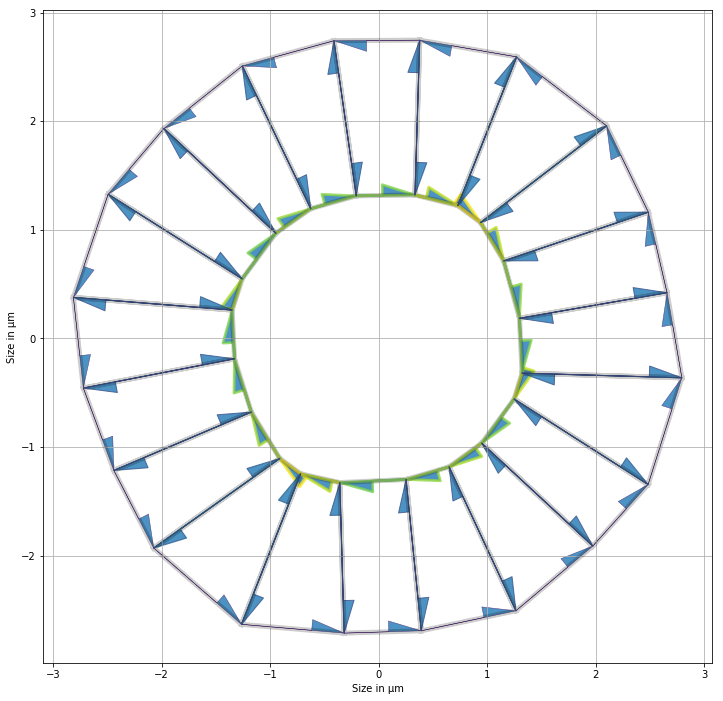

In [25]:
nf, r_in, r_out = (20, 1, 2)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = np.roll(0.75*np.array([
    0.101, 0.115, 0.126, 0.110, 0.105,
    0.102, 0.112, 0.102, 0.108, 0.105,
    0.104, 0.115, 0.127, 0.116, 0.106,
    0.103, 0.117, 0.105, 0.111, 0.107
]), 4)

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = np.roll(0.75*np.array([
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01,
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01
]), 5)

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = np.roll(0.75*np.array([
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03
]), 4)

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area

pol_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
pol_cr_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
pol_real_areas_table = np.concatenate((pol_cr_real_tensions_table,
                                   organo.face_df.prefered_area.values))
pol_cr_real_areas_table = np.concatenate((pol_cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.01159297 0.01102202 0.01134766 0.01127225 0.01115031 0.01132704
 0.01145476 0.01110357 0.01132972 0.01095559 0.01122634 0.01069517
 0.01105097 0.01105862 0.01125496 0.01138573 0.01153379 0.01134353
 0.01142067 0.01116935] 
Basal tensions:  [0.00057832 0.00103025 0.00077877 0.00097238 0.00132926 0.00055289
 0.00011256 0.00086027 0.00127486 0.00111209 0.00081737 0.00117897
 0.00094595 0.00109458 0.00124813 0.0006212  0.00010681 0.00063299
 0.00121422 0.00107145] 
Lateral tensions:  [0.00617977 0.0060658  0.00607392 0.00622203 0.0058765  0.00603435
 0.00646489 0.00645356 0.00595975 0.00590201 0.00618336 0.00605007
 0.00614155 0.00614663 0.00585981 0.00587533 0.00640515 0.00635513
 0.00600111 0.00585208] 
Area elasticity:  [0.00735837 0.00726429 0.00745399 0.00749894 0.00773585 0.00712501
 0.00693837 0.00736291 0.00787957 0.00730649 0.00734658 0.00723777
 0.00741718 0.00734549 0.00751833 0.00707865 0.00683229 0.00717093
 0.00786221 0.00741606] 
Lumen area elasticity:  

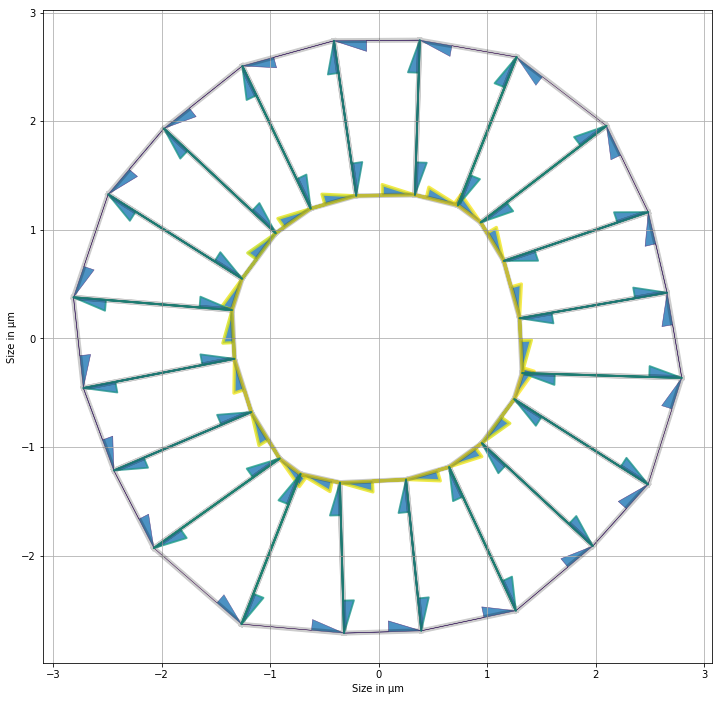

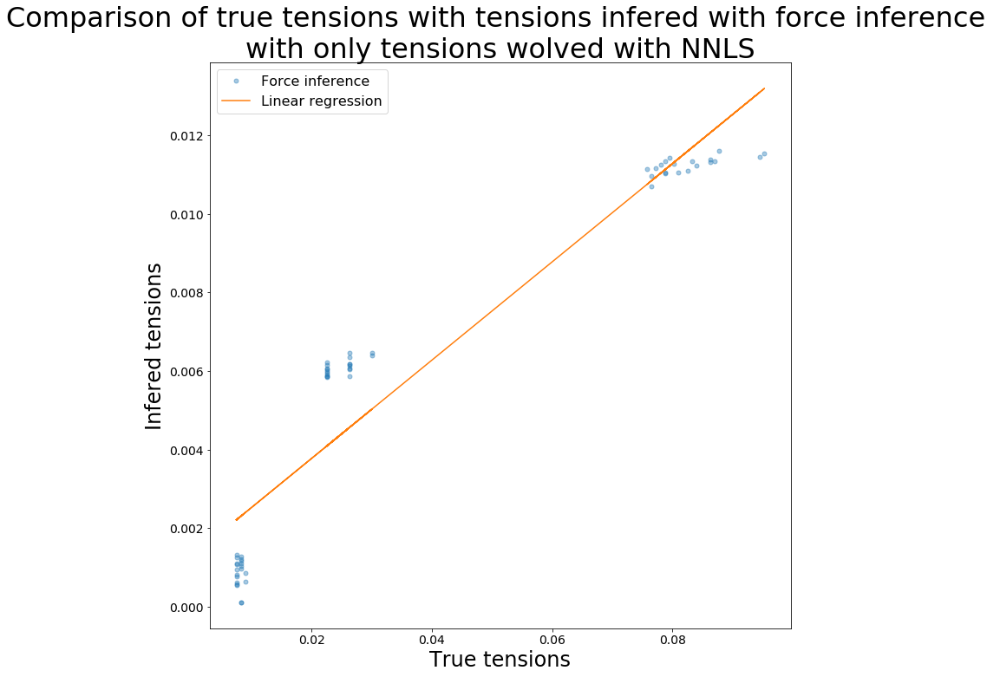

R value : 0.9469365444492122 
Standard error : 0.0011793033052866747
0.06016730854031075 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0. 

0.060167308673711534 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.060167308378295 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.060167308402759995 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.06016730854876207 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.060167308528573916 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.06016730852272413 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.06016730864478331 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.06016730871248693 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.06016730852827886 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.060167308549867585 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.06016730854031075 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.06016730854031075 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.06016730854031075 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.06016730682439436 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.

0.0601673171262957 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188918 0.00190848 0.00242686 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060045 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073073
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

0.060167311885425456 [0.00245619 0.00246624 0.00223898 0.00234069 0.00186166 0.00204983
 0.00284594 0.00260227 0.00188919 0.00190848 0.00242687 0.00228559
 0.00212269 0.0022323  0.00187446 0.00204004 0.00269875 0.00268073
 0.00196437 0.00178708 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073074
 0.00105301 0.00135411 0.00106386 0.00075622 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0

0.0601674790529107 [0.0024562  0.00246624 0.00223899 0.0023407  0.00186167 0.00204984
 0.00284595 0.00260228 0.0018892  0.00190849 0.00242687 0.0022856
 0.00212269 0.00223231 0.00187447 0.00204005 0.00269876 0.00268074
 0.00196438 0.00178709 0.00093214 0.00088418 0.00055239 0.00032943
 0.00054391 0.00130728 0.00138719 0.00123701 0.00060044 0.00021629
 0.00086867 0.0006804  0.00040899 0.00035046 0.00013823 0.00073074
 0.00105301 0.00135411 0.00106386 0.00075623 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

0.047485399221047955 [1.25884338e-03 1.49440652e-03 1.67992231e-03 1.38221833e-03
 2.21351573e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667019e-03 1.22357182e-03 1.61378816e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105495e-03
 8.01015149e-04 3.50081585e-04 1.02967479e-03 1.00350468e-03
 1.06784488e-03 5.16662815e-04 1.05001420e-03 7.69220136e-04
 6.24823752e-04 5.35520372e-04 7.70465236e-04 3.18047455e-04
 7.38755853e-04 8.42067350e-04 5.61230922e-04 6.69363159e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590267e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.047485399156193965 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204935e-03 9.84419547e-04 1.33629285e-03
 2.12911289e-03 1.81667019e-03 1.22357182e-03 1.61378816e-03
 1.65470090e-03 1.41889837e-03 1.69318799e-03 1.90198650e-03
 1.27623202e-03 1.01581030e-03 1.80300973e-03 2.37105495e-03
 8.01015147e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662809e-04 1.05001417e-03 7.69220113e-04
 6.24823747e-04 5.35520371e-04 7.70465233e-04 3.18047454e-04
 7.38755851e-04 8.42067348e-04 5.61230921e-04 6.69363157e-04
 6.73133911e-04 1.18289152e-03 7.22485259e-04 6.58590265e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04748539923338107 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419565e-04 1.33629286e-03
 2.12911288e-03 1.81667019e-03 1.22357180e-03 1.61378814e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105495e-03
 8.01015152e-04 3.50081587e-04 1.02967476e-03 1.00350470e-03
 1.06784491e-03 5.16662816e-04 1.05001420e-03 7.69220138e-04
 6.24823752e-04 5.35520361e-04 7.70465227e-04 3.18047476e-04
 7.38755849e-04 8.42067352e-04 5.61230923e-04 6.69363160e-04
 6.73133913e-04 1.18289152e-03 7.22485261e-04 6.58590269e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539912421288 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318795e-03 1.90198647e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015147e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662813e-04 1.05001420e-03 7.69220134e-04
 6.24823751e-04 5.35520371e-04 7.70465233e-04 3.18047454e-04
 7.38755851e-04 8.42067334e-04 5.61230915e-04 6.69363176e-04
 6.73133894e-04 1.18289152e-03 7.22485259e-04 6.58590265e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539914432168 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419565e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581030e-03 1.80300969e-03 2.37105492e-03
 8.01015135e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465235e-04 3.18047454e-04
 7.38755853e-04 8.42067350e-04 5.61230922e-04 6.69363158e-04
 6.73133912e-04 1.18289150e-03 7.22485291e-04 6.58590261e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539921512133 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590266e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047485399220830636 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419565e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220137e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590265e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.047485399216027624 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520371e-04 7.70465235e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590266e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04748539921593806 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520371e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067347e-04 5.61230924e-04 6.69363155e-04
 6.73133909e-04 1.18289152e-03 7.22485260e-04 6.58590265e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047485399210259516 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105495e-03
 8.01015146e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485251e-04 6.58590270e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04748539912085256 [1.25884338e-03 1.49440651e-03 1.67992242e-03 1.38221834e-03
 2.21351571e-03 2.33204933e-03 9.84419563e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470089e-03 1.41889837e-03 1.69318798e-03 1.90198649e-03
 1.27623202e-03 1.01581029e-03 1.80300972e-03 2.37105494e-03
 8.01015147e-04 3.50081587e-04 1.02967468e-03 1.00350469e-03
 1.06784490e-03 5.16662813e-04 1.05001420e-03 7.69220134e-04
 6.24823750e-04 5.35520371e-04 7.70465233e-04 3.18047454e-04
 7.38755851e-04 8.42067348e-04 5.61230920e-04 6.69363157e-04
 6.73133911e-04 1.18289152e-03 7.22485259e-04 6.58590264e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539915384082 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221834e-03
 2.21351571e-03 2.33204932e-03 9.84419649e-04 1.33629285e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198649e-03
 1.27623202e-03 1.01581029e-03 1.80300972e-03 2.37105494e-03
 8.01015147e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662816e-04 1.05001416e-03 7.69220134e-04
 6.24823750e-04 5.35520371e-04 7.70465233e-04 3.18047454e-04
 7.38755851e-04 8.42067348e-04 5.61230920e-04 6.69363157e-04
 6.73133911e-04 1.18289152e-03 7.22485259e-04 6.58590265e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0474853991458651 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221834e-03
 2.21351571e-03 2.33204933e-03 9.84419563e-04 1.33629286e-03
 2.12911288e-03 1.81667017e-03 1.22357191e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198649e-03
 1.27623202e-03 1.01581029e-03 1.80300972e-03 2.37105494e-03
 8.01015147e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662813e-04 1.05001420e-03 7.69220134e-04
 6.24823750e-04 5.35520379e-04 7.70465164e-04 3.18047464e-04
 7.38755851e-04 8.42067348e-04 5.61230920e-04 6.69363157e-04
 6.73133911e-04 1.18289152e-03 7.22485259e-04 6.58590265e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.04748539916026956 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221834e-03
 2.21351571e-03 2.33204933e-03 9.84419564e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318807e-03 1.90198649e-03
 1.27623202e-03 1.01581029e-03 1.80300972e-03 2.37105494e-03
 8.01015147e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662813e-04 1.05001420e-03 7.69220134e-04
 6.24823750e-04 5.35520371e-04 7.70465233e-04 3.18047454e-04
 7.38755851e-04 8.42067360e-04 5.61230838e-04 6.69363168e-04
 6.73133911e-04 1.18289152e-03 7.22485259e-04 6.58590265e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539917067329 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221834e-03
 2.21351571e-03 2.33204933e-03 9.84419563e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198649e-03
 1.27623202e-03 1.01581029e-03 1.80300981e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520371e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133911e-04 1.18289153e-03 7.22485194e-04 6.58590268e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539921683578 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590266e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539921683578 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590266e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539921683578 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590266e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539921683578 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590266e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748539921683578 [1.25884338e-03 1.49440652e-03 1.67992233e-03 1.38221835e-03
 2.21351572e-03 2.33204934e-03 9.84419566e-04 1.33629286e-03
 2.12911288e-03 1.81667018e-03 1.22357182e-03 1.61378815e-03
 1.65470090e-03 1.41889837e-03 1.69318798e-03 1.90198650e-03
 1.27623202e-03 1.01581029e-03 1.80300973e-03 2.37105494e-03
 8.01015148e-04 3.50081586e-04 1.02967476e-03 1.00350469e-03
 1.06784490e-03 5.16662814e-04 1.05001420e-03 7.69220135e-04
 6.24823751e-04 5.35520372e-04 7.70465234e-04 3.18047454e-04
 7.38755852e-04 8.42067349e-04 5.61230921e-04 6.69363158e-04
 6.73133912e-04 1.18289152e-03 7.22485260e-04 6.58590266e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748541170127487 [1.25884371e-03 1.49440675e-03 1.67992054e-03 1.38221663e-03
 2.21351435e-03 2.33204979e-03 9.84419888e-04 1.33629326e-03
 2.12911339e-03 1.81667070e-03 1.22357219e-03 1.61378855e-03
 1.65470136e-03 1.41889877e-03 1.69318846e-03 1.90198695e-03
 1.27623238e-03 1.01581064e-03 1.80301019e-03 2.37105550e-03
 8.01015093e-04 3.50081808e-04 1.02967917e-03 1.00350760e-03
 1.06784781e-03 5.16662789e-04 1.05001425e-03 7.69220126e-04
 6.24823788e-04 5.35520323e-04 7.70465154e-04 3.18047443e-04
 7.38755830e-04 8.42067341e-04 5.61230906e-04 6.69363159e-04
 6.73133938e-04 1.18289155e-03 7.22485311e-04 6.58590216e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748540814385532 [1.25884361e-03 1.49440680e-03 1.67992261e-03 1.38221858e-03
 2.21351619e-03 2.33204805e-03 9.84417921e-04 1.33629085e-03
 2.12911203e-03 1.81667044e-03 1.22357200e-03 1.61378846e-03
 1.65470115e-03 1.41889860e-03 1.69318825e-03 1.90198686e-03
 1.27623221e-03 1.01581040e-03 1.80301004e-03 2.37105537e-03
 8.01015511e-04 3.50081700e-04 1.02967512e-03 1.00350502e-03
 1.06784522e-03 5.16663580e-04 1.05001602e-03 7.69222788e-04
 6.24824448e-04 5.35520629e-04 7.70465619e-04 3.18047584e-04
 7.38756150e-04 8.42067665e-04 5.61231145e-04 6.69363399e-04
 6.73134121e-04 1.18289190e-03 7.22485454e-04 6.58590570e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047485409101129174 [1.25884384e-03 1.49440698e-03 1.67992301e-03 1.38221891e-03
 2.21351620e-03 2.33204973e-03 9.84420183e-04 1.33629358e-03
 2.12911355e-03 1.81666949e-03 1.22357053e-03 1.61378646e-03
 1.65470098e-03 1.41889901e-03 1.69318875e-03 1.90198709e-03
 1.27623262e-03 1.01581097e-03 1.80301039e-03 2.37105571e-03
 8.01014547e-04 3.50081468e-04 1.02967432e-03 1.00350436e-03
 1.06784464e-03 5.16662470e-04 1.05001393e-03 7.69219747e-04
 6.24823626e-04 5.35521832e-04 7.70467836e-04 3.18051748e-04
 7.38756383e-04 8.42066928e-04 5.61230599e-04 6.69362857e-04
 6.73133718e-04 1.18289112e-03 7.22485151e-04 6.58589751e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04748541966085168 [1.25884368e-03 1.49440687e-03 1.67992270e-03 1.38221867e-03
 2.21351625e-03 2.33204989e-03 9.84419750e-04 1.33629311e-03
 2.12911337e-03 1.81667054e-03 1.22357209e-03 1.61378853e-03
 1.65470125e-03 1.41889830e-03 1.69318627e-03 1.90198510e-03
 1.27623202e-03 1.01581049e-03 1.80301014e-03 2.37105546e-03
 8.01015435e-04 3.50081676e-04 1.02967505e-03 1.00350495e-03
 1.06784515e-03 5.16662988e-04 1.05001445e-03 7.69220365e-04
 6.24823891e-04 5.35520576e-04 7.70465539e-04 3.18047557e-04
 7.38756088e-04 8.42070140e-04 5.61234624e-04 6.69367698e-04
 6.73137174e-04 1.18289182e-03 7.22485413e-04 6.58590507e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04748541666969475 [1.25884398e-03 1.49440695e-03 1.67992288e-03 1.38221881e-03
 2.21351625e-03 2.33204984e-03 9.84419979e-04 1.33629336e-03
 2.12911349e-03 1.81667082e-03 1.22357229e-03 1.61378863e-03
 1.65470148e-03 1.41889887e-03 1.69318858e-03 1.90198704e-03
 1.27623247e-03 1.01581029e-03 1.80300860e-03 2.37105337e-03
 8.01017277e-04 3.50081574e-04 1.02967469e-03 1.00350466e-03
 1.06784490e-03 5.16662737e-04 1.05001419e-03 7.69220063e-04
 6.24823759e-04 5.35520258e-04 7.70465056e-04 3.18047413e-04
 7.38755762e-04 8.42067272e-04 5.61230855e-04 6.69363109e-04
 6.73133900e-04 1.18289433e-03 7.22489421e-04 6.58593389e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035385998786521204 [1.27923424e-03 1.02117509e-03 1.47990961e-03 1.16819552e-03
 1.53319605e-03 1.97510685e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913089e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512187e-04 7.38112674e-04 5.44572841e-04 1.51579206e-04
 4.37597633e-04 9.59557194e-04 3.37497627e-04 2.39300307e-04
 1.59749808e-04 1.38430388e-04 2.45007430e-04 5.05517602e-04
 5.51431419e-04 1.56161397e-04 3.88318923e-04 4.73250406e-04
 1.93907970e-04 1.65928793e-04 5.22479016e-04 2.80353328e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03538599908389524 [1.27923427e-03 1.02117512e-03 1.47990961e-03 1.16819552e-03
 1.53319606e-03 1.97510687e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807196e-03
 1.43131015e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667425e-03 1.73917981e-03
 3.02512207e-04 7.38112704e-04 5.44572855e-04 1.51579216e-04
 4.37597661e-04 9.59557223e-04 3.37497634e-04 2.39300308e-04
 1.59749811e-04 1.38430390e-04 2.45007429e-04 5.05517601e-04
 5.51431420e-04 1.56161396e-04 3.88318925e-04 4.73250408e-04
 1.93907970e-04 1.65928793e-04 5.22479019e-04 2.80353334e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035385998997472766 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743331e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512207e-04 7.38112703e-04 5.44572854e-04 1.51579207e-04
 4.37597634e-04 9.59557195e-04 3.37497628e-04 2.39300307e-04
 1.59749825e-04 1.38430411e-04 2.45007429e-04 5.05517603e-04
 5.51431420e-04 1.56161397e-04 3.88318924e-04 4.73250407e-04
 1.93907970e-04 1.65928793e-04 5.22479017e-04 2.80353331e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03538599882177699 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807196e-03
 1.43131012e-03 1.31298724e-03 1.29848617e-03 1.58913089e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512207e-04 7.38112702e-04 5.44572854e-04 1.51579206e-04
 4.37597633e-04 9.59557194e-04 3.37497627e-04 2.39300307e-04
 1.59749808e-04 1.38430387e-04 2.45007430e-04 5.05517593e-04
 5.51431393e-04 1.56161374e-04 3.88318933e-04 4.73250406e-04
 1.93907970e-04 1.65928793e-04 5.22479016e-04 2.80353331e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035385998932141664 [1.27923427e-03 1.02117512e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935848e-03 1.16040892e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112703e-04 5.44572854e-04 1.51579207e-04
 4.37597636e-04 9.59557196e-04 3.37497628e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250419e-04
 1.93907995e-04 1.65928767e-04 5.22479031e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03538599894095022 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512210e-04 7.38112707e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599890273953 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510685e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579208e-04
 4.37597627e-04 9.59557186e-04 3.37497628e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517600e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599890649801 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557195e-04 3.37497627e-04 2.39300308e-04
 1.59749805e-04 1.38430381e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907970e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035385998946743644 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007429e-04 5.05517600e-04
 5.51431427e-04 1.56161403e-04 3.88318926e-04 4.73250407e-04
 1.93907970e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03538599893302024 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250408e-04
 1.93907966e-04 1.65928796e-04 5.22479019e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599903676994 [1.27923434e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913089e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512265e-04 7.38112697e-04 5.44572854e-04 1.51579208e-04
 4.37597636e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749811e-04 1.38430391e-04 2.45007428e-04 5.05517600e-04
 5.51431418e-04 1.56161395e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479019e-04 2.80353335e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599889298787 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819551e-03
 1.53319612e-03 1.97510685e-03 1.12060032e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913089e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917980e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579202e-04
 4.37597595e-04 9.59557201e-04 3.37497627e-04 2.39300308e-04
 1.59749811e-04 1.38430391e-04 2.45007428e-04 5.05517600e-04
 5.51431418e-04 1.56161395e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0353859988750388 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510685e-03 1.12060032e-03 1.37939052e-03
 1.62005174e-03 1.54743329e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913089e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917980e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557195e-04 3.37497627e-04 2.39300308e-04
 1.59749747e-04 1.38430395e-04 2.45007428e-04 5.05517600e-04
 5.51431418e-04 1.56161395e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.03538599895532909 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131022e-03 1.31298726e-03 1.29848617e-03 1.58913089e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579208e-04
 4.37597636e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749811e-04 1.38430391e-04 2.45007428e-04 5.05517607e-04
 5.51431408e-04 1.56161387e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479019e-04 2.80353334e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599897229048 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913089e-03
 1.03935858e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749811e-04 1.38430390e-04 2.45007428e-04 5.05517600e-04
 5.51431418e-04 1.56161396e-04 3.88318925e-04 4.73250400e-04
 1.93907986e-04 1.65928785e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599893234373 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599893234373 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599893234373 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599893234373 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599893234373 [1.27923427e-03 1.02117511e-03 1.47990960e-03 1.16819552e-03
 1.53319605e-03 1.97510686e-03 1.12060033e-03 1.37939053e-03
 1.62005167e-03 1.54743330e-03 1.22427069e-03 1.18807195e-03
 1.43131014e-03 1.31298726e-03 1.29848617e-03 1.58913090e-03
 1.03935851e-03 1.16040894e-03 1.78667424e-03 1.73917981e-03
 3.02512206e-04 7.38112702e-04 5.44572854e-04 1.51579207e-04
 4.37597635e-04 9.59557196e-04 3.37497627e-04 2.39300308e-04
 1.59749810e-04 1.38430390e-04 2.45007428e-04 5.05517601e-04
 5.51431419e-04 1.56161396e-04 3.88318925e-04 4.73250407e-04
 1.93907969e-04 1.65928793e-04 5.22479018e-04 2.80353333e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0353859971332476 [1.27923333e-03 1.02117387e-03 1.47990922e-03 1.16819572e-03
 1.53319630e-03 1.97510731e-03 1.12060054e-03 1.37939085e-03
 1.62005186e-03 1.54743345e-03 1.22427085e-03 1.18807212e-03
 1.43131045e-03 1.31298746e-03 1.29848636e-03 1.58913120e-03
 1.03935868e-03 1.16040920e-03 1.78667451e-03 1.73917987e-03
 3.02507265e-04 7.38110591e-04 5.44574750e-04 1.51579347e-04
 4.37597935e-04 9.59557496e-04 3.37497647e-04 2.39300396e-04
 1.59750157e-04 1.38430780e-04 2.45007148e-04 5.05517335e-04
 5.51431260e-04 1.56161195e-04 3.88319126e-04 4.73250521e-04
 1.93907902e-04 1.65928832e-04 5.22479385e-04 2.80354060e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.035386001120813554 [1.27923449e-03 1.02117532e-03 1.47990985e-03 1.16819514e-03
 1.53319293e-03 1.97510402e-03 1.12059998e-03 1.37939075e-03
 1.62005198e-03 1.54743359e-03 1.22427092e-03 1.18807219e-03
 1.43131040e-03 1.31298751e-03 1.29848644e-03 1.58913117e-03
 1.03935870e-03 1.16040913e-03 1.78667454e-03 1.73918013e-03
 3.02512251e-04 7.38112773e-04 5.44572899e-04 1.51577939e-04
 4.37602198e-04 9.59559245e-04 3.37496711e-04 2.39300320e-04
 1.59749777e-04 1.38430348e-04 2.45007494e-04 5.05517691e-04
 5.51431498e-04 1.56161441e-04 3.88318936e-04 4.73250439e-04
 1.93907999e-04 1.65928804e-04 5.22479019e-04 2.80353313e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03538600755869876 [1.27923470e-03 1.02117541e-03 1.47991015e-03 1.16819585e-03
 1.53319647e-03 1.97510751e-03 1.12060066e-03 1.37939019e-03
 1.62004914e-03 1.54743031e-03 1.22427077e-03 1.18807225e-03
 1.43131061e-03 1.31298760e-03 1.29848651e-03 1.58913137e-03
 1.03935879e-03 1.16040933e-03 1.78667468e-03 1.73918022e-03
 3.02512116e-04 7.38112777e-04 5.44572969e-04 1.51579369e-04
 4.37597987e-04 9.59557572e-04 3.37497664e-04 2.39300494e-04
 1.59754872e-04 1.38431640e-04 2.45007311e-04 5.05517328e-04
 5.51431267e-04 1.56161180e-04 3.88319165e-04 4.73250554e-04
 1.93907903e-04 1.65928844e-04 5.22479449e-04 2.80353723e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538599606123577 [1.27923464e-03 1.02117535e-03 1.47991008e-03 1.16819578e-03
 1.53319638e-03 1.97510743e-03 1.12060060e-03 1.37939093e-03
 1.62005193e-03 1.54743350e-03 1.22427091e-03 1.18807175e-03
 1.43130861e-03 1.31298568e-03 1.29848622e-03 1.58913128e-03
 1.03935873e-03 1.16040927e-03 1.78667459e-03 1.73918011e-03
 3.02512093e-04 7.38112749e-04 5.44572953e-04 1.51579376e-04
 4.37597998e-04 9.59557560e-04 3.37497651e-04 2.39300415e-04
 1.59750230e-04 1.38430862e-04 2.45007090e-04 5.05518775e-04
 5.51429151e-04 1.56156383e-04 3.88317675e-04 4.73250545e-04
 1.93907888e-04 1.65928841e-04 5.22479462e-04 2.80353744e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538598895609595 [1.27923427e-03 1.02117513e-03 1.47990959e-03 1.16819554e-03
 1.53319607e-03 1.97510684e-03 1.12060033e-03 1.37939052e-03
 1.62005170e-03 1.54743333e-03 1.22427071e-03 1.18807198e-03
 1.43131015e-03 1.31298728e-03 1.29848620e-03 1.58913062e-03
 1.03935720e-03 1.16040741e-03 1.78667442e-03 1.73917984e-03
 3.02512223e-04 7.38112693e-04 5.44572838e-04 1.51579181e-04
 4.37597579e-04 9.59557137e-04 3.37497623e-04 2.39300291e-04
 1.59749746e-04 1.38430317e-04 2.45007479e-04 5.05517648e-04
 5.51431446e-04 1.56161432e-04 3.88318887e-04 4.73248849e-04
 1.93909256e-04 1.65923887e-04 5.22477197e-04 2.80353269e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03538619019477333 [1.27924297e-03 1.02118358e-03 1.47991989e-03 1.16820424e-03
 1.53320651e-03 1.97511771e-03 1.12060729e-03 1.37939894e-03
 1.62006225e-03 1.54744272e-03 1.22427888e-03 1.18808103e-03
 1.43132060e-03 1.31299641e-03 1.29849660e-03 1.58914141e-03
 1.03936600e-03 1.16041687e-03 1.78668373e-03 1.73919078e-03
 3.02510904e-04 7.38112943e-04 5.44573722e-04 1.51579781e-04
 4.37599859e-04 9.59558112e-04 3.37496598e-04 2.39300085e-04
 1.59752631e-04 1.38431670e-04 2.45005347e-04 5.05516402e-04
 5.51430789e-04 1.56159646e-04 3.88319975e-04 4.73250960e-04
 1.93906871e-04 1.65928497e-04 5.22480062e-04 2.80356081e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.029108983987136485 [9.77969749e-04 9.17252291e-04 1.25595715e-03 9.75830870e-04
 1.40313791e-03 1.44663097e-03 8.54479681e-04 1.03683391e-03
 1.49665259e-03 1.35066807e-03 9.94030672e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092982e-04 8.71176470e-04 1.39959873e-03 1.61446839e-03
 1.82648857e-04 5.25110210e-04 5.17672997e-04 1.54529354e-04
 2.75646995e-04 5.93017198e-04 6.84253234e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171991e-04 4.64034809e-04
 5.22631500e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832090e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02910898386373948 [9.77969744e-04 9.17252312e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663094e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066806e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092980e-04 8.71176467e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672980e-04 1.54529360e-04
 2.75646987e-04 5.93017174e-04 6.84253200e-05 1.39610735e-04
 2.18643755e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631499e-04 1.61698323e-04 2.36489701e-04 3.55478410e-04
 1.73043656e-04 2.20977559e-04 1.61832088e-04 3.58575534e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02910898397819473 [9.77969747e-04 9.17252314e-04 1.25595717e-03 9.75830868e-04
 1.40313791e-03 1.44663097e-03 8.54479682e-04 1.03683391e-03
 1.49665259e-03 1.35066804e-03 9.94030641e-04 1.05339717e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092982e-04 8.71176470e-04 1.39959873e-03 1.61446839e-03
 1.82648849e-04 5.25110188e-04 5.17672982e-04 1.54529361e-04
 2.75646996e-04 5.93017198e-04 6.84253233e-05 1.39610736e-04
 2.18643755e-04 1.49752255e-04 2.93172011e-04 4.64034814e-04
 5.22631499e-04 1.61698322e-04 2.36489703e-04 3.55478412e-04
 1.73043657e-04 2.20977560e-04 1.61832091e-04 3.58575536e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.029108983923844898 [9.77969745e-04 9.17252314e-04 1.25595716e-03 9.75830867e-04
 1.40313791e-03 1.44663097e-03 8.54479681e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030672e-04 1.05339716e-03
 1.22035125e-03 1.10586113e-03 1.17702811e-03 1.29895481e-03
 8.85092981e-04 8.71176469e-04 1.39959873e-03 1.61446838e-03
 1.82648849e-04 5.25110188e-04 5.17672981e-04 1.54529361e-04
 2.75646995e-04 5.93017197e-04 6.84253234e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171991e-04 4.64034809e-04
 5.22631503e-04 1.61698345e-04 2.36489684e-04 3.55478401e-04
 1.73043657e-04 2.20977560e-04 1.61832089e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983897421385 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830867e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176458e-04 1.39959869e-03 1.61446839e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253234e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171992e-04 4.64034809e-04
 5.22631499e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043647e-04 2.20977579e-04 1.61832067e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02910898393310237 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830867e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110180e-04 5.17672977e-04 1.54529359e-04
 2.75646995e-04 5.93017197e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171992e-04 4.64034810e-04
 5.22631499e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.029108983949927877 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646994e-04 5.93017200e-04 6.84253244e-05 1.39610736e-04
 2.18643756e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631500e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02910898394928886 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030670e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646994e-04 5.93017196e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171997e-04 4.64034815e-04
 5.22631499e-04 1.61698323e-04 2.36489702e-04 3.55478410e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.029108983926696655 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017196e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631499e-04 1.61698322e-04 2.36489694e-04 3.55478403e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983921989663 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066806e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092980e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648849e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646994e-04 5.93017196e-04 6.84253235e-05 1.39610736e-04
 2.18643755e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631499e-04 1.61698323e-04 2.36489701e-04 3.55478410e-04
 1.73043657e-04 2.20977558e-04 1.61832076e-04 3.58575541e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983947074223 [9.77969744e-04 9.17252312e-04 1.25595723e-03 9.75830864e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066806e-03 9.94030670e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092980e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110194e-04 5.17672931e-04 1.54529366e-04
 2.75646995e-04 5.93017197e-04 6.84253234e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171992e-04 4.64034809e-04
 5.22631499e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832089e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108984044927292 [9.77969744e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479740e-04 1.03683390e-03
 1.49665258e-03 1.35066806e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092980e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017192e-04 6.84253810e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171992e-04 4.64034809e-04
 5.22631499e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832089e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983971386247 [9.77969744e-04 9.17252312e-04 1.25595716e-03 9.75830865e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066806e-03 9.94030727e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092980e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253234e-05 1.39610736e-04
 2.18643756e-04 1.49752243e-04 2.93171985e-04 4.64034805e-04
 5.22631499e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043656e-04 2.20977560e-04 1.61832089e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02910898396083287 [9.77969744e-04 9.17252312e-04 1.25595716e-03 9.75830865e-04
 1.40313791e-03 1.44663097e-03 8.54479679e-04 1.03683390e-03
 1.49665258e-03 1.35066806e-03 9.94030670e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702819e-03 1.29895480e-03
 8.85092980e-04 8.71176467e-04 1.39959873e-03 1.61446838e-03
 1.82648849e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253234e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171991e-04 4.64034809e-04
 5.22631499e-04 1.61698329e-04 2.36489673e-04 3.55478417e-04
 1.73043656e-04 2.20977560e-04 1.61832089e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02910898396889131 [9.77969744e-04 9.17252312e-04 1.25595716e-03 9.75830865e-04
 1.40313791e-03 1.44663097e-03 8.54479679e-04 1.03683390e-03
 1.49665258e-03 1.35066806e-03 9.94030670e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092980e-04 8.71176466e-04 1.39959879e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253234e-05 1.39610736e-04
 2.18643756e-04 1.49752237e-04 2.93171992e-04 4.64034809e-04
 5.22631499e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043656e-04 2.20977566e-04 1.61832079e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.029108983945941712 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631500e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983945941712 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631500e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983945941712 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631500e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983945941712 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631500e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108983945941712 [9.77969745e-04 9.17252313e-04 1.25595716e-03 9.75830866e-04
 1.40313791e-03 1.44663097e-03 8.54479680e-04 1.03683390e-03
 1.49665258e-03 1.35066807e-03 9.94030671e-04 1.05339716e-03
 1.22035125e-03 1.10586115e-03 1.17702813e-03 1.29895480e-03
 8.85092981e-04 8.71176468e-04 1.39959873e-03 1.61446838e-03
 1.82648850e-04 5.25110188e-04 5.17672981e-04 1.54529360e-04
 2.75646995e-04 5.93017197e-04 6.84253235e-05 1.39610736e-04
 2.18643756e-04 1.49752238e-04 2.93171992e-04 4.64034810e-04
 5.22631500e-04 1.61698323e-04 2.36489702e-04 3.55478411e-04
 1.73043657e-04 2.20977560e-04 1.61832088e-04 3.58575535e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108994741754504 [9.77970001e-04 9.17252456e-04 1.25595556e-03 9.75829494e-04
 1.40313812e-03 1.44663136e-03 8.54479886e-04 1.03683420e-03
 1.49665295e-03 1.35066836e-03 9.94030851e-04 1.05339736e-03
 1.22035155e-03 1.10586142e-03 1.17702845e-03 1.29895514e-03
 8.85093203e-04 8.71176719e-04 1.39959906e-03 1.61446879e-03
 1.82648784e-04 5.25111590e-04 5.17674512e-04 1.54534161e-04
 2.75647563e-04 5.93017372e-04 6.84253152e-05 1.39610791e-04
 2.18643860e-04 1.49752147e-04 2.93171873e-04 4.64034738e-04
 5.22631502e-04 1.61698305e-04 2.36489796e-04 3.55478516e-04
 1.73043667e-04 2.20977622e-04 1.61832272e-04 3.58575612e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02910897830288825 [9.77969677e-04 9.17252263e-04 1.25595705e-03 9.75830800e-04
 1.40313780e-03 1.44663062e-03 8.54479641e-04 1.03683326e-03
 1.49665227e-03 1.35066799e-03 9.94030635e-04 1.05339712e-03
 1.22035117e-03 1.10586108e-03 1.17702805e-03 1.29895471e-03
 8.85092921e-04 8.71176397e-04 1.39959864e-03 1.61446826e-03
 1.82648879e-04 5.25110161e-04 5.17672921e-04 1.54529312e-04
 2.75646936e-04 5.93016141e-04 6.84209756e-05 1.39612369e-04
 2.18644770e-04 1.49752279e-04 2.93172045e-04 4.64034839e-04
 5.22631494e-04 1.61698330e-04 2.36489655e-04 3.55478358e-04
 1.73043650e-04 2.20977529e-04 1.61832000e-04 3.58575495e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.029108990229559033 [9.77970274e-04 9.17252718e-04 1.25595797e-03 9.75831396e-04
 1.40313873e-03 1.44663181e-03 8.54480097e-04 1.03683456e-03
 1.49665333e-03 1.35066873e-03 9.94028128e-04 1.05339458e-03
 1.22035170e-03 1.10586169e-03 1.17702879e-03 1.29895552e-03
 8.85093433e-04 8.71177020e-04 1.39959938e-03 1.61446924e-03
 1.82648576e-04 5.25110243e-04 5.17673281e-04 1.54529676e-04
 2.75647354e-04 5.93017683e-04 6.84252787e-05 1.39610901e-04
 2.18644074e-04 1.49753352e-04 2.93169045e-04 4.64032212e-04
 5.22632900e-04 1.61698222e-04 2.36489984e-04 3.55478703e-04
 1.73043656e-04 2.20977730e-04 1.61832703e-04 3.58575726e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.029108991921375678 [9.77969876e-04 9.17252445e-04 1.25595731e-03 9.75831002e-04
 1.40313809e-03 1.44663114e-03 8.54479788e-04 1.03683403e-03
 1.49665277e-03 1.35066824e-03 9.94030811e-04 1.05339731e-03
 1.22035141e-03 1.10586104e-03 1.17702572e-03 1.29895290e-03
 8.85092478e-04 8.71176581e-04 1.39959890e-03 1.61446858e-03
 1.82648877e-04 5.25110221e-04 5.17673000e-04 1.54529354e-04
 2.75646994e-04 5.93017210e-04 6.84253305e-05 1.39610736e-04
 2.18643753e-04 1.49752267e-04 2.93172038e-04 4.64034860e-04
 5.22631541e-04 1.61699853e-04 2.36494331e-04 3.55483344e-04
 1.73042797e-04 2.20977566e-04 1.61832066e-04 3.58575549e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02910899560451123 [9.77969868e-04 9.17252665e-04 1.25595773e-03 9.75831278e-04
 1.40313851e-03 1.44663158e-03 8.54480013e-04 1.03683436e-03
 1.49665317e-03 1.35066855e-03 9.94030979e-04 1.05339750e-03
 1.22035174e-03 1.10586159e-03 1.17702864e-03 1.29895535e-03
 8.85093338e-04 8.71176452e-04 1.39959595e-03 1.61446595e-03
 1.82649961e-04 5.25110283e-04 5.17673167e-04 1.54529500e-04
 2.75647168e-04 5.93017463e-04 6.84253165e-05 1.39610817e-04
 2.18643906e-04 1.49752126e-04 2.93171851e-04 4.64034742e-04
 5.22631533e-04 1.61698308e-04 2.36489841e-04 3.55478571e-04
 1.73043681e-04 2.20979072e-04 1.61836292e-04 3.58576968e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02398419872126013 [7.15060169e-04 7.39055110e-04 9.08273406e-04 6.24376357e-04
 9.16076564e-04 8.60255464e-04 5.77824850e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200284e-04
 5.91328069e-04 4.80601971e-04 8.12745259e-04 1.19477491e-03
 3.16800586e-04 3.56893733e-04 4.72612839e-04 2.03683198e-04
 4.14207262e-04 4.11753147e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294769e-04
 2.36581030e-04 2.91216408e-04 3.29878340e-04 5.81321749e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.023984198687425674 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376357e-04
 9.16076555e-04 8.60255446e-04 5.77824854e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683194e-04
 4.14207258e-04 4.11753156e-04 2.08263520e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198702748333 [7.15060141e-04 7.39055080e-04 9.08273407e-04 6.24376357e-04
 9.16076564e-04 8.60255464e-04 5.77824850e-04 5.48356651e-04
 1.08263923e-03 1.05067337e-03 9.48091143e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200284e-04
 5.91328069e-04 4.80601971e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683198e-04
 4.14207262e-04 4.11753147e-04 2.08263518e-04 3.76165353e-04
 3.50138396e-04 4.80433830e-04 4.86126964e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294769e-04
 2.36581030e-04 2.91216408e-04 3.29878340e-04 5.81321755e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198706622106 [7.15060141e-04 7.39055080e-04 9.08273407e-04 6.24376357e-04
 9.16076564e-04 8.60255464e-04 5.77824850e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350733e-03
 1.01033506e-03 7.79307300e-04 6.72052418e-04 8.42200284e-04
 5.91328069e-04 4.80601971e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683198e-04
 4.14207262e-04 4.11753147e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351828e-04
 5.68785269e-04 2.56009801e-04 3.34974825e-04 3.41294769e-04
 2.36581030e-04 2.91216408e-04 3.29878340e-04 5.81321755e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02398419865885121 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200289e-04
 5.91328030e-04 4.80601948e-04 8.12745258e-04 1.19477491e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753147e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294767e-04
 2.36581043e-04 2.91216408e-04 3.29878335e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.023984198718067656 [7.15060141e-04 7.39055080e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745259e-04 1.19477492e-03
 3.16800597e-04 3.56893746e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198718865257 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824851e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307286e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745260e-04 1.19477492e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683198e-04
 4.14207268e-04 4.11753141e-04 2.08263519e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02398419871933048 [7.15060141e-04 7.39055081e-04 9.08273407e-04 6.24376357e-04
 9.16076565e-04 8.60255464e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753147e-04 2.08263518e-04 3.76165354e-04
 3.50138412e-04 4.80433848e-04 4.86126969e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.023984198716243132 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376357e-04
 9.16076565e-04 8.60255464e-04 5.77824850e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307284e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753147e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351834e-04
 5.68785280e-04 2.56009815e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198716367283 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200285e-04
 5.91328070e-04 4.80601972e-04 8.12745260e-04 1.19477492e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581027e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198710162802 [7.15060168e-04 7.39055078e-04 9.08273407e-04 6.24376357e-04
 9.16076564e-04 8.60255464e-04 5.77824850e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745259e-04 1.19477491e-03
 3.16800571e-04 3.56893742e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321759e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198727451084 [7.15060141e-04 7.39055081e-04 9.08273408e-04 6.24376357e-04
 9.16076610e-04 8.60255464e-04 5.77824850e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683202e-04
 4.14207224e-04 4.11753151e-04 2.08263518e-04 3.76165355e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974830e-04 3.41294770e-04
 2.36581031e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198709358296 [7.15060141e-04 7.39055080e-04 9.08273407e-04 6.24376357e-04
 9.16076564e-04 8.60255464e-04 5.77824850e-04 5.48356646e-04
 1.08263927e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200284e-04
 5.91328069e-04 4.80601971e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165355e-04
 3.50138372e-04 4.80433839e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198709054532 [7.15060141e-04 7.39055081e-04 9.08273407e-04 6.24376357e-04
 9.16076564e-04 8.60255464e-04 5.77824850e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033506e-03 7.79307282e-04 6.72052417e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351838e-04
 5.68785245e-04 2.56009810e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198721756472 [7.15060141e-04 7.39055081e-04 9.08273408e-04 6.24376357e-04
 9.16076565e-04 8.60255464e-04 5.77824850e-04 5.48356648e-04
 1.08263922e-03 1.05067334e-03 9.48091147e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052417e-04 8.42200283e-04
 5.91328109e-04 4.80601972e-04 8.12745259e-04 1.19477491e-03
 3.16800595e-04 3.56893743e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433840e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294771e-04
 2.36581001e-04 2.91216410e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198718479215 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745260e-04 1.19477492e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198718479215 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745260e-04 1.19477492e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198718479215 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745260e-04 1.19477492e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198718479215 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745260e-04 1.19477492e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984198718479215 [7.15060142e-04 7.39055081e-04 9.08273408e-04 6.24376358e-04
 9.16076565e-04 8.60255465e-04 5.77824850e-04 5.48356649e-04
 1.08263922e-03 1.05067334e-03 9.48091148e-04 1.07350734e-03
 1.01033503e-03 7.79307285e-04 6.72052418e-04 8.42200285e-04
 5.91328069e-04 4.80601972e-04 8.12745260e-04 1.19477492e-03
 3.16800595e-04 3.56893744e-04 4.72612845e-04 2.03683199e-04
 4.14207263e-04 4.11753148e-04 2.08263518e-04 3.76165354e-04
 3.50138404e-04 4.80433841e-04 4.86126970e-04 5.38351834e-04
 5.68785277e-04 2.56009811e-04 3.34974829e-04 3.41294770e-04
 2.36581030e-04 2.91216409e-04 3.29878341e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02398420022006648 [7.15056645e-04 7.39051548e-04 9.08273891e-04 6.24376604e-04
 9.16076954e-04 8.60255810e-04 5.77825055e-04 5.48356880e-04
 1.08263964e-03 1.05067370e-03 9.48091401e-04 1.07350764e-03
 1.01033536e-03 7.79307565e-04 6.72052705e-04 8.42200624e-04
 5.91328296e-04 4.80602181e-04 8.12745559e-04 1.19477545e-03
 3.16800348e-04 3.56892987e-04 4.72613744e-04 2.03683276e-04
 4.14207432e-04 4.11753323e-04 2.08263572e-04 3.76165492e-04
 3.50138533e-04 4.80433939e-04 4.86127062e-04 5.38351945e-04
 5.68785429e-04 2.56009881e-04 3.34974960e-04 3.41294924e-04
 2.36581112e-04 2.91216515e-04 3.29878477e-04 5.81322783e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.02398420282119684 [7.15060208e-04 7.39055145e-04 9.08273483e-04 6.24376441e-04
 9.16074873e-04 8.60254745e-04 5.77824203e-04 5.48356709e-04
 1.08263932e-03 1.05067343e-03 9.48091222e-04 1.07350742e-03
 1.01033511e-03 7.79307361e-04 6.72052500e-04 8.42200367e-04
 5.91328125e-04 4.80602027e-04 8.12745343e-04 1.19477501e-03
 3.16800614e-04 3.56893764e-04 4.72612855e-04 2.03684011e-04
 4.14207921e-04 4.11757594e-04 2.08263227e-04 3.76165361e-04
 3.50138410e-04 4.80433874e-04 4.86127007e-04 5.38351872e-04
 5.68785305e-04 2.56009823e-04 3.34974833e-04 3.41294766e-04
 2.36581036e-04 2.91216414e-04 3.29878341e-04 5.81321776e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.023984200323227175 [7.15060398e-04 7.39055346e-04 9.08273780e-04 6.24376625e-04
 9.16076969e-04 8.60255832e-04 5.77825072e-04 5.48356454e-04
 1.08263664e-03 1.05066973e-03 9.48092116e-04 1.07350768e-03
 1.01033539e-03 7.79307591e-04 6.72052727e-04 8.42200644e-04
 5.91328311e-04 4.80602193e-04 8.12745587e-04 1.19477540e-03
 3.16800681e-04 3.56893844e-04 4.72613007e-04 2.03683272e-04
 4.14207418e-04 4.11753306e-04 2.08263578e-04 3.76165577e-04
 3.50138144e-04 4.80432894e-04 4.86127952e-04 5.38351973e-04
 5.68785444e-04 2.56009887e-04 3.34974951e-04 3.41294906e-04
 2.36581111e-04 2.91216511e-04 3.29878465e-04 5.81321942e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984202967857252 [7.15060416e-04 7.39055368e-04 9.08273839e-04 6.24376658e-04
 9.16077039e-04 8.60255885e-04 5.77825098e-04 5.48356932e-04
 1.08263973e-03 1.05067377e-03 9.48091448e-04 1.07350837e-03
 1.01033146e-03 7.79304310e-04 6.72052537e-04 8.42200697e-04
 5.91328344e-04 4.80602227e-04 8.12745623e-04 1.19477548e-03
 3.16800680e-04 3.56893846e-04 4.72613043e-04 2.03683291e-04
 4.14207464e-04 4.11753357e-04 2.08263581e-04 3.76165517e-04
 3.50138557e-04 4.80433955e-04 4.86127076e-04 5.38352844e-04
 5.68785690e-04 2.56009260e-04 3.34975506e-04 3.41294953e-04
 2.36581128e-04 2.91216535e-04 3.29878503e-04 5.81321971e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.023984207656545162 [7.15060153e-04 7.39055092e-04 9.08273441e-04 6.24376385e-04
 9.16076611e-04 8.60255503e-04 5.77824865e-04 5.48356678e-04
 1.08263926e-03 1.05067336e-03 9.48091143e-04 1.07350734e-03
 1.01033505e-03 7.79307308e-04 6.72052457e-04 8.42199825e-04
 5.91329159e-04 4.80601428e-04 8.12745478e-04 1.19477496e-03
 3.16800588e-04 3.56893737e-04 4.72612850e-04 2.03683202e-04
 4.14207272e-04 4.11753159e-04 2.08263515e-04 3.76165359e-04
 3.50138409e-04 4.80433827e-04 4.86126955e-04 5.38351820e-04
 5.68785270e-04 2.56009808e-04 3.34974836e-04 3.41295063e-04
 2.36585754e-04 2.91218990e-04 3.29879018e-04 5.81321756e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.02398439411883763 [7.15066296e-04 7.39061109e-04 9.08283131e-04 6.24384963e-04
 9.16088698e-04 8.60266571e-04 5.77830272e-04 5.48364676e-04
 1.08265078e-03 1.05068200e-03 9.48095539e-04 1.07351236e-03
 1.01034276e-03 7.79315589e-04 6.72063304e-04 8.42210929e-04
 5.91334806e-04 4.80609538e-04 8.12754546e-04 1.19478691e-03
 3.16801478e-04 3.56894621e-04 4.72614620e-04 2.03684319e-04
 4.14209149e-04 4.11755294e-04 2.08263907e-04 3.76166729e-04
 3.50139815e-04 4.80434498e-04 4.86127631e-04 5.38352714e-04
 5.68786675e-04 2.56010640e-04 3.34976520e-04 3.41296770e-04
 2.36581810e-04 2.91217729e-04 3.29880008e-04 5.81323436e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.018446339958718642 [6.09460834e-04 6.04772930e-04 5.90367845e-04 4.17260254e-04
 4.98271257e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321301e-04 8.12388249e-04 9.12885021e-04 9.72283592e-04
 8.23091360e-04 5.90483441e-04 3.96161559e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514730e-04 7.57676057e-04
 3.78149924e-04 3.89189837e-04 3.78699720e-04 1.58260681e-04
 2.46111404e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539434e-04 6.34732395e-04 6.63738594e-04
 5.99713400e-04 3.10332393e-04 2.15976679e-04 1.56112279e-04
 1.72784479e-04 1.93854238e-04 2.38402274e-04 5.20314664e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01844633990162312 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473154e-04 3.09373261e-04
 6.97321302e-04 8.12388250e-04 9.12885022e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676058e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332393e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01844633995603023 [6.09460833e-04 6.04772929e-04 5.90367827e-04 4.17260242e-04
 4.98271256e-04 5.42679124e-04 3.91473183e-04 3.09373278e-04
 6.97321300e-04 8.12388247e-04 9.12885049e-04 9.72283619e-04
 8.23091359e-04 5.90483440e-04 3.96161559e-04 5.22749722e-04
 3.72959640e-04 2.60643098e-04 5.92514729e-04 7.57676056e-04
 3.78149923e-04 3.89189837e-04 3.78699719e-04 1.58260681e-04
 2.46111404e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003354e-04 5.72539433e-04 6.34732394e-04 6.63738593e-04
 5.99713399e-04 3.10332393e-04 2.15976679e-04 1.56112278e-04
 1.72784479e-04 1.93854238e-04 2.38402273e-04 5.20314663e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.018446339930930297 [6.09460835e-04 6.04772931e-04 5.90367828e-04 4.17260243e-04
 4.98271257e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388249e-04 9.12885022e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161561e-04 5.22749710e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676058e-04
 3.78149924e-04 3.89189837e-04 3.78699720e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732395e-04 6.63738595e-04
 5.99713400e-04 3.10332393e-04 2.15976679e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.018446339966179573 [6.09460834e-04 6.04772930e-04 5.90367828e-04 4.17260243e-04
 4.98271257e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321301e-04 8.12388249e-04 9.12885021e-04 9.72283592e-04
 8.23091360e-04 5.90483441e-04 3.96161559e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514747e-04 7.57676075e-04
 3.78149924e-04 3.89189837e-04 3.78699720e-04 1.58260681e-04
 2.46111404e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539434e-04 6.34732395e-04 6.63738594e-04
 5.99713400e-04 3.10332393e-04 2.15976679e-04 1.56112279e-04
 1.72784479e-04 1.93854238e-04 2.38402274e-04 5.20314664e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.018446339959411827 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676058e-04
 3.78149924e-04 3.89189838e-04 3.78699723e-04 1.58260684e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332393e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01844633995348985 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252931e-04 2.36352788e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01844633995633759 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885022e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676058e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732398e-04 6.63738598e-04
 5.99713401e-04 3.10332393e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.018446339953603834 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676058e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976681e-04 1.56112275e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.018446339961731062 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271257e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885022e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676058e-04
 3.78149924e-04 3.89189838e-04 3.78699720e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332393e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402280e-04 5.20314671e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.0184463399665434 [6.09460835e-04 6.04772931e-04 5.90367846e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321303e-04 8.12388250e-04 9.12885023e-04 9.72283594e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149925e-04 3.89189838e-04 3.78699707e-04 1.58260681e-04
 2.46111405e-04 2.19912107e-04 1.84252934e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.018446339967651035 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473199e-04 3.09373279e-04
 6.97321303e-04 8.12388250e-04 9.12885023e-04 9.72283594e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912107e-04 1.84252927e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01844633996249067 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885029e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676058e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732395e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.018446339963588423 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321303e-04 8.12388250e-04 9.12885023e-04 9.72283594e-04
 8.23091361e-04 5.90483442e-04 3.96161582e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149925e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912107e-04 1.84252934e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976659e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01844633996432596 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514750e-04 7.57676058e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332393e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402265e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01844633995714881 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01844633995714881 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01844633995714881 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01844633995714881 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.01844633995714881 [6.09460835e-04 6.04772931e-04 5.90367829e-04 4.17260244e-04
 4.98271258e-04 5.42679125e-04 3.91473184e-04 3.09373279e-04
 6.97321302e-04 8.12388250e-04 9.12885023e-04 9.72283593e-04
 8.23091361e-04 5.90483442e-04 3.96161560e-04 5.22749723e-04
 3.72959641e-04 2.60643099e-04 5.92514731e-04 7.57676059e-04
 3.78149924e-04 3.89189838e-04 3.78699721e-04 1.58260681e-04
 2.46111405e-04 2.19912106e-04 1.84252933e-04 2.36352789e-04
 3.01003355e-04 5.72539435e-04 6.34732396e-04 6.63738595e-04
 5.99713401e-04 3.10332394e-04 2.15976680e-04 1.56112279e-04
 1.72784480e-04 1.93854238e-04 2.38402274e-04 5.20314665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.018446336076207992 [6.09461004e-04 6.04773099e-04 5.90364984e-04 4.17257795e-04
 4.98271396e-04 5.42679276e-04 3.91473293e-04 3.09373365e-04
 6.97321496e-04 8.12388475e-04 9.12885276e-04 9.72283863e-04
 8.23091590e-04 5.90483606e-04 3.96161670e-04 5.22749868e-04
 3.72959745e-04 2.60643171e-04 5.92514896e-04 7.57676269e-04
 3.78150029e-04 3.89189946e-04 3.78698628e-04 1.58258496e-04
 2.46111473e-04 2.19912168e-04 1.84252985e-04 2.36352855e-04
 3.01003439e-04 5.72539594e-04 6.34732572e-04 6.63738779e-04
 5.99713567e-04 3.10332480e-04 2.15976740e-04 1.56112322e-04
 1.72784528e-04 1.93854292e-04 2.38402340e-04 5.20314810e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.018446349831156318 [6.09460846e-04 6.04772942e-04 5.90367840e-04 4.17260251e-04
 4.98271267e-04 5.42679135e-04 3.91475625e-04 3.09373692e-04
 6.97321315e-04 8.12388265e-04 9.12885039e-04 9.72283611e-04
 8.23091376e-04 5.90483453e-04 3.96161567e-04 5.22749733e-04
 3.72959648e-04 2.60643104e-04 5.92514742e-04 7.57676072e-04
 3.78149931e-04 3.89189845e-04 3.78699728e-04 1.58260684e-04
 2.46111409e-04 2.19912110e-04 1.84256241e-04 2.36356189e-04
 3.01003361e-04 5.72539445e-04 6.34732407e-04 6.63738607e-04
 5.99713412e-04 3.10332399e-04 2.15976684e-04 1.56112282e-04
 1.72784483e-04 1.93854242e-04 2.38402278e-04 5.20314675e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.018446340180391686 [6.09461281e-04 6.04773374e-04 5.90368261e-04 4.17260549e-04
 4.98271623e-04 5.42679523e-04 3.91473471e-04 3.09373506e-04
 6.97321813e-04 8.12388845e-04 9.12881903e-04 9.72280514e-04
 8.23091964e-04 5.90483875e-04 3.96161850e-04 5.22750106e-04
 3.72959914e-04 2.60643290e-04 5.92515165e-04 7.57676613e-04
 3.78150201e-04 3.89190123e-04 3.78699998e-04 1.58260797e-04
 2.46111585e-04 2.19912268e-04 1.84253068e-04 2.36352962e-04
 3.01003576e-04 5.72539854e-04 6.34729978e-04 6.63736258e-04
 5.99713840e-04 3.10332621e-04 2.15976838e-04 1.56112393e-04
 1.72784606e-04 1.93854380e-04 2.38402449e-04 5.20315046e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01844634466413554 [6.09460904e-04 6.04773000e-04 5.90367896e-04 4.17260291e-04
 4.98271314e-04 5.42679187e-04 3.91473228e-04 3.09373314e-04
 6.97321381e-04 8.12388342e-04 9.12885126e-04 9.72283703e-04
 8.23091454e-04 5.90483509e-04 3.96159574e-04 5.22749914e-04
 3.72959683e-04 2.60643129e-04 5.92514798e-04 7.57676144e-04
 3.78149967e-04 3.89189882e-04 3.78699763e-04 1.58260699e-04
 2.46111433e-04 2.19912131e-04 1.84252954e-04 2.36352816e-04
 3.01003389e-04 5.72539500e-04 6.34732468e-04 6.63738670e-04
 5.99713469e-04 3.10332429e-04 2.15977539e-04 1.56115982e-04
 1.72784499e-04 1.93854260e-04 2.38402301e-04 5.20314724e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.018446335446795328 [6.09461028e-04 6.04773123e-04 5.90368016e-04 4.17260376e-04
 4.98271416e-04 5.42679297e-04 3.91473308e-04 3.09373377e-04
 6.97321523e-04 8.12388507e-04 9.12885312e-04 9.72283902e-04
 8.23091622e-04 5.90483629e-04 3.96161685e-04 5.22749889e-04
 3.72959759e-04 2.60643182e-04 5.92511870e-04 7.57673128e-04
 3.78150044e-04 3.89189961e-04 3.78699841e-04 1.58260732e-04
 2.46111483e-04 2.19912176e-04 1.84252992e-04 2.36352864e-04
 3.01003450e-04 5.72539616e-04 6.34732597e-04 6.63738806e-04
 5.99713591e-04 3.10332492e-04 2.15976748e-04 1.56112328e-04
 1.72784534e-04 1.93854300e-04 2.38400180e-04 5.20312864e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675730996782004 [5.18812812e-04 5.10275981e-04 5.28509329e-04 3.62900826e-04
 4.70981203e-04 4.85272353e-04 2.84163044e-04 2.82274943e-04
 6.01003425e-04 6.74189578e-04 7.77507050e-04 8.25785018e-04
 7.08862409e-04 5.15140343e-04 3.87436082e-04 4.69144634e-04
 2.90302162e-04 2.48834896e-04 5.08281016e-04 6.47593416e-04
 3.28184985e-04 3.36386512e-04 3.83902484e-04 1.57178275e-04
 3.13415117e-04 2.66225035e-04 1.19649329e-04 2.32261521e-04
 3.33067245e-04 5.26286468e-04 5.60628227e-04 5.78054283e-04
 5.49830570e-04 2.99548875e-04 2.67755889e-04 2.13011597e-04
 1.48222487e-04 2.05781488e-04 2.35693629e-04 5.22485898e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675730977004557 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981201e-04 4.85272344e-04 2.84163045e-04 2.82274943e-04
 6.01003427e-04 6.74189579e-04 7.77507052e-04 8.25785020e-04
 7.08862411e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593418e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485899e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01667573098694723 [5.18812785e-04 5.10275955e-04 5.28509329e-04 3.62900827e-04
 4.70981203e-04 4.85272353e-04 2.84163044e-04 2.82274943e-04
 6.01003438e-04 6.74189605e-04 7.77507050e-04 8.25785018e-04
 7.08862410e-04 5.15140343e-04 3.87436082e-04 4.69144634e-04
 2.90302162e-04 2.48834896e-04 5.08281017e-04 6.47593416e-04
 3.28184985e-04 3.36386512e-04 3.83902484e-04 1.57178275e-04
 3.13415117e-04 2.66225035e-04 1.19649329e-04 2.32261521e-04
 3.33067245e-04 5.26286468e-04 5.60628227e-04 5.78054283e-04
 5.49830570e-04 2.99548875e-04 2.67755889e-04 2.13011597e-04
 1.48222487e-04 2.05781489e-04 2.35693630e-04 5.22485898e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016675730981348183 [5.18812784e-04 5.10275954e-04 5.28509329e-04 3.62900826e-04
 4.70981202e-04 4.85272353e-04 2.84163044e-04 2.82274942e-04
 6.01003425e-04 6.74189577e-04 7.77507049e-04 8.25785018e-04
 7.08862436e-04 5.15140364e-04 3.87436082e-04 4.69144634e-04
 2.90302162e-04 2.48834896e-04 5.08281016e-04 6.47593416e-04
 3.28184985e-04 3.36386512e-04 3.83902484e-04 1.57178275e-04
 3.13415117e-04 2.66225034e-04 1.19649329e-04 2.32261521e-04
 3.33067245e-04 5.26286468e-04 5.60628227e-04 5.78054283e-04
 5.49830570e-04 2.99548875e-04 2.67755889e-04 2.13011597e-04
 1.48222487e-04 2.05781488e-04 2.35693629e-04 5.22485897e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675730959078764 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900827e-04
 4.70981204e-04 4.85272354e-04 2.84163045e-04 2.82274943e-04
 6.01003427e-04 6.74189579e-04 7.77507052e-04 8.25785020e-04
 7.08862411e-04 5.15140345e-04 3.87436083e-04 4.69144635e-04
 2.90302140e-04 2.48834890e-04 5.08281018e-04 6.47593418e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830571e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222487e-04 2.05781489e-04 2.35693630e-04 5.22485899e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731002441116 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507052e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593418e-04
 3.28184988e-04 3.36386515e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01667573099950626 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415120e-04 2.66225031e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016675731000117374 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272354e-04 2.84163045e-04 2.82274943e-04
 6.01003427e-04 6.74189579e-04 7.77507052e-04 8.25785020e-04
 7.08862411e-04 5.15140345e-04 3.87436083e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593418e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067251e-04 5.26286475e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485899e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731000396578 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272354e-04 2.84163045e-04 2.82274943e-04
 6.01003427e-04 6.74189580e-04 7.77507052e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593418e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830575e-04 2.99548880e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485899e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731000720954 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222486e-04 2.05781490e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731004197145 [5.18812797e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184979e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01667573100301187 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981229e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415094e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.016675730993167475 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900827e-04
 4.70981204e-04 4.85272354e-04 2.84163045e-04 2.82274943e-04
 6.01003450e-04 6.74189579e-04 7.77507052e-04 8.25785020e-04
 7.08862411e-04 5.15140345e-04 3.87436083e-04 4.69144635e-04
 2.90302162e-04 2.48834897e-04 5.08281018e-04 6.47593418e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067229e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830571e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222487e-04 2.05781489e-04 2.35693630e-04 5.22485899e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731004154922 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003428e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862425e-04 5.15140345e-04 3.87436084e-04 4.69144636e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830559e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731003949278 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507052e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144635e-04
 2.90302186e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225035e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222468e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731002569704 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144636e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731002569704 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144636e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731002569704 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144636e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731002569704 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144636e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731002569704 [5.18812786e-04 5.10275956e-04 5.28509331e-04 3.62900828e-04
 4.70981204e-04 4.85272355e-04 2.84163045e-04 2.82274944e-04
 6.01003427e-04 6.74189580e-04 7.77507053e-04 8.25785021e-04
 7.08862412e-04 5.15140345e-04 3.87436084e-04 4.69144636e-04
 2.90302163e-04 2.48834897e-04 5.08281018e-04 6.47593419e-04
 3.28184986e-04 3.36386513e-04 3.83902485e-04 1.57178275e-04
 3.13415118e-04 2.66225036e-04 1.19649330e-04 2.32261522e-04
 3.33067246e-04 5.26286470e-04 5.60628229e-04 5.78054285e-04
 5.49830572e-04 2.99548876e-04 2.67755890e-04 2.13011598e-04
 1.48222488e-04 2.05781489e-04 2.35693630e-04 5.22485900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675731495717182 [5.18809271e-04 5.10272492e-04 5.28509740e-04 3.62901109e-04
 4.70981569e-04 4.85272731e-04 2.84163266e-04 2.82275162e-04
 6.01003893e-04 6.74190102e-04 7.77507655e-04 8.25785661e-04
 7.08862961e-04 5.15140744e-04 3.87436384e-04 4.69144999e-04
 2.90302388e-04 2.48835090e-04 5.08281412e-04 6.47593920e-04
 3.28183057e-04 3.36384313e-04 3.83902783e-04 1.57178397e-04
 3.13415361e-04 2.66225242e-04 1.19649422e-04 2.32261702e-04
 3.33067504e-04 5.26286878e-04 5.60628663e-04 5.78054733e-04
 5.49830998e-04 2.99549108e-04 2.67756097e-04 2.13011763e-04
 1.48222602e-04 2.05781649e-04 2.35693813e-04 5.22486304e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675735773943847 [5.18812860e-04 5.10276029e-04 5.28509406e-04 3.62900879e-04
 4.70979793e-04 4.85271908e-04 2.84163086e-04 2.82274984e-04
 6.01003513e-04 6.74189676e-04 7.77507163e-04 8.25785138e-04
 7.08862513e-04 5.15140418e-04 3.87436139e-04 4.69144702e-04
 2.90302204e-04 2.48834933e-04 5.08281091e-04 6.47593511e-04
 3.28185033e-04 3.36386561e-04 3.83902540e-04 1.57178298e-04
 3.13415956e-04 2.66228673e-04 1.19649347e-04 2.32261555e-04
 3.33067293e-04 5.26286545e-04 5.60628309e-04 5.78054368e-04
 5.49830650e-04 2.99548919e-04 2.67755928e-04 2.13011628e-04
 1.48222509e-04 2.05781518e-04 2.35693664e-04 5.22485974e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675734794063195 [5.18813216e-04 5.10276379e-04 5.28509769e-04 3.62901128e-04
 4.70981594e-04 4.85272756e-04 2.84163281e-04 2.82275177e-04
 6.01000947e-04 6.74186043e-04 7.77507696e-04 8.25785705e-04
 7.08862999e-04 5.15140771e-04 3.87436405e-04 4.69145024e-04
 2.90302403e-04 2.48835103e-04 5.08281439e-04 6.47593955e-04
 3.28185258e-04 3.36386792e-04 3.83902803e-04 1.57178405e-04
 3.13415378e-04 2.66225256e-04 1.19649429e-04 2.32261714e-04
 3.33066324e-04 5.26285164e-04 5.60628693e-04 5.78054764e-04
 5.49831027e-04 2.99549124e-04 2.67756112e-04 2.13011774e-04
 1.48222610e-04 2.05781660e-04 2.35693825e-04 5.22486332e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.016675735251820003 [5.18813290e-04 5.10276452e-04 5.28509844e-04 3.62901180e-04
 4.70981662e-04 4.85272826e-04 2.84163321e-04 2.82275218e-04
 6.01004011e-04 6.74190234e-04 7.77507807e-04 8.25785823e-04
 7.08859041e-04 5.15137132e-04 3.87436460e-04 4.69145091e-04
 2.90302445e-04 2.48835139e-04 5.08281512e-04 6.47594047e-04
 3.28185305e-04 3.36386840e-04 3.83902858e-04 1.57178428e-04
 3.13415422e-04 2.66225294e-04 1.19649446e-04 2.32261747e-04
 3.33067569e-04 5.26286981e-04 5.60628773e-04 5.78054846e-04
 5.49829267e-04 2.99546840e-04 2.67756150e-04 2.13011805e-04
 1.48222632e-04 2.05781689e-04 2.35693859e-04 5.22486407e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01667573831747762 [5.18812854e-04 5.10276023e-04 5.28509400e-04 3.62900875e-04
 4.70981266e-04 4.85272418e-04 2.84163082e-04 2.82274980e-04
 6.01003506e-04 6.74189668e-04 7.77507154e-04 8.25785128e-04
 7.08862504e-04 5.15140412e-04 3.87436134e-04 4.69144697e-04
 2.90303026e-04 2.48833810e-04 5.08281085e-04 6.47593503e-04
 3.28185029e-04 3.36386557e-04 3.83902535e-04 1.57178296e-04
 3.13415159e-04 2.66225070e-04 1.19649345e-04 2.32261552e-04
 3.33067289e-04 5.26286539e-04 5.60628302e-04 5.78054361e-04
 5.49830644e-04 2.99548915e-04 2.67755925e-04 2.13011626e-04
 1.48226676e-04 2.05782784e-04 2.35693661e-04 5.22485968e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0129164380781128 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.012916438054206215 [3.87298362e-04 3.65795958e-04 4.05866898e-04 2.83886120e-04
 3.53273230e-04 3.65683970e-04 1.37285865e-04 1.82022821e-04
 4.91581589e-04 5.10577380e-04 5.91962621e-04 6.12854293e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184331e-04
 4.66915380e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326246e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438063638451 [3.87298362e-04 3.65795958e-04 4.05866898e-04 2.83886146e-04
 3.53273240e-04 3.65683971e-04 1.37285865e-04 1.82022809e-04
 4.91581570e-04 5.10577380e-04 5.91962621e-04 6.12854293e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184331e-04
 4.66915380e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326246e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438079539712 [3.87298364e-04 3.65795960e-04 4.05866899e-04 2.83886147e-04
 3.53273241e-04 3.65683972e-04 1.37285865e-04 1.82022822e-04
 4.91581590e-04 5.10577382e-04 5.91962623e-04 6.12854266e-04
 5.43320444e-04 4.29767340e-04 3.46284535e-04 3.78753787e-04
 1.84584689e-04 1.68688526e-04 3.93894269e-04 4.94863183e-04
 2.68518399e-04 2.81045641e-04 3.17009648e-04 1.25635333e-04
 2.52805151e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389793e-04 4.22603167e-04 4.83751137e-04 4.90184332e-04
 4.66915381e-04 2.90118768e-04 2.51631847e-04 1.96397505e-04
 5.31879826e-05 1.48259294e-04 1.86326246e-04 4.16974988e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01291643805311953 [3.87298362e-04 3.65795958e-04 4.05866898e-04 2.83886146e-04
 3.53273239e-04 3.65683970e-04 1.37285865e-04 1.82022821e-04
 4.91581588e-04 5.10577380e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753769e-04
 1.84584673e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915380e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326246e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.012916438064811837 [3.87298334e-04 3.65795959e-04 4.05866898e-04 2.83886146e-04
 3.53273240e-04 3.65683971e-04 1.37285865e-04 1.82022821e-04
 4.91581589e-04 5.10577381e-04 5.91962622e-04 6.12854294e-04
 5.43320470e-04 4.29767339e-04 3.46284535e-04 3.78753787e-04
 1.84584689e-04 1.68688526e-04 3.93894269e-04 4.94863164e-04
 2.68518399e-04 2.81045640e-04 3.17009648e-04 1.25635333e-04
 2.52805151e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389793e-04 4.22603167e-04 4.83751136e-04 4.90184331e-04
 4.66915381e-04 2.90118768e-04 2.51631846e-04 1.96397505e-04
 5.31879825e-05 1.48259293e-04 1.86326246e-04 4.16974987e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438072525991 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635328e-04
 2.52805148e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438075258854 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886146e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528295e-04
 2.90389788e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438076539874 [3.87298362e-04 3.65795958e-04 4.05866898e-04 2.83886146e-04
 3.53273240e-04 3.65683970e-04 1.37285865e-04 1.82022821e-04
 4.91581588e-04 5.10577380e-04 5.91962620e-04 6.12854293e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184325e-04
 4.66915375e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326246e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438077622383 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397503e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438072623987 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886146e-04
 3.53273239e-04 3.65683970e-04 1.37285865e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518392e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326246e-04 4.16974982e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438087618401 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886161e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635327e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438076256588 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022843e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528273e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438084649607 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854299e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688526e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184329e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916438079466297 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753807e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603165e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397487e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01291643808173297 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863200e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974971e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0129164380781128 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0129164380781128 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0129164380781128 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0129164380781128 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0129164380781128 [3.87298362e-04 3.65795958e-04 4.05866897e-04 2.83886145e-04
 3.53273239e-04 3.65683970e-04 1.37285864e-04 1.82022821e-04
 4.91581588e-04 5.10577379e-04 5.91962620e-04 6.12854292e-04
 5.43320469e-04 4.29767338e-04 3.46284534e-04 3.78753786e-04
 1.84584689e-04 1.68688525e-04 3.93894268e-04 4.94863181e-04
 2.68518398e-04 2.81045640e-04 3.17009647e-04 1.25635333e-04
 2.52805150e-04 1.84771398e-04 1.55507620e-05 1.45528296e-04
 2.90389792e-04 4.22603166e-04 4.83751135e-04 4.90184330e-04
 4.66915379e-04 2.90118767e-04 2.51631846e-04 1.96397504e-04
 5.31879824e-05 1.48259293e-04 1.86326245e-04 4.16974986e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.012916444111904297 [3.87298305e-04 3.65795904e-04 4.05866838e-04 2.83887853e-04
 3.53272636e-04 3.65683917e-04 1.37285844e-04 1.82022794e-04
 4.91581516e-04 5.10577305e-04 5.91962533e-04 6.12854202e-04
 5.43320389e-04 4.29767275e-04 3.46284483e-04 3.78753730e-04
 1.84584662e-04 1.68688501e-04 3.93894210e-04 4.94863108e-04
 2.68518358e-04 2.81045599e-04 3.17009600e-04 1.25638935e-04
 2.52808220e-04 1.84771371e-04 1.55507597e-05 1.45528274e-04
 2.90389749e-04 4.22603104e-04 4.83751064e-04 4.90184258e-04
 4.66915311e-04 2.90118724e-04 2.51631809e-04 1.96397475e-04
 5.31879746e-05 1.48259271e-04 1.86326218e-04 4.16974925e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.01291644160566539 [3.87298275e-04 3.65795876e-04 4.05866806e-04 2.83886082e-04
 3.53273160e-04 3.65683888e-04 1.37285834e-04 1.82022675e-04
 4.91581972e-04 5.10577265e-04 5.91962487e-04 6.12854155e-04
 5.43320347e-04 4.29767241e-04 3.46284456e-04 3.78753701e-04
 1.84584647e-04 1.68688488e-04 3.93894179e-04 4.94863070e-04
 2.68518338e-04 2.81045577e-04 3.17009576e-04 1.25635305e-04
 2.52805093e-04 1.84771356e-04 1.55507585e-05 1.45530493e-04
 2.90393530e-04 4.22603071e-04 4.83751026e-04 4.90184220e-04
 4.66915275e-04 2.90118702e-04 2.51631789e-04 1.96397460e-04
 5.31879705e-05 1.48259260e-04 1.86326204e-04 4.16974892e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.012916438186461054 [3.87297964e-04 3.65795582e-04 4.05866481e-04 2.83885854e-04
 3.53272877e-04 3.65683595e-04 1.37285724e-04 1.82022634e-04
 4.91581083e-04 5.10576855e-04 5.91962012e-04 6.12856878e-04
 5.43322507e-04 4.29766896e-04 3.46284178e-04 3.78753397e-04
 1.84584499e-04 1.68688352e-04 3.93893863e-04 4.94862673e-04
 2.68518122e-04 2.81045351e-04 3.17009321e-04 1.25635204e-04
 2.52804890e-04 1.84771208e-04 1.55507460e-05 1.45528146e-04
 2.90389494e-04 4.22602732e-04 4.83750638e-04 4.90187369e-04
 4.66918918e-04 2.90118469e-04 2.51631587e-04 1.96397302e-04
 5.31879278e-05 1.48259141e-04 1.86326054e-04 4.16974558e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916441621491706 [3.87298289e-04 3.65795889e-04 4.05866821e-04 2.83886092e-04
 3.53273173e-04 3.65683901e-04 1.37285839e-04 1.82022787e-04
 4.91581495e-04 5.10577283e-04 5.91962508e-04 6.12854176e-04
 5.43320366e-04 4.29767257e-04 3.46284469e-04 3.78753894e-04
 1.84585016e-04 1.68688494e-04 3.93894193e-04 4.94863087e-04
 2.68518347e-04 2.81045587e-04 3.17009587e-04 1.25635309e-04
 2.52805102e-04 1.84771363e-04 1.55507590e-05 1.45528268e-04
 2.90389737e-04 4.22603086e-04 4.83751044e-04 4.90184238e-04
 4.66915291e-04 2.90118712e-04 2.51631798e-04 1.96401346e-04
 5.31895312e-05 1.48259265e-04 1.86326210e-04 4.16974907e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.012916442407157553 [3.87301009e-04 3.65795774e-04 4.05866693e-04 2.83886003e-04
 3.53273062e-04 3.65683786e-04 1.37285796e-04 1.82022729e-04
 4.91581341e-04 5.10577123e-04 5.91962323e-04 6.12853984e-04
 5.43320196e-04 4.29767122e-04 3.46284360e-04 3.78753595e-04
 1.84584596e-04 1.68688441e-04 3.93894070e-04 4.94863595e-04
 2.68521697e-04 2.81045499e-04 3.17009488e-04 1.25635270e-04
 2.52805023e-04 1.84771305e-04 1.55507541e-05 1.45528223e-04
 2.90389646e-04 4.22602953e-04 4.83750892e-04 4.90184084e-04
 4.66915145e-04 2.90118621e-04 2.51631719e-04 1.96397405e-04
 5.31879557e-05 1.48259219e-04 1.86326152e-04 4.16978654e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

2.040274437071723e-07 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

6.045257451962046e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.7911873430338627e-08 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.3072215637818045e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

5.307221633132222e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100750214085e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

1.5725100955696798e-09 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

4.659289120411328e-10 [0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0

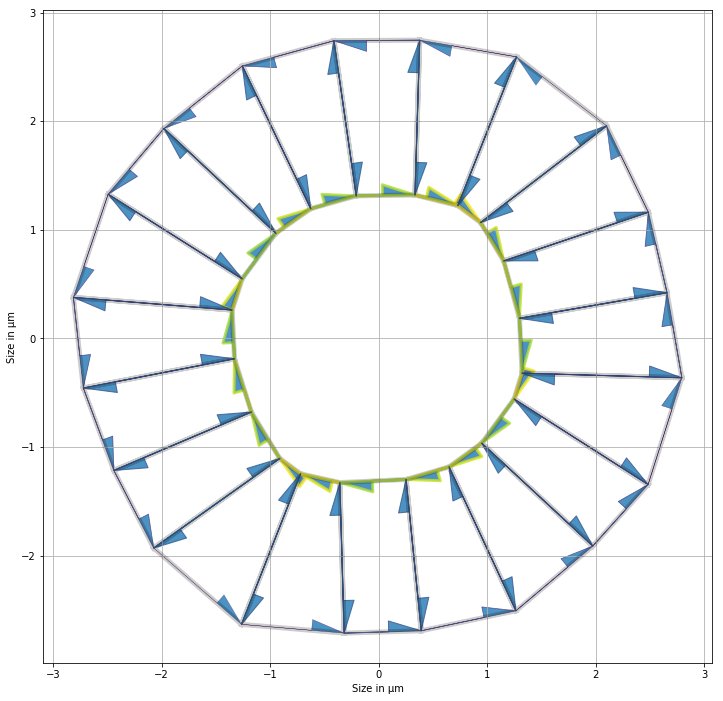

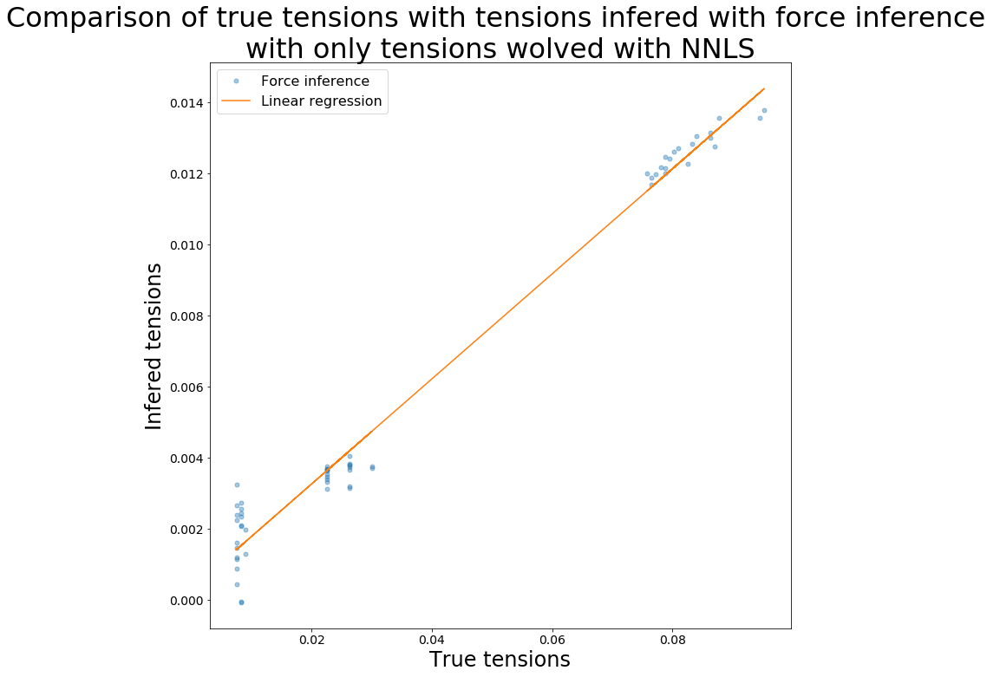

R value : 0.9904684031047349 
Standard error : 0.000570428331483573


In [26]:
(init,
 h_tmp_fi_tensions_table,
 h_tmp_cr_fi_tensions_table,
 h_tmp_fi_areas_table,
 h_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
pol_fi_tensions_table = np.concatenate((h_tmp_fi_tensions_table, pol_fi_tensions_table))
pol_cr_fi_tensions_table = np.concatenate((h_tmp_cr_fi_tensions_table, pol_cr_fi_tensions_table))
pol_fi_areas_table = np.concatenate((h_tmp_fi_areas_table, pol_fi_areas_table))
pol_cr_fi_areas_table = np.concatenate((h_tmp_cr_fi_areas_table, pol_cr_fi_areas_table))
(h_tmp_mindist_tensions_table,
 h_tmp_cr_mindist_tensions_table,
 h_tmp_mindist_areas_table,
 h_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
pol_mindist_tensions_table = np.concatenate((mindist_tensions_table, pol_mindist_tensions_table))
pol_cr_mindist_tensions_table = np.concatenate((h_tmp_cr_mindist_tensions_table, pol_cr_mindist_tensions_table))
pol_mindist_areas_table = np.concatenate((h_tmp_mindist_areas_table, pol_mindist_areas_table))
pol_cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, pol_cr_mindist_areas_table))

## Un autre


Reseting datasets values with new specs


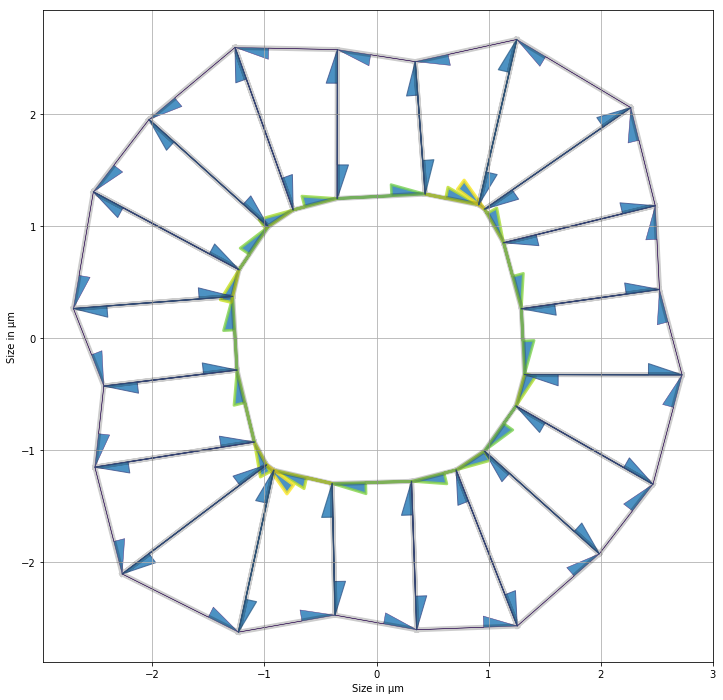

In [27]:
nf, r_in, r_out = (20, 1, 2)
seed = 1
organo = create_organo(nf, r_in, r_out)

organo.edge_df.loc[organo.apical_edges, 'line_tension'] = np.roll(1.25*np.array([
    0.101, 0.115, 0.126, 0.110, 0.105,
    0.102, 0.112, 0.102, 0.108, 0.105,
    0.104, 0.115, 0.127, 0.116, 0.106,
    0.103, 0.117, 0.105, 0.111, 0.107
]), 14)

organo.edge_df.loc[organo.basal_edges, 'line_tension'] = np.roll(1.25*np.array([
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01,
    0.01, 0.011, 0.012, 0.011, 0.01,
    0.01, 0.011, 0.01, 0.011, 0.01
]), 15)

organo.edge_df.loc[organo.lateral_edges, 'line_tension'] = np.roll(1.25*np.array([
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03,
    0.03, 0.035, 0.04, 0.035, 0.03,
    0.03, 0.035, 0.03, 0.035, 0.03
]), 13)

organo.face_df.loc[:, 'prefered_area'] = np.array([
    0.08, 0.07, 0.08, 0.09, 0.09,
    0.10, 0.09, 0.08, 0.09, 0.09,
    0.10, 0.11, 0.10, 0.11, 0.12,
    0.11, 0.10, 0.09, 0.08, 0.09
]) + organo.face_df.area


pol_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                      organo.edge_df.line_tension.values[:3*organo.Nf]))
pol_cr_real_tensions_table = np.concatenate((pol_real_tensions_table,
                                         centrer_et_reduire(organo.edge_df.line_tension.values[:3*organo.Nf])))
pol_real_areas_table = np.concatenate((pol_cr_real_tensions_table,
                                   organo.face_df.prefered_area.values))
pol_cr_real_areas_table = np.concatenate((pol_cr_real_areas_table,
                                      centrer_et_reduire(organo.face_df.prefered_area.values)))
geom.update_all(organo)
Solver.find_energy_min(organo, geom, model)
print_tensions(organo, organo)

/home/felix/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


Apical tensions:  [0.01166739 0.01093202 0.01141028 0.01129003 0.0111634  0.01143452
 0.0119205  0.01181945 0.01166106 0.01137617 0.01188159 0.01098355
 0.01151631 0.01137591 0.01092247 0.0113333  0.01182897 0.01151987
 0.01158204 0.01122396] 
Basal tensions:  [0.00105899 0.00134834 0.00126558 0.00152399 0.00134194 0.00076989
 0.00037794 0.00102237 0.0014423  0.00140768 0.00095774 0.00124985
 0.00122377 0.00153368 0.00141603 0.00074874 0.00043361 0.00123407
 0.00148558 0.00135525] 
Lateral tensions:  [0.00638989 0.0063401  0.00645126 0.00603467 0.00629564 0.00687685
 0.0065921  0.00610189 0.00584599 0.00650648 0.00627345 0.00622722
 0.00632361 0.00588281 0.00624885 0.00681845 0.00663389 0.00609867
 0.00594834 0.00650273] 
Area elasticity:  [0.00795298 0.00752153 0.00774496 0.00789415 0.00850677 0.00771754
 0.00680456 0.00705632 0.00827853 0.00814917 0.0077445  0.00707753
 0.00746186 0.00778944 0.00834509 0.00756588 0.00689364 0.00718788
 0.00836705 0.0080404 ] 
Lumen area elasticity:  

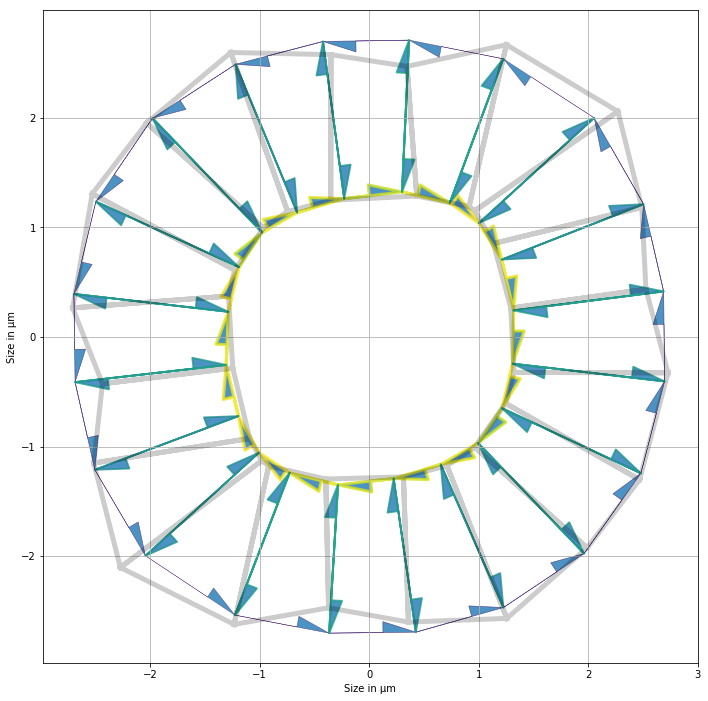

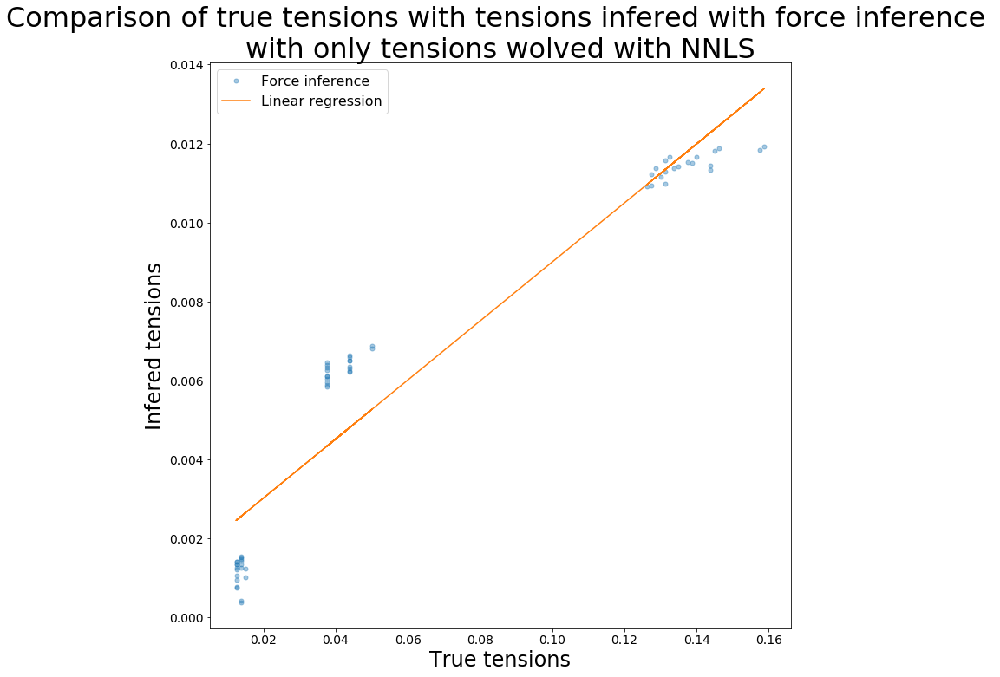

R value : 0.948978705166112 
Standard error : 0.001149387455532766
4.346886954474724 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.     

4.34688692089953 [0.07605464 0.05248344 0.04651052 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239271 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

4.3468869542885145 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239271 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

4.346886838181116 [0.07605464 0.05248343 0.04651052 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827768 0.13286412 0.04450028
 0.03901062 0.08025542 0.11305804 0.1286974  0.16213584 0.10319381
 0.14915391 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089518 0.05116239 0.23371074
 0.11909375 0.07440541 0.06591107 0.10845989 0.13005659 0.22602596
 0.11810457 0.20581167 0.02598221 0.15239271 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.3468869535665755 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0. 

4.34688694783636 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

4.346886945044712 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239271 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886949617891 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886918121793 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089518 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239271 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886952023025 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886958079816 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213585 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810457 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886954474724 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886954474724 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886954474724 [0.07605464 0.05248344 0.04651053 0.05470764 0.08108252 0.11325003
 0.18231307 0.06355571 0.20752499 0.05827769 0.13286413 0.04450028
 0.03901062 0.08025542 0.11305804 0.12869741 0.16213584 0.10319381
 0.14915392 0.03025357 0.07861136 0.05818919 0.05652618 0.09701257
 0.10454956 0.21691189 0.0741907  0.23089519 0.05116239 0.23371075
 0.11909376 0.07440541 0.06591107 0.10845989 0.1300566  0.22602596
 0.11810458 0.20581168 0.02598221 0.15239272 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

4.346886028264734 [0.07605469 0.05248339 0.0465105  0.05470761 0.08108254 0.11325
 0.18231303 0.06355571 0.20752498 0.0582774  0.13286419 0.04450018
 0.03901057 0.0802554  0.11305805 0.12869742 0.1621358  0.10319375
 0.14915391 0.03025344 0.07861135 0.05818922 0.05652617 0.09701259
 0.10454952 0.21691194 0.07419065 0.23089521 0.05116226 0.23371074
 0.11909375 0.07440542 0.06591107 0.10845989 0.13005656 0.22602601
 0.11810452 0.20581172 0.02598214 0.15239274 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.     

4.346915717622124 [0.0760552  0.0524838  0.04651084 0.05470808 0.08108301 0.1132507
 0.18231418 0.06355625 0.20752641 0.05827804 0.1328651  0.04450059
 0.03901082 0.080256   0.11305874 0.12869817 0.16213688 0.1031945
 0.14915485 0.03025376 0.0786119  0.05818962 0.05652657 0.0970133
 0.10455018 0.21691324 0.07419125 0.23089681 0.05116268 0.2337122
 0.11909453 0.07440601 0.06591156 0.10846071 0.13005739 0.22602739
 0.11810543 0.20581308 0.02598226 0.15239366 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.      

4.346906497349691 [0.07605502 0.05248368 0.04651074 0.05470792 0.08108287 0.11325049
 0.1823139  0.06355604 0.20752593 0.058278   0.13286476 0.04450042
 0.03901075 0.08025581 0.11305849 0.12869795 0.16213666 0.10319429
 0.14915454 0.03025371 0.07861168 0.05818947 0.05652647 0.09701304
 0.10454998 0.21691277 0.07419108 0.23089628 0.05116262 0.23371168
 0.11909423 0.07440581 0.06591143 0.10846043 0.13005717 0.2260269
 0.11810519 0.20581262 0.02598232 0.15239336 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.   

4.346892651842466 [0.07605482 0.05248348 0.04651058 0.0547077  0.08108265 0.11325016
 0.18231328 0.06355583 0.2075253  0.05827747 0.13286442 0.04450026
 0.03901062 0.08025554 0.11305822 0.12869758 0.16213602 0.10319392
 0.14915413 0.03025347 0.07861149 0.05818932 0.05652626 0.09701276
 0.10454966 0.21691226 0.07419077 0.23089558 0.0511623  0.23371108
 0.11909395 0.07440556 0.06591117 0.10846008 0.13005673 0.22602634
 0.11810471 0.20581206 0.02598215 0.15239296 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.  

1.2774335590510077 [2.68491028e-02 3.48025534e-02 2.40592744e-02 3.09017043e-02
 2.19764306e-02 3.79890676e-02 6.86704237e-02 8.59971397e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083230e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859726e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417066e-02 1.62141638e-02 1.20620165e-02 1.94103660e-02
 8.29058216e-03 2.86012545e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135003e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335573007853 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017056e-02
 2.19764309e-02 3.79890672e-02 6.86704225e-02 8.59971385e-02
 4.28657305e-02 4.00782004e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417066e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058216e-03 2.86012542e-02 1.40029051e-02 4.20318356e-02
 9.32500874e-03 2.60696834e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119541e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335569818862 [2.68491028e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890675e-02 6.86704235e-02 8.59971396e-02
 4.28657309e-02 4.00782002e-02 3.86287486e-02 3.87083225e-02
 1.77240831e-02 2.31773951e-02 4.00900847e-02 4.68967458e-02
 7.77859725e-02 8.49488893e-02 3.61531716e-02 2.98792110e-02
 2.62417066e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058229e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500925e-03 2.60696832e-02 2.16101957e-02 2.17626371e-02
 1.38662290e-02 1.56972281e-02 1.59403785e-02 3.06461574e-02
 2.15713923e-02 4.75819904e-02 1.07119541e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335686995393 [2.68491029e-02 3.48025535e-02 2.40592752e-02 3.09017056e-02
 2.19764309e-02 3.79890676e-02 6.86704237e-02 8.59971397e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083230e-02
 1.77240833e-02 2.31773954e-02 4.00900860e-02 4.68967475e-02
 7.77859727e-02 8.49488895e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141635e-02 1.20620167e-02 1.94103670e-02
 8.29058238e-03 2.86012547e-02 1.40029049e-02 4.20318364e-02
 9.32500932e-03 2.60696836e-02 2.16101971e-02 2.17626369e-02
 1.38662296e-02 1.56972283e-02 1.59403797e-02 3.06461578e-02
 2.15713926e-02 4.75819906e-02 1.07119540e-02 2.76135003e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335655640505 [2.68491031e-02 3.48025535e-02 2.40592753e-02 3.09017056e-02
 2.19764309e-02 3.79890675e-02 6.86704237e-02 8.59971397e-02
 4.28657308e-02 4.00782004e-02 3.86287502e-02 3.87083230e-02
 1.77240833e-02 2.31773952e-02 4.00900847e-02 4.68967458e-02
 7.77859726e-02 8.49488896e-02 3.61531731e-02 2.98792115e-02
 2.62417063e-02 1.62141636e-02 1.20620167e-02 1.94103670e-02
 8.29058244e-03 2.86012548e-02 1.40029048e-02 4.20318364e-02
 9.32500934e-03 2.60696836e-02 2.16101971e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403786e-02 3.06461575e-02
 2.15713923e-02 4.75819906e-02 1.07119527e-02 2.76135016e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335630204106 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017056e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620168e-02 1.94103673e-02
 8.29058235e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335622129966 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417066e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058233e-03 2.86012546e-02 1.40029048e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335624037132 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058233e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101971e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335624118947 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900847e-02 4.68967456e-02
 7.77859726e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058234e-03 2.86012547e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972281e-02 1.59403782e-02 3.06461577e-02
 2.15713924e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335623240647 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531715e-02 2.98792111e-02
 2.62417066e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058234e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119541e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.27743356195743 [2.68491033e-02 3.48025530e-02 2.40592784e-02 3.09017059e-02
 2.19764314e-02 3.79890676e-02 6.86704235e-02 8.59971396e-02
 4.28657309e-02 4.00782006e-02 3.86287502e-02 3.87083229e-02
 1.77240831e-02 2.31773951e-02 4.00900849e-02 4.68967459e-02
 7.77859725e-02 8.49488893e-02 3.61531716e-02 2.98792112e-02
 2.62417067e-02 1.62141631e-02 1.20620141e-02 1.94103656e-02
 8.29058240e-03 2.86012547e-02 1.40029049e-02 4.20318364e-02
 9.32500926e-03 2.60696834e-02 2.16101970e-02 2.17626369e-02
 1.38662295e-02 1.56972281e-02 1.59403785e-02 3.06461574e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135001e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

1.277433572422305 [2.68491030e-02 3.48025534e-02 2.40592751e-02 3.09017054e-02
 2.19764309e-02 3.79890689e-02 6.86704267e-02 8.59971407e-02
 4.28657312e-02 4.00782007e-02 3.86287502e-02 3.87083230e-02
 1.77240832e-02 2.31773952e-02 4.00900850e-02 4.68967460e-02
 7.77859726e-02 8.49488895e-02 3.61531717e-02 2.98792112e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058271e-03 2.86012556e-02 1.40029072e-02 4.20318350e-02
 9.32500973e-03 2.60696836e-02 2.16101971e-02 2.17626369e-02
 1.38662296e-02 1.56972281e-02 1.59403785e-02 3.06461574e-02
 2.15713923e-02 4.75819906e-02 1.07119541e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

1.2774335651249478 [2.68491030e-02 3.48025534e-02 2.40592751e-02 3.09017055e-02
 2.19764310e-02 3.79890677e-02 6.86704236e-02 8.59971396e-02
 4.28657306e-02 4.00782014e-02 3.86287511e-02 3.87083227e-02
 1.77240832e-02 2.31773952e-02 4.00900850e-02 4.68967460e-02
 7.77859726e-02 8.49488894e-02 3.61531717e-02 2.98792112e-02
 2.62417066e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058230e-03 2.86012546e-02 1.40029049e-02 4.20318363e-02
 9.32500935e-03 2.60696841e-02 2.16101973e-02 2.17626362e-02
 1.38662300e-02 1.56972279e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119541e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335534310342 [2.68491029e-02 3.48025532e-02 2.40592751e-02 3.09017054e-02
 2.19764309e-02 3.79890676e-02 6.86704235e-02 8.59971394e-02
 4.28657308e-02 4.00782006e-02 3.86287502e-02 3.87083227e-02
 1.77240828e-02 2.31773941e-02 4.00900825e-02 4.68967453e-02
 7.77859721e-02 8.49488892e-02 3.61531716e-02 2.98792111e-02
 2.62417066e-02 1.62141636e-02 1.20620165e-02 1.94103671e-02
 8.29058226e-03 2.86012545e-02 1.40029049e-02 4.20318364e-02
 9.32500925e-03 2.60696835e-02 2.16101969e-02 2.17626367e-02
 1.38662297e-02 1.56972269e-02 1.59403766e-02 3.06461584e-02
 2.15713919e-02 4.75819903e-02 1.07119541e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335683758269 [2.68491027e-02 3.48025533e-02 2.40592751e-02 3.09017055e-02
 2.19764310e-02 3.79890677e-02 6.86704237e-02 8.59971398e-02
 4.28657310e-02 4.00782007e-02 3.86287503e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900850e-02 4.68967461e-02
 7.77859728e-02 8.49488891e-02 3.61531716e-02 2.98792119e-02
 2.62417071e-02 1.62141635e-02 1.20620167e-02 1.94103671e-02
 8.29058231e-03 2.86012547e-02 1.40029050e-02 4.20318365e-02
 9.32500929e-03 2.60696835e-02 2.16101971e-02 2.17626370e-02
 1.38662296e-02 1.56972281e-02 1.59403786e-02 3.06461576e-02
 2.15713923e-02 4.75819904e-02 1.07119556e-02 2.76135016e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335622980173 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058234e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335622980173 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058234e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335622980173 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058234e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335622980173 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058234e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335622980173 [2.68491029e-02 3.48025534e-02 2.40592752e-02 3.09017055e-02
 2.19764309e-02 3.79890676e-02 6.86704236e-02 8.59971396e-02
 4.28657308e-02 4.00782005e-02 3.86287502e-02 3.87083229e-02
 1.77240832e-02 2.31773952e-02 4.00900848e-02 4.68967458e-02
 7.77859725e-02 8.49488894e-02 3.61531716e-02 2.98792110e-02
 2.62417067e-02 1.62141636e-02 1.20620166e-02 1.94103671e-02
 8.29058234e-03 2.86012546e-02 1.40029049e-02 4.20318364e-02
 9.32500930e-03 2.60696835e-02 2.16101970e-02 2.17626369e-02
 1.38662296e-02 1.56972280e-02 1.59403785e-02 3.06461575e-02
 2.15713923e-02 4.75819905e-02 1.07119540e-02 2.76135002e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774334455909138 [2.68490985e-02 3.48025477e-02 2.40592732e-02 3.09017010e-02
 2.19764278e-02 3.79890610e-02 6.86704211e-02 8.59971203e-02
 4.28657219e-02 4.00781972e-02 3.86287478e-02 3.87083144e-02
 1.77240808e-02 2.31773905e-02 4.00900800e-02 4.68967380e-02
 7.77859663e-02 8.49488784e-02 3.61531671e-02 2.98792080e-02
 2.62417056e-02 1.62141641e-02 1.20620189e-02 1.94103636e-02
 8.29058281e-03 2.86012553e-02 1.40029051e-02 4.20318346e-02
 9.32500891e-03 2.60696852e-02 2.16101961e-02 2.17626368e-02
 1.38662301e-02 1.56972276e-02 1.59403793e-02 3.06461589e-02
 2.15713938e-02 4.75819884e-02 1.07119539e-02 2.76134993e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774337029484137 [2.68491067e-02 3.48025581e-02 2.40592766e-02 3.09017090e-02
 2.19764327e-02 3.79890725e-02 6.86704297e-02 8.59971512e-02
 4.28657369e-02 4.00782033e-02 3.86287520e-02 3.87083305e-02
 1.77240865e-02 2.31774000e-02 4.00900862e-02 4.68967505e-02
 7.77859812e-02 8.49489010e-02 3.61531712e-02 2.98792140e-02
 2.62417119e-02 1.62141610e-02 1.20620234e-02 1.94103647e-02
 8.29058841e-03 2.86012638e-02 1.40029001e-02 4.20318332e-02
 9.32501641e-03 2.60696881e-02 2.16102011e-02 2.17626378e-02
 1.38662319e-02 1.56972287e-02 1.59403816e-02 3.06461621e-02
 2.15713923e-02 4.75819935e-02 1.07119504e-02 2.76135066e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774335436731685 [2.68490991e-02 3.48025487e-02 2.40592776e-02 3.09017027e-02
 2.19764238e-02 3.79890593e-02 6.86704280e-02 8.59971215e-02
 4.28657199e-02 4.00781968e-02 3.86287502e-02 3.87083155e-02
 1.77240847e-02 2.31773949e-02 4.00900756e-02 4.68967361e-02
 7.77859735e-02 8.49488854e-02 3.61531610e-02 2.98792087e-02
 2.62417136e-02 1.62141606e-02 1.20620277e-02 1.94103630e-02
 8.29059255e-03 2.86012677e-02 1.40029004e-02 4.20318339e-02
 9.32501370e-03 2.60696946e-02 2.16101999e-02 2.17626344e-02
 1.38662370e-02 1.56972281e-02 1.59403861e-02 3.06461682e-02
 2.15713947e-02 4.75819914e-02 1.07119474e-02 2.76135096e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774334856116003 [2.68491002e-02 3.48025502e-02 2.40592748e-02 3.09017030e-02
 2.19764287e-02 3.79890640e-02 6.86704209e-02 8.59971300e-02
 4.28657262e-02 4.00781979e-02 3.86287494e-02 3.87083182e-02
 1.77240820e-02 2.31773908e-02 4.00900826e-02 4.68967396e-02
 7.77859680e-02 8.49488834e-02 3.61531707e-02 2.98792086e-02
 2.62417049e-02 1.62141643e-02 1.20620146e-02 1.94103675e-02
 8.29058107e-03 2.86012525e-02 1.40029057e-02 4.20318354e-02
 9.32500818e-03 2.60696825e-02 2.16101950e-02 2.17626367e-02
 1.38662288e-02 1.56972279e-02 1.59403820e-02 3.06461595e-02
 2.15713922e-02 4.75819880e-02 1.07119555e-02 2.76134980e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.2774334025609912 [2.68490997e-02 3.48025488e-02 2.40592724e-02 3.09017017e-02
 2.19764331e-02 3.79890673e-02 6.86704154e-02 8.59971297e-02
 4.28657311e-02 4.00782017e-02 3.86287511e-02 3.87083139e-02
 1.77240778e-02 2.31773884e-02 4.00900904e-02 4.68967462e-02
 7.77859634e-02 8.49488746e-02 3.61531763e-02 2.98792128e-02
 2.62416951e-02 1.62141697e-02 1.20619993e-02 1.94103748e-02
 8.29056752e-03 2.86012352e-02 1.40029142e-02 4.20318385e-02
 9.32500286e-03 2.60696708e-02 2.16101884e-02 2.17626375e-02
 1.38662223e-02 1.56972286e-02 1.59403691e-02 3.06461449e-02
 2.15713940e-02 4.75819878e-02 1.07119611e-02 2.76134891e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

1.3101679110815094 [1.62491894e-02 1.03383853e-02 5.88135884e-02 8.31931404e-02
 4.67926314e-02 4.23687250e-02 4.14576421e-02 5.09647260e-02
 1.33892639e-02 3.24746361e-02 2.54524161e-02 3.58668485e-02
 4.43673307e-02 1.17944917e-03 5.81428096e-02 1.76700655e-02
 2.44072474e-02 3.28169806e-02 3.38250848e-02 3.79152802e-02
 7.53316139e-03 6.02805018e-03 1.14670179e-01 4.33289312e-02
 4.18027724e-02 6.96398999e-02 5.68356759e-03 2.28292140e-02
 2.73445087e-02 2.41130262e-02 2.68720812e-02 2.91547936e-03
 8.53037568e-03 3.15192528e-02 6.10769379e-02 5.25097689e-02
 1.52566396e-02 9.16064292e-03 7.11332864e-03 2.45520434e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.655674079986961 [1.31616324e-02 2.17339009e-02 1.64478077e-02 1.48216715e-02
 1.09624690e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848444e-02 1.76977617e-02 2.37901407e-02
 1.59981823e-02 1.28770022e-02 2.01099298e-02 2.02267717e-02
 3.51691969e-02 4.01380493e-02 1.85180300e-02 1.12668240e-02
 1.70635876e-02 4.35783741e-03 9.11222981e-03 1.18850656e-02
 8.82563154e-03 1.39842297e-02 2.51048418e-03 2.34058964e-02
 4.87417446e-03 8.56351087e-03 1.60499316e-02 1.39144862e-02
 6.09384715e-03 9.44916425e-03 1.23238248e-02 1.18642452e-02
 5.47959506e-03 2.56829307e-02 8.04164500e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.655674077232043 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016921e-02 3.14518342e-02 4.72272875e-02
 2.58914653e-02 1.24848444e-02 1.76977618e-02 2.37901407e-02
 1.59981823e-02 1.28770022e-02 2.01099299e-02 2.02267717e-02
 3.51691969e-02 4.01380493e-02 1.85180300e-02 1.12668240e-02
 1.70635876e-02 4.35783701e-03 9.11222928e-03 1.18850666e-02
 8.82563112e-03 1.39842301e-02 2.51048317e-03 2.34058954e-02
 4.87417405e-03 8.56351085e-03 1.60499316e-02 1.39144862e-02
 6.09384715e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164500e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.6556740798159708 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624692e-02 1.79016924e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848441e-02 1.76977605e-02 2.37901408e-02
 1.59981823e-02 1.28770021e-02 2.01099298e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180299e-02 1.12668240e-02
 1.70635876e-02 4.35783700e-03 9.11222929e-03 1.18850666e-02
 8.82563115e-03 1.39842298e-02 2.51048422e-03 2.34058964e-02
 4.87417436e-03 8.56351131e-03 1.60499306e-02 1.39144871e-02
 6.09384672e-03 9.44916438e-03 1.23238249e-02 1.18642451e-02
 5.47959506e-03 2.56829307e-02 8.04164499e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740874553285 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518351e-02 4.72272887e-02
 2.58914655e-02 1.24848444e-02 1.76977618e-02 2.37901407e-02
 1.59981824e-02 1.28770024e-02 2.01099310e-02 2.02267731e-02
 3.51691970e-02 4.01380494e-02 1.85180300e-02 1.12668240e-02
 1.70635876e-02 4.35783701e-03 9.11222931e-03 1.18850667e-02
 8.82563117e-03 1.39842299e-02 2.51048422e-03 2.34058964e-02
 4.87417447e-03 8.56351089e-03 1.60499317e-02 1.39144862e-02
 6.09384711e-03 9.44916425e-03 1.23238256e-02 1.18642462e-02
 5.47959516e-03 2.56829308e-02 8.04164504e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740854531047 [1.31616328e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016924e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848444e-02 1.76977617e-02 2.37901407e-02
 1.59981823e-02 1.28770022e-02 2.01099298e-02 2.02267717e-02
 3.51691969e-02 4.01380494e-02 1.85180312e-02 1.12668252e-02
 1.70635873e-02 4.35783703e-03 9.11222927e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048421e-03 2.34058964e-02
 4.87417446e-03 8.56351087e-03 1.60499316e-02 1.39144862e-02
 6.09384715e-03 9.44916426e-03 1.23238248e-02 1.18642452e-02
 5.47959498e-03 2.56829306e-02 8.04164526e-03 1.43151314e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740821884313 [1.31616325e-02 2.17339009e-02 1.64478080e-02 1.48216727e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783705e-03 9.11222929e-03 1.18850669e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740818943022 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048426e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740817845189 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499317e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740810506851 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977617e-02 2.37901406e-02
 1.59981823e-02 1.28770022e-02 2.01099297e-02 2.02267715e-02
 3.51691969e-02 4.01380493e-02 1.85180300e-02 1.12668240e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048421e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384713e-03 9.44916425e-03 1.23238246e-02 1.18642450e-02
 5.47959509e-03 2.56829307e-02 8.04164502e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740815258487 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180299e-02 1.12668240e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959506e-03 2.56829307e-02 8.04164497e-03 1.43151304e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740792184567 [1.31616327e-02 2.17339006e-02 1.64478109e-02 1.48216728e-02
 1.09624696e-02 1.79016924e-02 3.14518349e-02 4.72272885e-02
 2.58914655e-02 1.24848445e-02 1.76977617e-02 2.37901405e-02
 1.59981822e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691967e-02 4.01380492e-02 1.85180300e-02 1.12668242e-02
 1.70635875e-02 4.35783581e-03 9.11222689e-03 1.18850657e-02
 8.82563077e-03 1.39842299e-02 2.51048421e-03 2.34058964e-02
 4.87417440e-03 8.56351090e-03 1.60499316e-02 1.39144862e-02
 6.09384709e-03 9.44916426e-03 1.23238249e-02 1.18642451e-02
 5.47959506e-03 2.56829307e-02 8.04164501e-03 1.43151304e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.655674084676832 [1.31616325e-02 2.17339008e-02 1.64478080e-02 1.48216725e-02
 1.09624691e-02 1.79016932e-02 3.14518375e-02 4.72272893e-02
 2.58914657e-02 1.24848445e-02 1.76977617e-02 2.37901406e-02
 1.59981822e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783704e-03 9.11222929e-03 1.18850667e-02
 8.82563126e-03 1.39842293e-02 2.51048407e-03 2.34058954e-02
 4.87417472e-03 8.56351092e-03 1.60499317e-02 1.39144862e-02
 6.09384712e-03 9.44916427e-03 1.23238249e-02 1.18642451e-02
 5.47959506e-03 2.56829307e-02 8.04164504e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.6556740831648451 [1.31616325e-02 2.17339008e-02 1.64478080e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272885e-02
 2.58914656e-02 1.24848455e-02 1.76977620e-02 2.37901401e-02
 1.59981822e-02 1.28770022e-02 2.01099300e-02 2.02267718e-02
 3.51691969e-02 4.01380494e-02 1.85180301e-02 1.12668242e-02
 1.70635876e-02 4.35783705e-03 9.11222928e-03 1.18850667e-02
 8.82563118e-03 1.39842298e-02 2.51048417e-03 2.34058964e-02
 4.87417470e-03 8.56350973e-03 1.60499316e-02 1.39144865e-02
 6.09384751e-03 9.44916416e-03 1.23238248e-02 1.18642452e-02
 5.47959508e-03 2.56829308e-02 8.04164504e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740797969964 [1.31616325e-02 2.17339007e-02 1.64478080e-02 1.48216725e-02
 1.09624693e-02 1.79016925e-02 3.14518349e-02 4.72272884e-02
 2.58914656e-02 1.24848446e-02 1.76977618e-02 2.37901406e-02
 1.59981820e-02 1.28770011e-02 2.01099282e-02 2.02267709e-02
 3.51691966e-02 4.01380492e-02 1.85180301e-02 1.12668241e-02
 1.70635875e-02 4.35783705e-03 9.11222922e-03 1.18850666e-02
 8.82563116e-03 1.39842298e-02 2.51048418e-03 2.34058964e-02
 4.87417440e-03 8.56351089e-03 1.60499316e-02 1.39144860e-02
 6.09384735e-03 9.44916438e-03 1.23238263e-02 1.18642465e-02
 5.47959492e-03 2.56829306e-02 8.04164499e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740856952641 [1.31616323e-02 2.17339008e-02 1.64478081e-02 1.48216726e-02
 1.09624694e-02 1.79016926e-02 3.14518351e-02 4.72272887e-02
 2.58914657e-02 1.24848446e-02 1.76977619e-02 2.37901407e-02
 1.59981823e-02 1.28770022e-02 2.01099300e-02 2.02267719e-02
 3.51691970e-02 4.01380490e-02 1.85180286e-02 1.12668242e-02
 1.70635880e-02 4.35783704e-03 9.11222934e-03 1.18850667e-02
 8.82563120e-03 1.39842299e-02 2.51048420e-03 2.34058965e-02
 4.87417444e-03 8.56351095e-03 1.60499317e-02 1.39144863e-02
 6.09384715e-03 9.44916431e-03 1.23238249e-02 1.18642451e-02
 5.47959540e-03 2.56829311e-02 8.04164702e-03 1.43151310e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740817709181 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740817709181 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740817709181 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740817709181 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740817709181 [1.31616325e-02 2.17339009e-02 1.64478081e-02 1.48216726e-02
 1.09624693e-02 1.79016925e-02 3.14518350e-02 4.72272886e-02
 2.58914655e-02 1.24848445e-02 1.76977618e-02 2.37901406e-02
 1.59981823e-02 1.28770021e-02 2.01099299e-02 2.02267717e-02
 3.51691968e-02 4.01380493e-02 1.85180300e-02 1.12668241e-02
 1.70635876e-02 4.35783702e-03 9.11222928e-03 1.18850667e-02
 8.82563116e-03 1.39842298e-02 2.51048420e-03 2.34058964e-02
 4.87417445e-03 8.56351088e-03 1.60499316e-02 1.39144862e-02
 6.09384714e-03 9.44916426e-03 1.23238249e-02 1.18642452e-02
 5.47959507e-03 2.56829307e-02 8.04164501e-03 1.43151305e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740713849651 [1.31616323e-02 2.17339014e-02 1.64478057e-02 1.48216725e-02
 1.09624709e-02 1.79016921e-02 3.14518345e-02 4.72272885e-02
 2.58914649e-02 1.24848440e-02 1.76977613e-02 2.37901407e-02
 1.59981823e-02 1.28770021e-02 2.01099294e-02 2.02267712e-02
 3.51691967e-02 4.01380492e-02 1.85180292e-02 1.12668239e-02
 1.70635876e-02 4.35783482e-03 9.11223278e-03 1.18850642e-02
 8.82562862e-03 1.39842299e-02 2.51048449e-03 2.34058958e-02
 4.87417460e-03 8.56351054e-03 1.60499318e-02 1.39144858e-02
 6.09384745e-03 9.44916405e-03 1.23238247e-02 1.18642453e-02
 5.47959530e-03 2.56829302e-02 8.04164489e-03 1.43151298e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740977470049 [1.31616336e-02 2.17339013e-02 1.64478085e-02 1.48216727e-02
 1.09624694e-02 1.79016938e-02 3.14518350e-02 4.72272901e-02
 2.58914670e-02 1.24848453e-02 1.76977620e-02 2.37901410e-02
 1.59981825e-02 1.28770030e-02 2.01099303e-02 2.02267722e-02
 3.51691978e-02 4.01380509e-02 1.85180305e-02 1.12668242e-02
 1.70635877e-02 4.35783796e-03 9.11222918e-03 1.18850673e-02
 8.82563158e-03 1.39842294e-02 2.51048254e-03 2.34058930e-02
 4.87417541e-03 8.56351085e-03 1.60499324e-02 1.39144873e-02
 6.09384693e-03 9.44916403e-03 1.23238256e-02 1.18642459e-02
 5.47959521e-03 2.56829314e-02 8.04164567e-03 1.43151315e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740682170852 [1.31616325e-02 2.17339006e-02 1.64478083e-02 1.48216722e-02
 1.09624689e-02 1.79016916e-02 3.14518346e-02 4.72272874e-02
 2.58914641e-02 1.24848452e-02 1.76977650e-02 2.37901354e-02
 1.59981825e-02 1.28770038e-02 2.01099280e-02 2.02267700e-02
 3.51691964e-02 4.01380489e-02 1.85180289e-02 1.12668233e-02
 1.70635872e-02 4.35783761e-03 9.11222864e-03 1.18850668e-02
 8.82563087e-03 1.39842298e-02 2.51048384e-03 2.34058959e-02
 4.87417462e-03 8.56350897e-03 1.60499296e-02 1.39144881e-02
 6.09384787e-03 9.44916228e-03 1.23238257e-02 1.18642462e-02
 5.47959533e-03 2.56829299e-02 8.04164505e-03 1.43151303e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556740800550136 [1.31616331e-02 2.17339011e-02 1.64478087e-02 1.48216727e-02
 1.09624692e-02 1.79016923e-02 3.14518352e-02 4.72272884e-02
 2.58914644e-02 1.24848440e-02 1.76977618e-02 2.37901405e-02
 1.59981826e-02 1.28770019e-02 2.01099281e-02 2.02267680e-02
 3.51691968e-02 4.01380499e-02 1.85180292e-02 1.12668232e-02
 1.70635875e-02 4.35783717e-03 9.11222949e-03 1.18850668e-02
 8.82563083e-03 1.39842299e-02 2.51048435e-03 2.34058963e-02
 4.87417496e-03 8.56351049e-03 1.60499317e-02 1.39144865e-02
 6.09384744e-03 9.44916422e-03 1.23238262e-02 1.18642495e-02
 5.47959403e-03 2.56829302e-02 8.04164440e-03 1.43151308e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.6556741000888853 [1.31616317e-02 2.17339016e-02 1.64478088e-02 1.48216733e-02
 1.09624693e-02 1.79016926e-02 3.14518360e-02 4.72272896e-02
 2.58914655e-02 1.24848446e-02 1.76977620e-02 2.37901412e-02
 1.59981828e-02 1.28770031e-02 2.01099297e-02 2.02267718e-02
 3.51691986e-02 4.01380500e-02 1.85180287e-02 1.12668245e-02
 1.70635896e-02 4.35783691e-03 9.11223025e-03 1.18850667e-02
 8.82563125e-03 1.39842305e-02 2.51048431e-03 2.34058967e-02
 4.87417516e-03 8.56351063e-03 1.60499323e-02 1.39144867e-02
 6.09384770e-03 9.44916388e-03 1.23238254e-02 1.18642459e-02
 5.47959612e-03 2.56829324e-02 8.04164365e-03 1.43151324e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541888957487 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541875277576 [1.06118094e-02 1.88195786e-02 1.63279101e-02 1.20192539e-02
 8.16245157e-03 1.36148305e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656947e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414970e-02 1.47364887e-02
 2.79477765e-02 3.06349543e-02 1.68831085e-02 8.96366778e-03
 1.49088405e-02 4.97528643e-03 6.01197828e-03 1.10217312e-02
 8.70110986e-03 1.31359546e-02 3.67831133e-03 2.00225416e-02
 3.64078740e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768518e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711398e-02 9.32603109e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541871728924 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245250e-03 1.36148302e-02 2.48226406e-02 4.01739019e-02
 2.53193984e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414970e-02 1.47364886e-02
 2.79477764e-02 3.06349542e-02 1.68831084e-02 8.96366775e-03
 1.49088405e-02 4.97528632e-03 6.01197860e-03 1.10217303e-02
 8.70111081e-03 1.31359549e-02 3.67831149e-03 2.00225421e-02
 3.64078735e-03 1.02892776e-02 1.48245914e-02 1.28785180e-02
 4.14768514e-03 9.18428124e-03 1.19637387e-02 1.09439534e-02
 4.20762651e-03 2.09711398e-02 9.32603106e-03 1.34037200e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541877082985 [1.06118094e-02 1.88195786e-02 1.63279101e-02 1.20192536e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656943e-03 1.44318892e-02 2.14914275e-02
 1.57064022e-02 1.08613104e-02 1.61414970e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366780e-03
 1.49088405e-02 4.97528633e-03 6.01197865e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831141e-03 2.00225416e-02
 3.64078738e-03 1.02892776e-02 1.48245916e-02 1.28785174e-02
 4.14768568e-03 9.18428145e-03 1.19637388e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541859989417 [1.06118094e-02 1.88195786e-02 1.63279101e-02 1.20192536e-02
 8.16245253e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656947e-03 1.44318893e-02 2.14914281e-02
 1.57064027e-02 1.08613106e-02 1.61414971e-02 1.47364874e-02
 2.79477763e-02 3.06349541e-02 1.68831084e-02 8.96366779e-03
 1.49088405e-02 4.97528632e-03 6.01197866e-03 1.10217303e-02
 8.70111084e-03 1.31359548e-02 3.67831141e-03 2.00225416e-02
 3.64078741e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428124e-03 1.19637387e-02 1.09439525e-02
 4.20762608e-03 2.09711401e-02 9.32603120e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.564854189539477 [1.06118103e-02 1.88195788e-02 1.63279101e-02 1.20192536e-02
 8.16245252e-03 1.36148303e-02 2.48226408e-02 4.01739020e-02
 2.53193985e-02 8.94656949e-03 1.44318893e-02 2.14914281e-02
 1.57064027e-02 1.08613106e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366704e-03
 1.49088414e-02 4.97528627e-03 6.01197860e-03 1.10217304e-02
 8.70111086e-03 1.31359548e-02 3.67831141e-03 2.00225416e-02
 3.64078741e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768519e-03 9.18428128e-03 1.19637387e-02 1.09439535e-02
 4.20762651e-03 2.09711398e-02 9.32603116e-03 1.34037192e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.5648541888892268 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192534e-02
 8.16245271e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217302e-02
 8.70111097e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768518e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541888889173 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193986e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078741e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541890928882 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914282e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785182e-02
 4.14768512e-03 9.18428129e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.564854189086774 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364888e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439536e-02
 4.20762657e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.5648541886991915 [1.06118093e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366793e-03
 1.49088403e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762653e-03 2.09711398e-02 9.32603110e-03 1.34037202e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541921443314 [1.06118095e-02 1.88195785e-02 1.63279097e-02 1.20192556e-02
 8.16245330e-03 1.36148301e-02 2.48226408e-02 4.01739019e-02
 2.53193986e-02 8.94656956e-03 1.44318894e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831086e-02 8.96366789e-03
 1.49088405e-02 4.97528607e-03 6.01197958e-03 1.10217309e-02
 8.70110988e-03 1.31359550e-02 3.67831146e-03 2.00225416e-02
 3.64078738e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768516e-03 9.18428129e-03 1.19637388e-02 1.09439535e-02
 4.20762653e-03 2.09711399e-02 9.32603112e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541902983614 [1.06118094e-02 1.88195785e-02 1.63279100e-02 1.20192535e-02
 8.16245249e-03 1.36148304e-02 2.48226409e-02 4.01739035e-02
 2.53193987e-02 8.94656944e-03 1.44318892e-02 2.14914280e-02
 1.57064026e-02 1.08613105e-02 1.61414970e-02 1.47364887e-02
 2.79477764e-02 3.06349542e-02 1.68831084e-02 8.96366778e-03
 1.49088405e-02 4.97528631e-03 6.01197863e-03 1.10217303e-02
 8.70111082e-03 1.31359546e-02 3.67831119e-03 2.00225426e-02
 3.64078779e-03 1.02892775e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428124e-03 1.19637387e-02 1.09439534e-02
 4.20762651e-03 2.09711398e-02 9.32603107e-03 1.34037200e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541904938056 [1.06118094e-02 1.88195785e-02 1.63279100e-02 1.20192535e-02
 8.16245255e-03 1.36148303e-02 2.48226407e-02 4.01739018e-02
 2.53193985e-02 8.94656977e-03 1.44318899e-02 2.14914300e-02
 1.57064024e-02 1.08613106e-02 1.61414972e-02 1.47364887e-02
 2.79477764e-02 3.06349543e-02 1.68831085e-02 8.96366783e-03
 1.49088405e-02 4.97528633e-03 6.01197860e-03 1.10217303e-02
 8.70111084e-03 1.31359548e-02 3.67831138e-03 2.00225415e-02
 3.64078744e-03 1.02892773e-02 1.48245910e-02 1.28785183e-02
 4.14768610e-03 9.18428099e-03 1.19637386e-02 1.09439535e-02
 4.20762651e-03 2.09711398e-02 9.32603109e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541865767293 [1.06118093e-02 1.88195785e-02 1.63279099e-02 1.20192534e-02
 8.16245260e-03 1.36148303e-02 2.48226406e-02 4.01739018e-02
 2.53193986e-02 8.94656958e-03 1.44318893e-02 2.14914280e-02
 1.57064024e-02 1.08613101e-02 1.61414970e-02 1.47364888e-02
 2.79477759e-02 3.06349544e-02 1.68831087e-02 8.96366787e-03
 1.49088405e-02 4.97528634e-03 6.01197857e-03 1.10217303e-02
 8.70111086e-03 1.31359548e-02 3.67831135e-03 2.00225416e-02
 3.64078731e-03 1.02892776e-02 1.48245914e-02 1.28785180e-02
 4.14768519e-03 9.18428138e-03 1.19637387e-02 1.09439536e-02
 4.20762682e-03 2.09711394e-02 9.32603096e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541872772939 [1.06118083e-02 1.88195783e-02 1.63279099e-02 1.20192535e-02
 8.16245261e-03 1.36148303e-02 2.48226407e-02 4.01739018e-02
 2.53193986e-02 8.94656958e-03 1.44318893e-02 2.14914280e-02
 1.57064025e-02 1.08613105e-02 1.61414972e-02 1.47364888e-02
 2.79477764e-02 3.06349540e-02 1.68831084e-02 8.96366613e-03
 1.49088416e-02 4.97528645e-03 6.01197866e-03 1.10217303e-02
 8.70111085e-03 1.31359548e-02 3.67831136e-03 2.00225416e-02
 3.64078733e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768513e-03 9.18428127e-03 1.19637388e-02 1.09439534e-02
 4.20762666e-03 2.09711400e-02 9.32603086e-03 1.34037217e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541888957487 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541888957487 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541888957487 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541888957487 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541888957487 [1.06118094e-02 1.88195786e-02 1.63279100e-02 1.20192535e-02
 8.16245254e-03 1.36148303e-02 2.48226408e-02 4.01739019e-02
 2.53193985e-02 8.94656950e-03 1.44318893e-02 2.14914281e-02
 1.57064026e-02 1.08613105e-02 1.61414971e-02 1.47364887e-02
 2.79477765e-02 3.06349544e-02 1.68831085e-02 8.96366781e-03
 1.49088405e-02 4.97528633e-03 6.01197864e-03 1.10217304e-02
 8.70111085e-03 1.31359548e-02 3.67831140e-03 2.00225416e-02
 3.64078739e-03 1.02892776e-02 1.48245915e-02 1.28785181e-02
 4.14768517e-03 9.18428127e-03 1.19637387e-02 1.09439535e-02
 4.20762654e-03 2.09711399e-02 9.32603110e-03 1.34037201e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541809417601 [1.06118092e-02 1.88195793e-02 1.63279103e-02 1.20192497e-02
 8.16245557e-03 1.36148279e-02 2.48226404e-02 4.01739027e-02
 2.53193978e-02 8.94656922e-03 1.44318882e-02 2.14914284e-02
 1.57064034e-02 1.08613105e-02 1.61414958e-02 1.47364881e-02
 2.79477768e-02 3.06349539e-02 1.68831077e-02 8.96366725e-03
 1.49088407e-02 4.97528571e-03 6.01198117e-03 1.10217307e-02
 8.70110636e-03 1.31359566e-02 3.67831276e-03 2.00225410e-02
 3.64078806e-03 1.02892761e-02 1.48245921e-02 1.28785183e-02
 4.14768493e-03 9.18428143e-03 1.19637384e-02 1.09439539e-02
 4.20762597e-03 2.09711401e-02 9.32603051e-03 1.34037192e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.564854203340661 [1.06118095e-02 1.88195796e-02 1.63279107e-02 1.20192540e-02
 8.16245231e-03 1.36148315e-02 2.48226426e-02 4.01738993e-02
 2.53194032e-02 8.94656877e-03 1.44318889e-02 2.14914290e-02
 1.57064034e-02 1.08613103e-02 1.61414976e-02 1.47364889e-02
 2.79477777e-02 3.06349551e-02 1.68831088e-02 8.96366774e-03
 1.49088411e-02 4.97528557e-03 6.01197940e-03 1.10217306e-02
 8.70111073e-03 1.31359540e-02 3.67831096e-03 2.00225401e-02
 3.64079161e-03 1.02892770e-02 1.48245926e-02 1.28785178e-02
 4.14768641e-03 9.18428185e-03 1.19637380e-02 1.09439539e-02
 4.20762707e-03 2.09711401e-02 9.32603071e-03 1.34037199e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.5648541832271902 [1.06118088e-02 1.88195793e-02 1.63279104e-02 1.20192541e-02
 8.16245186e-03 1.36148305e-02 2.48226406e-02 4.01739022e-02
 2.53193985e-02 8.94656982e-03 1.44318905e-02 2.14914288e-02
 1.57064012e-02 1.08613100e-02 1.61414983e-02 1.47364883e-02
 2.79477768e-02 3.06349539e-02 1.68831083e-02 8.96366750e-03
 1.49088409e-02 4.97528592e-03 6.01197900e-03 1.10217299e-02
 8.70111073e-03 1.31359543e-02 3.67831223e-03 2.00225417e-02
 3.64078833e-03 1.02892758e-02 1.48245901e-02 1.28785132e-02
 4.14769162e-03 9.18428034e-03 1.19637356e-02 1.09439537e-02
 4.20762642e-03 2.09711399e-02 9.32603016e-03 1.34037192e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541602845657 [1.06118068e-02 1.88195793e-02 1.63279110e-02 1.20192534e-02
 8.16245078e-03 1.36148288e-02 2.48226404e-02 4.01739007e-02
 2.53193957e-02 8.94656914e-03 1.44318868e-02 2.14914277e-02
 1.57064031e-02 1.08613087e-02 1.61414943e-02 1.47364912e-02
 2.79477720e-02 3.06349541e-02 1.68831073e-02 8.96366699e-03
 1.49088418e-02 4.97528675e-03 6.01197682e-03 1.10217310e-02
 8.70111079e-03 1.31359550e-02 3.67831154e-03 2.00225412e-02
 3.64078821e-03 1.02892751e-02 1.48245922e-02 1.28785181e-02
 4.14768448e-03 9.18428217e-03 1.19637380e-02 1.09439510e-02
 4.20762742e-03 2.09711379e-02 9.32602923e-03 1.34037183e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.5648541995564113 [1.06118045e-02 1.88195791e-02 1.63279111e-02 1.20192545e-02
 8.16245215e-03 1.36148306e-02 2.48226413e-02 4.01739037e-02
 2.53193985e-02 8.94656919e-03 1.44318890e-02 2.14914290e-02
 1.57064037e-02 1.08613106e-02 1.61414967e-02 1.47364892e-02
 2.79477775e-02 3.06349543e-02 1.68831080e-02 8.96367274e-03
 1.49088451e-02 4.97528739e-03 6.01197951e-03 1.10217301e-02
 8.70111060e-03 1.31359550e-02 3.67831206e-03 2.00225417e-02
 3.64078840e-03 1.02892767e-02 1.48245922e-02 1.28785184e-02
 4.14768552e-03 9.18428159e-03 1.19637382e-02 1.09439535e-02
 4.20762708e-03 2.09711412e-02 9.32603025e-03 1.34037149e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.48412350525423553 [9.45949191e-03 1.44747863e-02 1.65445370e-02 8.53728965e-03
 4.65376602e-03 8.88384712e-03 1.80731173e-02 2.91971872e-02
 2.33381707e-02 7.87476603e-03 1.05385322e-02 1.87228636e-02
 1.54735434e-02 8.32024932e-03 1.14469536e-02 8.47518435e-03
 2.13286227e-02 1.82951206e-02 1.63202896e-02 7.79762053e-03
 1.29132937e-02 7.61736022e-03 5.23707664e-03 9.83375071e-03
 8.76141944e-03 1.28458951e-02 6.17607261e-03 1.54356768e-02
 2.72399987e-03 1.30928243e-02 1.36868137e-02 1.19182201e-02
 4.28167339e-03 9.07602139e-03 1.26533832e-02 1.18572202e-02
 6.20763929e-03 1.66116540e-02 1.18932163e-02 1.35438334e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.48412350116326236 [9.45949193e-03 1.44747869e-02 1.65445376e-02 8.53728979e-03
 4.65376615e-03 8.88384550e-03 1.80731166e-02 2.91971867e-02
 2.33381704e-02 7.87476596e-03 1.05385321e-02 1.87228635e-02
 1.54735433e-02 8.32024923e-03 1.14469535e-02 8.47518428e-03
 2.13286225e-02 1.82951204e-02 1.63202894e-02 7.79762054e-03
 1.29132934e-02 7.61736097e-03 5.23707678e-03 9.83375037e-03
 8.76141940e-03 1.28458939e-02 6.17607335e-03 1.54356770e-02
 2.72399997e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167330e-03 9.07602133e-03 1.26533831e-02 1.18572201e-02
 6.20763921e-03 1.66116539e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.48412349763773255 [9.45949179e-03 1.44747868e-02 1.65445374e-02 8.53728963e-03
 4.65376592e-03 8.88384695e-03 1.80731169e-02 2.91971867e-02
 2.33381701e-02 7.87476453e-03 1.05385332e-02 1.87228634e-02
 1.54735432e-02 8.32024911e-03 1.14469533e-02 8.47518419e-03
 2.13286223e-02 1.82951202e-02 1.63202892e-02 7.79762047e-03
 1.29132933e-02 7.61736086e-03 5.23707668e-03 9.83375032e-03
 8.76141924e-03 1.28458949e-02 6.17607240e-03 1.54356765e-02
 2.72399977e-03 1.30928235e-02 1.36868143e-02 1.19182197e-02
 4.28167308e-03 9.07602129e-03 1.26533830e-02 1.18572200e-02
 6.20763910e-03 1.66116537e-02 1.18932161e-02 1.35438330e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.4841234998628873 [9.45949184e-03 1.44747868e-02 1.65445375e-02 8.53728965e-03
 4.65376596e-03 8.88384697e-03 1.80731170e-02 2.91971867e-02
 2.33381702e-02 7.87476586e-03 1.05385320e-02 1.87228633e-02
 1.54735432e-02 8.32024982e-03 1.14469530e-02 8.47518451e-03
 2.13286224e-02 1.82951202e-02 1.63202893e-02 7.79762049e-03
 1.29132934e-02 7.61736089e-03 5.23707673e-03 9.83375036e-03
 8.76141924e-03 1.28458949e-02 6.17607245e-03 1.54356766e-02
 2.72399988e-03 1.30928241e-02 1.36868134e-02 1.19182200e-02
 4.28167301e-03 9.07602222e-03 1.26533822e-02 1.18572199e-02
 6.20763905e-03 1.66116537e-02 1.18932161e-02 1.35438331e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.48412350827065803 [9.45949213e-03 1.44747871e-02 1.65445377e-02 8.53728977e-03
 4.65376611e-03 8.88384709e-03 1.80731172e-02 2.91971872e-02
 2.33381707e-02 7.87476603e-03 1.05385322e-02 1.87228636e-02
 1.54735434e-02 8.32024933e-03 1.14469536e-02 8.47518432e-03
 2.13286226e-02 1.82951210e-02 1.63202898e-02 7.79762081e-03
 1.29132935e-02 7.61736102e-03 5.23707692e-03 9.83375051e-03
 8.76141933e-03 1.28458951e-02 6.17607262e-03 1.54356768e-02
 2.72399986e-03 1.30928243e-02 1.36868137e-02 1.19182201e-02
 4.28167339e-03 9.07602138e-03 1.26533832e-02 1.18572203e-02
 6.20763892e-03 1.66116551e-02 1.18932153e-02 1.35438335e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.48412350236938845 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376600e-03 8.88384700e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476592e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024919e-03 1.14469535e-02 8.47518424e-03
 2.13286225e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736136e-03 5.23707703e-03 9.83375043e-03
 8.76141930e-03 1.28458950e-02 6.17607249e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167326e-03 9.07602132e-03 1.26533831e-02 1.18572201e-02
 6.20763917e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.48412350132747156 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376602e-03 8.88384703e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476591e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024918e-03 1.14469535e-02 8.47518423e-03
 2.13286224e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736093e-03 5.23707676e-03 9.83375039e-03
 8.76141928e-03 1.28458950e-02 6.17607241e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167325e-03 9.07602131e-03 1.26533831e-02 1.18572201e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.48412350058606013 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728966e-03
 4.65376601e-03 8.88384699e-03 1.80731170e-02 2.91971868e-02
 2.33381703e-02 7.87476615e-03 1.05385319e-02 1.87228634e-02
 1.54735432e-02 8.32024918e-03 1.14469534e-02 8.47518423e-03
 2.13286224e-02 1.82951203e-02 1.63202893e-02 7.79762052e-03
 1.29132934e-02 7.61736092e-03 5.23707676e-03 9.83375039e-03
 8.76141928e-03 1.28458950e-02 6.17607247e-03 1.54356766e-02
 2.72399984e-03 1.30928241e-02 1.36868131e-02 1.19182199e-02
 4.28167325e-03 9.07602131e-03 1.26533830e-02 1.18572200e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.4841235013693142 [9.45949188e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376602e-03 8.88384699e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476592e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024899e-03 1.14469537e-02 8.47518429e-03
 2.13286225e-02 1.82951203e-02 1.63202894e-02 7.79762054e-03
 1.29132934e-02 7.61736093e-03 5.23707677e-03 9.83375040e-03
 8.76141928e-03 1.28458950e-02 6.17607249e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167327e-03 9.07602101e-03 1.26533831e-02 1.18572200e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4841235020130647 [9.45949189e-03 1.44747869e-02 1.65445375e-02 8.53728968e-03
 4.65376603e-03 8.88384700e-03 1.80731170e-02 2.91971869e-02
 2.33381704e-02 7.87476593e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024920e-03 1.14469535e-02 8.47518425e-03
 2.13286225e-02 1.82951203e-02 1.63202894e-02 7.79762055e-03
 1.29132934e-02 7.61736094e-03 5.23707678e-03 9.83375041e-03
 8.76141929e-03 1.28458950e-02 6.17607250e-03 1.54356766e-02
 2.72399987e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167327e-03 9.07602132e-03 1.26533831e-02 1.18572201e-02
 6.20763919e-03 1.66116537e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4841234984238117 [9.45949210e-03 1.44747894e-02 1.65445371e-02 8.53728965e-03
 4.65376610e-03 8.88384685e-03 1.80731168e-02 2.91971866e-02
 2.33381702e-02 7.87476584e-03 1.05385320e-02 1.87228632e-02
 1.54735430e-02 8.32024907e-03 1.14469534e-02 8.47518413e-03
 2.13286222e-02 1.82951201e-02 1.63202893e-02 7.79762075e-03
 1.29132927e-02 7.61735983e-03 5.23707708e-03 9.83375008e-03
 8.76141914e-03 1.28458949e-02 6.17607237e-03 1.54356765e-02
 2.72399987e-03 1.30928241e-02 1.36868133e-02 1.19182199e-02
 4.28167315e-03 9.07602125e-03 1.26533830e-02 1.18572200e-02
 6.20763906e-03 1.66116537e-02 1.18932161e-02 1.35438328e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4841235009161927 [9.45949170e-03 1.44747867e-02 1.65445372e-02 8.53728917e-03
 4.65376553e-03 8.88384898e-03 1.80731166e-02 2.91971867e-02
 2.33381704e-02 7.87476582e-03 1.05385321e-02 1.87228631e-02
 1.54735430e-02 8.32024904e-03 1.14469535e-02 8.47518409e-03
 2.13286222e-02 1.82951201e-02 1.63202894e-02 7.79762053e-03
 1.29132933e-02 7.61736081e-03 5.23707678e-03 9.83375058e-03
 8.76141883e-03 1.28458965e-02 6.17607393e-03 1.54356761e-02
 2.72399974e-03 1.30928242e-02 1.36868133e-02 1.19182199e-02
 4.28167311e-03 9.07602126e-03 1.26533830e-02 1.18572200e-02
 6.20763902e-03 1.66116536e-02 1.18932161e-02 1.35438331e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4841234980548807 [9.45949165e-03 1.44747866e-02 1.65445372e-02 8.53728949e-03
 4.65376602e-03 8.88384682e-03 1.80731167e-02 2.91971862e-02
 2.33381706e-02 7.87476541e-03 1.05385310e-02 1.87228627e-02
 1.54735429e-02 8.32024903e-03 1.14469535e-02 8.47518405e-03
 2.13286221e-02 1.82951200e-02 1.63202893e-02 7.79762049e-03
 1.29132933e-02 7.61736079e-03 5.23707658e-03 9.83375027e-03
 8.76141927e-03 1.28458948e-02 6.17607235e-03 1.54356766e-02
 2.72400049e-03 1.30928269e-02 1.36868142e-02 1.19182201e-02
 4.28167325e-03 9.07602119e-03 1.26533830e-02 1.18572200e-02
 6.20763898e-03 1.66116536e-02 1.18932161e-02 1.35438331e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4841235023137652 [9.45949183e-03 1.44747868e-02 1.65445374e-02 8.53728963e-03
 4.65376604e-03 8.88384695e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476593e-03 1.05385322e-02 1.87228633e-02
 1.54735430e-02 8.32025082e-03 1.14469542e-02 8.47518395e-03
 2.13286224e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736091e-03 5.23707673e-03 9.83375038e-03
 8.76141929e-03 1.28458950e-02 6.17607245e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868134e-02 1.19182198e-02
 4.28167371e-03 9.07602155e-03 1.26533821e-02 1.18572201e-02
 6.20763920e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4841235027578154 [9.45949178e-03 1.44747868e-02 1.65445375e-02 8.53728965e-03
 4.65376603e-03 8.88384698e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476591e-03 1.05385321e-02 1.87228633e-02
 1.54735432e-02 8.32024915e-03 1.14469535e-02 8.47518426e-03
 2.13286227e-02 1.82951218e-02 1.63202897e-02 7.79762041e-03
 1.29132935e-02 7.61736094e-03 5.23707674e-03 9.83375040e-03
 8.76141930e-03 1.28458950e-02 6.17607246e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167323e-03 9.07602133e-03 1.26533831e-02 1.18572199e-02
 6.20763982e-03 1.66116537e-02 1.18932154e-02 1.35438331e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.484123501413634 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376601e-03 8.88384699e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476591e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024918e-03 1.14469535e-02 8.47518423e-03
 2.13286224e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736093e-03 5.23707676e-03 9.83375040e-03
 8.76141928e-03 1.28458950e-02 6.17607248e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167326e-03 9.07602131e-03 1.26533831e-02 1.18572201e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.484123501413634 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376601e-03 8.88384699e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476591e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024918e-03 1.14469535e-02 8.47518423e-03
 2.13286224e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736093e-03 5.23707676e-03 9.83375040e-03
 8.76141928e-03 1.28458950e-02 6.17607248e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167326e-03 9.07602131e-03 1.26533831e-02 1.18572201e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.484123501413634 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376601e-03 8.88384699e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476591e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024918e-03 1.14469535e-02 8.47518423e-03
 2.13286224e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736093e-03 5.23707676e-03 9.83375040e-03
 8.76141928e-03 1.28458950e-02 6.17607248e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167326e-03 9.07602131e-03 1.26533831e-02 1.18572201e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.484123501413634 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376601e-03 8.88384699e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476591e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024918e-03 1.14469535e-02 8.47518423e-03
 2.13286224e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736093e-03 5.23707676e-03 9.83375040e-03
 8.76141928e-03 1.28458950e-02 6.17607248e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167326e-03 9.07602131e-03 1.26533831e-02 1.18572201e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.484123501413634 [9.45949187e-03 1.44747869e-02 1.65445375e-02 8.53728967e-03
 4.65376601e-03 8.88384699e-03 1.80731170e-02 2.91971868e-02
 2.33381704e-02 7.87476591e-03 1.05385321e-02 1.87228634e-02
 1.54735432e-02 8.32024918e-03 1.14469535e-02 8.47518423e-03
 2.13286224e-02 1.82951203e-02 1.63202894e-02 7.79762053e-03
 1.29132934e-02 7.61736093e-03 5.23707676e-03 9.83375040e-03
 8.76141928e-03 1.28458950e-02 6.17607248e-03 1.54356766e-02
 2.72399988e-03 1.30928242e-02 1.36868135e-02 1.19182200e-02
 4.28167326e-03 9.07602131e-03 1.26533831e-02 1.18572201e-02
 6.20763916e-03 1.66116538e-02 1.18932162e-02 1.35438332e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.48412298450657604 [9.45948061e-03 1.44747733e-02 1.65445215e-02 8.53728388e-03
 4.65375704e-03 8.88383939e-03 1.80730986e-02 2.91971584e-02
 2.33381442e-02 7.87475503e-03 1.05385218e-02 1.87228431e-02
 1.54735303e-02 8.32023846e-03 1.14469374e-02 8.47517593e-03
 2.13286027e-02 1.82950997e-02 1.63202691e-02 7.79761431e-03
 1.29132813e-02 7.61735115e-03 5.23706851e-03 9.83373811e-03
 8.76141272e-03 1.28458828e-02 6.17606253e-03 1.54356619e-02
 2.72400058e-03 1.30928100e-02 1.36867966e-02 1.19182104e-02
 4.28166328e-03 9.07601505e-03 1.26533693e-02 1.18572098e-02
 6.20762970e-03 1.66116350e-02 1.18932028e-02 1.35438163e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.4841238207735786 [9.45949928e-03 1.44747954e-02 1.65445468e-02 8.53729439e-03
 4.65376975e-03 8.88385306e-03 1.80731267e-02 2.91972065e-02
 2.33381865e-02 7.87477223e-03 1.05385379e-02 1.87228769e-02
 1.54735523e-02 8.32025592e-03 1.14469623e-02 8.47519002e-03
 2.13286361e-02 1.82951328e-02 1.63203011e-02 7.79762543e-03
 1.29133008e-02 7.61736679e-03 5.23708536e-03 9.83375697e-03
 8.76142185e-03 1.28458977e-02 6.17608538e-03 1.54356839e-02
 2.72399843e-03 1.30928315e-02 1.36868243e-02 1.19182258e-02
 4.28168053e-03 9.07602565e-03 1.26533901e-02 1.18572261e-02
 6.20764604e-03 1.66116664e-02 1.18932230e-02 1.35438412e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4841242538772157 [9.45951014e-03 1.44748057e-02 1.65445592e-02 8.53730076e-03
 4.65377825e-03 8.88385848e-03 1.80731454e-02 2.91972281e-02
 2.33382070e-02 7.87478555e-03 1.05385425e-02 1.87228928e-02
 1.54735641e-02 8.32026368e-03 1.14469756e-02 8.47519785e-03
 2.13286532e-02 1.82951495e-02 1.63203170e-02 7.79763112e-03
 1.29133097e-02 7.61737590e-03 5.23709538e-03 9.83376552e-03
 8.76142497e-03 1.28459115e-02 6.17608991e-03 1.54356989e-02
 2.72399971e-03 1.30928377e-02 1.36868412e-02 1.19182357e-02
 4.28169067e-03 9.07603216e-03 1.26533994e-02 1.18572332e-02
 6.20765489e-03 1.66116838e-02 1.18932329e-02 1.35438533e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.48412369915574316 [9.45949603e-03 1.44747924e-02 1.65445436e-02 8.53729329e-03
 4.65376859e-03 8.88385052e-03 1.80731240e-02 2.91971992e-02
 2.33381809e-02 7.87477074e-03 1.05385351e-02 1.87228731e-02
 1.54735489e-02 8.32024695e-03 1.14469645e-02 8.47518615e-03
 2.13286313e-02 1.82951276e-02 1.63202969e-02 7.79762407e-03
 1.29132984e-02 7.61736451e-03 5.23708149e-03 9.83375392e-03
 8.76142134e-03 1.28458993e-02 6.17607700e-03 1.54356824e-02
 2.72399925e-03 1.30928280e-02 1.36868206e-02 1.19182212e-02
 4.28167976e-03 9.07602736e-03 1.26533816e-02 1.18572245e-02
 6.20764431e-03 1.66116617e-02 1.18932193e-02 1.35438378e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.48412141749345966 [9.45944077e-03 1.44747381e-02 1.65444814e-02 8.53725888e-03
 4.65373005e-03 8.88381725e-03 1.80730414e-02 2.91970707e-02
 2.33380661e-02 7.87472412e-03 1.05384883e-02 1.87227811e-02
 1.54734889e-02 8.32020559e-03 1.14468907e-02 8.47515009e-03
 2.13285406e-02 1.82950336e-02 1.63202128e-02 7.79758950e-03
 1.29132514e-02 7.61732092e-03 5.23702649e-03 9.83371125e-03
 8.76139847e-03 1.28458463e-02 6.17602880e-03 1.54356169e-02
 2.72400291e-03 1.30927679e-02 1.36867472e-02 1.19181793e-02
 4.28163180e-03 9.07599525e-03 1.26533303e-02 1.18571779e-02
 6.20760139e-03 1.66115783e-02 1.18931611e-02 1.35437719e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.49080872518302116 [1.01143696e-02 1.30975183e-02 1.30358194e-02 1.01699081e-02
 6.39521278e-03 8.57853806e-03 1.68716245e-02 3.00254318e-02
 2.57842585e-02 8.75328659e-03 1.13978726e-02 2.00517050e-02
 1.24077887e-02 9.52271004e-03 1.32074959e-02 8.11141113e-03
 1.97340360e-02 1.83801358e-02 1.75737608e-02 8.51418362e-03
 1.24246403e-02 9.39112620e-03 8.56170054e-03 9.23306048e-03
 7.34091596e-03 1.19351783e-02 8.31134489e-03 1.53561929e-02
 4.34570626e-03 1.36981218e-02 1.33160691e-02 9.95666251e-03
 7.50033753e-03 7.81009522e-03 1.12234850e-02 1.09206657e-02
 6.87836090e-03 1.74581904e-02 1.01142322e-02 1.33050891e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.46335054443844986 [8.73729479e-03 1.39696229e-02 1.54666708e-02 8.27366196e-03
 4.33157993e-03 8.61204799e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616312e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574813e-03
 1.16378961e-02 6.67097025e-03 4.48428882e-03 8.98462307e-03
 7.93019306e-03 1.15116181e-02 5.77773851e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659413e-03 1.12642646e-02 1.05723215e-02
 3.02891575e-03 1.49327777e-02 9.85425404e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.4633505440596564 [8.73729483e-03 1.39696229e-02 1.54666712e-02 8.27366300e-03
 4.33158026e-03 8.61204780e-03 1.73500513e-02 3.13009637e-02
 2.49952925e-02 7.89061331e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885148e-03 1.05226187e-02 8.84873502e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574818e-03
 1.16378961e-02 6.67097013e-03 4.48428803e-03 8.98462401e-03
 7.93019273e-03 1.15116185e-02 5.77773828e-03 1.63935211e-02
 4.56752229e-03 1.31983861e-02 1.19825320e-02 1.05870773e-02
 3.82581065e-03 8.18659416e-03 1.12642646e-02 1.05723215e-02
 3.02891576e-03 1.49327778e-02 9.85425407e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505441452558 [8.73729482e-03 1.39696229e-02 1.54666712e-02 8.27366296e-03
 4.33158019e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061298e-03 1.02616303e-02 1.87757240e-02
 1.45567662e-02 8.09885142e-03 1.05226187e-02 8.84873502e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574815e-03
 1.16378960e-02 6.67097011e-03 4.48428802e-03 8.98462400e-03
 7.93019268e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752238e-03 1.31983863e-02 1.19825311e-02 1.05870781e-02
 3.82581027e-03 8.18659422e-03 1.12642646e-02 1.05723215e-02
 3.02891575e-03 1.49327777e-02 9.85425404e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.46335054865302544 [8.73729484e-03 1.39696230e-02 1.54666712e-02 8.27366298e-03
 4.33158019e-03 8.61204791e-03 1.73500519e-02 3.13009647e-02
 2.49952925e-02 7.89061321e-03 1.02616312e-02 1.87757240e-02
 1.45567662e-02 8.09885165e-03 1.05226195e-02 8.84873589e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574818e-03
 1.16378960e-02 6.67097012e-03 4.48428804e-03 8.98462402e-03
 7.93019269e-03 1.15116181e-02 5.77773855e-03 1.63935220e-02
 4.56752251e-03 1.31983860e-02 1.19825321e-02 1.05870773e-02
 3.82581061e-03 8.18659403e-03 1.12642648e-02 1.05723221e-02
 3.02891552e-03 1.49327778e-02 9.85425408e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.4633505482688589 [8.73729503e-03 1.39696230e-02 1.54666712e-02 8.27366297e-03
 4.33158019e-03 8.61204791e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061321e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885149e-03 1.05226187e-02 8.84873502e-03
 2.15984059e-02 1.71509144e-02 1.63594755e-02 7.96574939e-03
 1.16378959e-02 6.67097005e-03 4.48428802e-03 8.98462402e-03
 7.93019268e-03 1.15116181e-02 5.77773855e-03 1.63935220e-02
 4.56752250e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581065e-03 8.18659413e-03 1.12642646e-02 1.05723215e-02
 3.02891569e-03 1.49327776e-02 9.85425455e-03 1.28921259e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.46335054599177 [8.73729481e-03 1.39696229e-02 1.54666711e-02 8.27366302e-03
 4.33158021e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574816e-03
 1.16378960e-02 6.67097013e-03 4.48428795e-03 8.98462423e-03
 7.93019270e-03 1.15116181e-02 5.77773854e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891575e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

0.4633505458945696 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500518e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097012e-03 4.48428802e-03 8.98462401e-03
 7.93019270e-03 1.15116181e-02 5.77773859e-03 1.63935221e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.46335054577018314 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097012e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.4633505448461129 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500518e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885151e-03 1.05226186e-02 8.84873477e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097011e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581063e-03 8.18659411e-03 1.12642644e-02 1.05723212e-02
 3.02891567e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505454421585 [8.73729484e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500518e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574807e-03
 1.16378960e-02 6.67097011e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659413e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425397e-03 1.28921256e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505445587665 [8.73729486e-03 1.39696227e-02 1.54666737e-02 8.27366317e-03
 4.33158054e-03 8.61204774e-03 1.73500518e-02 3.13009646e-02
 2.49952926e-02 7.89061318e-03 1.02616313e-02 1.87757239e-02
 1.45567660e-02 8.09885143e-03 1.05226188e-02 8.84873497e-03
 2.15984058e-02 1.71509142e-02 1.63594751e-02 7.96574824e-03
 1.16378958e-02 6.67096968e-03 4.48428619e-03 8.98462331e-03
 7.93019236e-03 1.15116181e-02 5.77773852e-03 1.63935220e-02
 4.56752245e-03 1.31983861e-02 1.19825320e-02 1.05870772e-02
 3.82581061e-03 8.18659412e-03 1.12642646e-02 1.05723215e-02
 3.02891571e-03 1.49327777e-02 9.85425406e-03 1.28921256e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.46335054481384846 [8.73729478e-03 1.39696229e-02 1.54666711e-02 8.27366287e-03
 4.33158014e-03 8.61204808e-03 1.73500539e-02 3.13009651e-02
 2.49952926e-02 7.89061312e-03 1.02616313e-02 1.87757239e-02
 1.45567661e-02 8.09885145e-03 1.05226188e-02 8.84873498e-03
 2.15984058e-02 1.71509143e-02 1.63594750e-02 7.96574816e-03
 1.16378960e-02 6.67097010e-03 4.48428803e-03 8.98462404e-03
 7.93019265e-03 1.15116172e-02 5.77773710e-03 1.63935212e-02
 4.56752259e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581062e-03 8.18659413e-03 1.12642646e-02 1.05723215e-02
 3.02891572e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.46335054628362 [8.73729479e-03 1.39696229e-02 1.54666711e-02 8.27366293e-03
 4.33158027e-03 8.61204787e-03 1.73500518e-02 3.13009646e-02
 2.49952928e-02 7.89061378e-03 1.02616310e-02 1.87757235e-02
 1.45567660e-02 8.09885150e-03 1.05226189e-02 8.84873499e-03
 2.15984059e-02 1.71509143e-02 1.63594751e-02 7.96574819e-03
 1.16378960e-02 6.67097013e-03 4.48428802e-03 8.98462403e-03
 7.93019274e-03 1.15116181e-02 5.77773854e-03 1.63935220e-02
 4.56752276e-03 1.31983852e-02 1.19825320e-02 1.05870777e-02
 3.82581095e-03 8.18659408e-03 1.12642646e-02 1.05723215e-02
 3.02891573e-03 1.49327778e-02 9.85425410e-03 1.28921258e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0000

0.46335054416607735 [8.73729474e-03 1.39696228e-02 1.54666711e-02 8.27366289e-03
 4.33158028e-03 8.61204782e-03 1.73500518e-02 3.13009646e-02
 2.49952926e-02 7.89061319e-03 1.02616313e-02 1.87757239e-02
 1.45567659e-02 8.09885054e-03 1.05226168e-02 8.84873380e-03
 2.15984057e-02 1.71509143e-02 1.63594751e-02 7.96574816e-03
 1.16378960e-02 6.67097010e-03 4.48428798e-03 8.98462400e-03
 7.93019273e-03 1.15116181e-02 5.77773848e-03 1.63935220e-02
 4.56752243e-03 1.31983861e-02 1.19825320e-02 1.05870771e-02
 3.82581078e-03 8.18659468e-03 1.12642667e-02 1.05723219e-02
 3.02891603e-03 1.49327777e-02 9.85425404e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.46335054482425914 [8.73729454e-03 1.39696228e-02 1.54666711e-02 8.27366293e-03
 4.33158028e-03 8.61204786e-03 1.73500518e-02 3.13009647e-02
 2.49952927e-02 7.89061321e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885145e-03 1.05226188e-02 8.84873502e-03
 2.15984058e-02 1.71509138e-02 1.63594730e-02 7.96574759e-03
 1.16378962e-02 6.67097020e-03 4.48428802e-03 8.98462402e-03
 7.93019273e-03 1.15116181e-02 5.77773852e-03 1.63935220e-02
 4.56752246e-03 1.31983861e-02 1.19825320e-02 1.05870773e-02
 3.82581063e-03 8.18659415e-03 1.12642646e-02 1.05723215e-02
 3.02891596e-03 1.49327784e-02 9.85425539e-03 1.28921254e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.4633505457651977 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097012e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505457651977 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097012e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505457651977 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097012e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505457651977 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097012e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505457651977 [8.73729481e-03 1.39696229e-02 1.54666712e-02 8.27366295e-03
 4.33158021e-03 8.61204789e-03 1.73500519e-02 3.13009646e-02
 2.49952925e-02 7.89061320e-03 1.02616313e-02 1.87757240e-02
 1.45567661e-02 8.09885147e-03 1.05226187e-02 8.84873501e-03
 2.15984059e-02 1.71509143e-02 1.63594750e-02 7.96574817e-03
 1.16378960e-02 6.67097012e-03 4.48428802e-03 8.98462401e-03
 7.93019269e-03 1.15116181e-02 5.77773853e-03 1.63935220e-02
 4.56752249e-03 1.31983860e-02 1.19825320e-02 1.05870772e-02
 3.82581064e-03 8.18659414e-03 1.12642646e-02 1.05723215e-02
 3.02891574e-03 1.49327777e-02 9.85425406e-03 1.28921257e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505426412809 [8.73729493e-03 1.39696236e-02 1.54666684e-02 8.27366287e-03
 4.33158186e-03 8.61204747e-03 1.73500517e-02 3.13009658e-02
 2.49952922e-02 7.89061290e-03 1.02616310e-02 1.87757244e-02
 1.45567667e-02 8.09885142e-03 1.05226179e-02 8.84873497e-03
 2.15984067e-02 1.71509148e-02 1.63594741e-02 7.96574839e-03
 1.16378959e-02 6.67096826e-03 4.48429332e-03 8.98462180e-03
 7.93018906e-03 1.15116178e-02 5.77773964e-03 1.63935216e-02
 4.56752316e-03 1.31983853e-02 1.19825321e-02 1.05870773e-02
 3.82581079e-03 8.18659444e-03 1.12642639e-02 1.05723217e-02
 3.02891622e-03 1.49327771e-02 9.85425446e-03 1.28921242e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.4633505747479673 [8.73729598e-03 1.39696243e-02 1.54666729e-02 8.27366335e-03
 4.33157959e-03 8.61204911e-03 1.73500516e-02 3.13009664e-02
 2.49952942e-02 7.89061298e-03 1.02616312e-02 1.87757252e-02
 1.45567675e-02 8.09885284e-03 1.05226187e-02 8.84873596e-03
 2.15984077e-02 1.71509155e-02 1.63594758e-02 7.96574808e-03
 1.16378968e-02 6.67097119e-03 4.48428845e-03 8.98462527e-03
 7.93019273e-03 1.15116168e-02 5.77774238e-03 1.63935179e-02
 4.56752508e-03 1.31983855e-02 1.19825338e-02 1.05870788e-02
 3.82581084e-03 8.18659411e-03 1.12642654e-02 1.05723216e-02
 3.02891665e-03 1.49327794e-02 9.85425455e-03 1.28921264e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.46335058070508806 [8.73729589e-03 1.39696244e-02 1.54666727e-02 8.27366396e-03
 4.33157991e-03 8.61204858e-03 1.73500530e-02 3.13009674e-02
 2.49952943e-02 7.89061503e-03 1.02616362e-02 1.87757209e-02
 1.45567671e-02 8.09885420e-03 1.05226186e-02 8.84873506e-03
 2.15984078e-02 1.71509159e-02 1.63594756e-02 7.96574839e-03
 1.16378967e-02 6.67097068e-03 4.48428892e-03 8.98462450e-03
 7.93019273e-03 1.15116189e-02 5.77773952e-03 1.63935220e-02
 4.56752486e-03 1.31983841e-02 1.19825313e-02 1.05870793e-02
 3.82581432e-03 8.18659231e-03 1.12642648e-02 1.05723226e-02
 3.02891691e-03 1.49327788e-02 9.85425425e-03 1.28921260e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.46335056755905735 [8.73729613e-03 1.39696244e-02 1.54666729e-02 8.27366403e-03
 4.33157950e-03 8.61204875e-03 1.73500532e-02 3.13009670e-02
 2.49952931e-02 7.89061331e-03 1.02616321e-02 1.87757253e-02
 1.45567674e-02 8.09885060e-03 1.05226192e-02 8.84872976e-03
 2.15984074e-02 1.71509165e-02 1.63594749e-02 7.96574753e-03
 1.16378965e-02 6.67097102e-03 4.48428909e-03 8.98462444e-03
 7.93019220e-03 1.15116182e-02 5.77773999e-03 1.63935224e-02
 4.56752426e-03 1.31983854e-02 1.19825325e-02 1.05870777e-02
 3.82581217e-03 8.18659566e-03 1.12642617e-02 1.05723223e-02
 3.02891934e-03 1.49327781e-02 9.85425392e-03 1.28921254e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.46335054064898135 [8.73729271e-03 1.39696232e-02 1.54666718e-02 8.27366386e-03
 4.33157867e-03 8.61204781e-03 1.73500522e-02 3.13009652e-02
 2.49952916e-02 7.89061325e-03 1.02616306e-02 1.87757243e-02
 1.45567670e-02 8.09885128e-03 1.05226174e-02 8.84873431e-03
 2.15984067e-02 1.71509133e-02 1.63594762e-02 7.96574451e-03
 1.16378983e-02 6.67097126e-03 4.48428862e-03 8.98462343e-03
 7.93019230e-03 1.15116178e-02 5.77773912e-03 1.63935222e-02
 4.56752336e-03 1.31983845e-02 1.19825323e-02 1.05870776e-02
 3.82581059e-03 8.18659465e-03 1.12642635e-02 1.05723217e-02
 3.02891742e-03 1.49327792e-02 9.85425322e-03 1.28921214e-02
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387216033537 [3.39316881e-03 3.86387995e-03 4.09306816e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179629e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830634e-03 1.98282831e-03 3.65248391e-03
 1.93905856e-03 1.97737770e-03 1.86279871e-03 2.10950798e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353968e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.1019438722528415 [3.39316883e-03 3.86387999e-03 4.09306816e-03 3.02856041e-03
 3.67930670e-03 4.53914380e-03 3.46179629e-03 3.06664854e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085735e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769185e-03 1.94830634e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950798e-03
 1.83827403e-03 1.86610818e-03 2.14864184e-03 3.08745516e-03
 1.37931510e-03 1.17787767e-03 1.59711151e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585785e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.10194387222560981 [3.39316883e-03 3.86387999e-03 4.09306816e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179629e-03 3.06664854e-03
 1.37482691e-03 3.95822959e-03 2.66582850e-03 3.57085735e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769185e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931513e-03 1.17787768e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387205564517 [3.39316883e-03 3.86387998e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664852e-03
 1.37482697e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720790e-03 2.79637323e-03 3.55336181e-03 4.49153806e-03
 3.52769184e-03 1.94830633e-03 1.98282832e-03 3.65248390e-03
 1.93905860e-03 1.97737769e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864183e-03 3.08745515e-03
 1.37931509e-03 1.17787767e-03 1.59711151e-03 1.69249973e-03
 1.54037720e-03 1.97156430e-03 2.07585786e-03 1.54310834e-03
 1.31458250e-03 1.46618492e-03 1.59697045e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387213737885 [3.39316883e-03 3.86387999e-03 4.09306816e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179629e-03 3.06664854e-03
 1.37482695e-03 3.95822960e-03 2.66582849e-03 3.57085735e-03
 3.62720794e-03 2.79637327e-03 3.55336180e-03 4.49153806e-03
 3.52769181e-03 1.94830627e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950798e-03
 1.83827402e-03 1.86610816e-03 2.14864184e-03 3.08745516e-03
 1.37931510e-03 1.17787768e-03 1.59711151e-03 1.69249972e-03
 1.54037724e-03 1.97156434e-03 2.07585785e-03 1.54310837e-03
 1.31458247e-03 1.46618487e-03 1.59697049e-03 1.48353967e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387218005524 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737769e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387215536224 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737769e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610814e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697045e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387215084871 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482697e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737769e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787766e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697045e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387219054003 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156435e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387218652866 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179629e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387232801161 [3.39316902e-03 3.86387997e-03 4.09306815e-03 3.02856040e-03
 3.67930671e-03 4.53914381e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822959e-03 2.66582848e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336179e-03 4.49153804e-03
 3.52769184e-03 1.94830633e-03 1.98282830e-03 3.65248388e-03
 1.93905874e-03 1.97737768e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353963e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387238307474 [3.39316882e-03 3.86387998e-03 4.09306815e-03 3.02856038e-03
 3.67930692e-03 4.53914379e-03 3.46179628e-03 3.06664853e-03
 1.37482695e-03 3.95822959e-03 2.66582848e-03 3.57085734e-03
 3.62720792e-03 2.79637327e-03 3.55336179e-03 4.49153804e-03
 3.52769184e-03 1.94830633e-03 1.98282830e-03 3.65248389e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950796e-03
 1.83827420e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387213081785 [3.39316882e-03 3.86387998e-03 4.09306814e-03 3.02856039e-03
 3.67930672e-03 4.53914381e-03 3.46179627e-03 3.06664851e-03
 1.37482709e-03 3.95822958e-03 2.66582849e-03 3.57085733e-03
 3.62720792e-03 2.79637327e-03 3.55336180e-03 4.49153804e-03
 3.52769183e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905860e-03 1.97737769e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864183e-03 3.08745514e-03
 1.37931518e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618492e-03 1.59697045e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387235198535 [3.39316882e-03 3.86387998e-03 4.09306815e-03 3.02856040e-03
 3.67930671e-03 4.53914381e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822959e-03 2.66582848e-03 3.57085733e-03
 3.62720810e-03 2.79637326e-03 3.55336179e-03 4.49153804e-03
 3.52769184e-03 1.94830633e-03 1.98282830e-03 3.65248389e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249968e-03
 1.54037739e-03 1.97156431e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387245680928 [3.39316883e-03 3.86387999e-03 4.09306816e-03 3.02856040e-03
 3.67930671e-03 4.53914382e-03 3.46179629e-03 3.06664854e-03
 1.37482695e-03 3.95822959e-03 2.66582848e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336179e-03 4.49153803e-03
 3.52769203e-03 1.94830635e-03 1.98282830e-03 3.65248389e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950798e-03
 1.83827402e-03 1.86610816e-03 2.14864184e-03 3.08745516e-03
 1.37931510e-03 1.17787767e-03 1.59711151e-03 1.69249972e-03
 1.54037724e-03 1.97156434e-03 2.07585785e-03 1.54310830e-03
 1.31458266e-03 1.46618490e-03 1.59697045e-03 1.48353967e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387217458105 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387217458105 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387217458105 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387217458105 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387217458105 [3.39316883e-03 3.86387999e-03 4.09306815e-03 3.02856040e-03
 3.67930672e-03 4.53914382e-03 3.46179628e-03 3.06664853e-03
 1.37482696e-03 3.95822960e-03 2.66582849e-03 3.57085734e-03
 3.62720793e-03 2.79637327e-03 3.55336180e-03 4.49153805e-03
 3.52769184e-03 1.94830633e-03 1.98282831e-03 3.65248390e-03
 1.93905861e-03 1.97737770e-03 1.86279869e-03 2.10950797e-03
 1.83827401e-03 1.86610815e-03 2.14864184e-03 3.08745516e-03
 1.37931509e-03 1.17787767e-03 1.59711150e-03 1.69249971e-03
 1.54037724e-03 1.97156434e-03 2.07585784e-03 1.54310834e-03
 1.31458250e-03 1.46618493e-03 1.59697046e-03 1.48353966e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194385284199309 [3.39316671e-03 3.86387801e-03 4.09306727e-03 3.02856031e-03
 3.67930720e-03 4.53914419e-03 3.46179606e-03 3.06664786e-03
 1.37482781e-03 3.95823016e-03 2.66582897e-03 3.57085714e-03
 3.62720776e-03 2.79637336e-03 3.55336253e-03 4.49153851e-03
 3.52769142e-03 1.94830617e-03 1.98282898e-03 3.65248358e-03
 1.93905364e-03 1.97737414e-03 1.86279685e-03 2.10950719e-03
 1.83827373e-03 1.86610785e-03 2.14864177e-03 3.08745468e-03
 1.37931497e-03 1.17787749e-03 1.59711120e-03 1.69249941e-03
 1.54037714e-03 1.97156410e-03 2.07585755e-03 1.54310812e-03
 1.31458253e-03 1.46618472e-03 1.59697010e-03 1.48353746e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194386444596157 [3.39316917e-03 3.86388027e-03 4.09306830e-03 3.02856014e-03
 3.67930432e-03 4.53914119e-03 3.46179631e-03 3.06664858e-03
 1.37482735e-03 3.95823012e-03 2.66582887e-03 3.57085759e-03
 3.62720819e-03 2.79637353e-03 3.55336230e-03 4.49153854e-03
 3.52769201e-03 1.94830646e-03 1.98282873e-03 3.65248439e-03
 1.93905855e-03 1.97737762e-03 1.86279836e-03 2.10950712e-03
 1.83827131e-03 1.86610666e-03 2.14864098e-03 3.08745467e-03
 1.37931508e-03 1.17787759e-03 1.59711146e-03 1.69249965e-03
 1.54037719e-03 1.97156427e-03 2.07585776e-03 1.54310825e-03
 1.31458248e-03 1.46618492e-03 1.59697038e-03 1.48353958e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194387280908239 [3.39316921e-03 3.86388057e-03 4.09306880e-03 3.02856078e-03
 3.67930700e-03 4.53914425e-03 3.46179661e-03 3.06664889e-03
 1.37482634e-03 3.95822622e-03 2.66582779e-03 3.57085778e-03
 3.62720852e-03 2.79637361e-03 3.55336191e-03 4.49153842e-03
 3.52769253e-03 1.94830672e-03 1.98282825e-03 3.65248416e-03
 1.93905883e-03 1.97737783e-03 1.86279877e-03 2.10950818e-03
 1.83827420e-03 1.86610835e-03 2.14864121e-03 3.08745446e-03
 1.37931448e-03 1.17787556e-03 1.59711208e-03 1.69249985e-03
 1.54037729e-03 1.97156450e-03 2.07585803e-03 1.54310846e-03
 1.31458245e-03 1.46618510e-03 1.59697075e-03 1.48353985e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.10194386504214162 [3.39316911e-03 3.86388067e-03 4.09306895e-03 3.02856077e-03
 3.67930670e-03 4.53914403e-03 3.46179699e-03 3.06664970e-03
 1.37482629e-03 3.95822955e-03 2.66582816e-03 3.57085762e-03
 3.62720666e-03 2.79637201e-03 3.55336040e-03 4.49153784e-03
 3.52769282e-03 1.94830676e-03 1.98282775e-03 3.65248382e-03
 1.93905909e-03 1.97737804e-03 1.86279895e-03 2.10950847e-03
 1.83827441e-03 1.86610861e-03 2.14864199e-03 3.08745592e-03
 1.37931539e-03 1.17787786e-03 1.59711130e-03 1.69249804e-03
 1.54037255e-03 1.97155989e-03 2.07585614e-03 1.54310859e-03
 1.31458258e-03 1.46618541e-03 1.59697095e-03 1.48354004e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.1019438342939364 [3.39316883e-03 3.86387875e-03 4.09306661e-03 3.02856001e-03
 3.67930777e-03 4.53914432e-03 3.46179481e-03 3.06664545e-03
 1.37482972e-03 3.95823087e-03 2.66582976e-03 3.57085586e-03
 3.62720655e-03 2.79637305e-03 3.55336365e-03 4.49153805e-03
 3.52768816e-03 1.94830519e-03 1.98282975e-03 3.65248488e-03
 1.93905732e-03 1.97737678e-03 1.86279805e-03 2.10950668e-03
 1.83827290e-03 1.86610690e-03 2.14864155e-03 3.08745310e-03
 1.37931442e-03 1.17787707e-03 1.59711019e-03 1.69249837e-03
 1.54037681e-03 1.97156337e-03 2.07585659e-03 1.54310563e-03
 1.31457757e-03 1.46617945e-03 1.59696679e-03 1.48353852e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.1019439811395462 [3.39317740e-03 3.86388737e-03 4.09307553e-03 3.02856745e-03
 3.67931758e-03 4.53915534e-03 3.46180193e-03 3.06665078e-03
 1.37483648e-03 3.95824205e-03 2.66583770e-03 3.57086388e-03
 3.62721482e-03 2.79637996e-03 3.55337346e-03 4.49154983e-03
 3.52769644e-03 1.94831026e-03 1.98283885e-03 3.65249553e-03
 1.93905614e-03 1.97737454e-03 1.86279564e-03 2.10950486e-03
 1.83827020e-03 1.86610460e-03 2.14863978e-03 3.08745266e-03
 1.37931380e-03 1.17787375e-03 1.59711000e-03 1.69249659e-03
 1.54037471e-03 1.97156147e-03 2.07585374e-03 1.54310503e-03
 1.31457971e-03 1.46618329e-03 1.59696803e-03 1.48353574e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0961266870961871 [3.31422244e-03 3.63961684e-03 3.83912970e-03 2.89126709e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220868e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146878e-03 1.62045752e-03 1.86892796e-03
 1.63731691e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.09612668696861444 [3.31422244e-03 3.63961683e-03 3.83912972e-03 2.89126712e-03
 3.68621731e-03 4.47742978e-03 3.22968839e-03 2.50933965e-03
 1.75451535e-03 3.95225740e-03 2.76431325e-03 3.30798586e-03
 3.41011866e-03 2.69220867e-03 3.64031947e-03 4.48995676e-03
 3.18709478e-03 1.82198469e-03 2.21221545e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892799e-03
 1.63731689e-03 1.61257972e-03 1.96805799e-03 2.59675499e-03
 1.45428934e-03 9.77146131e-04 1.48537211e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209225e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668707282963 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968842e-03 2.50933969e-03
 1.75451534e-03 3.95225741e-03 2.76431322e-03 3.30798585e-03
 3.41011867e-03 2.69220868e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892799e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146151e-04 1.48537207e-03 1.42361899e-03
 1.35465444e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.096126687202899 [3.31422244e-03 3.63961684e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933970e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011867e-03 2.69220868e-03 3.64031944e-03 4.48995675e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675504e-03
 1.45428933e-03 9.77146133e-04 1.48537212e-03 1.42361899e-03
 1.35465444e-03 1.78615029e-03 1.87209227e-03 1.36682991e-03
 1.07585203e-03 1.28141656e-03 1.52144813e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.09612668722708438 [3.31422245e-03 3.63961684e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933970e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011867e-03 2.69220868e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198470e-03 2.21221541e-03 3.65433283e-03
 1.73662627e-03 1.74146877e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675504e-03
 1.45428933e-03 9.77146133e-04 1.48537212e-03 1.42361899e-03
 1.35465443e-03 1.78615029e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141656e-03 1.52144815e-03 1.27068020e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668713074034 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220868e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0961266871261296 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968842e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675504e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.09612668711821949 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668709499335 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968842e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220868e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892799e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209225e-03 1.36682988e-03
 1.07585202e-03 1.28141656e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668710855245 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433284e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068017e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668730503475 [3.31422243e-03 3.63961682e-03 3.83912991e-03 2.89126711e-03
 3.68621730e-03 4.47742976e-03 3.22968842e-03 2.50933969e-03
 1.75451533e-03 3.95225739e-03 2.76431324e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031945e-03 4.48995675e-03
 3.18709479e-03 1.82198469e-03 2.21221543e-03 3.65433284e-03
 1.73662627e-03 1.74146873e-03 1.62045769e-03 1.86892797e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146133e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141656e-03 1.52144813e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0961266872774325 [3.31422244e-03 3.63961683e-03 3.83912972e-03 2.89126712e-03
 3.68621730e-03 4.47742975e-03 3.22968858e-03 2.50933969e-03
 1.75451533e-03 3.95225739e-03 2.76431324e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433284e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257967e-03 1.96805816e-03 2.59675501e-03
 1.45428932e-03 9.77146133e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141656e-03 1.52144813e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.09612668722119942 [3.31422243e-03 3.63961683e-03 3.83912972e-03 2.89126711e-03
 3.68621730e-03 4.47742976e-03 3.22968842e-03 2.50933969e-03
 1.75451533e-03 3.95225738e-03 2.76431341e-03 3.30798585e-03
 3.41011866e-03 2.69220867e-03 3.64031945e-03 4.48995675e-03
 3.18709478e-03 1.82198468e-03 2.21221544e-03 3.65433284e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892799e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146101e-04 1.48537222e-03 1.42361897e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668730244765 [3.31422243e-03 3.63961683e-03 3.83912972e-03 2.89126711e-03
 3.68621730e-03 4.47742976e-03 3.22968842e-03 2.50933969e-03
 1.75451532e-03 3.95225738e-03 2.76431324e-03 3.30798586e-03
 3.41011866e-03 2.69220866e-03 3.64031965e-03 4.48995673e-03
 3.18709478e-03 1.82198468e-03 2.21221543e-03 3.65433284e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146133e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615027e-03 1.87209244e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144813e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668734543693 [3.31422242e-03 3.63961683e-03 3.83912972e-03 2.89126711e-03
 3.68621730e-03 4.47742976e-03 3.22968842e-03 2.50933969e-03
 1.75451532e-03 3.95225738e-03 2.76431324e-03 3.30798586e-03
 3.41011866e-03 2.69220867e-03 3.64031945e-03 4.48995675e-03
 3.18709478e-03 1.82198468e-03 2.21221542e-03 3.65433303e-03
 1.73662628e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675504e-03
 1.45428933e-03 9.77146133e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141656e-03 1.52144812e-03 1.27068034e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668711773507 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668711773507 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668711773507 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668711773507 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668711773507 [3.31422244e-03 3.63961683e-03 3.83912973e-03 2.89126712e-03
 3.68621731e-03 4.47742977e-03 3.22968843e-03 2.50933969e-03
 1.75451533e-03 3.95225740e-03 2.76431325e-03 3.30798587e-03
 3.41011866e-03 2.69220867e-03 3.64031946e-03 4.48995676e-03
 3.18709479e-03 1.82198469e-03 2.21221544e-03 3.65433285e-03
 1.73662627e-03 1.74146876e-03 1.62045753e-03 1.86892800e-03
 1.63731689e-03 1.61257970e-03 1.96805803e-03 2.59675503e-03
 1.45428933e-03 9.77146132e-04 1.48537212e-03 1.42361898e-03
 1.35465443e-03 1.78615028e-03 1.87209226e-03 1.36682989e-03
 1.07585202e-03 1.28141655e-03 1.52144812e-03 1.27068018e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612667742187879 [3.31422268e-03 3.63961697e-03 3.83912939e-03 2.89126581e-03
 3.68621496e-03 4.47742923e-03 3.22968866e-03 2.50933990e-03
 1.75451543e-03 3.95225768e-03 2.76431343e-03 3.30798612e-03
 3.41011892e-03 2.69220887e-03 3.64031968e-03 4.48995705e-03
 3.18709504e-03 1.82198484e-03 2.21221559e-03 3.65433310e-03
 1.73662632e-03 1.74146839e-03 1.62045616e-03 1.86892538e-03
 1.63731229e-03 1.61257965e-03 1.96805797e-03 2.59675511e-03
 1.45428937e-03 9.77146128e-04 1.48537218e-03 1.42361903e-03
 1.35465444e-03 1.78615032e-03 1.87209229e-03 1.36682990e-03
 1.07585200e-03 1.28141661e-03 1.52144819e-03 1.27068021e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612667004188549 [3.31422256e-03 3.63961666e-03 3.83912948e-03 2.89126714e-03
 3.68621772e-03 4.47742986e-03 3.22968749e-03 2.50933844e-03
 1.75451340e-03 3.95225673e-03 2.76431353e-03 3.30798564e-03
 3.41011845e-03 2.69220873e-03 3.64032011e-03 4.48995717e-03
 3.18709435e-03 1.82198455e-03 2.21221614e-03 3.65433335e-03
 1.73662596e-03 1.74146857e-03 1.62045741e-03 1.86892769e-03
 1.63731664e-03 1.61257896e-03 1.96805593e-03 2.59675202e-03
 1.45428466e-03 9.77145776e-04 1.48537193e-03 1.42361867e-03
 1.35465436e-03 1.78615007e-03 1.87209197e-03 1.36682977e-03
 1.07585206e-03 1.28141625e-03 1.52144776e-03 1.27067994e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612666979546243 [3.31422259e-03 3.63961675e-03 3.83912958e-03 2.89126718e-03
 3.68621769e-03 4.47743008e-03 3.22968826e-03 2.50933926e-03
 1.75451599e-03 3.95225772e-03 2.76431294e-03 3.30798444e-03
 3.41011714e-03 2.69220822e-03 3.64031983e-03 4.48995714e-03
 3.18709448e-03 1.82198458e-03 2.21221604e-03 3.65433331e-03
 1.73662604e-03 1.74146861e-03 1.62045744e-03 1.86892777e-03
 1.63731668e-03 1.61257948e-03 1.96805800e-03 2.59675472e-03
 1.45428915e-03 9.77145647e-04 1.48536986e-03 1.42361395e-03
 1.35465139e-03 1.78614817e-03 1.87209153e-03 1.36682977e-03
 1.07585208e-03 1.28141637e-03 1.52144781e-03 1.27067998e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.09612668456129332 [3.31422280e-03 3.63961764e-03 3.83913068e-03 2.89126756e-03
 3.68621731e-03 4.47743005e-03 3.22968926e-03 2.50934088e-03
 1.75451463e-03 3.95225730e-03 2.76431311e-03 3.30798672e-03
 3.41011951e-03 2.69220895e-03 3.64031825e-03 4.48995404e-03
 3.18709467e-03 1.82198532e-03 2.21221465e-03 3.65433275e-03
 1.73662684e-03 1.74146910e-03 1.62045775e-03 1.86892855e-03
 1.63731730e-03 1.61258017e-03 1.96805814e-03 2.59675577e-03
 1.45428982e-03 9.77146213e-04 1.48537269e-03 1.42361953e-03
 1.35465456e-03 1.78615058e-03 1.87209221e-03 1.36682526e-03
 1.07584783e-03 1.28141528e-03 1.52144822e-03 1.27068055e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0961266830441301 [3.31422088e-03 3.63961678e-03 3.83913018e-03 2.89126744e-03
 3.68621753e-03 4.47743013e-03 3.22968891e-03 2.50934027e-03
 1.75451514e-03 3.95225763e-03 2.76431337e-03 3.30798637e-03
 3.41011917e-03 2.69220896e-03 3.64031953e-03 4.48995707e-03
 3.18709537e-03 1.82198484e-03 2.21221478e-03 3.65433036e-03
 1.73662538e-03 1.74146800e-03 1.62045732e-03 1.86892819e-03
 1.63731706e-03 1.61257988e-03 1.96805805e-03 2.59675533e-03
 1.45428947e-03 9.77146183e-04 1.48537235e-03 1.42361916e-03
 1.35465447e-03 1.78615043e-03 1.87209244e-03 1.36683000e-03
 1.07585192e-03 1.28141676e-03 1.52144810e-03 1.27067571e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08438537540498157 [3.11907697e-03 3.15118386e-03 3.28143999e-03 2.61502524e-03
 3.67028665e-03 4.31903316e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507202e-03 1.29429637e-03 1.21186727e-03 1.39390826e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210061e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537538521558 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028666e-03 4.31903314e-03 2.72062180e-03 1.67013596e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940476e-03 1.63715354e-03 1.85269708e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210061e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537539576205 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644926e-03 2.88440194e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968549e-04 1.14214462e-03 9.66974043e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210061e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537540657161 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903316e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989980e-03 2.46693258e-03 3.83521765e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902363e-03 1.38661721e-03 1.41678303e-03 9.74435433e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541580952 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324902e-03 3.71759414e-03
 1.30507200e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210061e-04 1.01078460e-03 1.10350314e-03 8.40006785e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537542529873 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537542603033 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541940176 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214461e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537540524309 [3.11907696e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435421e-04
 8.68210063e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541067521 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006773e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0843853755780178 [3.11907696e-03 3.15118387e-03 3.28144012e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740595e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284938e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759415e-03
 1.30507201e-03 1.29429637e-03 1.21186739e-03 1.39390823e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214461e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.08438537554636236 [3.11907696e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062192e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740595e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759415e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940477e-03 1.63715362e-03 1.85269706e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537553072924 [3.11907696e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019438e-03 4.02644926e-03 2.88440206e-03 2.79740595e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284938e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759415e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968556e-04 1.14214469e-03 9.66974036e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210061e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537556656658 [3.11907696e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019438e-03 4.02644927e-03 2.88440194e-03 2.79740595e-03
 2.91989979e-03 2.46693259e-03 3.83521779e-03 4.42284937e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759415e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661720e-03 1.41678317e-03 9.74435428e-04
 8.68210061e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537555444388 [3.11907696e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019438e-03 4.02644927e-03 2.88440195e-03 2.79740595e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284938e-03
 2.53694075e-03 1.52306926e-03 2.59324913e-03 3.71759415e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210061e-04 1.01078460e-03 1.10350322e-03 8.40006776e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541889173 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541889173 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541889173 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541889173 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537541889173 [3.11907697e-03 3.15118388e-03 3.28144000e-03 2.61502523e-03
 3.67028665e-03 4.31903315e-03 2.72062182e-03 1.67013595e-03
 2.37019439e-03 4.02644927e-03 2.88440195e-03 2.79740596e-03
 2.91989979e-03 2.46693259e-03 3.83521766e-03 4.42284939e-03
 2.53694075e-03 1.52306926e-03 2.59324903e-03 3.71759416e-03
 1.30507201e-03 1.29429638e-03 1.21186728e-03 1.39390825e-03
 1.18213784e-03 1.10940479e-03 1.63715353e-03 1.85269707e-03
 1.31821740e-03 6.89968571e-04 1.14214460e-03 9.66974040e-04
 1.03902361e-03 1.38661721e-03 1.41678304e-03 9.74435431e-04
 8.68210062e-04 1.01078460e-03 1.10350313e-03 8.40006777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438536240898824 [3.11907705e-03 3.15118347e-03 3.28143851e-03 2.61502370e-03
 3.67028612e-03 4.31903329e-03 2.72062186e-03 1.67013596e-03
 2.37019450e-03 4.02644945e-03 2.88440206e-03 2.79740600e-03
 2.91989984e-03 2.46693266e-03 3.83521782e-03 4.42284955e-03
 2.53694077e-03 1.52306930e-03 2.59324918e-03 3.71759431e-03
 1.30507198e-03 1.29429502e-03 1.21186388e-03 1.39390415e-03
 1.18213626e-03 1.10940477e-03 1.63715354e-03 1.85269706e-03
 1.31821735e-03 6.89968591e-04 1.14214459e-03 9.66974011e-04
 1.03902362e-03 1.38661721e-03 1.41678303e-03 9.74435475e-04
 8.68210052e-04 1.01078451e-03 1.10350315e-03 8.40006787e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438535754881352 [3.11907691e-03 3.15118383e-03 3.28143995e-03 2.61502519e-03
 3.67028659e-03 4.31903233e-03 2.72062021e-03 1.67013483e-03
 2.37019336e-03 4.02644920e-03 2.88440189e-03 2.79740591e-03
 2.91989975e-03 2.46693255e-03 3.83521759e-03 4.42284930e-03
 2.53694071e-03 1.52306924e-03 2.59324898e-03 3.71759409e-03
 1.30507199e-03 1.29429636e-03 1.21186725e-03 1.39390822e-03
 1.18213781e-03 1.10940322e-03 1.63714919e-03 1.85269292e-03
 1.31821538e-03 6.89968551e-04 1.14214458e-03 9.66974027e-04
 1.03902359e-03 1.38661718e-03 1.41678302e-03 9.74435400e-04
 8.68210046e-04 1.01078460e-03 1.10350310e-03 8.40006758e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438536322812033 [3.11907703e-03 3.15118394e-03 3.28144006e-03 2.61502528e-03
 3.67028673e-03 4.31903324e-03 2.72062186e-03 1.67013598e-03
 2.37019445e-03 4.02644870e-03 2.88440022e-03 2.79740430e-03
 2.91989960e-03 2.46693264e-03 3.83521774e-03 4.42284947e-03
 2.53694079e-03 1.52306929e-03 2.59324910e-03 3.71759424e-03
 1.30507201e-03 1.29429638e-03 1.21186727e-03 1.39390825e-03
 1.18213784e-03 1.10940478e-03 1.63715352e-03 1.85269707e-03
 1.31821741e-03 6.89966961e-04 1.14214037e-03 9.66971257e-04
 1.03902328e-03 1.38661721e-03 1.41678304e-03 9.74435422e-04
 8.68210060e-04 1.01078460e-03 1.10350312e-03 8.40006773e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537006737551 [3.11907727e-03 3.15118416e-03 3.28144029e-03 2.61502548e-03
 3.67028703e-03 4.31903358e-03 2.72062204e-03 1.67013607e-03
 2.37019467e-03 4.02644971e-03 2.88440225e-03 2.79740621e-03
 2.91990005e-03 2.46693248e-03 3.83521542e-03 4.42284702e-03
 2.53694068e-03 1.52306941e-03 2.59324934e-03 3.71759456e-03
 1.30507204e-03 1.29429642e-03 1.21186731e-03 1.39390828e-03
 1.18213787e-03 1.10940481e-03 1.63715357e-03 1.85269712e-03
 1.31821744e-03 6.89968586e-04 1.14214463e-03 9.66974066e-04
 1.03902364e-03 1.38661671e-03 1.41678073e-03 9.74433345e-04
 8.68209265e-04 1.01078463e-03 1.10350316e-03 8.40006797e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.08438537324997232 [3.11907695e-03 3.15118414e-03 3.28144026e-03 2.61502547e-03
 3.67028704e-03 4.31903358e-03 2.72062203e-03 1.67013606e-03
 2.37019467e-03 4.02644973e-03 2.88440226e-03 2.79740618e-03
 2.91990003e-03 2.46693282e-03 3.83521808e-03 4.42284984e-03
 2.53694093e-03 1.52306894e-03 2.59324744e-03 3.71759196e-03
 1.30507221e-03 1.29429643e-03 1.21186732e-03 1.39390828e-03
 1.18213788e-03 1.10940482e-03 1.63715360e-03 1.85269713e-03
 1.31821741e-03 6.89968612e-04 1.14214464e-03 9.66974052e-04
 1.03902366e-03 1.38661726e-03 1.41678309e-03 9.74435501e-04
 8.68210085e-04 1.01078460e-03 1.10350111e-03 8.40005242e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665338382144 [2.78011401e-03 2.71476849e-03 2.82279286e-03 2.24576191e-03
 3.34374607e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504088e-03
 8.86178328e-04 7.08154884e-04 5.59562411e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532302e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665340668207 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374605e-03 3.94611183e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178355e-04 7.08154875e-04 5.59562402e-04 8.78115717e-04
 6.63841586e-04 5.73086767e-04 1.02222460e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845194e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665341661776 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374607e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893736e-03 3.79786154e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178355e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373250e-04 4.82824162e-04 8.04560177e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845194e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0684266533646539 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374607e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035067e-03 2.12301449e-03 3.52461097e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178355e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384593e-04
 5.20590783e-04 8.66158984e-04 8.66098386e-04 3.85693457e-04
 3.93775511e-04 7.24845194e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.06842665333109814 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809124e-03
 2.20123636e-03 1.27776164e-03 2.40541670e-03 3.47504087e-03
 8.86178356e-04 7.08154874e-04 5.59562402e-04 8.78115716e-04
 6.63841574e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590809e-04 8.66159000e-04 8.66098373e-04 3.85693470e-04
 3.93775502e-04 7.24845165e-04 7.21727218e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665339655625 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178358e-04 7.08154873e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665338001212 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178355e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841571e-04 5.73086739e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665338044869 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178355e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373228e-04 4.82824126e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665341018182 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384581e-04
 5.20590816e-04 8.66159007e-04 8.66098375e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665339939276 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845199e-04 7.21727205e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665348614442 [2.78011413e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611184e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786154e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178413e-04 7.08154873e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532274e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665354289089 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576190e-03
 3.34374618e-03 3.94611184e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786154e-03 2.66327034e-03 2.44340855e-03
 2.52035068e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178355e-04 7.08154875e-04 5.59562402e-04 8.78115715e-04
 6.63841671e-04 5.73086757e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845194e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665350874329 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611184e-03 2.31709979e-03 1.25362804e-03
 2.21893747e-03 3.79786154e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178355e-04 7.08154874e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373298e-04 4.82824146e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098373e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665349908385 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611184e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035078e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384568e-04
 5.20590877e-04 8.66158991e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0684266535259269 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611184e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123648e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154874e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693444e-04
 3.93775599e-04 7.24845183e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.06842665339483352 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665339483352 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665339483352 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665339483352 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665339483352 [2.78011402e-03 2.71476851e-03 2.82279285e-03 2.24576191e-03
 3.34374606e-03 3.94611185e-03 2.31709979e-03 1.25362804e-03
 2.21893738e-03 3.79786155e-03 2.66327034e-03 2.44340855e-03
 2.52035069e-03 2.12301451e-03 3.52461096e-03 4.08809123e-03
 2.20123639e-03 1.27776167e-03 2.40541669e-03 3.47504087e-03
 8.86178356e-04 7.08154875e-04 5.59562402e-04 8.78115716e-04
 6.63841575e-04 5.73086749e-04 1.02222459e-03 1.26905678e-03
 9.80373233e-04 4.82824135e-04 8.04560180e-04 5.22384580e-04
 5.20590810e-04 8.66159001e-04 8.66098374e-04 3.85693457e-04
 3.93775511e-04 7.24845195e-04 7.21727204e-04 4.32532289e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842664298805479 [2.78011216e-03 2.71476703e-03 2.82279253e-03 2.24576201e-03
 3.34374625e-03 3.94611204e-03 2.31709988e-03 1.25362808e-03
 2.21893752e-03 3.79786177e-03 2.66327049e-03 2.44340865e-03
 2.52035079e-03 2.12301462e-03 3.52461116e-03 4.08809145e-03
 2.20123645e-03 1.27776173e-03 2.40541686e-03 3.47504051e-03
 8.86174475e-04 7.08152891e-04 5.59561247e-04 8.78115716e-04
 6.63841593e-04 5.73086749e-04 1.02222462e-03 1.26905679e-03
 9.80373211e-04 4.82824141e-04 8.04560175e-04 5.22384564e-04
 5.20590838e-04 8.66159021e-04 8.66098391e-04 3.85693504e-04
 3.93775529e-04 7.24845143e-04 7.21727227e-04 4.32530676e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665307036026 [2.78011428e-03 2.71476875e-03 2.82279310e-03 2.24576186e-03
 3.34374399e-03 3.94610982e-03 2.31710002e-03 1.25362814e-03
 2.21893761e-03 3.79786191e-03 2.66327059e-03 2.44340877e-03
 2.52035091e-03 2.12301471e-03 3.52461129e-03 4.08809159e-03
 2.20123658e-03 1.27776179e-03 2.40541693e-03 3.47504121e-03
 8.86178392e-04 7.08154884e-04 5.59562404e-04 8.78115631e-04
 6.63840234e-04 5.73087761e-04 1.02222442e-03 1.26905681e-03
 9.80373281e-04 4.82824147e-04 8.04560211e-04 5.22384608e-04
 5.20590807e-04 8.66159015e-04 8.66098390e-04 3.85693436e-04
 3.93775511e-04 7.24845256e-04 7.21727212e-04 4.32532293e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842665591507949 [2.78011423e-03 2.71476871e-03 2.82279306e-03 2.24576208e-03
 3.34374631e-03 3.94611213e-03 2.31709995e-03 1.25362850e-03
 2.21893637e-03 3.79785900e-03 2.66327006e-03 2.44340873e-03
 2.52035087e-03 2.12301467e-03 3.52461122e-03 4.08809151e-03
 2.20123655e-03 1.27776177e-03 2.40541688e-03 3.47504114e-03
 8.86178388e-04 7.08154873e-04 5.59562393e-04 8.78115739e-04
 6.63841573e-04 5.73086763e-04 1.02222459e-03 1.26905678e-03
 9.80372353e-04 4.82827022e-04 8.04560758e-04 5.22384609e-04
 5.20590794e-04 8.66159002e-04 8.66098378e-04 3.85693418e-04
 3.93775502e-04 7.24845266e-04 7.21727200e-04 4.32532286e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842663769200875 [2.78011403e-03 2.71476852e-03 2.82279287e-03 2.24576192e-03
 3.34374607e-03 3.94611186e-03 2.31709980e-03 1.25362804e-03
 2.21893739e-03 3.79786155e-03 2.66327034e-03 2.44340836e-03
 2.52034906e-03 2.12301319e-03 3.52461020e-03 4.08809123e-03
 2.20123640e-03 1.27776168e-03 2.40541669e-03 3.47504088e-03
 8.86178356e-04 7.08154858e-04 5.59562384e-04 8.78115711e-04
 6.63841559e-04 5.73086745e-04 1.02222457e-03 1.26905676e-03
 9.80373241e-04 4.82824129e-04 8.04560179e-04 5.22382620e-04
 5.20586793e-04 8.66154965e-04 8.66096602e-04 3.85693424e-04
 3.93775496e-04 7.24845224e-04 7.21727186e-04 4.32532277e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842664368422824 [2.78011419e-03 2.71476863e-03 2.82279295e-03 2.24576204e-03
 3.34374635e-03 3.94611212e-03 2.31709988e-03 1.25362808e-03
 2.21893760e-03 3.79786191e-03 2.66327058e-03 2.44340864e-03
 2.52035078e-03 2.12301466e-03 3.52461130e-03 4.08809089e-03
 2.20123538e-03 1.27776107e-03 2.40541636e-03 3.47504118e-03
 8.86178290e-04 7.08154945e-04 5.59562495e-04 8.78115692e-04
 6.63841642e-04 5.73086737e-04 1.02222471e-03 1.26905681e-03
 9.80373108e-04 4.82824148e-04 8.04560136e-04 5.22384494e-04
 5.20590926e-04 8.66159072e-04 8.66098430e-04 3.85692053e-04
 3.93771862e-04 7.24841320e-04 7.21725398e-04 4.32532342e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06842679945275222 [2.78012226e-03 2.71477600e-03 2.82280047e-03 2.24576875e-03
 3.34375625e-03 3.94612300e-03 2.31710571e-03 1.25363123e-03
 2.21894570e-03 3.79787331e-03 2.66327871e-03 2.44341533e-03
 2.52035771e-03 2.12302096e-03 3.52462167e-03 4.08810255e-03
 2.20124172e-03 1.27776573e-03 2.40542555e-03 3.47505173e-03
 8.86178157e-04 7.08153776e-04 5.59561278e-04 8.78114925e-04
 6.63840360e-04 5.73086086e-04 1.02222418e-03 1.26905661e-03
 9.80372936e-04 4.82824175e-04 8.04560054e-04 5.22383685e-04
 5.20590276e-04 8.66158084e-04 8.66096832e-04 3.85691964e-04
 3.93774391e-04 7.24845452e-04 7.21726213e-04 4.32531198e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554542276595 [2.10893551e-03 2.10159370e-03 2.30825516e-03 1.60852735e-03
 2.79316007e-03 3.20962134e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806395e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428805e-04 7.93814542e-04 5.07070557e-04
 8.88368411e-04 1.67037849e-03 2.94961930e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656662e-04 1.04378246e-03
 9.99856075e-04 3.98632124e-04 6.76574831e-04 1.38267058e-03
 7.01204382e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554539367804 [2.10893551e-03 2.10159370e-03 2.30825519e-03 1.60852737e-03
 2.79316007e-03 3.20962134e-03 1.79516881e-03 6.98016532e-04
 1.68717160e-03 3.12104020e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806395e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428808e-04 7.93814515e-04 5.07070589e-04
 8.88368411e-04 1.67037849e-03 2.94961925e-04 7.45856833e-04
 4.65887662e-04 2.03972667e-03 9.49656662e-04 1.04378246e-03
 9.99856075e-04 3.98632124e-04 6.76574831e-04 1.38267058e-03
 7.01204382e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554542698237 [2.10893551e-03 2.10159370e-03 2.30825519e-03 1.60852737e-03
 2.79316007e-03 3.20962133e-03 1.79516884e-03 6.98016539e-04
 1.68717160e-03 3.12104020e-03 2.17028322e-03 1.90240864e-03
 1.90700472e-03 1.53953323e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806395e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428808e-04 7.93814515e-04 5.07070590e-04
 8.88368415e-04 1.67037850e-03 2.94961930e-04 7.45856876e-04
 4.65887647e-04 2.03972667e-03 9.49656637e-04 1.04378250e-03
 9.99856059e-04 3.98632127e-04 6.76574831e-04 1.38267058e-03
 7.01204382e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554546185347 [2.10893551e-03 2.10159370e-03 2.30825519e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953323e-03 2.93325366e-03 3.63986381e-03
 1.83777551e-03 8.23806395e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856074e-04 3.98632112e-04 6.76574859e-04 1.38267060e-03
 7.01204376e-04 6.76829250e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554547004621 [2.10893552e-03 2.10159370e-03 2.30825519e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806396e-04 1.96006227e-03 2.90361321e-03
 1.12480411e-03 9.19428804e-04 7.93814514e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204376e-04 6.76829237e-04 3.41736195e-04 1.37214113e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.061045545442951314 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814511e-04 5.07070599e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.06104554544991396 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016536e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428808e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961934e-04 7.45856887e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554543759376 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.061045545417743055 [2.10893551e-03 2.10159370e-03 2.30825519e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325367e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814514e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856074e-04 3.98632121e-04 6.76574812e-04 1.38267059e-03
 7.01204379e-04 6.76829249e-04 3.41736152e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.061045545412698445 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814514e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204380e-04 6.76829247e-04 3.41736139e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.061045545345651486 [2.10893551e-03 2.10159369e-03 2.30825533e-03 1.60852736e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016537e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240865e-03
 1.90700471e-03 1.53953322e-03 2.93325367e-03 3.63986382e-03
 1.83777551e-03 8.23806392e-04 1.96006227e-03 2.90361322e-03
 1.12480412e-03 9.19428808e-04 7.93814390e-04 5.07070581e-04
 8.88368413e-04 1.67037849e-03 2.94961929e-04 7.45856875e-04
 4.65887650e-04 2.03972667e-03 9.49656660e-04 1.04378246e-03
 9.99856074e-04 3.98632123e-04 6.76574829e-04 1.38267058e-03
 7.01204381e-04 6.76829248e-04 3.41736152e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.061045545377369975 [2.10893551e-03 2.10159369e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962132e-03 1.79516897e-03 6.98016533e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325367e-03 3.63986383e-03
 1.83777551e-03 8.23806393e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814514e-04 5.07070589e-04
 8.88368416e-04 1.67037851e-03 2.94961830e-04 7.45856861e-04
 4.65887647e-04 2.03972668e-03 9.49656660e-04 1.04378246e-03
 9.99856074e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829248e-04 3.41736152e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.06104554542746609 [2.10893551e-03 2.10159369e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016537e-04
 1.68717159e-03 3.12104017e-03 2.17028340e-03 1.90240865e-03
 1.90700471e-03 1.53953322e-03 2.93325367e-03 3.63986382e-03
 1.83777551e-03 8.23806392e-04 1.96006227e-03 2.90361322e-03
 1.12480412e-03 9.19428807e-04 7.93814514e-04 5.07070589e-04
 8.88368413e-04 1.67037849e-03 2.94961929e-04 7.45856875e-04
 4.65887654e-04 2.03972668e-03 9.49656583e-04 1.04378249e-03
 9.99856078e-04 3.98632123e-04 6.76574829e-04 1.38267058e-03
 7.01204381e-04 6.76829248e-04 3.41736152e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554535799303 [2.10893550e-03 2.10159369e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962132e-03 1.79516884e-03 6.98016536e-04
 1.68717159e-03 3.12104018e-03 2.17028325e-03 1.90240865e-03
 1.90700470e-03 1.53953321e-03 2.93325383e-03 3.63986380e-03
 1.83777550e-03 8.23806391e-04 1.96006227e-03 2.90361322e-03
 1.12480412e-03 9.19428806e-04 7.93814513e-04 5.07070588e-04
 8.88368413e-04 1.67037849e-03 2.94961928e-04 7.45856875e-04
 4.65887650e-04 2.03972667e-03 9.49656659e-04 1.04378246e-03
 9.99856075e-04 3.98632152e-04 6.76574706e-04 1.38267061e-03
 7.01204381e-04 6.76829248e-04 3.41736151e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554547175554 [2.10893551e-03 2.10159369e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016537e-04
 1.68717159e-03 3.12104019e-03 2.17028325e-03 1.90240865e-03
 1.90700471e-03 1.53953322e-03 2.93325367e-03 3.63986382e-03
 1.83777551e-03 8.23806391e-04 1.96006240e-03 2.90361321e-03
 1.12480413e-03 9.19428807e-04 7.93814514e-04 5.07070589e-04
 8.88368413e-04 1.67037849e-03 2.94961929e-04 7.45856875e-04
 4.65887650e-04 2.03972667e-03 9.49656660e-04 1.04378246e-03
 9.99856074e-04 3.98632123e-04 6.76574829e-04 1.38267058e-03
 7.01204385e-04 6.76829271e-04 3.41736110e-04 1.37214113e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554543766559 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554543766559 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554543766559 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554543766559 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104554543766559 [2.10893551e-03 2.10159370e-03 2.30825518e-03 1.60852737e-03
 2.79316006e-03 3.20962133e-03 1.79516884e-03 6.98016538e-04
 1.68717159e-03 3.12104019e-03 2.17028326e-03 1.90240866e-03
 1.90700471e-03 1.53953322e-03 2.93325368e-03 3.63986383e-03
 1.83777551e-03 8.23806394e-04 1.96006227e-03 2.90361323e-03
 1.12480412e-03 9.19428807e-04 7.93814515e-04 5.07070589e-04
 8.88368414e-04 1.67037850e-03 2.94961929e-04 7.45856876e-04
 4.65887651e-04 2.03972668e-03 9.49656661e-04 1.04378246e-03
 9.99856075e-04 3.98632123e-04 6.76574830e-04 1.38267058e-03
 7.01204381e-04 6.76829249e-04 3.41736153e-04 1.37214110e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.061045547725993736 [2.10893540e-03 2.10159337e-03 2.30825338e-03 1.60852549e-03
 2.79315957e-03 3.20962131e-03 1.79516894e-03 6.98016594e-04
 1.68717175e-03 3.12104037e-03 2.17028339e-03 1.90240876e-03
 1.90700482e-03 1.53953334e-03 2.93325385e-03 3.63986399e-03
 1.83777558e-03 8.23806471e-04 1.96006242e-03 2.90361340e-03
 1.12480404e-03 9.19429236e-04 7.93819528e-04 5.07069614e-04
 8.88368937e-04 1.67037890e-03 2.94961933e-04 7.45856865e-04
 4.65887670e-04 2.03972664e-03 9.49656673e-04 1.04378242e-03
 9.99856050e-04 3.98632115e-04 6.76574837e-04 1.38267057e-03
 7.01204326e-04 6.76829249e-04 3.41736179e-04 1.37214109e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.06104554112715035 [2.10893561e-03 2.10159377e-03 2.30825525e-03 1.60852746e-03
 2.79315996e-03 3.20962070e-03 1.79516720e-03 6.98014363e-04
 1.68717116e-03 3.12103996e-03 2.17028335e-03 1.90240872e-03
 1.90700478e-03 1.53953331e-03 2.93325381e-03 3.63986393e-03
 1.83777555e-03 8.23806450e-04 1.96006238e-03 2.90361334e-03
 1.12480407e-03 9.19428745e-04 7.93814454e-04 5.07070571e-04
 8.88368796e-04 1.67037914e-03 2.94964512e-04 7.45853556e-04
 4.65887247e-04 2.03972711e-03 9.49656637e-04 1.04378239e-03
 9.99856026e-04 3.98632095e-04 6.76574799e-04 1.38267052e-03
 7.01204306e-04 6.76829231e-04 3.41736158e-04 1.37214105e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104555421949719 [2.10893573e-03 2.10159391e-03 2.30825542e-03 1.60852754e-03
 2.79316036e-03 3.20962167e-03 1.79516902e-03 6.98016611e-04
 1.68717178e-03 3.12104026e-03 2.17028300e-03 1.90240766e-03
 1.90700323e-03 1.53953297e-03 2.93325369e-03 3.63986420e-03
 1.83777569e-03 8.23806488e-04 1.96006249e-03 2.90361354e-03
 1.12480425e-03 9.19428917e-04 7.93814620e-04 5.07070645e-04
 8.88368515e-04 1.67037867e-03 2.94961991e-04 7.45856933e-04
 4.65887682e-04 2.03972703e-03 9.49657119e-04 1.04378335e-03
 9.99861469e-04 3.98632259e-04 6.76574874e-04 1.38267075e-03
 7.01204481e-04 6.76829310e-04 3.41736186e-04 1.37214124e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.06104555735831984 [2.10893583e-03 2.10159402e-03 2.30825555e-03 1.60852761e-03
 2.79316049e-03 3.20962182e-03 1.79516911e-03 6.98016637e-04
 1.68717182e-03 3.12104067e-03 2.17028359e-03 1.90240896e-03
 1.90700501e-03 1.53953332e-03 2.93325334e-03 3.63986139e-03
 1.83777456e-03 8.23806288e-04 1.96006243e-03 2.90361367e-03
 1.12480440e-03 9.19429057e-04 7.93814756e-04 5.07070717e-04
 8.88368642e-04 1.67037890e-03 2.94962083e-04 7.45856990e-04
 4.65887718e-04 2.03972712e-03 9.49656891e-04 1.04378273e-03
 9.99856301e-04 3.98632742e-04 6.76576191e-04 1.38267401e-03
 7.01206636e-04 6.76829501e-04 3.41735790e-04 1.37214142e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.061045557169141736 [2.10893421e-03 2.10159341e-03 2.30825533e-03 1.60852761e-03
 2.79316042e-03 3.20962173e-03 1.79516906e-03 6.98016643e-04
 1.68717187e-03 3.12104060e-03 2.17028354e-03 1.90240890e-03
 1.90700496e-03 1.53953344e-03 2.93325404e-03 3.63986424e-03
 1.83777572e-03 8.23806519e-04 1.96006183e-03 2.90361098e-03
 1.12480931e-03 9.19430209e-04 7.93814742e-04 5.07070645e-04
 8.88368516e-04 1.67037864e-03 2.94962000e-04 7.45856914e-04
 4.65887703e-04 2.03972683e-03 9.49656773e-04 1.04378253e-03
 9.99856146e-04 3.98632176e-04 6.76574936e-04 1.38267073e-03
 7.01204415e-04 6.76829923e-04 3.41737210e-04 1.37214313e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05683446020623075 [2.19725655e-03 1.94109996e-03 2.08131005e-03 1.52439877e-03
 2.41999616e-03 3.25348928e-03 1.71788320e-03 7.90706065e-04
 1.56703271e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293873e-04 6.22786743e-04 8.24218932e-04 5.08009876e-04
 7.76647893e-04 1.56758038e-03 2.89056673e-04 7.09491827e-04
 3.66173860e-04 1.70291085e-03 8.71997637e-04 6.04006016e-04
 7.86101915e-04 2.34613156e-04 6.68506499e-04 1.54235859e-03
 4.37144449e-04 7.77656610e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446025830909 [2.19725655e-03 1.94109997e-03 2.08131007e-03 1.52439878e-03
 2.41999617e-03 3.25348925e-03 1.71788320e-03 7.90706067e-04
 1.56703271e-03 3.58801528e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150694e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786734e-04 8.24218898e-04 5.08009858e-04
 7.76647882e-04 1.56758042e-03 2.89056698e-04 7.09491852e-04
 3.66173864e-04 1.70291086e-03 8.71997639e-04 6.04006016e-04
 7.86101916e-04 2.34613157e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656612e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.056834460169180735 [2.19725655e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348928e-03 1.71788320e-03 7.90706065e-04
 1.56703271e-03 3.58801526e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293864e-04 6.22786733e-04 8.24218896e-04 5.08009858e-04
 7.76647895e-04 1.56758038e-03 2.89056673e-04 7.09491827e-04
 3.66173859e-04 1.70291084e-03 8.71997686e-04 6.04005994e-04
 7.86101911e-04 2.34613156e-04 6.68506499e-04 1.54235859e-03
 4.37144448e-04 7.77656610e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.056834460142660026 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703271e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678277e-03 2.55150690e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293863e-04 6.22786732e-04 8.24218896e-04 5.08009858e-04
 7.76647894e-04 1.56758038e-03 2.89056672e-04 7.09491827e-04
 3.66173859e-04 1.70291085e-03 8.71997635e-04 6.04006015e-04
 7.86101908e-04 2.34613206e-04 6.68506514e-04 1.54235859e-03
 4.37144446e-04 7.77656609e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.056834460109246775 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706064e-04
 1.56703271e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068133e-03 9.02525058e-04 1.58032877e-03 2.91065073e-03
 9.90293858e-04 6.22786730e-04 8.24218893e-04 5.08009856e-04
 7.76647891e-04 1.56758038e-03 2.89056671e-04 7.09491825e-04
 3.66173859e-04 1.70291085e-03 8.71997632e-04 6.04006014e-04
 7.86101912e-04 2.34613155e-04 6.68506495e-04 1.54235859e-03
 4.37144430e-04 7.77656646e-04 1.37661237e-04 1.18813922e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05683446010289244 [2.19725654e-03 1.94109996e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706064e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995772e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786731e-04 8.24218887e-04 5.08009862e-04
 7.76647895e-04 1.56758038e-03 2.89056673e-04 7.09491827e-04
 3.66173859e-04 1.70291085e-03 8.71997637e-04 6.04006016e-04
 7.86101915e-04 2.34613156e-04 6.68506499e-04 1.54235859e-03
 4.37144449e-04 7.77656610e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446014324692 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786734e-04 8.24218898e-04 5.08009859e-04
 7.76647896e-04 1.56758039e-03 2.89056672e-04 7.09491828e-04
 3.66173860e-04 1.70291086e-03 8.71997638e-04 6.04006016e-04
 7.86101916e-04 2.34613157e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656611e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446011040462 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703271e-03 3.58801527e-03 2.00900574e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293865e-04 6.22786733e-04 8.24218897e-04 5.08009859e-04
 7.76647895e-04 1.56758038e-03 2.89056673e-04 7.09491827e-04
 3.66173859e-04 1.70291087e-03 8.71997609e-04 6.04006014e-04
 7.86101914e-04 2.34613156e-04 6.68506499e-04 1.54235860e-03
 4.37144449e-04 7.77656610e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446011330575 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706064e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525043e-04 1.58032881e-03 2.91065072e-03
 9.90293865e-04 6.22786733e-04 8.24218897e-04 5.08009859e-04
 7.76647896e-04 1.56758038e-03 2.89056673e-04 7.09491827e-04
 3.66173860e-04 1.70291085e-03 8.71997637e-04 6.04006016e-04
 7.86101915e-04 2.34613139e-04 6.68506505e-04 1.54235859e-03
 4.37144449e-04 7.77656610e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446011058112 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706064e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525040e-04 1.58032881e-03 2.91065072e-03
 9.90293865e-04 6.22786733e-04 8.24218897e-04 5.08009859e-04
 7.76647896e-04 1.56758038e-03 2.89056674e-04 7.09491827e-04
 3.66173860e-04 1.70291085e-03 8.71997637e-04 6.04006016e-04
 7.86101915e-04 2.34613156e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656604e-04 1.37661165e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.056834460023196184 [2.19725654e-03 1.94110011e-03 2.08131005e-03 1.52439877e-03
 2.41999615e-03 3.25348927e-03 1.71788319e-03 7.90706063e-04
 1.56703270e-03 3.58801526e-03 2.00900574e-03 1.76337563e-03
 1.78914030e-03 1.32678278e-03 2.55150693e-03 3.45995772e-03
 1.85068133e-03 9.02525042e-04 1.58032881e-03 2.91065071e-03
 9.90293852e-04 6.22786599e-04 8.24218921e-04 5.08009855e-04
 7.76647894e-04 1.56758038e-03 2.89056673e-04 7.09491826e-04
 3.66173859e-04 1.70291085e-03 8.71997635e-04 6.04006015e-04
 7.86101914e-04 2.34613156e-04 6.68506498e-04 1.54235859e-03
 4.37144448e-04 7.77656609e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05683445985982395 [2.19725653e-03 1.94109996e-03 2.08131005e-03 1.52439876e-03
 2.41999613e-03 3.25348944e-03 1.71788317e-03 7.90706059e-04
 1.56703269e-03 3.58801525e-03 2.00900574e-03 1.76337563e-03
 1.78914030e-03 1.32678277e-03 2.55150692e-03 3.45995771e-03
 1.85068133e-03 9.02525040e-04 1.58032880e-03 2.91065070e-03
 9.90293859e-04 6.22786729e-04 8.24218892e-04 5.08009858e-04
 7.76647917e-04 1.56758020e-03 2.89056704e-04 7.09491820e-04
 3.66173859e-04 1.70291084e-03 8.71997630e-04 6.04006014e-04
 7.86101910e-04 2.34613155e-04 6.68506494e-04 1.54235859e-03
 4.37144446e-04 7.77656605e-04 1.37661175e-04 1.18813923e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.056834459852226425 [2.19725653e-03 1.94109996e-03 2.08131005e-03 1.52439877e-03
 2.41999614e-03 3.25348926e-03 1.71788319e-03 7.90706060e-04
 1.56703268e-03 3.58801543e-03 2.00900571e-03 1.76337563e-03
 1.78914030e-03 1.32678277e-03 2.55150692e-03 3.45995771e-03
 1.85068133e-03 9.02525040e-04 1.58032880e-03 2.91065070e-03
 9.90293860e-04 6.22786729e-04 8.24218892e-04 5.08009856e-04
 7.76647890e-04 1.56758038e-03 2.89056671e-04 7.09491825e-04
 3.66173863e-04 1.70291068e-03 8.71997667e-04 6.04006018e-04
 7.86101911e-04 2.34613155e-04 6.68506494e-04 1.54235859e-03
 4.37144446e-04 7.77656605e-04 1.37661175e-04 1.18813923e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05683446024947377 [2.19725654e-03 1.94109996e-03 2.08131006e-03 1.52439877e-03
 2.41999615e-03 3.25348927e-03 1.71788319e-03 7.90706063e-04
 1.56703270e-03 3.58801527e-03 2.00900574e-03 1.76337563e-03
 1.78914030e-03 1.32678291e-03 2.55150692e-03 3.45995772e-03
 1.85068134e-03 9.02525042e-04 1.58032881e-03 2.91065071e-03
 9.90293865e-04 6.22786733e-04 8.24218897e-04 5.08009859e-04
 7.76647896e-04 1.56758038e-03 2.89056674e-04 7.09491828e-04
 3.66173860e-04 1.70291085e-03 8.71997638e-04 6.04006016e-04
 7.86101920e-04 2.34613189e-04 6.68506515e-04 1.54235860e-03
 4.37144449e-04 7.77656611e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446034232869 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706064e-04
 1.56703270e-03 3.58801527e-03 2.00900574e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995772e-03
 1.85068135e-03 9.02525144e-04 1.58032880e-03 2.91065071e-03
 9.90293867e-04 6.22786735e-04 8.24218899e-04 5.08009860e-04
 7.76647897e-04 1.56758039e-03 2.89056674e-04 7.09491829e-04
 3.66173860e-04 1.70291086e-03 8.71997640e-04 6.04006017e-04
 7.86101917e-04 2.34613157e-04 6.68506501e-04 1.54235860e-03
 4.37144463e-04 7.77656670e-04 1.37661191e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446014695343 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786734e-04 8.24218898e-04 5.08009859e-04
 7.76647896e-04 1.56758039e-03 2.89056674e-04 7.09491828e-04
 3.66173860e-04 1.70291086e-03 8.71997638e-04 6.04006016e-04
 7.86101916e-04 2.34613157e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656611e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446014695343 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786734e-04 8.24218898e-04 5.08009859e-04
 7.76647896e-04 1.56758039e-03 2.89056674e-04 7.09491828e-04
 3.66173860e-04 1.70291086e-03 8.71997638e-04 6.04006016e-04
 7.86101916e-04 2.34613157e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656611e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446014695343 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786734e-04 8.24218898e-04 5.08009859e-04
 7.76647896e-04 1.56758039e-03 2.89056674e-04 7.09491828e-04
 3.66173860e-04 1.70291086e-03 8.71997638e-04 6.04006016e-04
 7.86101916e-04 2.34613157e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656611e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446014695343 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786734e-04 8.24218898e-04 5.08009859e-04
 7.76647896e-04 1.56758039e-03 2.89056674e-04 7.09491828e-04
 3.66173860e-04 1.70291086e-03 8.71997638e-04 6.04006016e-04
 7.86101916e-04 2.34613157e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656611e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683446014695343 [2.19725654e-03 1.94109997e-03 2.08131006e-03 1.52439877e-03
 2.41999616e-03 3.25348927e-03 1.71788320e-03 7.90706065e-04
 1.56703270e-03 3.58801527e-03 2.00900575e-03 1.76337564e-03
 1.78914031e-03 1.32678278e-03 2.55150693e-03 3.45995773e-03
 1.85068134e-03 9.02525044e-04 1.58032881e-03 2.91065072e-03
 9.90293866e-04 6.22786734e-04 8.24218898e-04 5.08009859e-04
 7.76647896e-04 1.56758039e-03 2.89056674e-04 7.09491828e-04
 3.66173860e-04 1.70291086e-03 8.71997638e-04 6.04006016e-04
 7.86101916e-04 2.34613157e-04 6.68506500e-04 1.54235860e-03
 4.37144449e-04 7.77656611e-04 1.37661175e-04 1.18813924e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.056834482869471514 [2.19725663e-03 1.94109790e-03 2.08130806e-03 1.52439899e-03
 2.41999625e-03 3.25348995e-03 1.71788359e-03 7.90706309e-04
 1.56703276e-03 3.58801601e-03 2.00900592e-03 1.76337610e-03
 1.78914073e-03 1.32678295e-03 2.55150720e-03 3.45995842e-03
 1.85068169e-03 9.02525087e-04 1.58032875e-03 2.91065106e-03
 9.90293944e-04 6.22791567e-04 8.24224594e-04 5.08008535e-04
 7.76649023e-04 1.56758176e-03 2.89057113e-04 7.09492295e-04
 3.66174013e-04 1.70291226e-03 8.71998726e-04 6.04006391e-04
 7.86102589e-04 2.34613365e-04 6.68507299e-04 1.54236008e-03
 4.37144882e-04 7.77657424e-04 1.37661103e-04 1.18814059e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.056834481268584265 [2.19725709e-03 1.94110045e-03 2.08131061e-03 1.52439887e-03
 2.41999568e-03 3.25348665e-03 1.71788099e-03 7.90706023e-04
 1.56703282e-03 3.58801610e-03 2.00900606e-03 1.76337613e-03
 1.78914078e-03 1.32678303e-03 2.55150736e-03 3.45995851e-03
 1.85068174e-03 9.02525179e-04 1.58032894e-03 2.91065134e-03
 9.90294513e-04 6.22787211e-04 8.24219490e-04 5.08010449e-04
 7.76649949e-04 1.56758623e-03 2.89062143e-04 7.09489987e-04
 3.66173419e-04 1.70291196e-03 8.71998456e-04 6.04006347e-04
 7.86102425e-04 2.34613303e-04 6.68507131e-04 1.54235975e-03
 4.37144806e-04 7.77657192e-04 1.37661097e-04 1.18814012e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.056834487993551945 [2.19725725e-03 1.94110060e-03 2.08131079e-03 1.52439914e-03
 2.41999667e-03 3.25349026e-03 1.71788376e-03 7.90706359e-04
 1.56703187e-03 3.58801279e-03 2.00900279e-03 1.76337563e-03
 1.78914074e-03 1.32678307e-03 2.55150743e-03 3.45995874e-03
 1.85068188e-03 9.02525215e-04 1.58032890e-03 2.91065151e-03
 9.90294802e-04 6.22787427e-04 8.24219755e-04 5.08010379e-04
 7.76648888e-04 1.56758195e-03 2.89057183e-04 7.09492375e-04
 3.66174064e-04 1.70291498e-03 8.72002994e-04 6.04008744e-04
 7.86103118e-04 2.34613362e-04 6.68507416e-04 1.54236026e-03
 4.37144971e-04 7.77657439e-04 1.37661052e-04 1.18814051e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05683448636732989 [2.19725724e-03 1.94110060e-03 2.08131079e-03 1.52439915e-03
 2.41999666e-03 3.25349026e-03 1.71788378e-03 7.90706368e-04
 1.56703288e-03 3.58801635e-03 2.00900615e-03 1.76337611e-03
 1.78914044e-03 1.32678092e-03 2.55150457e-03 3.45995792e-03
 1.85068173e-03 9.02525306e-04 1.58032889e-03 2.91065150e-03
 9.90294743e-04 6.22787399e-04 8.24219696e-04 5.08010298e-04
 7.76648831e-04 1.56758188e-03 2.89057156e-04 7.09492252e-04
 3.66174095e-04 1.70291244e-03 8.71998672e-04 6.04006550e-04
 7.86103358e-04 2.34614125e-04 6.68511442e-04 1.54236091e-03
 4.37145227e-04 7.77657276e-04 1.37661014e-04 1.18814046e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05683449560245627 [2.19725707e-03 1.94110063e-03 2.08131087e-03 1.52439906e-03
 2.41999650e-03 3.25349030e-03 1.71788383e-03 7.90706434e-04
 1.56703265e-03 3.58801640e-03 2.00900597e-03 1.76337634e-03
 1.78914096e-03 1.32678296e-03 2.55150722e-03 3.45995853e-03
 1.85068244e-03 9.02522872e-04 1.58032652e-03 2.91065039e-03
 9.90295724e-04 6.22787778e-04 8.24220197e-04 5.08010660e-04
 7.76649384e-04 1.56758276e-03 2.89057429e-04 7.09492586e-04
 3.66174171e-04 1.70291331e-03 8.71999423e-04 6.04006761e-04
 7.86103024e-04 2.34613469e-04 6.68507868e-04 1.54236155e-03
 4.37147076e-04 7.77657295e-04 1.37663652e-04 1.18814259e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.052716064932853496 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.052716064764741936 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154965e-03
 2.38244790e-03 2.98603455e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529192e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598047e-03
 1.22899373e-03 8.27193966e-04 1.54560708e-03 2.70528948e-03
 4.31649082e-04 1.09476685e-03 1.00175777e-03 4.71809510e-04
 1.15911436e-03 1.39264308e-03 5.81427344e-04 5.00673754e-04
 3.79099601e-04 1.54855770e-03 5.10952227e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180493e-03
 1.19283403e-03 5.74707648e-04 3.09902896e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05271606487158612 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672260e-04
 1.39774333e-03 3.36291547e-03 1.66486175e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193966e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427325e-04 5.00673740e-04
 3.79099550e-04 1.54855768e-03 5.10952226e-04 8.15280271e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180493e-03
 1.19283403e-03 5.74707649e-04 3.09902896e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.052716064904978856 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486175e-03 1.60529192e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193966e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952228e-04 8.15280235e-04
 4.63800170e-04 4.16906493e-04 1.01869281e-03 1.51180493e-03
 1.19283403e-03 5.74707649e-04 3.09902896e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05271606477909076 [1.70010291e-03 1.64855200e-03 1.57337437e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291545e-03 1.66486174e-03 1.60529192e-03
 1.47744841e-03 1.20116710e-03 2.38621905e-03 3.15598043e-03
 1.22899371e-03 8.27193957e-04 1.54560708e-03 2.70528948e-03
 4.31649082e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911439e-03 1.39264309e-03 5.81427343e-04 5.00673754e-04
 3.79099601e-04 1.54855769e-03 5.10952226e-04 8.15280270e-04
 4.63800174e-04 4.16906493e-04 1.01869279e-03 1.51180492e-03
 1.19283399e-03 5.74707657e-04 3.09902899e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.052716064890061906 [1.70010288e-03 1.64855201e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486175e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193967e-04 1.54560709e-03 2.70528947e-03
 4.31649101e-04 1.09476684e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952228e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180493e-03
 1.19283403e-03 5.74707650e-04 3.09902887e-04 1.19404526e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.052716064969884784 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649084e-04 1.09476685e-03 1.00175779e-03 4.71809546e-04
 1.15911441e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05271606493470556 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672240e-04
 1.39774333e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427343e-04 5.00673758e-04
 3.79099605e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606494032669 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529192e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280277e-04
 4.63800176e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606495084365 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649084e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606493543256 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649074e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902894e-04 1.19404528e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.052716065097478414 [1.70010291e-03 1.64855200e-03 1.57337437e-03 1.44154979e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672241e-04
 1.39774333e-03 3.36291545e-03 1.66486174e-03 1.60529192e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598047e-03
 1.22899373e-03 8.27193964e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175781e-03 4.71809630e-04
 1.15911439e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099600e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180493e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05271606505854128 [1.70010291e-03 1.64855200e-03 1.57337437e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672315e-04
 1.39774333e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427356e-04 5.00673830e-04
 3.79099587e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606494093083 [1.70010291e-03 1.64855200e-03 1.57337437e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672241e-04
 1.39774333e-03 3.36291545e-03 1.66486174e-03 1.60529203e-03
 1.47744840e-03 1.20116710e-03 2.38621904e-03 3.15598047e-03
 1.22899373e-03 8.27193964e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427343e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952228e-04 8.15280245e-04
 4.63800181e-04 4.16906491e-04 1.01869280e-03 1.51180493e-03
 1.19283403e-03 5.74707648e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606472117668 [1.70010290e-03 1.64855199e-03 1.57337437e-03 1.44154967e-03
 2.38244792e-03 2.98603453e-03 1.27179003e-03 5.72672240e-04
 1.39774333e-03 3.36291544e-03 1.66486174e-03 1.60529192e-03
 1.47744840e-03 1.20116709e-03 2.38621901e-03 3.15598062e-03
 1.22899371e-03 8.27193964e-04 1.54560707e-03 2.70528947e-03
 4.31649081e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911439e-03 1.39264309e-03 5.81427343e-04 5.00673754e-04
 3.79099601e-04 1.54855769e-03 5.10952225e-04 8.15280269e-04
 4.63800173e-04 4.16906488e-04 1.01869283e-03 1.51180480e-03
 1.19283401e-03 5.74707647e-04 3.09902896e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606480625609 [1.70010290e-03 1.64855199e-03 1.57337437e-03 1.44154967e-03
 2.38244792e-03 2.98603453e-03 1.27179003e-03 5.72672240e-04
 1.39774333e-03 3.36291545e-03 1.66486174e-03 1.60529192e-03
 1.47744841e-03 1.20116709e-03 2.38621903e-03 3.15598047e-03
 1.22899372e-03 8.27193961e-04 1.54560707e-03 2.70528961e-03
 4.31649103e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911439e-03 1.39264309e-03 5.81427343e-04 5.00673754e-04
 3.79099601e-04 1.54855769e-03 5.10952226e-04 8.15280269e-04
 4.63800173e-04 4.16906491e-04 1.01869280e-03 1.51180493e-03
 1.19283403e-03 5.74707645e-04 3.09902912e-04 1.19404515e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.052716064932853496 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.052716064932853496 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.052716064932853496 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.052716064932853496 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.052716064932853496 [1.70010291e-03 1.64855200e-03 1.57337438e-03 1.44154968e-03
 2.38244793e-03 2.98603454e-03 1.27179003e-03 5.72672242e-04
 1.39774334e-03 3.36291546e-03 1.66486174e-03 1.60529193e-03
 1.47744841e-03 1.20116710e-03 2.38621904e-03 3.15598048e-03
 1.22899373e-03 8.27193965e-04 1.54560708e-03 2.70528948e-03
 4.31649083e-04 1.09476685e-03 1.00175779e-03 4.71809534e-04
 1.15911440e-03 1.39264309e-03 5.81427344e-04 5.00673755e-04
 3.79099601e-04 1.54855770e-03 5.10952229e-04 8.15280270e-04
 4.63800174e-04 4.16906491e-04 1.01869280e-03 1.51180494e-03
 1.19283403e-03 5.74707649e-04 3.09902895e-04 1.19404527e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.052716066313036554 [1.70010325e-03 1.64855227e-03 1.57337399e-03 1.44154844e-03
 2.38244620e-03 2.98603415e-03 1.27179024e-03 5.72672282e-04
 1.39774357e-03 3.36291609e-03 1.66486204e-03 1.60529221e-03
 1.47744866e-03 1.20116731e-03 2.38621948e-03 3.15598106e-03
 1.22899395e-03 8.27194004e-04 1.54560735e-03 2.70529000e-03
 4.31649230e-04 1.09476678e-03 1.00175991e-03 4.71804648e-04
 1.15911410e-03 1.39264483e-03 5.81427262e-04 5.00673805e-04
 3.79099571e-04 1.54855802e-03 5.10952448e-04 8.15280316e-04
 4.63800264e-04 4.16906474e-04 1.01869303e-03 1.51180530e-03
 1.19283412e-03 5.74707685e-04 3.09902846e-04 1.19404553e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.05271607534413597 [1.70010332e-03 1.64855239e-03 1.57337475e-03 1.44155002e-03
 2.38244847e-03 2.98603519e-03 1.27179024e-03 5.72671251e-04
 1.39774275e-03 3.36291307e-03 1.66486119e-03 1.60529231e-03
 1.47744877e-03 1.20116740e-03 2.38621959e-03 3.15598114e-03
 1.22899401e-03 8.27194152e-04 1.54560748e-03 2.70529009e-03
 4.31649184e-04 1.09476702e-03 1.00175796e-03 4.71809556e-04
 1.15911460e-03 1.39264334e-03 5.81427873e-04 5.00672210e-04
 3.79099748e-04 1.54856270e-03 5.10953978e-04 8.15280679e-04
 4.63800279e-04 4.16906514e-04 1.01869300e-03 1.51180522e-03
 1.19283419e-03 5.74707704e-04 3.09902953e-04 1.19404549e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606898567582 [1.70010312e-03 1.64855219e-03 1.57337457e-03 1.44154985e-03
 2.38244822e-03 2.98603487e-03 1.27179018e-03 5.72672356e-04
 1.39774357e-03 3.36291581e-03 1.66486195e-03 1.60529121e-03
 1.47744798e-03 1.20116641e-03 2.38621866e-03 3.15598061e-03
 1.22899388e-03 8.27194128e-04 1.54560733e-03 2.70528979e-03
 4.31649079e-04 1.09476691e-03 1.00175784e-03 4.71809562e-04
 1.15911443e-03 1.39264312e-03 5.81427401e-04 5.00673776e-04
 3.79099667e-04 1.54855775e-03 5.10952148e-04 8.15279275e-04
 4.63805309e-04 4.16904618e-04 1.01869245e-03 1.51180528e-03
 1.19283413e-03 5.74707690e-04 3.09902974e-04 1.19404531e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271606915022905 [1.70010309e-03 1.64855218e-03 1.57337454e-03 1.44154983e-03
 2.38244819e-03 2.98603486e-03 1.27179016e-03 5.72672341e-04
 1.39774351e-03 3.36291582e-03 1.66486194e-03 1.60529212e-03
 1.47744860e-03 1.20116724e-03 2.38621915e-03 3.15598019e-03
 1.22899308e-03 8.27195335e-04 1.54560632e-03 2.70528962e-03
 4.31649122e-04 1.09476699e-03 1.00175792e-03 4.71809578e-04
 1.15911452e-03 1.39264324e-03 5.81427448e-04 5.00673796e-04
 3.79099674e-04 1.54855787e-03 5.10952255e-04 8.15280416e-04
 4.63800252e-04 4.16906549e-04 1.01869319e-03 1.51180544e-03
 1.19283785e-03 5.74704293e-04 3.09901298e-04 1.19404575e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.05271622849883969 [1.70011134e-03 1.64855960e-03 1.57338221e-03 1.44155673e-03
 2.38245790e-03 2.98604520e-03 1.27179601e-03 5.72674905e-04
 1.39775212e-03 3.36292670e-03 1.66486993e-03 1.60529876e-03
 1.47745541e-03 1.20117351e-03 2.38622956e-03 3.15599107e-03
 1.22899889e-03 8.27197087e-04 1.54561654e-03 2.70530020e-03
 4.31651440e-04 1.09476660e-03 1.00175813e-03 4.71807015e-04
 1.15911582e-03 1.39264530e-03 5.81426402e-04 5.00672071e-04
 3.79099149e-04 1.54855931e-03 5.10954518e-04 8.15280028e-04
 4.63801374e-04 4.16904012e-04 1.01869471e-03 1.51180718e-03
 1.19283231e-03 5.74705652e-04 3.09903185e-04 1.19404703e-03
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047355613392531616 [1.94583299e-03 1.73074785e-03 1.73359744e-03 1.27549901e-03
 2.35156164e-03 2.99096914e-03 1.39644531e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676209e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630424e-04 4.34946606e-04 7.51914661e-04
 4.02541054e-04 1.48731177e-03 3.34050898e-04 4.12687201e-04
 5.83496225e-04 1.30394099e-03 4.26358761e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195673e-04 1.37073807e-03
 4.27527232e-04 3.91978336e-04 4.87730713e-04 8.71516787e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04735561345366794 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096916e-03 1.39644524e-03 3.43496361e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471785e-04 1.72630439e-04 4.34946633e-04 7.51914705e-04
 4.02541071e-04 1.48731175e-03 3.34050888e-04 4.12687191e-04
 5.83496243e-04 1.30394099e-03 4.26358762e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527232e-04 3.91978337e-04 4.87730713e-04 8.71516789e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047355613610278985 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096915e-03 1.39644532e-03 3.43496443e-04
 1.32338514e-03 3.25998957e-03 1.62608761e-03 1.36345727e-03
 1.51682080e-03 8.77216036e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471787e-04 1.72630440e-04 4.34946634e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687202e-04
 5.83496226e-04 1.30394100e-03 4.26358717e-04 5.44016344e-04
 2.16538553e-04 1.82063559e-04 2.73195675e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516791e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04735561343957936 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156162e-03 2.99096914e-03 1.39644531e-03 3.43496445e-04
 1.32338514e-03 3.25998955e-03 1.62608766e-03 1.36345730e-03
 1.51682079e-03 8.77216046e-04 2.55578494e-03 3.21730970e-03
 1.36285109e-03 5.52676208e-04 1.50646468e-03 2.53469303e-03
 8.07471782e-04 1.72630438e-04 4.34946630e-04 7.51914702e-04
 4.02541069e-04 1.48731176e-03 3.34050897e-04 4.12687200e-04
 5.83496224e-04 1.30394099e-03 4.26358760e-04 5.44016297e-04
 2.16538538e-04 1.82063574e-04 2.73195654e-04 1.37073805e-03
 4.27527220e-04 3.91978337e-04 4.87730712e-04 8.71516786e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561361311972 [1.94583300e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676222e-04 1.50646466e-03 2.53469300e-03
 8.07471776e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687201e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538539e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527231e-04 3.91978347e-04 4.87730708e-04 8.71516798e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561367990495 [1.94583299e-03 1.73074784e-03 1.73359751e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471787e-04 1.72630438e-04 4.34946643e-04 7.51914719e-04
 4.02541071e-04 1.48731177e-03 3.34050899e-04 4.12687202e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538539e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047355613666499284 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496451e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630440e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050906e-04 4.12687206e-04
 5.83496226e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538539e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.047355613639861224 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687201e-04
 5.83496225e-04 1.30394100e-03 4.26358764e-04 5.44016296e-04
 2.16538540e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04735561373251503 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096915e-03 1.39644532e-03 3.43496443e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682080e-03 8.77216039e-04 2.55578500e-03 3.21730976e-03
 1.36285109e-03 5.52676207e-04 1.50646468e-03 2.53469304e-03
 8.07471788e-04 1.72630440e-04 4.34946634e-04 7.51914707e-04
 4.02541073e-04 1.48731177e-03 3.34050900e-04 4.12687202e-04
 5.83496226e-04 1.30394100e-03 4.26358764e-04 5.44016297e-04
 2.16538538e-04 1.82063562e-04 2.73195688e-04 1.37073810e-03
 4.27527229e-04 3.91978338e-04 4.87730713e-04 8.71516791e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561365475038 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676210e-04 1.50646468e-03 2.53469304e-03
 8.07471784e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687202e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538539e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978339e-04 4.87730715e-04 8.71516794e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561356765184 [1.94583299e-03 1.73074782e-03 1.73359762e-03 1.27549908e-03
 2.35156162e-03 2.99096914e-03 1.39644531e-03 3.43496444e-04
 1.32338513e-03 3.25998955e-03 1.62608765e-03 1.36345730e-03
 1.51682079e-03 8.77216035e-04 2.55578499e-03 3.21730974e-03
 1.36285108e-03 5.52676209e-04 1.50646467e-03 2.53469303e-03
 8.07471782e-04 1.72630456e-04 4.34946556e-04 7.51914683e-04
 4.02541072e-04 1.48731177e-03 3.34050897e-04 4.12687201e-04
 5.83496225e-04 1.30394099e-03 4.26358761e-04 5.44016297e-04
 2.16538540e-04 1.82063560e-04 2.73195673e-04 1.37073807e-03
 4.27527232e-04 3.91978336e-04 4.87730713e-04 8.71516787e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047355613608099895 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156162e-03 2.99096913e-03 1.39644542e-03 3.43496460e-04
 1.32338513e-03 3.25998955e-03 1.62608766e-03 1.36345730e-03
 1.51682079e-03 8.77216035e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469303e-03
 8.07471785e-04 1.72630439e-04 4.34946632e-04 7.51914705e-04
 4.02541071e-04 1.48731179e-03 3.34050814e-04 4.12687188e-04
 5.83496223e-04 1.30394099e-03 4.26358762e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195673e-04 1.37073807e-03
 4.27527232e-04 3.91978337e-04 4.87730713e-04 8.71516789e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04735561365148656 [1.94583299e-03 1.73074783e-03 1.73359750e-03 1.27549908e-03
 2.35156162e-03 2.99096914e-03 1.39644531e-03 3.43496444e-04
 1.32338513e-03 3.25998954e-03 1.62608778e-03 1.36345730e-03
 1.51682079e-03 8.77216035e-04 2.55578499e-03 3.21730974e-03
 1.36285108e-03 5.52676209e-04 1.50646467e-03 2.53469303e-03
 8.07471784e-04 1.72630439e-04 4.34946632e-04 7.51914704e-04
 4.02541070e-04 1.48731177e-03 3.34050898e-04 4.12687201e-04
 5.83496224e-04 1.30394099e-03 4.26358762e-04 5.44016311e-04
 2.16538538e-04 1.82063560e-04 2.73195673e-04 1.37073807e-03
 4.27527232e-04 3.91978336e-04 4.87730713e-04 8.71516787e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561344067226 [1.94583298e-03 1.73074783e-03 1.73359750e-03 1.27549907e-03
 2.35156162e-03 2.99096913e-03 1.39644531e-03 3.43496444e-04
 1.32338513e-03 3.25998955e-03 1.62608765e-03 1.36345730e-03
 1.51682079e-03 8.77216017e-04 2.55578511e-03 3.21730974e-03
 1.36285107e-03 5.52676209e-04 1.50646467e-03 2.53469303e-03
 8.07471783e-04 1.72630438e-04 4.34946631e-04 7.51914703e-04
 4.02541069e-04 1.48731176e-03 3.34050897e-04 4.12687201e-04
 5.83496225e-04 1.30394099e-03 4.26358760e-04 5.44016297e-04
 2.16538543e-04 1.82063535e-04 2.73195558e-04 1.37073806e-03
 4.27527233e-04 3.91978336e-04 4.87730713e-04 8.71516786e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561376266018 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156162e-03 2.99096914e-03 1.39644531e-03 3.43496443e-04
 1.32338513e-03 3.25998955e-03 1.62608766e-03 1.36345730e-03
 1.51682079e-03 8.77216035e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676189e-04 1.50646479e-03 2.53469303e-03
 8.07471787e-04 1.72630439e-04 4.34946632e-04 7.51914705e-04
 4.02541071e-04 1.48731177e-03 3.34050898e-04 4.12687201e-04
 5.83496225e-04 1.30394099e-03 4.26358762e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195673e-04 1.37073807e-03
 4.27527234e-04 3.91978325e-04 4.87730822e-04 8.71516800e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0473556136395631 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687201e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0473556136395631 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687201e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0473556136395631 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687201e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0473556136395631 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687201e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0473556136395631 [1.94583299e-03 1.73074784e-03 1.73359750e-03 1.27549908e-03
 2.35156163e-03 2.99096914e-03 1.39644532e-03 3.43496444e-04
 1.32338514e-03 3.25998956e-03 1.62608766e-03 1.36345731e-03
 1.51682079e-03 8.77216037e-04 2.55578499e-03 3.21730975e-03
 1.36285108e-03 5.52676208e-04 1.50646468e-03 2.53469304e-03
 8.07471786e-04 1.72630439e-04 4.34946633e-04 7.51914706e-04
 4.02541072e-04 1.48731177e-03 3.34050899e-04 4.12687201e-04
 5.83496225e-04 1.30394100e-03 4.26358763e-04 5.44016297e-04
 2.16538540e-04 1.82063559e-04 2.73195674e-04 1.37073807e-03
 4.27527233e-04 3.91978337e-04 4.87730713e-04 8.71516790e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.04735561717007051 [1.94583332e-03 1.73074682e-03 1.73359720e-03 1.27549994e-03
 2.35156061e-03 2.99096954e-03 1.39644552e-03 3.43496522e-04
 1.32338536e-03 3.25999001e-03 1.62608791e-03 1.36345752e-03
 1.51682103e-03 8.77216201e-04 2.55578537e-03 3.21731021e-03
 1.36285128e-03 5.52676314e-04 1.50646493e-03 2.53469341e-03
 8.07471566e-04 1.72632109e-04 4.34947539e-04 7.51910290e-04
 4.02542852e-04 1.48731184e-03 3.34050938e-04 4.12687233e-04
 5.83496283e-04 1.30394116e-03 4.26358792e-04 5.44016389e-04
 2.16538607e-04 1.82063577e-04 2.73195700e-04 1.37073820e-03
 4.27527292e-04 3.91978362e-04 4.87730756e-04 8.71516900e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561788412142 [1.94583318e-03 1.73074801e-03 1.73359768e-03 1.27549922e-03
 2.35156186e-03 2.99096819e-03 1.39644613e-03 3.43499383e-04
 1.32338473e-03 3.25998968e-03 1.62608783e-03 1.36345745e-03
 1.51682094e-03 8.77216166e-04 2.55578524e-03 3.21731004e-03
 1.36285124e-03 5.52676325e-04 1.50646485e-03 2.53469328e-03
 8.07471799e-04 1.72630435e-04 4.34946626e-04 7.51914713e-04
 4.02541136e-04 1.48731360e-03 3.34053391e-04 4.12682804e-04
 5.83494483e-04 1.30394142e-03 4.26358748e-04 5.44016373e-04
 2.16538610e-04 1.82063599e-04 2.73195655e-04 1.37073811e-03
 4.27527257e-04 3.91978343e-04 4.87730756e-04 8.71516830e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735561365631425 [1.94583326e-03 1.73074808e-03 1.73359775e-03 1.27549929e-03
 2.35156196e-03 2.99096953e-03 1.39644552e-03 3.43496550e-04
 1.32338527e-03 3.25998899e-03 1.62608679e-03 1.36345610e-03
 1.51682028e-03 8.77216357e-04 2.55578535e-03 3.21731015e-03
 1.36285129e-03 5.52676340e-04 1.50646495e-03 2.53469340e-03
 8.07471782e-04 1.72630431e-04 4.34946614e-04 7.51914696e-04
 4.02541066e-04 1.48731180e-03 3.34050897e-04 4.12687214e-04
 5.83496204e-04 1.30394125e-03 4.26356114e-04 5.44018827e-04
 2.16537323e-04 1.82063607e-04 2.73195644e-04 1.37073808e-03
 4.27527254e-04 3.91978333e-04 4.87730751e-04 8.71516818e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04735562257574189 [1.94583352e-03 1.73074831e-03 1.73359799e-03 1.27549944e-03
 2.35156227e-03 2.99096994e-03 1.39644568e-03 3.43496551e-04
 1.32338557e-03 3.25999041e-03 1.62608814e-03 1.36345772e-03
 1.51682120e-03 8.77215156e-04 2.55578433e-03 3.21730901e-03
 1.36284997e-03 5.52676638e-04 1.50646517e-03 2.53469375e-03
 8.07471924e-04 1.72630508e-04 4.34946727e-04 7.51914801e-04
 4.02541199e-04 1.48731204e-03 3.34050992e-04 4.12687243e-04
 5.83496291e-04 1.30394129e-03 4.26358843e-04 5.44016428e-04
 2.16538970e-04 1.82061755e-04 2.73197156e-04 1.37073920e-03
 4.27528748e-04 3.91978162e-04 4.87730750e-04 8.71517005e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.047355615305856594 [1.94583218e-03 1.73074827e-03 1.73359787e-03 1.27549936e-03
 2.35156212e-03 2.99096974e-03 1.39644560e-03 3.43496550e-04
 1.32338548e-03 3.25999019e-03 1.62608804e-03 1.36345762e-03
 1.51682113e-03 8.77216292e-04 2.55578552e-03 3.21731037e-03
 1.36285161e-03 5.52674576e-04 1.50646291e-03 2.53469105e-03
 8.07473026e-04 1.72630575e-04 4.34946669e-04 7.51914744e-04
 4.02541133e-04 1.48731191e-03 3.34050945e-04 4.12687226e-04
 5.83496276e-04 1.30394117e-03 4.26358789e-04 5.44016398e-04
 2.16538620e-04 1.82063572e-04 2.73195701e-04 1.37073820e-03
 4.27527534e-04 3.91976995e-04 4.87726873e-04 8.71520704e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04198872328411152 [1.45319086e-03 1.37638197e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554942e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964739e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960372e-03
 1.94818830e-04 4.85238362e-04 4.22093761e-04 6.74300975e-04
 7.76373420e-04 8.45816470e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684663e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066591e-04 7.85046779e-04
 6.23509361e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198872337577276 [1.45319090e-03 1.37638201e-03 1.42740658e-03 1.21688970e-03
 2.13258201e-03 2.68803758e-03 1.06810835e-03 2.96780985e-04
 1.04988816e-03 3.06554942e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964739e-04 2.15682742e-03 2.86522437e-03
 1.15887158e-03 4.89407777e-04 1.23865451e-03 2.48960372e-03
 1.94818864e-04 4.85238320e-04 4.22093757e-04 6.74300985e-04
 7.76373456e-04 8.45816473e-04 3.99394662e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684663e-04 4.22551294e-04
 2.07527172e-04 4.74789246e-04 5.88066591e-04 7.85046780e-04
 6.23509361e-04 6.51160470e-04 3.76956802e-04 6.93968991e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198872334892435 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96781000e-04
 1.04988815e-03 3.06554939e-03 1.51684558e-03 1.19826651e-03
 1.27727353e-03 9.27964739e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960372e-03
 1.94818863e-04 4.85238320e-04 4.22093760e-04 6.74300974e-04
 7.76373420e-04 8.45816470e-04 3.99394655e-04 4.45775206e-04
 4.21396133e-04 1.05802960e-03 3.35684655e-04 4.22551293e-04
 2.07527172e-04 4.74789246e-04 5.88066591e-04 7.85046779e-04
 6.23509361e-04 6.51160470e-04 3.76956802e-04 6.93968991e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.041988723330102534 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554942e-03 1.51684557e-03 1.19826651e-03
 1.27727348e-03 9.27964691e-04 2.15682743e-03 2.86522437e-03
 1.15887158e-03 4.89407777e-04 1.23865451e-03 2.48960372e-03
 1.94818864e-04 4.85238320e-04 4.22093760e-04 6.74300974e-04
 7.76373420e-04 8.45816470e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684665e-04 4.22551306e-04
 2.07527211e-04 4.74789264e-04 5.88066599e-04 7.85046778e-04
 6.23509361e-04 6.51160470e-04 3.76956802e-04 6.93968991e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.041988723264678715 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554942e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964739e-04 2.15682742e-03 2.86522437e-03
 1.15887152e-03 4.89407694e-04 1.23865452e-03 2.48960372e-03
 1.94818864e-04 4.85238320e-04 4.22093760e-04 6.74300974e-04
 7.76373420e-04 8.45816470e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684663e-04 4.22551294e-04
 2.07527172e-04 4.74789246e-04 5.88066589e-04 7.85046769e-04
 6.23509406e-04 6.51160486e-04 3.76956821e-04 6.93968989e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.041988723303093424 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818866e-04 4.85238316e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816469e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.041988723293758065 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803759e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300975e-04
 7.76373406e-04 8.45816474e-04 3.99394658e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509361e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04198872330409813 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780989e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373420e-04 8.45816469e-04 3.99394657e-04 4.45775194e-04
 4.21396129e-04 1.05802957e-03 3.35684660e-04 4.22551294e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509361e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198872329933742 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964739e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373420e-04 8.45816469e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527168e-04 4.74789244e-04 5.88066591e-04 7.85046778e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.041988723292657806 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407782e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816468e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046777e-04
 6.23509352e-04 6.51160467e-04 3.76956803e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04198872330715381 [1.45319101e-03 1.37638200e-03 1.42740657e-03 1.21688969e-03
 2.13258202e-03 2.68803759e-03 1.06810834e-03 2.96780988e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826650e-03
 1.27727353e-03 9.27964736e-04 2.15682741e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960370e-03
 1.94818829e-04 4.85238336e-04 4.22093758e-04 6.74300973e-04
 7.76373418e-04 8.45816467e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684661e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066589e-04 7.85046776e-04
 6.23509361e-04 6.51160470e-04 3.76956803e-04 6.93968989e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.041988723243815126 [1.45319089e-03 1.37638200e-03 1.42740657e-03 1.21688969e-03
 2.13258214e-03 2.68803758e-03 1.06810834e-03 2.96780988e-04
 1.04988816e-03 3.06554940e-03 1.51684557e-03 1.19826650e-03
 1.27727353e-03 9.27964735e-04 2.15682741e-03 2.86522435e-03
 1.15887158e-03 4.89407778e-04 1.23865450e-03 2.48960371e-03
 1.94818861e-04 4.85238319e-04 4.22093761e-04 6.74300956e-04
 7.76373381e-04 8.45816477e-04 3.99394656e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684660e-04 4.22551294e-04
 2.07527172e-04 4.74789247e-04 5.88066589e-04 7.85046775e-04
 6.23509361e-04 6.51160470e-04 3.76956802e-04 6.93968988e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04198872339828031 [1.45319089e-03 1.37638200e-03 1.42740657e-03 1.21688969e-03
 2.13258202e-03 2.68803759e-03 1.06810834e-03 2.96780973e-04
 1.04988826e-03 3.06554940e-03 1.51684557e-03 1.19826650e-03
 1.27727353e-03 9.27964736e-04 2.15682741e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818862e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373418e-04 8.45816467e-04 3.99394659e-04 4.45775177e-04
 4.21396218e-04 1.05802959e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046776e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968989e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198872324295029 [1.45319089e-03 1.37638200e-03 1.42740657e-03 1.21688969e-03
 2.13258202e-03 2.68803759e-03 1.06810834e-03 2.96780988e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826650e-03
 1.27727363e-03 9.27964738e-04 2.15682741e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818862e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373418e-04 8.45816467e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684659e-04 4.22551282e-04
 2.07527105e-04 4.74789246e-04 5.88066588e-04 7.85046776e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968989e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198872335601553 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803759e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826650e-03
 1.27727353e-03 9.27964737e-04 2.15682741e-03 2.86522435e-03
 1.15887168e-03 4.89407791e-04 1.23865451e-03 2.48960371e-03
 1.94818862e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816468e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066591e-04 7.85046786e-04
 6.23509343e-04 6.51160468e-04 3.76956800e-04 6.93968989e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.041988723303484785 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816469e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.041988723303484785 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816469e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.041988723303484785 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816469e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.041988723303484785 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816469e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.041988723303484785 [1.45319090e-03 1.37638200e-03 1.42740658e-03 1.21688970e-03
 2.13258202e-03 2.68803760e-03 1.06810835e-03 2.96780987e-04
 1.04988816e-03 3.06554941e-03 1.51684557e-03 1.19826651e-03
 1.27727353e-03 9.27964738e-04 2.15682742e-03 2.86522436e-03
 1.15887158e-03 4.89407778e-04 1.23865451e-03 2.48960371e-03
 1.94818863e-04 4.85238320e-04 4.22093759e-04 6.74300973e-04
 7.76373419e-04 8.45816469e-04 3.99394657e-04 4.45775192e-04
 4.21396128e-04 1.05802957e-03 3.35684662e-04 4.22551295e-04
 2.07527172e-04 4.74789246e-04 5.88066590e-04 7.85046778e-04
 6.23509362e-04 6.51160470e-04 3.76956802e-04 6.93968990e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04198872675525338 [1.45318963e-03 1.37638090e-03 1.42740613e-03 1.21688983e-03
 2.13258231e-03 2.68803794e-03 1.06810850e-03 2.96781027e-04
 1.04988833e-03 3.06554980e-03 1.51684578e-03 1.19826668e-03
 1.27727371e-03 9.27964877e-04 2.15682771e-03 2.86522473e-03
 1.15887173e-03 4.89407844e-04 1.23865460e-03 2.48960331e-03
 1.94817787e-04 4.85242023e-04 4.22093674e-04 6.74300866e-04
 7.76373502e-04 8.45816568e-04 3.99394695e-04 4.45775224e-04
 4.21396153e-04 1.05802969e-03 3.35684694e-04 4.22551346e-04
 2.07527211e-04 4.74789272e-04 5.88066665e-04 7.85046880e-04
 6.23509415e-04 6.51160521e-04 3.76956861e-04 6.93969174e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.041988731667205195 [1.45319127e-03 1.37638236e-03 1.42740690e-03 1.21688943e-03
 2.13257964e-03 2.68803523e-03 1.06810794e-03 2.96781250e-04
 1.04988846e-03 3.06555012e-03 1.51684594e-03 1.19826682e-03
 1.27727386e-03 9.27964978e-04 2.15682794e-03 2.86522503e-03
 1.15887184e-03 4.89407844e-04 1.23865485e-03 2.48960431e-03
 1.94818948e-04 4.85238398e-04 4.22094156e-04 6.74299789e-04
 7.76377564e-04 8.45819919e-04 3.99394189e-04 4.45775205e-04
 4.21396155e-04 1.05802983e-03 3.35684758e-04 4.22551365e-04
 2.07527224e-04 4.74789262e-04 5.88066731e-04 7.85047007e-04
 6.23509420e-04 6.51160542e-04 3.76956828e-04 6.93969180e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.04198872537080692 [1.45319125e-03 1.37638233e-03 1.42740691e-03 1.21688998e-03
 2.13258249e-03 2.68803815e-03 1.06810862e-03 2.96779486e-04
 1.04988629e-03 3.06554698e-03 1.51684498e-03 1.19826678e-03
 1.27727383e-03 9.27964979e-04 2.15682790e-03 2.86522494e-03
 1.15887182e-03 4.89407879e-04 1.23865485e-03 2.48960424e-03
 1.94818902e-04 4.85238377e-04 4.22093825e-04 6.74301009e-04
 7.76373521e-04 8.45816594e-04 3.99395066e-04 4.45773447e-04
 4.21393276e-04 1.05803437e-03 3.35685646e-04 4.22551562e-04
 2.07527218e-04 4.74789269e-04 5.88066684e-04 7.85046906e-04
 6.23509417e-04 6.51160523e-04 3.76956831e-04 6.93969102e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198872550520573 [1.45319107e-03 1.37638216e-03 1.42740673e-03 1.21688984e-03
 2.13258224e-03 2.68803782e-03 1.06810848e-03 2.96781110e-04
 1.04988836e-03 3.06554965e-03 1.51684576e-03 1.19826592e-03
 1.27727304e-03 9.27964386e-04 2.15682678e-03 2.86522447e-03
 1.15887172e-03 4.89407953e-04 1.23865471e-03 2.48960393e-03
 1.94818798e-04 4.85238352e-04 4.22093775e-04 6.74300978e-04
 7.76373409e-04 8.45816390e-04 3.99394712e-04 4.45775217e-04
 4.21396158e-04 1.05802952e-03 3.35684254e-04 4.22550108e-04
 2.07532216e-04 4.74787860e-04 5.88065796e-04 7.85046887e-04
 6.23509446e-04 6.51160509e-04 3.76956860e-04 6.93968954e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198872923669936 [1.45319103e-03 1.37638213e-03 1.42740670e-03 1.21688981e-03
 2.13258220e-03 2.68803781e-03 1.06810845e-03 2.96781086e-04
 1.04988828e-03 3.06554965e-03 1.51684572e-03 1.19826663e-03
 1.27727366e-03 9.27964852e-04 2.15682753e-03 2.86522381e-03
 1.15887174e-03 4.89410432e-04 1.23865414e-03 2.48960377e-03
 1.94818832e-04 4.85238380e-04 4.22093813e-04 6.74301005e-04
 7.76373468e-04 8.45816478e-04 3.99394729e-04 4.45775237e-04
 4.21396172e-04 1.05802962e-03 3.35684619e-04 4.22551380e-04
 2.07527242e-04 4.74789310e-04 5.88066871e-04 7.85047656e-04
 6.23512787e-04 6.51158586e-04 3.76955098e-04 6.93969347e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.04198888285642775 [1.45319920e-03 1.37638970e-03 1.42741442e-03 1.21689668e-03
 2.13259231e-03 2.68804879e-03 1.06811389e-03 2.96781669e-04
 1.04989679e-03 3.06556116e-03 1.51685356e-03 1.19827357e-03
 1.27728058e-03 9.27970935e-04 2.15683832e-03 2.86523571e-03
 1.15887624e-03 4.89409238e-04 1.23866359e-03 2.48961470e-03
 1.94820425e-04 4.85238495e-04 4.22094593e-04 6.74298772e-04
 7.76374688e-04 8.45819063e-04 3.99393970e-04 4.45773749e-04
 4.21394196e-04 1.05803169e-03 3.35685355e-04 4.22551097e-04
 2.07528016e-04 4.74787093e-04 5.88068344e-04 7.85049713e-04
 6.23508141e-04 6.51158779e-04 3.76955422e-04 6.93971038e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107070195447 [1.36964836e-03 1.27927432e-03 1.47196929e-03 8.50960929e-04
 1.99258728e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422550e-04 2.92662985e-03 1.39157272e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596509e-04 2.07665556e-04 1.00706968e-04 3.30846819e-04
 2.57933141e-04 8.57091874e-04 1.82495163e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854584e-05 3.47834173e-04 2.00916175e-04 7.56137845e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.037851070668850705 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452515e-03 1.02889585e-03 3.24771153e-04
 9.67422555e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665548e-04 1.00706955e-04 3.30846849e-04
 2.57933133e-04 8.57091856e-04 1.82495207e-04 5.74775318e-04
 5.08037313e-04 9.92017091e-04 2.38651979e-04 3.99433139e-04
 8.12854584e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.037851070763911365 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422550e-04 2.92662986e-03 1.39157267e-03 1.16152293e-03
 1.26727175e-03 8.57879434e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490985e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665548e-04 1.00706956e-04 3.30846850e-04
 2.57933136e-04 8.57091876e-04 1.82495163e-04 5.74775335e-04
 5.08037306e-04 9.92017092e-04 2.38651934e-04 3.99433180e-04
 8.12854659e-05 3.47834172e-04 2.00916176e-04 7.56137848e-04
 2.66830595e-04 5.69177748e-04 7.21793201e-04 6.29394732e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03785107080019206 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422550e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879444e-04 2.09993105e-03 2.65941392e-03
 1.00499125e-03 5.08490984e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665548e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495163e-04 5.74775334e-04
 5.08037304e-04 9.92017092e-04 2.38651979e-04 3.99433139e-04
 8.12854561e-05 3.47834186e-04 2.00916211e-04 7.56137841e-04
 2.66830596e-04 5.69177749e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107071191694 [1.36964837e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08491000e-04 1.31337432e-03 2.33728180e-03
 1.80596498e-04 2.07665547e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091873e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017092e-04 2.38651978e-04 3.99433139e-04
 8.12854587e-05 3.47834173e-04 2.00916175e-04 7.56137844e-04
 2.66830593e-04 5.69177756e-04 7.21793175e-04 6.29394741e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.037851070801136796 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960996e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706956e-04 3.30846856e-04
 2.57933136e-04 8.57091874e-04 1.82495163e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854583e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177748e-04 7.21793201e-04 6.29394731e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.0378510707924408 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771237e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091873e-04 1.82495152e-04 5.74775341e-04
 5.08037305e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854583e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177748e-04 7.21793201e-04 6.29394731e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.037851070787070076 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433138e-04
 8.12854585e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.037851070793189334 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879437e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490985e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846850e-04
 2.57933135e-04 8.57091875e-04 1.82495163e-04 5.74775335e-04
 5.08037305e-04 9.92017094e-04 2.38651979e-04 3.99433139e-04
 8.12854576e-05 3.47834176e-04 2.00916154e-04 7.56137858e-04
 2.66830596e-04 5.69177748e-04 7.21793201e-04 6.29394731e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03785107081453311 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490988e-04 1.31337435e-03 2.33728183e-03
 1.80596505e-04 2.07665548e-04 1.00706955e-04 3.30846850e-04
 2.57933135e-04 8.57091875e-04 1.82495163e-04 5.74775335e-04
 5.08037305e-04 9.92017094e-04 2.38651979e-04 3.99433139e-04
 8.12854581e-05 3.47834173e-04 2.00916175e-04 7.56137847e-04
 2.66830595e-04 5.69177749e-04 7.21793213e-04 6.29394733e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107070319163 [1.36964836e-03 1.27927430e-03 1.47196944e-03 8.50961000e-04
 1.99258726e-03 2.62452513e-03 1.02889592e-03 3.24771231e-04
 9.67422546e-04 2.92662984e-03 1.39157271e-03 1.16152295e-03
 1.26727173e-03 8.57879433e-04 2.09993106e-03 2.65941394e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596505e-04 2.07665539e-04 1.00706847e-04 3.30846831e-04
 2.57933134e-04 8.57091873e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017092e-04 2.38651978e-04 3.99433139e-04
 8.12854586e-05 3.47834173e-04 2.00916175e-04 7.56137845e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107077717714 [1.36964836e-03 1.27927431e-03 1.47196932e-03 8.50960993e-04
 1.99258726e-03 2.62452513e-03 1.02889602e-03 3.24771245e-04
 9.67422547e-04 2.92662984e-03 1.39157271e-03 1.16152295e-03
 1.26727173e-03 8.57879434e-04 2.09993106e-03 2.65941394e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596506e-04 2.07665548e-04 1.00706955e-04 3.30846849e-04
 2.57933136e-04 8.57091890e-04 1.82495104e-04 5.74775321e-04
 5.08037303e-04 9.92017091e-04 2.38651978e-04 3.99433139e-04
 8.12854588e-05 3.47834173e-04 2.00916175e-04 7.56137844e-04
 2.66830596e-04 5.69177747e-04 7.21793200e-04 6.29394729e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107084184633 [1.36964836e-03 1.27927431e-03 1.47196932e-03 8.50960992e-04
 1.99258726e-03 2.62452513e-03 1.02889592e-03 3.24771231e-04
 9.67422545e-04 2.92662983e-03 1.39157282e-03 1.16152295e-03
 1.26727173e-03 8.57879433e-04 2.09993106e-03 2.65941394e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596506e-04 2.07665548e-04 1.00706955e-04 3.30846849e-04
 2.57933134e-04 8.57091872e-04 1.82495164e-04 5.74775333e-04
 5.08037303e-04 9.92017093e-04 2.38652014e-04 3.99433150e-04
 8.12854576e-05 3.47834173e-04 2.00916175e-04 7.56137843e-04
 2.66830596e-04 5.69177746e-04 7.21793200e-04 6.29394729e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.037851070705495225 [1.36964836e-03 1.27927431e-03 1.47196932e-03 8.50960991e-04
 1.99258726e-03 2.62452513e-03 1.02889592e-03 3.24771231e-04
 9.67422544e-04 2.92662984e-03 1.39157271e-03 1.16152295e-03
 1.26727173e-03 8.57879416e-04 2.09993119e-03 2.65941393e-03
 1.00499123e-03 5.08490986e-04 1.31337435e-03 2.33728182e-03
 1.80596506e-04 2.07665548e-04 1.00706955e-04 3.30846849e-04
 2.57933134e-04 8.57091871e-04 1.82495164e-04 5.74775333e-04
 5.08037304e-04 9.92017090e-04 2.38651977e-04 3.99433139e-04
 8.12854617e-05 3.47834151e-04 2.00916134e-04 7.56137851e-04
 2.66830596e-04 5.69177746e-04 7.21793200e-04 6.29394728e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.037851070899487416 [1.36964836e-03 1.27927431e-03 1.47196932e-03 8.50960992e-04
 1.99258726e-03 2.62452513e-03 1.02889592e-03 3.24771231e-04
 9.67422546e-04 2.92662984e-03 1.39157271e-03 1.16152295e-03
 1.26727173e-03 8.57879433e-04 2.09993106e-03 2.65941394e-03
 1.00499124e-03 5.08490969e-04 1.31337445e-03 2.33728182e-03
 1.80596508e-04 2.07665548e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495163e-04 5.74775334e-04
 5.08037304e-04 9.92017092e-04 2.38651979e-04 3.99433139e-04
 8.12854584e-05 3.47834173e-04 2.00916175e-04 7.56137845e-04
 2.66830598e-04 5.69177737e-04 7.21793287e-04 6.29394742e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03785107078697487 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854585e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107078697487 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854585e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107078697487 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854585e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107078697487 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854585e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107078697487 [1.36964836e-03 1.27927431e-03 1.47196933e-03 8.50960994e-04
 1.99258727e-03 2.62452514e-03 1.02889592e-03 3.24771231e-04
 9.67422549e-04 2.92662985e-03 1.39157271e-03 1.16152295e-03
 1.26727174e-03 8.57879435e-04 2.09993107e-03 2.65941395e-03
 1.00499124e-03 5.08490986e-04 1.31337435e-03 2.33728183e-03
 1.80596507e-04 2.07665549e-04 1.00706955e-04 3.30846849e-04
 2.57933135e-04 8.57091874e-04 1.82495164e-04 5.74775334e-04
 5.08037304e-04 9.92017093e-04 2.38651979e-04 3.99433139e-04
 8.12854585e-05 3.47834173e-04 2.00916175e-04 7.56137846e-04
 2.66830596e-04 5.69177747e-04 7.21793201e-04 6.29394730e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107065537563 [1.36964854e-03 1.27927382e-03 1.47196806e-03 8.50961839e-04
 1.99258656e-03 2.62452536e-03 1.02889607e-03 3.24771308e-04
 9.67422725e-04 2.92663018e-03 1.39157291e-03 1.16152311e-03
 1.26727191e-03 8.57879585e-04 2.09993135e-03 2.65941427e-03
 1.00499139e-03 5.08491086e-04 1.31337456e-03 2.33728212e-03
 1.80596229e-04 2.07664834e-04 1.00711141e-04 3.30842007e-04
 2.57932643e-04 8.57091882e-04 1.82495202e-04 5.74775353e-04
 5.08037326e-04 9.92017156e-04 2.38651961e-04 3.99433199e-04
 8.12855131e-05 3.47834208e-04 2.00916213e-04 7.56137875e-04
 2.66830650e-04 5.69177760e-04 7.21793223e-04 6.29394770e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03785107658779663 [1.36964849e-03 1.27927442e-03 1.47196944e-03 8.50961111e-04
 1.99258739e-03 2.62452444e-03 1.02889646e-03 3.24774029e-04
 9.67422027e-04 2.92662991e-03 1.39157286e-03 1.16152305e-03
 1.26727185e-03 8.57879564e-04 2.09993125e-03 2.65941414e-03
 1.00499137e-03 5.08491107e-04 1.31337450e-03 2.33728201e-03
 1.80596470e-04 2.07665580e-04 1.00706949e-04 3.30846834e-04
 2.57933355e-04 8.57093416e-04 1.82500042e-04 5.74770832e-04
 5.08036346e-04 9.92017381e-04 2.38651931e-04 3.99433197e-04
 8.12855291e-05 3.47834225e-04 2.00916199e-04 7.56137803e-04
 2.66830661e-04 5.69177732e-04 7.21793207e-04 6.29394711e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.037851067941941104 [1.36964858e-03 1.27927450e-03 1.47196951e-03 8.50961181e-04
 1.99258754e-03 2.62452543e-03 1.02889609e-03 3.24771352e-04
 9.67422712e-04 2.92662923e-03 1.39157179e-03 1.16152146e-03
 1.26727110e-03 8.57879766e-04 2.09993137e-03 2.65941425e-03
 1.00499142e-03 5.08491140e-04 1.31337460e-03 2.33728211e-03
 1.80596453e-04 2.07665584e-04 1.00706946e-04 3.30846821e-04
 2.57933136e-04 8.57091807e-04 1.82495219e-04 5.74775312e-04
 5.08037144e-04 9.92017303e-04 2.38648011e-04 3.99435024e-04
 8.12847901e-05 3.47834241e-04 2.00916204e-04 7.56137771e-04
 2.66830675e-04 5.69177711e-04 7.21793189e-04 6.29394690e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.037851078319509755 [1.36964878e-03 1.27927470e-03 1.47196974e-03 8.50961276e-04
 1.99258783e-03 2.62452582e-03 1.02889622e-03 3.24771344e-04
 9.67422933e-04 2.92663058e-03 1.39157314e-03 1.16152331e-03
 1.26727211e-03 8.57878566e-04 2.09992900e-03 2.65941191e-03
 1.00499033e-03 5.08491376e-04 1.31337480e-03 2.33728246e-03
 1.80596517e-04 2.07665604e-04 1.00706995e-04 3.30846852e-04
 2.57933206e-04 8.57091990e-04 1.82495212e-04 5.74775380e-04
 5.08037327e-04 9.92017257e-04 2.38651983e-04 3.99433226e-04
 8.12858592e-05 3.47832565e-04 2.00920449e-04 7.56140609e-04
 2.66830618e-04 5.69177595e-04 7.21793237e-04 6.29394851e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03785107119847191 [1.36964779e-03 1.27927456e-03 1.47196963e-03 8.50961227e-04
 1.99258769e-03 2.62452562e-03 1.02889615e-03 3.24771342e-04
 9.67422860e-04 2.92663037e-03 1.39157305e-03 1.16152322e-03
 1.26727202e-03 8.57879679e-04 2.09993152e-03 2.65941444e-03
 1.00499164e-03 5.08489472e-04 1.31337315e-03 2.33728002e-03
 1.80597449e-04 2.07665837e-04 1.00706971e-04 3.30846836e-04
 2.57933171e-04 8.57091898e-04 1.82495210e-04 5.74775343e-04
 5.08037316e-04 9.92017154e-04 2.38651950e-04 3.99433206e-04
 8.12855289e-05 3.47834209e-04 2.00916225e-04 7.56137868e-04
 2.66831037e-04 5.69176581e-04 7.21788487e-04 6.29398729e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259718211607 [1.29031352e-03 1.10579101e-03 1.17411936e-03 1.07322779e-03
 1.98533809e-03 2.19747247e-03 1.03260803e-03 2.08346924e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239149e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596086e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129835e-03
 2.63547156e-04 1.56532220e-04 3.44329128e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190754e-04
 4.55996496e-04 5.35156827e-04 2.00706526e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564705e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259722121985 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533809e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239149e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596086e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129835e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422672e-04
 4.40451620e-04 3.90833825e-04 5.53771912e-04 4.31190754e-04
 4.55996496e-04 5.35156827e-04 2.00706526e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259719904078 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346934e-04
 1.00053901e-03 2.51447076e-03 1.34511398e-03 9.92239149e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091825e-04 1.23853902e-03 2.16129835e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190762e-04
 4.55996500e-04 5.35156844e-04 2.00706528e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259716253462 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533809e-03 2.19747247e-03 1.03260803e-03 2.08346923e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239152e-04
 1.01982316e-03 8.94327967e-04 1.93714196e-03 2.35596086e-03
 1.09811702e-03 3.40091824e-04 1.23853902e-03 2.16129835e-03
 2.63547153e-04 1.56532200e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833822e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156828e-04 2.00706526e-04 2.26227295e-04
 1.16942331e-04 4.15454508e-04 2.63741109e-04 3.02224279e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035032597135755725 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533809e-03 2.19747247e-03 1.03260803e-03 2.08346923e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239150e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596086e-03
 1.09811698e-03 3.40091763e-04 1.23853903e-03 2.16129835e-03
 2.63547153e-04 1.56532200e-04 3.44329120e-04 6.64422665e-04
 4.40451605e-04 3.90833822e-04 5.53771905e-04 4.31190754e-04
 4.55996496e-04 5.35156828e-04 2.00706526e-04 2.26227286e-04
 1.16942308e-04 4.15454497e-04 2.63741098e-04 3.02224276e-04
 6.17280054e-04 6.92143594e-04 5.31846269e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03503259715683385 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547152e-04 1.56532198e-04 3.44329121e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715334954 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447077e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422665e-04
 4.40451597e-04 3.90833823e-04 5.53771906e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715743869 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346926e-04
 1.00053901e-03 2.51447077e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190754e-04
 4.55996496e-04 5.35156823e-04 2.00706526e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715800974 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239149e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227287e-04
 1.16942307e-04 4.15454496e-04 2.63741099e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035032597153434 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091828e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280032e-04 6.92143577e-04 5.31846259e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.03503259726603753 [1.29031362e-03 1.10579103e-03 1.17411935e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346924e-04
 1.00053901e-03 2.51447077e-03 1.34511397e-03 9.92239147e-04
 1.01982320e-03 8.94328006e-04 1.93714195e-03 2.35596085e-03
 1.09811702e-03 3.40091825e-04 1.23853902e-03 2.16129834e-03
 2.63547219e-04 1.56532205e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564692e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259722872419 [1.29031354e-03 1.10579103e-03 1.17411935e-03 1.07322779e-03
 1.98533817e-03 2.19747246e-03 1.03260802e-03 2.08346924e-04
 1.00053901e-03 2.51447077e-03 1.34511397e-03 9.92239147e-04
 1.01982320e-03 8.94328006e-04 1.93714195e-03 2.35596085e-03
 1.09811702e-03 3.40091825e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422655e-04
 4.40451642e-04 3.90833826e-04 5.53771905e-04 4.31190753e-04
 4.55996495e-04 5.35156827e-04 2.00706525e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259724715124 [1.29031354e-03 1.10579103e-03 1.17411935e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346918e-04
 1.00053907e-03 2.51447077e-03 1.34511397e-03 9.92239147e-04
 1.01982320e-03 8.94328007e-04 1.93714195e-03 2.35596085e-03
 1.09811702e-03 3.40091825e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190747e-04
 4.55996557e-04 5.35156834e-04 2.00706525e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715368465 [1.29031354e-03 1.10579103e-03 1.17411935e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346924e-04
 1.00053901e-03 2.51447077e-03 1.34511397e-03 9.92239145e-04
 1.01982326e-03 8.94328009e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227279e-04
 1.16942269e-04 4.15454498e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035032597270527224 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346924e-04
 1.00053901e-03 2.51447077e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328007e-04 1.93714196e-03 2.35596085e-03
 1.09811710e-03 3.40091832e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190754e-04
 4.55996496e-04 5.35156827e-04 2.00706526e-04 2.26227286e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224280e-04
 6.17280070e-04 6.92143581e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03503259715968754 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227287e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715968754 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227287e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715968754 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227287e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715968754 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227287e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259715968754 [1.29031354e-03 1.10579103e-03 1.17411936e-03 1.07322779e-03
 1.98533808e-03 2.19747247e-03 1.03260803e-03 2.08346925e-04
 1.00053901e-03 2.51447078e-03 1.34511397e-03 9.92239148e-04
 1.01982320e-03 8.94328008e-04 1.93714196e-03 2.35596085e-03
 1.09811702e-03 3.40091826e-04 1.23853902e-03 2.16129834e-03
 2.63547153e-04 1.56532201e-04 3.44329120e-04 6.64422664e-04
 4.40451604e-04 3.90833821e-04 5.53771905e-04 4.31190753e-04
 4.55996496e-04 5.35156827e-04 2.00706525e-04 2.26227287e-04
 1.16942309e-04 4.15454497e-04 2.63741098e-04 3.02224278e-04
 6.17280037e-04 6.92143580e-04 5.31846258e-04 4.50564698e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259221044712 [1.29031213e-03 1.10578969e-03 1.17411900e-03 1.07322781e-03
 1.98533809e-03 2.19747248e-03 1.03260805e-03 2.08347069e-04
 1.00053910e-03 2.51447076e-03 1.34511404e-03 9.92239197e-04
 1.01982327e-03 8.94328115e-04 1.93714201e-03 2.35596085e-03
 1.09811704e-03 3.40092033e-04 1.23853908e-03 2.16129799e-03
 2.63544845e-04 1.56533853e-04 3.44328244e-04 6.64422632e-04
 4.40451593e-04 3.90833673e-04 5.53771915e-04 4.31190765e-04
 4.55996503e-04 5.35156749e-04 2.00706493e-04 2.26227381e-04
 1.16942422e-04 4.15454557e-04 2.63741161e-04 3.02224155e-04
 6.17280069e-04 6.92143598e-04 5.31846287e-04 4.50563812e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259820451375 [1.29031377e-03 1.10579122e-03 1.17411955e-03 1.07322763e-03
 1.98533526e-03 2.19746977e-03 1.03260777e-03 2.08347049e-04
 1.00053925e-03 2.51447110e-03 1.34511422e-03 9.92239336e-04
 1.01982341e-03 8.94328219e-04 1.93714227e-03 2.35596117e-03
 1.09811718e-03 3.40092025e-04 1.23853926e-03 2.16129863e-03
 2.63547192e-04 1.56532248e-04 3.44329161e-04 6.64421702e-04
 4.40452971e-04 3.90837025e-04 5.53771008e-04 4.31190793e-04
 4.55996534e-04 5.35156809e-04 2.00706516e-04 2.26227371e-04
 1.16942399e-04 4.15454570e-04 2.63741163e-04 3.02224211e-04
 6.17280105e-04 6.92143643e-04 5.31846317e-04 4.50564704e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035032595583082304 [1.29031374e-03 1.10579120e-03 1.17411952e-03 1.07322794e-03
 1.98533831e-03 2.19747272e-03 1.03260817e-03 2.08345637e-04
 1.00053706e-03 2.51446828e-03 1.34511358e-03 9.92239323e-04
 1.01982340e-03 8.94328233e-04 1.93714223e-03 2.35596110e-03
 1.09811716e-03 3.40092096e-04 1.23853924e-03 2.16129857e-03
 2.63547201e-04 1.56532267e-04 3.44329167e-04 6.64422671e-04
 4.40451621e-04 3.90833681e-04 5.53771952e-04 4.31189485e-04
 4.55994209e-04 5.35161361e-04 2.00706205e-04 2.26227407e-04
 1.16942442e-04 4.15454590e-04 2.63741185e-04 3.02224161e-04
 6.17280113e-04 6.92143645e-04 5.31846324e-04 4.50564686e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03503259708057409 [1.29031352e-03 1.10579101e-03 1.17411931e-03 1.07322775e-03
 1.98533795e-03 2.19747233e-03 1.03260800e-03 2.08347249e-04
 1.00053910e-03 2.51447056e-03 1.34511401e-03 9.92238669e-04
 1.01982294e-03 8.94328528e-04 1.93714146e-03 2.35596068e-03
 1.09811699e-03 3.40092277e-04 1.23853904e-03 2.16129816e-03
 2.63547214e-04 1.56532314e-04 3.44329165e-04 6.64422579e-04
 4.40451572e-04 3.90833472e-04 5.53771919e-04 4.31190774e-04
 4.55996506e-04 5.35156637e-04 2.00706446e-04 2.26226096e-04
 1.16947066e-04 4.15453744e-04 2.63739731e-04 3.02223988e-04
 6.17280102e-04 6.92143610e-04 5.31846315e-04 4.50564606e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03503259543080269 [1.29031343e-03 1.10579092e-03 1.17411922e-03 1.07322767e-03
 1.98533781e-03 2.19747217e-03 1.03260792e-03 2.08347222e-04
 1.00053901e-03 2.51447039e-03 1.34511390e-03 9.92239093e-04
 1.01982320e-03 8.94328102e-04 1.93714177e-03 2.35596014e-03
 1.09811680e-03 3.40094928e-04 1.23853880e-03 2.16129801e-03
 2.63547197e-04 1.56532301e-04 3.44329145e-04 6.64422549e-04
 4.40451551e-04 3.90833468e-04 5.53771890e-04 4.31190751e-04
 4.55996482e-04 5.35156619e-04 2.00706440e-04 2.26227481e-04
 1.16942550e-04 4.15454601e-04 2.63741220e-04 3.02224278e-04
 6.17280410e-04 6.92142714e-04 5.31844970e-04 4.50564588e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.035032744034119656 [1.29032190e-03 1.10579860e-03 1.17412711e-03 1.07323473e-03
 1.98534859e-03 2.19748410e-03 1.03261372e-03 2.08346079e-04
 1.00054713e-03 2.51448344e-03 1.34512199e-03 9.92245916e-04
 1.01982971e-03 8.94333117e-04 1.93715303e-03 2.35597283e-03
 1.09812209e-03 3.40092192e-04 1.23854767e-03 2.16130991e-03
 2.63545789e-04 1.56531488e-04 3.44328919e-04 6.64421909e-04
 4.40451406e-04 3.90836180e-04 5.53770715e-04 4.31190107e-04
 4.55995606e-04 5.35158262e-04 2.00705823e-04 2.26226280e-04
 1.16941829e-04 4.15453169e-04 2.63740400e-04 3.02226626e-04
 6.17278735e-04 6.92142709e-04 5.31845285e-04 4.50565247e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412627180728514 [1.25749924e-03 1.08788188e-03 1.15799097e-03 1.01283252e-03
 1.92823898e-03 2.18132029e-03 9.89102701e-04 2.20674253e-04
 9.79203363e-04 2.47837006e-03 1.31901046e-03 9.74559760e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639646e-03
 2.19390595e-04 1.48195235e-04 3.42588329e-04 5.92288807e-04
 3.95717112e-04 4.09052275e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996719e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287906e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034126271739077896 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102663e-04 2.20674198e-04
 9.79203365e-04 2.47837006e-03 1.31901046e-03 9.74559760e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828282e-04 1.20125013e-03 2.11639646e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052270e-04 5.17744564e-04 4.19301771e-04
 4.19754090e-04 5.63744668e-04 1.59180909e-04 2.30925354e-04
 1.40741707e-04 3.91567564e-04 2.35795274e-04 3.29996719e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287906e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412627175097827 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674253e-04
 9.79203362e-04 2.47837006e-03 1.31901043e-03 9.74559734e-04
 1.01122725e-03 8.74653372e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828282e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195226e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052275e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744670e-04 1.59180896e-04 2.30925375e-04
 1.40741711e-04 3.91567564e-04 2.35795273e-04 3.29996719e-04
 5.78864577e-04 6.65571812e-04 4.82527405e-04 4.48287906e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627181695484 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674253e-04
 9.79203362e-04 2.47837006e-03 1.31901046e-03 9.74559760e-04
 1.01122725e-03 8.74653378e-04 1.90400609e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052275e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567572e-04 2.35795290e-04 3.29996726e-04
 5.78864584e-04 6.65571813e-04 4.82527405e-04 4.48287906e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0341262718414643 [1.25749925e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102701e-04 2.20674253e-04
 9.79203362e-04 2.47837006e-03 1.31901046e-03 9.74559760e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828292e-04 1.20125014e-03 2.11639645e-03
 2.19390602e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052275e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744668e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996719e-04
 5.78864577e-04 6.65571822e-04 4.82527412e-04 4.48287926e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.034126271764952316 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588301e-04 5.92288799e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412627176119674 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674258e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653372e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744538e-04 4.19301759e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0341262717689496 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.0341262717589203 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567566e-04 2.35795262e-04 3.29996718e-04
 5.78864579e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.03412627175692312 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653372e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828284e-04 1.20125013e-03 2.11639645e-03
 2.19390596e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571814e-04 4.82527402e-04 4.48287897e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627178126491 [1.25749924e-03 1.08788187e-03 1.15799107e-03 1.01283254e-03
 1.92823898e-03 2.18132028e-03 9.89102699e-04 2.20674253e-04
 9.79203360e-04 2.47837005e-03 1.31901046e-03 9.74559758e-04
 1.01122725e-03 8.74653371e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828282e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195220e-04 3.42588282e-04 5.92288799e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571812e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627186540547 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132028e-03 9.89102771e-04 2.20674260e-04
 9.79203361e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653372e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052279e-04 5.17744575e-04 4.19301761e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287906e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627187792519 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132028e-03 9.89102699e-04 2.20674253e-04
 9.79203360e-04 2.47837005e-03 1.31901054e-03 9.74559758e-04
 1.01122725e-03 8.74653371e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828282e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288799e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744665e-04 1.59180979e-04 2.30925359e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571812e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0341262718195698 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823897e-03 2.18132028e-03 9.89102698e-04 2.20674253e-04
 9.79203359e-04 2.47837005e-03 1.31901046e-03 9.74559757e-04
 1.01122724e-03 8.74653364e-04 1.90400618e-03 2.32447108e-03
 1.04735345e-03 3.54828282e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588304e-04 5.92288799e-04
 3.95717101e-04 4.09052274e-04 5.17744546e-04 4.19301761e-04
 4.19754080e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567555e-04 2.35795309e-04 3.29996725e-04
 5.78864576e-04 6.65571812e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.034126271854963565 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132028e-03 9.89102699e-04 2.20674253e-04
 9.79203360e-04 2.47837005e-03 1.31901046e-03 9.74559758e-04
 1.01122725e-03 8.74653371e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828276e-04 1.20125020e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288799e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571806e-04 4.82527465e-04 4.48287913e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412626866598549 [1.25749924e-03 1.08788149e-03 1.15798965e-03 1.01283145e-03
 1.92823868e-03 2.18132022e-03 9.89102698e-04 2.20674401e-04
 9.79203418e-04 2.47836995e-03 1.31901049e-03 9.74559778e-04
 1.01122729e-03 8.74653459e-04 1.90400608e-03 2.32447101e-03
 1.04735345e-03 3.54828492e-04 1.20125015e-03 2.11639637e-03
 2.19390628e-04 1.48194148e-04 3.42592211e-04 5.92287154e-04
 3.95715763e-04 4.09052104e-04 5.17744556e-04 4.19301765e-04
 4.19754083e-04 5.63744558e-04 1.59180872e-04 2.30925451e-04
 1.40741817e-04 3.91567629e-04 2.35795330e-04 3.29996570e-04
 5.78864612e-04 6.65571821e-04 4.82527430e-04 4.48287847e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627132745105 [1.25749916e-03 1.08788180e-03 1.15799089e-03 1.01283247e-03
 1.92823879e-03 2.18131971e-03 9.89102343e-04 2.20677867e-04
 9.79203079e-04 2.47836977e-03 1.31901041e-03 9.74559722e-04
 1.01122725e-03 8.74653443e-04 1.90400596e-03 2.32447085e-03
 1.04735339e-03 3.54828570e-04 1.20125008e-03 2.11639621e-03
 2.19390640e-04 1.48195295e-04 3.42588319e-04 5.92288735e-04
 3.95717060e-04 4.09052678e-04 5.17745323e-04 4.19300154e-04
 4.19752908e-04 5.63744498e-04 1.59180852e-04 2.30925492e-04
 1.40741867e-04 3.91567653e-04 2.35795353e-04 3.29996496e-04
 5.78864619e-04 6.65571814e-04 4.82527435e-04 4.48287812e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034126266466190935 [1.25749926e-03 1.08788189e-03 1.15799098e-03 1.01283255e-03
 1.92823892e-03 2.18132021e-03 9.89102715e-04 2.20674517e-04
 9.79203466e-04 2.47836943e-03 1.31900977e-03 9.74558890e-04
 1.01122661e-03 8.74653535e-04 1.90400611e-03 2.32447100e-03
 1.04735347e-03 3.54828653e-04 1.20125018e-03 2.11639635e-03
 2.19390661e-04 1.48195316e-04 3.42588342e-04 5.92288758e-04
 3.95717076e-04 4.09051995e-04 5.17744584e-04 4.19301784e-04
 4.19754101e-04 5.63744201e-04 1.59176414e-04 2.30927370e-04
 1.40741462e-04 3.91567692e-04 2.35795381e-04 3.29996475e-04
 5.78864661e-04 6.65571854e-04 4.82527468e-04 4.48287822e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412627466802112 [1.25749950e-03 1.08788210e-03 1.15799121e-03 1.01283275e-03
 1.92823928e-03 2.18132062e-03 9.89102891e-04 2.20674453e-04
 9.79203652e-04 2.47837040e-03 1.31901075e-03 9.74559983e-04
 1.01122751e-03 8.74652852e-04 1.90400365e-03 2.32446837e-03
 1.04735313e-03 3.54828586e-04 1.20125041e-03 2.11639676e-03
 2.19390659e-04 1.48195299e-04 3.42588361e-04 5.92288828e-04
 3.95717122e-04 4.09052132e-04 5.17744620e-04 4.19301816e-04
 4.19754134e-04 5.63744612e-04 1.59180887e-04 2.30925491e-04
 1.40741848e-04 3.91566548e-04 2.35797158e-04 3.30000708e-04
 5.78863741e-04 6.65571902e-04 4.82527492e-04 4.48287894e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0341262691900222 [1.25749899e-03 1.08788202e-03 1.15799112e-03 1.01283267e-03
 1.92823915e-03 2.18132047e-03 9.89102820e-04 2.20674448e-04
 9.79203568e-04 2.47837023e-03 1.31901066e-03 9.74559908e-04
 1.01122743e-03 8.74653585e-04 1.90400632e-03 2.32447127e-03
 1.04735357e-03 3.54827223e-04 1.20124767e-03 2.11639384e-03
 2.19389760e-04 1.48195295e-04 3.42588348e-04 5.92288803e-04
 3.95717106e-04 4.09052108e-04 5.17744600e-04 4.19301800e-04
 4.19754117e-04 5.63744585e-04 1.59180879e-04 2.30925486e-04
 1.40741848e-04 3.91567672e-04 2.35795359e-04 3.29996572e-04
 5.78864665e-04 6.65570589e-04 4.82525943e-04 4.48292173e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412424263970552 [1.25754887e-03 1.08750227e-03 1.15757132e-03 1.01286545e-03
 1.92822443e-03 2.18130290e-03 9.89100089e-04 2.20700034e-04
 9.79211269e-04 2.47834583e-03 1.31901155e-03 9.74560864e-04
 1.01123322e-03 8.74666744e-04 1.90399908e-03 2.32445083e-03
 1.04735050e-03 3.54864778e-04 1.20125125e-03 2.11637653e-03
 2.19465840e-04 1.47502337e-04 3.41932132e-04 5.92308649e-04
 3.95711701e-04 4.09020690e-04 5.17744752e-04 4.19301144e-04
 4.19753224e-04 5.63723657e-04 1.59173905e-04 2.30941951e-04
 1.40760901e-04 3.91577971e-04 2.35804700e-04 3.29969409e-04
 5.78869173e-04 6.65571410e-04 4.82530560e-04 4.48276197e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412332315365193 [1.25748312e-03 1.08786780e-03 1.15802888e-03 1.01250756e-03
 1.92748612e-03 2.18142156e-03 9.89089265e-04 2.20688283e-04
 9.79198858e-04 2.47832339e-03 1.31899603e-03 9.74549623e-04
 1.01121975e-03 8.74652291e-04 1.90397908e-03 2.32442913e-03
 1.04733847e-03 3.54848272e-04 1.20123789e-03 2.11635754e-03
 2.19390653e-04 1.48198364e-04 3.42273033e-04 5.91809909e-04
 3.94984307e-04 4.08886161e-04 5.17736577e-04 4.19294784e-04
 4.19746943e-04 5.63721844e-04 1.59173752e-04 2.30932788e-04
 1.40752287e-04 3.91568356e-04 2.35797854e-04 3.29973364e-04
 5.78858569e-04 6.65561119e-04 4.82521953e-04 4.48273085e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412447701185016 [1.25748632e-03 1.08787035e-03 1.15797622e-03 1.01282172e-03
 1.92834517e-03 2.18050881e-03 9.89146894e-04 2.20380764e-04
 9.79203238e-04 2.47832642e-03 1.31900088e-03 9.74552994e-04
 1.01122489e-03 8.74659288e-04 1.90398391e-03 2.32443257e-03
 1.04734207e-03 3.54860791e-04 1.20124158e-03 2.11635997e-03
 2.19393845e-04 1.48201936e-04 3.42586843e-04 5.92275665e-04
 3.95563619e-04 4.09188788e-04 5.17147828e-04 4.19314780e-04
 4.19749740e-04 5.63719572e-04 1.59172785e-04 2.30939515e-04
 1.40759144e-04 3.91574376e-04 2.35802439e-04 3.29967473e-04
 5.78864188e-04 6.65565851e-04 4.82526428e-04 4.48272797e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034125915667702955 [1.25750072e-03 1.08788265e-03 1.15798875e-03 1.01283319e-03
 1.92822940e-03 2.18130837e-03 9.89072426e-04 2.22284932e-04
 9.78509135e-04 2.47848128e-03 1.31901725e-03 9.74564993e-04
 1.01123876e-03 8.74673552e-04 1.90400547e-03 2.32445638e-03
 1.04735458e-03 3.54875175e-04 1.20125608e-03 2.11638109e-03
 2.19398454e-04 1.48206316e-04 3.42592210e-04 5.92281963e-04
 3.95712825e-04 4.09015569e-04 5.17618470e-04 4.18745493e-04
 4.19327598e-04 5.63435266e-04 1.59173191e-04 2.30947381e-04
 1.40766403e-04 3.91582893e-04 2.35808427e-04 3.29964837e-04
 5.78873841e-04 6.65575401e-04 4.82534285e-04 4.48276122e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412576578757999 [1.25749523e-03 1.08787798e-03 1.15798417e-03 1.01282884e-03
 1.92822242e-03 2.18130060e-03 9.89099331e-04 2.20701850e-04
 9.79302879e-04 2.47805647e-03 1.31914408e-03 9.74579969e-04
 1.01123291e-03 8.74667062e-04 1.90399744e-03 2.32444835e-03
 1.04734986e-03 3.54867145e-04 1.20125027e-03 2.11637409e-03
 2.19396317e-04 1.48204072e-04 3.42590031e-04 5.92280080e-04
 3.95711527e-04 4.09018699e-04 5.17745032e-04 4.19301316e-04
 4.19815261e-04 5.63349234e-04 1.59291722e-04 2.30754498e-04
 1.40762310e-04 3.91578897e-04 2.35805477e-04 3.29967676e-04
 5.78869790e-04 6.65571723e-04 4.82531027e-04 4.48275611e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412504514884172 [1.25750084e-03 1.08788229e-03 1.15798674e-03 1.01283292e-03
 1.92822384e-03 2.18130157e-03 9.89104299e-04 2.20728982e-04
 9.79222635e-04 2.47834066e-03 1.31902079e-03 9.74291595e-04
 1.01127615e-03 8.74592841e-04 1.90400482e-03 2.32444818e-03
 1.04735598e-03 3.54904823e-04 1.20125836e-03 2.11637208e-03
 2.19404375e-04 1.48213957e-04 3.42596188e-04 5.92280282e-04
 3.95711887e-04 4.08994268e-04 5.17752439e-04 4.19306567e-04
 4.19758404e-04 5.63710297e-04 1.59430347e-04 2.30218662e-04
 1.40272460e-04 3.91541778e-04 2.35817757e-04 3.29946224e-04
 5.78882242e-04 6.65580612e-04 4.82540756e-04 4.48270690e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034124459538326116 [1.25749960e-03 1.08788162e-03 1.15798719e-03 1.01283221e-03
 1.92822576e-03 2.18130408e-03 9.89102716e-04 2.20711884e-04
 9.79217541e-04 2.47834549e-03 1.31901679e-03 9.74564731e-04
 1.01120111e-03 8.75118761e-04 1.90349337e-03 2.32459138e-03
 1.04735345e-03 3.54881460e-04 1.20125575e-03 2.11637639e-03
 2.19399200e-04 1.48207648e-04 3.42592179e-04 5.92279967e-04
 3.95711534e-04 4.09009616e-04 5.17747583e-04 4.19303108e-04
 4.19755088e-04 5.63717838e-04 1.59171814e-04 2.30950134e-04
 1.40423751e-04 3.90984971e-04 2.35061854e-04 3.29760386e-04
 5.78874170e-04 6.65574770e-04 4.82534440e-04 4.48273665e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412424410206865 [1.25748085e-03 1.08786541e-03 1.15797010e-03 1.01281714e-03
 1.92819773e-03 2.18127244e-03 9.89088045e-04 2.20707233e-04
 9.79202225e-04 2.47830983e-03 1.31899692e-03 9.74549997e-04
 1.01122380e-03 8.74661624e-04 1.90408897e-03 2.32372292e-03
 1.04743255e-03 3.54589077e-04 1.20123754e-03 2.11634586e-03
 2.19395730e-04 1.48205049e-04 3.42587124e-04 5.92271828e-04
 3.95706082e-04 4.09005394e-04 5.17740054e-04 4.19297053e-04
 4.19749045e-04 5.63710791e-04 1.59169883e-04 2.30945877e-04
 1.40766608e-04 3.91578154e-04 2.35658790e-04 3.29943358e-04
 5.78269152e-04 6.65524265e-04 4.82527264e-04 4.48267789e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412486471854077 [1.25748295e-03 1.08786702e-03 1.15797129e-03 1.01281869e-03
 1.92819934e-03 2.18127412e-03 9.89090052e-04 2.20715674e-04
 9.79205639e-04 2.47831087e-03 1.31900052e-03 9.74552459e-04
 1.01122790e-03 8.74667570e-04 1.90397823e-03 2.32441942e-03
 1.04728021e-03 3.56226669e-04 1.20034869e-03 2.11648453e-03
 2.19398570e-04 1.48208299e-04 3.42589633e-04 5.92273035e-04
 3.95706956e-04 4.08998864e-04 5.17743277e-04 4.19299439e-04
 4.19751363e-04 5.63708231e-04 1.59168855e-04 2.30952034e-04
 1.40772956e-04 3.91583525e-04 2.35810100e-04 3.29950611e-04
 5.78737587e-04 6.64945630e-04 4.82003547e-04 4.47975828e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034124209252498094 [1.25719490e-03 1.08792390e-03 1.15797876e-03 1.01282364e-03
 1.92821383e-03 2.18129102e-03 9.89093831e-04 2.20693355e-04
 9.79203866e-04 2.47833299e-03 1.31900252e-03 9.74554283e-04
 1.01122538e-03 8.74658365e-04 1.90398749e-03 2.32443839e-03
 1.04734363e-03 3.54855313e-04 1.20137285e-03 2.11585719e-03
 2.19040724e-04 1.47992662e-04 3.42586553e-04 5.92276927e-04
 3.95709358e-04 4.09023247e-04 5.17740295e-04 4.19297684e-04
 4.19749809e-04 5.63722866e-04 1.59173888e-04 2.30936802e-04
 1.40756026e-04 3.91572633e-04 2.35800880e-04 3.29971821e-04
 5.78863351e-04 6.65565806e-04 4.82543080e-04 4.47674777e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03413026465969606 [1.25754364e-03 1.08775024e-03 1.15786083e-03 1.01286976e-03
 1.92824136e-03 2.18132246e-03 9.89107392e-04 2.20696582e-04
 9.79213731e-04 2.47836968e-03 1.31901968e-03 9.74566363e-04
 1.01123813e-03 8.74669267e-04 1.90401335e-03 2.32447243e-03
 1.04735912e-03 3.54859325e-04 1.20125751e-03 2.11639615e-03
 2.19442087e-04 1.50235229e-04 3.44468356e-04 5.92310035e-04
 3.95717640e-04 4.09032545e-04 5.17750925e-04 4.19306315e-04
 4.19758450e-04 5.63735049e-04 1.59177356e-04 2.30941078e-04
 1.40758370e-04 3.91580391e-04 2.35805463e-04 3.29979376e-04
 5.78875118e-04 6.65579494e-04 4.82535660e-04 4.48284157e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034130081997108395 [1.25752067e-03 1.08790020e-03 1.15803993e-03 1.01269661e-03
 1.92828787e-03 2.18146887e-03 9.89119785e-04 2.20688573e-04
 9.79223096e-04 2.47840688e-03 1.31903471e-03 9.74577568e-04
 1.01124772e-03 8.74674277e-04 1.90403811e-03 2.32450647e-03
 1.04737189e-03 3.54848905e-04 1.20127172e-03 2.11642791e-03
 2.19397192e-04 1.48201477e-04 3.42439210e-04 5.93929448e-04
 3.97540408e-04 4.08939140e-04 5.17755433e-04 4.19310277e-04
 4.19762506e-04 5.63748354e-04 1.59181535e-04 2.30936565e-04
 1.40752029e-04 3.91579752e-04 2.35803829e-04 3.29993097e-04
 5.78878435e-04 6.65585555e-04 4.82538689e-04 4.48292762e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034129222200840144 [1.25751987e-03 1.08789936e-03 1.15800823e-03 1.01284885e-03
 1.92841583e-03 2.18133327e-03 9.88892032e-04 2.20552144e-04
 9.79224518e-04 2.47840165e-03 1.31903505e-03 9.74577750e-04
 1.01124924e-03 8.74677746e-04 1.90403659e-03 2.32450212e-03
 1.04737161e-03 3.54858466e-04 1.20127169e-03 2.11642345e-03
 2.19398970e-04 1.48203883e-04 3.42597049e-04 5.92296868e-04
 3.95566193e-04 4.09606171e-04 5.19911619e-04 4.19316672e-04
 4.19763090e-04 5.63744001e-04 1.59180029e-04 2.30941303e-04
 1.40757265e-04 3.91583197e-04 2.35806721e-04 3.29986666e-04
 5.78880736e-04 6.65586728e-04 4.82540431e-04 4.48290593e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034127857832748715 [1.25750614e-03 1.08788737e-03 1.15799505e-03 1.01283771e-03
 1.92824323e-03 2.18132454e-03 9.89103177e-04 2.19930770e-04
 9.79174228e-04 2.47847468e-03 1.31902152e-03 9.74567706e-04
 1.01123982e-03 8.74671209e-04 1.90401555e-03 2.32447457e-03
 1.04736046e-03 3.54861930e-04 1.20125911e-03 2.11639799e-03
 2.19398010e-04 1.48204138e-04 3.42594240e-04 5.92289889e-04
 3.95718027e-04 4.09031447e-04 5.17701204e-04 4.21122798e-04
 4.20248335e-04 5.63514543e-04 1.59177233e-04 2.30942442e-04
 1.40759724e-04 3.91581683e-04 2.35806423e-04 3.29978385e-04
 5.78876406e-04 6.65580646e-04 4.82536693e-04 4.48284274e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034127981163106905 [1.25749723e-03 1.08787968e-03 1.15798691e-03 1.01283055e-03
 1.92822975e-03 2.18130930e-03 9.89101584e-04 2.20696198e-04
 9.79316696e-04 2.47827127e-03 1.31873698e-03 9.74574614e-04
 1.01123245e-03 8.74664635e-04 1.90400209e-03 2.32445836e-03
 1.04735300e-03 3.54858499e-04 1.20125053e-03 2.11638328e-03
 2.19396276e-04 1.48202853e-04 3.42591693e-04 5.92285751e-04
 3.95715256e-04 4.09029209e-04 5.17748050e-04 4.19303961e-04
 4.19824684e-04 5.65537513e-04 1.59332012e-04 2.30835689e-04
 1.40758231e-04 3.91578558e-04 2.35804465e-04 3.29976623e-04
 5.78872049e-04 6.65575774e-04 4.82533081e-04 4.48281268e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034129115705666416 [1.25749010e-03 1.08787302e-03 1.15797800e-03 1.01282441e-03
 1.92821232e-03 2.18128901e-03 9.89096468e-04 2.20718524e-04
 9.79209478e-04 2.47832839e-03 1.31901218e-03 9.74360207e-04
 1.01088922e-03 8.74602686e-04 1.90399027e-03 2.32443565e-03
 1.04734835e-03 3.54889040e-04 1.20124617e-03 2.11636093e-03
 2.19401409e-04 1.48210327e-04 3.42593910e-04 5.92280168e-04
 3.95711728e-04 4.09003187e-04 5.17749692e-04 4.19304616e-04
 4.19756536e-04 5.63714721e-04 1.59330981e-04 2.32955061e-04
 1.42207555e-04 3.91544964e-04 2.35813245e-04 3.29954057e-04
 5.78877644e-04 6.65577313e-04 4.82537161e-04 4.48272461e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412935103612441 [1.25750175e-03 1.08788349e-03 1.15799061e-03 1.01283411e-03
 1.92823538e-03 2.18131556e-03 9.89105241e-04 2.20701735e-04
 9.79213117e-04 2.47836107e-03 1.31901760e-03 9.74564769e-04
 1.01122160e-03 8.74251555e-04 1.90393089e-03 2.32458741e-03
 1.04735702e-03 3.54866324e-04 1.20125535e-03 2.11638881e-03
 2.19398348e-04 1.48205059e-04 3.42593764e-04 5.92287437e-04
 3.95716423e-04 4.09025917e-04 5.17750835e-04 4.19306081e-04
 4.19758166e-04 5.63730565e-04 1.59175869e-04 2.30944447e-04
 1.40596032e-04 3.93518271e-04 2.37517738e-04 3.29805173e-04
 5.78875920e-04 6.65579241e-04 4.82536189e-04 4.48281624e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412972641214078 [1.25751879e-03 1.08789829e-03 1.15800658e-03 1.01284787e-03
 1.92826231e-03 2.18134610e-03 9.89118586e-04 2.20701831e-04
 9.79225549e-04 2.47839616e-03 1.31903499e-03 9.74577647e-04
 1.01125036e-03 8.74680683e-04 1.90416010e-03 2.32447170e-03
 1.04711422e-03 3.54765408e-04 1.20127133e-03 2.11641877e-03
 2.19400539e-04 1.48206047e-04 3.42597901e-04 5.92295744e-04
 3.95721949e-04 4.09034384e-04 5.17757296e-04 4.19311397e-04
 4.19763508e-04 5.63739853e-04 1.59178604e-04 2.30945582e-04
 1.40762026e-04 3.91586247e-04 2.35651344e-04 3.31088650e-04
 5.81052403e-04 6.65570815e-04 4.82541895e-04 4.48288481e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412859780167889 [1.25751505e-03 1.08789489e-03 1.15800234e-03 1.01284473e-03
 1.92825437e-03 2.18133692e-03 9.89115817e-04 2.20709224e-04
 9.79224964e-04 2.47838466e-03 1.31903242e-03 9.74575666e-04
 1.01124982e-03 8.74682656e-04 1.90402867e-03 2.32448734e-03
 1.04735219e-03 3.54159818e-04 1.20131948e-03 2.11652738e-03
 2.19402064e-04 1.48208446e-04 3.42598304e-04 5.92293226e-04
 3.95720336e-04 4.09025078e-04 5.17757321e-04 4.19311187e-04
 4.19763228e-04 5.63733642e-04 1.59176536e-04 2.30950442e-04
 1.40767655e-04 3.91589277e-04 2.35812060e-04 3.29972632e-04
 5.78828774e-04 6.67550502e-04 4.83232730e-04 4.48041423e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412995651865634 [1.25735071e-03 1.08792560e-03 1.15800146e-03 1.01284287e-03
 1.92825458e-03 2.18133752e-03 9.89113424e-04 2.20693355e-04
 9.79218470e-04 2.47838740e-03 1.31902709e-03 9.74571880e-04
 1.01124299e-03 8.74672076e-04 1.90402535e-03 2.32448869e-03
 1.04736536e-03 3.54855179e-04 1.20139927e-03 2.11638462e-03
 2.20807962e-04 1.48081929e-04 3.42594865e-04 5.92293436e-04
 3.95720344e-04 4.09039704e-04 5.17753243e-04 4.19308324e-04
 4.19760499e-04 5.63741137e-04 1.59179254e-04 2.30939343e-04
 1.40755788e-04 3.91580426e-04 2.35804954e-04 3.29985458e-04
 5.78876979e-04 6.65582586e-04 4.82552917e-04 4.50274930e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0341289953824091 [1.25732490e-03 1.09286029e-03 1.15775504e-03 1.01275515e-03
 1.92811531e-03 2.18118271e-03 9.89033308e-04 2.20647519e-04
 9.79106514e-04 2.47822214e-03 1.31890977e-03 9.74481311e-04
 1.01114491e-03 8.74577454e-04 1.90387180e-03 2.32432881e-03
 1.04728735e-03 3.54780011e-04 1.20114863e-03 2.11626475e-03
 2.19264897e-04 1.48617983e-04 3.42243188e-04 5.92278342e-04
 3.95709959e-04 4.09062001e-04 5.17730414e-04 4.19290832e-04
 4.19743305e-04 5.63743245e-04 1.59181217e-04 2.30908185e-04
 1.40725278e-04 3.91550118e-04 2.35782689e-04 3.30005766e-04
 5.78845894e-04 6.65554078e-04 4.82512287e-04 4.48283484e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.03413431208348318 [1.25745099e-03 1.08783925e-03 1.15787702e-03 1.01787448e-03
 1.92810585e-03 2.18126604e-03 9.89070355e-04 2.20649087e-04
 9.79143533e-04 2.47831713e-03 1.31895880e-03 9.74517960e-04
 1.01118157e-03 8.74607229e-04 1.90394383e-03 2.32441759e-03
 1.04732571e-03 3.54784730e-04 1.20119451e-03 2.11634630e-03
 2.19386870e-04 1.48188599e-04 3.43061110e-04 5.96308208e-04
 3.95216833e-04 4.09081862e-04 5.17746505e-04 4.19304041e-04
 4.19756571e-04 5.63765556e-04 1.59187756e-04 2.30911649e-04
 1.40725339e-04 3.91559993e-04 2.35787925e-04 3.30022204e-04
 5.78862911e-04 6.65574920e-04 4.82526612e-04 4.48300101e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412178967682937 [1.25732463e-03 1.08772889e-03 1.15783497e-03 1.01269199e-03
 1.92771262e-03 2.18593805e-03 9.88744337e-04 2.20633530e-04
 9.79034143e-04 2.47808938e-03 1.31882862e-03 9.74418903e-04
 1.01108066e-03 8.74520791e-04 1.90375959e-03 2.32420264e-03
 1.04723065e-03 3.54753131e-04 1.20106866e-03 2.11614821e-03
 2.19373420e-04 1.48179695e-04 3.42567152e-04 5.92261468e-04
 3.96011658e-04 4.04300550e-04 5.17217118e-04 4.19277895e-04
 4.19730408e-04 5.63729566e-04 1.59177555e-04 2.30897931e-04
 1.40717363e-04 3.91535997e-04 2.35773602e-04 3.30000530e-04
 5.78827020e-04 6.65533431e-04 4.82496690e-04 4.48271684e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034129388812652886 [1.25745344e-03 1.08784189e-03 1.15795060e-03 1.01279577e-03
 1.92817947e-03 2.18125400e-03 9.89157821e-04 2.21386791e-04
 9.79086242e-04 2.47829868e-03 1.31896174e-03 9.74522202e-04
 1.01118704e-03 8.74615337e-04 1.90394145e-03 2.32440238e-03
 1.04732061e-03 3.54800637e-04 1.20120209e-03 2.11633336e-03
 2.19384297e-04 1.48188975e-04 3.42581354e-04 5.92281477e-04
 3.95712108e-04 4.09058254e-04 5.17910954e-04 4.22922481e-04
 4.19365274e-04 5.63743253e-04 1.59180971e-04 2.30913973e-04
 1.40730887e-04 3.91555864e-04 2.35786874e-04 3.30002324e-04
 5.78851910e-04 6.65559688e-04 4.82517143e-04 4.48284638e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034123240405593 [1.25733626e-03 1.08773886e-03 1.15784627e-03 1.01270140e-03
 1.92802876e-03 2.18108634e-03 9.88985301e-04 2.20632443e-04
 9.78850811e-04 2.48298097e-03 1.31854583e-03 9.74427256e-04
 1.01108884e-03 8.74526725e-04 1.90377859e-03 2.32422899e-03
 1.04724182e-03 3.54751244e-04 1.20107850e-03 2.11617209e-03
 2.19375738e-04 1.48180572e-04 3.42571773e-04 5.92271073e-04
 3.95705024e-04 4.09065550e-04 5.17721537e-04 4.19283904e-04
 4.19608358e-04 5.60123277e-04 1.59041598e-04 2.30898731e-04
 1.40716502e-04 3.91539986e-04 2.35775536e-04 3.30009236e-04
 5.78834511e-04 6.65542885e-04 4.82503029e-04 4.48279749e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.000

0.03412947644801246 [1.25741582e-03 1.08780856e-03 1.15791670e-03 1.01276536e-03
 1.92813129e-03 2.18120044e-03 9.89042905e-04 2.20655911e-04
 9.79120036e-04 2.47824080e-03 1.31893653e-03 9.79564653e-04
 1.01088783e-03 8.74590168e-04 1.90388991e-03 2.32434706e-03
 1.04729700e-03 3.54792809e-04 1.20116230e-03 2.11628119e-03
 2.19384173e-04 1.48188995e-04 3.42581009e-04 5.92280636e-04
 3.95711551e-04 4.09057095e-04 5.17734331e-04 4.19293806e-04
 4.19746220e-04 5.63742161e-04 1.58765929e-04 2.31655697e-04
 1.40568302e-04 3.91555666e-04 2.35786826e-04 3.30001348e-04
 5.78851375e-04 6.65558946e-04 4.82516682e-04 4.48283882e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034123604867147134 [1.25765298e-03 1.08801673e-03 1.15812794e-03 1.01295628e-03
 1.92843963e-03 2.18154385e-03 9.89213909e-04 2.20711281e-04
 9.79355102e-04 2.47861192e-03 1.31917052e-03 9.74684255e-04
 1.01135691e-03 8.75109593e-04 1.89934862e-03 2.32498870e-03
 1.04745978e-03 3.54897016e-04 1.20141111e-03 2.11661122e-03
 2.19404756e-04 1.48208627e-04 3.42604884e-04 5.92308450e-04
 3.95730426e-04 4.09044666e-04 5.17767962e-04 4.19320081e-04
 4.19772209e-04 5.63752713e-04 1.59182296e-04 2.30949378e-04
 1.40763804e-04 3.92093903e-04 2.33939661e-04 3.29583347e-04
 5.78894362e-04 6.65601375e-04 4.82551660e-04 4.48298416e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03411945707160019 [1.25752779e-03 1.08790714e-03 1.15801371e-03 1.01285527e-03
 1.92826249e-03 2.18134494e-03 9.89120907e-04 2.20698041e-04
 9.79244565e-04 2.47839051e-03 1.31904218e-03 9.74585959e-04
 1.01125731e-03 8.74686296e-04 1.90404066e-03 2.32465653e-03
 1.04237909e-03 3.54419949e-04 1.20128541e-03 2.11641779e-03
 2.19393491e-04 1.48201364e-04 3.42586771e-04 5.92276321e-04
 3.95708975e-04 4.09020514e-04 5.17740446e-04 4.19297736e-04
 4.19749839e-04 5.63721123e-04 1.59173299e-04 2.30938352e-04
 1.40757786e-04 3.91573669e-04 2.35801788e-04 3.29800716e-04
 5.77109829e-04 6.65504057e-04 4.82526247e-04 4.48273674e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412016583389258 [1.25761310e-03 1.08798189e-03 1.15809230e-03 1.01292420e-03
 1.92838595e-03 2.18148385e-03 9.89184459e-04 2.20700732e-04
 9.79317161e-04 2.47854639e-03 1.31912867e-03 9.74652096e-04
 1.01132316e-03 8.74740394e-04 1.90416482e-03 2.32464037e-03
 1.04743084e-03 3.55380096e-04 1.19638935e-03 2.11679858e-03
 2.19399932e-04 1.48204337e-04 3.42598838e-04 5.92300421e-04
 3.95725008e-04 4.09044813e-04 5.17759266e-04 4.19313211e-04
 4.19765390e-04 5.63747933e-04 1.59181184e-04 2.30941849e-04
 1.40757213e-04 3.91584874e-04 2.35807597e-04 3.29989601e-04
 5.78883669e-04 6.66076833e-04 4.78268905e-04 4.47771996e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412627176906693 [1.25749924e-03 1.08788188e-03 1.15799099e-03 1.01283254e-03
 1.92823898e-03 2.18132029e-03 9.89102700e-04 2.20674254e-04
 9.79203362e-04 2.47837005e-03 1.31901046e-03 9.74559759e-04
 1.01122725e-03 8.74653373e-04 1.90400610e-03 2.32447109e-03
 1.04735345e-03 3.54828283e-04 1.20125013e-03 2.11639645e-03
 2.19390595e-04 1.48195227e-04 3.42588305e-04 5.92288800e-04
 3.95717102e-04 4.09052274e-04 5.17744547e-04 4.19301762e-04
 4.19754081e-04 5.63744667e-04 1.59180909e-04 2.30925354e-04
 1.40741708e-04 3.91567564e-04 2.35795274e-04 3.29996718e-04
 5.78864577e-04 6.65571813e-04 4.82527405e-04 4.48287905e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.0341279722927238 [1.25811877e-03 1.08847457e-03 1.15815739e-03 1.01281995e-03
 1.92823799e-03 2.18132145e-03 9.89090549e-04 2.20609466e-04
 9.79165310e-04 2.47838226e-03 1.31898316e-03 9.74538657e-04
 1.01119405e-03 8.74605269e-04 1.90398729e-03 2.32447661e-03
 1.04734143e-03 3.54735369e-04 1.20122441e-03 2.11656098e-03
 2.20323860e-04 1.47104729e-04 3.42950946e-04 5.92299269e-04
 3.95723542e-04 4.09120484e-04 5.17735755e-04 4.19296500e-04
 4.19749380e-04 5.63785360e-04 1.59194951e-04 2.30882356e-04
 1.40694030e-04 3.91536642e-04 2.35769175e-04 3.30056075e-04
 5.78844405e-04 6.65562087e-04 4.82512196e-04 4.48641047e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00

0.03412768453879082 [1.25749917e-03 1.08805941e-03 1.15860020e-03 1.01332931e-03
 1.92837243e-03 2.18135088e-03 9.89103334e-04 2.20607610e-04
 9.79178009e-04 2.47841597e-03 1.31899990e-03 9.74551286e-04
 1.01120620e-03 8.74614411e-04 1.90401239e-03 2.32450799e-03
 1.04735441e-03 3.54733869e-04 1.20124043e-03 2.11643386e-03
 2.19375772e-04 1.48684208e-04 3.40821647e-04 5.93037097e-04
 3.96323263e-04 4.09129168e-04 5.17740318e-04 4.19300321e-04
 4.19753240e-04 5.63793729e-04 1.59197486e-04 2.30881751e-04
 1.40692209e-04 3.91538457e-04 2.35769763e-04 3.30063375e-04
 5.78848810e-04 6.65568062e-04 4.82515973e-04 4.48314285e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412563225034124 [1.25739951e-03 1.08779521e-03 1.15790528e-03 1.01291261e-03
 1.92949316e-03 2.18251547e-03 9.89228193e-04 2.20616820e-04
 9.79096929e-04 2.47822719e-03 1.31890090e-03 9.74475446e-04
 1.01113307e-03 8.74558253e-04 1.90386672e-03 2.32433143e-03
 1.04728138e-03 3.54738208e-04 1.20114296e-03 2.11626955e-03
 2.19371500e-04 1.48174281e-04 3.42570115e-04 5.92721158e-04
 3.94890793e-04 4.07680888e-04 5.18133326e-04 4.19283637e-04
 4.19736362e-04 5.63755139e-04 1.59185728e-04 2.30886113e-04
 1.40702133e-04 3.91531650e-04 2.35768191e-04 3.30028776e-04
 5.78830129e-04 6.65542036e-04 4.82499875e-04 4.48287598e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412648166159407 [1.25753603e-03 1.08791570e-03 1.15803510e-03 1.01286384e-03
 1.92832466e-03 2.18158033e-03 9.89264926e-04 2.19047051e-04
 9.79330718e-04 2.47849710e-03 1.31903242e-03 9.74576680e-04
 1.01122590e-03 8.74621536e-04 1.90406695e-03 2.32458206e-03
 1.04737964e-03 3.54699066e-04 1.20127422e-03 2.11650443e-03
 2.19370482e-04 1.48164425e-04 3.42581810e-04 5.92318030e-04
 3.95735767e-04 4.08870276e-04 5.17399532e-04 4.20030813e-04
 4.20282608e-04 5.63820495e-04 1.59206313e-04 2.30863219e-04
 1.40670305e-04 3.91527794e-04 2.35759645e-04 3.30096609e-04
 5.78845666e-04 6.65571103e-04 4.82514141e-04 4.48329720e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03412699507543969 [1.25741242e-03 1.08780698e-03 1.15791957e-03 1.01276366e-03
 1.92814176e-03 2.18121366e-03 9.89038546e-04 2.21240995e-04
 9.80070388e-04 2.47948705e-03 1.31918889e-03 9.74482742e-04
 1.01113581e-03 8.74553020e-04 1.90388674e-03 2.32436374e-03
 1.04728990e-03 3.54707238e-04 1.20115315e-03 2.11630093e-03
 2.19366303e-04 1.48166537e-04 3.42568127e-04 5.92282776e-04
 3.95712458e-04 4.09116018e-04 5.17719295e-04 4.19862533e-04
 4.20786380e-04 5.61726481e-04 1.59318547e-04 2.30870570e-04
 1.40684416e-04 3.91521423e-04 2.35759160e-04 3.30052962e-04
 5.78824818e-04 6.65541101e-04 4.82496063e-04 4.48297368e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.034128642486504115 [1.25749095e-03 1.08787664e-03 1.15799569e-03 1.01282777e-03
 1.92826530e-03 2.18135359e-03 9.89095994e-04 2.20557367e-04
 9.79157107e-04 2.47864869e-03 1.31931807e-03 9.74948020e-04
 1.01151090e-03 8.74580908e-04 1.90400229e-03 2.32451320e-03
 1.04734522e-03 3.54664005e-04 1.20122730e-03 2.11644201e-03
 2.19361363e-04 1.48155387e-04 3.42571723e-04 5.92307351e-04
 3.95728487e-04 4.09176228e-04 5.17728059e-04 4.19291798e-04
 4.19745137e-04 5.63951857e-04 1.61182215e-04 2.30037149e-04
 1.40852236e-04 3.91510857e-04 2.35747496e-04 3.30104610e-04
 5.78827292e-04 6.65553492e-04 4.82499253e-04 4.48324914e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034126116375544496 [1.25751252e-03 1.08789598e-03 1.15801822e-03 1.01284562e-03
 1.92830466e-03 2.18139866e-03 9.89111901e-04 2.20532797e-04
 9.79167108e-04 2.47848020e-03 1.31900096e-03 9.74779226e-04
 1.01132297e-03 8.74386354e-04 1.90424007e-03 2.32456225e-03
 1.04736059e-03 3.54631487e-04 1.20124559e-03 2.11648889e-03
 2.19356727e-04 1.48147538e-04 3.42571312e-04 5.92317727e-04
 3.95735183e-04 4.09209497e-04 5.17729449e-04 4.19293721e-04
 4.19747300e-04 5.63841369e-04 1.59213985e-04 2.31419596e-04
 1.38608331e-04 3.91738292e-04 2.36386368e-04 3.30133306e-04
 5.78824422e-04 6.65555958e-04 4.82497544e-04 4.48338166e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034125022648731226 [1.25738692e-03 1.08778474e-03 1.15789660e-03 1.01274314e-03
 1.92810639e-03 2.18117401e-03 9.89019476e-04 2.20587738e-04
 9.79077469e-04 2.47821988e-03 1.31888340e-03 9.74462370e-04
 1.01111453e-03 8.74879731e-04 1.90506893e-03 2.32565530e-03
 1.04749170e-03 3.54696802e-04 1.20112728e-03 2.11626274e-03
 2.19363040e-04 1.48163860e-04 3.42563711e-04 5.92276252e-04
 3.95708075e-04 4.09114118e-04 5.17712824e-04 4.19278219e-04
 4.19731181e-04 5.63768240e-04 1.59190521e-04 2.30866012e-04
 1.40680723e-04 3.92008941e-04 2.34984138e-04 3.28265777e-04
 5.79227775e-04 6.65532847e-04 4.82489733e-04 4.48292965e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.034126702454826366 [1.25755610e-03 1.08793389e-03 1.15805730e-03 1.01288064e-03
 1.92836529e-03 2.18146666e-03 9.89144819e-04 2.20545549e-04
 9.79206853e-04 2.47855517e-03 1.31904710e-03 9.74588024e-04
 1.01123049e-03 8.74614048e-04 1.90409868e-03 2.32480530e-03
 1.04738227e-03 3.53383702e-04 1.20136072e-03 2.11655413e-03
 2.19363425e-04 1.48153246e-04 3.42580066e-04 5.92330078e-04
 3.95743495e-04 4.09211495e-04 5.17742171e-04 4.19303825e-04
 4.19757347e-04 5.63849841e-04 1.59216098e-04 2.30840536e-04
 1.40644005e-04 3.91513757e-04 2.35746844e-04 3.29967514e-04
 5.78454227e-04 6.65910134e-04 4.83086887e-04 4.48346172e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.

0.03412744682571676 [1.25761539e-03 1.08781880e-03 1.15793260e-03 1.01277454e-03
 1.92816307e-03 2.18123783e-03 9.89048249e-04 2.20586176e-04
 9.79109887e-04 2.47829180e-03 1.31892225e-03 9.74492161e-04
 1.01114365e-03 8.74556956e-04 1.90390637e-03 2.32438963e-03
 1.04729921e-03 3.55309125e-04 1.20236881e-03 2.11758287e-03
 2.19769760e-04 1.48164171e-04 3.42568513e-04 5.92287104e-04
 3.95715272e-04 4.09127627e-04 5.17720543e-04 4.19284654e-04
 4.19737674e-04 5.63781606e-04 1.59194547e-04 2.30865604e-04
 1.40678355e-04 3.91518938e-04 2.35756607e-04 3.30062940e-04
 5.78824752e-04 6.66126925e-04 4.83194309e-04 4.46353010e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

0.03406582893030205 [1.25408770e-03 1.08478347e-03 1.15481668e-03 1.01002036e-03
 1.92392093e-03 2.17652579e-03 9.86809168e-04 2.21018454e-04
 9.75882233e-04 2.47316056e-03 1.31573876e-03 9.71799728e-04
 1.00857774e-03 8.72603830e-04 1.89946008e-03 2.31953753e-03
 1.04533412e-03 3.54780425e-04 1.19770245e-03 2.11164600e-03
 2.19956049e-04 1.48426046e-04 3.42639486e-04 5.92598786e-04
 3.95720677e-04 4.08082318e-04 5.18230431e-04 4.19557315e-04
 4.20116331e-04 5.63102474e-04 1.59456439e-04 2.31303459e-04
 1.40916862e-04 3.92116069e-04 2.35987082e-04 3.29017032e-04
 5.79403050e-04 6.65925002e-04 4.82928791e-04 4.47974658e-04
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.0

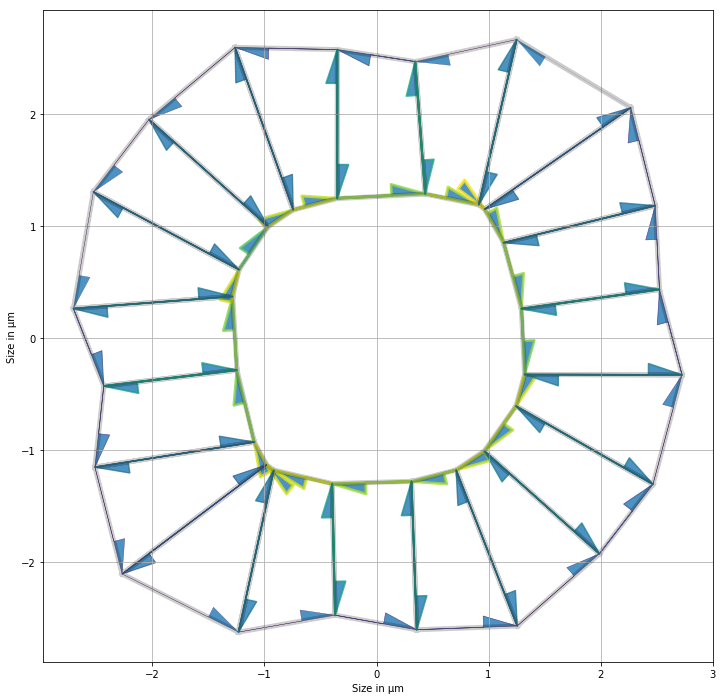

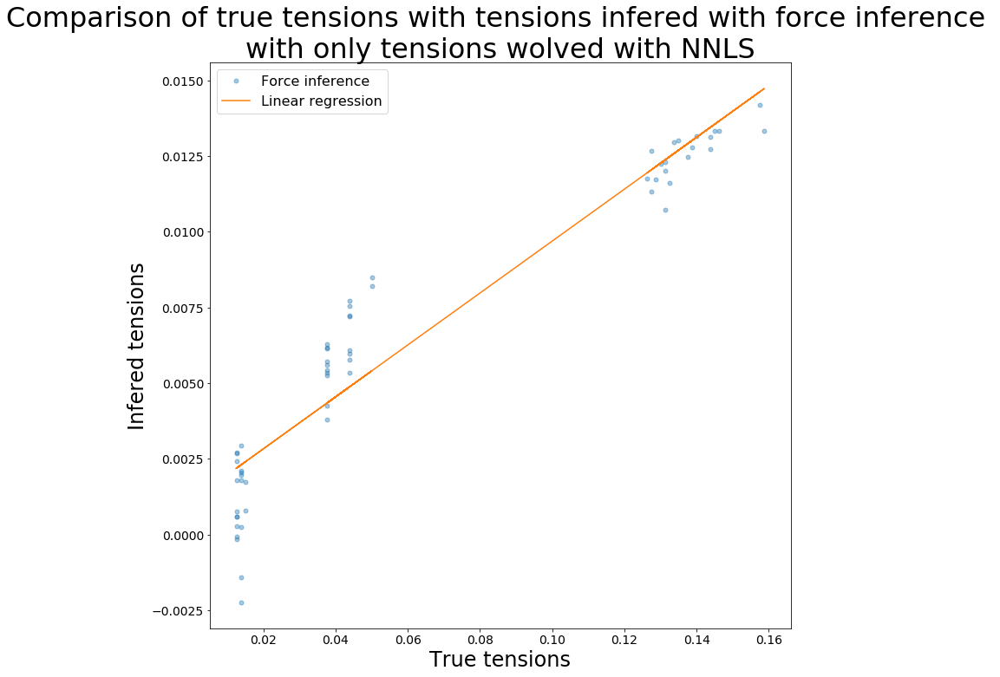

R value : 0.9495047001919751 
Standard error : 0.0013107949713095893


In [28]:
(init,
 i_tmp_fi_tensions_table,
 i_tmp_cr_fi_tensions_table,
 i_tmp_fi_areas_table,
 i_tmp_cr_fi_areas_table) = force_inference_procedure(organo)
pol_fi_tensions_table = np.concatenate((i_tmp_fi_tensions_table, pol_fi_tensions_table))
pol_cr_fi_tensions_table = np.concatenate((i_tmp_cr_fi_tensions_table, pol_cr_fi_tensions_table))
pol_fi_areas_table = np.concatenate((i_tmp_fi_areas_table, pol_fi_areas_table))
pol_cr_fi_areas_table = np.concatenate((i_tmp_cr_fi_areas_table, pol_cr_fi_areas_table))
(i_tmp_mindist_tensions_table,
 i_tmp_cr_mindist_tensions_table,
 i_tmp_mindist_areas_table,
 i_tmp_cr_mindist_areas_table) = min_dist_procedure(organo, init)
pol_mindist_tensions_table = np.concatenate((mindist_tensions_table, pol_mindist_tensions_table))
pol_cr_mindist_tensions_table = np.concatenate((i_tmp_cr_mindist_tensions_table, pol_cr_mindist_tensions_table))
pol_mindist_areas_table = np.concatenate((i_tmp_mindist_areas_table, pol_mindist_areas_table))
pol_cr_mindist_areas_table = np.concatenate((cr_mindist_areas_table, pol_cr_mindist_areas_table))

In [71]:
table_mindist = np.concatenate((a_tmp_mindist_tensions_table,
                                b_tmp_mindist_tensions_table,
                                d_tmp_mindist_tensions_table,
                                e_tmp_mindist_tensions_table,
                                f_tmp_mindist_tensions_table,
                                g_tmp_mindist_tensions_table,
                                h_tmp_mindist_tensions_table,
                                i_tmp_mindist_tensions_table))

In [42]:
xs = np.concatenate((real_tensions_table, pol_real_tensions_table[:-60]))

In [69]:
np.mean(table_mindist)

0.02074918048697755

Final plot

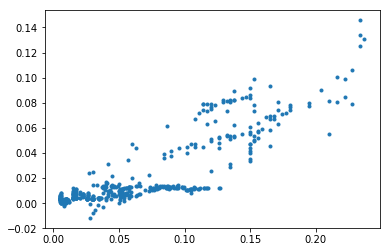

In [60]:
from matplotlib import pyplot as plt
plt.plot(xs, table_mindist, '.')

In [76]:
table_mindist = np.concatenate((a_tmp_fi_tensions_table,
                                b_tmp_fi_tensions_table,
                                d_tmp_fi_tensions_table,
                                e_tmp_fi_tensions_table,
                                f_tmp_fi_tensions_table,
                                g_tmp_fi_tensions_table,
                                h_tmp_fi_tensions_table,
                                i_tmp_fi_tensions_table))

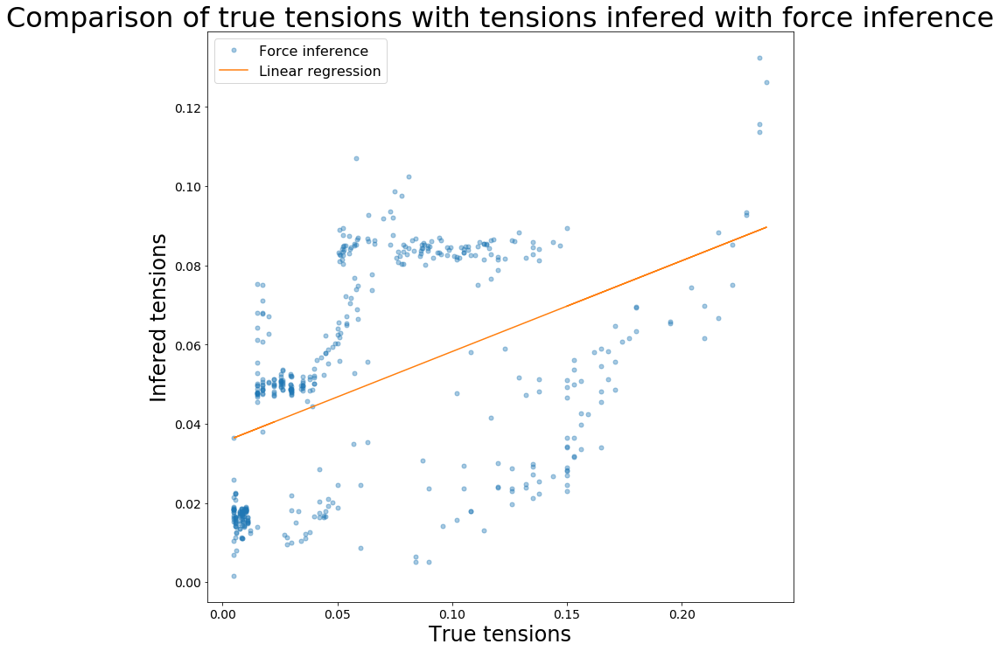

R value : 0.46443878680665246 
Standard error : 0.06008908129234276


In [77]:
from matplotlib import pyplot as plt
rendering_results(organo, xs,
                      table_mindist*0.0277+0.05,
                      'Comparison of true tensions with tensions infered with force inference',
                      'True tensions', 'Infered tensions', ('Force inference', 'Linear regression'))

In [ ]:
pri

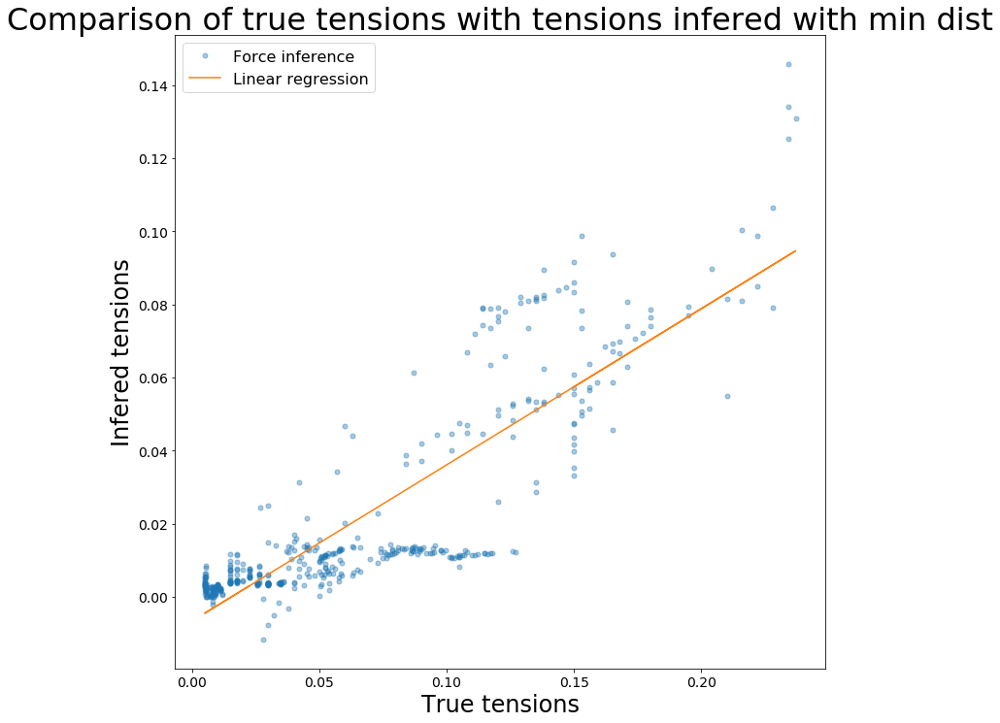

R value : 0.8660944394428818 
Standard error : 0.033924532622887096


In [72]:
from matplotlib import pyplot as plt
rendering_results(organo, xs,
                      table_mindist,
                      'Comparison of true tensions with tensions infered with min dist',
                      'True tensions', 'Infered tensions', ('Force inference', 'Linear regression'))

ValueError: x and y must have same first dimension, but have shapes (180,) and (120,)

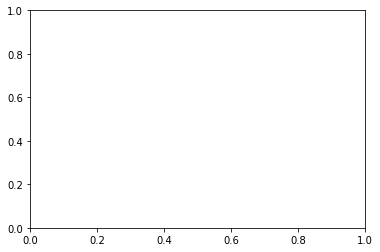

In [17]:
from matplotlib import pyplot as plt
plt.plot(np.concatenate((pol_cr_real_tensions_table, cr_real_tensions_table)),
         np.concatenate((pol_cr_fi_tensions_table, cr_fi_tensions_table)), '.')